In [1]:
import cudf
import pandas as pd
import numpy as np

In [2]:
dataset = cudf.read_csv('./Loan_Default.csv')

# Setting the max_columns to be displayed with pandas (here with cudf)
pd.set_option("display.max_columns", dataset.shape[-1]) 

In [3]:
dataset.head(5)

,ID,year,loan_limit,Gender,approv_in_adv,loan_type,loan_purpose,Credit_Worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,Interest_rate_spread,Upfront_charges,term,Neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,Secured_by,total_units,income,credit_type,Credit_Score,co-applicant_credit_type,age,submission_of_application,LTV,Region,Security_Type,Status,dtir1
0,24890,2019,cf,Sex Not Available,nopre,type1,p1,l1,nopc,nob/c,116500,<NA>,<NA>,<NA>,360.0,not_neg,not_int,not_lpsm,118000.0,sb,pr,home,1U,1740.0,EXP,758,CIB,25-34,to_inst,98.72881356,south,direct,1,45.0
1,24891,2019,cf,Male,nopre,type2,p1,l1,nopc,b/c,206500,<NA>,<NA>,<NA>,360.0,not_neg,not_int,lpsm,<NA>,sb,pr,home,1U,4980.0,EQUI,552,EXP,55-64,to_inst,<NA>,North,direct,1,<NA>
2,24892,2019,cf,Male,pre,type1,p1,l1,nopc,nob/c,406500,4.56,0.2,595.0,360.0,neg_amm,not_int,not_lpsm,508000.0,sb,pr,home,1U,9480.0,EXP,834,CIB,35-44,to_inst,80.01968504,south,direct,0,46.0
3,24893,2019,cf,Male,nopre,type1,p4,l1,nopc,nob/c,456500,4.25,0.681,<NA>,360.0,not_neg,not_int,not_lpsm,658000.0,sb,pr,home,1U,11880.0,EXP,587,CIB,45-54,not_inst,69.3768997,North,direct,0,42.0
4,24894,2019,cf,Joint,pre,type1,p1,l1,nopc,nob/c,696500,4.0,0.3042,0.0,360.0,not_neg,not_int,not_lpsm,758000.0,sb,pr,home,1U,10440.0,CRIF,602,EXP,25-34,not_inst,91.88654354,North,direct,0,39.0


In [4]:
# We have no use of the column ID
dataset.drop(['ID'], axis='columns', inplace=True)
# dataset.head(5)

In [5]:
# Now we will check how many years of data this file has using year column

dataset.loc[:,'year'].unique()

0    2019
Name: year, dtype: int64

In [6]:
# this file contains only year 2019 data. 
# This makes the year column unnecessary. So, we will drop this column instead

dataset.drop('year', axis='columns', inplace=True)
# dataset.head(5)

features: 32
rows: 148670


<AxesSubplot:>

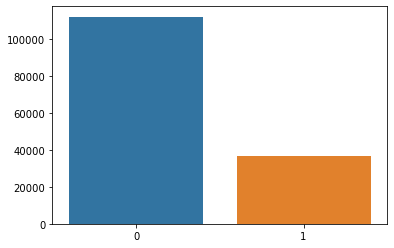

In [45]:
# We have drop 2 columns namely ID and year from our dataset. Now we have following number of features in our data
import seaborn as sns
%matplotlib inline

n_rows, n_features = dataset.shape
print (f"features: {n_features}")
print (f"rows: {n_rows}")

# We also need to make sure that we have enough data to test all the categories
# Status is our dependent feature
dist = dataset.groupby(by="Status").size()

sns.barplot(x=dist.index.values_host, y=dist.values.get())

In [46]:
# Checking how many columns has null values in them

null_cols = dataset.isna().sum() # we can also use isnull method both are same
null_cols

loan_limit                    3344
Gender                           0
approv_in_adv                  908
loan_type                        0
loan_purpose                   134
Credit_Worthiness                0
open_credit                      0
business_or_commercial           0
loan_amount                      0
rate_of_interest             36439
Interest_rate_spread         36639
Upfront_charges              39642
term                            41
Neg_ammortization              121
interest_only                    0
lump_sum_payment                 0
property_value               15098
construction_type                0
occupancy_type                   0
Secured_by                       0
total_units                      0
income                        9150
credit_type                      0
Credit_Score                     0
co-applicant_credit_type         0
age                            200
submission_of_application      200
LTV                          15098
Region              

In [47]:
# Getting column names which has atleast 1 null value

cols_with_na_values = dataset.columns[(null_cols > 0).to_arrow().to_pylist()].to_list()
cols_with_na_values

['loan_limit',
 'approv_in_adv',
 'loan_purpose',
 'rate_of_interest',
 'Interest_rate_spread',
 'Upfront_charges',
 'term',
 'Neg_ammortization',
 'property_value',
 'income',
 'age',
 'submission_of_application',
 'LTV',
 'dtir1']

In [ ]:
# EXPECTED:
# As the datatypes of some values are in object we cannot perform mathematical analysis on them

# dataset[['loan_limit']].median()

In [48]:
# checking the datatype of different columns
# As we can see loan_limit is object

dataset.info()

<class 'cudf.core.dataframe.DataFrame'>
RangeIndex: 148670 entries, 0 to 148669
Data columns (total 32 columns):
 #   Column                     Non-Null Count   Dtype
---  ------                     --------------   -----
 0   loan_limit                 145326 non-null  object
 1   Gender                     148670 non-null  object
 2   approv_in_adv              147762 non-null  object
 3   loan_type                  148670 non-null  object
 4   loan_purpose               148536 non-null  object
 5   Credit_Worthiness          148670 non-null  object
 6   open_credit                148670 non-null  object
 7   business_or_commercial     148670 non-null  object
 8   loan_amount                148670 non-null  int64
 9   rate_of_interest           112231 non-null  float64
 10  Interest_rate_spread       112031 non-null  float64
 11  Upfront_charges            109028 non-null  float64
 12  term                       148629 non-null  float64
 13  Neg_ammortization          148549 non-nul

In [49]:
# Sometimes variables have float or int values but they are stored as object in that case we can change the 
for column in dataset.columns:
    print (dataset.loc[:, column].unique())

0    <NA>
1      cf
2     ncf
Name: loan_limit, dtype: object
0               Female
1                Joint
2                 Male
3    Sex Not Available
Name: Gender, dtype: object
0     <NA>
1    nopre
2      pre
Name: approv_in_adv, dtype: object
0    type1
1    type2
2    type3
Name: loan_type, dtype: object
0    <NA>
1      p1
2      p2
3      p3
4      p4
Name: loan_purpose, dtype: object
0    l1
1    l2
Name: Credit_Worthiness, dtype: object
0    nopc
1     opc
Name: open_credit, dtype: object
0      b/c
1    nob/c
Name: business_or_commercial, dtype: object
0        16500
1        26500
2        36500
3        46500
4        56500
        ...   
206    2926500
207    2986500
208    3006500
209    3346500
210    3576500
Name: loan_amount, Length: 211, dtype: int64
0       <NA>
1        0.0
2      2.125
3       2.25
4      2.375
       ...  
127    7.125
128    7.375
129      7.5
130     7.75
131      8.0
Name: rate_of_interest, Length: 132, dtype: float64
0           <NA>
1     

In [50]:
# As you can see loan_limit variable is a categoriacal variable and has 2 different categories cf and ncf

# We can try to find columns which has categorical values with based of what number of unique values they have. 

# Here we will set it to 10. So, if any columns has < 10 unique values in them we will categorize it as a\
# categorical column
    
n_unique_values = 10
all_columns = dataset.columns.to_list()
categorical_columns = []

for i, column in enumerate(all_columns):
    dtype = dataset[column].dtype
    temp = dataset.loc[:, column].unique().to_arrow().to_pylist()
    if len(temp) < n_unique_values and dtype == 'object':
        print (f"{i+1}. {column} has only {len(temp)} which are [{temp}] unique values - CATEGORICAL") 
        categorical_columns.append(column)
    del temp, dtype

1. loan_limit has only 3 which are [[None, 'cf', 'ncf']] unique values - CATEGORICAL
2. Gender has only 4 which are [['Female', 'Joint', 'Male', 'Sex Not Available']] unique values - CATEGORICAL
3. approv_in_adv has only 3 which are [[None, 'nopre', 'pre']] unique values - CATEGORICAL
4. loan_type has only 3 which are [['type1', 'type2', 'type3']] unique values - CATEGORICAL
5. loan_purpose has only 5 which are [[None, 'p1', 'p2', 'p3', 'p4']] unique values - CATEGORICAL
6. Credit_Worthiness has only 2 which are [['l1', 'l2']] unique values - CATEGORICAL
7. open_credit has only 2 which are [['nopc', 'opc']] unique values - CATEGORICAL
8. business_or_commercial has only 2 which are [['b/c', 'nob/c']] unique values - CATEGORICAL
14. Neg_ammortization has only 3 which are [[None, 'neg_amm', 'not_neg']] unique values - CATEGORICAL
15. interest_only has only 2 which are [['int_only', 'not_int']] unique values - CATEGORICAL
16. lump_sum_payment has only 2 which are [['lpsm', 'not_lpsm']] uni

In [51]:
# Gender feature has value 'Sex Not Available', which is kind of NaN value.

# We will replace those values with np.nan value.

dataset["Gender"] = dataset["Gender"].replace("Sex Not Available", np.nan)

In [52]:
# Since now Gender feature has NaN values we need to append this feature in our cols_with_na_values list if it \
# did not exists in it already

if "Gender" not in cols_with_na_values:
    cols_with_na_values.append("Gender")
    print (cols_with_na_values)

['loan_limit', 'approv_in_adv', 'loan_purpose', 'rate_of_interest', 'Interest_rate_spread', 'Upfront_charges', 'term', 'Neg_ammortization', 'property_value', 'income', 'age', 'submission_of_application', 'LTV', 'dtir1', 'Gender']


In [53]:
dataset.isna().sum() 

loan_limit                    3344
Gender                       37659
approv_in_adv                  908
loan_type                        0
loan_purpose                   134
Credit_Worthiness                0
open_credit                      0
business_or_commercial           0
loan_amount                      0
rate_of_interest             36439
Interest_rate_spread         36639
Upfront_charges              39642
term                            41
Neg_ammortization              121
interest_only                    0
lump_sum_payment                 0
property_value               15098
construction_type                0
occupancy_type                   0
Secured_by                       0
total_units                      0
income                        9150
credit_type                      0
Credit_Score                     0
co-applicant_credit_type         0
age                            200
submission_of_application      200
LTV                          15098
Region              

In [56]:
# Before we can perform any kind of statistical analysis we need to convert the dataset features in right format.

# We need to encode all the categorical features but also need to make sure that NaN values do not get encoded \
# in the process.

from cuml.preprocessing import LabelEncoder

le = LabelEncoder(verbose=True)
for column in categorical_columns:
    temp = dataset.loc[ dataset[column].notnull(), column ] 
    dataset.loc[ dataset[column].notnull(), [column,] ] = le.fit_transform(temp)
    del temp
del le
dataset[cols_with_na_values].head(5)

,loan_limit,approv_in_adv,loan_purpose,rate_of_interest,Interest_rate_spread,Upfront_charges,term,Neg_ammortization,property_value,income,age,submission_of_application,LTV,dtir1,Gender
0,0,0,0,<NA>,<NA>,<NA>,360.0,1,118000.0,1740.0,0,1,98.72881356,45.0,<NA>
1,0,0,0,<NA>,<NA>,<NA>,360.0,1,<NA>,4980.0,3,1,<NA>,<NA>,2
2,0,1,0,4.56,0.2,595.0,360.0,0,508000.0,9480.0,1,1,80.01968504,46.0,2
3,0,0,3,4.25,0.681,<NA>,360.0,1,658000.0,11880.0,2,0,69.3768997,42.0,2
4,0,1,0,4.0,0.3042,0.0,360.0,1,758000.0,10440.0,0,0,91.88654354,39.0,1


In [57]:
# As we see in the dataset some are continuous features, those usually don't follow normal/gaussian distribution \
# and making it necessary to perform standard normal distribution using mean and std.

# normal/gaussian distribution: mean = 0 and std = 1

# These values needs to be scaled properly for better accuracy.

# If the difference between min and max is >= 11 then, we will count it as continuous feature and perform \
# standard scalling.

min_ge_value = 10

scale_columns = []
for column in dataset.columns:
    min_ = int(dataset[column].min())
    max_ = int(dataset[column].max())
    if abs(max_ - min_) >= min_ge_value:
        mean = dataset[column].mean()
        std = dataset[column].std()
        print (f"{len(scale_columns)+1}. {column} needs to be scaled, it has mean value of {mean:.2f} and standard deviation value of {std:.2f}")
        scale_columns.append(column)
print ()
print (f"These columns needs to be scaled {scale_columns}")

1. loan_amount needs to be scaled, it has mean value of 331117.74 and standard deviation value of 183909.31
2. Upfront_charges needs to be scaled, it has mean value of 3225.00 and standard deviation value of 3251.12
3. term needs to be scaled, it has mean value of 335.14 and standard deviation value of 58.41
4. property_value needs to be scaled, it has mean value of 497893.47 and standard deviation value of 359935.32
5. income needs to be scaled, it has mean value of 6957.34 and standard deviation value of 6496.59
6. Credit_Score needs to be scaled, it has mean value of 699.79 and standard deviation value of 115.88
7. LTV needs to be scaled, it has mean value of 72.75 and standard deviation value of 39.97
8. dtir1 needs to be scaled, it has mean value of 37.73 and standard deviation value of 10.55

These columns needs to be scaled ['loan_amount', 'Upfront_charges', 'term', 'property_value', 'income', 'Credit_Score', 'LTV', 'dtir1']


In [58]:
# As we see in the dataset some column values varies from a very low to very high value.

# These values needs to be scaled properly for better accuracy.

# We can use StandardScaler class to do the same.

# This also can be said as this data does not follow normal / gaussian distribution (mean != 0 and std != 1)
# This means that we need to perform standard normal distribution using mean and std

from cuml.preprocessing import StandardScaler

scaler = StandardScaler(with_mean=True, with_std=True)

if len(scale_columns) > 1:
    dataset[scale_columns] = scaler.fit_transform(dataset[scale_columns])
elif len(scale_columns) == 1:
    dataset[column] = scaler.fit_transform(dataset[column].values.reshape(-1,1))

del scaler
dataset.head(5)

,loan_limit,Gender,approv_in_adv,loan_type,loan_purpose,Credit_Worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,Interest_rate_spread,Upfront_charges,term,Neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,Secured_by,total_units,income,credit_type,Credit_Score,co-applicant_credit_type,age,submission_of_application,LTV,Region,Security_Type,Status,dtir1
0,0,<NA>,0,0,0,0,0,1,-1.166980,<NA>,<NA>,NaN,0.425679,1,1,1,-1.055453,1,1,0,0,-0.803092,3,0.502357,0,0,1,0.650088,3,1,1,0.689123
1,0,2,0,1,0,0,0,0,-0.677607,<NA>,<NA>,NaN,0.425679,1,1,0,NaN,1,1,0,0,-0.304367,2,-1.275413,1,3,1,NaN,0,1,1,NaN
2,0,2,1,0,0,0,0,1,0.409890,4.56,0.2,-0.808954,0.425679,0,1,1,0.028079,1,1,0,0,0.388307,3,1.158234,0,1,1,0.181979,3,1,0,0.783951
3,0,2,0,0,3,0,0,1,0.681764,4.25,0.681,NaN,0.425679,1,1,1,0.444822,1,1,0,0,0.757733,3,-0.973365,0,2,0,-0.084308,0,1,0,0.404638
4,0,1,1,0,0,0,0,1,1.986759,4.0,0.3042,-0.991969,0.425679,1,1,1,0.722651,1,1,0,0,0.536077,1,-0.843916,1,0,0,0.478892,0,1,0,0.120154


In [59]:
dataset.isna().sum()

loan_limit                    3344
Gender                       37659
approv_in_adv                  908
loan_type                        0
loan_purpose                   134
Credit_Worthiness                0
open_credit                      0
business_or_commercial           0
loan_amount                      0
rate_of_interest             36439
Interest_rate_spread         36639
Upfront_charges              39642
term                            41
Neg_ammortization              121
interest_only                    0
lump_sum_payment                 0
property_value               15098
construction_type                0
occupancy_type                   0
Secured_by                       0
total_units                      0
income                        9150
credit_type                      0
Credit_Score                     0
co-applicant_credit_type         0
age                            200
submission_of_application      200
LTV                          15098
Region              

In [60]:
# Now, we need to remove NaN values, but in this dataset we have a lot of NaN values if we just remove those, \
# there is a chance that we may end up losing lot of values or may be an entire category (tested).

# We will create small models depending on the feature type we are working on continuous / categorical what \
# algorithms we will be using.

# For each feature with NaN values we need to find another feature which has the best negative / positive relation
# with it and based on that feature we will train our model and find the approximate values.

# We will do this using the heatmap.

# import matplotlib.pyplot as plt
# import seaborn as sns

In [61]:
cols_with_na_values

['loan_limit',
 'approv_in_adv',
 'loan_purpose',
 'rate_of_interest',
 'Interest_rate_spread',
 'Upfront_charges',
 'term',
 'Neg_ammortization',
 'property_value',
 'income',
 'age',
 'submission_of_application',
 'LTV',
 'dtir1',
 'Gender']

In [62]:
# Before creating the heatmap, in this dataset lots of column have object datatype which are actually carrying \
# int after using label encoder.

# We need to convert features to correct datatypes for statistical analysis.

for column in dataset.columns:
    i = 0
    column = str(column)
    if dataset[column].dtype == 'object':
        while True:
            temp = dataset.loc[i, column]
            i += 1
            if type(temp) != pd._libs.missing.NAType:
                isFloat = False
                try:
                    float(temp)
                    isFloat = True
                except:
                    isFloat = False
                if temp.isnumeric():
                    print (f"Coverting column {column} type from {dataset[column].dtype} to int")
                    dataset[column] = dataset[column].astype(int, copy=False)
                elif isFloat:
                    print (f"Coverting column {column} type from {dataset[column].dtype} to float")
                    dataset[column] = dataset[column].astype(float, copy=False)
                else:
                    print (f"Leaving {column} as it is {dataset[column].dtype}")
                break

dataset.head(5)

Coverting column loan_limit type from object to int
Coverting column Gender type from object to int
Coverting column approv_in_adv type from object to int
Coverting column loan_type type from object to int
Coverting column loan_purpose type from object to int
Coverting column Credit_Worthiness type from object to int
Coverting column open_credit type from object to int
Coverting column business_or_commercial type from object to int
Coverting column Neg_ammortization type from object to int
Coverting column interest_only type from object to int
Coverting column lump_sum_payment type from object to int
Coverting column construction_type type from object to int
Coverting column occupancy_type type from object to int
Coverting column Secured_by type from object to int
Coverting column total_units type from object to int
Coverting column credit_type type from object to int
Coverting column co-applicant_credit_type type from object to int
Coverting column age type from object to int
Covertin

,loan_limit,Gender,approv_in_adv,loan_type,loan_purpose,Credit_Worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,Interest_rate_spread,Upfront_charges,term,Neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,Secured_by,total_units,income,credit_type,Credit_Score,co-applicant_credit_type,age,submission_of_application,LTV,Region,Security_Type,Status,dtir1
0,0,<NA>,0,0,0,0,0,1,-1.166980,<NA>,<NA>,NaN,0.425679,1,1,1,-1.055453,1,1,0,0,-0.803092,3,0.502357,0,0,1,0.650088,3,1,1,0.689123
1,0,2,0,1,0,0,0,0,-0.677607,<NA>,<NA>,NaN,0.425679,1,1,0,NaN,1,1,0,0,-0.304367,2,-1.275413,1,3,1,NaN,0,1,1,NaN
2,0,2,1,0,0,0,0,1,0.409890,4.56,0.2,-0.808954,0.425679,0,1,1,0.028079,1,1,0,0,0.388307,3,1.158234,0,1,1,0.181979,3,1,0,0.783951
3,0,2,0,0,3,0,0,1,0.681764,4.25,0.681,NaN,0.425679,1,1,1,0.444822,1,1,0,0,0.757733,3,-0.973365,0,2,0,-0.084308,0,1,0,0.404638
4,0,1,1,0,0,0,0,1,1.986759,4.0,0.3042,-0.991969,0.425679,1,1,1,0.722651,1,1,0,0,0.536077,1,-0.843916,1,0,0,0.478892,0,1,0,0.120154


In [63]:
dataset.info()

<class 'cudf.core.dataframe.DataFrame'>
RangeIndex: 148670 entries, 0 to 148669
Data columns (total 32 columns):
 #   Column                     Non-Null Count   Dtype
---  ------                     --------------   -----
 0   loan_limit                 145326 non-null  int64
 1   Gender                     111011 non-null  int64
 2   approv_in_adv              147762 non-null  int64
 3   loan_type                  148670 non-null  int64
 4   loan_purpose               148536 non-null  int64
 5   Credit_Worthiness          148670 non-null  int64
 6   open_credit                148670 non-null  int64
 7   business_or_commercial     148670 non-null  int64
 8   loan_amount                148670 non-null  float64
 9   rate_of_interest           112231 non-null  float64
 10  Interest_rate_spread       112031 non-null  float64
 11  Upfront_charges            148670 non-null  float64
 12  term                       148670 non-null  float64
 13  Neg_ammortization          148549 non-null  int

In [64]:
corr_map = dataset.to_pandas().corr()
corr_map

,loan_limit,Gender,approv_in_adv,loan_type,loan_purpose,Credit_Worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,Interest_rate_spread,Upfront_charges,term,Neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,Secured_by,total_units,income,credit_type,Credit_Score,co-applicant_credit_type,age,submission_of_application,LTV,Region,Security_Type,Status,dtir1
loan_limit,1.000000,0.017303,0.096445,0.044775,-0.037391,-0.024095,0.018208,0.022574,0.281016,0.031372,-0.034953,0.043342,0.019418,-0.008067,0.031088,0.019008,0.203583,0.004092,0.015091,-0.004092,-0.008969,0.147994,-0.000630,0.000432,0.041043,-0.006448,-0.010875,0.013964,0.005681,0.004092,0.054262,0.001153
Gender,0.017303,1.000000,0.006496,0.082069,-0.002473,-0.001437,-0.000202,0.030384,0.048376,-0.042532,-0.052016,0.005330,-0.014909,-0.003014,0.002190,-0.002249,0.005533,-0.002617,-0.003148,0.002617,0.012983,0.056198,0.008570,0.003298,-0.097202,-0.082241,0.002819,0.031411,-0.002352,-0.002617,0.019896,-0.026218
approv_in_adv,0.096445,0.006496,1.000000,-0.004281,-0.147067,-0.061770,-0.005979,-0.010112,-0.030081,0.058391,0.063801,0.018664,0.024212,0.078254,0.074562,0.061366,-0.053109,0.001456,0.012567,-0.001456,-0.004720,-0.013734,-0.007592,-0.001185,-0.011839,-0.022045,0.080906,0.032632,-0.008917,0.001456,-0.037396,0.014197
loan_type,0.044775,0.082069,-0.004281,1.000000,0.019613,-0.011153,-0.031869,-0.410676,-0.072201,-0.267358,-0.117919,-0.125469,0.126891,0.006014,0.011127,-0.008584,-0.188976,-0.006152,0.055839,0.006152,-0.035520,-0.145614,0.065090,-0.004336,0.031215,0.070710,0.094809,0.172478,-0.001210,-0.006152,0.052301,0.178330
loan_purpose,-0.037391,-0.002473,-0.147067,0.019613,1.000000,-0.040168,-0.002447,0.055685,0.066688,-0.250177,-0.203147,0.009329,-0.124182,0.067227,-0.020172,-0.010003,0.152509,0.005178,-0.022992,-0.005178,-0.010205,0.007544,0.020827,0.000841,-0.004835,0.091399,0.004718,-0.111115,0.071368,0.005178,-0.027910,-0.082198
Credit_Worthiness,-0.024095,-0.001437,-0.061770,-0.011153,-0.040168,1.000000,0.230578,-0.002938,-0.014207,0.153968,0.058426,-0.006602,-0.022577,-0.058613,-0.049889,0.031056,0.028046,-0.003570,-0.001745,0.003570,0.001823,0.016298,0.001637,0.001375,0.013758,0.007257,0.021927,-0.014255,-0.004553,-0.003570,0.034875,0.014789
open_credit,0.018208,-0.000202,-0.005979,-0.031869,-0.002447,0.230578,1.000000,0.024685,-0.044147,0.191423,0.066929,NaN,0.025292,-0.001959,-0.273385,0.004918,0.136767,0.000913,0.009919,-0.000913,-0.006136,0.047405,-0.009059,0.001930,0.016797,0.037394,0.045451,-0.083533,-0.005000,0.000913,-0.009979,-0.010943
business_or_commercial,0.022574,0.030384,-0.010112,-0.410676,0.055685,-0.002938,0.024685,1.000000,0.162498,0.051474,-0.394710,0.151732,-0.093372,0.014371,-0.007086,0.014367,0.215923,0.007023,-0.043251,-0.007023,0.023274,0.141532,-0.023163,0.000780,0.023249,0.062773,-0.089839,-0.137961,0.004174,0.007023,-0.092550,-0.175462
loan_amount,0.281016,0.048376,-0.030081,-0.072201,0.066688,-0.014207,-0.044147,0.162498,1.000000,-0.150844,-0.377272,0.065556,0.174474,0.027445,-0.002689,0.000647,0.734249,0.009949,-0.001625,-0.009949,0.093329,0.456065,-0.014541,0.004438,0.147668,-0.198498,-0.428498,0.038869,0.006456,0.009949,-0.036825,0.015029
rate_of_interest,0.031372,-0.042532,0.058391,-0.267358,-0.250177,0.153968,0.191423,0.051474,-0.150844,1.000000,0.614908,-0.076473,0.209330,-0.176658,0.009160,0.015249,-0.122613,NaN,-0.188787,NaN,0.082623,-0.041809,-0.025887,-0.001331,-0.043587,0.032902,0.140833,-0.000220,-0.012937,NaN,0.022957,0.055124


In [65]:
# Before removing the features or rows lets check the relationship of all the columns with our dependent variable

# plt.figure(figsize=(30, 20), dpi=100) 

corr_label = np.array(["high", "moderate", "low", "no"])
pos_neg_corr_label = np.array(["positive", "negative"])

correlations = {}
for column in cols_with_na_values:
    dict_ = corr_map[column].drop(labels=column).to_dict()
    values = list(dict_.values())
    keys = list(dict_.keys())
    value = max( [abs(min(values)), abs(max(values))] )
    relation = ([
        value > 0.7 and value <= 1.0, 
        value > 0.5 and value <= 0.7,
        value > 0.0 and value <= 0.5, 
        value == 0.0,
    ]) 
    try:
        key = keys[values.index(value)]
    except ValueError:
        key = keys[values.index(value*-1)]
        value *= -1
    cor_label = corr_label[relation][0]
    if cor_label in correlations.keys():
        temp = correlations.get(cor_label)
        temp[column] = [value, key]
        correlations[cor_label].update(temp)
    else:
        correlations[cor_label] = {column: [value, key]}
    print (f"{column} has {corr_label[relation][0]} {pos_neg_corr_label[[value >= 0, value < 0]][0]} " +\
    f"correlation with {key} as {value:.2f}")

correlations
# sns.heatmap(dataset.to_pandas().corr(), annot=True, annot_kws={"fontsize":12}, linecolor='white', \
#             linewidth=1, fmt='.3f')

loan_limit has low positive correlation with loan_amount as 0.28
approv_in_adv has low negative correlation with loan_purpose as -0.15
loan_purpose has low negative correlation with rate_of_interest as -0.25
rate_of_interest has moderate positive correlation with Interest_rate_spread as 0.61
Interest_rate_spread has moderate positive correlation with rate_of_interest as 0.61
Upfront_charges has low positive correlation with submission_of_application as 0.34
term has low positive correlation with rate_of_interest as 0.21
Neg_ammortization has low negative correlation with rate_of_interest as -0.18
property_value has high positive correlation with loan_amount as 0.73
income has low positive correlation with loan_amount as 0.46
age has low positive correlation with submission_of_application as 0.25
submission_of_application has low negative correlation with loan_amount as -0.43
LTV has low negative correlation with property_value as -0.22
dtir1 has low negative correlation with income as 

{'low': {'loan_limit': [0.2810161953902198, 'loan_amount'],
  'approv_in_adv': [-0.14706742459037656, 'loan_purpose'],
  'loan_purpose': [-0.25017694998410406, 'rate_of_interest'],
  'Upfront_charges': [0.3358230827053743, 'submission_of_application'],
  'term': [0.20933032594967418, 'rate_of_interest'],
  'Neg_ammortization': [-0.17665774305224477, 'rate_of_interest'],
  'income': [0.4560654475962409, 'loan_amount'],
  'age': [0.25366332102894346, 'submission_of_application'],
  'submission_of_application': [-0.42849817699727927, 'loan_amount'],
  'LTV': [-0.21510174162828094, 'property_value'],
  'dtir1': [-0.2678066105543135, 'income'],
  'Gender': [-0.0972018736301115, 'co-applicant_credit_type']},
 'moderate': {'rate_of_interest': [0.614908081239045, 'Interest_rate_spread'],
  'Interest_rate_spread': [0.614908081239045, 'rate_of_interest']},
 'high': {'property_value': [0.734249016959526, 'loan_amount']}}

In [66]:
# keys of the correlation dictionary is out dependent variable (y), we need to check that the data which is not \
# present in dependent variable (y) is present in independent variable (X)

# Here we can see almost the same amount of values we have as null in both features and we can't use any feature \
# to build model and predict missing values

for cor in correlations.keys():
    print ('\n', '-'*10, 'Correlation:', cor.upper(), '-'*10, '\n')
    for sub in correlations.get(cor):
        temp = correlations.get(cor).get(sub)
        temp_data = dataset[[sub,temp[1]]]
        final = temp_data[ temp_data[sub].isna() ][temp[1]].isna().sum()
        print (f"{sub.upper()} vs. {temp[1].upper()}: Corr: {temp[0]:.2f}")
        print (f"Out of {temp_data[sub].isna().sum()} nan values in feature {sub.upper()}, " +\
               f"{temp_data[sub].isna().sum()-final} in {temp[1].upper()} are present and {final} are absent\n")


 ---------- Correlation: LOW ---------- 

LOAN_LIMIT vs. LOAN_AMOUNT: Corr: 0.28
Out of 3344 nan values in feature LOAN_LIMIT, 3344 in LOAN_AMOUNT are present and 0 are absent

APPROV_IN_ADV vs. LOAN_PURPOSE: Corr: -0.15
Out of 908 nan values in feature APPROV_IN_ADV, 908 in LOAN_PURPOSE are present and 0 are absent

LOAN_PURPOSE vs. RATE_OF_INTEREST: Corr: -0.25
Out of 134 nan values in feature LOAN_PURPOSE, 107 in RATE_OF_INTEREST are present and 27 are absent

UPFRONT_CHARGES vs. SUBMISSION_OF_APPLICATION: Corr: 0.34
Out of 39642 nan values in feature UPFRONT_CHARGES, 39595 in SUBMISSION_OF_APPLICATION are present and 47 are absent

TERM vs. RATE_OF_INTEREST: Corr: 0.21
Out of 41 nan values in feature TERM, 26 in RATE_OF_INTEREST are present and 15 are absent

NEG_AMMORTIZATION vs. RATE_OF_INTEREST: Corr: -0.18
Out of 121 nan values in feature NEG_AMMORTIZATION, 89 in RATE_OF_INTEREST are present and 32 are absent

INCOME vs. LOAN_AMOUNT: Corr: 0.46
Out of 9150 nan values in featur

In [67]:
# For the data with low correlation, we cannot built a model for that

# We have to have moderate to high correlation to make accurate predictions for the missing data using \
# correlated features

# But for the moderate correlation we can see that almost all nan data are also not present in independent feature

# We have only one column for which we can build model, i.e. PROPERTY_VALUE vs. LOAN_AMOUNT: Corr: 0.73

In [68]:
# from cuml.linear_model import LinearRegression
from cuml.model_selection import train_test_split
# from cuml.neural_network import MLPRegressor

In [70]:
data = dataset[dataset["property_value"].notnull()][["property_value", "loan_amount"]]
X = data["property_value"]
y = data["loan_amount"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.20, random_state=99)

In [50]:
# # from sklearn.linear_model import LinearRegression
# from sklearn.linear_model import Ridge
# from sklearn.model_selection import GridSearchCV

# params = {
#     'alpha': [0.001, 0.003, 0.01, 0.03, 0.1, 0.3, 1.0, 3.0],
#     'solver': ['auto', 'svd', 'sag', 'saga', 'lbfgs'],
#     'max_iter': [x for x in np.arange(1000, 20000, step=1000)],
#     'tol': [1e-3, 1e-4, 1e-5, 1e-6, 1e-7],
# }

# ridge = Ridge()
# clf = GridSearchCV(ridge, params, n_jobs=-1)
# clf.fit(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1))

# print ('best solver:', clf.best_estimator_)
# print ('best params:', clf.best_params_)
# print ('best score:', clf.best_score_)
# print ('scoring: ', clf.scoring)
# print ('estimator:', clf.estimator)
# print ('score:', clf.score(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1)))

# # reg = ridge.fit(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1))

# # reg.score(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1))

best solver: Ridge(alpha=0.1, max_iter=11000, solver='sag')
best params: {'alpha': 0.1, 'max_iter': 11000, 'solver': 'sag', 'tol': 0.001}
best score: 0.5514733086784578
scoring:  None
estimator: Ridge()
score: 0.5520745352330538


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
3800 fits failed out of a total of 19000.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
3800 fits failed with the following error:
Traceback (most recent call last):
  File "/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/linear_model/_ridge.py", line 1011, in fit
    return super().fit(X, y, sample_weight=sample_weight)
  File "/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-p

In [62]:
y_pred = clf.predict(X_test.get().reshape(-1,1)) #  y_test.get().reshape(-1,1)
# y_pred

clf.score(X_test.get().reshape(-1,1), y_test.get().reshape(-1,1))

0.4829025695638067

In [63]:
# Saving sklearn model

import pickle
import os

filename = './finalized_model.sav'
if os.path.exists(filename):
    os.remove(filename)
pickle.dump(clf, open(filename, 'wb'))

In [63]:
# from sklearn.linear_model import Perceptron
# from sklearn.model_selection import GridSearchCV
# import warnings

# warnings.filterwarnings("ignore")

# params = {
#     'penalty': ['l1', 'l2',],
#     'alpha': [0.001, 0.003, 0.01, 0.03, 0.1, 0.3, 1.0, 3.0],
#     'max_iter': [x for x in np.arange(50, 2001, 50)],
#     'tol': [1e-3, 1e-4, 1e-5, 1e-6, 1e-7],
#     'n_jobs': [-1,],
#     'random_state': [99,],
#     'early_stopping': [True, ],
# }

# p = Perceptron()
# clf2 = GridSearchCV(p, params)

# X_train_temp = X_train.to_numpy().reshape(-1, 1)
# y_train_temp = y_train.to_numpy().reshape(-1, 1)
# X_test_temp = X_test.to_numpy().reshape(-1, 1)
# y_test_temp = y_test.to_numpy().reshape(-1, 1)

# clf2.fit(X_train_temp, y_train_temp)

# print ('best solver:', clf.best_estimator_)
# print ('best params:', clf.best_params_)
# print ('best score:', clf.best_score_)
# print ('scoring: ', clf.scoring)
# print ('estimator:', clf.estimator)
# print ('train score:', clf.score(X_train_temp, y_train_temp))
# print ('test score:', clf.score(X_test_temp, y_test_temp))

# y_pred = clf.predict(X_test_temp)

In [61]:
X_train_temp.dtype

dtype('float64')

In [141]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import ParameterGrid
import warnings

warnings.filterwarnings("ignore")

params = {
    'hidden_layer_sizes': [(10,), (20,), (30,),], # (30,),],
    'activation': ['relu', 'logistic', ],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'alpha': [0.001, 0.003, 0.01, 0.03,], # 0.1, 0.3, 1.0,], # 3.0],
    'learning_rate': ['adaptive'], #'constant', 
    'max_iter': [x for x in np.arange(100, 1001, 100)],
    'random_state': [99,],
    'tol': [1e-3, 1e-4,],
    'early_stopping': [True, ],
    'verbose': [True, ],
#     'validation_fraction': [0.1, 0.2],
    'validation_fraction': [0.1,],
#     'n_iter_no_change': [10, 20],
    'n_iter_no_change': [10,],
    'learning_rate_init': [0.003,], #0.1, 0.001],
}

print (f"Total number combinations for GridSearchCV is: { len(ParameterGrid(params)) }")

X_train_temp = X_train.to_numpy().reshape(-1, 1)
y_train_temp = y_train.to_numpy().reshape(-1, 1).ravel()
X_test_temp = X_test.to_numpy().reshape(-1, 1)
y_test_temp = y_test.to_numpy().reshape(-1, 1).ravel()

mlp = MLPRegressor()
clf2 = GridSearchCV(mlp, params, n_jobs=-1)
clf2.fit(X_train_temp, y_train_temp)

print ('best solver:', clf.best_estimator_)
print ('best params:', clf.best_params_)
print ('best score:', clf.best_score_)
print ('scoring: ', clf.scoring)
print ('estimator:', clf.estimator)
print ('train score:', clf.score(X_train_temp, y_train_temp))
print ('test score:', clf.score(X_test_temp, y_test_temp))

y_pred = clf.predict(X_test_temp)

Total number combinations for GridSearchCV is: 1440
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01
RUNNING THE L-BFGS-B CODE

     

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60429D-01    |proj g|=  6.82644D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57510D-01    |proj g|=  6.82428D-01

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    1    f=  2.49216D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02


At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02
At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iter


At iterate   21    f=  1.62430D-01    |proj g|=  4.61421D-04

At iterate   15    f=  1.61921D-01    |proj g|=  1.49687D-03

At iterate   20    f=  1.63183D-01    |proj g|=  1.67010D-03

At iterate   18    f=  1.61622D-01    |proj g|=  1.94067D-03

At iterate   22    f=  1.62427D-01    |proj g|=  6.41253D-04

At iterate   17    f=  1.61881D-01    |proj g|=  1.94680D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03

At iterate   21    f=  1.63176D-01    |proj g|=  6.22135D-04

At iterate   16    f=  1.61895D-01    |proj g|=  1.49736D-03


At iterate   19    f=  1.61613D-01    |proj g|=  8.13011D-04
At iterate   17    f=  1.61103D-01    |proj g|=  1.73328D-03

At iterate   23    f=  1.62410D-01    |proj g|=  3.25595D-03

At iterate   18    f=  1.61860D-01    |proj g|=  6.25493D-04

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 



At iterate   45    f=  1.61680D-01    |proj g|=  5.33565D-04
At iterate   41    f=  1.61008D-01    |proj g|=  6.39520D-04

At iterate   44    f=  1.63080D-01    |proj g|=  2.19761D-03

At iterate   44    f=  1.61901D-01    |proj g|=  4.47034D-03


At iterate   42    f=  1.61005D-01    |proj g|=  9.68563D-04
At iterate   46    f=  1.61679D-01    |proj g|=  2.12690D-04

At iterate   41    f=  1.61493D-01    |proj g|=  8.90258D-04

At iterate   45    f=  1.63076D-01    |proj g|=  2.98131D-04

At iterate   43    f=  1.61001D-01    |proj g|=  1.17953D-03

At iterate   46    f=  1.63076D-01    |proj g|=  3.66425D-04

At iterate   47    f=  1.61677D-01    |proj g|=  6.98060D-04

At iterate   44    f=  1.60998D-01    |proj g|=  4.94928D-04

At iterate   42    f=  1.61492D-01    |proj g|=  2.87158D-04

At iterate   45    f=  1.61812D-01    |proj g|=  1.07669D-02


At iterate   45    f=  1.60998D-01    |proj g|=  1.95986D-04
At iterate   48    f=  1.61676D-01    |proj g|=  8.47940D-04

At iter


At iterate   69    f=  1.60968D-01    |proj g|=  3.74921D-04

At iterate   67    f=  1.61437D-01    |proj g|=  1.96027D-03

At iterate   70    f=  1.60967D-01    |proj g|=  3.72891D-04

At iterate   68    f=  1.61435D-01    |proj g|=  9.04256D-04

At iterate   71    f=  1.60967D-01    |proj g|=  2.73589D-04

At iterate   69    f=  1.61433D-01    |proj g|=  1.14301D-03

At iterate   72    f=  1.60967D-01    |proj g|=  2.05198D-04

At iterate   70    f=  1.61430D-01    |proj g|=  1.50832D-03

At iterate   73    f=  1.60967D-01    |proj g|=  2.39475D-04

At iterate   71    f=  1.61426D-01    |proj g|=  1.04027D-03

At iterate   72    f=  1.61425D-01    |proj g|=  2.42094D-03

At iterate   73    f=  1.61423D-01    |proj g|=  2.77840D-03

At iterate   74    f=  1.61422D-01    |proj g|=  8.76271D-04

At iterate   75    f=  1.61420D-01    |proj g|=  5.61128D-04

At iterate   74    f=  1.60967D-01    |proj g|=  3.37239D-04

At iterate   75    f=  1.60967D-01    |proj g|=  2.10617D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    6    f=  1.61870D-01    |proj g|=  8.89558D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59256D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77305D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    7    f=  1.63901D-01    |proj g|=  4.23888D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate    4    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   14    f=  1.61680D-01    |proj g|=  4.44955D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.



At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    9    f=  1.62962D-01    |proj g|=  7.64964D-03

At iterate    9    f=  1.62347D-01    |proj g|=  7.53500D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   10    f=  1.62922D-01    |proj g|=  9.20493D-03

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   12    f=  1.62627D-01    |proj g|=  6.92551D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate   13    f=  1.62583D-01    |proj g|=  1.87409D-03

At iterate   11    f=  1.62007D-01    |proj g|=  6.10951D-03

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate   14    f=  1.62565D-01    |proj g|=  2.12245D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02745D-03

At iterate    6    f=  1.61870D-01    |proj g|=  8.89558D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60429D-01    |proj g|=  6.82644D-01

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01


At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01
At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   17    f=  1.6

 This problem is unconstrained.



At iterate   25    f=  1.61056D-01    |proj g|=  1.10573D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03

At iterate   18    f=  1.63215D-01    |proj g|=  9.33173D-04

At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

At iterate   19    f=  1.63208D-01    |proj g|=  5.54357D-03

At iterate   26    f=  1.61054D-01    |proj g|=  5.49384D-04

At iterate    5    f=  1.63241D-01    |proj g|=  1.86470D-02

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate   21    f=  1.62430D-01    |proj g|=  4.61421D-04

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   20    f=  1.63183D-01    |proj g|=  1.67010D-03

At iterate   27    f=  1.61051D-01    |proj g|=  9.65379D-04

At iterate   22    f=  1.62427D-01    |proj g|=  6.41253D-04

At iter


At iterate   44    f=  1.61491D-01    |proj g|=  3.56816D-04

At iterate   50    f=  1.61667D-01    |proj g|=  1.11932D-03


At iterate   52    f=  1.60993D-01    |proj g|=  1.70480D-04
At iterate   47    f=  1.63073D-01    |proj g|=  1.08766D-03

At iterate   40    f=  1.61686D-01    |proj g|=  5.86460D-04

At iterate   41    f=  1.61684D-01    |proj g|=  4.30694D-04

At iterate   53    f=  1.60993D-01    |proj g|=  1.78655D-04

At iterate   45    f=  1.61491D-01    |proj g|=  3.36488D-04

At iterate   48    f=  1.63072D-01    |proj g|=  1.44436D-03

At iterate   51    f=  1.61662D-01    |proj g|=  2.97230D-03

At iterate   54    f=  1.60992D-01    |proj g|=  1.34154D-03

At iterate   46    f=  1.61491D-01    |proj g|=  5.79798D-04

At iterate   42    f=  1.61682D-01    |proj g|=  6.43951D-04

At iterate   49    f=  1.63068D-01    |proj g|=  4.03097D-04

At iterate   47    f=  1.61490D-01    |proj g|=  3.31680D-04

At iterate   43    f=  1.61681D-01    |proj g|=  3.50715D-04

At iter


At iterate   79    f=  1.61416D-01    |proj g|=  5.95659D-04

At iterate   77    f=  1.60967D-01    |proj g|=  3.89016D-04

At iterate   80    f=  1.61415D-01    |proj g|=  1.41512D-03

At iterate   78    f=  1.60967D-01    |proj g|=  1.97074D-04

At iterate   81    f=  1.61411D-01    |proj g|=  4.09528D-03

At iterate   82    f=  1.61408D-01    |proj g|=  3.70011D-03

At iterate   83    f=  1.61405D-01    |proj g|=  9.47898D-04

At iterate   84    f=  1.61404D-01    |proj g|=  3.08671D-04

At iterate   79    f=  1.60967D-01    |proj g|=  3.74138D-04

At iterate   80    f=  1.60967D-01    |proj g|=  2.16898D-04

At iterate   85    f=  1.61404D-01    |proj g|=  2.84826D-04

At iterate   86    f=  1.61403D-01    |proj g|=  2.03339D-03

At iterate   81    f=  1.60967D-01    |proj g|=  2.16262D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1, loss = 0.17825573
Validation score: 0.667241
Iteration 2, loss = 0.16400135
Validation score: 0.663901
Iteration 3, loss = 0.16393635
Validation score: 0.668779
Iteration 4, loss = 0.16374770
Validation score: 0.667183
Iteration 5, loss = 0.16347346
Validation score: 0.657794
Iteration 6, loss = 0.16370565
Validation score: 0.670865
Iteration 7, loss = 0.16360994
Validation score: 0.668044
Iteration 8, loss = 0.16352457
Validation score: 0.669743
Iteration 9, loss = 0.16347738
Validation score: 0.671470
Iteration 10, loss = 0.16328713
Validation score: 0.665604
Iteration 11, loss = 0.16352254
Validation score: 0.668328
Iteration 12, loss = 0.16357228
Validation score: 0.667357
Iteration 13, loss = 0.16361862
Validation score: 0.667776
Iteration 14, loss = 0.16342389
Validation score: 0.671365
Iteration 15, loss = 0.16372208
Validation score: 0.670735
Iteration 16, loss = 0.16345938
Validation score: 0.668525
Iteration 17, loss = 0.16373341
Validation score: 0.669982
Valida

Iteration 1, loss = 0.17733923
Validation score: 0.668611
Iteration 2, loss = 0.16374928
Validation score: 0.667570
Iteration 3, loss = 0.16343526
Validation score: 0.671273
Iteration 4, loss = 0.16321764
Validation score: 0.671489
Iteration 5, loss = 0.16291293
Validation score: 0.659267
Iteration 6, loss = 0.16316977
Validation score: 0.674223
Iteration 7, loss = 0.16309086
Validation score: 0.673594
Iteration 8, loss = 0.16307732
Validation score: 0.672117
Iteration 9, loss = 0.16282703
Validation score: 0.672598
Iteration 10, loss = 0.16286319
Validation score: 0.667055
Iteration 11, loss = 0.16318341
Validation score: 0.672379
Iteration 12, loss = 0.16315038
Validation score: 0.673242
Iteration 13, loss = 0.16307889
Validation score: 0.668690
Iteration 14, loss = 0.16305814
Validation score: 0.674886
Iteration 15, loss = 0.16328709
Validation score: 0.673346
Iteration 16, loss = 0.16287190
Validation score: 0.672652
Iteration 17, loss = 0.16306842
Validation score: 0.675000
Valida

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    6    f=  1.61870D-01    |proj g|=  8.89558D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59256D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77305D-03


 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93967D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91632D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03
Iteration 1, loss = 0.17710678
Validation score: 0.679019
Iteration 2, loss = 0.16250167
Validation score: 0.678950
Iteration 3, loss = 0.16216850
Validation score: 0.679234
Iteration 4, loss = 0.16201312
Validation score: 0.677117
Iteration 5, loss = 0.16237805
Validation score: 0.678266
Iteration 6, loss = 0.16206660
Validation score: 0.678994
Iteration 7, loss = 0.16218113
Validation score: 0.679313
Iteration 8, loss = 0.16201575
Validation score: 0.679318
Iteration 9, loss = 0.16194358
Validation score: 0.679473
Iteration 10, loss = 0.16195280
Validation s

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23888D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate   10    f=  1.63539D-01    |proj g|=  6.77040D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03


 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate   12    f=  1.63357D-01    |proj g|=  1.23083D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate   13    f=  1.63347D-01    |proj g|=  9.40415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334718232654027     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.638D-04   1.616D-01
  F =  0.16162606961509693     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   12    f=  1.62627D-01    |proj g|=  6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   10    f=  1.61905D-01    |proj g|=  7.73834D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   15    f=  1.63308D-01    |proj g|=  2.23845D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03


At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02
At iterate   16    f=  1.63281D-01    |proj g|=  1.72556D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12231D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

At iterate   12    f=  1.61751D-01    |proj g|=  4.13000D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    5    f=  1.63241D-01    |proj g|=  1.86470D-02

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate   17    f=  1.63220D-01    |proj g|=  1.65507D-03

At iter


At iterate   33    f=  1.62223D-01    |proj g|=  5.63649D-03

At iterate   40    f=  1.61009D-01    |proj g|=  7.60927D-04

At iterate   32    f=  1.61752D-01    |proj g|=  4.58260D-04

At iterate   44    f=  1.63080D-01    |proj g|=  2.19761D-03


At iterate   41    f=  1.61008D-01    |proj g|=  6.39520D-04
At iterate   34    f=  1.62184D-01    |proj g|=  7.02931D-03

At iterate   45    f=  1.63076D-01    |proj g|=  2.98131D-04

At iterate   37    f=  1.61503D-01    |proj g|=  6.61177D-04


At iterate   33    f=  1.61748D-01    |proj g|=  4.98847D-04
At iterate   42    f=  1.61005D-01    |proj g|=  9.68563D-04

At iterate   35    f=  1.62145D-01    |proj g|=  9.19258D-03

At iterate   46    f=  1.63076D-01    |proj g|=  3.66425D-04


At iterate   43    f=  1.61001D-01    |proj g|=  1.17953D-03
At iterate   34    f=  1.61741D-01    |proj g|=  6.31446D-04

At iterate   38    f=  1.61502D-01    |proj g|=  1.00016D-03

At iterate   44    f=  1.60998D-01    |proj g|=  4.94928D-04

At iter


At iterate   65    f=  1.61659D-01    |proj g|=  1.75921D-04

At iterate   73    f=  1.60967D-01    |proj g|=  2.39475D-04

At iterate   60    f=  1.61479D-01    |proj g|=  1.23052D-03

At iterate   61    f=  1.61469D-01    |proj g|=  2.10970D-03

At iterate   66    f=  1.61659D-01    |proj g|=  2.32910D-04

At iterate   62    f=  1.61465D-01    |proj g|=  4.00682D-03

At iterate   67    f=  1.61659D-01    |proj g|=  2.12360D-04

At iterate   63    f=  1.61449D-01    |proj g|=  1.89815D-03

At iterate   68    f=  1.61659D-01    |proj g|=  2.34905D-04

At iterate   74    f=  1.60967D-01    |proj g|=  3.37239D-04

At iterate   64    f=  1.61442D-01    |proj g|=  2.56149D-03

At iterate   75    f=  1.60967D-01    |proj g|=  2.10617D-04

At iterate   69    f=  1.61659D-01    |proj g|=  2.33146D-04

At iterate   65    f=  1.61439D-01    |proj g|=  1.16346D-03

At iterate   76    f=  1.60967D-01    |proj g|=  1.94683D-04

At iterate   70    f=  1.61659D-01    |proj g|=  2.00226D-04

       


At iterate   97    f=  1.61389D-01    |proj g|=  6.18560D-04

At iterate   98    f=  1.61389D-01    |proj g|=  1.50711D-03

At iterate   99    f=  1.61389D-01    |proj g|=  1.56671D-03

At iterate  100    f=  1.61389D-01    |proj g|=  5.85793D-04

At iterate  101    f=  1.61389D-01    |proj g|=  6.35018D-04

At iterate  102    f=  1.61387D-01    |proj g|=  1.11211D-03

At iterate  103    f=  1.61386D-01    |proj g|=  1.30982D-03

At iterate  104    f=  1.61384D-01    |proj g|=  6.62455D-04

At iterate  105    f=  1.61383D-01    |proj g|=  5.44937D-04

At iterate  106    f=  1.61383D-01    |proj g|=  1.10263D-03

At iterate  107    f=  1.61382D-01    |proj g|=  7.64516D-04

At iterate  108    f=  1.61382D-01    |proj g|=  7.40361D-04

At iterate  109    f=  1.61382D-01    |proj g|=  1.45041D-03

At iterate  110    f=  1.61381D-01    |proj g|=  1.48034D-03

At iterate  111    f=  1.61380D-01    |proj g|=  9.96709D-04

At iterate  112    f=  1.61378D-01    |proj g|=  8.29084D-04

At iter


At iterate  129    f=  1.61374D-01    |proj g|=  6.41605D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    129    168      1     0     0   6.416D-04   1.614D-01
  F =  0.16137370237088308     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Iteration 1, loss = 0.18376812
Validation score: 0.677934
Iteration 2, loss = 0.16220142
Validation score: 0.678885
Iteration 3, loss = 0.16202447
Validation score: 0.678485
Iteration 4, loss = 0.16202428
Validation score: 0.676362
Iteration 5, loss = 0.16239931
Validation score: 0.677906
Iteration 6, loss = 0.16209045
Validation score: 0.678224
Iteration 7, 

Iteration 1, loss = 0.18376812
Validation score: 0.677934
Iteration 2, loss = 0.16220142
Validation score: 0.678885
Iteration 3, loss = 0.16202447
Validation score: 0.678485
Iteration 4, loss = 0.16202428
Validation score: 0.676362
Iteration 5, loss = 0.16239931
Validation score: 0.677906
Iteration 6, loss = 0.16209045
Validation score: 0.678224
Iteration 7, loss = 0.16224106
Validation score: 0.678182
Iteration 8, loss = 0.16207183
Validation score: 0.678646
Iteration 9, loss = 0.16197230
Validation score: 0.678936
Iteration 10, loss = 0.16197806
Validation score: 0.678958
Iteration 11, loss = 0.16214885
Validation score: 0.679594
Iteration 12, loss = 0.16207590
Validation score: 0.678838
Iteration 13, loss = 0.16201913
Validation score: 0.678970
Iteration 14, loss = 0.16209870
Validation score: 0.679223
Iteration 15, loss = 0.16234459
Validation score: 0.679183
Iteration 16, loss = 0.16203727
Validation score: 0.678027
Iteration 17, loss = 0.16201561
Validation score: 0.677557
Iterat

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    6    f=  1.61870D-01    |proj g|=  8.89558D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59256D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77305D-03


 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03
Iteration 1, loss = 0.18680435
Validation score: 0.660327
Iteration 2, loss = 0.16406393
Validation score: 0.664184
Iteration 3, loss = 0.16347539
Validation score: 0.664543
Iteration 4, loss = 0.16357595
Validation score: 0.667722
Iteration 5, loss = 0.16417079
Validation score: 0.667146
Iteration 6, loss = 0.16390568
Validation score: 0.668060
Iteration 7, loss = 0.16400770
Validation score: 0.667352
Iteration 8, loss = 0.16369403
Validation score: 0.667259
Iteration 9, loss = 0.16362808
Validation score: 0.666522
Iteration 10, loss = 0.16373298
Validation score: 0.667186
Iteration 11, loss = 0.16361159
Validation score: 0.663225
Iteration 12, loss = 0.16360202
Validation score: 0.661328
Iteration 13, loss = 0.16366724
Validation score: 0.663997
Iteration 14, loss = 0.16380717
Validation score: 0.6650

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    5    f=  1.63209D-01    |proj g|=  1.77032D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18956D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    7    f=  1.62389D-01    |proj g|=  4.27362D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67004D-03

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02


At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03
At iterate    9    f=  1.62110D-01    |proj g|=  6.97140D-03
Iteration 1, loss = 0.18680435
Validation score: 0.660327
Iteration 2,


At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73834D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77040D-03

At iterate   12    f=  1.61751D-01    |proj g|=  4.13000D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.44955D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23083D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12231D-03

At iterate    5    f=  1.63241D-01    |proj g|=  1.86470D-02

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09975D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate    9    f=  1.62962D-01    |proj g|=  7.64964D-03

At iter

 This problem is unconstrained.



At iterate   15    f=  1.61921D-01    |proj g|=  1.49687D-03

At iterate   17    f=  1.62458D-01    |proj g|=  2.78330D-03

At iterate    6    f=  1.61870D-01    |proj g|=  8.89558D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34624D-03

At iterate   16    f=  1.61895D-01    |proj g|=  1.49736D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59256D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03

At iterate   17    f=  1.61881D-01    |proj g|=  1.94680D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77305D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   13    f=  1.61156D-01    |proj g|=  1.93967D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02


At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01
At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   14    f=  1.61142D-01    |proj g|=  3.91632D-03

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02


At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02
At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iter

 This problem is unconstrained.



At iterate   10    f=  1.62922D-01    |proj g|=  9.20493D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   14    f=  1.63327D-01    |proj g|=  1.74653D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate   21    f=  1.61072D-01    |proj g|=  2.54247D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   15    f=  1.63308D-01    |proj g|=  2.23845D-03

At iterate   22    f=  1.61069D-01    |proj g|=  1.56381D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.44955D-03

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03


At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02
At iterate   16    f=  1.63281D-01    |proj g|=  1.72556D-03

At iterate   23    f=  1.61060D-01    |proj g|=  7.03830D-04

At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   24    f=  1.61059D-01    |proj g|=  7.43010D-04

At iter

At iterate   42    f=  1.61492D-01    |proj g|=  2.87158D-04


At iterate   31    f=  1.62273D-01    |proj g|=  1.11794D-03
At iterate   43    f=  1.63082D-01    |proj g|=  2.11718D-03

At iterate   34    f=  1.61741D-01    |proj g|=  6.31446D-04

At iterate   44    f=  1.63080D-01    |proj g|=  2.19761D-03

At iterate   43    f=  1.61492D-01    |proj g|=  1.72860D-04

At iterate   32    f=  1.62263D-01    |proj g|=  1.85599D-03

At iterate   45    f=  1.63076D-01    |proj g|=  2.98131D-04

At iterate   35    f=  1.61725D-01    |proj g|=  1.77862D-03

At iterate   44    f=  1.61491D-01    |proj g|=  3.56816D-04

At iterate   47    f=  1.60995D-01    |proj g|=  7.90435D-04

At iterate   46    f=  1.63076D-01    |proj g|=  3.66425D-04

At iterate   36    f=  1.61713D-01    |proj g|=  2.14629D-03

At iterate   33    f=  1.62223D-01    |proj g|=  5.63649D-03

At iterate   48    f=  1.60995D-01    |proj g|=  7.89839D-04

At iterate   37    f=  1.61697D-01    |proj g|=  1.99343D-03

At itera


At iterate   59    f=  1.61483D-01    |proj g|=  1.21936D-03

At iterate   74    f=  1.60967D-01    |proj g|=  3.37239D-04

At iterate   75    f=  1.60967D-01    |proj g|=  2.10617D-04

At iterate   60    f=  1.61479D-01    |proj g|=  1.23052D-03

At iterate   76    f=  1.60967D-01    |proj g|=  1.94683D-04

At iterate   61    f=  1.61469D-01    |proj g|=  2.10970D-03

At iterate   77    f=  1.60967D-01    |proj g|=  3.89016D-04

At iterate   62    f=  1.61465D-01    |proj g|=  4.00682D-03

At iterate   78    f=  1.60967D-01    |proj g|=  1.97074D-04
Iteration 50, loss = 0.16288127
Validation score: 0.670296
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 51, loss = 0.16287743
Validation score: 0.670292
Iteration 52, loss = 0.16287661
Validation score: 0.670293
Iteration 53, loss = 0.16287711
Validation score: 0.670292
Iteration 54, loss = 0.16287671
Validation score: 0.670295
Iteration 55, loss = 0.1628766


At iterate   80    f=  1.60967D-01    |proj g|=  2.16898D-04

At iterate   81    f=  1.60967D-01    |proj g|=  2.16262D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     81    110      1     0     0   2.163D-04   1.610D-01
  F =  0.16096708483114106     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   67    f=  1.61437D-01    |proj g|=  1.96027D-03

At iterate   68    f=  1.61435D-01    |proj g|=  9.04256D-04

At iterate   69    f=  1.61433D-01    |proj g|=  1.14301D-03

At iterate   70    f=  1.61430D-01    |proj g|=  1.50832D-03

At iterate   71    f=  1.61426D-01    |proj g|=  1


At iterate  106    f=  1.61383D-01    |proj g|=  1.10263D-03

At iterate  107    f=  1.61382D-01    |proj g|=  7.64516D-04

At iterate  108    f=  1.61382D-01    |proj g|=  7.40361D-04

At iterate  109    f=  1.61382D-01    |proj g|=  1.45041D-03

At iterate  110    f=  1.61381D-01    |proj g|=  1.48034D-03

At iterate  111    f=  1.61380D-01    |proj g|=  9.96709D-04

At iterate  112    f=  1.61378D-01    |proj g|=  8.29084D-04

At iterate  113    f=  1.61378D-01    |proj g|=  2.89507D-03

At iterate  114    f=  1.61376D-01    |proj g|=  1.02130D-03

At iterate  115    f=  1.61376D-01    |proj g|=  6.89302D-04

At iterate  116    f=  1.61375D-01    |proj g|=  1.52700D-03

At iterate  117    f=  1.61375D-01    |proj g|=  1.50856D-03

At iterate  118    f=  1.61375D-01    |proj g|=  6.87316D-04

At iterate  119    f=  1.61375D-01    |proj g|=  7.33287D-04

At iterate  120    f=  1.61374D-01    |proj g|=  1.55168D-03

At iterate  121    f=  1.61374D-01    |proj g|=  7.30055D-04

At iter


At iterate  129    f=  1.61374D-01    |proj g|=  6.41605D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    129    168      1     0     0   6.416D-04   1.614D-01
  F =  0.16137370237088308     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Iteration 55, loss = 0.16150613
Validation score: 0.679504
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 56, loss = 0.16150094
Validation score: 0.679503
Iteration 57, loss = 0.16150128
Validation score: 0.679501
Iteration 58, loss = 0.16150057
Validation score: 0.679501
Iteratio

Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 50, loss = 0.16309953
Validation score: 0.666940
Iteration 51, loss = 0.16309942
Validation score: 0.666941
Iteration 52, loss = 0.16309957
Validation score: 0.666943
Iteration 53, loss = 0.16309965
Validation score: 0.666942
Iteration 54, loss = 0.16309971
Validation score: 0.666943
Iteration 55, loss = 0.16309965
Validation score: 0.666937
Iteration 56, loss = 0.16309996
Validation score: 0.666928
Iteration 57, loss = 0.16309953
Validation score: 0.666940
Iteration 58, loss = 0.16309936
Validation score: 0.666936
Iteration 59, loss = 0.16309933
Validation score: 0.666929
Iteration 60, loss = 0.16310026
Validation score: 0.666929
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 61, loss = 0.16309827
Validation score: 0.666931
Iteration 62, loss = 0.16309836
Validation score: 0.666930

 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93967D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91632D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115339881

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23888D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77040D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    2    f=  1.8

 This problem is unconstrained.



At iterate   10    f=  1.61905D-01    |proj g|=  7.73834D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12231D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate   12    f=  1.61751D-01    |proj g|=  4.13000D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09975D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.44955D-03

At iterate    9    f=  1.62962D-01    |proj g|=  7.64964D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate   10    f=  1.62922D-01    |proj g|=  9.20493D-03

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    5    f=  1.63241D-01    |proj g|=  1.86470D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03


At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01
At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23      1     0     0   4.535D-04   1.624D-01
  F =  0.162430892935

 This problem is unconstrained.



At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    7    f=  1.63901D-01    |proj g|=  4.23888D-03


At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02
At iterate   11    f=  1.62007D-01    |proj g|=  6.10951D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   12    f=  1.61970D-01    |proj g|=  3.02745D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61961D-01    |proj g|=  2.42588D-03

At iterate    5    f=  1.63209D-01    |proj g|=  1.77032D-02

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18956D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   14    f=  1.61680D-01    |proj g|=  4.44955D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   19    f=  1.61097D-01    |proj g|=  4.30591D-04

At iterate   16    f=  1.63281D-01    |proj g|=  1.72556D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate   20    f=  1.61093D-01    |proj g|=  4.22595D-04

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01


At iterate   17    f=  1.63220D-01    |proj g|=  1.65507D-03
At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   18    f=  1.61622D-01    |proj g|=  1.94067D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12231D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iter


At iterate   33    f=  1.61023D-01    |proj g|=  1.62961D-03

At iterate   25    f=  1.63163D-01    |proj g|=  4.26286D-04

At iterate   17    f=  1.62458D-01    |proj g|=  2.78330D-03

At iterate   32    f=  1.61539D-01    |proj g|=  6.05203D-04

At iterate   14    f=  1.61945D-01    |proj g|=  1.11318D-03

At iterate   34    f=  1.61021D-01    |proj g|=  4.08995D-04

At iterate   26    f=  1.63150D-01    |proj g|=  1.30268D-03


At iterate   33    f=  1.61538D-01    |proj g|=  1.10960D-03
At iterate   18    f=  1.62448D-01    |proj g|=  4.34624D-03

At iterate   35    f=  1.61021D-01    |proj g|=  2.55036D-04

At iterate   34    f=  1.61535D-01    |proj g|=  1.26995D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03

At iterate   27    f=  1.63143D-01    |proj g|=  1.80310D-03

At iterate   15    f=  1.61921D-01    |proj g|=  1.49687D-03

At iterate   35    f=  1.61515D-01    |proj g|=  2.46476D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

At iter


At iterate   43    f=  1.61001D-01    |proj g|=  1.17953D-03

At iterate   41    f=  1.61493D-01    |proj g|=  8.90258D-04

At iterate   27    f=  1.62322D-01    |proj g|=  3.31064D-03

At iterate   44    f=  1.60998D-01    |proj g|=  4.94928D-04

At iterate   23    f=  1.61814D-01    |proj g|=  2.99928D-03

At iterate   42    f=  1.61492D-01    |proj g|=  2.87158D-04

At iterate   34    f=  1.63121D-01    |proj g|=  5.09178D-04

At iterate   45    f=  1.60998D-01    |proj g|=  1.95986D-04

At iterate   43    f=  1.61492D-01    |proj g|=  1.72860D-04

At iterate   24    f=  1.61805D-01    |proj g|=  1.67570D-03

At iterate   35    f=  1.63120D-01    |proj g|=  3.12521D-04

At iterate   44    f=  1.61491D-01    |proj g|=  3.56816D-04

At iterate   25    f=  1.61795D-01    |proj g|=  6.05174D-04

At iterate   36    f=  1.63119D-01    |proj g|=  4.62909D-04

At iterate   28    f=  1.62288D-01    |proj g|=  1.38608D-03

At iterate   26    f=  1.61787D-01    |proj g|=  1.00512D-03


At ite


At iterate   65    f=  1.60969D-01    |proj g|=  1.40758D-03

At iterate   53    f=  1.61662D-01    |proj g|=  8.49878D-04

At iterate   51    f=  1.61662D-01    |proj g|=  2.97230D-03

At iterate   54    f=  1.61661D-01    |proj g|=  3.67406D-04

At iterate   66    f=  1.60969D-01    |proj g|=  1.10950D-03

At iterate   55    f=  1.61661D-01    |proj g|=  3.59541D-04

At iterate   67    f=  1.60968D-01    |proj g|=  9.65989D-04

At iterate   56    f=  1.61660D-01    |proj g|=  2.89062D-04

At iterate   52    f=  1.61640D-01    |proj g|=  7.40547D-03

At iterate   68    f=  1.60968D-01    |proj g|=  3.01888D-04

At iterate   57    f=  1.61659D-01    |proj g|=  1.74399D-04

At iterate   53    f=  1.61596D-01    |proj g|=  2.31888D-02

At iterate   69    f=  1.60968D-01    |proj g|=  3.74921D-04

At iterate   54    f=  1.61550D-01    |proj g|=  2.03859D-02

At iterate   58    f=  1.61659D-01    |proj g|=  2.04565D-04

At iterate   70    f=  1.60967D-01    |proj g|=  3.72891D-04

At iter


At iterate   76    f=  1.60967D-01    |proj g|=  1.94683D-04

At iterate   62    f=  1.61659D-01    |proj g|=  2.44769D-04

At iterate   61    f=  1.61469D-01    |proj g|=  2.10970D-03

At iterate   77    f=  1.60967D-01    |proj g|=  3.89016D-04

At iterate   62    f=  1.61465D-01    |proj g|=  4.00682D-03

At iterate   63    f=  1.61659D-01    |proj g|=  2.58980D-04

At iterate   78    f=  1.60967D-01    |proj g|=  1.97074D-04

At iterate   63    f=  1.61449D-01    |proj g|=  1.89815D-03

At iterate   64    f=  1.61442D-01    |proj g|=  2.56149D-03

At iterate   79    f=  1.60967D-01    |proj g|=  3.74138D-04

At iterate   65    f=  1.61439D-01    |proj g|=  1.16346D-03

At iterate   64    f=  1.61659D-01    |proj g|=  1.74475D-04

At iterate   80    f=  1.60967D-01    |proj g|=  2.16898D-04

At iterate   66    f=  1.61437D-01    |proj g|=  6.13267D-04

At iterate   65    f=  1.61659D-01    |proj g|=  1.75921D-04

At iterate   81    f=  1.60967D-01    |proj g|=  2.16262D-04

       

Iteration 16, loss = 0.16287190
Validation score: 0.672652
Iteration 17, loss = 0.16306842
Validation score: 0.675000
Iteration 18, loss = 0.16295227
Validation score: 0.671844
Iteration 19, loss = 0.16295677
Validation score: 0.673053
Iteration 20, loss = 0.16292765
Validation score: 0.675107
Iteration 21, loss = 0.16305931
Validation score: 0.675214
Iteration 22, loss = 0.16303689
Validation score: 0.673563
Iteration 23, loss = 0.16267786
Validation score: 0.664862
Iteration 24, loss = 0.16343915
Validation score: 0.673934
Iteration 25, loss = 0.16308090
Validation score: 0.670455
Iteration 26, loss = 0.16287481
Validation score: 0.673273
Iteration 27, loss = 0.16306508
Validation score: 0.673807
Iteration 28, loss = 0.16266217
Validation score: 0.675944
Iteration 29, loss = 0.16278270
Validation score: 0.674640
Iteration 30, loss = 0.16263517
Validation score: 0.672472
Iteration 31, loss = 0.16303731
Validation score: 0.674330
Iteration 32, loss = 0.16281384
Validation score: 0.6722

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 57, loss = 0.16151813
Validation score: 0.679581
Iteration 58, loss = 0.16151793
Validation score: 0.679581
Iteration 59, loss = 0.16151797
Validation score: 0.679581
Iteration 60, loss = 0.16151804
Validation score: 0.679581
Iteration 61, loss = 0.16151802
Validation score: 0.679581
Iteration 62, loss = 0.16151799
Validation score: 0.679581
Iteration 63, loss = 0.16151802
Validation score: 0.679581
Iteration 64, loss = 0.16151795
Validation score: 0.679581
Iteration 65, loss = 0.16151797
Validation score: 0.679581
Iteration 66, loss = 0.16151800
Validation score: 0.679581
It

 This problem is unconstrained.


At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93967D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91632D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.1611153398810

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60429D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01

At iterate   13    f=  1.62583D-01    |proj g|=  1.87409D-03

At iterate   13    f=  1.61961D-01    |proj g|=  2.42588D-03
Validation score: 0.672071
Iteration 16, loss = 0.16330891
Validation score: 0.670981
Iteration 17, loss = 0.16349862
Validation score: 0.672092
Iteration 18, loss = 0.16305785
Validation score: 0.673814
Iteration 19, loss = 0.16305863
Validation score: 0.673719
Iteration 20, loss = 0.16333281
Validation score: 0.673401
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17825573
Validation score: 0.667241
Iteration 2, loss = 0.16400135
Validation score: 0.663901
Iteration 3, loss = 0.16393635
Validation score: 0.668779
Iteration 4, loss = 0.16374770
Validation score: 0.667183


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   17    f=  1.62458D-01    |proj g|=  2.78330D-03

At iterate   18    f=  1.61860D-01    |proj g|=  6.25493D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.255D-04   1.619D-01
  F =  0.16185963992977509     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate   18    f=  1.62448D-01    |proj g|=  4

 This problem is unconstrained.



At iterate   10    f=  1.61905D-01    |proj g|=  7.73834D-03

At iterate   19    f=  1.61097D-01    |proj g|=  4.30591D-04

At iterate   13    f=  1.63347D-01    |proj g|=  9.40415D-04

At iterate   10    f=  1.62922D-01    |proj g|=  9.20493D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate   20    f=  1.61093D-01    |proj g|=  4.22595D-04

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate    5    f=  1.63241D-01    |proj g|=  1.86470D-02

At iterate   14    f=  1.63327D-01    |proj g|=  1.74653D-03

At iterate   12    f=  1.61751D-01    |proj g|=  4.13000D-03

At iterate   12    f=  1.62627D-01    |proj g|=  6.92551D-03

At iterate   15    f=  1.63308D-01    |proj g|=  2.23845D-03


At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03
At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   13    f=  1.62583D-01    |proj g|=  1.87409D-03

At iter


At iterate   22    f=  1.61601D-01    |proj g|=  1.29151D-03

At iterate   28    f=  1.61045D-01    |proj g|=  1.64798D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

At iterate   20    f=  1.63183D-01    |proj g|=  1.67010D-03

At iterate   13    f=  1.61961D-01    |proj g|=  2.42588D-03

At iterate   23    f=  1.61599D-01    |proj g|=  7.63114D-04

At iterate   29    f=  1.61036D-01    |proj g|=  1.98518D-03

At iterate   21    f=  1.62430D-01    |proj g|=  4.61421D-04

At iterate   24    f=  1.61594D-01    |proj g|=  4.83610D-04

At iterate   14    f=  1.61945D-01    |proj g|=  1.11318D-03

At iterate   21    f=  1.63176D-01    |proj g|=  6.22135D-04

At iterate   30    f=  1.61032D-01    |proj g|=  2.34208D-04

At iterate   25    f=  1.61585D-01    |proj g|=  1.62434D-03

At iterate   22    f=  1.62427D-01    |proj g|=  6.41253D-04

At iterate   26    f=  1.61574D-01    |proj g|=  1.98208D-03

At iterate   31    f=  1.61029D-01    |proj g|=  6.49678D-04

At iter


At iterate   43    f=  1.61681D-01    |proj g|=  3.50715D-04

At iterate   49    f=  1.63068D-01    |proj g|=  4.03097D-04

At iterate   55    f=  1.60987D-01    |proj g|=  1.01788D-03

At iterate   51    f=  1.61662D-01    |proj g|=  2.97230D-03

At iterate   50    f=  1.63066D-01    |proj g|=  3.77108D-04

At iterate   44    f=  1.61680D-01    |proj g|=  4.07511D-04

At iterate   51    f=  1.63065D-01    |proj g|=  3.11235D-04

At iterate   56    f=  1.60985D-01    |proj g|=  1.13434D-03

At iterate   52    f=  1.63065D-01    |proj g|=  7.27321D-04

At iterate   45    f=  1.61680D-01    |proj g|=  5.33565D-04

At iterate   52    f=  1.61640D-01    |proj g|=  7.40547D-03

At iterate   57    f=  1.60979D-01    |proj g|=  1.29621D-03

At iterate   53    f=  1.63064D-01    |proj g|=  1.62011D-04

At iterate   46    f=  1.61679D-01    |proj g|=  2.12690D-04

At iterate   53    f=  1.61596D-01    |proj g|=  2.31888D-02

At iterate   58    f=  1.60977D-01    |proj g|=  6.54821D-04

At iter


At iterate   92    f=  1.61400D-01    |proj g|=  1.69856D-03

At iterate   93    f=  1.61394D-01    |proj g|=  3.30096D-03

At iterate   94    f=  1.61392D-01    |proj g|=  1.03427D-03

At iterate   95    f=  1.61390D-01    |proj g|=  1.25741D-03

At iterate   96    f=  1.61390D-01    |proj g|=  6.06354D-04

At iterate   97    f=  1.61389D-01    |proj g|=  6.18560D-04

At iterate   98    f=  1.61389D-01    |proj g|=  1.50711D-03

At iterate   99    f=  1.61389D-01    |proj g|=  1.56671D-03

At iterate  100    f=  1.61389D-01    |proj g|=  5.85793D-04

At iterate  101    f=  1.61389D-01    |proj g|=  6.35018D-04
Iteration 22, loss = 0.16162539
Validation score: 0.679709
Iteration 23, loss = 0.16163011
Validation score: 0.679709
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 24, loss = 0.16155703
Validation score: 0.679660
Iteration 25, loss = 0.16154602
Validation score: 0.679624
Iteration 26, loss = 0.1615


At iterate  111    f=  1.61380D-01    |proj g|=  9.96709D-04

At iterate  112    f=  1.61378D-01    |proj g|=  8.29084D-04

At iterate  113    f=  1.61378D-01    |proj g|=  2.89507D-03

At iterate  114    f=  1.61376D-01    |proj g|=  1.02130D-03
Iteration 5, loss = 0.16289463
Validation score: 0.662815
Iteration 6, loss = 0.16322554
Validation score: 0.676042
Iteration 7, loss = 0.16301848
Validation score: 0.675536
Iteration 8, loss = 0.16312023
Validation score: 0.674039
Iteration 9, loss = 0.16273041
Validation score: 0.675594
Iteration 10, loss = 0.16285695
Validation score: 0.670477
Iteration 11, loss = 0.16316459
Validation score: 0.672018
Iteration 12, loss = 0.16317884
Validation score: 0.675236
Iteration 13, loss = 0.16302710
Validation score: 0.671110
Iteration 14, loss = 0.16294717
Validation score: 0.675717
Iteration 15, loss = 0.16323871
Validation score: 0.674594
Iteration 16, loss = 0.16285495
Validation score: 0.673220
Iteration 17, loss = 0.16295388
Validation score:


At iterate  120    f=  1.61374D-01    |proj g|=  1.55168D-03

At iterate  121    f=  1.61374D-01    |proj g|=  7.30055D-04

At iterate  122    f=  1.61374D-01    |proj g|=  1.41909D-03

At iterate  123    f=  1.61374D-01    |proj g|=  1.46994D-03

At iterate  124    f=  1.61374D-01    |proj g|=  5.75410D-04

At iterate  125    f=  1.61374D-01    |proj g|=  6.07470D-04

At iterate  126    f=  1.61374D-01    |proj g|=  6.39147D-04

At iterate  127    f=  1.61374D-01    |proj g|=  6.45338D-04

At iterate  128    f=  1.61374D-01    |proj g|=  6.41627D-04

At iterate  129    f=  1.61374D-01    |proj g|=  6.41605D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

Iteration 2, loss = 0.16268660
Validation score: 0.659444
Iteration 3, loss = 0.16287158
Validation score: 0.658987
Iteration 4, loss = 0.16264228
Validation score: 0.658633
Iteration 5, loss = 0.16263003
Validation score: 0.660553
Iteration 6, loss = 0.16257414
Validation score: 0.663487
Iteration 7, loss = 0.16257765
Validation score: 0.660143
Iteration 8, loss = 0.16253257
Validation score: 0.662782
Iteration 9, loss = 0.16255857
Validation score: 0.664828
Iteration 10, loss = 0.16223745
Validation score: 0.661695
Iteration 11, loss = 0.16232633
Validation score: 0.658404
Iteration 12, loss = 0.16237790
Validation score: 0.661687
Iteration 13, loss = 0.16264151
Validation score: 0.665683
Iteration 14, loss = 0.16241201
Validation score: 0.664852
Iteration 15, loss = 0.16243390
Validation score: 0.662200
Iteration 16, loss = 0.16245904
Validation score: 0.662678
Iteration 17, loss = 0.16248895
Validation score: 0.661433
Iteration 18, loss = 0.16211121
Validation score: 0.663940
Itera

 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01


At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01
At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01


At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03
At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    3    f=  1.69651D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.16111533988107790     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    6    f=  1.62510D-01    |proj g|=  6.18956D-03

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03

At iterate    7    f=  1.62389D-01    |proj g|=  4.27362D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23888D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

 This problem is unconstrained.


At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334718232654027     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    6    f=  1.63381D-01    |proj g|=  5.12231D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.44955D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   12    f=  1.62627D-01    |proj g|=  6.92551D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate   13    f=  1.62583D-01    |proj g|=  1.87409D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01


At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02
At iterate    3    f=  1.69651D-01    |proj g|=  3.6

 This problem is unconstrained.


At iterate   15    f=  1.61650D-01    |proj g|=  3.27121D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate   15    f=  1.61921D-01    |proj g|=  1.49687D-03
RUNNING THE L-BFGS-B CODE

At iterate   17    f=  1.63220D-01    |proj g|=  1.65507D-03

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57510D-01    |proj g|=  6.82428D-01

At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

At iterate    6    f=  1.63381D-01    |proj g|=  5.12231D-03

At iterate   16    f=  1.61895D-01    |proj g|=  1.49736D-03

At iterate   18    f=  1.61622D-01    |proj g|=  1.94067D-03

At iterate   18    f=  1.63215D-01    |proj g|=  9.33173D-04

At iterate    7    f=  1.63

 This problem is unconstrained.



At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   20    f=  1.61606D-01    |proj g|=  1.38205D-03

At iterate   18    f=  1.61098D-01    |proj g|=  7.26279D-04

At iterate   18    f=  1.61860D-01    |proj g|=  6.25493D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.255D-04   1.619D-01
  F =  0.16185963992977509     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   20    f=  1.63183D-01    |proj g|=  1.67010D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    9    f=  1.62962D-01    |proj g|=  7


At iterate   28    f=  1.61761D-01    |proj g|=  1.43836D-03

At iterate   49    f=  1.63068D-01    |proj g|=  4.03097D-04

At iterate   37    f=  1.62061D-01    |proj g|=  2.16871D-03

At iterate   50    f=  1.61488D-01    |proj g|=  4.95213D-04

At iterate   50    f=  1.63066D-01    |proj g|=  3.77108D-04

At iterate   42    f=  1.61005D-01    |proj g|=  9.68563D-04

At iterate   29    f=  1.61759D-01    |proj g|=  1.93384D-03

At iterate   38    f=  1.62035D-01    |proj g|=  1.28605D-03

At iterate   51    f=  1.63065D-01    |proj g|=  3.11235D-04

At iterate   30    f=  1.61755D-01    |proj g|=  5.82858D-04

At iterate   51    f=  1.61488D-01    |proj g|=  2.94142D-04

At iterate   43    f=  1.61001D-01    |proj g|=  1.17953D-03

At iterate   39    f=  1.62018D-01    |proj g|=  3.56194D-03

At iterate   31    f=  1.61753D-01    |proj g|=  5.74473D-04

At iterate   52    f=  1.61488D-01    |proj g|=  1.49970D-04

At iterate   52    f=  1.63065D-01    |proj g|=  7.27321D-04

At iter

At iterate   45    f=  1.61680D-01    |proj g|=  5.33565D-04

At iterate   55    f=  1.60987D-01    |proj g|=  1.01788D-03

At iterate   50    f=  1.61667D-01    |proj g|=  1.11932D-03

At iterate   46    f=  1.61679D-01    |proj g|=  2.12690D-04

At iterate   56    f=  1.60985D-01    |proj g|=  1.13434D-03

At iterate   47    f=  1.61677D-01    |proj g|=  6.98060D-04

At iterate   51    f=  1.61662D-01    |proj g|=  2.97230D-03

At iterate   57    f=  1.60979D-01    |proj g|=  1.29621D-03

At iterate   48    f=  1.61676D-01    |proj g|=  8.47940D-04

At iterate   58    f=  1.60977D-01    |proj g|=  6.54821D-04

At iterate   49    f=  1.61673D-01    |proj g|=  1.05910D-03

At iterate   52    f=  1.61640D-01    |proj g|=  7.40547D-03

At iterate   59    f=  1.60977D-01    |proj g|=  3.23535D-04

At iterate   50    f=  1.61666D-01    |proj g|=  6.73126D-04

At iterate   53    f=  1.61596D-01    |proj g|=  2.31888D-02

At iterate   51    f=  1.61664D-01    |proj g|=  4.63935D-04

At itera


At iterate   70    f=  1.60967D-01    |proj g|=  3.72891D-04

At iterate   63    f=  1.61659D-01    |proj g|=  2.58980D-04

At iterate   68    f=  1.61435D-01    |proj g|=  9.04256D-04

At iterate   71    f=  1.60967D-01    |proj g|=  2.73589D-04

At iterate   69    f=  1.61433D-01    |proj g|=  1.14301D-03

At iterate   64    f=  1.61659D-01    |proj g|=  1.74475D-04

At iterate   72    f=  1.60967D-01    |proj g|=  2.05198D-04

At iterate   70    f=  1.61430D-01    |proj g|=  1.50832D-03

At iterate   65    f=  1.61659D-01    |proj g|=  1.75921D-04

At iterate   71    f=  1.61426D-01    |proj g|=  1.04027D-03

At iterate   73    f=  1.60967D-01    |proj g|=  2.39475D-04

At iterate   66    f=  1.61659D-01    |proj g|=  2.32910D-04

At iterate   72    f=  1.61425D-01    |proj g|=  2.42094D-03

At iterate   67    f=  1.61659D-01    |proj g|=  2.12360D-04

At iterate   73    f=  1.61423D-01    |proj g|=  2.77840D-03

At iterate   74    f=  1.61422D-01    |proj g|=  8.76271D-04

At iter


At iterate  124    f=  1.61374D-01    |proj g|=  5.75410D-04

At iterate  125    f=  1.61374D-01    |proj g|=  6.07470D-04

At iterate  126    f=  1.61374D-01    |proj g|=  6.39147D-04

At iterate  127    f=  1.61374D-01    |proj g|=  6.45338D-04

At iterate  128    f=  1.61374D-01    |proj g|=  6.41627D-04

At iterate  129    f=  1.61374D-01    |proj g|=  6.41605D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    129    168      1     0     0   6.416D-04   1.614D-01
  F =  0.16137370237088308     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Validation score: 0.667262
Iteration 28, loss = 0.1

Iteration 11, loss = 0.16338971
Validation score: 0.669986
Iteration 12, loss = 0.16347096
Validation score: 0.669916
Iteration 13, loss = 0.16350608
Validation score: 0.669383
Iteration 14, loss = 0.16325414
Validation score: 0.673687
Iteration 15, loss = 0.16360596
Validation score: 0.672071
Iteration 16, loss = 0.16330891
Validation score: 0.670981
Iteration 17, loss = 0.16349862
Validation score: 0.672092
Iteration 18, loss = 0.16305785
Validation score: 0.673814
Iteration 19, loss = 0.16305863
Validation score: 0.673719
Iteration 20, loss = 0.16333281
Validation score: 0.673401
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17710678
Validation score: 0.679019
Iteration 2, loss = 0.16250167
Validation score: 0.678950
Iteration 3, loss = 0.16216850
Validation score: 0.679234
Iteration 4, loss = 0.16201312
Validation score: 0.677117
Iteration 5, loss = 0.16237805
Validation score: 0.678266
Iteration 6, loss = 0.16206

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.62835D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.


At iterate    8    f=  1.61582D-01    |proj g|=  4.77305D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02


At iterate   10    f=  1.63539D-01    |proj g|=  6.77040D-03
At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23083D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93967D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized C

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60429D-01    |proj g|=  6.82644D-01

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01
Iteration 71, loss = 0.16183081
Validation score: 0.663673
Iteration 72, loss = 0.16183299
Validation score: 0.663673
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 73, loss = 0.16182559
Validation score: 0.663664
Iteration 74, loss = 0.16182572
Validation score: 0.663660
Iteration 75, loss = 0.16182561
Validation score: 0.663666
Iteration 76, loss = 0.16182580
Validation score:

 This problem is unconstrained.



At iterate    9    f=  1.62110D-01    |proj g|=  6.97140D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    5    f=  1.63241D-01    |proj g|=  1.86470D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12231D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73834D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate   12    f=  1.61751D-01    |proj g|=  4.13000D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09975D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   17    f=  1.62458D-01    |proj g|=  2.78330D-03

At iterate   15    f=  1.61921D-01    |proj g|=  1.49687D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate   16    f=  1.61895D-01    |proj g|=  1.49736D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34624D-03

At iterate   17    f=  1.61881D-01    |proj g|=  1.94680D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate   18    f=  1.61860D-01    |proj g|=  6.25493D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.63901D-01    |proj g|=  4.23888D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03


At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01
At iterate   17    f=  1.61103D-01    |proj g|=  1.73328D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77040D-03

At iterate   18    f=  1.61098D-01    |proj g|=  7.26279D-04


At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02
At iterate    5    f=  1.63209D-01    |proj g|=  1.77032D-02

At iter


At iterate   36    f=  1.63119D-01    |proj g|=  4.62909D-04

At iterate   28    f=  1.62288D-01    |proj g|=  1.38608D-03

At iterate   30    f=  1.61755D-01    |proj g|=  5.82858D-04

At iterate   31    f=  1.61541D-01    |proj g|=  4.56328D-04


At iterate   31    f=  1.61753D-01    |proj g|=  5.74473D-04
At iterate   40    f=  1.61009D-01    |proj g|=  7.60927D-04

At iterate   32    f=  1.61539D-01    |proj g|=  6.05203D-04

At iterate   29    f=  1.62279D-01    |proj g|=  6.56111D-04

At iterate   37    f=  1.63117D-01    |proj g|=  3.18947D-04

At iterate   32    f=  1.61752D-01    |proj g|=  4.58260D-04

At iterate   33    f=  1.61538D-01    |proj g|=  1.10960D-03

At iterate   41    f=  1.61008D-01    |proj g|=  6.39520D-04

At iterate   30    f=  1.62276D-01    |proj g|=  4.09346D-04

At iterate   34    f=  1.61535D-01    |proj g|=  1.26995D-03

At iterate   42    f=  1.61005D-01    |proj g|=  9.68563D-04

At iterate   33    f=  1.61748D-01    |proj g|=  4.98847D-04
Iteratio


At iterate   36    f=  1.61507D-01    |proj g|=  2.40087D-03

At iterate   35    f=  1.61725D-01    |proj g|=  1.77862D-03

At iterate   45    f=  1.60998D-01    |proj g|=  1.95986D-04

At iterate   39    f=  1.63113D-01    |proj g|=  6.80307D-04

At iterate   36    f=  1.61713D-01    |proj g|=  2.14629D-03

At iterate   33    f=  1.62223D-01    |proj g|=  5.63649D-03

At iterate   37    f=  1.61503D-01    |proj g|=  6.61177D-04

At iterate   37    f=  1.61697D-01    |proj g|=  1.99343D-03

At iterate   40    f=  1.63099D-01    |proj g|=  2.04709D-03

At iterate   46    f=  1.60995D-01    |proj g|=  6.85339D-04

At iterate   41    f=  1.63092D-01    |proj g|=  1.68636D-03

At iterate   34    f=  1.62184D-01    |proj g|=  7.02931D-03

At iterate   38    f=  1.61502D-01    |proj g|=  1.00016D-03

At iterate   38    f=  1.61694D-01    |proj g|=  6.95223D-04

At iterate   42    f=  1.63083D-01    |proj g|=  1.67252D-03

At iterate   39    f=  1.61499D-01    |proj g|=  3.75740D-04

At iter


At iterate   70    f=  1.60967D-01    |proj g|=  3.72891D-04


At iterate   71    f=  1.60967D-01    |proj g|=  2.73589D-04
At iterate   63    f=  1.61659D-01    |proj g|=  2.58980D-04

At iterate   56    f=  1.61504D-01    |proj g|=  2.73017D-03

At iterate   72    f=  1.60967D-01    |proj g|=  2.05198D-04

At iterate   57    f=  1.61494D-01    |proj g|=  2.12213D-03

At iterate   73    f=  1.60967D-01    |proj g|=  2.39475D-04


At iterate   58    f=  1.61491D-01    |proj g|=  2.69692D-03
At iterate   64    f=  1.61659D-01    |proj g|=  1.74475D-04

At iterate   59    f=  1.61483D-01    |proj g|=  1.21936D-03

At iterate   65    f=  1.61659D-01    |proj g|=  1.75921D-04

At iterate   60    f=  1.61479D-01    |proj g|=  1.23052D-03

At iterate   61    f=  1.61469D-01    |proj g|=  2.10970D-03

At iterate   62    f=  1.61465D-01    |proj g|=  4.00682D-03

At iterate   66    f=  1.61659D-01    |proj g|=  2.32910D-04

At iterate   74    f=  1.60967D-01    |proj g|=  3.37239D-04

At iter


At iterate   98    f=  1.61389D-01    |proj g|=  1.50711D-03

At iterate   99    f=  1.61389D-01    |proj g|=  1.56671D-03

At iterate  100    f=  1.61389D-01    |proj g|=  5.85793D-04

At iterate  101    f=  1.61389D-01    |proj g|=  6.35018D-04

At iterate  102    f=  1.61387D-01    |proj g|=  1.11211D-03

At iterate  103    f=  1.61386D-01    |proj g|=  1.30982D-03

At iterate  104    f=  1.61384D-01    |proj g|=  6.62455D-04

At iterate  105    f=  1.61383D-01    |proj g|=  5.44937D-04

At iterate  106    f=  1.61383D-01    |proj g|=  1.10263D-03

At iterate  107    f=  1.61382D-01    |proj g|=  7.64516D-04

At iterate  108    f=  1.61382D-01    |proj g|=  7.40361D-04

At iterate  109    f=  1.61382D-01    |proj g|=  1.45041D-03

At iterate  110    f=  1.61381D-01    |proj g|=  1.48034D-03

At iterate  111    f=  1.61380D-01    |proj g|=  9.96709D-04

At iterate  112    f=  1.61378D-01    |proj g|=  8.29084D-04

At iterate  113    f=  1.61378D-01    |proj g|=  2.89507D-03

At iter

Iteration 74, loss = 0.16287074
Validation score: 0.670340
Iteration 75, loss = 0.16287065
Validation score: 0.670341
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18680435
Validation score: 0.660327
Iteration 2, loss = 0.16406393
Validation score: 0.664184
Iteration 3, loss = 0.16347539
Validation score: 0.664543
Iteration 4, loss = 0.16357595
Validation score: 0.667722
Iteration 5, loss = 0.16417079
Validation score: 0.667146
Iteration 6, loss = 0.16390568
Validation score: 0.668060
Iteration 7, loss = 0.16400770
Validation score: 0.667352
Iteration 8, loss = 0.16369403
Validation score: 0.667259
Iteration 9, loss = 0.16362808
Validation score: 0.666522
Iteration 10, loss = 0.16373298
Validation score: 0.667186
Iteration 11, loss = 0.16361159
Validation score: 0.663225
Iteration 12, loss = 0.16360202
Validation score: 0.661328
Iteration 13, loss = 0.16366724
Validation score: 0.663997
Iterat

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   13    f=  1.61156D-01    |proj g|=  1.93967D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate   14    f=  1.61142D-01    |proj g|=  3.91632D-03

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 73, loss = 0.16243359
Validation score: 0.674616
Iteration 74, loss = 0.16243347
Validation score: 0.674615
Iteration 75, loss = 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.63539D-01    |proj g|=  6.77040D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate   12    f=  1.63357D-01    |proj g|=  1.23083D-03
Iteration 17, loss = 0.16248895
Validation score: 0.661433
Iteration 18, loss = 0.16211121
Validation score: 0.663940
Iteration 19, loss = 0.16236792
Validation score: 0.658851
Iteration 20, loss = 0.16220189
Validation score: 0.665796
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 21, loss = 0.16206526
Validation score: 0.664356
Iteration 22, loss = 0.16196189
Validation score: 0.663345
Iteration 23, loss = 0.16194072
Validation score: 0.660584
Iteration 24, loss = 0.16205530
Validation score: 0.662310
Iteration 25, loss = 0.16197826
Validat


At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01

At iterate    9    f=  1.62110D-01    |proj g|=  6.97140D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02
Iteration 51, loss = 0.16184536
Validation score: 0.663453
Iteration 52, loss = 0.16184109
Validation score: 0.663455
Iteration 53, loss = 0.16184508
Validation score: 0.663446
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 54, loss = 0.16183660
Validation score: 0.663467
Iteration 55, loss = 0.16183697
Validation score: 0.663464
Iteration 56, loss = 0.16183706
Validation score: 0.663465
Iteration 57, loss = 0.16183672
Validation score: 0.663467
Iteration 58, loss = 0.16183638
Validation score: 0.663465
Iteration 59, loss = 0.16183646
Validation score: 0.663466
Iteration 60, loss = 0.16183668
Validation score: 0.663465
Iteration 61, loss = 0.16183691
Validation sc


At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate   12    f=  1.62627D-01    |proj g|=  6.92551D-03

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate   13    f=  1.62583D-01    |proj g|=  1.87409D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.638D-04   1.616D-01
  F =  0.16162606961509693     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   14    f=  1.62565D-01    |proj g|=  2.12245D-03

At iterate   15    f=  1.62541D-01    |proj g|=  3

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   18    f=  1.62448D-01    |proj g|=  4.34624D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23      1     0     0   4.535D-04   1.624D-01
  F =  0.16243089293576454     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    3    f=  1.69244D-01    |proj g|=  3

 This problem is unconstrained.



At iterate    7    f=  1.61676D-01    |proj g|=  4.59256D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    8    f=  1.61582D-01    |proj g|=  4.77305D-03

At iterate    8    f=  1.62588D-01    |proj g|=  5.35297D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate    8    f=  1.63806D-01    |proj g|=  4.70852D-03

At iterate    5    f=  1.63209D-01    |proj g|=  1.77032D-02

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate    9    f=  1.62347D-01    |proj g|=  7.53500D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18956D-03


At iterate    7    f=  1.62389D-01    |proj g|=  4.27362D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03
At iterate   10    f=  1.63539D-01    |proj g|=  6.77040D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67004D-03


At ite

 This problem is unconstrained.



At iterate   17    f=  1.63220D-01    |proj g|=  1.65507D-03

At iterate   18    f=  1.61098D-01    |proj g|=  7.26279D-04

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   15    f=  1.61921D-01    |proj g|=  1.49687D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01

At iterate   18    f=  1.63215D-01    |proj g|=  9.33173D-04


At iterate   18    f=  1.61622D-01    |proj g|=  1.94067D-03
At iterate   19    f=  1.61097D-01    |proj g|=  4.30591D-04

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   19    f=  1.63208D-01    |proj g|=  5.54357D-03


At iterate   16    f=  1.61895D-01    |proj g|=  1.49736D-03
At iterate   20    f=  1.61093D-01    |proj g|=  4.22595D-04

At iterate   19    f=  1.61613D-01    |proj g|=  8.13011D-04
Validation score: 0.674606
Iteration 72, loss = 0.16243827
Validation 


At iterate   22    f=  1.61601D-01    |proj g|=  1.29151D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate   18    f=  1.61860D-01    |proj g|=  6.25493D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.255D-04   1.619D-01
  F =  0.16185963992977509     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   21    f=  1.61072D-01    |proj g|=  2.54247D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09975D-03

At iterate   23    f=  1.61599D-01    |proj g|=  7.63114D-04

At iterate   22    f=  1.63173D-01    |proj g|=  1

 This problem is unconstrained.



At iterate   25    f=  1.61056D-01    |proj g|=  1.10573D-03

At iterate   13    f=  1.62583D-01    |proj g|=  1.87409D-03

At iterate   25    f=  1.63163D-01    |proj g|=  4.26286D-04

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   26    f=  1.61054D-01    |proj g|=  5.49384D-04

At iterate   14    f=  1.62565D-01    |proj g|=  2.12245D-03

At iterate   28    f=  1.61551D-01    |proj g|=  1.28394D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   15    f=  1.62541D-01    |proj g|=  3.19054D-03

At iterate   27    f=  1.61051D-01    |proj g|=  9.65379D-04

At iterate   26    f=  1.63150D-01    |proj g|=  1.30268D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   29    f=  1.61547D-01    |proj g|=  2.73838D-03

At iterate   16    f=  1.62486D-01    |proj g|=  3.60130D-03

At iterate   28    f=  1.61045D-01    |proj g|=  1.64798D-03

At iterate    5    f=  1.63241D-01    |proj g|=  1.86470D-02

At iter


At iterate   38    f=  1.61502D-01    |proj g|=  1.00016D-03

At iterate   38    f=  1.61015D-01    |proj g|=  1.62648D-03

At iterate   16    f=  1.61895D-01    |proj g|=  1.49736D-03

At iterate   37    f=  1.63117D-01    |proj g|=  3.18947D-04

At iterate   28    f=  1.62288D-01    |proj g|=  1.38608D-03

At iterate   39    f=  1.61012D-01    |proj g|=  8.47948D-04

At iterate   17    f=  1.61881D-01    |proj g|=  1.94680D-03

At iterate   29    f=  1.62279D-01    |proj g|=  6.56111D-04

At iterate   39    f=  1.61499D-01    |proj g|=  3.75740D-04

At iterate   40    f=  1.61009D-01    |proj g|=  7.60927D-04

At iterate   18    f=  1.61860D-01    |proj g|=  6.25493D-04

At iterate   38    f=  1.63116D-01    |proj g|=  5.53324D-04

At iterate   30    f=  1.62276D-01    |proj g|=  4.09346D-04

At iterate   40    f=  1.61495D-01    |proj g|=  1.38671D-03

At iterate   39    f=  1.63113D-01    |proj g|=  6.80307D-04

At iterate   19    f=  1.61855D-01    |proj g|=  9.15473D-04

At iter


At iterate   47    f=  1.61677D-01    |proj g|=  6.98060D-04

At iterate   55    f=  1.61525D-01    |proj g|=  1.07827D-02

At iterate   48    f=  1.61676D-01    |proj g|=  8.47940D-04

At iterate   62    f=  1.60974D-01    |proj g|=  1.36167D-03

At iterate   56    f=  1.61504D-01    |proj g|=  2.73017D-03

At iterate   49    f=  1.61673D-01    |proj g|=  1.05910D-03

At iterate   57    f=  1.61494D-01    |proj g|=  2.12213D-03

At iterate   63    f=  1.60973D-01    |proj g|=  9.56994D-04

At iterate   58    f=  1.61491D-01    |proj g|=  2.69692D-03

At iterate   50    f=  1.61666D-01    |proj g|=  6.73126D-04

At iterate   64    f=  1.60971D-01    |proj g|=  6.12065D-04

At iterate   59    f=  1.61483D-01    |proj g|=  1.21936D-03

At iterate   51    f=  1.61664D-01    |proj g|=  4.63935D-04

At iterate   65    f=  1.60969D-01    |proj g|=  1.40758D-03

At iterate   60    f=  1.61479D-01    |proj g|=  1.23052D-03

At iterate   52    f=  1.61663D-01    |proj g|=  3.92159D-04

At iter


At iterate  103    f=  1.61386D-01    |proj g|=  1.30982D-03

At iterate  104    f=  1.61384D-01    |proj g|=  6.62455D-04

At iterate  105    f=  1.61383D-01    |proj g|=  5.44937D-04

At iterate  106    f=  1.61383D-01    |proj g|=  1.10263D-03

At iterate  107    f=  1.61382D-01    |proj g|=  7.64516D-04

At iterate  108    f=  1.61382D-01    |proj g|=  7.40361D-04

At iterate  109    f=  1.61382D-01    |proj g|=  1.45041D-03

At iterate  110    f=  1.61381D-01    |proj g|=  1.48034D-03

At iterate  111    f=  1.61380D-01    |proj g|=  9.96709D-04

At iterate  112    f=  1.61378D-01    |proj g|=  8.29084D-04

At iterate  113    f=  1.61378D-01    |proj g|=  2.89507D-03

At iterate  114    f=  1.61376D-01    |proj g|=  1.02130D-03

At iterate  115    f=  1.61376D-01    |proj g|=  6.89302D-04

At iterate  116    f=  1.61375D-01    |proj g|=  1.52700D-03

At iterate  117    f=  1.61375D-01    |proj g|=  1.50856D-03

At iterate  118    f=  1.61375D-01    |proj g|=  6.87316D-04

At iter

Iteration 59, loss = 0.16150076
Validation score: 0.679503
Iteration 60, loss = 0.16150114
Validation score: 0.679503
Iteration 61, loss = 0.16150101
Validation score: 0.679502
Iteration 62, loss = 0.16150087
Validation score: 0.679502
Iteration 63, loss = 0.16150101
Validation score: 0.679503
Iteration 64, loss = 0.16150067
Validation score: 0.679502
Iteration 65, loss = 0.16150079
Validation score: 0.679502
Iteration 66, loss = 0.16150091
Validation score: 0.679502
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 67, loss = 0.16149987
Validation score: 0.679502
Iteration 68, loss = 0.16149988
Validation score: 0.679501
Iteration 69, loss = 0.16149986
Validation score: 0.679501
Iteration 70, loss = 0.16149988
Validation score: 0.679502
Iteration 71, loss = 0.16149996
Validation score: 0.679502
Iteration 72, loss = 0.16149992
Validation score: 0.679501
Iteration 73, loss = 0.16149985
Validation score: 0.67950

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02
Validation score: 0.668403
Iteration 48, loss = 0.16368792
Validation score: 0.666543
Iteration 49, loss = 0.16374691
Validation score: 0.668275
Iteration 50, loss = 0.16359599
Validation score: 0.667558
Iteration 51, loss = 0.16381741
Validation score: 0.665134
Iteration 52, loss = 0.16377553
Validation score: 0.667505
Iteration 53, loss = 0.16358757
Validation score: 0.668900
Iteration 54, loss = 0.16355314
Validation score: 0.665303
Iteration 55, loss = 

 This problem is unconstrained.



At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93967D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91632D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99292D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.16111533988107790     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60429D-01    |proj g|=  6.82644D-01

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    2    f=  1.87228D-01    |proj g|=  1.13467D-01

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07800D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    5    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   14    f=  1.62565D-01    |proj g|=  2.12245D-03

At iterate   16    f=  1.61633D-01    |proj g|=  1.01902D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   15    f=  1.62541D-01    |proj g|=  3.19054D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63762D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.638D-04   1.616D-01
  F =  0.16162606961509693     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machin

 This problem is unconstrained.



At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   19    f=  1.62436D-01    |proj g|=  2.69302D-03

At iterate    9    f=  1.62347D-01    |proj g|=  7.53500D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate   20    f=  1.62431D-01    |proj g|=  4.53504D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23      1     0     0   4.535D-04   1.624D-01
  F =  0.16243089293576454     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.64693D-01    |proj g|=  1

 This problem is unconstrained.



At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   14    f=  1.61945D-01    |proj g|=  1.11318D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23083D-03

At iterate    5    f=  1.63209D-01    |proj g|=  1.77032D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60429D-01    |proj g|=  6.82644D-01

At iterate   11    f=  1.61181D-01    |proj g|=  1.01082D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40415D-04

At iterate    6    f=  1.62510D-01    |proj g|=  6.18956D-03


At iterate   14    f=  1.63327D-01    |proj g|=  1.74653D-03
At iterate   12    f=  1.6

 This problem is unconstrained.



At iterate   14    f=  1.61142D-01    |proj g|=  3.91632D-03

At iterate   17    f=  1.61881D-01    |proj g|=  1.94680D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   18    f=  1.61860D-01    |proj g|=  6.25493D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.255D-04   1.619D-01
  F =  0.16185963992977509     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   17    f=  1.63220D-01    |proj g|=  1.65507D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2

 This problem is unconstrained.



At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   21    f=  1.63176D-01    |proj g|=  6.22135D-04

At iterate    9    f=  1.62962D-01    |proj g|=  7.64964D-03

At iterate   19    f=  1.61097D-01    |proj g|=  4.30591D-04

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   10    f=  1.62922D-01    |proj g|=  9.20493D-03

At iterate   12    f=  1.61751D-01    |proj g|=  4.13000D-03

At iterate   20    f=  1.61093D-01    |proj g|=  4.22595D-04

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate   22    f=  1.63173D-01    |proj g|=  1.01864D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   12    f=  1.62627D-01    |proj g|=  6.92551D-03

At iterate   23    f=  1.63169D-01    |proj g|=  8.23347D-04

At iterate   14    f=  1.61680D-01    |proj g|=  4.44955D-03

At iterate   13    f=  1.62583D-01    |proj g|=  1.87409D-03

At iter


At iterate   20    f=  1.61606D-01    |proj g|=  1.38205D-03


At iterate   30    f=  1.63127D-01    |proj g|=  1.16284D-03
At iterate   21    f=  1.62430D-01    |proj g|=  4.61421D-04

At iterate   28    f=  1.61045D-01    |proj g|=  1.64798D-03

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   22    f=  1.62427D-01    |proj g|=  6.41253D-04

At iterate   31    f=  1.63124D-01    |proj g|=  1.32715D-03

At iterate   29    f=  1.61036D-01    |proj g|=  1.98518D-03

At iterate   11    f=  1.62007D-01    |proj g|=  6.10951D-03

At iterate   21    f=  1.61603D-01    |proj g|=  6.77882D-04


At iterate   32    f=  1.63123D-01    |proj g|=  3.44377D-04
At iterate   23    f=  1.62410D-01    |proj g|=  3.25595D-03

At iterate   30    f=  1.61032D-01    |proj g|=  2.34208D-04

At iterate   12    f=  1.61970D-01    |proj g|=  3.02745D-03

At iterate   33    f=  1.63122D-01    |proj g|=  4.05983D-04

At iterate   24    f=  1.62394D-01    |proj g|=  4.21934D-03

At iter


At iterate   55    f=  1.60987D-01    |proj g|=  1.01788D-03

At iterate   47    f=  1.61490D-01    |proj g|=  3.31680D-04

At iterate   33    f=  1.61748D-01    |proj g|=  4.98847D-04

At iterate   48    f=  1.61489D-01    |proj g|=  4.49506D-04

At iterate   34    f=  1.61741D-01    |proj g|=  6.31446D-04

At iterate   46    f=  1.61707D-01    |proj g|=  5.64636D-03

At iterate   49    f=  1.61489D-01    |proj g|=  4.00794D-04

At iterate   56    f=  1.60985D-01    |proj g|=  1.13434D-03

At iterate   47    f=  1.61682D-01    |proj g|=  4.62986D-03

At iterate   35    f=  1.61725D-01    |proj g|=  1.77862D-03

At iterate   57    f=  1.60979D-01    |proj g|=  1.29621D-03
Iteration 23, loss = 0.16297192
Validation score: 0.668608
Iteration 24, loss = 0.16312529
Validation score: 0.669728
Iteration 25, loss = 0.16301137
Validation score: 0.668947
Iteration 26, loss = 0.16299449
Validation score: 0.670919
Iteration 27, loss = 0.16306701
Validation score: 0.669551
Iteration 28, loss = 0.


At iterate   38    f=  1.61694D-01    |proj g|=  6.95223D-04

At iterate   60    f=  1.60976D-01    |proj g|=  5.15803D-04


At iterate   52    f=  1.61488D-01    |proj g|=  1.49970D-04
At iterate   50    f=  1.61667D-01    |proj g|=  1.11932D-03

At iterate   39    f=  1.61689D-01    |proj g|=  1.38967D-03


At iterate   53    f=  1.61488D-01    |proj g|=  1.59675D-04
At iterate   40    f=  1.61686D-01    |proj g|=  5.86460D-04

At iterate   61    f=  1.60975D-01    |proj g|=  1.22181D-03

At iterate   51    f=  1.61662D-01    |proj g|=  2.97230D-03

At iterate   41    f=  1.61684D-01    |proj g|=  4.30694D-04

At iterate   54    f=  1.61488D-01    |proj g|=  2.20710D-04

At iterate   62    f=  1.60974D-01    |proj g|=  1.36167D-03

At iterate   55    f=  1.61488D-01    |proj g|=  1.70969D-04

At iterate   42    f=  1.61682D-01    |proj g|=  6.43951D-04

At iterate   63    f=  1.60973D-01    |proj g|=  9.56994D-04

At iterate   56    f=  1.61487D-01    |proj g|=  2.26518D-04

At iter


At iterate   98    f=  1.61389D-01    |proj g|=  1.50711D-03

At iterate   99    f=  1.61389D-01    |proj g|=  1.56671D-03

At iterate  100    f=  1.61389D-01    |proj g|=  5.85793D-04

At iterate  101    f=  1.61389D-01    |proj g|=  6.35018D-04

At iterate  102    f=  1.61387D-01    |proj g|=  1.11211D-03

At iterate  103    f=  1.61386D-01    |proj g|=  1.30982D-03

At iterate  104    f=  1.61384D-01    |proj g|=  6.62455D-04

At iterate  105    f=  1.61383D-01    |proj g|=  5.44937D-04

At iterate  106    f=  1.61383D-01    |proj g|=  1.10263D-03

At iterate  107    f=  1.61382D-01    |proj g|=  7.64516D-04

At iterate  108    f=  1.61382D-01    |proj g|=  7.40361D-04

At iterate  109    f=  1.61382D-01    |proj g|=  1.45041D-03

At iterate  110    f=  1.61381D-01    |proj g|=  1.48034D-03

At iterate  111    f=  1.61380D-01    |proj g|=  9.96709D-04

At iterate  112    f=  1.61378D-01    |proj g|=  8.29084D-04

At iterate  113    f=  1.61378D-01    |proj g|=  2.89507D-03

At iter

Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 61, loss = 0.16309827
Validation score: 0.666931
Iteration 62, loss = 0.16309836
Validation score: 0.666930
Iteration 63, loss = 0.16309835
Validation score: 0.666930
Iteration 64, loss = 0.16309830
Validation score: 0.666930
Iteration 65, loss = 0.16309830
Validation score: 0.666930
Iteration 66, loss = 0.16309825
Validation score: 0.666930
Iteration 67, loss = 0.16309823
Validation score: 0.666929
Iteration 68, loss = 0.16309836
Validation score: 0.666930
Iteration 69, loss = 0.16309833
Validation score: 0.666930
Iteration 70, loss = 0.16309836
Validation score: 0.666929
Iteration 71, loss = 0.16309838
Validation score: 0.666929
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17953312
Validation score: 0.656615
Iteration 2, loss = 0.16437050
Validation score: 0.662227


Iteration 56, loss = 0.16151903
Validation score: 0.679582
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 57, loss = 0.16151813
Validation score: 0.679581
Iteration 58, loss = 0.16151793
Validation score: 0.679581
Iteration 59, loss = 0.16151797
Validation score: 0.679581
Iteration 60, loss = 0.16151804
Validation score: 0.679581
Iteration 61, loss = 0.16151802
Validation score: 0.679581
Iteration 62, loss = 0.16151799
Validation score: 0.679581
Iteration 63, loss = 0.16151802
Validation score: 0.679581
Iteration 64, loss = 0.16151795
Validation score: 0.679581
Iteration 65, loss = 0.16151797
Validation score: 0.679581
Iteration 66, loss = 0.16151800
Validation score: 0.679581
Iteration 67, loss = 0.16151799
Validation score: 0.679581
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17710678
Validation score: 0.679019

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 62, loss = 0.16245588
Validation score: 0.674313
Iteration 63, loss = 0.16245594
Validation score: 0.674312
Iteration 64, loss = 0.16245591
Validation score: 0.674312
Iteration 65, loss = 0.16245585
Validation score: 0.674312
Iteration 66, loss = 0.16245594
Validation score: 0.674312
Iteration 67, loss = 0.16245604
Validation score: 0.674311
Iteration 68, loss = 0.16245590
Validation score: 0.674312
Iteration 69, loss = 0.16245603
Validation score: 0.674312
Iteration 70, loss = 0.16245595
Validation score: 0.674313
Iteration 71, loss = 0.16245606
Validation score: 0.674312
Iteration 72, loss = 0.16245587
Validation score: 0.674313
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17953312
Validation score: 0.656


At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120446787289103     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   12    f=  1.63296D-01    |proj g|=  9.52438D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.163296233842

 This problem is unconstrained.



At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    7    f=  1.63496D-01    |proj g|=  6.27950D-03

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate    8    f=  1.63400D-01    |proj g|=  3.77873D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03

At iterate   11    f=  1.62688D-01    |proj g|=  8.38219D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   12    f=  1.61757D-01    |proj g|=  9.89428D-04

       

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

Iteration 46, loss = 0.16257041
Validation score: 0.674751
Iteration 47, loss = 0.16254117
Validation score: 0.674653
Iteration 48, loss = 0.16257853
Validation score: 0.674723
Iteration 49, loss = 0.16254731
Validation score: 0.674809
Iteration 50, loss = 0.16252082
Validation score: 0.675013
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 51, loss = 0.16249100
Validation score


At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate   11    f=  1.62060D-01    |proj g|=  4.90884D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate   12    f=  1.61998D-01    |proj g|=  2.17866D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iter

 This problem is unconstrained.



At iterate   13    f=  1.61754D-01    |proj g|=  7.97203D-04

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   14    f=  1.63290D-01    |proj g|=  1.13464D-03

At iterate   16    f=  1.61869D-01    |proj g|=  2.37112D-03

At iterate   14    f=  1.62591D-01    |proj g|=  8.47371D-04

At iterate   15    f=  1.61185D-01    |proj g|=  1.89529D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   15    f=  1.62562D-01    |proj g|=  2.95395D-03

At iterate   16    f=  1.61108D-01    |proj g|=  1.27673D-03

At iterate   17    f=  1.61844D-01    |proj g|=  2.28912D-03

At iterate   14    f=  1.61750D-01    |proj g|=  1.23126D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   15    f=  1.61740D-01    |proj g|=  1.72692D-03

At iterate   15    f=  1.63283D-01    |proj g|=  2.88499D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   17    f=  1.61102D-01    |proj g|=  1.33753D-03

At iter


At iterate   20    f=  1.61748D-01    |proj g|=  1.08733D-03

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate   22    f=  1.61015D-01    |proj g|=  2.09420D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate   19    f=  1.61636D-01    |proj g|=  5.84854D-04

At iterate   21    f=  1.62270D-01    |proj g|=  6.76419D-03

At iterate   21    f=  1.63165D-01    |proj g|=  2.56732D-03

At iterate   23    f=  1.61010D-01    |proj g|=  9.88538D-04


At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03
At iterate   11    f=  1.62060D-01    |proj g|=  4.90884D-03

At iterate   20    f=  1.61635D-01    |proj g|=  8.09957D-04

At iterate   22    f=  1.62220D-01    |proj g|=  2.65488D-03

At iterate   22    f=  1.63139D-01    |proj g|=  4.03012D-03

At iterate   12    f=  1.61998D-01    |proj g|=  2.17866D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iterate   23    f=  1.62203D-01    |proj g|=  8.29225D-04

At iter


At iterate   28    f=  1.61642D-01    |proj g|=  4.20482D-04

At iterate   38    f=  1.62889D-01    |proj g|=  6.88399D-04


At iterate   43    f=  1.60959D-01    |proj g|=  2.70001D-04
At iterate   40    f=  1.61335D-01    |proj g|=  1.74552D-03

At iterate   37    f=  1.61938D-01    |proj g|=  3.81942D-03


At iterate   29    f=  1.61638D-01    |proj g|=  1.12753D-03
At iterate   44    f=  1.60959D-01    |proj g|=  4.77169D-04

At iterate   41    f=  1.61330D-01    |proj g|=  5.30062D-04

At iterate   38    f=  1.61927D-01    |proj g|=  1.63839D-03

At iterate   45    f=  1.60958D-01    |proj g|=  3.78778D-04

At iterate   42    f=  1.61328D-01    |proj g|=  1.27784D-03

At iterate   39    f=  1.62888D-01    |proj g|=  7.57585D-04

At iterate   39    f=  1.61909D-01    |proj g|=  1.47620D-03

At iterate   43    f=  1.61325D-01    |proj g|=  6.61275D-04

At iterate   40    f=  1.62883D-01    |proj g|=  7.12257D-04


At iterate   44    f=  1.61324D-01    |proj g|=  7.70171D-04
At iter


At iterate   62    f=  1.61519D-01    |proj g|=  2.94473D-03

At iterate   73    f=  1.61090D-01    |proj g|=  3.51194D-04

At iterate   53    f=  1.61473D-01    |proj g|=  9.80476D-04

At iterate   63    f=  1.61514D-01    |proj g|=  7.32270D-04

At iterate   66    f=  1.62293D-01    |proj g|=  2.57561D-03

At iterate   74    f=  1.61088D-01    |proj g|=  7.43322D-04

At iterate   54    f=  1.61468D-01    |proj g|=  6.97903D-04

At iterate   64    f=  1.61512D-01    |proj g|=  1.03684D-03

At iterate   67    f=  1.62277D-01    |proj g|=  2.67383D-03

At iterate   55    f=  1.61465D-01    |proj g|=  1.17583D-03

At iterate   65    f=  1.61510D-01    |proj g|=  1.54330D-03
Validation score: 0.670228
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 43, loss = 0.16287949
Validation score: 0.670238
Iteration 44, loss = 0.16288003
Validation score: 0.670239
Iteration 45, loss = 0.16287934
Validation score: 0.6702


At iterate   60    f=  1.61452D-01    |proj g|=  5.23295D-04

At iterate   76    f=  1.61085D-01    |proj g|=  1.36492D-03

At iterate   70    f=  1.61502D-01    |proj g|=  1.21146D-03

At iterate   70    f=  1.62243D-01    |proj g|=  2.26677D-03

At iterate   61    f=  1.61444D-01    |proj g|=  1.02931D-03

At iterate   77    f=  1.61083D-01    |proj g|=  1.37882D-03

At iterate   71    f=  1.62235D-01    |proj g|=  2.27461D-03

At iterate   62    f=  1.61439D-01    |proj g|=  9.24709D-04

At iterate   78    f=  1.61078D-01    |proj g|=  1.65276D-03

At iterate   63    f=  1.61431D-01    |proj g|=  8.57059D-04

At iterate   71    f=  1.61500D-01    |proj g|=  1.92522D-03

At iterate   79    f=  1.61068D-01    |proj g|=  1.98354D-03

At iterate   72    f=  1.62219D-01    |proj g|=  3.83453D-03

At iterate   64    f=  1.61427D-01    |proj g|=  3.89325D-04

At iterate   80    f=  1.61058D-01    |proj g|=  1.32538D-03

At iterate   73    f=  1.62199D-01    |proj g|=  4.39317D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   93    f=  1.61479D-01    |proj g|=  3.13864D-04

At iterate   86    f=  1.61239D-01    |proj g|=  1.05103D-03

At iterate   97    f=  1.61790D-01    |proj g|=  6.65924D-04

At iterate   94    f=  1.61479D-01    |proj g|=  5.80019D-04

At iterate   87    f=  1.61234D-01    |proj g|=  1.35152D-03

At iterate   98    f=  1.61785D-01    |proj g|=  6.30500D-04

At iterate   88    f=  1.61220D-01    |proj g|=  4.97900D-04
Iteration 82, loss = 0.16309299
Validation score: 0.667040
Iteration 83, loss = 0.16309783
Validation score: 0.667132
Iteration 84, loss = 0.16309833
Validation score: 0.667247
Iteration 85, loss = 0.16310546
Validation score: 0.667130
Iteration 86, loss = 0.16308989
Validation score: 0.667281
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 87, loss = 0.16308048
Validation score: 0.667276
Iteration 88, loss = 0.16308183
Validation score: 0.667249
Iteration 89, loss = 0.16307740
Vali

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   95    f=  1.61478D-01    |proj g|=  6.14159D-04

At iterate   90    f=  1.61202D-01    |proj g|=  2.55148D-03

At iterate   91    f=  1.61197D-01    |proj g|=  3.21096D-03

At iterate   92    f=  1.61190D-01    |proj g|=  3.40707D-03

At iterate   93    f=  1.61189D-01    |proj g|=  1.61206D-03

At iterate   94    f=  1.61177D-01    |proj g|=  1.67993D-03

At iterate   95    f=  1.61165D-01    |proj g|=  1.43068D-03

At iterate   96    f=  1.61159D-01    |proj g|=  4.19931D-03

At iterate   97    f=  1.61148D-01    |proj g|=  1.17465D-03

At iterate   98    f=  1.61145D-01    |proj g|=  1.18234D-03

At iterate   99    f=  1.61141D-01    |proj g|=  1.32923D-03

At iterate   96    f=  1.61478D-01    |proj g|=  6.10451D-04

At iterate  100    f=  1.61136D-01    |proj g|=  8.17229D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Iteration 1, loss = 0.17953312
Validation score: 0.656615
Iteration 2, loss = 0.16437050
Validation score: 0.662227
Iteration 3, loss = 0.16363892
Validation score: 0.662151
Iteration 4, loss = 0.16359026
Validation score: 0.664079
Iteration 5, loss = 0.16426669
Validation score: 0.666340
Iteration 6, loss = 0.16401716
Validation score: 0.666337
Iteration 7, loss = 0.16413622
Validation score: 0.666578
Iteration 8, loss = 0.16379247
Validation score: 0.663614
Iteration 9, loss = 0.16381462
Validation score: 0.664164
Iteration 10, loss = 0.16387020
Validation score: 0.666312
Iteration 11, loss = 0.16367116
Validation score: 0.663586
Iteration 12, loss = 0.16352854
Validation score: 0.657122
Iteration 13, loss = 0.16381919
Validation score: 0.662795
Iteration 14, loss = 0.16391114
Validation score: 0.664232
Iteration 15, loss = 0.16364758
Validation score: 0.666018
Iteration 16, loss = 0.16372220
Validation score: 0.666948
Iteration 17, loss = 0.16362498
Validation score: 0.661800
Iterat

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10579D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67380D-01    |proj g|=  6.71673D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02


 This problem is unconstrained.



At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120446787289103     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate    6    f=  1.63440D-01    |proj g|=  1.63337D-02

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71673D-02

At iterate    1    f=  4.6

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03

At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02
Iteration 51, loss = 0.16187600
Validation score: 0.664040
Iteration 52, loss = 0.16185045
Validation score: 0.663771
Iteration 53, loss = 0.16186658
Validation score: 0.663812
Iteration 54, loss = 0.16185268
Validation score: 0.663750
Iteration 55, loss = 0.16186033
Validation score: 0.663593
Iteration 56, loss = 0.16185533
Validation score: 0.663460
Iteration 57, loss = 0.16185626
Validation score: 0.663580
Iteration 58, loss = 0.16184749
Validation score: 0.663604
Iteration 59, loss = 0.16184964
Validation score: 0.663671
Iteration 60, loss = 0.16185454
Validation score: 0.663721
Iteration 61, loss = 0.16185979
Valida

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate   11    f=  1.62060D-01    |proj g|=  4.90884D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03


At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01
At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   12    f=  1.61998D-01    |proj g|=  2.17866D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    3    f=  2.1


At iterate   28    f=  1.62048D-01    |proj g|=  1.63082D-03

At iterate   27    f=  1.61653D-01    |proj g|=  2.70974D-03

At iterate   31    f=  1.60970D-01    |proj g|=  1.15674D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77151D-03

At iterate   30    f=  1.62965D-01    |proj g|=  4.36849D-04

At iterate   28    f=  1.61642D-01    |proj g|=  4.20482D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     28     36      1     0     0   4.205D-04   1.616D-01
  F =  0.16164190651084256     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   32    f=  1.60968D-01    |proj g|=  3

At iterate   45    f=  1.61773D-01    |proj g|=  2.67560D-03

At iterate   41    f=  1.62867D-01    |proj g|=  1.11741D-03

At iterate   46    f=  1.61747D-01    |proj g|=  2.58269D-03

At iterate   45    f=  1.61320D-01    |proj g|=  8.11276D-04

At iterate   41    f=  1.61530D-01    |proj g|=  6.53443D-04

At iterate   51    f=  1.60956D-01    |proj g|=  2.62483D-04

At iterate   52    f=  1.60956D-01    |proj g|=  2.90436D-04

At iterate   46    f=  1.61316D-01    |proj g|=  1.13809D-03

At iterate   42    f=  1.62848D-01    |proj g|=  1.22008D-03

At iterate   47    f=  1.61713D-01    |proj g|=  2.69872D-03

At iterate   42    f=  1.61528D-01    |proj g|=  1.20158D-03

At iterate   53    f=  1.60955D-01    |proj g|=  3.97842D-04

At iterate   43    f=  1.62834D-01    |proj g|=  2.07419D-03

At iterate   43    f=  1.61526D-01    |proj g|=  7.94975D-04

At iterate   54    f=  1.60955D-01    |proj g|=  1.96720D-04

At iterate   47    f=  1.61314D-01    |proj g|=  9.11691D-04

At itera


At iterate   48    f=  1.61493D-01    |proj g|=  8.81341D-04

At iterate   50    f=  1.61676D-01    |proj g|=  2.66857D-03

At iterate   52    f=  1.61220D-01    |proj g|=  1.08588D-03

At iterate   48    f=  1.62701D-01    |proj g|=  1.38218D-03

At iterate   51    f=  1.61658D-01    |proj g|=  1.53378D-03

At iterate   49    f=  1.61491D-01    |proj g|=  3.77658D-04

At iterate   53    f=  1.61209D-01    |proj g|=  4.53638D-03

At iterate   50    f=  1.61488D-01    |proj g|=  3.23989D-04

At iterate   54    f=  1.61200D-01    |proj g|=  1.74645D-03

At iterate   52    f=  1.61643D-01    |proj g|=  2.20430D-03

At iterate   51    f=  1.61484D-01    |proj g|=  4.97163D-04

At iterate   55    f=  1.61199D-01    |proj g|=  8.70477D-04

At iterate   49    f=  1.62611D-01    |proj g|=  7.01186D-03

At iterate   56    f=  1.61195D-01    |proj g|=  1.88241D-03

At iterate   53    f=  1.61626D-01    |proj g|=  3.62962D-03

At iterate   52    f=  1.61476D-01    |proj g|=  9.80299D-04

At iter


At iterate   63    f=  1.61514D-01    |proj g|=  7.32270D-04

At iterate   64    f=  1.61427D-01    |proj g|=  3.89325D-04

At iterate   60    f=  1.62348D-01    |proj g|=  1.39342D-03

At iterate   64    f=  1.61512D-01    |proj g|=  1.03684D-03

At iterate   65    f=  1.61411D-01    |proj g|=  2.05370D-03

At iterate   65    f=  1.61510D-01    |proj g|=  1.54330D-03

At iterate   66    f=  1.61397D-01    |proj g|=  1.50364D-03

At iterate   69    f=  1.61099D-01    |proj g|=  8.15441D-04

At iterate   61    f=  1.62345D-01    |proj g|=  1.23794D-03

At iterate   66    f=  1.61509D-01    |proj g|=  4.83280D-04

At iterate   62    f=  1.62342D-01    |proj g|=  3.39323D-03

At iterate   70    f=  1.61097D-01    |proj g|=  8.72462D-04

At iterate   63    f=  1.62335D-01    |proj g|=  2.39836D-03

At iterate   67    f=  1.61508D-01    |proj g|=  5.08645D-04

At iterate   67    f=  1.61392D-01    |proj g|=  4.96631D-04

At iterate   71    f=  1.61095D-01    |proj g|=  5.07296D-04

At iter


At iterate   69    f=  1.61386D-01    |proj g|=  1.68000D-03

At iterate   67    f=  1.62277D-01    |proj g|=  2.67383D-03

At iterate   73    f=  1.61090D-01    |proj g|=  3.51194D-04

At iterate   70    f=  1.61383D-01    |proj g|=  2.02753D-03

At iterate   71    f=  1.61500D-01    |proj g|=  1.92522D-03

At iterate   71    f=  1.61379D-01    |proj g|=  4.02820D-04

At iterate   72    f=  1.61494D-01    |proj g|=  1.86914D-03

At iterate   68    f=  1.62267D-01    |proj g|=  3.16095D-03

At iterate   73    f=  1.61493D-01    |proj g|=  1.85073D-03

At iterate   74    f=  1.61088D-01    |proj g|=  7.43322D-04

At iterate   69    f=  1.62255D-01    |proj g|=  3.07368D-03

At iterate   72    f=  1.61376D-01    |proj g|=  3.65562D-04

At iterate   74    f=  1.61492D-01    |proj g|=  5.35320D-04

At iterate   75    f=  1.61491D-01    |proj g|=  2.50793D-04

At iterate   70    f=  1.62243D-01    |proj g|=  2.26677D-03

At iterate   76    f=  1.61491D-01    |proj g|=  4.16694D-04

At iter


At iterate   88    f=  1.61220D-01    |proj g|=  4.97900D-04

At iterate   88    f=  1.61832D-01    |proj g|=  9.32344D-04

At iterate   85    f=  1.61035D-01    |proj g|=  1.23858D-03

At iterate   87    f=  1.61483D-01    |proj g|=  6.50764D-04

At iterate   88    f=  1.61482D-01    |proj g|=  5.27081D-04

At iterate   89    f=  1.61213D-01    |proj g|=  1.40216D-03

At iterate   89    f=  1.61823D-01    |proj g|=  1.40597D-03

At iterate   90    f=  1.61202D-01    |proj g|=  2.55148D-03

At iterate   90    f=  1.61816D-01    |proj g|=  1.09502D-03

At iterate   89    f=  1.61482D-01    |proj g|=  4.29541D-04

At iterate   91    f=  1.61197D-01    |proj g|=  3.21096D-03

At iterate   91    f=  1.61812D-01    |proj g|=  9.55670D-04

At iterate   90    f=  1.61481D-01    |proj g|=  4.04526D-04

At iterate   86    f=  1.61032D-01    |proj g|=  2.07472D-03

At iterate   92    f=  1.61190D-01    |proj g|=  3.40707D-03

At iterate   91    f=  1.61481D-01    |proj g|=  6.34832D-04

At iter


At iterate  101    f=  1.61764D-01    |proj g|=  1.06039D-03

At iterate   93    f=  1.60986D-01    |proj g|=  2.94294D-03

At iterate  100    f=  1.61136D-01    |proj g|=  8.17229D-04

At iterate   94    f=  1.60981D-01    |proj g|=  4.90900D-03

At iterate  101    f=  1.61134D-01    |proj g|=  1.33116D-03

At iterate  102    f=  1.61764D-01    |proj g|=  9.13502D-04

At iterate   95    f=  1.60971D-01    |proj g|=  3.77338D-03

At iterate  102    f=  1.61128D-01    |proj g|=  1.19866D-03

At iterate  103    f=  1.61762D-01    |proj g|=  5.90722D-04

At iterate  103    f=  1.61126D-01    |proj g|=  2.35401D-03

At iterate   96    f=  1.60951D-01    |proj g|=  2.54653D-03

At iterate  104    f=  1.61762D-01    |proj g|=  6.39320D-04

At iterate  104    f=  1.61118D-01    |proj g|=  7.86930D-04

At iterate   97    f=  1.60947D-01    |proj g|=  2.30962D-03

At iterate  105    f=  1.61762D-01    |proj g|=  1.06066D-03

At iterate  105    f=  1.61112D-01    |proj g|=  1.38399D-03

At iter


At iterate  144    f=  1.61041D-01    |proj g|=  3.29412D-04

At iterate  138    f=  1.60857D-01    |proj g|=  1.53909D-03

At iterate  145    f=  1.61041D-01    |proj g|=  1.18255D-04

At iterate  139    f=  1.60857D-01    |proj g|=  7.32411D-04

At iterate  146    f=  1.61041D-01    |proj g|=  1.12046D-04

At iterate  140    f=  1.60856D-01    |proj g|=  7.28772D-04


At iterate  135    f=  1.61718D-01    |proj g|=  2.82912D-03
At iterate  147    f=  1.61041D-01    |proj g|=  2.22857D-04

At iterate  136    f=  1.61718D-01    |proj g|=  3.01014D-04

At iterate  141    f=  1.60856D-01    |proj g|=  2.08115D-03

At iterate  148    f=  1.61041D-01    |proj g|=  9.36940D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   


At iterate  158    f=  1.60847D-01    |proj g|=  1.57998D-03

At iterate  153    f=  1.61676D-01    |proj g|=  1.50481D-03

At iterate  159    f=  1.60846D-01    |proj g|=  1.23299D-03

At iterate  154    f=  1.61673D-01    |proj g|=  2.11271D-03

At iterate  160    f=  1.60845D-01    |proj g|=  1.22713D-03

At iterate  155    f=  1.61672D-01    |proj g|=  2.09256D-03

At iterate  161    f=  1.60845D-01    |proj g|=  1.69909D-03

At iterate  156    f=  1.61670D-01    |proj g|=  1.93699D-03

At iterate  162    f=  1.60844D-01    |proj g|=  1.26617D-03

At iterate  157    f=  1.61669D-01    |proj g|=  1.28396D-03

At iterate  158    f=  1.61667D-01    |proj g|=  1.38268D-03

At iterate  163    f=  1.60844D-01    |proj g|=  1.59578D-03

At iterate  159    f=  1.61665D-01    |proj g|=  1.76104D-03

At iterate  164    f=  1.60844D-01    |proj g|=  1.61579D-03

At iterate  165    f=  1.60844D-01    |proj g|=  1.22490D-03

At iterate  160    f=  1.61663D-01    |proj g|=  1.55638D-03

At iter


At iterate  172    f=  1.60842D-01    |proj g|=  1.23233D-03

At iterate  166    f=  1.61656D-01    |proj g|=  1.92604D-03

At iterate  173    f=  1.60840D-01    |proj g|=  1.32674D-03

At iterate  167    f=  1.61656D-01    |proj g|=  1.73447D-03

At iterate  174    f=  1.60840D-01    |proj g|=  1.39502D-03

At iterate  168    f=  1.61655D-01    |proj g|=  1.76005D-03

At iterate  175    f=  1.60840D-01    |proj g|=  1.38920D-03

At iterate  176    f=  1.60839D-01    |proj g|=  1.43720D-03

At iterate  177    f=  1.60838D-01    |proj g|=  1.47573D-03

At iterate  169    f=  1.61655D-01    |proj g|=  1.41867D-03

At iterate  178    f=  1.60838D-01    |proj g|=  1.52111D-03

At iterate  170    f=  1.61655D-01    |proj g|=  1.36452D-03

At iterate  179    f=  1.60838D-01    |proj g|=  1.34662D-03

At iterate  171    f=  1.61655D-01    |proj g|=  1.83889D-03

At iterate  180    f=  1.60838D-01    |proj g|=  1.30067D-03


At iterate  181    f=  1.60838D-01    |proj g|=  1.20771D-03
At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate  188    f=  1.61643D-01    |proj g|=  1.46743D-03

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate  189    f=  1.61638D-01    |proj g|=  1.85312D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01
Validation score: 0.655819
Iteration 12, loss = 0.16129806
Validation score: 0.656194
Iteration 13, loss = 0.16132956
Validation score: 0.654492
Iteration 14, loss = 0.16109019
Validation score: 0.653488
Iteration 15, loss = 0.16129982
Validation score: 0.654103
Iteration 16, loss = 0.16140445
Validation score: 0.653844
Iteration 17, loss = 0.16131171
Validation score: 0.655789
Iteration 18, loss = 0.16115335
Validation score: 0.652599
It


At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate  191    f=  1.61628D-01    |proj g|=  1.64292D-03

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate  192    f=  1.61626D-01    |proj g|=  1.88207D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   10    f=  1.6

 This problem is unconstrained.



At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate  193    f=  1.61624D-01    |proj g|=  1.41901D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate  194    f=  1.61620D-01    |proj g|=  2.05345D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52438D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13   

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate  195    f=  1.61620D-01    |proj g|=  1.45476D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate  196    f=  1.61620D-01    |proj g|=  2.03770D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03


At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02
At iterate  197    f=  1.61619D-01    |proj g|=  1.43561D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate  198    f=  1.61618D-01    |proj g|=  1.56188D-03

At iterate    4    f=  1.8

 This problem is unconstrained.
 This problem is unconstrained.
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    8    f=  1.63400D-01    |proj g|=  3.77873D-03
RUNNING THE L-BFGS-B CODE

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03


At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01
At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    2    f=  2.32699D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    5    f=  1.67380D-01    |proj g|=  6.71673D-02

At iterate   11    f=  1.62060D-01    |proj g|=  4.90884D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38219D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate   12    f=  1.61998D-01    |proj g|=  2.17866D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01
Validation score: 0.667163
Iteration 115, loss = 0.16307032
Validation score: 0.667164
Iteration 116, loss = 0.16307028
Validation s

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   9.396D-04   1.626D-01
  F =  0.16259654634802434     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.

 This problem is unconstrained.



At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29471D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03


At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01
At iterate    8    f=  1.63400D-01    |proj g|=  3.77873D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03

At iter


At iterate   20    f=  1.61748D-01    |proj g|=  1.08733D-03

At iterate   33    f=  1.60968D-01    |proj g|=  2.34024D-04

At iterate   34    f=  1.60966D-01    |proj g|=  4.37251D-04

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate   31    f=  1.61406D-01    |proj g|=  5.23819D-04

At iterate   29    f=  1.62966D-01    |proj g|=  4.45669D-04

At iterate   35    f=  1.60966D-01    |proj g|=  1.57757D-04

At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03

At iterate   32    f=  1.61400D-01    |proj g|=  2.59361D-03

At iterate   36    f=  1.60965D-01    |proj g|=  1.58494D-04

At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iterate   30    f=  1.62965D-01    |proj g|=  4.36849D-04

At iterate   33    f=  1.61394D-01    |proj g|=  1.27449D-03

At iterate   29    f=  1.62013D-01    |proj g|=  2.88911D-03

At iterate   37    f=  1.60965D-01    |proj g|=  5.97645D-04

At iterate   34    f=  1.61391D-01    |proj g|=  1.22109D-03

At iter


At iterate   65    f=  1.61129D-01    |proj g|=  1.23670D-03

At iterate   42    f=  1.61528D-01    |proj g|=  1.20158D-03

At iterate   48    f=  1.62701D-01    |proj g|=  1.38218D-03

At iterate   53    f=  1.61626D-01    |proj g|=  3.62962D-03

At iterate   43    f=  1.61526D-01    |proj g|=  7.94975D-04

At iterate   44    f=  1.61522D-01    |proj g|=  7.71729D-04

At iterate   54    f=  1.61617D-01    |proj g|=  4.68954D-03

At iterate   66    f=  1.61117D-01    |proj g|=  1.33188D-03

At iterate   45    f=  1.61519D-01    |proj g|=  5.85476D-04

At iterate   46    f=  1.61503D-01    |proj g|=  1.24153D-03

At iterate   49    f=  1.62611D-01    |proj g|=  7.01186D-03

At iterate   55    f=  1.61598D-01    |proj g|=  4.90719D-03

At iterate   67    f=  1.61106D-01    |proj g|=  7.16381D-04

At iterate   47    f=  1.61501D-01    |proj g|=  1.08703D-03

At iterate   56    f=  1.61564D-01    |proj g|=  2.28739D-03

At iterate   68    f=  1.61103D-01    |proj g|=  1.16344D-03

At iter



At iterate   90    f=  1.61481D-01    |proj g|=  4.04526D-04
At iterate   93    f=  1.60986D-01    |proj g|=  2.94294D-03


At iterate   91    f=  1.61481D-01    |proj g|=  6.34832D-04
At iterate   94    f=  1.60981D-01    |proj g|=  4.90900D-03

At iterate   77    f=  1.61330D-01    |proj g|=  2.48469D-03

At iterate   84    f=  1.61921D-01    |proj g|=  3.55428D-03


At iterate   92    f=  1.61480D-01    |proj g|=  1.54659D-03
At iterate   95    f=  1.60971D-01    |proj g|=  3.77338D-03

At iterate   78    f=  1.61319D-01    |proj g|=  1.54153D-03

At iterate   85    f=  1.61884D-01    |proj g|=  1.76363D-03


At iterate   96    f=  1.60951D-01    |proj g|=  2.54653D-03
At iterate   93    f=  1.61479D-01    |proj g|=  3.13864D-04

At iterate   79    f=  1.61308D-01    |proj g|=  1.15221D-03

At iterate   86    f=  1.61853D-01    |proj g|=  1.80159D-03


At iterate   97    f=  1.60947D-01    |proj g|=  2.30962D-03
At iterate   80    f=  1.61296D-01    |proj g|=  1.88317D-03

At iter


At iterate  101    f=  1.61134D-01    |proj g|=  1.33116D-03

At iterate  106    f=  1.61761D-01    |proj g|=  5.96092D-04

At iterate  120    f=  1.60858D-01    |proj g|=  1.56775D-03

At iterate  102    f=  1.61128D-01    |proj g|=  1.19866D-03

At iterate  107    f=  1.61761D-01    |proj g|=  7.70679D-04


At iterate  103    f=  1.61126D-01    |proj g|=  2.35401D-03
At iterate   97    f=  1.61478D-01    |proj g|=  2.67332D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     97    144      1     0     0   2.673D-03   1.615D-01
  F =  0.16147818537317568     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


At iterate  105    f=  1.61112D-01    |proj g|=  1.38399D-03
Validation score: 0.643996
Iteration 2, loss = 0.16177416
Validation score: 0.650916
Iteration 3, loss = 0.16139169
Validation score: 0.652469
Iteration 4, loss = 0.16125303
Validation score: 0.651295
Iteration 5, loss = 0.16135934
Validation score: 0.655594
Iteration 6, loss = 0.16136593
Validation score: 0.653080
Iteration 7, loss = 0.16124161
Validation score: 0.655502
Iteration 8, loss = 0.16127590
Validation score: 0.653284
Iteration 9, loss = 0.16136394
Validation score: 0.656072
Iteration 10, loss = 0.16108578
Validation score: 0.655681
Iteration 11, loss = 0.16119857
Validation score: 0.655819
Iteration 12, loss = 0.16129806
Validation score: 0.656194
Iteration 13, loss = 0.16132956
Validation score: 0.654492
Iteration 14, loss = 0.16109019
Validation score: 0.653488
Iteration 15, loss = 0.16129982
Validation score: 0.654103
Iteration 16, loss = 0.16140445
Validation score: 0.653844
Iteration 17, loss = 0.16131171
Va


At iterate  110    f=  1.61096D-01    |proj g|=  1.47491D-03

At iterate  112    f=  1.61761D-01    |proj g|=  9.57220D-04

At iterate  127    f=  1.60857D-01    |proj g|=  9.07473D-04

At iterate  113    f=  1.61760D-01    |proj g|=  3.78930D-04

At iterate  111    f=  1.61091D-01    |proj g|=  1.87889D-03

At iterate  128    f=  1.60857D-01    |proj g|=  2.11629D-03

At iterate  114    f=  1.61760D-01    |proj g|=  6.93477D-04

At iterate  112    f=  1.61088D-01    |proj g|=  2.02743D-03

At iterate  113    f=  1.61085D-01    |proj g|=  1.87746D-03

At iterate  115    f=  1.61760D-01    |proj g|=  6.23287D-04

At iterate  114    f=  1.61083D-01    |proj g|=  5.55086D-04

At iterate  116    f=  1.61760D-01    |proj g|=  5.18173D-04

At iterate  129    f=  1.60857D-01    |proj g|=  1.56817D-03

At iterate  115    f=  1.61082D-01    |proj g|=  6.05501D-04

At iterate  116    f=  1.61080D-01    |proj g|=  8.03025D-04

At iterate  130    f=  1.60857D-01    |proj g|=  2.10811D-03

At iter


At iterate  150    f=  1.60855D-01    |proj g|=  1.34838D-03

At iterate  137    f=  1.61716D-01    |proj g|=  2.64750D-04

At iterate  141    f=  1.61041D-01    |proj g|=  4.72908D-04

At iterate  138    f=  1.61716D-01    |proj g|=  1.74949D-03

At iterate  142    f=  1.61041D-01    |proj g|=  3.27495D-04

At iterate  139    f=  1.61710D-01    |proj g|=  2.03585D-03

At iterate  140    f=  1.61707D-01    |proj g|=  1.11357D-03

At iterate  143    f=  1.61041D-01    |proj g|=  1.55418D-04

At iterate  151    f=  1.60852D-01    |proj g|=  1.21004D-03

At iterate  141    f=  1.61705D-01    |proj g|=  2.94610D-04

At iterate  144    f=  1.61041D-01    |proj g|=  3.29412D-04

At iterate  142    f=  1.61704D-01    |proj g|=  5.57991D-04

At iterate  145    f=  1.61041D-01    |proj g|=  1.18255D-04

At iterate  152    f=  1.60852D-01    |proj g|=  1.19192D-03
Iteration 18, loss = 0.16148980
Validation score: 0.658346
Iteration 19, loss = 0.16144764
Validation score: 0.657298
Iteration 20, 


At iterate  145    f=  1.61698D-01    |proj g|=  2.12710D-03

At iterate  146    f=  1.61693D-01    |proj g|=  2.49449D-03

At iterate  156    f=  1.60848D-01    |proj g|=  1.61745D-03

At iterate  157    f=  1.60848D-01    |proj g|=  1.62331D-03

At iterate  147    f=  1.61689D-01    |proj g|=  1.74854D-03

At iterate  158    f=  1.60847D-01    |proj g|=  1.57998D-03

At iterate  148    f=  1.61686D-01    |proj g|=  1.60641D-03

At iterate  159    f=  1.60846D-01    |proj g|=  1.23299D-03

At iterate  149    f=  1.61684D-01    |proj g|=  2.35938D-03

At iterate  160    f=  1.60845D-01    |proj g|=  1.22713D-03

At iterate  150    f=  1.61680D-01    |proj g|=  2.14792D-03

At iterate  161    f=  1.60845D-01    |proj g|=  1.69909D-03

At iterate  151    f=  1.61678D-01    |proj g|=  1.40160D-03

At iterate  152    f=  1.61676D-01    |proj g|=  1.17042D-03

At iterate  162    f=  1.60844D-01    |proj g|=  1.26617D-03


At iterate  153    f=  1.61676D-01    |proj g|=  1.50481D-03
At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate  178    f=  1.61654D-01    |proj g|=  2.10402D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71673D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate  179    f=  1.61653D-01    |proj g|=  1.52725D-03

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate  180    f=  1.61652D-01    |proj g|=  1.43661D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate  181    f=  1.61652D-01    |proj g|=  1.07244D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03
Validation score: 0.658550
Iteration 83, loss = 0.16118058
Validation score: 0.658549
Iteration 84, loss = 0.16118039
Validation sco

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate  186    f=  1.61647D-01    |proj g|=  1.18687D-03


At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120446787289103     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
At iterate   11    f=  1.63334D-0

 This problem is unconstrained.



At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01
Validation score: 0.644094
Iteration 33, loss = 0.16202682
Validation score: 0.644637
Iteration 34, loss = 0.16202521
Validation score: 0.644419
Iteration 35, loss = 0.16203158
Validation score: 0.644419
Iteration 36, loss = 0.16203254
Validation score: 0.644638
Iteration 37, loss = 0.16201728
Validation score: 0.644464
Iteration 38, loss = 0.16203425
Validation score: 0.644385
Iteration 39, loss = 0.16202339
Validation score: 0.644268
Iteration 40, loss = 0.16201792
Validation score: 0.644444
Iteration 41, loss = 0.16202498
Validation score: 0.644379
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Settin

 This problem is unconstrained.



At iterate    6    f=  1.63440D-01    |proj g|=  1.63337D-02

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate  195    f=  1.61620D-01    |proj g|=  1.45476D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27950D-03

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate  196    f=  1.61620D-01    |proj g|=  2.03770D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate    8    f=  1.63400D-01    |proj g|=  3.77873D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate  197    f=  1.61619D-01    |proj g|=  1.43561D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   9.396D-04   1.626D-01
  F =  0.16259654634802434     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  202    f=  1.61616D-01    |proj g|=  1.91509D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29471D-03

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

At iterate   12    f=  1.63296D-01    |proj g|=  9.52438D-04


At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01
At iterate  203    f=  1.61615D-01    |proj g|=  1

 This problem is unconstrained.



At iterate   32    f=  1.62959D-01    |proj g|=  9.74187D-04

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   21    f=  1.61627D-01    |proj g|=  5.55046D-04

At iterate   17    f=  1.62442D-01    |proj g|=  8.42833D-04

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   22    f=  1.61623D-01    |proj g|=  6.97814D-04

At iterate  219    f=  1.61563D-01    |proj g|=  1.58351D-03

At iterate   33    f=  1.62954D-01    |proj g|=  7.44046D-04


At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01
At iterate   28    f=  1.60994D-01    |proj g|=  2.02150D-03

At iterate   18    f=  1.62432D-01    |proj g|=  7.01285D-04

At iterate   23    f=  1.61607D-01    |proj g|=  1.98327D-03

At iterate  220    f=  1.61563D-01    |proj g|=  4.40468D-03

At iterate   34    f=  1.62947D-01    |proj g|=  7.71908D-04

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   19    f=  1.62422D-01    |proj g|=  2.20338D-03

At iter


At iterate   20    f=  1.61748D-01    |proj g|=  1.08733D-03

At iterate   43    f=  1.60959D-01    |proj g|=  2.70001D-04

At iterate  231    f=  1.61538D-01    |proj g|=  2.01953D-03

At iterate   36    f=  1.61379D-01    |proj g|=  1.06555D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate   49    f=  1.62611D-01    |proj g|=  7.01186D-03

At iterate   44    f=  1.60959D-01    |proj g|=  4.77169D-04

At iterate   30    f=  1.62005D-01    |proj g|=  3.93559D-03

At iterate   37    f=  1.61371D-01    |proj g|=  1.01695D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03

At iterate   45    f=  1.60958D-01    |proj g|=  3.78778D-04

At iterate  232    f=  1.61538D-01    |proj g|=  1.36020D-03

At iterate   38    f=  1.61345D-01    |proj g|=  1.80390D-03

At iterate   50    f=  1.62594D-01    |proj g|=  8.65776D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iterate   31    f=  1.61995D-01    |proj g|=  1.40137D-03


At ite

At iterate  250    f=  1.61530D-01    |proj g|=  1.68847D-03

At iterate   75    f=  1.62100D-01    |proj g|=  6.45618D-03

At iterate   64    f=  1.61138D-01    |proj g|=  7.88853D-04

At iterate  251    f=  1.61529D-01    |proj g|=  1.63413D-03

At iterate   50    f=  1.61676D-01    |proj g|=  2.66857D-03

At iterate   41    f=  1.61530D-01    |proj g|=  6.53443D-04

At iterate   65    f=  1.61129D-01    |proj g|=  1.23670D-03

At iterate   76    f=  1.62036D-01    |proj g|=  5.76102D-03

At iterate  252    f=  1.61529D-01    |proj g|=  1.56101D-03

At iterate   51    f=  1.61658D-01    |proj g|=  1.53378D-03

At iterate   77    f=  1.61991D-01    |proj g|=  3.66761D-03

At iterate  253    f=  1.61529D-01    |proj g|=  1.51828D-03

At iterate   42    f=  1.61528D-01    |proj g|=  1.20158D-03

At iterate   78    f=  1.61975D-01    |proj g|=  2.99561D-03

At iterate  254    f=  1.61529D-01    |proj g|=  2.58023D-03

At iterate   66    f=  1.61117D-01    |proj g|=  1.33188D-03

At itera


At iterate   47    f=  1.61501D-01    |proj g|=  1.08703D-03

At iterate  258    f=  1.61527D-01    |proj g|=  1.58418D-03

At iterate   48    f=  1.61493D-01    |proj g|=  8.81341D-04

At iterate   84    f=  1.61921D-01    |proj g|=  3.55428D-03

At iterate   70    f=  1.61097D-01    |proj g|=  8.72462D-04

At iterate   85    f=  1.61884D-01    |proj g|=  1.76363D-03

At iterate   71    f=  1.61095D-01    |proj g|=  5.07296D-04

At iterate   55    f=  1.61598D-01    |proj g|=  4.90719D-03

At iterate   49    f=  1.61491D-01    |proj g|=  3.77658D-04

At iterate  259    f=  1.61527D-01    |proj g|=  1.47994D-03

At iterate   86    f=  1.61853D-01    |proj g|=  1.80159D-03

At iterate   56    f=  1.61564D-01    |proj g|=  2.28739D-03

At iterate   72    f=  1.61092D-01    |proj g|=  6.96905D-04

At iterate   50    f=  1.61488D-01    |proj g|=  3.23989D-04

At iterate   87    f=  1.61842D-01    |proj g|=  1.67268D-03

At iterate   57    f=  1.61562D-01    |proj g|=  3.72555D-03

At iter


At iterate   98    f=  1.60940D-01    |proj g|=  1.54571D-03

At iterate  285    f=  1.61518D-01    |proj g|=  2.05833D-03

At iterate   78    f=  1.61319D-01    |proj g|=  1.54153D-03

At iterate  115    f=  1.61760D-01    |proj g|=  6.23287D-04

At iterate   99    f=  1.60934D-01    |proj g|=  3.32057D-03

At iterate  286    f=  1.61518D-01    |proj g|=  2.05726D-03

At iterate   79    f=  1.61308D-01    |proj g|=  1.15221D-03

At iterate   81    f=  1.61489D-01    |proj g|=  3.52544D-04

At iterate  116    f=  1.61760D-01    |proj g|=  5.18173D-04

At iterate  100    f=  1.60931D-01    |proj g|=  1.37259D-03

At iterate   80    f=  1.61296D-01    |proj g|=  1.88317D-03

At iterate   82    f=  1.61489D-01    |proj g|=  4.18702D-04

At iterate   81    f=  1.61277D-01    |proj g|=  9.57090D-04

At iterate  101    f=  1.60929D-01    |proj g|=  2.48952D-03

At iterate  287    f=  1.61518D-01    |proj g|=  1.53167D-03

At iterate   82    f=  1.61271D-01    |proj g|=  4.15467D-03

At iter


At iterate  110    f=  1.60870D-01    |proj g|=  2.19452D-03

At iterate   88    f=  1.61482D-01    |proj g|=  5.27081D-04

At iterate   91    f=  1.61197D-01    |proj g|=  3.21096D-03

At iterate  122    f=  1.61730D-01    |proj g|=  1.01869D-03

At iterate  111    f=  1.60870D-01    |proj g|=  1.49422D-03

At iterate  295    f=  1.61514D-01    |proj g|=  1.55024D-03

At iterate   92    f=  1.61190D-01    |proj g|=  3.40707D-03

At iterate  112    f=  1.60865D-01    |proj g|=  1.07153D-03

At iterate  123    f=  1.61728D-01    |proj g|=  7.34611D-04

At iterate   93    f=  1.61189D-01    |proj g|=  1.61206D-03

At iterate  296    f=  1.61510D-01    |proj g|=  1.89441D-03

At iterate   89    f=  1.61482D-01    |proj g|=  4.29541D-04

At iterate  113    f=  1.60865D-01    |proj g|=  2.02407D-03

At iterate   94    f=  1.61177D-01    |proj g|=  1.67993D-03

At iterate  124    f=  1.61727D-01    |proj g|=  4.14445D-04

At iterate   90    f=  1.61481D-01    |proj g|=  4.04526D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  131    f=  1.61724D-01    |proj g|=  1.69801D-04

At iterate  120    f=  1.60858D-01    |proj g|=  1.56775D-03

At iterate   95    f=  1.61478D-01    |proj g|=  6.14159D-04

At iterate  132    f=  1.61724D-01    |proj g|=  3.04241D-04

At iterate  121    f=  1.60858D-01    |proj g|=  8.77448D-04

At iterate  133    f=  1.61722D-01    |proj g|=  6.94354D-04

At iterate  122    f=  1.60858D-01    |proj g|=  8.59256D-04

At iterate  134    f=  1.61721D-01    |proj g|=  9.48477D-04

At iterate  100    f=  1.61136D-01    |proj g|=  8.17229D-04

At iterate  101    f=  1.61134D-01    |proj g|=  1.33116D-03

At iterate  123    f=  1.60858D-01    |proj g|=  1.51523D-03

At iterate  102    f=  1.61128D-01    |proj g|=  1.19866D-03

At iterate  124    f=  1.60857D-01    |proj g|=  7.39210D-04

At iterate  103    f=  1.61126D-01    |proj g|=  2.35401D-03

At iterate  125    f=  1.60857D-01    |proj g|=  2.10894D-03

At iterate  104    f=  1.61118D-01    |proj g|=  7.86930D-04

At iter


At iterate  146    f=  1.61041D-01    |proj g|=  1.12046D-04

At iterate  159    f=  1.60846D-01    |proj g|=  1.23299D-03

At iterate  171    f=  1.61655D-01    |proj g|=  1.83889D-03

At iterate  147    f=  1.61041D-01    |proj g|=  2.22857D-04

At iterate  160    f=  1.60845D-01    |proj g|=  1.22713D-03

At iterate  172    f=  1.61654D-01    |proj g|=  1.31192D-03

At iterate  148    f=  1.61041D-01    |proj g|=  9.36940D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    148    186      1     0     0   9.369D-05   1.610D-01
  F =  0.16104081898897415     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.



At iterate  199    f=  1.61618D-01    |proj g|=  1.59321D-03

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate  188    f=  1.60837D-01    |proj g|=  1.66523D-03

At iterate  200    f=  1.61617D-01    |proj g|=  1.38479D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71673D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate  201    f=  1.61616D-01    |proj g|=  1.34943D-03

At iterate  189    f=  1.60837D-01    |proj g|=  1.66733D-03

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate  202    f=  1.61616D-01    |proj g|=  1.91509D-03

At iterate  190    f=  1.60837D-01    |proj g|=  1.15663D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate  203    f=  1.61615D-01    |proj g|=  1.94200D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 v

 This problem is unconstrained.



At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120446787289103     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate  206    f=  1.61607D-01    |proj g|=  1.51617D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02
Iteration 26, loss = 0.16209077
Validation score: 0.643555
Iteration 27, loss = 0.16213945
Validation score: 0.645368
Iteration 28, loss = 0.16211053
Validation score: 0.644983
Iteration 29, loss = 0.16214801
Validation score: 0.644128
Iteration 30, loss = 0.16209982
Validation score: 0.643499
Iteration 31, loss = 0.16217243
Validation score: 0.645922
Iteration 32, loss = 0.16211171
Validation score: 0.645024
Iteration 33, loss = 0.16215079
Validation score: 0.646207
Iteration 34, loss = 0.16211956
Validation score: 0.644086
Iteration 35, loss = 0.16216161
Validation score: 0.644983
Iteration 36, loss = 0.16214217
Validation score: 0.645888
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 37, loss = 0.16201496
Validation score


At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27950D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52438D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329623384212194     

CONVERG

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03


At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03
At iterate  213    f=  1.61590D-01    |proj g|=  1.96561D-03

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   12    f=  1.61757D-01    |proj g|=  9.89428D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175728534274972     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.



At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71673D-02

At iterate  215    f=  1.61579D-01    |proj g|=  2.28609D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02
At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03
At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14   

 This problem is unconstrained.



At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate  219    f=  1.61563D-01    |proj g|=  1.58351D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   14    f=  1.61986D-01    |proj g|=  1.45028D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate  220    f=  1.61563D-01    |proj g|=  4.40468D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29471D-03

At iterate   14    f=  1.61202D-01    |proj g|=  9.24078D-04

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02


At iterate  221    f=  1.61558D-01    |proj g|=  1.94507D-03
At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.61757D-01    |proj g|=  9.89428D-04

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   15    f=  1.63283D-01    |proj g|=  2.88499D-03

At iterate   20    f=  1.61066D-01    |proj g|=  1.82280D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate  224    f=  1.61555D-01    |proj g|=  1.55029D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   18    f=  1.61829D-01    |proj g|=  3.11420D-03

At iterate   13    f=  1.61754D-01    |proj g|=  7.97203D-04
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 45, loss = 0.16172824
Validation score: 0.654689
Iteration 46, loss = 0.16169655
Validation score: 0.655425
Iteration 47, loss = 0.16161369
Validation score: 0.656121
Iteration 48, loss = 0.16164971
Validation score: 0.656287
Iteration 49, loss = 0.16164766
Validation score: 0.656261
Iteration 50, loss = 0.1616549


At iterate  225    f=  1.61554D-01    |proj g|=  4.23721D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   17    f=  1.63250D-01    |proj g|=  5.88251D-03

At iterate   22    f=  1.61015D-01    |proj g|=  2.09420D-03

At iterate   15    f=  1.61740D-01    |proj g|=  1.72692D-03

At iterate   20    f=  1.61748D-01    |proj g|=  1.08733D-03

At iterate    6    f=  1.63440D-01    |proj g|=  1.63337D-02

At iterate   23    f=  1.61010D-01    |proj g|=  9.88538D-04

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate   18    f=  1.63239D-01    |proj g|=  3.22554D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate   19    f=  1.63207D-01    |proj g|=  1.95689D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iter


At iterate   44    f=  1.60959D-01    |proj g|=  4.77169D-04

At iterate  244    f=  1.61531D-01    |proj g|=  1.82564D-03
Validation score: 0.656736
Iteration 62, loss = 0.16007725
Validation score: 0.656717
Iteration 63, loss = 0.16007575
Validation score: 0.656746
Iteration 64, loss = 0.16007801
Validation score: 0.656758
Iteration 65, loss = 0.16007973
Validation score: 0.656763
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 66, loss = 0.16006135
Validation score: 0.656751
Iteration 67, loss = 0.16006365
Validation score: 0.656761
Iteration 68, loss = 0.16006037
Validation score: 0.656743
Iteration 69, loss = 0.16006100
Validation score: 0.656741
Iteration 70, loss = 0.16006084
Validation score: 0.656735
Iteration 71, loss = 0.16006024
Validation score: 0.656732
Iteration 72, loss = 0.16006166
Validation score: 0.656731
Iteration 73, loss = 0.16006123
Validation score: 0.656720
Iteration 74, loss = 0.1


At iterate   46    f=  1.60958D-01    |proj g|=  3.01536D-04

At iterate   41    f=  1.62867D-01    |proj g|=  1.11741D-03

At iterate  246    f=  1.61530D-01    |proj g|=  1.68480D-03

At iterate   36    f=  1.61379D-01    |proj g|=  1.06555D-03

At iterate   47    f=  1.60957D-01    |proj g|=  2.94432D-04

At iterate   24    f=  1.61691D-01    |proj g|=  1.16053D-03

At iterate   29    f=  1.62013D-01    |proj g|=  2.88911D-03

At iterate  247    f=  1.61530D-01    |proj g|=  1.73675D-03

At iterate   37    f=  1.61371D-01    |proj g|=  1.01695D-03

At iterate   42    f=  1.62848D-01    |proj g|=  1.22008D-03

At iterate   43    f=  1.62834D-01    |proj g|=  2.07419D-03

At iterate   30    f=  1.62005D-01    |proj g|=  3.93559D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77151D-03

At iterate   48    f=  1.60957D-01    |proj g|=  1.96096D-04

At iterate  248    f=  1.61530D-01    |proj g|=  1.72571D-03

At iterate   44    f=  1.62808D-01    |proj g|=  2.05792D-03

At iter

At iterate   51    f=  1.60956D-01    |proj g|=  2.62483D-04

At iterate   42    f=  1.61328D-01    |proj g|=  1.27784D-03

At iterate  251    f=  1.61529D-01    |proj g|=  1.63413D-03

At iterate   29    f=  1.61638D-01    |proj g|=  1.12753D-03

At iterate   35    f=  1.61978D-01    |proj g|=  3.53494D-03

At iterate   43    f=  1.61325D-01    |proj g|=  6.61275D-04

At iterate   52    f=  1.60956D-01    |proj g|=  2.90436D-04

At iterate  252    f=  1.61529D-01    |proj g|=  1.56101D-03

At iterate   36    f=  1.61951D-01    |proj g|=  2.99307D-03

At iterate   44    f=  1.61324D-01    |proj g|=  7.70171D-04

At iterate   53    f=  1.60955D-01    |proj g|=  3.97842D-04

At iterate   49    f=  1.62611D-01    |proj g|=  7.01186D-03

At iterate  253    f=  1.61529D-01    |proj g|=  1.51828D-03

At iterate   37    f=  1.61938D-01    |proj g|=  3.81942D-03

At iterate   45    f=  1.61320D-01    |proj g|=  8.11276D-04

At iterate  254    f=  1.61529D-01    |proj g|=  2.58023D-03

At itera


At iterate   47    f=  1.61713D-01    |proj g|=  2.69872D-03
Validation score: 0.657838
Iteration 37, loss = 0.16133730
Validation score: 0.657917
Iteration 38, loss = 0.16133295
Validation score: 0.657752
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, loss = 0.16131283
Validation score: 0.657791
Iteration 40, loss = 0.16131153
Validation score: 0.657813
Iteration 41, loss = 0.16131107
Validation score: 0.657805
Iteration 42, loss = 0.16131226
Validation score: 0.657809
Iteration 43, loss = 0.16131465
Validation score: 0.657821
Iteration 44, loss = 0.16131310
Validation score: 0.657814
Iteration 45, loss = 0.16131259
Validation score: 0.657812
Iteration 46, loss = 0.16131185
Validation score: 0.657807
Iteration 47, loss = 0.16130986
Validation score: 0.657809
Iteration 48, loss = 0.16131152
Validation score: 0.657823
Iteration 49, loss = 0.16131312
Validation score: 0.657818
Validation score did not im


At iterate   42    f=  1.61528D-01    |proj g|=  1.20158D-03

At iterate  264    f=  1.61523D-01    |proj g|=  2.00038D-03

At iterate   61    f=  1.61157D-01    |proj g|=  8.92130D-04

At iterate   63    f=  1.62335D-01    |proj g|=  2.39836D-03

At iterate   43    f=  1.61526D-01    |proj g|=  7.94975D-04

At iterate   62    f=  1.61149D-01    |proj g|=  1.22332D-03

At iterate  265    f=  1.61523D-01    |proj g|=  2.00162D-03

At iterate   49    f=  1.61686D-01    |proj g|=  1.59577D-03

At iterate   44    f=  1.61522D-01    |proj g|=  7.71729D-04

At iterate   63    f=  1.61143D-01    |proj g|=  1.58168D-03

At iterate   64    f=  1.62332D-01    |proj g|=  1.63981D-03

At iterate  266    f=  1.61522D-01    |proj g|=  1.35544D-03

At iterate   45    f=  1.61519D-01    |proj g|=  5.85476D-04

At iterate   64    f=  1.61138D-01    |proj g|=  7.88853D-04

At iterate   65    f=  1.62321D-01    |proj g|=  1.72955D-03

At iterate  267    f=  1.61521D-01    |proj g|=  1.49762D-03

At iter


At iterate   74    f=  1.61492D-01    |proj g|=  5.35320D-04

At iterate   91    f=  1.61812D-01    |proj g|=  9.55670D-04


At iterate  290    f=  1.61518D-01    |proj g|=  2.02669D-03
At iterate   70    f=  1.61383D-01    |proj g|=  2.02753D-03

At iterate   92    f=  1.61807D-01    |proj g|=  9.99837D-04

At iterate   75    f=  1.61491D-01    |proj g|=  2.50793D-04

At iterate   87    f=  1.61031D-01    |proj g|=  1.93796D-03

At iterate  291    f=  1.61518D-01    |proj g|=  1.46649D-03

At iterate   93    f=  1.61801D-01    |proj g|=  8.02877D-04

At iterate   88    f=  1.61020D-01    |proj g|=  2.02724D-03


At iterate   71    f=  1.61379D-01    |proj g|=  4.02820D-04
At iterate  292    f=  1.61518D-01    |proj g|=  1.46323D-03

At iterate   76    f=  1.61491D-01    |proj g|=  4.16694D-04

At iterate   94    f=  1.61797D-01    |proj g|=  1.09403D-03

At iterate  293    f=  1.61517D-01    |proj g|=  1.46536D-03

At iterate   89    f=  1.61018D-01    |proj g|=  3.76740D-03

At iter


At iterate   80    f=  1.61489D-01    |proj g|=  2.14342D-03

At iterate   95    f=  1.60971D-01    |proj g|=  3.77338D-03

At iterate   75    f=  1.61339D-01    |proj g|=  2.25403D-03

At iterate  298    f=  1.61506D-01    |proj g|=  1.88878D-03

At iterate   96    f=  1.60951D-01    |proj g|=  2.54653D-03

At iterate  100    f=  1.61768D-01    |proj g|=  1.05875D-03

At iterate   97    f=  1.60947D-01    |proj g|=  2.30962D-03

At iterate   81    f=  1.61489D-01    |proj g|=  3.52544D-04

At iterate  299    f=  1.61505D-01    |proj g|=  1.48065D-03

At iterate   76    f=  1.61332D-01    |proj g|=  2.55707D-03

At iterate   98    f=  1.60940D-01    |proj g|=  1.54571D-03

At iterate  101    f=  1.61764D-01    |proj g|=  1.06039D-03

At iterate   82    f=  1.61489D-01    |proj g|=  4.18702D-04

At iterate  300    f=  1.61503D-01    |proj g|=  1.33166D-03

At iterate   99    f=  1.60934D-01    |proj g|=  3.32057D-03

At iterate   77    f=  1.61330D-01    |proj g|=  2.48469D-03

At iter


At iterate  126    f=  1.61726D-01    |proj g|=  6.01612D-04

At iterate  127    f=  1.60857D-01    |proj g|=  9.07473D-04

At iterate  113    f=  1.61085D-01    |proj g|=  1.87746D-03

At iterate   97    f=  1.61478D-01    |proj g|=  2.67332D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     97    144      1     0     0   2.673D-03   1.615D-01
  F =  0.16147818537317568     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  127    f=  1.61726D-01    |proj g|=  1.67522D-04

At iterate  114    f=  1.61083D-01    |proj g|=  5.55086D-04

At iterate  128    f=  1.60857D-01    |proj g|=  2


At iterate  160    f=  1.61663D-01    |proj g|=  1.55638D-03

At iterate  161    f=  1.61662D-01    |proj g|=  1.44438D-03

At iterate  154    f=  1.60850D-01    |proj g|=  1.31834D-03

At iterate  162    f=  1.61661D-01    |proj g|=  1.48417D-03

At iterate  155    f=  1.60848D-01    |proj g|=  1.60870D-03

At iterate  163    f=  1.61660D-01    |proj g|=  1.45254D-03

At iterate  156    f=  1.60848D-01    |proj g|=  1.61745D-03

At iterate  157    f=  1.60848D-01    |proj g|=  1.62331D-03

At iterate  164    f=  1.61658D-01    |proj g|=  1.98177D-03

At iterate  165    f=  1.61657D-01    |proj g|=  1.96361D-03

At iterate  158    f=  1.60847D-01    |proj g|=  1.57998D-03

At iterate  159    f=  1.60846D-01    |proj g|=  1.23299D-03

At iterate  166    f=  1.61656D-01    |proj g|=  1.92604D-03

At iterate  167    f=  1.61656D-01    |proj g|=  1.73447D-03

At iterate  160    f=  1.60845D-01    |proj g|=  1.22713D-03

At iterate  168    f=  1.61655D-01    |proj g|=  1.76005D-03

At iter


At iterate  186    f=  1.61647D-01    |proj g|=  1.18687D-03

At iterate  180    f=  1.60838D-01    |proj g|=  1.30067D-03

At iterate  187    f=  1.61646D-01    |proj g|=  1.35084D-03

At iterate  181    f=  1.60838D-01    |proj g|=  1.20771D-03

At iterate  188    f=  1.61643D-01    |proj g|=  1.46743D-03

At iterate  182    f=  1.60837D-01    |proj g|=  1.63295D-03

At iterate  189    f=  1.61638D-01    |proj g|=  1.85312D-03

At iterate  190    f=  1.61634D-01    |proj g|=  2.09864D-03

At iterate  183    f=  1.60837D-01    |proj g|=  1.62454D-03

At iterate  191    f=  1.61628D-01    |proj g|=  1.64292D-03

At iterate  192    f=  1.61626D-01    |proj g|=  1.88207D-03

At iterate  184    f=  1.60837D-01    |proj g|=  1.61777D-03

At iterate  185    f=  1.60837D-01    |proj g|=  1.21350D-03

At iterate  193    f=  1.61624D-01    |proj g|=  1.41901D-03

At iterate  186    f=  1.60837D-01    |proj g|=  1.20247D-03

At iterate  194    f=  1.61620D-01    |proj g|=  2.05345D-03

At iter


At iterate  201    f=  1.61616D-01    |proj g|=  1.34943D-03

At iterate  191    f=  1.60837D-01    |proj g|=  1.15585D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    191    253      1     0     0   1.156D-03   1.608D-01
  F =  0.16083671832600122     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  202    f=  1.61616D-01    |proj g|=  1.91509D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10579D-01    |proj g|=  4.25930D-01

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  205    f=  1.61611D-01    |proj g|=  1.53684D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate  206    f=  1.61607D-01    |proj g|=  1.51617D-03

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01
Iteration 2, loss = 0.16248451
Validation score: 0.652818
Iteration 3, loss = 0.16254456
Validation score: 0.651443
Iteration 4, loss = 0.16229335
Validation score: 0.652238
Iteration 5, loss = 0.16244175
Validation score: 0.655511
Iteration 6, loss = 0.16225522
Validation score: 0.652025
Iteration 7, loss = 0.16220657
Validation score: 0.656648
Iteration 8, loss = 0.16216324
Validation score: 0.653502
Iteration 9, loss = 0.16223593
Validation score: 0.656625
Iteration 10, loss = 0.16224496
Validation score: 0.657562
Iteration 11, loss = 0.16225574
Validation score: 0.657185
Iteration 12, loss = 0.16215754
Validation score: 0.657656
Iteration 13, loss = 0.16242085
Validation score: 0.656585
Iteration 14, loss = 0.16210835
Validation score: 0.

 This problem is unconstrained.
 This problem is unconstrained.


At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate  209    f=  1.61601D-01    |proj g|=  1.54506D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate  210    f=  1.61599D-01    |proj g|

 This problem is unconstrained.



At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03
At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03


At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02
At iterate  211    f=  1.61597D-01    |proj g|=  2.38641D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01


At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01
At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At itera


At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27950D-03

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03


At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02
At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10579D-01    |proj g|=  4.25930D-01

At iterate    8    f=  1.63400D-01    |proj g|=  3.77873D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52438D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate   12    f=  1.61757D-01    |proj g|=  9.89428D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175728534274972     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03

At iterate  218    f=  1.61566D-01    |proj g|=  1.80212D-03

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate   14    f=  1.61986D-01    |proj g|=  1.45028D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate  219    f=  1.61563D-01    |proj g|=  1.58351D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate    5    f=  1.67380D-01    |proj g|=  6.71673D-02

At iterate    5    f=  1.6

 This problem is unconstrained.



At iterate  223    f=  1.61556D-01    |proj g|=  2.14202D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate   16    f=  1.61869D-01    |proj g|=  2.37112D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate  224    f=  1.61555D-01    |proj g|=  1.55029D-03

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27950D-03

At iterate   17    f=  1.61844D-01    |proj g|=  2.28912D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iter


At iterate   29    f=  1.61409D-01    |proj g|=  5.51990D-04

At iterate   26    f=  1.61004D-01    |proj g|=  4.06969D-04

At iterate   32    f=  1.62959D-01    |proj g|=  9.74187D-04


At iterate  239    f=  1.61535D-01    |proj g|=  2.20961D-03
At iterate   19    f=  1.61763D-01    |proj g|=  1.68050D-03

At iterate   24    f=  1.62186D-01    |proj g|=  1.82347D-03

At iterate   30    f=  1.61407D-01    |proj g|=  4.48166D-04

At iterate   27    f=  1.61002D-01    |proj g|=  4.04874D-04

At iterate  240    f=  1.61534D-01    |proj g|=  1.62432D-03

At iterate   25    f=  1.62172D-01    |proj g|=  3.54174D-03

At iterate   33    f=  1.62954D-01    |proj g|=  7.44046D-04

At iterate  241    f=  1.61533D-01    |proj g|=  1.54675D-03

At iterate   20    f=  1.61748D-01    |proj g|=  1.08733D-03

At iterate   26    f=  1.62139D-01    |proj g|=  1.37728D-03

At iterate   34    f=  1.62947D-01    |proj g|=  7.71908D-04

At iterate   31    f=  1.61406D-01    |proj g|=  5.23819D-04

At iter



At iterate  250    f=  1.61530D-01    |proj g|=  1.68847D-03
At iterate   38    f=  1.61927D-01    |proj g|=  1.63839D-03

At iterate   47    f=  1.62736D-01    |proj g|=  2.83681D-03

At iterate   46    f=  1.61316D-01    |proj g|=  1.13809D-03

At iterate   42    f=  1.60959D-01    |proj g|=  2.71598D-04

At iterate   39    f=  1.61909D-01    |proj g|=  1.47620D-03

At iterate   30    f=  1.61614D-01    |proj g|=  5.04742D-03


At iterate   48    f=  1.62701D-01    |proj g|=  1.38218D-03
At iterate  251    f=  1.61529D-01    |proj g|=  1.63413D-03

At iterate   31    f=  1.61605D-01    |proj g|=  3.32533D-03

At iterate  252    f=  1.61529D-01    |proj g|=  1.56101D-03

At iterate   47    f=  1.61314D-01    |proj g|=  9.11691D-04

At iterate   40    f=  1.61903D-01    |proj g|=  2.81714D-03

At iterate  253    f=  1.61529D-01    |proj g|=  1.51828D-03

At iterate   43    f=  1.60959D-01    |proj g|=  2.70001D-04

At iterate   48    f=  1.61311D-01    |proj g|=  1.07025D-03

At iter


At iterate   60    f=  1.61167D-01    |proj g|=  8.53585D-04

At iterate   59    f=  1.62359D-01    |proj g|=  3.20013D-03

At iterate   43    f=  1.61526D-01    |proj g|=  7.94975D-04

At iterate   61    f=  1.61157D-01    |proj g|=  8.92130D-04

At iterate  264    f=  1.61523D-01    |proj g|=  2.00038D-03

At iterate   60    f=  1.62348D-01    |proj g|=  1.39342D-03

At iterate   49    f=  1.61686D-01    |proj g|=  1.59577D-03

At iterate   44    f=  1.61522D-01    |proj g|=  7.71729D-04

At iterate   62    f=  1.61149D-01    |proj g|=  1.22332D-03

At iterate  265    f=  1.61523D-01    |proj g|=  2.00162D-03

At iterate   55    f=  1.60955D-01    |proj g|=  2.32688D-04

At iterate   45    f=  1.61519D-01    |proj g|=  5.85476D-04

At iterate  266    f=  1.61522D-01    |proj g|=  1.35544D-03

At iterate   63    f=  1.61143D-01    |proj g|=  1.58168D-03

At iterate   61    f=  1.62345D-01    |proj g|=  1.23794D-03

At iterate   50    f=  1.61676D-01    |proj g|=  2.66857D-03

At iter


At iterate   69    f=  1.61506D-01    |proj g|=  1.24185D-03

At iterate   65    f=  1.61411D-01    |proj g|=  2.05370D-03

At iterate   77    f=  1.61083D-01    |proj g|=  1.37882D-03

At iterate   83    f=  1.61937D-01    |proj g|=  2.64829D-03

At iterate   66    f=  1.61397D-01    |proj g|=  1.50364D-03

At iterate   70    f=  1.61502D-01    |proj g|=  1.21146D-03

At iterate  284    f=  1.61518D-01    |proj g|=  1.33328D-03

At iterate   78    f=  1.61078D-01    |proj g|=  1.65276D-03

At iterate   84    f=  1.61921D-01    |proj g|=  3.55428D-03

At iterate  285    f=  1.61518D-01    |proj g|=  2.05833D-03

At iterate   79    f=  1.61068D-01    |proj g|=  1.98354D-03

At iterate   71    f=  1.61500D-01    |proj g|=  1.92522D-03

At iterate  286    f=  1.61518D-01    |proj g|=  2.05726D-03

At iterate   85    f=  1.61884D-01    |proj g|=  1.76363D-03

At iterate   80    f=  1.61058D-01    |proj g|=  1.32538D-03

At iterate   72    f=  1.61494D-01    |proj g|=  1.86914D-03

At iter


At iterate  102    f=  1.61764D-01    |proj g|=  9.13502D-04

At iterate  300    f=  1.61503D-01    |proj g|=  1.33166D-03

At iterate   88    f=  1.61482D-01    |proj g|=  5.27081D-04

At iterate   97    f=  1.60947D-01    |proj g|=  2.30962D-03

At iterate  103    f=  1.61762D-01    |proj g|=  5.90722D-04

At iterate   98    f=  1.60940D-01    |proj g|=  1.54571D-03


At iterate  104    f=  1.61762D-01    |proj g|=  6.39320D-04

At iterate  301    f=  1.61501D-01    |proj g|=  1.57701D-03

At iterate   89    f=  1.61482D-01    |proj g|=  4.29541D-04
At iterate   77    f=  1.61330D-01    |proj g|=  2.48469D-03

At iterate   99    f=  1.60934D-01    |proj g|=  3.32057D-03

At iterate   90    f=  1.61481D-01    |proj g|=  4.04526D-04

At iterate  105    f=  1.61762D-01    |proj g|=  1.06066D-03

At iterate   78    f=  1.61319D-01    |proj g|=  1.54153D-03

At iterate  100    f=  1.60931D-01    |proj g|=  1.37259D-03

At iterate   91    f=  1.61481D-01    |proj g|=  6.34832D-04

At iter


At iterate   93    f=  1.61189D-01    |proj g|=  1.61206D-03

At iterate  115    f=  1.60863D-01    |proj g|=  2.06171D-03

At iterate   94    f=  1.61177D-01    |proj g|=  1.67993D-03

At iterate  116    f=  1.60862D-01    |proj g|=  9.99813D-04

At iterate  316    f=  1.61493D-01    |proj g|=  1.86647D-03

At iterate   96    f=  1.61478D-01    |proj g|=  6.10451D-04

At iterate  117    f=  1.60860D-01    |proj g|=  8.68714D-04


At iterate   95    f=  1.61165D-01    |proj g|=  1.43068D-03
At iterate  317    f=  1.61492D-01    |proj g|=  1.85438D-03

At iterate  118    f=  1.60860D-01    |proj g|=  1.59831D-03


At iterate   96    f=  1.61159D-01    |proj g|=  4.19931D-03
At iterate  318    f=  1.61492D-01    |proj g|=  1.47848D-03

At iterate  117    f=  1.61739D-01    |proj g|=  2.41870D-03

At iterate  119    f=  1.60859D-01    |proj g|=  2.15354D-03

At iterate   97    f=  1.61148D-01    |proj g|=  1.17465D-03

At iterate  319    f=  1.61491D-01    |proj g|=  1.48319D-03

At iter


At iterate  128    f=  1.61057D-01    |proj g|=  2.54044D-03

At iterate  344    f=  1.61482D-01    |proj g|=  1.59921D-03

At iterate  129    f=  1.61053D-01    |proj g|=  7.02084D-04

At iterate  144    f=  1.60856D-01    |proj g|=  7.12483D-04

At iterate  147    f=  1.61689D-01    |proj g|=  1.74854D-03

At iterate  130    f=  1.61051D-01    |proj g|=  5.69215D-04

At iterate  145    f=  1.60856D-01    |proj g|=  2.06735D-03

At iterate  345    f=  1.61482D-01    |proj g|=  1.59734D-03

At iterate  148    f=  1.61686D-01    |proj g|=  1.60641D-03
Validation score: 0.654536
Iteration 10, loss = 0.16234807
Validation score: 0.655427
Iteration 11, loss = 0.16232395
Validation score: 0.655325
Iteration 12, loss = 0.16232861
Validation score: 0.655337
Iteration 13, loss = 0.16249733
Validation score: 0.654458
Iteration 14, loss = 0.16225968
Validation score: 0.653747
Iteration 15, loss = 0.16239101
Validation score: 0.651330
Iteration 16, loss = 0.16232665
Validation score: 0.648531
It


At iterate  147    f=  1.60856D-01    |proj g|=  1.41556D-03

At iterate  133    f=  1.61046D-01    |proj g|=  3.89887D-04

At iterate  150    f=  1.61680D-01    |proj g|=  2.14792D-03

At iterate  148    f=  1.60855D-01    |proj g|=  1.27180D-03

At iterate  134    f=  1.61046D-01    |proj g|=  3.20387D-04

At iterate  135    f=  1.61045D-01    |proj g|=  6.94021D-04

At iterate  149    f=  1.60855D-01    |proj g|=  1.21597D-03

At iterate  151    f=  1.61678D-01    |proj g|=  1.40160D-03

At iterate  136    f=  1.61043D-01    |proj g|=  2.13895D-04

At iterate  347    f=  1.61482D-01    |proj g|=  1.80222D-03

At iterate  152    f=  1.61676D-01    |proj g|=  1.17042D-03

At iterate  150    f=  1.60855D-01    |proj g|=  1.34838D-03

At iterate  137    f=  1.61043D-01    |proj g|=  2.15015D-04

At iterate  153    f=  1.61676D-01    |proj g|=  1.50481D-03

At iterate  154    f=  1.61673D-01    |proj g|=  2.11271D-03

At iterate  138    f=  1.61042D-01    |proj g|=  1.70001D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  209    f=  1.61601D-01    |proj g|=  1.54506D-03

At iterate  190    f=  1.60837D-01    |proj g|=  1.15663D-03

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate  210    f=  1.61599D-01    |proj g|=  1.57584D-03

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate  211    f=  1.61597D-01    |proj g|=  2.38641D-03
RUNNING THE L-BFGS-B CODE

At iterate  191    f=  1.60837D-01    |proj g|=  1.15585D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg      

 This problem is unconstrained.



At iterate  216    f=  1.61575D-01    |proj g|=  2.45059D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19486391
Validation score: 0.651336
Iteration 2, loss = 0.16091073
Validation score: 0.652111
Iteration 3, loss = 0.16063701
Validation score: 0.655909
Iteration 4, loss = 0.16063946
Validation score: 0.651475
Iteration 5, loss = 0.16082693
Validation score: 0.656079
Iteration 6, loss = 0.16067016
Validation score: 0.656334
Iteration 7, loss = 0.16051567
Validation score: 0.654734
Iteration 8, loss = 0.16040247
Validation score: 0.656527
Iteration 9, loss = 0.16071853
Validation score: 0.654422
Iteration 10, loss = 0.16069224
Validation score: 0.655644
Iteration 11, loss = 0.16048995
Validation score: 0.656240
Iteration 12, loss 

 This problem is unconstrained.




At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03
At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate  219    f=  1.61563D-01    |proj g|=  1.58351D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02


At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03
At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.161204467872

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10579D-01    |proj g|=  4.25930D-01

At iterate  222    f=  1.61556D-01    |proj g|=  2.10279D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate  223    f=  1.61556D-01    |proj g|=  2.14202D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   12    f=  1.61757D-01    |proj g|=  9.89428D-04

           * * *

Tit   = total number of ite

 This problem is unconstrained.


At iterate  225    f=  1.61554D-01    |proj g|=  4.23721D-03

At iterate   11    f=  1.62688D-01    |proj g|=  8.38219D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized C

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate  228    f=  1.61544D-01    |proj g|=  4.27367D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.61998D-01    |proj g|=  2.17866D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02


At iterate  229    f=  1.61540D-01    |proj g|=  2.11833D-03
At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03

At iterate    1    f=  4.7


At iterate   28    f=  1.62971D-01    |proj g|=  1.17267D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate  244    f=  1.61531D-01    |proj g|=  1.82564D-03

At iterate   24    f=  1.62186D-01    |proj g|=  1.82347D-03


At iterate   31    f=  1.61406D-01    |proj g|=  5.23819D-04
At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03

At iterate   31    f=  1.60970D-01    |proj g|=  1.15674D-03

At iterate   25    f=  1.62172D-01    |proj g|=  3.54174D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iterate   32    f=  1.61400D-01    |proj g|=  2.59361D-03

At iterate   29    f=  1.62966D-01    |proj g|=  4.45669D-04

At iterate   32    f=  1.60968D-01    |proj g|=  3.14152D-04

At iterate   26    f=  1.62139D-01    |proj g|=  1.37728D-03

At iterate   33    f=  1.61394D-01    |proj g|=  1.27449D-03

At iterate  245    f=  1.61530D-01    |proj g|=  1.79785D-03

At iterate   30    f=  1.62965D-01    |proj g|=  4.36849D-04
Validati


At iterate   25    f=  1.61673D-01    |proj g|=  2.77151D-03

At iterate   28    f=  1.62048D-01    |proj g|=  1.63082D-03

At iterate  247    f=  1.61530D-01    |proj g|=  1.73675D-03

At iterate   32    f=  1.62959D-01    |proj g|=  9.74187D-04

At iterate   35    f=  1.60966D-01    |proj g|=  1.57757D-04

At iterate   36    f=  1.61379D-01    |proj g|=  1.06555D-03

At iterate   36    f=  1.60965D-01    |proj g|=  1.58494D-04

At iterate   26    f=  1.61666D-01    |proj g|=  3.83856D-03

At iterate   37    f=  1.61371D-01    |proj g|=  1.01695D-03

At iterate   33    f=  1.62954D-01    |proj g|=  7.44046D-04

At iterate   37    f=  1.60965D-01    |proj g|=  5.97645D-04

At iterate  248    f=  1.61530D-01    |proj g|=  1.72571D-03

At iterate   27    f=  1.61653D-01    |proj g|=  2.70974D-03

At iterate   29    f=  1.62013D-01    |proj g|=  2.88911D-03

At iterate   34    f=  1.62947D-01    |proj g|=  7.71908D-04


At iterate   38    f=  1.61345D-01    |proj g|=  1.80390D-03
At iter



At iterate   45    f=  1.60958D-01    |proj g|=  3.78778D-04
At iterate  253    f=  1.61529D-01    |proj g|=  1.51828D-03

At iterate   35    f=  1.61978D-01    |proj g|=  3.53494D-03

At iterate   44    f=  1.61324D-01    |proj g|=  7.70171D-04

At iterate   33    f=  1.61591D-01    |proj g|=  4.86554D-04

At iterate  254    f=  1.61529D-01    |proj g|=  2.58023D-03

At iterate   39    f=  1.62888D-01    |proj g|=  7.57585D-04

At iterate   34    f=  1.61586D-01    |proj g|=  1.00445D-03

At iterate   36    f=  1.61951D-01    |proj g|=  2.99307D-03

At iterate   45    f=  1.61320D-01    |proj g|=  8.11276D-04

At iterate  255    f=  1.61528D-01    |proj g|=  2.29581D-03

At iterate   46    f=  1.60958D-01    |proj g|=  3.01536D-04

At iterate   40    f=  1.62883D-01    |proj g|=  7.12257D-04

At iterate   35    f=  1.61580D-01    |proj g|=  9.17801D-04

At iterate   37    f=  1.61938D-01    |proj g|=  3.81942D-03

At iterate   47    f=  1.60957D-01    |proj g|=  2.94432D-04

At iter


At iterate  277    f=  1.61519D-01    |proj g|=  1.55767D-03

At iterate   69    f=  1.61099D-01    |proj g|=  8.15441D-04

At iterate   56    f=  1.61564D-01    |proj g|=  2.28739D-03

At iterate   55    f=  1.61465D-01    |proj g|=  1.17583D-03

At iterate  278    f=  1.61519D-01    |proj g|=  1.54791D-03

At iterate   61    f=  1.62345D-01    |proj g|=  1.23794D-03

At iterate   57    f=  1.61562D-01    |proj g|=  3.72555D-03

At iterate   56    f=  1.61461D-01    |proj g|=  6.88543D-04

At iterate   70    f=  1.61097D-01    |proj g|=  8.72462D-04

At iterate   58    f=  1.61549D-01    |proj g|=  1.83387D-03

At iterate   62    f=  1.62342D-01    |proj g|=  3.39323D-03

At iterate   71    f=  1.61095D-01    |proj g|=  5.07296D-04

At iterate  279    f=  1.61519D-01    |proj g|=  1.37726D-03


At iterate   63    f=  1.62335D-01    |proj g|=  2.39836D-03
At iterate   59    f=  1.61544D-01    |proj g|=  3.75543D-03

At iterate   57    f=  1.61459D-01    |proj g|=  8.46243D-04

At iter


At iterate   74    f=  1.61088D-01    |proj g|=  7.43322D-04
Validation score: 0.658620
Iteration 49, loss = 0.16129676
Validation score: 0.658598
Iteration 50, loss = 0.16129255
Validation score: 0.658191
Iteration 51, loss = 0.16127470
Validation score: 0.657829
Iteration 52, loss = 0.16125856
Validation score: 0.658794
Iteration 53, loss = 0.16129538
Validation score: 0.658962
Iteration 54, loss = 0.16127333
Validation score: 0.659152
Iteration 55, loss = 0.16131484
Validation score: 0.658380
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 56, loss = 0.16122533
Validation score: 0.658325
Iteration 57, loss = 0.16120526
Validation score: 0.658431
Iteration 58, loss = 0.16121093
Validation score: 0.658498
Iteration 59, loss = 0.16122146
Validation score: 0.658505
Iteration 60, loss = 0.16120378
Validation score: 0.658507
Iteration 61, loss = 0.16120764
Validation score: 0.658611
Iteration 62, loss = 0.1612


At iterate   70    f=  1.62243D-01    |proj g|=  2.26677D-03

At iterate   68    f=  1.61507D-01    |proj g|=  1.01747D-03

At iterate   66    f=  1.61397D-01    |proj g|=  1.50364D-03

At iterate   71    f=  1.62235D-01    |proj g|=  2.27461D-03

At iterate   69    f=  1.61506D-01    |proj g|=  1.24185D-03

At iterate  287    f=  1.61518D-01    |proj g|=  1.53167D-03

At iterate   75    f=  1.61085D-01    |proj g|=  1.14135D-03

At iterate   70    f=  1.61502D-01    |proj g|=  1.21146D-03

At iterate  288    f=  1.61518D-01    |proj g|=  1.36057D-03

At iterate   72    f=  1.62219D-01    |proj g|=  3.83453D-03

At iterate   67    f=  1.61392D-01    |proj g|=  4.96631D-04

At iterate   73    f=  1.62199D-01    |proj g|=  4.39317D-03

At iterate   71    f=  1.61500D-01    |proj g|=  1.92522D-03

At iterate   68    f=  1.61388D-01    |proj g|=  4.79810D-04

At iterate  289    f=  1.61518D-01    |proj g|=  2.03304D-03

At iterate   76    f=  1.61085D-01    |proj g|=  1.36492D-03

At iter


At iterate   97    f=  1.60947D-01    |proj g|=  2.30962D-03

At iterate  312    f=  1.61496D-01    |proj g|=  2.08560D-03

At iterate  105    f=  1.61762D-01    |proj g|=  1.06066D-03

At iterate   92    f=  1.61190D-01    |proj g|=  3.40707D-03

At iterate   95    f=  1.61478D-01    |proj g|=  6.14159D-04

At iterate   98    f=  1.60940D-01    |proj g|=  1.54571D-03

At iterate  313    f=  1.61495D-01    |proj g|=  2.04792D-03

At iterate   93    f=  1.61189D-01    |proj g|=  1.61206D-03

At iterate   99    f=  1.60934D-01    |proj g|=  3.32057D-03

At iterate  106    f=  1.61761D-01    |proj g|=  5.96092D-04

At iterate   94    f=  1.61177D-01    |proj g|=  1.67993D-03

At iterate  107    f=  1.61761D-01    |proj g|=  7.70679D-04

At iterate  314    f=  1.61495D-01    |proj g|=  1.53832D-03

At iterate  100    f=  1.60931D-01    |proj g|=  1.37259D-03

At iterate  108    f=  1.61761D-01    |proj g|=  6.93542D-04

At iterate  315    f=  1.61494D-01    |proj g|=  1.58181D-03


At ite

Iteration 1, loss = 0.19729206
Validation score: 0.634963
Iteration 2, loss = 0.16308608
Validation score: 0.634879
Iteration 3, loss = 0.16275287
Validation score: 0.641846
Iteration 4, loss = 0.16269515
Validation score: 0.628378
Iteration 5, loss = 0.16271803
Validation score: 0.641644
Iteration 6, loss = 0.16274676
Validation score: 0.643663
Iteration 7, loss = 0.16258963
Validation score: 0.636898
Iteration 8, loss = 0.16247190
Validation score: 0.648139
Iteration 9, loss = 0.16251671
Validation score: 0.639209
Iteration 10, loss = 0.16274807
Validation score: 0.634942
Iteration 11, loss = 0.16260642
Validation score: 0.641555
Iteration 12, loss = 0.16260282
Validation score: 0.640441
Iteration 13, loss = 0.16252548
Validation score: 0.644023
Iteration 14, loss = 0.16284364
Validation score: 0.649122
Iteration 15, loss = 0.16282448
Validation score: 0.643100
Iteration 16, loss = 0.16256068
Validation score: 0.647726
Iteration 17, loss = 0.16256863
Validation score: 0.641698
Iterat


At iterate   96    f=  1.61478D-01    |proj g|=  6.10451D-04

At iterate  322    f=  1.61490D-01    |proj g|=  1.82306D-03

At iterate  108    f=  1.60878D-01    |proj g|=  4.45326D-03

At iterate  102    f=  1.61128D-01    |proj g|=  1.19866D-03

At iterate  115    f=  1.61760D-01    |proj g|=  6.23287D-04

At iterate  109    f=  1.60872D-01    |proj g|=  1.02519D-03

At iterate  116    f=  1.61760D-01    |proj g|=  5.18173D-04

At iterate  103    f=  1.61126D-01    |proj g|=  2.35401D-03

At iterate  323    f=  1.61489D-01    |proj g|=  1.60396D-03

At iterate  110    f=  1.60870D-01    |proj g|=  2.19452D-03

At iterate  104    f=  1.61118D-01    |proj g|=  7.86930D-04

At iterate  324    f=  1.61489D-01    |proj g|=  1.52500D-03

At iterate  111    f=  1.60870D-01    |proj g|=  1.49422D-03

At iterate  105    f=  1.61112D-01    |proj g|=  1.38399D-03

At iterate  112    f=  1.60865D-01    |proj g|=  1.07153D-03

At iterate  106    f=  1.61109D-01    |proj g|=  1.21301D-03

At iter

Validation score: 0.656727
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.19734795
Validation score: 0.646356
Iteration 2, loss = 0.16255357
Validation score: 0.654128
Iteration 3, loss = 0.16229037
Validation score: 0.648911
Iteration 4, loss = 0.16208655
Validation score: 0.655270
Iteration 5, loss = 0.16219216
Validation score: 0.657872
Iteration 6, loss = 0.16157117
Validation score: 0.653956
Iteration 7, loss = 0.16204058
Validation score: 0.657724
Iteration 8, loss = 0.16187780
Validation score: 0.653650
Iteration 9, loss = 0.16200832
Validation score: 0.658044
Iteration 10, loss = 0.16178296
Validation score: 0.657592
Iteration 11, loss = 0.16177915
Validation score: 0.658075
Iteration 12, loss = 0.16194409
Validation score: 0.657097
Iteration 13, loss = 0.16194244
Validation score: 0.658356
Iteration 14, loss = 0.16191661
Validation score: 0.657815
Iteration 15, loss = 0.16203768
Valida


At iterate  136    f=  1.60857D-01    |proj g|=  1.55391D-03

At iterate  138    f=  1.61716D-01    |proj g|=  1.74949D-03

At iterate  130    f=  1.61051D-01    |proj g|=  5.69215D-04

At iterate  344    f=  1.61482D-01    |proj g|=  1.59921D-03

At iterate  139    f=  1.61710D-01    |proj g|=  2.03585D-03

At iterate  131    f=  1.61049D-01    |proj g|=  1.26162D-03

At iterate  137    f=  1.60857D-01    |proj g|=  1.55620D-03

At iterate  140    f=  1.61707D-01    |proj g|=  1.11357D-03

At iterate  132    f=  1.61047D-01    |proj g|=  5.25232D-04

At iterate  345    f=  1.61482D-01    |proj g|=  1.59734D-03

At iterate  141    f=  1.61705D-01    |proj g|=  2.94610D-04

At iterate  138    f=  1.60857D-01    |proj g|=  1.53909D-03

At iterate  133    f=  1.61046D-01    |proj g|=  3.89887D-04

At iterate  346    f=  1.61482D-01    |proj g|=  1.60396D-03

At iterate  142    f=  1.61704D-01    |proj g|=  5.57991D-04

At iterate  134    f=  1.61046D-01    |proj g|=  3.20387D-04

At iter


At iterate  165    f=  1.61657D-01    |proj g|=  1.96361D-03

At iterate  159    f=  1.60846D-01    |proj g|=  1.23299D-03

At iterate  160    f=  1.60845D-01    |proj g|=  1.22713D-03

At iterate  166    f=  1.61656D-01    |proj g|=  1.92604D-03

At iterate  167    f=  1.61656D-01    |proj g|=  1.73447D-03

At iterate  161    f=  1.60845D-01    |proj g|=  1.69909D-03

At iterate  168    f=  1.61655D-01    |proj g|=  1.76005D-03

At iterate  162    f=  1.60844D-01    |proj g|=  1.26617D-03

At iterate  169    f=  1.61655D-01    |proj g|=  1.41867D-03

At iterate  163    f=  1.60844D-01    |proj g|=  1.59578D-03

At iterate  170    f=  1.61655D-01    |proj g|=  1.36452D-03

At iterate  164    f=  1.60844D-01    |proj g|=  1.61579D-03
Validation score: 0.655633
Iteration 36, loss = 0.16071921
Validation score: 0.655967
Iteration 37, loss = 0.16067085
Validation score: 0.656743
Iteration 38, loss = 0.16070387
Validation score: 0.655047
Iteration 39, loss = 0.16071932
Validation score: 0.


At iterate  169    f=  1.60843D-01    |proj g|=  1.22569D-03

At iterate  173    f=  1.61654D-01    |proj g|=  1.34138D-03

At iterate  170    f=  1.60843D-01    |proj g|=  1.24639D-03

At iterate  171    f=  1.60842D-01    |proj g|=  1.22483D-03

At iterate  174    f=  1.61654D-01    |proj g|=  1.34905D-03

At iterate  172    f=  1.60842D-01    |proj g|=  1.23233D-03

At iterate  175    f=  1.61654D-01    |proj g|=  1.98749D-03

At iterate  173    f=  1.60840D-01    |proj g|=  1.32674D-03

At iterate  176    f=  1.61654D-01    |proj g|=  1.39912D-03

At iterate  177    f=  1.61654D-01    |proj g|=  1.50680D-03

At iterate  174    f=  1.60840D-01    |proj g|=  1.39502D-03
Validation score: 0.655826
Iteration 64, loss = 0.16060646
Validation score: 0.655829
Iteration 65, loss = 0.16060425
Validation score: 0.655827
Iteration 66, loss = 0.16060700
Validation score: 0.655819
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.0000


At iterate  180    f=  1.61652D-01    |proj g|=  1.43661D-03

At iterate  178    f=  1.60838D-01    |proj g|=  1.52111D-03

At iterate  181    f=  1.61652D-01    |proj g|=  1.07244D-03

At iterate  182    f=  1.61650D-01    |proj g|=  1.40424D-03

At iterate  179    f=  1.60838D-01    |proj g|=  1.34662D-03

At iterate  183    f=  1.61650D-01    |proj g|=  9.11235D-04

At iterate  184    f=  1.61648D-01    |proj g|=  9.63930D-04

At iterate  180    f=  1.60838D-01    |proj g|=  1.30067D-03

At iterate  185    f=  1.61647D-01    |proj g|=  1.57703D-03

At iterate  181    f=  1.60838D-01    |proj g|=  1.20771D-03

At iterate  186    f=  1.61647D-01    |proj g|=  1.18687D-03

At iterate  182    f=  1.60837D-01    |proj g|=  1.63295D-03

At iterate  187    f=  1.61646D-01    |proj g|=  1.35084D-03

At iterate  188    f=  1.61643D-01    |proj g|=  1.46743D-03

At iterate  183    f=  1.60837D-01    |proj g|=  1.62454D-03

At iterate  189    f=  1.61638D-01    |proj g|=  1.85312D-03

At iter

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate  206    f=  1.61607D-01    |proj g|=  1.51617D-03

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate  207    f=  1.61606D-01    |proj g|=  3.26786D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01


At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03
At iterate  208    f=  1.61602D-01    |proj g|=  2.29276D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactl

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate  210    f=  1.61599D-01    |proj g|=  1.57584D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate  211    f=  1.61597D-01    |proj g|=  2.38641D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate  216    f=  1.61575D-01    |proj g|=  2.45059D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   12    f=  1.63296D-01    |proj g|=  9.52438D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.62688D-01    |proj g|=  8.38219D-03


At iterate  222    f=  1.61556D-01    |proj g|=  2.10279D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02
At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03

At iterate  223    f=  1.61556D-01    |proj g|=  2.14202D-03

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   13    f=  1.6

 This problem is unconstrained.



At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate  224    f=  1.61555D-01    |proj g|=  1.55029D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56900D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    1    f=  4.7

 This problem is unconstrained.



At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate    9    f=  1.62633D-01    |proj g|=  6.97833D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02


At iterate  225    f=  1.61554D-01    |proj g|=  4.23721D-03
At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iter


At iterate   26    f=  1.62139D-01    |proj g|=  1.37728D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate  240    f=  1.61534D-01    |proj g|=  1.62432D-03

At iterate   30    f=  1.61407D-01    |proj g|=  4.48166D-04


At iterate   30    f=  1.60972D-01    |proj g|=  9.94635D-04
At iterate   27    f=  1.62089D-01    |proj g|=  1.89355D-03

At iterate   28    f=  1.62971D-01    |proj g|=  1.17267D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77151D-03

At iterate   28    f=  1.62048D-01    |proj g|=  1.63082D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iterate  241    f=  1.61533D-01    |proj g|=  1.54675D-03

At iterate   31    f=  1.61406D-01    |proj g|=  5.23819D-04

At iterate   31    f=  1.60970D-01    |proj g|=  1.15674D-03

At iterate   29    f=  1.62966D-01    |proj g|=  4.45669D-04

At iterate  242    f=  1.61532D-01    |proj g|=  1.59807D-03

At iter


At iterate   54    f=  1.61200D-01    |proj g|=  1.74645D-03

At iterate   50    f=  1.60956D-01    |proj g|=  1.69818D-04

At iterate   40    f=  1.61531D-01    |proj g|=  5.59105D-04

At iterate  258    f=  1.61527D-01    |proj g|=  1.58418D-03

At iterate   48    f=  1.62701D-01    |proj g|=  1.38218D-03

At iterate   47    f=  1.61713D-01    |proj g|=  2.69872D-03

At iterate   55    f=  1.61199D-01    |proj g|=  8.70477D-04

At iterate   56    f=  1.61195D-01    |proj g|=  1.88241D-03

At iterate   51    f=  1.60956D-01    |proj g|=  2.62483D-04

At iterate  259    f=  1.61527D-01    |proj g|=  1.47994D-03

At iterate   48    f=  1.61698D-01    |proj g|=  1.38529D-03

At iterate   41    f=  1.61530D-01    |proj g|=  6.53443D-04

At iterate   49    f=  1.62611D-01    |proj g|=  7.01186D-03


At iterate  260    f=  1.61526D-01    |proj g|=  1.92482D-03
At iterate   52    f=  1.60956D-01    |proj g|=  2.90436D-04

At iterate   57    f=  1.61189D-01    |proj g|=  8.77427D-04

At iter


At iterate   67    f=  1.61392D-01    |proj g|=  4.96631D-04

At iterate   69    f=  1.62255D-01    |proj g|=  3.07368D-03

At iterate  281    f=  1.61518D-01    |proj g|=  2.07636D-03

At iterate   68    f=  1.61388D-01    |proj g|=  4.79810D-04

At iterate   71    f=  1.61500D-01    |proj g|=  1.92522D-03

At iterate   75    f=  1.61085D-01    |proj g|=  1.14135D-03

At iterate   70    f=  1.62243D-01    |proj g|=  2.26677D-03

At iterate   72    f=  1.61494D-01    |proj g|=  1.86914D-03

At iterate  282    f=  1.61518D-01    |proj g|=  1.53978D-03

At iterate   69    f=  1.61386D-01    |proj g|=  1.68000D-03

At iterate   71    f=  1.62235D-01    |proj g|=  2.27461D-03

At iterate   73    f=  1.61493D-01    |proj g|=  1.85073D-03

At iterate   70    f=  1.61383D-01    |proj g|=  2.02753D-03

At iterate   74    f=  1.61492D-01    |proj g|=  5.35320D-04

At iterate  283    f=  1.61518D-01    |proj g|=  1.36659D-03

At iterate   71    f=  1.61379D-01    |proj g|=  4.02820D-04

At iter



At iterate   77    f=  1.61083D-01    |proj g|=  1.37882D-03
At iterate  284    f=  1.61518D-01    |proj g|=  1.33328D-03

At iterate   76    f=  1.61491D-01    |proj g|=  4.16694D-04

At iterate   72    f=  1.61376D-01    |proj g|=  3.65562D-04

At iterate   74    f=  1.62163D-01    |proj g|=  6.33996D-03

At iterate  285    f=  1.61518D-01    |proj g|=  2.05833D-03

At iterate   78    f=  1.61078D-01    |proj g|=  1.65276D-03

At iterate   75    f=  1.62100D-01    |proj g|=  6.45618D-03

At iterate  286    f=  1.61518D-01    |proj g|=  2.05726D-03

At iterate   79    f=  1.61068D-01    |proj g|=  1.98354D-03

At iterate   77    f=  1.61491D-01    |proj g|=  5.35142D-04

At iterate   76    f=  1.62036D-01    |proj g|=  5.76102D-03

At iterate   73    f=  1.61376D-01    |proj g|=  1.54108D-03

At iterate   80    f=  1.61058D-01    |proj g|=  1.32538D-03


At iterate  287    f=  1.61518D-01    |proj g|=  1.53167D-03
At iterate   77    f=  1.61991D-01    |proj g|=  3.66761D-03

At iter


At iterate  102    f=  1.61128D-01    |proj g|=  1.19866D-03

At iterate  106    f=  1.60899D-01    |proj g|=  2.19790D-03

At iterate  312    f=  1.61496D-01    |proj g|=  2.08560D-03

At iterate  103    f=  1.61126D-01    |proj g|=  2.35401D-03

At iterate  101    f=  1.61764D-01    |proj g|=  1.06039D-03


At iterate  313    f=  1.61495D-01    |proj g|=  2.04792D-03
At iterate  104    f=  1.61118D-01    |proj g|=  7.86930D-04

At iterate  107    f=  1.60894D-01    |proj g|=  1.62688D-03

At iterate  105    f=  1.61112D-01    |proj g|=  1.38399D-03

At iterate  102    f=  1.61764D-01    |proj g|=  9.13502D-04

At iterate  108    f=  1.60878D-01    |proj g|=  4.45326D-03

At iterate  106    f=  1.61109D-01    |proj g|=  1.21301D-03

At iterate  103    f=  1.61762D-01    |proj g|=  5.90722D-04

At iterate  109    f=  1.60872D-01    |proj g|=  1.02519D-03


At iterate  314    f=  1.61495D-01    |proj g|=  1.53832D-03
At iterate  107    f=  1.61108D-01    |proj g|=  1.11779D-03

At iter


At iterate  110    f=  1.61761D-01    |proj g|=  6.88153D-04

At iterate  115    f=  1.61082D-01    |proj g|=  6.05501D-04

At iterate  119    f=  1.60859D-01    |proj g|=  2.15354D-03

At iterate  116    f=  1.61080D-01    |proj g|=  8.03025D-04

At iterate  320    f=  1.61491D-01    |proj g|=  1.53041D-03

At iterate  111    f=  1.61761D-01    |proj g|=  9.89769D-04

At iterate  120    f=  1.60858D-01    |proj g|=  1.56775D-03

At iterate  321    f=  1.61490D-01    |proj g|=  1.90305D-03

At iterate  117    f=  1.61077D-01    |proj g|=  4.49869D-04

At iterate  118    f=  1.61075D-01    |proj g|=  9.05759D-04

At iterate  322    f=  1.61490D-01    |proj g|=  1.82306D-03

At iterate   97    f=  1.61478D-01    |proj g|=  2.67332D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


At iterate  124    f=  1.60857D-01    |proj g|=  7.39210D-04

At iterate  121    f=  1.61068D-01    |proj g|=  4.53460D-04

At iterate  324    f=  1.61489D-01    |proj g|=  1.52500D-03


At iterate  125    f=  1.60857D-01    |proj g|=  2.10894D-03
At iterate  122    f=  1.61067D-01    |proj g|=  2.21863D-03

At iterate  115    f=  1.61760D-01    |proj g|=  6.23287D-04

At iterate  123    f=  1.61066D-01    |proj g|=  9.39209D-04

At iterate  126    f=  1.60857D-01    |proj g|=  2.13299D-03

At iterate  116    f=  1.61760D-01    |proj g|=  5.18173D-04

At iterate  124    f=  1.61065D-01    |proj g|=  3.50023D-04

At iterate  325    f=  1.61489D-01    |proj g|=  1.92493D-03

At iterate  125    f=  1.61063D-01    |proj g|=  3.71577D-04

At iterate  127    f=  1.60857D-01    |proj g|=  9.07473D-04

At iterate  126    f=  1.61061D-01    |proj g|=  3.49035D-04

At iterate  128    f=  1.60857D-01    |proj g|=  2.11629D-03

At iterate  326    f=  1.61489D-01    |proj g|=  1.93226D-03

At iter


At iterate  138    f=  1.60857D-01    |proj g|=  1.53909D-03

At iterate  125    f=  1.61727D-01    |proj g|=  1.33017D-03

At iterate  138    f=  1.61042D-01    |proj g|=  1.70001D-04

At iterate  337    f=  1.61486D-01    |proj g|=  1.49648D-03

At iterate  126    f=  1.61726D-01    |proj g|=  6.01612D-04

At iterate  139    f=  1.60857D-01    |proj g|=  7.32411D-04

At iterate  139    f=  1.61042D-01    |proj g|=  1.73321D-04

At iterate  338    f=  1.61485D-01    |proj g|=  1.46492D-03

At iterate  127    f=  1.61726D-01    |proj g|=  1.67522D-04

At iterate  140    f=  1.60856D-01    |proj g|=  7.28772D-04

At iterate  140    f=  1.61042D-01    |proj g|=  2.34450D-04

At iterate  128    f=  1.61725D-01    |proj g|=  1.23198D-03

At iterate  141    f=  1.61041D-01    |proj g|=  4.72908D-04

At iterate  129    f=  1.61725D-01    |proj g|=  1.07192D-03

At iterate  339    f=  1.61484D-01    |proj g|=  1.53759D-03

At iterate  141    f=  1.60856D-01    |proj g|=  2.08115D-03

At iter


At iterate  169    f=  1.61655D-01    |proj g|=  1.41867D-03
Iteration 2, loss = 0.16255357
Validation score: 0.654128
Iteration 3, loss = 0.16229037
Validation score: 0.648911
Iteration 4, loss = 0.16208655
Validation score: 0.655270
Iteration 5, loss = 0.16219216
Validation score: 0.657872
Iteration 6, loss = 0.16157117
Validation score: 0.653956
Iteration 7, loss = 0.16204058
Validation score: 0.657724
Iteration 8, loss = 0.16187780
Validation score: 0.653650
Iteration 9, loss = 0.16200832
Validation score: 0.658044
Iteration 10, loss = 0.16178296
Validation score: 0.657592
Iteration 11, loss = 0.16177915
Validation score: 0.658075
Iteration 12, loss = 0.16194409
Validation score: 0.657097
Iteration 13, loss = 0.16194244
Validation score: 0.658356
Iteration 14, loss = 0.16191661
Validation score: 0.657815
Iteration 15, loss = 0.16203768
Validation score: 0.656465
Iteration 16, loss = 0.16201216
Validation score: 0.653784
Iteration 17, loss = 0.16185413
Validation score: 0.658173
It


At iterate  188    f=  1.60837D-01    |proj g|=  1.66523D-03

At iterate  173    f=  1.61654D-01    |proj g|=  1.34138D-03

At iterate  189    f=  1.60837D-01    |proj g|=  1.66733D-03


At iterate  174    f=  1.61654D-01    |proj g|=  1.34905D-03
At iterate  190    f=  1.60837D-01    |proj g|=  1.15663D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10579D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate  175    f=  1.61654D-01    |proj g|=  1.98749D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate  176    f=  1.61654D-01    |proj g|=  1.39912D-03

At iterate  191    f=  1.60837D-01    |proj g|=  1.15585D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    191    253      1     0     0   1.156D-03   1.608D-01
  F =  0.16083671832600122     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate  177    f=  1.61654D-01    |proj g|=  1.50680D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

 This problem is unconstrained.


Iteration 42, loss = 0.16065761
Validation score: 0.655439
Iteration 43, loss = 0.16065769
Validation score: 0.655445
Iteration 44, loss = 0.16065807
Validation score: 0.655455
Iteration 45, loss = 0.16065744
Validation score: 0.655434
Iteration 46, loss = 0.16066102
Validation score: 0.655438
Iteration 47, loss = 0.16065693
Validation score: 0.655442
Iteration 48, loss = 0.16065925
Validation score: 0.655463
Iteration 49, loss = 0.16065779
Validation score: 0.655452
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 50, loss = 0.16065254
Validation score: 0.655452
Iteration 51, loss = 0.16065230
Validation score: 0.655455
Iteration 52, loss = 0.16065251
Validation score: 0.655450
Iteration 53, loss = 0.16065246
Validation score: 0.655455
Iteration 54, loss = 0.16065239
Validation score: 0.655456
Iteration 55, loss = 0.16065211
Validation score: 0.655454
Iteration 56, loss = 0.16065263
Validation score: 0.65544


At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate  181    f=  1.61652D-01    |proj g|=  1.07244D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate  182    f=  1.61650D-01    |proj g|=  1.40424D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03


At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03
At iterate  183    f=  1.61650D-01    |proj g|=  9.11235D-04

At iterate    1    f=  4.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate  184    f=  1.61648D-01    |proj g|=  9.63930D-04

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   12    f=  1.63296D-01    |proj g|=  9.52438D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

 This problem is unconstrained.


At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate  187    f=  1.61646D-01    |proj g|=  1.35084D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03

At iterate  188    f=  1.61643D-01    |proj g|=  1.46743D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01


At iterate   12    f=  1.61757D-01    |proj g|=  9.89428D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

 This problem is unconstrained.




At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02
At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate   11    f=  1.62688D-01    |proj g|=  8.38219D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate  193    f=  1.61624D-01    |proj g|=  1.41901D-03

At iterate    9    f=  1.62633D-01    |proj g|=  6.97833D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02
Validation score: 0.655802
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 56, loss = 0.16155567
Validation score: 0.655863
Iteration 57, loss = 0.16153438
Validation score: 0.655986
Iteration 58, loss = 0.16154199
Validation score: 0.656009
Iteration 59, loss = 0.16155047
Validation score: 0.656043



At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   9.396D-04   1.626D-01
  F =  0.16259654634802434     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 56, l

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  196    f=  1.61620D-01    |proj g|=  2.03770D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate   14    f=  1.61202D-01    |proj g|=  9.24078D-04

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate  197    f=  1.61619D-01    |proj g|=  1.43561D-03

At iterate   14    f=  1.61986D-01    |proj g|=  1.45028D-03

At iterate   15    f=  1.61185D-01    |proj g|=  1.89529D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77548D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   15    f=  1.61958D-01    |proj g|=  2.29471D-03

At iterate   16    f=  1.61108D-01    |proj g|=  1.27673D-03

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate  198    f=  1.61618D-01    |proj g|=  1.56188D-03

At iter

 This problem is unconstrained.



At iterate   25    f=  1.61006D-01    |proj g|=  6.53628D-04

At iterate   21    f=  1.63165D-01    |proj g|=  2.56732D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iterate  207    f=  1.61606D-01    |proj g|=  3.26786D-03

At iterate   26    f=  1.61004D-01    |proj g|=  4.06969D-04


At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03
At iterate   22    f=  1.63139D-01    |proj g|=  4.03012D-03

At iterate   27    f=  1.61002D-01    |proj g|=  4.04874D-04

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04

At iterate   23    f=  1.63085D-01    |proj g|=  2.46088D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   24    f=  1.61691D-01    |proj g|=  1.16053D-03

At iterate   16    f=  1.61681D-01    |proj g|=  3.37789D-03

At iterate   14    f=  1.62591D-01    |proj g|=  8.47371D-04

At iter


At iterate   22    f=  1.62220D-01    |proj g|=  2.65488D-03

At iterate   17    f=  1.61844D-01    |proj g|=  2.28912D-03

At iterate   41    f=  1.60961D-01    |proj g|=  9.49631D-04

At iterate  216    f=  1.61575D-01    |proj g|=  2.45059D-03

At iterate   26    f=  1.61462D-01    |proj g|=  3.05875D-03

At iterate   35    f=  1.62938D-01    |proj g|=  2.11010D-03

At iterate   42    f=  1.60959D-01    |proj g|=  2.71598D-04

At iterate   23    f=  1.62203D-01    |proj g|=  8.29225D-04

At iterate   24    f=  1.62186D-01    |proj g|=  1.82347D-03


At iterate   36    f=  1.62922D-01    |proj g|=  1.35860D-03
At iterate  217    f=  1.61570D-01    |proj g|=  3.32568D-03

At iterate   27    f=  1.61435D-01    |proj g|=  2.91875D-03

At iterate   43    f=  1.60959D-01    |proj g|=  2.70001D-04

At iterate   18    f=  1.61829D-01    |proj g|=  3.11420D-03

At iterate  218    f=  1.61566D-01    |proj g|=  1.80212D-03

At iterate   25    f=  1.62172D-01    |proj g|=  3.54174D-03
Validati


At iterate   27    f=  1.62089D-01    |proj g|=  1.89355D-03

At iterate  220    f=  1.61563D-01    |proj g|=  4.40468D-03

At iterate   20    f=  1.61748D-01    |proj g|=  1.08733D-03

At iterate   29    f=  1.61409D-01    |proj g|=  5.51990D-04

At iterate   46    f=  1.60958D-01    |proj g|=  3.01536D-04

At iterate   38    f=  1.62889D-01    |proj g|=  6.88399D-04

At iterate  221    f=  1.61558D-01    |proj g|=  1.94507D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate   28    f=  1.62048D-01    |proj g|=  1.63082D-03

At iterate   47    f=  1.60957D-01    |proj g|=  2.94432D-04

At iterate  222    f=  1.61556D-01    |proj g|=  2.10279D-03

At iterate   30    f=  1.61407D-01    |proj g|=  4.48166D-04

At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03

At iterate  223    f=  1.61556D-01    |proj g|=  2.14202D-03


At iterate   39    f=  1.62888D-01    |proj g|=  7.57585D-04
At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iter


At iterate   60    f=  1.62348D-01    |proj g|=  1.39342D-03

At iterate   48    f=  1.61698D-01    |proj g|=  1.38529D-03

At iterate   52    f=  1.61220D-01    |proj g|=  1.08588D-03

At iterate  241    f=  1.61533D-01    |proj g|=  1.54675D-03

At iterate   41    f=  1.61530D-01    |proj g|=  6.53443D-04

At iterate   61    f=  1.62345D-01    |proj g|=  1.23794D-03

At iterate   53    f=  1.61209D-01    |proj g|=  4.53638D-03

At iterate  242    f=  1.61532D-01    |proj g|=  1.59807D-03


At iterate   49    f=  1.61686D-01    |proj g|=  1.59577D-03
At iterate   42    f=  1.61528D-01    |proj g|=  1.20158D-03

At iterate   62    f=  1.62342D-01    |proj g|=  3.39323D-03

At iterate   54    f=  1.61200D-01    |proj g|=  1.74645D-03

At iterate   43    f=  1.61526D-01    |proj g|=  7.94975D-04


At iterate   63    f=  1.62335D-01    |proj g|=  2.39836D-03
At iterate   55    f=  1.61199D-01    |proj g|=  8.70477D-04

At iterate   50    f=  1.61676D-01    |proj g|=  2.66857D-03


At ite


At iterate   71    f=  1.61379D-01    |proj g|=  4.02820D-04

At iterate   75    f=  1.61085D-01    |proj g|=  1.14135D-03

At iterate   74    f=  1.61492D-01    |proj g|=  5.35320D-04

At iterate  265    f=  1.61523D-01    |proj g|=  2.00162D-03

At iterate   93    f=  1.61801D-01    |proj g|=  8.02877D-04

At iterate  266    f=  1.61522D-01    |proj g|=  1.35544D-03

At iterate   72    f=  1.61376D-01    |proj g|=  3.65562D-04

At iterate   75    f=  1.61491D-01    |proj g|=  2.50793D-04

At iterate  267    f=  1.61521D-01    |proj g|=  1.49762D-03

At iterate   94    f=  1.61797D-01    |proj g|=  1.09403D-03

At iterate   76    f=  1.61085D-01    |proj g|=  1.36492D-03


At iterate   95    f=  1.61792D-01    |proj g|=  5.95609D-04
At iterate  268    f=  1.61520D-01    |proj g|=  1.49880D-03

At iterate   76    f=  1.61491D-01    |proj g|=  4.16694D-04

At iterate   77    f=  1.61083D-01    |proj g|=  1.37882D-03

At iterate   96    f=  1.61791D-01    |proj g|=  6.74250D-04

At iter


At iterate   89    f=  1.61018D-01    |proj g|=  3.76740D-03


At iterate   88    f=  1.61482D-01    |proj g|=  5.27081D-04
At iterate  109    f=  1.61761D-01    |proj g|=  3.47894D-04

At iterate   84    f=  1.61255D-01    |proj g|=  1.72671D-03

At iterate   90    f=  1.61012D-01    |proj g|=  3.77499D-03

At iterate  279    f=  1.61519D-01    |proj g|=  1.37726D-03

At iterate   85    f=  1.61246D-01    |proj g|=  1.39133D-03

At iterate  280    f=  1.61518D-01    |proj g|=  2.07148D-03

At iterate   89    f=  1.61482D-01    |proj g|=  4.29541D-04

At iterate   86    f=  1.61239D-01    |proj g|=  1.05103D-03

At iterate  110    f=  1.61761D-01    |proj g|=  6.88153D-04

At iterate   91    f=  1.60996D-01    |proj g|=  1.75545D-03

At iterate  281    f=  1.61518D-01    |proj g|=  2.07636D-03

At iterate   87    f=  1.61234D-01    |proj g|=  1.35152D-03

At iterate   90    f=  1.61481D-01    |proj g|=  4.04526D-04

At iterate   92    f=  1.60993D-01    |proj g|=  2.71286D-03

At iter


At iterate  117    f=  1.61077D-01    |proj g|=  4.49869D-04

At iterate  306    f=  1.61498D-01    |proj g|=  2.06436D-03

At iterate  118    f=  1.61075D-01    |proj g|=  9.05759D-04

At iterate  123    f=  1.60858D-01    |proj g|=  1.51523D-03

At iterate  307    f=  1.61497D-01    |proj g|=  1.36166D-03

At iterate  119    f=  1.61072D-01    |proj g|=  6.05235D-04

At iterate  124    f=  1.60857D-01    |proj g|=  7.39210D-04

At iterate  125    f=  1.60857D-01    |proj g|=  2.10894D-03

At iterate  135    f=  1.61718D-01    |proj g|=  2.82912D-03


At iterate  120    f=  1.61070D-01    |proj g|=  1.78657D-03
At iterate  308    f=  1.61497D-01    |proj g|=  1.51847D-03

At iterate  126    f=  1.60857D-01    |proj g|=  2.13299D-03

At iterate  136    f=  1.61718D-01    |proj g|=  3.01014D-04

At iterate  309    f=  1.61496D-01    |proj g|=  1.43652D-03

At iterate  121    f=  1.61068D-01    |proj g|=  4.53460D-04

At iterate  137    f=  1.61716D-01    |proj g|=  2.64750D-04


At ite


At iterate  138    f=  1.61042D-01    |proj g|=  1.70001D-04

At iterate  144    f=  1.60856D-01    |proj g|=  7.12483D-04

At iterate  139    f=  1.61042D-01    |proj g|=  1.73321D-04

At iterate  156    f=  1.61670D-01    |proj g|=  1.93699D-03

At iterate  145    f=  1.60856D-01    |proj g|=  2.06735D-03

At iterate  326    f=  1.61489D-01    |proj g|=  1.93226D-03

At iterate  140    f=  1.61042D-01    |proj g|=  2.34450D-04

At iterate  146    f=  1.60856D-01    |proj g|=  2.05768D-03


At iterate  327    f=  1.61489D-01    |proj g|=  1.92130D-03
At iterate  157    f=  1.61669D-01    |proj g|=  1.28396D-03

At iterate  141    f=  1.61041D-01    |proj g|=  4.72908D-04

At iterate  147    f=  1.60856D-01    |proj g|=  1.41556D-03

At iterate  142    f=  1.61041D-01    |proj g|=  3.27495D-04

At iterate  148    f=  1.60855D-01    |proj g|=  1.27180D-03

At iterate  158    f=  1.61667D-01    |proj g|=  1.38268D-03

At iterate  159    f=  1.61665D-01    |proj g|=  1.76104D-03

At iter


At iterate  335    f=  1.61487D-01    |proj g|=  1.66536D-03

At iterate  152    f=  1.60852D-01    |proj g|=  1.19192D-03

At iterate  336    f=  1.61486D-01    |proj g|=  1.53378D-03

At iterate  164    f=  1.61658D-01    |proj g|=  1.98177D-03

At iterate  165    f=  1.61657D-01    |proj g|=  1.96361D-03

At iterate  337    f=  1.61486D-01    |proj g|=  1.49648D-03

At iterate  153    f=  1.60851D-01    |proj g|=  1.68947D-03

At iterate  338    f=  1.61485D-01    |proj g|=  1.46492D-03

At iterate  166    f=  1.61656D-01    |proj g|=  1.92604D-03

At iterate  154    f=  1.60850D-01    |proj g|=  1.31834D-03

At iterate  167    f=  1.61656D-01    |proj g|=  1.73447D-03

At iterate  339    f=  1.61484D-01    |proj g|=  1.53759D-03

At iterate  155    f=  1.60848D-01    |proj g|=  1.60870D-03

At iterate  168    f=  1.61655D-01    |proj g|=  1.76005D-03

At iterate  340    f=  1.61483D-01    |proj g|=  1.65338D-03

At iterate  156    f=  1.60848D-01    |proj g|=  1.61745D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  200    f=  1.61617D-01    |proj g|=  1.38479D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate  181    f=  1.60838D-01    |proj g|=  1.20771D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate  201    f=  1.61616D-01    |proj g|=  1.34943D-03

At iterate  182    f=  1.60837D-01    |proj g|=  1.63295D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate  202    f=  1.61616D-01    |proj g|=  1.91509D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69727D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate  203    f=  1.6

 This problem is unconstrained.



At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate  183    f=  1.60837D-01    |proj g|=  1.62454D-03

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate  204    f=  1.61613D-01    |proj g|=  1.43428D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate  205    f=  1.61611D-01    |proj g|=  1.53684D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate  184    f=  1.60837D-01    |proj g|=  1.61777D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate  206    f=  1.61607D-01    |proj g|=  1.51617D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03
RUNNING 

 This problem is unconstrained.



At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate  187    f=  1.60837D-01    |proj g|=  1.16681D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   13    f=  1.61204D-01    |proj g|=  8.31733D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  210    f=  1.61599D-01    |proj g|=  1.57584D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10579D-01    |proj g|=  4.25930D-01

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate  188    f=  1.60837D-01    |proj g|=  1.66523D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02


At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01
At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03

At iterate  211    f=  1.61597D-01    |proj g|=  2.38641D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   12    f=  1.6

 This problem is unconstrained.



At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38219D-03

At iterate    9    f=  1.62633D-01    |proj g|=  6.97833D-03

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate  215    f=  1.61579D-01    |proj g|=  2.28609D-03

At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72551D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate  216    f=  1.61575D-01    |proj g|=  2.45059D-03

At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  217    f=  1.61570D-01    |proj g|=  3.32568D-03

At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   11    f=  1.61296D-01    |proj g|=  4.84258D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66687D-03

At iterate  218    f=  1.61566D-01    |proj g|=  1.80212D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   14    f=  1.61986D-01    |proj g|=  1.45028D-03

At iterate  219    f=  1.61563D-01    |proj g|=  1.58351D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75208D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate  220    f=  1.61563D-01    |proj g|=  4.40468D-03

At iter

 This problem is unconstrained.



At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   14    f=  1.63290D-01    |proj g|=  1.13464D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate   17    f=  1.61102D-01    |proj g|=  1.33753D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate  225    f=  1.61554D-01    |proj g|=  4.23721D-03

At iterate    8    f=  1.62540D-01    |proj g|=  3.80371D-03

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02
Validation score: 0.656209
Iteration 34, loss = 0.16018719
Validation score: 0.656105
Iteration 35, loss = 0.16018762
Validation score: 0.656070
Iteration 36, loss = 0.16019188
Validation score: 0.656117
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 37, loss = 0.16016326
Validation score: 0.656096
Iteration 38, loss = 0.16016475
Validation score: 0.656090
Ite


At iterate   19    f=  1.61084D-01    |proj g|=  1.18037D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   12    f=  1.62604D-01    |proj g|=  1.52116D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   19    f=  1.61763D-01    |proj g|=  1.68050D-03

At iterate   20    f=  1.61066D-01    |proj g|=  1.82280D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   15    f=  1.63283D-01    |proj g|=  2.88499D-03

At iterate  226    f=  1.61553D-01    |proj g|=  4.33736D-03

At iterate   13    f=  1.62597D-01    |proj g|=  9.39558D-04


At iterate    6    f=  1.63440D-01    |proj g|=  1.63337D-02
At iterate   11    f=  1.61815D-01    |proj g|=  6.85123D-03

At iterate   16    f=  1.63275D-01    |proj g|=  2.74388D-03

At iterate   21    f=  1.61026D-01    |proj g|=  1.37870D-03

At iterate  227    f=  1.61549D-01    |proj g|=  4.35027D-03

At iterate   14    f=  1.62591D-01    |proj g|=  8.47371D-04

At iter



At iterate   29    f=  1.62013D-01    |proj g|=  2.88911D-03
At iterate   20    f=  1.61748D-01    |proj g|=  1.08733D-03

At iterate   26    f=  1.61462D-01    |proj g|=  3.05875D-03

At iterate  242    f=  1.61532D-01    |proj g|=  1.59807D-03

At iterate   35    f=  1.60966D-01    |proj g|=  1.57757D-04

At iterate   21    f=  1.61732D-01    |proj g|=  1.21781D-03

At iterate   30    f=  1.62005D-01    |proj g|=  3.93559D-03

At iterate   36    f=  1.60965D-01    |proj g|=  1.58494D-04


At iterate   22    f=  1.61718D-01    |proj g|=  2.18478D-03
At iterate  243    f=  1.61531D-01    |proj g|=  1.77959D-03

At iterate   28    f=  1.62971D-01    |proj g|=  1.17267D-03

At iterate   27    f=  1.61435D-01    |proj g|=  2.91875D-03

At iterate   31    f=  1.61995D-01    |proj g|=  1.40137D-03

At iterate   37    f=  1.60965D-01    |proj g|=  5.97645D-04

At iterate   23    f=  1.61696D-01    |proj g|=  2.12376D-03

At iterate   32    f=  1.61992D-01    |proj g|=  5.67011D-04

At iter


At iterate   54    f=  1.61617D-01    |proj g|=  4.68954D-03

At iterate   47    f=  1.62736D-01    |proj g|=  2.83681D-03

At iterate  264    f=  1.61523D-01    |proj g|=  2.00038D-03

At iterate   48    f=  1.62701D-01    |proj g|=  1.38218D-03

At iterate   42    f=  1.61528D-01    |proj g|=  1.20158D-03

At iterate   53    f=  1.61209D-01    |proj g|=  4.53638D-03

At iterate   55    f=  1.61598D-01    |proj g|=  4.90719D-03

At iterate  265    f=  1.61523D-01    |proj g|=  2.00162D-03


At iterate   43    f=  1.61526D-01    |proj g|=  7.94975D-04
At iterate   54    f=  1.61200D-01    |proj g|=  1.74645D-03

At iterate   56    f=  1.61564D-01    |proj g|=  2.28739D-03

At iterate  266    f=  1.61522D-01    |proj g|=  1.35544D-03

At iterate   55    f=  1.61199D-01    |proj g|=  8.70477D-04

At iterate   44    f=  1.61522D-01    |proj g|=  7.71729D-04

At iterate   57    f=  1.61562D-01    |proj g|=  3.72555D-03

At iterate   49    f=  1.62611D-01    |proj g|=  7.01186D-03

At iter

Validation score: 0.654813
Iteration 15, loss = 0.16132507
Validation score: 0.655782
Iteration 16, loss = 0.16139521
Validation score: 0.655392
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19729206
Validation score: 0.634963
Iteration 2, loss = 0.16308608
Validation score: 0.634879
Iteration 3, loss = 0.16275287
Validation score: 0.641846
Iteration 4, loss = 0.16269515
Validation score: 0.628378
Iteration 5, loss = 0.16271803
Validation score: 0.641644
Iteration 6, loss = 0.16274676
Validation score: 0.643663
Iteration 7, loss = 0.16258963
Validation score: 0.636898
Iteration 8, loss = 0.16247190
Validation score: 0.648139
Iteration 9, loss = 0.16251671
Validation score: 0.639209
Iteration 10, loss = 0.16274807
Validation score: 0.634942
Iteration 11, loss = 0.16260642
Validation score: 0.641555
Iteration 12, loss = 0.16260282
Validation score: 0.640441
Iteration 13, loss = 0.16252548
Validation score: 0.644023
Iter


At iterate   80    f=  1.61058D-01    |proj g|=  1.32538D-03

At iterate  294    f=  1.61516D-01    |proj g|=  1.50076D-03

At iterate   85    f=  1.61486D-01    |proj g|=  2.25280D-03

At iterate   72    f=  1.62219D-01    |proj g|=  3.83453D-03

At iterate   69    f=  1.61386D-01    |proj g|=  1.68000D-03

At iterate  295    f=  1.61514D-01    |proj g|=  1.55024D-03

At iterate   86    f=  1.61484D-01    |proj g|=  1.89062D-03

At iterate   81    f=  1.61054D-01    |proj g|=  1.94978D-03

At iterate   70    f=  1.61383D-01    |proj g|=  2.02753D-03


At iterate   73    f=  1.62199D-01    |proj g|=  4.39317D-03
At iterate  296    f=  1.61510D-01    |proj g|=  1.89441D-03

At iterate   87    f=  1.61483D-01    |proj g|=  6.50764D-04

At iterate   71    f=  1.61379D-01    |proj g|=  4.02820D-04

At iterate   82    f=  1.61047D-01    |proj g|=  1.84686D-03

At iterate   74    f=  1.62163D-01    |proj g|=  6.33996D-03

At iterate   88    f=  1.61482D-01    |proj g|=  5.27081D-04

At iter


At iterate   78    f=  1.61975D-01    |proj g|=  2.99561D-03


At iterate   87    f=  1.61031D-01    |proj g|=  1.93796D-03
At iterate   94    f=  1.61479D-01    |proj g|=  5.80019D-04

At iterate  301    f=  1.61501D-01    |proj g|=  1.57701D-03

At iterate   75    f=  1.61339D-01    |proj g|=  2.25403D-03

At iterate   88    f=  1.61020D-01    |proj g|=  2.02724D-03

At iterate   79    f=  1.61964D-01    |proj g|=  2.48541D-03


At iterate   76    f=  1.61332D-01    |proj g|=  2.55707D-03
At iterate  302    f=  1.61500D-01    |proj g|=  2.10853D-03

At iterate   89    f=  1.61018D-01    |proj g|=  3.76740D-03

At iterate   80    f=  1.61957D-01    |proj g|=  7.80139D-04

At iterate  303    f=  1.61500D-01    |proj g|=  1.82185D-03

At iterate   90    f=  1.61012D-01    |proj g|=  3.77499D-03

At iterate  304    f=  1.61499D-01    |proj g|=  1.86499D-03


At iterate   77    f=  1.61330D-01    |proj g|=  2.48469D-03
At iterate   95    f=  1.61478D-01    |proj g|=  6.14159D-04

At iter


At iterate   82    f=  1.61949D-01    |proj g|=  1.59436D-03

At iterate  306    f=  1.61498D-01    |proj g|=  2.06436D-03

At iterate   80    f=  1.61296D-01    |proj g|=  1.88317D-03

At iterate   92    f=  1.60993D-01    |proj g|=  2.71286D-03

At iterate  307    f=  1.61497D-01    |proj g|=  1.36166D-03

At iterate   83    f=  1.61937D-01    |proj g|=  2.64829D-03

At iterate   81    f=  1.61277D-01    |proj g|=  9.57090D-04

At iterate   93    f=  1.60986D-01    |proj g|=  2.94294D-03

At iterate   82    f=  1.61271D-01    |proj g|=  4.15467D-03

At iterate   94    f=  1.60981D-01    |proj g|=  4.90900D-03

At iterate  308    f=  1.61497D-01    |proj g|=  1.51847D-03
Iteration 13, loss = 0.16058806
Validation score: 0.655980
Iteration 14, loss = 0.16071780
Validation score: 0.655840
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 15, loss = 0.16030377
Validation score: 0.656119
Iteration 16, loss = 0.1


At iterate   98    f=  1.60940D-01    |proj g|=  1.54571D-03

At iterate   87    f=  1.61842D-01    |proj g|=  1.67268D-03

At iterate   86    f=  1.61239D-01    |proj g|=  1.05103D-03

At iterate  311    f=  1.61496D-01    |proj g|=  2.04000D-03


At iterate   87    f=  1.61234D-01    |proj g|=  1.35152D-03
At iterate   88    f=  1.61832D-01    |proj g|=  9.32344D-04

At iterate   99    f=  1.60934D-01    |proj g|=  3.32057D-03

At iterate  312    f=  1.61496D-01    |proj g|=  2.08560D-03

At iterate   88    f=  1.61220D-01    |proj g|=  4.97900D-04

At iterate  100    f=  1.60931D-01    |proj g|=  1.37259D-03

At iterate  313    f=  1.61495D-01    |proj g|=  2.04792D-03

At iterate  101    f=  1.60929D-01    |proj g|=  2.48952D-03

At iterate   89    f=  1.61823D-01    |proj g|=  1.40597D-03

At iterate   89    f=  1.61213D-01    |proj g|=  1.40216D-03

At iterate  102    f=  1.60924D-01    |proj g|=  1.20108D-03

At iterate   96    f=  1.61478D-01    |proj g|=  6.10451D-04

At iter


At iterate  102    f=  1.61764D-01    |proj g|=  9.13502D-04

At iterate  105    f=  1.61112D-01    |proj g|=  1.38399D-03

At iterate  118    f=  1.60860D-01    |proj g|=  1.59831D-03

At iterate  106    f=  1.61109D-01    |proj g|=  1.21301D-03

At iterate  119    f=  1.60859D-01    |proj g|=  2.15354D-03

At iterate  103    f=  1.61762D-01    |proj g|=  5.90722D-04

At iterate  326    f=  1.61489D-01    |proj g|=  1.93226D-03

At iterate  107    f=  1.61108D-01    |proj g|=  1.11779D-03

At iterate  104    f=  1.61762D-01    |proj g|=  6.39320D-04

At iterate  108    f=  1.61106D-01    |proj g|=  1.14014D-03

At iterate  327    f=  1.61489D-01    |proj g|=  1.92130D-03

At iterate  120    f=  1.60858D-01    |proj g|=  1.56775D-03

At iterate  105    f=  1.61762D-01    |proj g|=  1.06066D-03

At iterate  109    f=  1.61103D-01    |proj g|=  1.18629D-03

At iterate  110    f=  1.61096D-01    |proj g|=  1.47491D-03

At iterate  121    f=  1.60858D-01    |proj g|=  8.77448D-04

At iter


At iterate  150    f=  1.60855D-01    |proj g|=  1.34838D-03

At iterate  146    f=  1.61041D-01    |proj g|=  1.12046D-04

At iterate  147    f=  1.61041D-01    |proj g|=  2.22857D-04

At iterate  135    f=  1.61718D-01    |proj g|=  2.82912D-03

At iterate  136    f=  1.61718D-01    |proj g|=  3.01014D-04

At iterate  148    f=  1.61041D-01    |proj g|=  9.36940D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    148    186      1     0     0   9.369D-05   1.610D-01
  F =  0.16104081898897415     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  137    f=  1.61716D-01    |proj g|=  2

 This problem is unconstrained.



At iterate  188    f=  1.61643D-01    |proj g|=  1.46743D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  189    f=  1.61638D-01    |proj g|=  1.85312D-03

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate  190    f=  1.61634D-01    |proj g|=  2.09864D-03

At iterate  191    f=  1.61628D-01    |proj g|=  1.64292D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  192    f=  1.61626D-01    |proj g|=  1.88207D-03

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  193    f=  1.61624D-01    |proj g|=  1.41901D-03

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate  194    f=  1.61620D-01    |proj g|=  2.05345D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate  195    f=  1.61620D-01    |proj g|=  1.45476D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49336D-03

At iterate  196    f=  1.61620D-01    |proj g|=  2.03770D-03

At iter

 This problem is unconstrained.



At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate  199    f=  1.61618D-01    |proj g|=  1.59321D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate  200    f=  1.61617D-01    |proj g|=  1.38479D-03

At iterate  201    f=  1.61616D-01    |proj g|=  1.34943D-03

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  202    f=  1.61616D-01    |proj g|=  1.91509D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03

At iterate  203    f=  1.61615D-01    |proj g|=  1.94200D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate  204    f=  1.61613D-01    |proj g|=  1.43428D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03

At iterate  205    f=  1.61611D-01    |proj g|=  1.53684D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate  206    f=  1.61607D-01    |proj g|=  1.51617D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate  207    f=  1.61606D-01    |proj g|=  3.26786D-03

At iterate    6    f=  1.63422D-01    |proj g

 This problem is unconstrained.



At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate  213    f=  1.61590D-01    |proj g|=  1.96561D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate   11    f=  1.63213D-01    |proj g|=  9.29568D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.296D-04   1.632D-01
  F =  0.16321302380199085     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1

 This problem is unconstrained.



At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  215    f=  1.61579D-01    |proj g|=  2.28609D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  216    f=  1.61575D-01    |proj g|=  2.45059D-03

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate  217    f=  1.61570D-01    |proj g|=  3.32568D-03

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iter

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate   17    f=  1.61739D-01    |proj g|=  1.05806D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29568D-04

At iterate  225    f=  1.61554D-01    |proj g|=  4.23721D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   18    f=  1.61722D-01    |proj g|=  1.04651D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02


 This problem is unconstrained.



At iterate  226    f=  1.61553D-01    |proj g|=  4.33736D-03

At iterate   12    f=  1.63171D-01    |proj g|=  2.26521D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  227    f=  1.61549D-01    |proj g|=  4.35027D-03


At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02
At iterate   19    f=  1.61681D-01    |proj g|=  8.49275D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     19     21      1     0     0   8.493D-04   1.617D-01
  F =  0.16168063919625628     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   17    f=  1.61090D-01    |proj g|=  2

 This problem is unconstrained.



At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate  231    f=  1.61538D-01    |proj g|=  2.01953D-03

At iterate   15    f=  1.63116D-01    |proj g|=  1.01135D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate  232    f=  1.61538D-01    |proj g|=  1.36020D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   21    f=  1.61014D-01    |proj g|=  6.06986D-04

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36795D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83669D-02

At iterate   16    f=  1.63110D-01    |proj g|=  1.25024D-03

At iterate   22    f=  1.61011D-01    |proj g|=  6.69305D-04

At iter


At iterate   25    f=  1.61648D-01    |proj g|=  5.60625D-04

At iterate   27    f=  1.62156D-01    |proj g|=  5.12781D-04

At iterate   42    f=  1.60967D-01    |proj g|=  3.62981D-04

At iterate  259    f=  1.61527D-01    |proj g|=  1.47994D-03

At iterate   26    f=  1.61644D-01    |proj g|=  5.45257D-04

At iterate  260    f=  1.61526D-01    |proj g|=  1.92482D-03

At iterate   43    f=  1.60966D-01    |proj g|=  3.06573D-04

At iterate   27    f=  1.61449D-01    |proj g|=  5.94332D-04

At iterate   35    f=  1.63008D-01    |proj g|=  1.13676D-03

At iterate   27    f=  1.61638D-01    |proj g|=  1.38404D-03

At iterate   28    f=  1.62153D-01    |proj g|=  7.56276D-04

At iterate  261    f=  1.61526D-01    |proj g|=  1.57925D-03

At iterate   28    f=  1.61446D-01    |proj g|=  3.65007D-04

At iterate   44    f=  1.60966D-01    |proj g|=  4.41959D-04

At iterate   36    f=  1.63005D-01    |proj g|=  9.59167D-04

At iterate   28    f=  1.61635D-01    |proj g|=  9.08907D-04

At iter


At iterate   44    f=  1.62985D-01    |proj g|=  5.22835D-04

At iterate  273    f=  1.61519D-01    |proj g|=  1.34702D-03

At iterate   39    f=  1.61981D-01    |proj g|=  2.59364D-03

At iterate   37    f=  1.61422D-01    |proj g|=  6.13491D-04

At iterate   52    f=  1.60963D-01    |proj g|=  2.19655D-04

At iterate   45    f=  1.62982D-01    |proj g|=  9.86187D-04

At iterate  274    f=  1.61519D-01    |proj g|=  2.09313D-03

At iterate   38    f=  1.61419D-01    |proj g|=  5.29747D-04

At iterate  275    f=  1.61519D-01    |proj g|=  2.10131D-03

At iterate   37    f=  1.61611D-01    |proj g|=  7.18573D-04

At iterate   46    f=  1.62979D-01    |proj g|=  8.75635D-04

At iterate   40    f=  1.61965D-01    |proj g|=  1.31338D-03

At iterate   39    f=  1.61417D-01    |proj g|=  5.00434D-04

At iterate   41    f=  1.61953D-01    |proj g|=  1.10318D-03

At iterate   38    f=  1.61608D-01    |proj g|=  9.83044D-04

At iterate  276    f=  1.61519D-01    |proj g|=  2.09567D-03

At iter


At iterate   44    f=  1.61391D-01    |proj g|=  2.03297D-03

At iterate   46    f=  1.61783D-01    |proj g|=  5.03536D-03

At iterate   53    f=  1.62947D-01    |proj g|=  3.87988D-04

At iterate  283    f=  1.61518D-01    |proj g|=  1.36659D-03

At iterate   45    f=  1.61386D-01    |proj g|=  1.33195D-03

At iterate   43    f=  1.61596D-01    |proj g|=  7.31516D-04

At iterate   47    f=  1.61753D-01    |proj g|=  2.38712D-03

At iterate  284    f=  1.61518D-01    |proj g|=  1.33328D-03

At iterate   58    f=  1.60960D-01    |proj g|=  1.96879D-04

At iterate   54    f=  1.62944D-01    |proj g|=  3.93063D-04
Validation score: 0.656126
Iteration 73, loss = 0.16151916
Validation score: 0.656132
Iteration 74, loss = 0.16151889
Validation score: 0.656136
Iteration 75, loss = 0.16151749
Validation score: 0.656140
Iteration 76, loss = 0.16151725
Validation score: 0.656146
Iteration 77, loss = 0.16151521
Validation score: 0.656154
Validation score did not improve more than tol=0.000100 fo


At iterate  286    f=  1.61518D-01    |proj g|=  2.05726D-03

At iterate   55    f=  1.62940D-01    |proj g|=  3.96043D-04

At iterate   49    f=  1.61723D-01    |proj g|=  4.08891D-03

At iterate   45    f=  1.61593D-01    |proj g|=  1.27828D-03

At iterate   59    f=  1.60960D-01    |proj g|=  4.07996D-04

At iterate   47    f=  1.61370D-01    |proj g|=  1.58408D-03

At iterate   50    f=  1.61696D-01    |proj g|=  9.17831D-04

At iterate  287    f=  1.61518D-01    |proj g|=  1.53167D-03

At iterate   60    f=  1.60959D-01    |proj g|=  2.52369D-04

At iterate   46    f=  1.61592D-01    |proj g|=  5.97111D-04

At iterate   48    f=  1.61366D-01    |proj g|=  8.75327D-04

At iterate  288    f=  1.61518D-01    |proj g|=  1.36057D-03

At iterate   61    f=  1.60959D-01    |proj g|=  2.24914D-04

At iterate   51    f=  1.61686D-01    |proj g|=  1.25039D-03

At iterate   56    f=  1.62939D-01    |proj g|=  1.30084D-03

At iterate   49    f=  1.61363D-01    |proj g|=  6.98581D-04

At iter


At iterate   85    f=  1.60952D-01    |proj g|=  3.39099D-04

At iterate   74    f=  1.62802D-01    |proj g|=  1.12233D-03

At iterate   71    f=  1.61378D-01    |proj g|=  6.71763D-04

At iterate   65    f=  1.61557D-01    |proj g|=  4.50930D-04

At iterate   70    f=  1.61106D-01    |proj g|=  2.25856D-03

At iterate  314    f=  1.61495D-01    |proj g|=  1.53832D-03

At iterate   75    f=  1.62765D-01    |proj g|=  1.10698D-03

At iterate   72    f=  1.61375D-01    |proj g|=  2.67719D-04

At iterate   66    f=  1.61556D-01    |proj g|=  3.43461D-04

At iterate   71    f=  1.61100D-01    |proj g|=  8.07034D-04

At iterate   76    f=  1.62711D-01    |proj g|=  9.44764D-03

At iterate  315    f=  1.61494D-01    |proj g|=  1.58181D-03

At iterate   77    f=  1.62626D-01    |proj g|=  6.78023D-03

At iterate   72    f=  1.61099D-01    |proj g|=  8.42632D-04

At iterate   73    f=  1.61374D-01    |proj g|=  9.79229D-04

At iterate   67    f=  1.61552D-01    |proj g|=  4.63438D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   76    f=  1.61535D-01    |proj g|=  3.40829D-04

At iterate   93    f=  1.61818D-01    |proj g|=  3.77413D-03

At iterate  336    f=  1.61486D-01    |proj g|=  1.53378D-03

At iterate   89    f=  1.60977D-01    |proj g|=  1.36556D-03

At iterate   77    f=  1.61532D-01    |proj g|=  4.91310D-04

At iterate   78    f=  1.61528D-01    |proj g|=  4.41217D-04

At iterate   90    f=  1.60969D-01    |proj g|=  1.38227D-03

At iterate   94    f=  1.61809D-01    |proj g|=  3.09775D-03

At iterate   87    f=  1.61356D-01    |proj g|=  1.98992D-04


At iterate   79    f=  1.61515D-01    |proj g|=  7.93477D-04
At iterate  337    f=  1.61486D-01    |proj g|=  1.49648D-03

At iterate   91    f=  1.60965D-01    |proj g|=  1.18188D-03

At iterate   95    f=  1.61788D-01    |proj g|=  3.56973D-03

At iterate   80    f=  1.61495D-01    |proj g|=  1.81300D-03

At iterate   88    f=  1.61355D-01    |proj g|=  1.61275D-03

At iterate  338    f=  1.61485D-01    |proj g|=  1.46492D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  342    f=  1.61483D-01    |proj g|=  1.76166D-03

At iterate   87    f=  1.61307D-01    |proj g|=  3.24453D-03

At iterate  343    f=  1.61482D-01    |proj g|=  1.77789D-03

At iterate   88    f=  1.61295D-01    |proj g|=  3.72587D-03

At iterate   92    f=  1.61355D-01    |proj g|=  3.98478D-04

At iterate  344    f=  1.61482D-01    |proj g|=  1.59921D-03

At iterate   89    f=  1.61274D-01    |proj g|=  2.48818D-03

At iterate   96    f=  1.60919D-01    |proj g|=  2.12392D-03

At iterate   90    f=  1.61264D-01    |proj g|=  4.11239D-03

At iterate  345    f=  1.61482D-01    |proj g|=  1.59734D-03

At iterate   93    f=  1.61355D-01    |proj g|=  1.04242D-03

At iterate  346    f=  1.61482D-01    |proj g|=  1.60396D-03

At iterate   91    f=  1.61243D-01    |proj g|=  4.63037D-03

At iterate   92    f=  1.61221D-01    |proj g|=  4.44184D-03

At iterate   97    f=  1.60919D-01    |proj g|=  1.25236D-03

At iterate   94    f=  1.61354D-01    |proj g|=  1.02495D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   96    f=  1.61353D-01    |proj g|=  4.10133D-04

At iterate   95    f=  1.61139D-01    |proj g|=  1.35648D-03

At iterate   97    f=  1.61353D-01    |proj g|=  7.92181D-04

At iterate   96    f=  1.61120D-01    |proj g|=  6.88823D-03

At iterate   98    f=  1.61353D-01    |proj g|=  8.31524D-04

At iterate   97    f=  1.61091D-01    |proj g|=  2.87434D-03

At iterate  348    f=  1.61482D-01    |proj g|=  1.80208D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    348    477      1     0     0   1.802D-03   1.615D-01
  F =  0.16148183745045974     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  100    f=  1.61011D-01    |proj g|=  2.70816D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    100    120      1     0     0   2.708D-03   1.610D-01
  F =  0.16101097137469761     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Validation score: 0.655367
Iteration 35, loss = 0.16067999
Validation score: 0.655416
Iteration 36, loss = 0.16067754
Validation score: 0.655414
Iteration 37, loss = 0.16067818
Validation score: 0.655647
Iteration 38, loss = 0.16068221
Validation score: 0.655362
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, loss = 0.16065851
Validation score: 0.655419
Iteration 40, loss = 0.16065789
Validation score: 0.655448
Iteration 41, loss = 0.16065884
Validation score: 0.655440
Iteration 42, loss = 0.16065761
Validation score: 0.655439
Iteration 43, loss = 0.16065769
Validation score: 0.655445
Iteration 44, loss = 0.16065807
Validation score: 0.655455
Iteration 45, loss = 0.16065744
Validation score: 0.655434
Iteration 46, loss = 0.16066102
Validation score: 0.655438
Iteration 47, loss = 0.16065693
Validation score: 0.655442
Iteration 48, loss = 0.16065925
Validation score: 0.655463
Iteration 49, loss = 0.1606577

Validation score: 0.656996
Iteration 24, loss = 0.16045508
Validation score: 0.654990
Iteration 25, loss = 0.16055675
Validation score: 0.656332
Iteration 26, loss = 0.16058880
Validation score: 0.657532
Iteration 27, loss = 0.16055124
Validation score: 0.657618
Iteration 28, loss = 0.16053276
Validation score: 0.657792
Iteration 29, loss = 0.16049822
Validation score: 0.657219
Iteration 30, loss = 0.16044912
Validation score: 0.655463
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19771393
Validation score: 0.643660
Iteration 2, loss = 0.16293430
Validation score: 0.650014
Iteration 3, loss = 0.16268783
Validation score: 0.650145
Iteration 4, loss = 0.16247789
Validation score: 0.652273
Iteration 5, loss = 0.16257395
Validation score: 0.654728
Iteration 6, loss = 0.16234180
Validation score: 0.651079
Iteration 7, loss = 0.16227836
Validation score: 0.654694
Iteration 8, loss = 0.16232213
Validation score: 0.651140
Ite

Iteration 16, loss = 0.16140445
Validation score: 0.653844
Iteration 17, loss = 0.16131171
Validation score: 0.655789
Iteration 18, loss = 0.16115335
Validation score: 0.652599
Iteration 19, loss = 0.16119610
Validation score: 0.656408
Iteration 20, loss = 0.16120951
Validation score: 0.656433
Iteration 21, loss = 0.16104921
Validation score: 0.655904
Iteration 22, loss = 0.16114534
Validation score: 0.656604
Iteration 23, loss = 0.16110467
Validation score: 0.656684
Iteration 24, loss = 0.16125214
Validation score: 0.655200
Iteration 25, loss = 0.16101999
Validation score: 0.654161
Iteration 26, loss = 0.16098762
Validation score: 0.656550
Iteration 27, loss = 0.16096160
Validation score: 0.656235
Iteration 28, loss = 0.16113615
Validation score: 0.655151
Iteration 29, loss = 0.16098271
Validation score: 0.656687
Iteration 30, loss = 0.16092401
Validation score: 0.656143
Iteration 31, loss = 0.16111770
Validation score: 0.656236
Iteration 32, loss = 0.16105518
Validation score: 0.6564

 This problem is unconstrained.



At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49336D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03
Validation score: 0.655414
Iteration 37, loss = 0.16067818
Validation score: 0.655647
Iteration 38, loss = 0.16068221
Validation sco


At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.83950D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.06986D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     21     23      1     0     0   6.070D-04   1.610D-01
  F =  0.16101375878485794     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machin

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02


 This problem is unconstrained.



At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate    6    f=  1.63422D-01    |proj g|=  1.60622D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02


 This problem is unconstrained.



At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03


At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02
At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate    2    f=  1.91811D-01    |proj g|=  5.83669D-02

At iterate   11    f=  1.63213D-01    |proj g|=  9.29568D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.296D-04   1.632D-01
  F =  0.163213023801

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    1    f=  2.1

 This problem is unconstrained.



At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12185D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51852D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.519D-04   1.623D-01
  F =  0.162280825245

 This problem is unconstrained.



At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate   18    f=  1.61722D-01    |proj g|=  1.04651D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83669D-02

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate   11    f=  1.61655D-01    |proj g|=  2.68166D-03

At iterate   19    f=  1.61681D-01    |proj g|=  8.49275D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   


At iterate   37    f=  1.60971D-01    |proj g|=  1.68236D-04

At iterate   25    f=  1.62164D-01    |proj g|=  4.24991D-04

At iterate   34    f=  1.61438D-01    |proj g|=  3.32999D-04

At iterate   38    f=  1.60971D-01    |proj g|=  1.27678D-03

At iterate   30    f=  1.61624D-01    |proj g|=  3.03736D-04

At iterate   26    f=  1.62161D-01    |proj g|=  3.46204D-04

At iterate   27    f=  1.63025D-01    |proj g|=  5.52125D-04

At iterate   35    f=  1.61435D-01    |proj g|=  2.96861D-04

At iterate   39    f=  1.60969D-01    |proj g|=  4.50860D-04

At iterate   31    f=  1.61623D-01    |proj g|=  8.25400D-04

At iterate   28    f=  1.63023D-01    |proj g|=  3.49198D-04

At iterate   40    f=  1.60968D-01    |proj g|=  4.55268D-04

At iterate   27    f=  1.62156D-01    |proj g|=  5.12781D-04

At iterate   32    f=  1.61620D-01    |proj g|=  3.11113D-04

At iterate   36    f=  1.61428D-01    |proj g|=  1.56746D-03

At iterate   41    f=  1.60968D-01    |proj g|=  5.31684D-04

At iter


At iterate   55    f=  1.61566D-01    |proj g|=  4.58414D-04

At iterate   65    f=  1.60959D-01    |proj g|=  1.98294D-04

At iterate   60    f=  1.61212D-01    |proj g|=  9.20722D-04

At iterate   54    f=  1.61574D-01    |proj g|=  2.16358D-03

At iterate   56    f=  1.61565D-01    |proj g|=  2.71982D-04

At iterate   56    f=  1.62939D-01    |proj g|=  1.30084D-03

At iterate   66    f=  1.60958D-01    |proj g|=  2.63747D-04

At iterate   61    f=  1.61200D-01    |proj g|=  1.19653D-03

At iterate   57    f=  1.61564D-01    |proj g|=  3.00216D-04

At iterate   62    f=  1.61186D-01    |proj g|=  7.68438D-04

At iterate   57    f=  1.62934D-01    |proj g|=  5.53185D-04

At iterate   55    f=  1.61556D-01    |proj g|=  2.92778D-03

At iterate   58    f=  1.61563D-01    |proj g|=  3.03382D-04

At iterate   63    f=  1.61183D-01    |proj g|=  2.51924D-03

At iterate   67    f=  1.60958D-01    |proj g|=  1.80028D-04

At iterate   56    f=  1.61520D-01    |proj g|=  2.53745D-03

At iter



At iterate   65    f=  1.61158D-01    |proj g|=  1.14663D-03
At iterate   59    f=  1.61562D-01    |proj g|=  2.82937D-04

At iterate   57    f=  1.61507D-01    |proj g|=  2.38917D-03

At iterate   60    f=  1.62925D-01    |proj g|=  5.04123D-04

At iterate   58    f=  1.61495D-01    |proj g|=  1.45791D-03

At iterate   60    f=  1.61562D-01    |proj g|=  3.78455D-04

At iterate   61    f=  1.62920D-01    |proj g|=  8.07815D-04

At iterate   69    f=  1.60958D-01    |proj g|=  2.20031D-04


At iterate   59    f=  1.61471D-01    |proj g|=  2.28808D-03
At iterate   66    f=  1.61156D-01    |proj g|=  1.12046D-03

At iterate   61    f=  1.61561D-01    |proj g|=  9.26096D-04

At iterate   70    f=  1.60958D-01    |proj g|=  2.54045D-04

At iterate   62    f=  1.62916D-01    |proj g|=  5.48637D-04

At iterate   60    f=  1.61465D-01    |proj g|=  1.35628D-03

At iterate   67    f=  1.61149D-01    |proj g|=  2.23219D-03

At iterate   62    f=  1.61560D-01    |proj g|=  3.19954D-04

At iter


At iterate   93    f=  1.60949D-01    |proj g|=  3.63265D-04

At iterate   86    f=  1.61356D-01    |proj g|=  1.77591D-03

At iterate   91    f=  1.60965D-01    |proj g|=  1.18188D-03

At iterate   86    f=  1.61320D-01    |proj g|=  2.64027D-03

At iterate   94    f=  1.60949D-01    |proj g|=  3.26130D-04

At iterate   87    f=  1.61954D-01    |proj g|=  4.01868D-03

At iterate   87    f=  1.61356D-01    |proj g|=  1.98992D-04

At iterate   88    f=  1.61926D-01    |proj g|=  3.53399D-03

At iterate   95    f=  1.60948D-01    |proj g|=  1.63792D-04

At iterate   92    f=  1.60958D-01    |proj g|=  2.08944D-03

At iterate   87    f=  1.61307D-01    |proj g|=  3.24453D-03

At iterate   88    f=  1.61355D-01    |proj g|=  1.61275D-03

At iterate   93    f=  1.60945D-01    |proj g|=  2.01058D-03

At iterate   96    f=  1.60948D-01    |proj g|=  4.42202D-04

At iterate   88    f=  1.61295D-01    |proj g|=  3.72587D-03

At iterate   89    f=  1.61355D-01    |proj g|=  1.77202D-03

At iter


At iterate   92    f=  1.61355D-01    |proj g|=  3.98478D-04

At iterate  101    f=  1.60944D-01    |proj g|=  2.91506D-04

At iterate   93    f=  1.61818D-01    |proj g|=  3.77413D-03

At iterate   93    f=  1.61180D-01    |proj g|=  2.37693D-03

At iterate   93    f=  1.61355D-01    |proj g|=  1.04242D-03

At iterate   94    f=  1.61809D-01    |proj g|=  3.09775D-03

At iterate  102    f=  1.60943D-01    |proj g|=  4.76084D-04

At iterate   97    f=  1.60919D-01    |proj g|=  1.25236D-03

At iterate   94    f=  1.61157D-01    |proj g|=  2.19361D-03

At iterate   94    f=  1.61354D-01    |proj g|=  1.02495D-03

At iterate   95    f=  1.61788D-01    |proj g|=  3.56973D-03

At iterate   98    f=  1.60913D-01    |proj g|=  1.85048D-03

At iterate  103    f=  1.60941D-01    |proj g|=  6.20741D-04

At iterate   95    f=  1.61354D-01    |proj g|=  2.70144D-04


At iterate   99    f=  1.60905D-01    |proj g|=  2.32161D-03
At iterate   96    f=  1.61777D-01    |proj g|=  3.94900D-03

At iter


At iterate  101    f=  1.60902D-01    |proj g|=  2.19077D-03

At iterate   98    f=  1.61752D-01    |proj g|=  2.26263D-03

At iterate   96    f=  1.61120D-01    |proj g|=  6.88823D-03

At iterate   97    f=  1.61353D-01    |proj g|=  7.92181D-04

At iterate  102    f=  1.60902D-01    |proj g|=  5.66235D-04


At iterate   99    f=  1.61734D-01    |proj g|=  1.32352D-03
At iterate   98    f=  1.61353D-01    |proj g|=  8.31524D-04

At iterate  105    f=  1.60928D-01    |proj g|=  1.24996D-03

At iterate   97    f=  1.61091D-01    |proj g|=  2.87434D-03

At iterate  103    f=  1.60901D-01    |proj g|=  5.60289D-04

At iterate  100    f=  1.61731D-01    |proj g|=  4.84712D-03

At iterate   98    f=  1.61068D-01    |proj g|=  5.54230D-03

At iterate  106    f=  1.60927D-01    |proj g|=  1.58196D-03

At iterate   99    f=  1.61352D-01    |proj g|=  1.42223D-03

At iterate  101    f=  1.61727D-01    |proj g|=  6.20641D-04

At iterate  104    f=  1.60899D-01    |proj g|=  1.17293D-03

At iter

Iteration 61, loss = 0.15921839
Validation score: 0.660060
Iteration 62, loss = 0.15921849
Validation score: 0.660060
Iteration 63, loss = 0.15921840
Validation score: 0.660060
Iteration 64, loss = 0.15921843
Validation score: 0.660060
Iteration 65, loss = 0.15921840
Validation score: 0.660060
Iteration 66, loss = 0.15921840
Validation score: 0.660059
Iteration 67, loss = 0.15921837
Validation score: 0.660059
Iteration 68, loss = 0.15921842
Validation score: 0.660059
Iteration 69, loss = 0.15921841
Validation score: 0.660059
Iteration 70, loss = 0.15921847
Validation score: 0.660058
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.16793496
Validation score: 0.646913
Iteration 2, loss = 0.16172520
Validation score: 0.660038
Iteration 3, loss = 0.16239183
Validation score: 0.660812
Iteration 4, loss = 0.16248617
Validation score: 0.661118
Iteration 5, loss = 0.16204629
Validation score: 0.662786
It


At iterate  130    f=  1.61310D-01    |proj g|=  1.08594D-03

At iterate  135    f=  1.61658D-01    |proj g|=  4.15903D-04

At iterate  139    f=  1.60863D-01    |proj g|=  1.20113D-03

At iterate  125    f=  1.60916D-01    |proj g|=  1.23828D-03

At iterate  138    f=  1.60803D-01    |proj g|=  1.07646D-03

At iterate  131    f=  1.61307D-01    |proj g|=  1.00548D-03

At iterate  136    f=  1.61657D-01    |proj g|=  3.73059D-04

At iterate  140    f=  1.60862D-01    |proj g|=  2.98030D-04

At iterate  139    f=  1.60803D-01    |proj g|=  1.35924D-03

At iterate  132    f=  1.61305D-01    |proj g|=  9.90483D-04

At iterate  137    f=  1.61655D-01    |proj g|=  5.84073D-04

At iterate  141    f=  1.60862D-01    |proj g|=  2.42053D-04

At iterate  140    f=  1.60803D-01    |proj g|=  1.35938D-03

At iterate  133    f=  1.61303D-01    |proj g|=  1.03657D-03

At iterate  126    f=  1.60915D-01    |proj g|=  1.13348D-03

At iterate  138    f=  1.61653D-01    |proj g|=  1.01668D-03

At iter


At iterate  144    f=  1.61297D-01    |proj g|=  8.51735D-04

At iterate  150    f=  1.61643D-01    |proj g|=  6.08252D-04

At iterate  156    f=  1.60859D-01    |proj g|=  2.94504D-04

At iterate  138    f=  1.60914D-01    |proj g|=  8.96899D-04

At iterate  145    f=  1.61296D-01    |proj g|=  8.94591D-04

At iterate  151    f=  1.61643D-01    |proj g|=  2.61958D-04

At iterate  139    f=  1.60914D-01    |proj g|=  1.44740D-03

At iterate  146    f=  1.61296D-01    |proj g|=  9.54317D-04

At iterate  152    f=  1.61643D-01    |proj g|=  4.09707D-04

At iterate  140    f=  1.60913D-01    |proj g|=  1.45402D-03

At iterate  147    f=  1.61293D-01    |proj g|=  1.32202D-03

At iterate  153    f=  1.61642D-01    |proj g|=  4.36065D-04

At iterate  157    f=  1.60859D-01    |proj g|=  3.11261D-04

At iterate  154    f=  1.61642D-01    |proj g|=  5.36768D-04

At iterate  141    f=  1.60913D-01    |proj g|=  1.48155D-03

At iterate  148    f=  1.61291D-01    |proj g|=  9.59860D-04

At iter


At iterate  186    f=  1.61603D-01    |proj g|=  6.17348D-04

At iterate  164    f=  1.60910D-01    |proj g|=  1.75118D-03

At iterate  187    f=  1.61602D-01    |proj g|=  4.90605D-04

At iterate  188    f=  1.61602D-01    |proj g|=  4.62750D-04

At iterate  165    f=  1.60910D-01    |proj g|=  1.54101D-03

At iterate  183    f=  1.60847D-01    |proj g|=  1.92649D-03

At iterate  189    f=  1.61601D-01    |proj g|=  3.24600D-04


At iterate  184    f=  1.60847D-01    |proj g|=  1.92253D-03
At iterate  166    f=  1.60910D-01    |proj g|=  7.43613D-04

At iterate  172    f=  1.61281D-01    |proj g|=  1.63120D-03

At iterate  190    f=  1.61598D-01    |proj g|=  5.19721D-04

At iterate  173    f=  1.61281D-01    |proj g|=  1.49490D-03

At iterate  191    f=  1.61597D-01    |proj g|=  5.27842D-04

At iterate  185    f=  1.60847D-01    |proj g|=  3.77619D-04

At iterate  167    f=  1.60910D-01    |proj g|=  7.57922D-04

At iterate  174    f=  1.61281D-01    |proj g|=  1.64688D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
 This problem is unconstrained.



At iterate  192    f=  1.60844D-01    |proj g|=  2.72196D-04

At iterate  174    f=  1.60909D-01    |proj g|=  1.62114D-03

At iterate  181    f=  1.61280D-01    |proj g|=  3.09200D-04

At iterate  175    f=  1.60909D-01    |proj g|=  1.61411D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  193    f=  1.60843D-01    |proj g|=  1.36449D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  176    f=  1.60908D-01    |proj g|=  6.72240D-04


 This problem is unconstrained.



At iterate  182    f=  1.61280D-01    |proj g|=  1.06214D-03

At iterate  194    f=  1.60843D-01    |proj g|=  9.51120D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02


At iterate  177    f=  1.60908D-01    |proj g|=  6.51077D-04
At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate  183    f=  1.61280D-01    |proj g|=  3.01428D-04

At iterate  195    f=  1.60842D-01    |proj g|=  5.01669D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  184    f=  1.61280D-01    |proj g|=  1.69809D-04

At iterate  196    f=  1.60842D-01    |proj g|=  2.32677D-04

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  178    f=  1.60908D-01    |proj g|=  1.69704D-03

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  200    f=  1.60838D-01    |proj g|=  5.08031D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    200    249      1     0     0   5.080D-04   1.608D-01
  F =  0.16083831664095541     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  181    f=  1.60904D-01    |proj g|=  2.04631D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate  188    f=  1.61279D-01    |proj g|=  1.19225D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8

 This problem is unconstrained.



At iterate  183    f=  1.60900D-01    |proj g|=  9.04457D-04

At iterate  190    f=  1.61279D-01    |proj g|=  1.65496D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29568D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.296D-04   1.632D-01
  F =  0.16321302380199085     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    3    f=  1.73565D-01    |proj g|=  3

 This problem is unconstrained.



At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36795D-03

At iterate  192    f=  1.61279D-01    |proj g|=  3.15540D-04

At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate  193    f=  1.61278D-01    |proj g|=  3.55993D-04

At iterate  186    f=  1.60899D-01    |proj g|=  2.45452D-04

At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  187    f=  1.60899D-01    |proj g|=  3.10771D-04

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iter

 This problem is unconstrained.
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  200    f=  1.61269D-01    |proj g|=  8.26188D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    200    258      1     0     0   8.262D-04   1.613D-01
  F =  0.16126922680822034     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75845D-03

At iterate   16    f=  1.61756D-01    |proj g|=  1.02363D-03


At iterate   16    f=  1.62281D-01    |proj g|=  9.51852D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total

 This problem is unconstrained.



At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   19    f=  1.61681D-01    |proj g|=  8.49275D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     19     21      1     0     0   8.493D-04   1.617D-01
  F =  0.16168063919625628     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


At iterate   15    f=  1.61520D-01    |proj g|=  7.36082D-04

      

 This problem is unconstrained.



At iterate  197    f=  1.60896D-01    |proj g|=  2.76147D-04

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  198    f=  1.60896D-01    |proj g|=  2.30173D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03


 This problem is unconstrained.



At iterate  199    f=  1.60896D-01    |proj g|=  2.35280D-04

At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03

At iterate  200    f=  1.60895D-01    |proj g|=  2.21245D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    200    257      1     0     0   2.212D-04   1.609D-01
  F =  0.16089513593264607     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03


At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02
At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate    6    f=  1.63422D-01    |proj g|=  1.60622D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate    2    f=  1.91811D-01    |proj g|=  5.83669D-02

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36795D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iter


At iterate   16    f=  1.61514D-01    |proj g|=  7.36408D-04

At iterate   25    f=  1.61002D-01    |proj g|=  6.21552D-04

At iterate   21    f=  1.63058D-01    |proj g|=  1.24692D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51852D-04

At iterate   26    f=  1.60998D-01    |proj g|=  5.08055D-04

At iterate   17    f=  1.62244D-01    |proj g|=  1.11099D-03

At iterate   15    f=  1.61765D-01    |proj g|=  1.36709D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49205D-03

At iterate   22    f=  1.63041D-01    |proj g|=  1.70870D-03

At iterate   16    f=  1.61756D-01    |proj g|=  1.02363D-03

At iterate   27    f=  1.60986D-01    |proj g|=  3.79216D-04

At iterate   18    f=  1.61497D-01    |proj g|=  1.14410D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05806D-03

At iterate   18    f=  1.62218D-01    |proj g|=  1.16065D-03

At iterate   23    f=  1.63031D-01    |proj g|=  6.77963D-04

At iter


At iterate   33    f=  1.60974D-01    |proj g|=  3.75527D-04

At iterate   21    f=  1.61670D-01    |proj g|=  5.46156D-04

At iterate   23    f=  1.61458D-01    |proj g|=  8.05536D-04

At iterate   25    f=  1.63026D-01    |proj g|=  3.67277D-04

At iterate   34    f=  1.60973D-01    |proj g|=  4.06530D-04

At iterate   22    f=  1.61659D-01    |proj g|=  1.47095D-03

At iterate   23    f=  1.62174D-01    |proj g|=  7.53180D-04

At iterate   35    f=  1.60972D-01    |proj g|=  1.59217D-04

At iterate   23    f=  1.61654D-01    |proj g|=  1.01813D-03

At iterate   36    f=  1.60972D-01    |proj g|=  3.06535D-04

At iterate   24    f=  1.61457D-01    |proj g|=  3.52010D-04

At iterate   26    f=  1.63025D-01    |proj g|=  4.18074D-04

At iterate   24    f=  1.62170D-01    |proj g|=  1.57478D-03

At iterate   24    f=  1.61649D-01    |proj g|=  5.78453D-04

At iterate   37    f=  1.60971D-01    |proj g|=  1.68236D-04

At iterate   25    f=  1.61454D-01    |proj g|=  1.09597D-03

At iter


At iterate   28    f=  1.62153D-01    |proj g|=  7.56276D-04

At iterate   28    f=  1.61635D-01    |proj g|=  9.08907D-04

At iterate   42    f=  1.60967D-01    |proj g|=  3.62981D-04

At iterate   27    f=  1.61449D-01    |proj g|=  5.94332D-04

At iterate   29    f=  1.62146D-01    |proj g|=  9.70649D-04

At iterate   28    f=  1.63023D-01    |proj g|=  3.49198D-04

At iterate   29    f=  1.61626D-01    |proj g|=  3.00522D-04

At iterate   43    f=  1.60966D-01    |proj g|=  3.06573D-04

At iterate   30    f=  1.62137D-01    |proj g|=  6.36639D-04

At iterate   28    f=  1.61446D-01    |proj g|=  3.65007D-04

At iterate   30    f=  1.61624D-01    |proj g|=  3.03736D-04

At iterate   44    f=  1.60966D-01    |proj g|=  4.41959D-04

At iterate   31    f=  1.62125D-01    |proj g|=  6.70578D-04

At iterate   29    f=  1.63022D-01    |proj g|=  3.21245D-04

At iterate   31    f=  1.61623D-01    |proj g|=  8.25400D-04

At iterate   45    f=  1.60965D-01    |proj g|=  1.87810D-04

At iter


At iterate   48    f=  1.61736D-01    |proj g|=  1.32463D-03

At iterate   44    f=  1.62985D-01    |proj g|=  5.22835D-04

At iterate   56    f=  1.60961D-01    |proj g|=  3.89770D-04

At iterate   46    f=  1.61592D-01    |proj g|=  5.97111D-04

At iterate   45    f=  1.61386D-01    |proj g|=  1.33195D-03

At iterate   49    f=  1.61723D-01    |proj g|=  4.08891D-03

At iterate   45    f=  1.62982D-01    |proj g|=  9.86187D-04

At iterate   47    f=  1.61590D-01    |proj g|=  4.87531D-04

At iterate   50    f=  1.61696D-01    |proj g|=  9.17831D-04

At iterate   57    f=  1.60960D-01    |proj g|=  1.94328D-04

At iterate   46    f=  1.62979D-01    |proj g|=  8.75635D-04

At iterate   48    f=  1.61588D-01    |proj g|=  7.54018D-04

At iterate   46    f=  1.61376D-01    |proj g|=  6.29684D-04

At iterate   51    f=  1.61686D-01    |proj g|=  1.25039D-03

At iterate   47    f=  1.61370D-01    |proj g|=  1.58408D-03

At iterate   49    f=  1.61582D-01    |proj g|=  1.20640D-03

At iter

At iterate   53    f=  1.62947D-01    |proj g|=  3.87988D-04

At iterate   61    f=  1.60959D-01    |proj g|=  2.24914D-04

At iterate   55    f=  1.61566D-01    |proj g|=  4.58414D-04

At iterate   54    f=  1.61329D-01    |proj g|=  6.07832D-04

At iterate   56    f=  1.61520D-01    |proj g|=  2.53745D-03

At iterate   62    f=  1.60959D-01    |proj g|=  1.69129D-04

At iterate   54    f=  1.62944D-01    |proj g|=  3.93063D-04

At iterate   56    f=  1.61565D-01    |proj g|=  2.71982D-04

At iterate   55    f=  1.61324D-01    |proj g|=  3.94638D-04

At iterate   57    f=  1.61564D-01    |proj g|=  3.00216D-04

At iterate   55    f=  1.62940D-01    |proj g|=  3.96043D-04

At iterate   63    f=  1.60959D-01    |proj g|=  2.29749D-04

At iterate   56    f=  1.61320D-01    |proj g|=  5.50638D-04

At iterate   57    f=  1.61507D-01    |proj g|=  2.38917D-03

At iterate   58    f=  1.61563D-01    |proj g|=  3.03382D-04

At iterate   64    f=  1.60959D-01    |proj g|=  2.64581D-04

At itera


At iterate   78    f=  1.61528D-01    |proj g|=  4.41217D-04

At iterate   81    f=  1.61066D-01    |proj g|=  6.24460D-04

At iterate   89    f=  1.60950D-01    |proj g|=  2.16764D-04

At iterate   83    f=  1.62112D-01    |proj g|=  6.92115D-03

At iterate   81    f=  1.61357D-01    |proj g|=  3.08307D-04


At iterate   79    f=  1.61515D-01    |proj g|=  7.93477D-04
At iterate   90    f=  1.60950D-01    |proj g|=  1.60808D-04

At iterate   84    f=  1.62036D-01    |proj g|=  5.03388D-03

At iterate   82    f=  1.61357D-01    |proj g|=  1.60411D-03

At iterate   85    f=  1.62029D-01    |proj g|=  7.37514D-03

At iterate   91    f=  1.60949D-01    |proj g|=  3.16537D-04


At iterate   82    f=  1.61060D-01    |proj g|=  7.80256D-04
At iterate   80    f=  1.61495D-01    |proj g|=  1.81300D-03

At iterate   83    f=  1.61357D-01    |proj g|=  2.66789D-04

At iterate   86    f=  1.61976D-01    |proj g|=  7.08156D-03

At iterate   81    f=  1.61481D-01    |proj g|=  2.24978D-03

At iter


At iterate  106    f=  1.61351D-01    |proj g|=  1.23113D-03

At iterate  107    f=  1.60880D-01    |proj g|=  1.16265D-03

At iterate  110    f=  1.61695D-01    |proj g|=  1.10962D-03

At iterate  107    f=  1.60929D-01    |proj g|=  5.39099D-04

At iterate  118    f=  1.60887D-01    |proj g|=  8.78429D-04

At iterate  107    f=  1.61350D-01    |proj g|=  7.31016D-04

At iterate  108    f=  1.60928D-01    |proj g|=  4.70411D-04

At iterate  111    f=  1.61692D-01    |proj g|=  8.01595D-04

At iterate  119    f=  1.60886D-01    |proj g|=  1.38022D-03

At iterate  108    f=  1.61350D-01    |proj g|=  8.07144D-04

At iterate  120    f=  1.60881D-01    |proj g|=  1.09199D-03

At iterate  108    f=  1.60878D-01    |proj g|=  8.79728D-04

At iterate  109    f=  1.60927D-01    |proj g|=  2.11594D-03

At iterate  112    f=  1.61689D-01    |proj g|=  6.44944D-04

At iterate  109    f=  1.61348D-01    |proj g|=  9.94086D-04

At iterate  109    f=  1.60872D-01    |proj g|=  2.63018D-03

At iter


At iterate  141    f=  1.60862D-01    |proj g|=  2.42053D-04

At iterate  135    f=  1.61658D-01    |proj g|=  4.15903D-04


At iterate  131    f=  1.60805D-01    |proj g|=  1.02252D-03
At iterate  132    f=  1.61305D-01    |proj g|=  9.90483D-04

At iterate  127    f=  1.60915D-01    |proj g|=  1.18676D-03

At iterate  142    f=  1.60861D-01    |proj g|=  5.29618D-04

At iterate  136    f=  1.61657D-01    |proj g|=  3.73059D-04

At iterate  133    f=  1.61303D-01    |proj g|=  1.03657D-03

At iterate  132    f=  1.60805D-01    |proj g|=  1.43347D-03

At iterate  128    f=  1.60915D-01    |proj g|=  1.15079D-03

At iterate  143    f=  1.60861D-01    |proj g|=  4.25577D-04

At iterate  133    f=  1.60804D-01    |proj g|=  1.54526D-03

At iterate  134    f=  1.61303D-01    |proj g|=  9.08982D-04

At iterate  137    f=  1.61655D-01    |proj g|=  5.84073D-04

At iterate  129    f=  1.60915D-01    |proj g|=  1.06748D-03

At iterate  135    f=  1.61302D-01    |proj g|=  9.07380D-04

At iter


At iterate  143    f=  1.60913D-01    |proj g|=  1.84222D-03


At iterate  151    f=  1.61288D-01    |proj g|=  1.43950D-03
At iterate  151    f=  1.61643D-01    |proj g|=  2.61958D-04

At iterate  147    f=  1.60800D-01    |proj g|=  1.35265D-03

At iterate  160    f=  1.60858D-01    |proj g|=  1.27801D-03


At iterate  152    f=  1.61643D-01    |proj g|=  4.09707D-04
At iterate  144    f=  1.60912D-01    |proj g|=  1.62571D-03

At iterate  152    f=  1.61288D-01    |proj g|=  8.39498D-04

At iterate  161    f=  1.60857D-01    |proj g|=  3.89877D-04

At iterate  153    f=  1.61287D-01    |proj g|=  4.87315D-04


At iterate  153    f=  1.61642D-01    |proj g|=  4.36065D-04
At iterate  148    f=  1.60800D-01    |proj g|=  1.18703D-03


At iterate  162    f=  1.60857D-01    |proj g|=  3.09357D-04
At iterate  149    f=  1.60800D-01    |proj g|=  1.37500D-03

At iterate  154    f=  1.61642D-01    |proj g|=  5.36768D-04


At iterate  163    f=  1.60857D-01    |proj g|=  3.00221D-04
At iter


At iterate  181    f=  1.61608D-01    |proj g|=  4.11770D-04

At iterate  171    f=  1.60909D-01    |proj g|=  6.98841D-04

At iterate  180    f=  1.61280D-01    |proj g|=  2.34329D-04

At iterate  187    f=  1.60846D-01    |proj g|=  4.15671D-04

At iterate  182    f=  1.61607D-01    |proj g|=  4.96763D-04

At iterate  172    f=  1.60909D-01    |proj g|=  6.34687D-04

At iterate  188    f=  1.60846D-01    |proj g|=  1.20713D-03

At iterate  173    f=  1.60909D-01    |proj g|=  6.31540D-04

At iterate  183    f=  1.61605D-01    |proj g|=  1.66447D-04

At iterate  189    f=  1.60845D-01    |proj g|=  2.20564D-04

At iterate  174    f=  1.60909D-01    |proj g|=  1.62114D-03

At iterate  184    f=  1.61604D-01    |proj g|=  2.17280D-04

At iterate  181    f=  1.61280D-01    |proj g|=  3.09200D-04

At iterate  175    f=  1.60909D-01    |proj g|=  1.61411D-03

At iterate  185    f=  1.61603D-01    |proj g|=  3.82428D-04

At iterate  176    f=  1.60908D-01    |proj g|=  6.72240D-04

At iter


At iterate  188    f=  1.61602D-01    |proj g|=  4.62750D-04

At iterate  180    f=  1.60907D-01    |proj g|=  1.60348D-03

At iterate  193    f=  1.60843D-01    |proj g|=  1.36449D-03

At iterate  185    f=  1.61280D-01    |proj g|=  1.63709D-03

At iterate  189    f=  1.61601D-01    |proj g|=  3.24600D-04

At iterate  194    f=  1.60843D-01    |proj g|=  9.51120D-04

At iterate  181    f=  1.60904D-01    |proj g|=  2.04631D-03

At iterate  186    f=  1.61280D-01    |proj g|=  3.66816D-04

At iterate  190    f=  1.61598D-01    |proj g|=  5.19721D-04

At iterate  195    f=  1.60842D-01    |proj g|=  5.01669D-04

At iterate  182    f=  1.60901D-01    |proj g|=  8.80212D-04

At iterate  191    f=  1.61597D-01    |proj g|=  5.27842D-04

At iterate  187    f=  1.61279D-01    |proj g|=  3.59951D-04

At iterate  183    f=  1.60900D-01    |proj g|=  9.04457D-04

At iterate  196    f=  1.60842D-01    |proj g|=  2.32677D-04

At iterate  192    f=  1.61595D-01    |proj g|=  1.32956D-03

At iter

 This problem is unconstrained.


At X0         0 variables are exactly at the bounds

At iterate  196    f=  1.61585D-01    |proj g|=  9.16667D-04

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  192    f=  1.61279D-01    |proj g|=  3.15540D-04

At iterate  188    f=  1.60899D-01    |proj g|=  4.81559D-04

At iterate  197    f=  1.61580D-01    |proj g|=  5.72847D-04

At iterate  201    f=  1.60836D-01    |proj g|=  7.85207D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  198    f=  1.61579D-01    |proj g|=  3.44489D-03

At iterate  202    f=  1.60835D-01    |proj g|=  8.42026D-04

At iterate  193    f=  1.61278D-01    |proj g|=  3.55993D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate  189    f=  1.60898D-01    |proj g|=  3.93490D-04

At iterate  199    f=  1.61578D-01    |proj g|=  1.42675D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  200    f=  1.61578D-01    |proj g|=  1.13184D-03

At iterate  194  

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  195    f=  1.61275D-01    |proj g|=  8.15915D-04

At iterate  203    f=  1.60834D-01    |proj g|=  9.03230D-04

At iterate  191    f=  1.60898D-01    |proj g|=  2.33422D-03

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate  204    f=  1.60832D-01    |proj g|=  1.98875D-03

At iterate  196    f=  1.61273D-01    |proj g|=  4.89794D-04

At iterate  201    f=  1.61577D-01    |proj g|=  1.06078D-03

At iterate  192    f=  1.60898D-01    |proj g|=  5.51914D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate  205    f=  1.60830D-01    |proj g|=  4.87602D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  193    f=  1.60897D-01    |proj g|=  3.92611D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49336D-03

At iterate  197    f=  1.61273D-01    |proj g|=  4.28477D-04

At iter

 This problem is unconstrained.



At iterate  208    f=  1.60826D-01    |proj g|=  3.02056D-04

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate  197    f=  1.60896D-01    |proj g|=  2.76147D-04

At iterate  199    f=  1.61270D-01    |proj g|=  1.44871D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03


At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03
At iterate  204    f=  1.61574D-01    |proj g|=  3.46149D-03

At iterate  209    f=  1.60825D-01    |proj g|=  3.90932D-04

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate  198    f=  1.60896D-01    |proj g|=  2.30173D-04

At iterate  200    f=  1.61269D-01    |proj g|=  8.26188D-04

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate    6    f=  1.63422D-01    |proj g|=  1.60622D-03

At iterate  201    f=  1.61268D-01    |proj g|=  7.02439D-04

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  199    f=  1.60896D-01    |proj g|=  2.35280D-04

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate  202    f=  1.61267D-01    |proj g|=  1.36591D-03

At iterate  205    f=  1.61574D-01    |proj g|=  3.35716D-03


At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03

At iterate  210    f=  1.60825D-01    |proj g|=  7.48975D-04

At iterate  200    f=  1.60895D-01    |proj g|=  2.21245D-04
At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate  205    f=  1.60893D-01    |proj g|=  6.20263D-04

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iterate  214    f=  1.60823D-01    |proj g|=  4.13964D-04

At iterate  206    f=  1.61265D-01    |proj g|=  8.45101D-04

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate  210    f=  1.61572D-01    |proj g|=  1.48146D-03

At iterate  206    f=  1.60892D-01    |proj g|=  8.48681D-04

At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate   21    f=  1.6

 This problem is unconstrained.



At iterate  207    f=  1.60891D-01    |proj g|=  7.95908D-04

At iterate  211    f=  1.61571D-01    |proj g|=  2.92972D-03

At iterate    8    f=  1.62018D-01    |proj g|=  1.99415D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate  216    f=  1.60822D-01    |proj g|=  1.79195D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01


 This problem is unconstrained.



At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate  208    f=  1.61264D-01    |proj g|=  6.58872D-04


At iterate  212    f=  1.61571D-01    |proj g|=  2.89979D-03
At iterate   11    f=  1.62371D-01    |proj g|=  4.44335D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03


At iterate  208    f=  1.60891D-01    |proj g|=  8.76990D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     T


At iterate  218    f=  1.60822D-01    |proj g|=  1.76874D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    218    285      1     0     0   1.769D-03   1.608D-01
  F =  0.16082230137071421     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  220    f=  1.61255D-01    |proj g|=  7.91652D-04

At iterate   15    f=  1.62300D-01    |proj g|=  2.12185D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49205D-03

At iterate   14    f=  1.63140D-01    |proj g|=  3

Iteration 6, loss = 0.16163384
Validation score: 0.662184
Iteration 7, loss = 0.16165677
Validation score: 0.659409
Iteration 8, loss = 0.16163963
Validation score: 0.662793
At iterate   29    f=  1.61626D-01    |proj g|=  3.00522D-04

At iterate   30    f=  1.60979D-01    |proj g|=  4.24122D-04

At iterate  237    f=  1.61221D-01    |proj g|=  2.50339D-03

At iterate   27    f=  1.62156D-01    |proj g|=  5.12781D-04

At iterate  239    f=  1.61556D-01    |proj g|=  7.39599D-04

At iterate   30    f=  1.61624D-01    |proj g|=  3.03736D-04

At iterate   27    f=  1.61449D-01    |proj g|=  5.94332D-04

At iterate   31    f=  1.60977D-01    |proj g|=  9.06765D-04

At iterate  238    f=  1.61218D-01    |proj g|=  1.40077D-03

At iterate  240    f=  1.61555D-01    |proj g|=  6.71971D-04

At iterate   31    f=  1.61623D-01    |proj g|=  8.25400D-04

At iterate   25    f=  1.63026D-01    |proj g|=  3.67277D-04

At iterate   28    f=  1.61446D-01    |proj g|=  3.65007D-04

At iterate   32    f


At iterate   46    f=  1.62979D-01    |proj g|=  8.75635D-04

At iterate   41    f=  1.61953D-01    |proj g|=  1.10318D-03

At iterate  255    f=  1.61173D-01    |proj g|=  3.63273D-04

At iterate   42    f=  1.61945D-01    |proj g|=  7.95785D-04

At iterate   51    f=  1.60963D-01    |proj g|=  2.02595D-04

At iterate  256    f=  1.61172D-01    |proj g|=  1.33181D-03

At iterate   44    f=  1.61391D-01    |proj g|=  2.03297D-03

At iterate   50    f=  1.61581D-01    |proj g|=  1.20121D-03

At iterate   47    f=  1.62974D-01    |proj g|=  3.58021D-04

At iterate   52    f=  1.60963D-01    |proj g|=  2.19655D-04

At iterate  257    f=  1.61171D-01    |proj g|=  2.09988D-03

At iterate   43    f=  1.61919D-01    |proj g|=  8.54084D-04

At iterate   48    f=  1.62970D-01    |proj g|=  7.27918D-04

At iterate   45    f=  1.61386D-01    |proj g|=  1.33195D-03

At iterate   51    f=  1.61576D-01    |proj g|=  8.22616D-04

At iterate  258    f=  1.61169D-01    |proj g|=  1.24740D-03

At iter



At iterate  276    f=  1.61132D-01    |proj g|=  3.29793D-04
At iterate   72    f=  1.62820D-01    |proj g|=  1.62913D-03

At iterate   74    f=  1.61540D-01    |proj g|=  3.68641D-04

At iterate   63    f=  1.61424D-01    |proj g|=  8.43794D-04

At iterate   76    f=  1.60958D-01    |proj g|=  1.72936D-04

At iterate   69    f=  1.61128D-01    |proj g|=  4.71032D-03

At iterate   77    f=  1.60957D-01    |proj g|=  1.58489D-04

At iterate  277    f=  1.61132D-01    |proj g|=  3.08240D-04

At iterate   64    f=  1.61413D-01    |proj g|=  7.24536D-04

At iterate   73    f=  1.62819D-01    |proj g|=  1.18712D-03

At iterate   70    f=  1.61106D-01    |proj g|=  2.25856D-03

At iterate   75    f=  1.61538D-01    |proj g|=  4.13957D-04

At iterate   78    f=  1.60957D-01    |proj g|=  2.41149D-04

At iterate   71    f=  1.61100D-01    |proj g|=  8.07034D-04

At iterate   74    f=  1.62802D-01    |proj g|=  1.12233D-03

At iterate   79    f=  1.60957D-01    |proj g|=  2.05820D-04

At iter


At iterate   88    f=  1.60950D-01    |proj g|=  3.52507D-04

At iterate   87    f=  1.60989D-01    |proj g|=  3.39230D-03

At iterate   86    f=  1.61976D-01    |proj g|=  7.08156D-03

At iterate   89    f=  1.61274D-01    |proj g|=  2.48818D-03

At iterate   88    f=  1.60982D-01    |proj g|=  8.78965D-04

At iterate   77    f=  1.61363D-01    |proj g|=  1.03788D-03

At iterate   90    f=  1.61264D-01    |proj g|=  4.11239D-03

At iterate   87    f=  1.61954D-01    |proj g|=  4.01868D-03

At iterate   89    f=  1.60977D-01    |proj g|=  1.36556D-03

At iterate   89    f=  1.60950D-01    |proj g|=  2.16764D-04

At iterate   88    f=  1.61926D-01    |proj g|=  3.53399D-03

At iterate   90    f=  1.60969D-01    |proj g|=  1.38227D-03

At iterate   78    f=  1.61361D-01    |proj g|=  8.63025D-04

At iterate   90    f=  1.60950D-01    |proj g|=  1.60808D-04

At iterate   91    f=  1.61243D-01    |proj g|=  4.63037D-03

At iterate   91    f=  1.60965D-01    |proj g|=  1.18188D-03

At iter


At iterate  100    f=  1.61731D-01    |proj g|=  4.84712D-03

At iterate  102    f=  1.60960D-01    |proj g|=  1.68438D-03

At iterate  101    f=  1.60902D-01    |proj g|=  2.19077D-03

At iterate  103    f=  1.60942D-01    |proj g|=  1.35791D-03

At iterate   91    f=  1.61355D-01    |proj g|=  2.86171D-04

At iterate  101    f=  1.61727D-01    |proj g|=  6.20641D-04

At iterate  281    f=  1.61132D-01    |proj g|=  2.54639D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    281    400      1     0     0   2.546D-04   1.611D-01
  F =  0.16113162653419491     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  104    f=  1.60939D-01    |proj g|=  2.54732D-03

At iterate  105    f=  1.60928D-01    |proj g|=  1.24996D-03

At iterate  103    f=  1.60901D-01    |proj g|=  5.60289D-04

At iterate  102    f=  1.61724D-01    |proj g|=  5.78762D-04

At iterate  105    f=  1.60933D-01    |proj g|=  7.59824D-04

At iterate   92    f=  1.61355D-01    |proj g|=  3.98478D-04

At iterate  106    f=  1.60931D-01    |proj g|=  1.20950D-03

At iterate  103    f=  1.61721D-01    |proj g|=  6.58900D-04

At iterate  106    f=  1.60927D-01    |proj g|=  1.58196D-03

At iterate   93    f=  1.61355D-01    |proj g|=  1.04242D-03

At iterate  104    f=  1.60899D-01    |proj g|=  1.17293D-03

At iterate  107    f=  1.60929D-01    |proj g|=  5.39099D-04

At iterate  107    f=  1.60926D-01    |proj g|=  1.69809D-03

At iterate   94    f=  1.61354D-01    |proj g|=  1.02495D-03

At iterate  104    f=  1.61720D-01    |proj g|=  2.47620D-03

At iterate  108    f=  1.60928D-01    |proj g|=  4.70411D-04

At iter


At iterate  114    f=  1.61682D-01    |proj g|=  5.48531D-04

At iterate  112    f=  1.60854D-01    |proj g|=  1.43208D-03


At iterate  118    f=  1.60887D-01    |proj g|=  8.78429D-04
At iterate  114    f=  1.60924D-01    |proj g|=  2.25560D-03

At iterate  104    f=  1.61352D-01    |proj g|=  1.24609D-03

At iterate  113    f=  1.60851D-01    |proj g|=  7.48945D-04

At iterate  119    f=  1.60886D-01    |proj g|=  1.38022D-03

At iterate  105    f=  1.61351D-01    |proj g|=  1.26377D-03

At iterate  115    f=  1.60923D-01    |proj g|=  2.18046D-03

At iterate  120    f=  1.60881D-01    |proj g|=  1.09199D-03

At iterate  115    f=  1.61680D-01    |proj g|=  4.12537D-04

At iterate  106    f=  1.61351D-01    |proj g|=  1.23113D-03

At iterate  114    f=  1.60850D-01    |proj g|=  6.05021D-04

At iterate  116    f=  1.60922D-01    |proj g|=  7.93200D-04

At iterate  107    f=  1.61350D-01    |proj g|=  7.31016D-04

At iterate  115    f=  1.60850D-01    |proj g|=  1.88424D-03

At iter


At iterate  137    f=  1.60914D-01    |proj g|=  9.11102D-04

At iterate  145    f=  1.60861D-01    |proj g|=  3.83654D-04

At iterate  133    f=  1.61303D-01    |proj g|=  1.03657D-03

At iterate  142    f=  1.61648D-01    |proj g|=  7.34065D-04


At iterate  143    f=  1.60800D-01    |proj g|=  1.31771D-03
At iterate  134    f=  1.61303D-01    |proj g|=  9.08982D-04

At iterate  138    f=  1.60914D-01    |proj g|=  8.96899D-04

At iterate  143    f=  1.61647D-01    |proj g|=  4.41849D-04

At iterate  146    f=  1.60860D-01    |proj g|=  2.01082D-04

At iterate  135    f=  1.61302D-01    |proj g|=  9.07380D-04

At iterate  144    f=  1.61646D-01    |proj g|=  4.90546D-04

At iterate  147    f=  1.60860D-01    |proj g|=  2.67481D-04

At iterate  136    f=  1.61302D-01    |proj g|=  9.20858D-04

At iterate  145    f=  1.61645D-01    |proj g|=  4.05689D-04

At iterate  139    f=  1.60914D-01    |proj g|=  1.44740D-03

At iterate  148    f=  1.60860D-01    |proj g|=  1.22371D-03

At iter


At iterate  147    f=  1.60912D-01    |proj g|=  7.02896D-04

At iterate  145    f=  1.61296D-01    |proj g|=  8.94591D-04

At iterate  155    f=  1.61641D-01    |proj g|=  6.82108D-04

At iterate  148    f=  1.60912D-01    |proj g|=  6.99990D-04
Iteration 9, loss = 0.16249184
Validation score: 0.641083
Iteration 10, loss = 0.16277661
Validation score: 0.636300
Iteration 11, loss = 0.16265447
Validation score: 0.641693
Iteration 12, loss = 0.16264600
Validation score: 0.642015
Iteration 13, loss = 0.16249147
Validation score: 0.644865
Iteration 14, loss = 0.16288507
Validation score: 0.650163
Iteration 15, loss = 0.16286230
Validation score: 0.644911
Iteration 16, loss = 0.16256616
Validation score: 0.648445
Iteration 17, loss = 0.16264418
Validation score: 0.644791
Iteration 18, loss = 0.16245763
Validation score: 0.646711
Iteration 19, loss = 0.16253890
Validation score: 0.646843
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1


At iterate  149    f=  1.60911D-01    |proj g|=  6.56777D-04

At iterate  152    f=  1.60799D-01    |proj g|=  1.41314D-03

At iterate  147    f=  1.61293D-01    |proj g|=  1.32202D-03

At iterate  157    f=  1.61640D-01    |proj g|=  3.94647D-04

At iterate  150    f=  1.60911D-01    |proj g|=  6.29974D-04

At iterate  153    f=  1.60799D-01    |proj g|=  1.31389D-03

At iterate  148    f=  1.61291D-01    |proj g|=  9.59860D-04

At iterate  157    f=  1.60859D-01    |proj g|=  3.11261D-04

At iterate  158    f=  1.61640D-01    |proj g|=  2.38911D-04

At iterate  154    f=  1.60799D-01    |proj g|=  1.13096D-03

At iterate  149    f=  1.61290D-01    |proj g|=  1.34038D-03

At iterate  158    f=  1.60858D-01    |proj g|=  4.85571D-04

At iterate  159    f=  1.61639D-01    |proj g|=  3.14017D-04

At iterate  150    f=  1.61289D-01    |proj g|=  1.55085D-03

At iterate  151    f=  1.60911D-01    |proj g|=  6.40759D-04

At iterate  159    f=  1.60858D-01    |proj g|=  1.31781D-03

At iter

 This problem is unconstrained.



At iterate  174    f=  1.61614D-01    |proj g|=  4.09199D-04

At iterate  172    f=  1.60852D-01    |proj g|=  4.18573D-04

At iterate  175    f=  1.61614D-01    |proj g|=  2.17367D-04

At iterate  162    f=  1.61282D-01    |proj g|=  4.15012D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  173    f=  1.60852D-01    |proj g|=  4.25306D-04

At iterate  176    f=  1.61613D-01    |proj g|=  3.87673D-04

At iterate  159    f=  1.60911D-01    |proj g|=  7.16996D-04

At iterate  163    f=  1.61282D-01    |proj g|=  3.77545D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate  160    f=  1.60911D-01    |proj g|=  1.67985D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  177    f=  1.61613D-01    |proj g|=  4.24328D-04

At iterate  174    f=  1.60851D-01    |proj g|=  2.80974D-04

At iterate  164    f=  1.61282D-01    |proj g|=  9.49878D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iter

 This problem is unconstrained.



RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds
At iterate  171    f=  1.61281D-01    |proj g|=  2.61434D-04

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate  181    f=  1.60848D-01    |proj g|=  5.12883D-04

At iterate  167    f=  1.60910D-01    |proj g|=  7.57922D-04


At iterate  186    f=  1.61603D-01    |proj g|=  6.17348D-04
At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03

At iterate  182    f=  1.60848D-01    |proj g|=  1.22870D-03

At iterate  187    f=  1.61602D-01    |proj g|=  4.90605D-04

At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  168    f=  1.60910D-01    |proj g|=  8.07916D-04

At iterate  172    f=  1.61281D-01    |proj g|=  1.63120D-03

At iterate   16    f=  1.6


At iterate  173    f=  1.61281D-01    |proj g|=  1.49490D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate  189    f=  1.61601D-01    |proj g|=  3.24600D-04


At iterate  174    f=  1.61281D-01    |proj g|=  1.64688D-03
At iterate  169    f=  1.60910D-01    |proj g|=  7.88316D-04

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate   18    f=  1.61077D-01    |proj g|=  2.83950D-03

At iterate  190    f=  1.61598D-01    |proj g|=  5.19721D-04

At iterate  184    f=  1.60847D-01    |proj g|=  1.92253D-03


At iterate  170    f=  1.60910D-01    |proj g|=  7.46800D-04
At iterate  175    f=  1.61281D-01    |proj g|=  1.65328D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  191    f=  1.61597D-01    |proj g|=  5.27842D-04

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate  176    f=  1.61281D-01    |proj g|=  3.59957D-04

At iterate  171    f=  1.60909D-01    |proj g|=  6.98841D-04

At iterate  192    f=  1.61595D-01    |proj g|=  1.32956D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.06986D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     21     23      1     0     0   6.070D-04   1.610D-01
  F =  0.16101375878485794     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  185    f=  1.60847D-01    |proj g|=  3.77619D-04

At iterate    6    f=  1.63422D-01    |proj g|=  1

 This problem is unconstrained.



At iterate  174    f=  1.60909D-01    |proj g|=  1.62114D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  179    f=  1.61280D-01    |proj g|=  2.44890D-04

At iterate  187    f=  1.60846D-01    |proj g|=  4.15671D-04

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  175    f=  1.60909D-01    |proj g|=  1.61411D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate  188    f=  1.60846D-01    |proj g|=  1.20713D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  195    f=  1.61586D-01    |proj g|=  7.48217D-04

At iterate  180    f=  1.61280D-01    |proj g|=  2.34329D-04

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate  176    f=  1.60908D-01    |proj g|=  6.72240D-04

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iter

 This problem is unconstrained.



At iterate  192    f=  1.60844D-01    |proj g|=  2.72196D-04

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate  200    f=  1.61578D-01    |proj g|=  1.13184D-03

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03


At iterate  179    f=  1.60908D-01    |proj g|=  1.76349D-03
At iterate  182    f=  1.61280D-01    |proj g|=  1.06214D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83669D-02

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate  183    f=  1.6

 This problem is unconstrained.



At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate   11    f=  1.62371D-01    |proj g|=  4.44335D-03

At iterate  194    f=  1.60843D-01    |proj g|=  9.51120D-04

At iterate  184    f=  1.61280D-01    |proj g|=  1.69809D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02


At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03
At iterate  201    f=  1.61577D-01    |proj g|=  1.06078D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  195    f=  1.60842D-01    |proj g|=  5.01669D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate   12    f=  1.62368D-01    |proj g|=  3.47198D-03

At iterate   11    f=  1.61655D-01    |proj g|=  2.68166D-03

At iterate  181    f=  1.60904D-01    |proj g|=  2.04631D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate  196    f=  1.60842D-01    |proj g|=  2.32677D-04

At iter

 This problem is unconstrained.




At iterate   11    f=  1.61874D-01    |proj g|=  2.63030D-03
At iterate  202    f=  1.60835D-01    |proj g|=  8.42026D-04

At iterate  189    f=  1.61279D-01    |proj g|=  1.80118D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51852D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.519D-04   1.623D-01
  F =  0.16228082524515686     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

 This problem is unconstrained.



At iterate  186    f=  1.60899D-01    |proj g|=  2.45452D-04

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  191    f=  1.61279D-01    |proj g|=  1.65741D-03

At iterate  187    f=  1.60899D-01    |proj g|=  3.10771D-04

At iterate  203    f=  1.60834D-01    |proj g|=  9.03230D-04

At iterate  206    f=  1.61573D-01    |proj g|=  1.39597D-03


 This problem is unconstrained.



At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate  192    f=  1.61279D-01    |proj g|=  3.15540D-04

At iterate  188    f=  1.60899D-01    |proj g|=  4.81559D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  204    f=  1.60832D-01    |proj g|=  1.98875D-03

At iterate  207    f=  1.61573D-01    |proj g|=  1.44060D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate   15    f=  1.61765D-01    |proj g|=  1.36709D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate  193    f=  1.61278D-01    |proj g|=  3.55993D-04

At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate  208    f=  1.61572D-01    |proj g|=  1.43579D-03

At iter

 This problem is unconstrained.



At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate  209    f=  1.61572D-01    |proj g|=  3.05657D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03

At iterate  195    f=  1.61275D-01    |proj g|=  8.15915D-04

At iterate  208    f=  1.60826D-01    |proj g|=  3.02056D-04

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate  210    f=  1.61572D-01    |proj g|=  1.48146D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   18    f=  1.61722D-01    |proj g|=  1.04651D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03

At iterate  190    f=  1.60898D-01    |proj g|=  2.27317D-03

At iterate  209    f=  1.60825D-01    |proj g|=  3.90932D-04

At iterate  196    f=  1.61273D-01    |proj g|=  4.89794D-04

At iter


At iterate   20    f=  1.63063D-01    |proj g|=  8.41145D-04

At iterate  204    f=  1.61266D-01    |proj g|=  1.54904D-03

At iterate  206    f=  1.60892D-01    |proj g|=  8.48681D-04

At iterate   18    f=  1.61497D-01    |proj g|=  1.14410D-03

At iterate  221    f=  1.61564D-01    |proj g|=  1.69808D-03

At iterate   26    f=  1.60998D-01    |proj g|=  5.08055D-04

At iterate   17    f=  1.62244D-01    |proj g|=  1.11099D-03

At iterate   16    f=  1.61756D-01    |proj g|=  1.02363D-03

At iterate   21    f=  1.63058D-01    |proj g|=  1.24692D-03

At iterate  207    f=  1.60891D-01    |proj g|=  7.95908D-04

At iterate  205    f=  1.61266D-01    |proj g|=  1.39327D-03

At iterate   19    f=  1.61484D-01    |proj g|=  5.13474D-04

At iterate   27    f=  1.60986D-01    |proj g|=  3.79216D-04

At iterate  222    f=  1.61564D-01    |proj g|=  1.66577D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05806D-03

At iterate   20    f=  1.61481D-01    |proj g|=  5.41640D-04

At iter


At iterate  219    f=  1.61256D-01    |proj g|=  1.02146D-03

At iterate   32    f=  1.62121D-01    |proj g|=  9.54073D-04

At iterate  237    f=  1.61556D-01    |proj g|=  7.83749D-04

At iterate   37    f=  1.61422D-01    |proj g|=  6.13491D-04

At iterate   33    f=  1.63014D-01    |proj g|=  5.23564D-04

At iterate   45    f=  1.60965D-01    |proj g|=  1.87810D-04

At iterate  238    f=  1.61556D-01    |proj g|=  3.75155D-03

At iterate   33    f=  1.62111D-01    |proj g|=  4.18799D-04

At iterate   38    f=  1.61419D-01    |proj g|=  5.29747D-04

At iterate   34    f=  1.61619D-01    |proj g|=  2.25071D-04

At iterate  220    f=  1.61255D-01    |proj g|=  7.91652D-04

At iterate   34    f=  1.63011D-01    |proj g|=  5.59786D-04

At iterate   46    f=  1.60964D-01    |proj g|=  5.75498D-04

At iterate   39    f=  1.61417D-01    |proj g|=  5.00434D-04

At iterate  239    f=  1.61556D-01    |proj g|=  7.39599D-04


At iterate  221    f=  1.61254D-01    |proj g|=  7.68999D-04
At iter

At iterate   61    f=  1.61200D-01    |proj g|=  1.19653D-03

At iterate   50    f=  1.61581D-01    |proj g|=  1.20121D-03


At iterate   62    f=  1.61186D-01    |proj g|=  7.68438D-04
At iterate   52    f=  1.61675D-01    |proj g|=  2.80448D-03

At iterate   53    f=  1.62947D-01    |proj g|=  3.87988D-04

At iterate   59    f=  1.60960D-01    |proj g|=  4.07996D-04

At iterate   51    f=  1.61576D-01    |proj g|=  8.22616D-04


At iterate   63    f=  1.61183D-01    |proj g|=  2.51924D-03

At iterate   53    f=  1.61653D-01    |proj g|=  1.97633D-03
At iterate  243    f=  1.61203D-01    |proj g|=  1.00183D-03

At iterate   54    f=  1.62944D-01    |proj g|=  3.93063D-04

At iterate   60    f=  1.60959D-01    |proj g|=  2.52369D-04

At iterate   52    f=  1.61574D-01    |proj g|=  4.97012D-04

At iterate   64    f=  1.61166D-01    |proj g|=  7.64029D-04

At iterate   55    f=  1.62940D-01    |proj g|=  3.96043D-04

At iterate   53    f=  1.61573D-01    |proj g|=  5.47560D-04


At iter


At iterate   74    f=  1.61540D-01    |proj g|=  3.68641D-04

At iterate   78    f=  1.60957D-01    |proj g|=  2.41149D-04


At iterate   88    f=  1.60982D-01    |proj g|=  8.78965D-04
At iterate   76    f=  1.62711D-01    |proj g|=  9.44764D-03

At iterate   72    f=  1.61375D-01    |proj g|=  2.67719D-04

At iterate   79    f=  1.60957D-01    |proj g|=  2.05820D-04

At iterate   89    f=  1.60977D-01    |proj g|=  1.36556D-03

At iterate   73    f=  1.61374D-01    |proj g|=  9.79229D-04

At iterate   77    f=  1.62626D-01    |proj g|=  6.78023D-03


At iterate   75    f=  1.61538D-01    |proj g|=  4.13957D-04
At iterate   80    f=  1.60956D-01    |proj g|=  2.04589D-04


At iterate   90    f=  1.60969D-01    |proj g|=  1.38227D-03
At iterate  267    f=  1.61144D-01    |proj g|=  1.33374D-03

At iterate   74    f=  1.61372D-01    |proj g|=  9.47769D-04

At iterate   81    f=  1.60956D-01    |proj g|=  2.05178D-04

At iterate   76    f=  1.61535D-01    |proj g|=  3.40829D-04

At iter


At iterate  102    f=  1.61724D-01    |proj g|=  5.78762D-04

At iterate  105    f=  1.60928D-01    |proj g|=  1.24996D-03

At iterate   97    f=  1.61091D-01    |proj g|=  2.87434D-03

At iterate  279    f=  1.61132D-01    |proj g|=  2.55717D-04

At iterate  110    f=  1.60861D-01    |proj g|=  2.10587D-03

At iterate  103    f=  1.61721D-01    |proj g|=  6.58900D-04

At iterate   97    f=  1.61353D-01    |proj g|=  7.92181D-04

At iterate   98    f=  1.61068D-01    |proj g|=  5.54230D-03


At iterate  104    f=  1.61720D-01    |proj g|=  2.47620D-03
At iterate  106    f=  1.60927D-01    |proj g|=  1.58196D-03

At iterate  111    f=  1.60856D-01    |proj g|=  1.80373D-03

At iterate  105    f=  1.61715D-01    |proj g|=  1.08568D-03

At iterate   98    f=  1.61353D-01    |proj g|=  8.31524D-04

At iterate  107    f=  1.60926D-01    |proj g|=  1.69809D-03

At iterate   99    f=  1.61047D-01    |proj g|=  3.55455D-03

At iterate  108    f=  1.60915D-01    |proj g|=  1.45169D-03

At iter


At iterate  122    f=  1.60828D-01    |proj g|=  8.14648D-04

At iterate  117    f=  1.61676D-01    |proj g|=  9.29656D-04


At iterate  105    f=  1.60933D-01    |proj g|=  7.59824D-04
At iterate  120    f=  1.60881D-01    |proj g|=  1.09199D-03

At iterate  108    f=  1.61350D-01    |proj g|=  8.07144D-04

At iterate  123    f=  1.60826D-01    |proj g|=  1.87048D-03

At iterate  109    f=  1.61348D-01    |proj g|=  9.94086D-04

At iterate  118    f=  1.61672D-01    |proj g|=  3.02916D-04

At iterate  106    f=  1.60931D-01    |proj g|=  1.20950D-03

At iterate  121    f=  1.60881D-01    |proj g|=  9.88460D-04

At iterate  107    f=  1.60929D-01    |proj g|=  5.39099D-04

At iterate  110    f=  1.61346D-01    |proj g|=  9.34080D-04


At iterate  119    f=  1.61671D-01    |proj g|=  4.34146D-04
At iterate  122    f=  1.60880D-01    |proj g|=  3.30992D-04

At iterate  108    f=  1.60928D-01    |proj g|=  4.70411D-04

At iterate  124    f=  1.60819D-01    |proj g|=  2.13061D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  114    f=  1.61338D-01    |proj g|=  7.76792D-04

At iterate  128    f=  1.60810D-01    |proj g|=  1.23218D-03

At iterate  122    f=  1.61668D-01    |proj g|=  3.32725D-04

At iterate  125    f=  1.60877D-01    |proj g|=  2.70956D-04

At iterate  115    f=  1.61335D-01    |proj g|=  1.02447D-03

At iterate  129    f=  1.60809D-01    |proj g|=  1.57902D-03

At iterate  123    f=  1.61667D-01    |proj g|=  6.45659D-04

At iterate  112    f=  1.60924D-01    |proj g|=  5.14592D-04

At iterate  116    f=  1.61333D-01    |proj g|=  1.07602D-03

At iterate  130    f=  1.60807D-01    |proj g|=  1.39081D-03


At iterate  124    f=  1.61666D-01    |proj g|=  6.62574D-04
At iterate  126    f=  1.60876D-01    |proj g|=  4.43115D-04

At iterate  117    f=  1.61330D-01    |proj g|=  1.22121D-03

At iterate  131    f=  1.60805D-01    |proj g|=  1.02252D-03

At iterate  127    f=  1.60876D-01    |proj g|=  3.94018D-04


At iterate  118    f=  1.61329D-01    |proj g|=  1.03070D-03
At iter

Iteration 18, loss = 0.16147078
Validation score: 0.657620
Iteration 19, loss = 0.16140718
Validation score: 0.657488
Iteration 20, loss = 0.16150500
Validation score: 0.657647
Iteration 21, loss = 0.16149394
Validation score: 0.657693
Iteration 22, loss = 0.16153743
Validation score: 0.657760
Iteration 23, loss = 0.16142610
Validation score: 0.657521
Iteration 24, loss = 0.16150354
Validation score: 0.657743
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 25, loss = 0.16138755
Validation score: 0.657753
Iteration 26, loss = 0.16137354
Validation score: 0.657769
Iteration 27, loss = 0.16136874
Validation score: 0.657783
Iteration 28, loss = 0.16136886
Validation score: 0.657791
Iteration 29, loss = 0.16136555
Validation score: 0.657786
Iteration 30, loss = 0.16135664
Validation score: 0.657793
Iteration 31, loss = 0.16135386
Validation score: 0.657787
Iteration 32, loss = 0.16135534
Validation score: 0.65778


At iterate  146    f=  1.60860D-01    |proj g|=  2.01082D-04

At iterate  134    f=  1.61303D-01    |proj g|=  9.08982D-04

At iterate  143    f=  1.61647D-01    |proj g|=  4.41849D-04

At iterate  144    f=  1.60800D-01    |proj g|=  1.30459D-03

At iterate  147    f=  1.60860D-01    |proj g|=  2.67481D-04

At iterate  135    f=  1.61302D-01    |proj g|=  9.07380D-04

At iterate  126    f=  1.60915D-01    |proj g|=  1.13348D-03

At iterate  144    f=  1.61646D-01    |proj g|=  4.90546D-04

At iterate  148    f=  1.60860D-01    |proj g|=  1.22371D-03

At iterate  136    f=  1.61302D-01    |proj g|=  9.20858D-04

At iterate  145    f=  1.61645D-01    |proj g|=  4.05689D-04

At iterate  145    f=  1.60800D-01    |proj g|=  1.31536D-03

At iterate  149    f=  1.60860D-01    |proj g|=  3.67143D-04

At iterate  137    f=  1.61301D-01    |proj g|=  8.95698D-04

At iterate  146    f=  1.61644D-01    |proj g|=  3.38696D-04

At iterate  146    f=  1.60800D-01    |proj g|=  1.35474D-03
Iteratio


At iterate  147    f=  1.61644D-01    |proj g|=  3.94738D-04

At iterate  127    f=  1.60915D-01    |proj g|=  1.18676D-03

At iterate  147    f=  1.60800D-01    |proj g|=  1.35265D-03

At iterate  138    f=  1.61300D-01    |proj g|=  1.01041D-03

At iterate  128    f=  1.60915D-01    |proj g|=  1.15079D-03

At iterate  151    f=  1.60860D-01    |proj g|=  2.51074D-04

At iterate  139    f=  1.61300D-01    |proj g|=  8.22503D-04

At iterate  148    f=  1.61643D-01    |proj g|=  5.80747D-04

At iterate  129    f=  1.60915D-01    |proj g|=  1.06748D-03

At iterate  152    f=  1.60860D-01    |proj g|=  1.30863D-03

At iterate  148    f=  1.60800D-01    |proj g|=  1.18703D-03
Iteration 40, loss = 0.16116083
Validation score: 0.663198
Iteration 41, loss = 0.16114641
Validation score: 0.663233
Iteration 42, loss = 0.16115606
Validation score: 0.663272
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 43, loss = 0.1


At iterate  154    f=  1.60859D-01    |proj g|=  2.74125D-04

At iterate  130    f=  1.60915D-01    |proj g|=  1.33168D-03

At iterate  131    f=  1.60915D-01    |proj g|=  1.53040D-03

At iterate  150    f=  1.60799D-01    |proj g|=  1.40763D-03

At iterate  149    f=  1.61643D-01    |proj g|=  5.91887D-04
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 47, loss = 0.16113510
Validation score: 0.663166
Iteration 48, loss = 0.16113525
Validation score: 0.663169
Iteration 49, loss = 0.16113492
Validation score: 0.663170
Iteration 50, loss = 0.16113505
Validation score: 0.663167
Iteration 51, loss = 0.16113537
Validation score: 0.663167
Iteration 52, loss = 0.16113494
Validation score: 0.663168
Iteration 53, loss = 0.16113510
Validation score: 0.663168
Iteration 54, loss = 0.16113517
Validation score: 0.663171
Iteration 55, loss = 0.16113515
Validation score: 0.663166
Iteration 56, loss = 0.16113514
Validation


At iterate  132    f=  1.60914D-01    |proj g|=  1.45525D-03


At iterate  156    f=  1.60859D-01    |proj g|=  2.94504D-04
At iterate  150    f=  1.61643D-01    |proj g|=  6.08252D-04

At iterate  133    f=  1.60914D-01    |proj g|=  8.77117D-04

At iterate  142    f=  1.61298D-01    |proj g|=  1.05538D-03

At iterate  134    f=  1.60914D-01    |proj g|=  9.18924D-04

At iterate  143    f=  1.61297D-01    |proj g|=  8.46726D-04

At iterate  157    f=  1.60859D-01    |proj g|=  3.11261D-04

At iterate  151    f=  1.61643D-01    |proj g|=  2.61958D-04

At iterate  135    f=  1.60914D-01    |proj g|=  9.17846D-04

At iterate  158    f=  1.60858D-01    |proj g|=  4.85571D-04

At iterate  152    f=  1.61643D-01    |proj g|=  4.09707D-04

At iterate  144    f=  1.61297D-01    |proj g|=  8.51735D-04

At iterate  151    f=  1.60799D-01    |proj g|=  1.40987D-03

At iterate  136    f=  1.60914D-01    |proj g|=  1.40581D-03

At iterate  159    f=  1.60858D-01    |proj g|=  1.31781D-03

At iter


At iterate  178    f=  1.60849D-01    |proj g|=  1.22115D-03

At iterate  154    f=  1.60911D-01    |proj g|=  6.38405D-04

At iterate  173    f=  1.61615D-01    |proj g|=  8.99741D-04

At iterate  155    f=  1.60911D-01    |proj g|=  6.51190D-04

At iterate  162    f=  1.61282D-01    |proj g|=  4.15012D-04

At iterate  174    f=  1.61614D-01    |proj g|=  4.09199D-04

At iterate  179    f=  1.60849D-01    |proj g|=  3.43694D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  163    f=  1.61282D-01    |proj g|=  3.77545D-04

At iterate  175    f=  1.61614D-01    |proj g|=  2.17367D-04

At iterate  156    f=  1.60911D-01    |proj g|=  1.60428D-03

At iterate  180    f=  1.60849D-01    |proj g|=  3.18593D-04

At iterate  157    f=  1.60911D-01    |proj g|=  1.57688D-03

At iterate  176    f=  1.6

 This problem is unconstrained.



At iterate  181    f=  1.60848D-01    |proj g|=  5.12883D-04

At iterate  164    f=  1.61282D-01    |proj g|=  9.49878D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02


At iterate  165    f=  1.61282D-01    |proj g|=  1.63419D-03

At iterate  182    f=  1.60848D-01    |proj g|=  1.22870D-03
At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02



At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02
At iterate  177    f=  1.61613D-01    |proj g|=  4.24328D-04
At iterate  158    f=  1.60911D-01    |proj g|=  7.06014D-04


At iterate  166    f=  1.61282D-01    |proj g|=  1.62170D-03
At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate  178    f=  1.61612D-01    |proj g|=  7.39039D-04

At iterate  183    f=  1.60847D-01    |proj g|=  1.92649D-03

At iterate  179    f=  1.61610D-01    |proj g|=  7.73557D-04


At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03
At iterate  159    f=  1.60911D-01    |proj g|=  7.16996D-04

At iter

 This problem is unconstrained.



At iterate  184    f=  1.60847D-01    |proj g|=  1.92253D-03

At iterate  161    f=  1.60911D-01    |proj g|=  1.57994D-03

At iterate  181    f=  1.61608D-01    |proj g|=  4.11770D-04

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate  162    f=  1.60910D-01    |proj g|=  6.96593D-04

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03

At iterate  169    f=  1.61282D-01    |proj g|=  1.44565D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate  182    f=  1.61607D-01    |proj g|=  4.96763D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  163    f=  1.60910D-01    |proj g|=  7.05948D-04

At iterate  170    f=  1.61282D-01    |proj g|=  9.87151D-04

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate  164    f=  1.60910D-01    |proj g|=  1.75118D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate  171    f=  1.61281D-01    |proj g|=  2.61434D-04


 This problem is unconstrained.



At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate  183    f=  1.61605D-01    |proj g|=  1.66447D-04

At iterate  185    f=  1.60847D-01    |proj g|=  3.77619D-04

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02


At iterate  165    f=  1.60910D-01    |proj g|=  1.54101D-03
At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate  186    f=  1.60847D-01    |proj g|=  2.59126D-04

At iterate  184    f=  1.61604D-01    |proj g|=  2.17280D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate    2    f=  1.9

 This problem is unconstrained.



At iterate  172    f=  1.61281D-01    |proj g|=  1.63120D-03
At iterate  185    f=  1.61603D-01    |proj g|=  3.82428D-04

At iterate    6    f=  1.63422D-01    |proj g|=  1.60622D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  167    f=  1.60910D-01    |proj g|=  7.57922D-04

At iterate  173    f=  1.61281D-01    |proj g|=  1.49490D-03

At iterate  188    f=  1.60846D-01    |proj g|=  1.20713D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02


At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03
At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At itera

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate  188    f=  1.61602D-01    |proj g|=  4.62750D-04

At iterate  176    f=  1.61281D-01    |proj g|=  3.59957D-04

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.83950D-03

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate  190    f=  1.60845D-01    |proj g|=  2.98334D-04

At iterate  189    f=  1.61601D-01    |proj g|=  3.24600D-04

At itera

 This problem is unconstrained.



At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate  192    f=  1.61595D-01    |proj g|=  1.32956D-03

At iterate   11    f=  1.61655D-01    |proj g|=  2.68166D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03

At iterate  179    f=  1.61280D-01    |proj g|=  2.44890D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate   11    f=  1.61874D-01    |proj g|=  2.63030D-03


 This problem is unconstrained.



At iterate   11    f=  1.62371D-01    |proj g|=  4.44335D-03

At iterate  193    f=  1.61590D-01    |proj g|=  1.91731D-03

At iterate  171    f=  1.60909D-01    |proj g|=  6.98841D-04

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03


At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
At iterate  193    f=  1.60843D-01    |proj g|=  1.36449D-03

At iterate   12    f=  1.61815D-01    |proj g|=  5.59827D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71889D-03

At iterate  194    f=  1.61587D-01    |proj g|=  3.99061D-03

At iterate  180    f=  1.61280D-01    |proj g|=  2.34329D-04


At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03
At iterate   12    f=  1.62368D-01    |proj g|=  3.47198D-03

At iterate  194    f=  1.60843D-01    |proj g|=  9.51120D-04


At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03
At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate  172    f=  1.60909D-01    |proj g|=  6.34687D-04

At iter

 This problem is unconstrained.


At iterate  176    f=  1.60908D-01    |proj g|=  6.72240D-04

At iterate   16    f=  1.62281D-01    |proj g|=  9.51852D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.519D-04   1.623D-01
  F =  0.16228082524515686     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  198    f=  1.60840D-01    |proj g|=  7.10204D-04

At iterate  183    f=  1.61280D-01    |proj g|=  3.01428D-04

At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03

At iterate   18    f=  1.61722D-01    |proj g|=  1.04651D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.

 This problem is unconstrained.



At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  200    f=  1.61578D-01    |proj g|=  1.13184D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate  178    f=  1.60908D-01    |proj g|=  1.69704D-03

At iterate  200    f=  1.60838D-01    |proj g|=  5.08031D-04

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate  185    f=  1.61280D-01    |proj g|=  1.63709D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate  179    f=  1.60908D-01    |proj g|=  1.76349D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.06986D-04

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate  201    f=  1.61577D-01    |proj g|=  1.06078D-03

At iter


At iterate   18    f=  1.61722D-01    |proj g|=  1.04651D-03

At iterate  213    f=  1.61570D-01    |proj g|=  1.78967D-03

At iterate   19    f=  1.62210D-01    |proj g|=  1.33970D-03

At iterate   36    f=  1.60972D-01    |proj g|=  3.06535D-04

At iterate   24    f=  1.63028D-01    |proj g|=  3.50128D-04

At iterate  195    f=  1.60896D-01    |proj g|=  1.89165D-04

At iterate   26    f=  1.61449D-01    |proj g|=  6.54663D-04

At iterate   19    f=  1.61681D-01    |proj g|=  8.49275D-04


At iterate   20    f=  1.62200D-01    |proj g|=  7.41994D-04
At iterate  214    f=  1.61570D-01    |proj g|=  1.78439D-03

At iterate  212    f=  1.60823D-01    |proj g|=  1.23185D-03

At iterate  196    f=  1.60896D-01    |proj g|=  5.03931D-04

At iterate   37    f=  1.60971D-01    |proj g|=  1.68236D-04

At iterate   20    f=  1.61675D-01    |proj g|=  1.04571D-03

At iterate   21    f=  1.62190D-01    |proj g|=  6.86366D-04

At iterate  197    f=  1.61273D-01    |proj g|=  4.28477D-04

At iter


At iterate   36    f=  1.61614D-01    |proj g|=  9.55890D-04

At iterate  207    f=  1.61265D-01    |proj g|=  5.91454D-04

At iterate   40    f=  1.62991D-01    |proj g|=  3.79874D-04

At iterate  229    f=  1.61561D-01    |proj g|=  1.26277D-03

At iterate   36    f=  1.62023D-01    |proj g|=  3.59505D-03

At iterate  208    f=  1.61264D-01    |proj g|=  6.58872D-04

At iterate  230    f=  1.61560D-01    |proj g|=  3.23818D-03

At iterate   51    f=  1.60963D-01    |proj g|=  2.02595D-04

At iterate   37    f=  1.62005D-01    |proj g|=  1.62087D-03

At iterate   40    f=  1.61409D-01    |proj g|=  1.82735D-03

At iterate   41    f=  1.62991D-01    |proj g|=  3.51223D-04

At iterate   37    f=  1.61611D-01    |proj g|=  7.18573D-04

At iterate  209    f=  1.61264D-01    |proj g|=  1.08240D-03

At iterate  231    f=  1.61560D-01    |proj g|=  3.20691D-03

At iterate   52    f=  1.60963D-01    |proj g|=  2.19655D-04

At iterate   41    f=  1.61407D-01    |proj g|=  1.32608D-03

At iter


At iterate  234    f=  1.61558D-01    |proj g|=  3.46611D-03

At iterate   40    f=  1.61965D-01    |proj g|=  1.31338D-03

At iterate   45    f=  1.62982D-01    |proj g|=  9.86187D-04

At iterate   55    f=  1.60961D-01    |proj g|=  2.36457D-04

At iterate  211    f=  1.61263D-01    |proj g|=  9.89293D-04

At iterate  235    f=  1.61557D-01    |proj g|=  3.75365D-03

At iterate   44    f=  1.61391D-01    |proj g|=  2.03297D-03

At iterate   41    f=  1.61953D-01    |proj g|=  1.10318D-03


At iterate   46    f=  1.62979D-01    |proj g|=  8.75635D-04
At iterate   42    f=  1.61597D-01    |proj g|=  4.68703D-04

At iterate  212    f=  1.61262D-01    |proj g|=  1.11318D-03

At iterate   56    f=  1.60961D-01    |proj g|=  3.89770D-04

At iterate  236    f=  1.61556D-01    |proj g|=  8.12494D-04

At iterate   42    f=  1.61945D-01    |proj g|=  7.95785D-04

At iterate   45    f=  1.61386D-01    |proj g|=  1.33195D-03

At iterate  213    f=  1.61262D-01    |proj g|=  1.16553D-03

At iter


At iterate   58    f=  1.61495D-01    |proj g|=  1.45791D-03

At iterate   60    f=  1.61212D-01    |proj g|=  9.20722D-04

At iterate   61    f=  1.61561D-01    |proj g|=  9.26096D-04

At iterate  231    f=  1.61241D-01    |proj g|=  9.11625D-04

At iterate   59    f=  1.61471D-01    |proj g|=  2.28808D-03

At iterate   69    f=  1.60958D-01    |proj g|=  2.20031D-04

At iterate   65    f=  1.62892D-01    |proj g|=  3.55574D-03

At iterate   61    f=  1.61200D-01    |proj g|=  1.19653D-03

At iterate   62    f=  1.61560D-01    |proj g|=  3.19954D-04

At iterate  232    f=  1.61236D-01    |proj g|=  9.65797D-04

At iterate   60    f=  1.61465D-01    |proj g|=  1.35628D-03

At iterate   70    f=  1.60958D-01    |proj g|=  2.54045D-04

At iterate   66    f=  1.62882D-01    |proj g|=  1.31666D-03

At iterate   63    f=  1.61559D-01    |proj g|=  3.58837D-04

At iterate   62    f=  1.61186D-01    |proj g|=  7.68438D-04

At iterate   61    f=  1.61443D-01    |proj g|=  2.68321D-03

At iter


At iterate   81    f=  1.61357D-01    |proj g|=  3.08307D-04

At iterate   86    f=  1.61976D-01    |proj g|=  7.08156D-03

At iterate   84    f=  1.61032D-01    |proj g|=  3.76749D-03

At iterate   92    f=  1.60949D-01    |proj g|=  3.43021D-04

At iterate   82    f=  1.61357D-01    |proj g|=  1.60411D-03

At iterate   86    f=  1.61320D-01    |proj g|=  2.64027D-03

At iterate  252    f=  1.61179D-01    |proj g|=  2.33014D-03

At iterate   85    f=  1.61004D-01    |proj g|=  1.09117D-03

At iterate   93    f=  1.60949D-01    |proj g|=  3.63265D-04


At iterate   87    f=  1.61954D-01    |proj g|=  4.01868D-03
At iterate   83    f=  1.61357D-01    |proj g|=  2.66789D-04

At iterate   87    f=  1.61307D-01    |proj g|=  3.24453D-03

At iterate  253    f=  1.61178D-01    |proj g|=  2.06084D-03

At iterate   88    f=  1.61926D-01    |proj g|=  3.53399D-03

At iterate   94    f=  1.60949D-01    |proj g|=  3.26130D-04

At iterate   84    f=  1.61357D-01    |proj g|=  1.47108D-03

At iter


At iterate  112    f=  1.61689D-01    |proj g|=  6.44944D-04

At iterate  116    f=  1.60899D-01    |proj g|=  8.23345D-04

At iterate  272    f=  1.61134D-01    |proj g|=  1.95257D-03

At iterate  107    f=  1.61350D-01    |proj g|=  7.31016D-04

At iterate  105    f=  1.60896D-01    |proj g|=  1.54396D-03

At iterate  117    f=  1.60896D-01    |proj g|=  2.79488D-03

At iterate  113    f=  1.61686D-01    |proj g|=  8.25319D-04

At iterate  108    f=  1.61350D-01    |proj g|=  8.07144D-04

At iterate  109    f=  1.60927D-01    |proj g|=  2.11594D-03


At iterate  114    f=  1.61682D-01    |proj g|=  5.48531D-04
At iterate  106    f=  1.60885D-01    |proj g|=  1.29028D-03

At iterate  118    f=  1.60887D-01    |proj g|=  8.78429D-04

At iterate  273    f=  1.61134D-01    |proj g|=  2.00382D-03

At iterate  119    f=  1.60886D-01    |proj g|=  1.38022D-03

At iterate  110    f=  1.60927D-01    |proj g|=  4.88318D-04

At iterate  109    f=  1.61348D-01    |proj g|=  9.94086D-04

At iter


At iterate  119    f=  1.60920D-01    |proj g|=  8.22837D-04

At iterate  132    f=  1.60870D-01    |proj g|=  3.15398D-04

At iterate  120    f=  1.60832D-01    |proj g|=  1.57322D-03


At iterate  129    f=  1.61662D-01    |proj g|=  6.94875D-04

At iterate  133    f=  1.60869D-01    |proj g|=  4.30442D-04
At iterate  120    f=  1.60919D-01    |proj g|=  1.56148D-03

At iterate  121    f=  1.60830D-01    |proj g|=  8.34630D-04

At iterate  130    f=  1.61661D-01    |proj g|=  3.61959D-04

At iterate  121    f=  1.60918D-01    |proj g|=  1.46294D-03

At iterate  122    f=  1.60828D-01    |proj g|=  8.14648D-04

At iterate  134    f=  1.60867D-01    |proj g|=  3.20967D-04

At iterate  122    f=  1.60917D-01    |proj g|=  1.46528D-03

At iterate  131    f=  1.61661D-01    |proj g|=  5.78384D-04

At iterate  121    f=  1.61324D-01    |proj g|=  1.37684D-03

At iterate  123    f=  1.60826D-01    |proj g|=  1.87048D-03

At iterate  135    f=  1.60866D-01    |proj g|=  1.26286D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  142    f=  1.61298D-01    |proj g|=  1.05538D-03

At iterate  150    f=  1.61643D-01    |proj g|=  6.08252D-04

At iterate  138    f=  1.60914D-01    |proj g|=  8.96899D-04

At iterate  153    f=  1.60859D-01    |proj g|=  2.82594D-04

At iterate  138    f=  1.60803D-01    |proj g|=  1.07646D-03

At iterate  143    f=  1.61297D-01    |proj g|=  8.46726D-04

At iterate  139    f=  1.60803D-01    |proj g|=  1.35924D-03

At iterate  154    f=  1.60859D-01    |proj g|=  2.74125D-04

At iterate  151    f=  1.61643D-01    |proj g|=  2.61958D-04

At iterate  139    f=  1.60914D-01    |proj g|=  1.44740D-03

At iterate  140    f=  1.60803D-01    |proj g|=  1.35938D-03

At iterate  144    f=  1.61297D-01    |proj g|=  8.51735D-04

At iterate  152    f=  1.61643D-01    |proj g|=  4.09707D-04

At iterate  140    f=  1.60913D-01    |proj g|=  1.45402D-03

At iterate  141    f=  1.60803D-01    |proj g|=  1.45874D-03

At iterate  155    f=  1.60859D-01    |proj g|=  1.75674D-03

At iter


At iterate  150    f=  1.60911D-01    |proj g|=  6.29974D-04

At iterate  149    f=  1.60800D-01    |proj g|=  1.37500D-03

At iterate  165    f=  1.60856D-01    |proj g|=  1.47488D-03

At iterate  166    f=  1.61631D-01    |proj g|=  5.91917D-04

At iterate  166    f=  1.60855D-01    |proj g|=  1.42063D-03

At iterate  155    f=  1.61287D-01    |proj g|=  1.28988D-03

At iterate  150    f=  1.60799D-01    |proj g|=  1.40763D-03

At iterate  151    f=  1.60911D-01    |proj g|=  6.40759D-04

At iterate  167    f=  1.61628D-01    |proj g|=  4.30246D-04

At iterate  156    f=  1.61286D-01    |proj g|=  1.25741D-03

At iterate  167    f=  1.60855D-01    |proj g|=  5.86634D-04

At iterate  168    f=  1.61624D-01    |proj g|=  9.59699D-04

At iterate  152    f=  1.60911D-01    |proj g|=  1.67179D-03

At iterate  168    f=  1.60854D-01    |proj g|=  4.21739D-04

At iterate  157    f=  1.61285D-01    |proj g|=  6.79198D-04

At iterate  169    f=  1.61620D-01    |proj g|=  3.60182D-04
Iteratio


At iterate  170    f=  1.61618D-01    |proj g|=  4.21580D-04

At iterate  154    f=  1.60911D-01    |proj g|=  6.38405D-04

At iterate  159    f=  1.61284D-01    |proj g|=  4.90061D-04

At iterate  171    f=  1.61616D-01    |proj g|=  3.29402D-04

At iterate  170    f=  1.60853D-01    |proj g|=  4.44745D-04

At iterate  171    f=  1.60853D-01    |proj g|=  3.30918D-04

At iterate  172    f=  1.61615D-01    |proj g|=  3.78211D-04

At iterate  155    f=  1.60911D-01    |proj g|=  6.51190D-04

At iterate  172    f=  1.60852D-01    |proj g|=  4.18573D-04

At iterate  173    f=  1.61615D-01    |proj g|=  8.99741D-04

At iterate  151    f=  1.60799D-01    |proj g|=  1.40987D-03

At iterate  160    f=  1.61283D-01    |proj g|=  1.55270D-03

At iterate  173    f=  1.60852D-01    |proj g|=  4.25306D-04

At iterate  152    f=  1.60799D-01    |proj g|=  1.41314D-03

At iterate  174    f=  1.61614D-01    |proj g|=  4.09199D-04

At iterate  161    f=  1.61283D-01    |proj g|=  1.48417D-03

At iter


At iterate  197    f=  1.61580D-01    |proj g|=  5.72847D-04

At iterate  191    f=  1.60845D-01    |proj g|=  2.63433D-04

At iterate  177    f=  1.60908D-01    |proj g|=  6.51077D-04

At iterate  180    f=  1.61280D-01    |proj g|=  2.34329D-04

At iterate  192    f=  1.60844D-01    |proj g|=  2.72196D-04

At iterate  198    f=  1.61579D-01    |proj g|=  3.44489D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate  199    f=  1.61578D-01    |proj g|=  1.42675D-03

At iterate  181    f=  1.61280D-01    |proj g|=  3.09200D-04

At iterate  178    f=  1.60908D-01    |proj g|=  1.69704D-03

At iterate  193    f=  1.60843D-01    |proj g|=  1.36449D-03

At iterate  200    f=  1.61578D-01    |proj g|=  1.13184D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  179    f=  1.60908D-01    |proj g|=  1.76349D-03

At iterate  194    f=  1.60843D-01    |proj g|=  9.51120D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate  182    f=  1.61280D-01    |proj g|=  1.06214D-03

At iterate  180    f=  1.6

 This problem is unconstrained.



At iterate  195    f=  1.60842D-01    |proj g|=  5.01669D-04

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  183    f=  1.61280D-01    |proj g|=  3.01428D-04

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  196    f=  1.60842D-01    |proj g|=  2.32677D-04


At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02
At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate  202    f=  1.61576D-01    |proj g|=  9.88281D-04

At iterate  181    f=  1.60904D-01    |proj g|=  2.04631D-03

At iterate  184    f=  1.61280D-01    |proj g|=  1.69809D-04

At iterate  197    f=  1.60841D-01    |proj g|=  4.30259D-04

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate  203    f=  1.61576D-01    |proj g|=  3.74143D-03

At iterate  182    f=  1.60901D-01    |proj g|=  8.80212D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  203    f=  1.60834D-01    |proj g|=  9.03230D-04

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  190    f=  1.61279D-01    |proj g|=  1.65496D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  187    f=  1.60899D-01    |proj g|=  3.10771D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  191    f=  1.61279D-01    |proj g|=  1.65741D-03

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate  209    f=  1.61572D-01    |proj g|=  3.05657D-03

At iterate  204    f=  1.60832D-01    |proj g|=  1.98875D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  192    f=  1.61279D-01    |proj g|=  3.15540D-04

At iterate  188    f=  1.60899D-01    |proj g|=  4.81559D-04

At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03
Iteration 47, loss = 0.16141957
Validation score: 0.657984
Iteration 48, loss = 0.16134175
Validation score: 0.657502
Iteration 49, loss = 0.16147747
Validation score: 0.658009
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 50, loss = 0.16132364
Validation score: 0.658004
Iteration 51, loss = 0.16131562
Validation score: 0.658005
Iteration 52, loss = 0.16132185
Validation score: 0.657995
Iteration 53, loss = 0.16131923
V

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  210    f=  1.61572D-01    |proj g|=  1.48146D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate   12    f=  1.61615D-01    |proj g|=  5.71889D-03

At iterate  193    f=  1.61278D-01    |proj g|=  3.55993D-04

At iterate  205    f=  1.60830D-01    |proj g|=  4.87602D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  211    f=  1.61571D-01    |proj g|=  2.92972D-03

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15563D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   13    f=  1.61597D-01    |proj g|=  1.75845D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate  212    f=  1.61571D-01    |proj g|=  2.89979D-03

At itera

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03


At iterate  194    f=  1.60897D-01    |proj g|=  2.45399D-04
At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03

At iterate  198    f=  1.61272D-01    |proj g|=  4.55226D-04

At iterate   12    f=  1.62368D-01    |proj g|=  3.47198D-03

At iterate  210    f=  1.60825D-01    |proj g|=  7.48975D-04


At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03
At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.06986D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate   12    f=  1.63171D-01    |proj g|=  2.26521D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03


At iterate  197    f=  1.60896D-01    |proj g|=  2.76147D-04
At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate  212    f=  1.60823D-01    |proj g|=  1.23185D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   15    f=  1.62300D-01    |proj g|=  2.12185D-03

At iterate  201    f=  1.61268D-01    |proj g|=  7.02439D-04

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate    5    f=  1.62727D-01    |proj g|=  4.36795D-03

At iterate   11    f=  1.61874D-01    |proj g|=  2.63030D-03

At iterate   13    f=  1.63161D-01    |proj g|=  6.32174D-03

At iterate  218    f=  1.61568D-01    |proj g|=  3.01995D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83669D-02

At iterate  198    f=  1.60896D-01    |proj g|=  2.30173D-04

At iter


At iterate  208    f=  1.61264D-01    |proj g|=  6.58872D-04

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51852D-04

At iterate   16    f=  1.61514D-01    |proj g|=  7.36408D-04

At iterate  228    f=  1.61561D-01    |proj g|=  1.32878D-03

At iterate   23    f=  1.61009D-01    |proj g|=  4.97081D-04

At iterate   17    f=  1.62244D-01    |proj g|=  1.11099D-03


At iterate   15    f=  1.61765D-01    |proj g|=  1.36709D-03
At iterate  209    f=  1.61264D-01    |proj g|=  1.08240D-03


At iterate  208    f=  1.60891D-01    |proj g|=  8.76990D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     T


At iterate   40    f=  1.60968D-01    |proj g|=  4.55268D-04

At iterate   33    f=  1.61620D-01    |proj g|=  5.42138D-04

At iterate  224    f=  1.61252D-01    |proj g|=  4.91026D-04

At iterate   35    f=  1.62054D-01    |proj g|=  1.44997D-03

At iterate   33    f=  1.61439D-01    |proj g|=  5.99450D-04

At iterate  244    f=  1.61554D-01    |proj g|=  5.20888D-04

At iterate   34    f=  1.61619D-01    |proj g|=  2.25071D-04

At iterate   36    f=  1.63005D-01    |proj g|=  9.59167D-04

At iterate   41    f=  1.60968D-01    |proj g|=  5.31684D-04

At iterate   36    f=  1.62023D-01    |proj g|=  3.59505D-03

At iterate   34    f=  1.61438D-01    |proj g|=  3.32999D-04

At iterate   35    f=  1.61618D-01    |proj g|=  2.12768D-04

At iterate   37    f=  1.63001D-01    |proj g|=  9.92855D-04

At iterate   42    f=  1.60967D-01    |proj g|=  3.62981D-04

At iterate   35    f=  1.61435D-01    |proj g|=  2.96861D-04

At iterate  225    f=  1.61251D-01    |proj g|=  5.15823D-04

At iter


At iterate  230    f=  1.61243D-01    |proj g|=  9.47000D-04

At iterate   41    f=  1.61597D-01    |proj g|=  3.47491D-04


At iterate   41    f=  1.61953D-01    |proj g|=  1.10318D-03
At iterate   42    f=  1.62990D-01    |proj g|=  1.86332D-03

At iterate   40    f=  1.61409D-01    |proj g|=  1.82735D-03

At iterate  231    f=  1.61241D-01    |proj g|=  9.11625D-04

At iterate   49    f=  1.60963D-01    |proj g|=  1.95152D-04

At iterate   43    f=  1.62988D-01    |proj g|=  9.44767D-04

At iterate   42    f=  1.61945D-01    |proj g|=  7.95785D-04

At iterate   41    f=  1.61407D-01    |proj g|=  1.32608D-03

At iterate  232    f=  1.61236D-01    |proj g|=  9.65797D-04

At iterate   42    f=  1.61597D-01    |proj g|=  4.68703D-04

At iterate   44    f=  1.62985D-01    |proj g|=  5.22835D-04

At iterate  233    f=  1.61232D-01    |proj g|=  1.30160D-03

At iterate   42    f=  1.61399D-01    |proj g|=  5.34398D-04

At iterate   43    f=  1.61919D-01    |proj g|=  8.54084D-04

At iter


At iterate   55    f=  1.61566D-01    |proj g|=  4.58414D-04

At iterate   58    f=  1.60960D-01    |proj g|=  1.96879D-04

At iterate   53    f=  1.61653D-01    |proj g|=  1.97633D-03

At iterate  244    f=  1.61202D-01    |proj g|=  1.58405D-03

At iterate   55    f=  1.61324D-01    |proj g|=  3.94638D-04

At iterate   56    f=  1.61565D-01    |proj g|=  2.71982D-04

At iterate   56    f=  1.62939D-01    |proj g|=  1.30084D-03

At iterate  245    f=  1.61201D-01    |proj g|=  1.48811D-03


At iterate   57    f=  1.61564D-01    |proj g|=  3.00216D-04
At iterate   56    f=  1.61320D-01    |proj g|=  5.50638D-04

At iterate   57    f=  1.62934D-01    |proj g|=  5.53185D-04

At iterate   59    f=  1.60960D-01    |proj g|=  4.07996D-04

At iterate  246    f=  1.61199D-01    |proj g|=  4.01057D-04

At iterate   58    f=  1.61563D-01    |proj g|=  3.03382D-04

At iterate   60    f=  1.60959D-01    |proj g|=  2.52369D-04

At iterate   58    f=  1.62933D-01    |proj g|=  9.60384D-04

At iter


At iterate   78    f=  1.61074D-01    |proj g|=  7.72007D-04

At iterate   76    f=  1.61364D-01    |proj g|=  9.85436D-04

At iterate  266    f=  1.61151D-01    |proj g|=  3.39465D-03

At iterate   75    f=  1.61538D-01    |proj g|=  4.13957D-04

At iterate   82    f=  1.60955D-01    |proj g|=  4.45617D-04

At iterate   80    f=  1.62337D-01    |proj g|=  3.41093D-03

At iterate   76    f=  1.61535D-01    |proj g|=  3.40829D-04

At iterate   79    f=  1.61071D-01    |proj g|=  4.49841D-04

At iterate   83    f=  1.60954D-01    |proj g|=  2.55528D-04

At iterate   77    f=  1.61363D-01    |proj g|=  1.03788D-03

At iterate   81    f=  1.62269D-01    |proj g|=  1.56036D-03

At iterate   77    f=  1.61532D-01    |proj g|=  4.91310D-04

At iterate   84    f=  1.60953D-01    |proj g|=  3.69969D-04

At iterate   80    f=  1.61070D-01    |proj g|=  1.08260D-03

At iterate   82    f=  1.62177D-01    |proj g|=  7.29936D-03

At iterate  267    f=  1.61144D-01    |proj g|=  1.33374D-03

At iter


At iterate   92    f=  1.60958D-01    |proj g|=  2.08944D-03

At iterate   91    f=  1.61851D-01    |proj g|=  3.50847D-03

At iterate   88    f=  1.61355D-01    |proj g|=  1.61275D-03

At iterate   89    f=  1.61274D-01    |proj g|=  2.48818D-03

At iterate  276    f=  1.61132D-01    |proj g|=  3.29793D-04

At iterate   93    f=  1.60945D-01    |proj g|=  2.01058D-03

At iterate   92    f=  1.60949D-01    |proj g|=  3.43021D-04

At iterate   92    f=  1.61826D-01    |proj g|=  3.48706D-03

At iterate   89    f=  1.61355D-01    |proj g|=  1.77202D-03

At iterate   90    f=  1.61264D-01    |proj g|=  4.11239D-03

At iterate   94    f=  1.60939D-01    |proj g|=  2.24823D-03

At iterate   93    f=  1.60949D-01    |proj g|=  3.63265D-04

At iterate  277    f=  1.61132D-01    |proj g|=  3.08240D-04

At iterate   91    f=  1.61243D-01    |proj g|=  4.63037D-03

At iterate   95    f=  1.60925D-01    |proj g|=  2.28204D-03

At iterate   90    f=  1.61355D-01    |proj g|=  2.76397D-04

At iter


At iterate  103    f=  1.60942D-01    |proj g|=  1.35791D-03

At iterate  108    f=  1.61703D-01    |proj g|=  1.23334D-03

At iterate   99    f=  1.61352D-01    |proj g|=  1.42223D-03

At iterate  109    f=  1.61698D-01    |proj g|=  5.08942D-04

At iterate  104    f=  1.60939D-01    |proj g|=  2.54732D-03

At iterate  100    f=  1.61352D-01    |proj g|=  4.13260D-04

At iterate  107    f=  1.60880D-01    |proj g|=  1.16265D-03

At iterate  105    f=  1.60928D-01    |proj g|=  1.24996D-03

At iterate  110    f=  1.61695D-01    |proj g|=  1.10962D-03

At iterate  105    f=  1.60933D-01    |proj g|=  7.59824D-04

At iterate  101    f=  1.61352D-01    |proj g|=  1.39391D-03

At iterate  111    f=  1.61692D-01    |proj g|=  8.01595D-04

At iterate  106    f=  1.60931D-01    |proj g|=  1.20950D-03

At iterate  102    f=  1.61352D-01    |proj g|=  1.15091D-03

At iterate  108    f=  1.60878D-01    |proj g|=  8.79728D-04

At iterate  107    f=  1.60929D-01    |proj g|=  5.39099D-04

At iter


At iterate  110    f=  1.60927D-01    |proj g|=  4.88318D-04

At iterate  109    f=  1.60910D-01    |proj g|=  1.06866D-03

At iterate  112    f=  1.60854D-01    |proj g|=  1.43208D-03

At iterate  106    f=  1.61351D-01    |proj g|=  1.23113D-03

At iterate  111    f=  1.60926D-01    |proj g|=  4.98398D-04

At iterate  113    f=  1.60851D-01    |proj g|=  7.48945D-04

At iterate  115    f=  1.61680D-01    |proj g|=  4.12537D-04

At iterate  107    f=  1.61350D-01    |proj g|=  7.31016D-04

At iterate  116    f=  1.61677D-01    |proj g|=  4.74932D-04

At iterate  110    f=  1.60907D-01    |proj g|=  8.45999D-04

At iterate  108    f=  1.61350D-01    |proj g|=  8.07144D-04

At iterate  117    f=  1.61676D-01    |proj g|=  9.29656D-04

At iterate  114    f=  1.60850D-01    |proj g|=  6.05021D-04

At iterate  111    f=  1.60905D-01    |proj g|=  8.18897D-04

At iterate  109    f=  1.61348D-01    |proj g|=  9.94086D-04

At iterate  112    f=  1.60924D-01    |proj g|=  5.14592D-04

At iter


At iterate  120    f=  1.60881D-01    |proj g|=  1.09199D-03

At iterate  115    f=  1.60923D-01    |proj g|=  2.18046D-03

At iterate  118    f=  1.61329D-01    |proj g|=  1.03070D-03

At iterate  125    f=  1.61664D-01    |proj g|=  4.56753D-04

At iterate  116    f=  1.60922D-01    |proj g|=  7.93200D-04

At iterate  119    f=  1.61328D-01    |proj g|=  1.23076D-03

At iterate  124    f=  1.60819D-01    |proj g|=  2.13061D-03

At iterate  126    f=  1.61664D-01    |proj g|=  6.70795D-04

At iterate  117    f=  1.60921D-01    |proj g|=  1.68706D-03

At iterate  121    f=  1.60881D-01    |proj g|=  9.88460D-04

At iterate  125    f=  1.60815D-01    |proj g|=  2.00110D-03

At iterate  127    f=  1.61663D-01    |proj g|=  3.81517D-04

At iterate  122    f=  1.60880D-01    |proj g|=  3.30992D-04

At iterate  126    f=  1.60814D-01    |proj g|=  1.67687D-03

At iterate  118    f=  1.60920D-01    |proj g|=  8.67952D-04

At iterate  123    f=  1.60878D-01    |proj g|=  2.94763D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  131    f=  1.61661D-01    |proj g|=  5.78384D-04

At iterate  130    f=  1.60807D-01    |proj g|=  1.39081D-03

At iterate  122    f=  1.60917D-01    |proj g|=  1.46528D-03

At iterate  121    f=  1.61324D-01    |proj g|=  1.37684D-03

At iterate  125    f=  1.60877D-01    |proj g|=  2.70956D-04

At iterate  132    f=  1.61660D-01    |proj g|=  5.40485D-04

At iterate  131    f=  1.60805D-01    |proj g|=  1.02252D-03

At iterate  123    f=  1.60916D-01    |proj g|=  1.37199D-03

At iterate  132    f=  1.60805D-01    |proj g|=  1.43347D-03

At iterate  122    f=  1.61323D-01    |proj g|=  2.59949D-03

At iterate  133    f=  1.60804D-01    |proj g|=  1.54526D-03

At iterate  126    f=  1.60876D-01    |proj g|=  4.43115D-04

At iterate  133    f=  1.61659D-01    |proj g|=  5.33727D-04

At iterate  134    f=  1.60804D-01    |proj g|=  1.36096D-03

At iterate  134    f=  1.61659D-01    |proj g|=  4.22121D-04

At iterate  127    f=  1.60876D-01    |proj g|=  3.94018D-04

At iter


At iterate  161    f=  1.61638D-01    |proj g|=  7.22600D-04

At iterate  154    f=  1.60799D-01    |proj g|=  1.13096D-03

At iterate  150    f=  1.61289D-01    |proj g|=  1.55085D-03

At iterate  144    f=  1.60912D-01    |proj g|=  1.62571D-03

At iterate  162    f=  1.61637D-01    |proj g|=  3.87897D-04

At iterate  151    f=  1.61288D-01    |proj g|=  1.43950D-03

At iterate  154    f=  1.60859D-01    |proj g|=  2.74125D-04

At iterate  155    f=  1.60799D-01    |proj g|=  1.41986D-03

At iterate  152    f=  1.61288D-01    |proj g|=  8.39498D-04

At iterate  163    f=  1.61636D-01    |proj g|=  4.75460D-04

At iterate  153    f=  1.61287D-01    |proj g|=  4.87315D-04

At iterate  164    f=  1.61635D-01    |proj g|=  2.71616D-04

At iterate  145    f=  1.60912D-01    |proj g|=  1.62218D-03

At iterate  165    f=  1.61634D-01    |proj g|=  3.58873D-04

At iterate  156    f=  1.60799D-01    |proj g|=  1.42019D-03

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.



At iterate  153    f=  1.60911D-01    |proj g|=  1.64569D-03

At iterate  163    f=  1.60857D-01    |proj g|=  3.00221D-04


At iterate  164    f=  1.60856D-01    |proj g|=  2.77105D-04
At iterate  176    f=  1.61613D-01    |proj g|=  3.87673D-04

At iterate  154    f=  1.60911D-01    |proj g|=  6.38405D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  165    f=  1.60856D-01    |proj g|=  1.47488D-03

At iterate  162    f=  1.61282D-01    |proj g|=  4.15012D-04

At iterate  155    f=  1.60911D-01    |proj g|=  6.51190D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate  166    f=  1.60855D-01    |proj g|=  1.42063D-03

At iterate  163    f=  1.61282D-01    |proj g|=  3.77545D-04

At iterate  177    f=  1.61613D-01    |proj g|=  4.24328D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.3

 This problem is unconstrained.




At iterate  167    f=  1.60855D-01    |proj g|=  5.86634D-04
At iterate  178    f=  1.61612D-01    |proj g|=  7.39039D-04

At iterate  157    f=  1.60911D-01    |proj g|=  1.57688D-03

At iterate  164    f=  1.61282D-01    |proj g|=  9.49878D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  168    f=  1.60854D-01    |proj g|=  4.21739D-04

At iterate  179    f=  1.61610D-01    |proj g|=  7.73557D-04

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  165    f=  1.61282D-01    |proj g|=  1.63419D-03

At iterate  180    f=  1.61609D-01    |proj g|=  4.01523D-04

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate  169    f=  1.60854D-01    |proj g|=  3.69033D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  181    f=  1.61608D-01    |proj g|=  4.11770D-04

At iterate  170    f=  1.60853D-01    |proj g|=  4.44745D-04

At iter

 This problem is unconstrained.



At iterate  173    f=  1.60852D-01    |proj g|=  4.25306D-04

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  159    f=  1.60911D-01    |proj g|=  7.16996D-04


At iterate    6    f=  1.63422D-01    |proj g|=  1.60622D-03
At iterate  168    f=  1.61282D-01    |proj g|=  3.53847D-04

At iterate  184    f=  1.61604D-01    |proj g|=  2.17280D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate  160    f=  1.60911D-01    |proj g|=  1.67985D-03

At iterate  185    f=  1.61603D-01    |proj g|=  3.82428D-04

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  174    f=  1.60851D-01    |proj g|=  2.80974D-04

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate  161    f=  1.60911D-01    |proj g|=  1.57994D-03

At iterate  169    f=  1.61282D-01    |proj g|=  1.44565D-03

At iter

 This problem is unconstrained.



At iterate  164    f=  1.60910D-01    |proj g|=  1.75118D-03

At iterate  176    f=  1.60850D-01    |proj g|=  1.27711D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29568D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.296D-04   1.632D-01
  F =  0.16321302380199085     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  188    f=  1.61602D-01    |proj g|=  4.62750D-04

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   16    f=  1.61100D-01    |proj g|=  1

 This problem is unconstrained.



At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.83950D-03

At iterate  191    f=  1.61597D-01    |proj g|=  5.27842D-04

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate  167    f=  1.60910D-01    |proj g|=  7.57922D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  173    f=  1.61281D-01    |proj g|=  1.49490D-03

At iterate  179    f=  1.60849D-01    |proj g|=  3.43694D-04

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate  192    f=  1.61595D-01    |proj g|=  1.32956D-03


 This problem is unconstrained.



At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate  174    f=  1.61281D-01    |proj g|=  1.64688D-03

At iterate  180    f=  1.60849D-01    |proj g|=  3.18593D-04

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  193    f=  1.61590D-01    |proj g|=  1.91731D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83669D-02

At iterate    5    f=  1.62727D-01    |proj g|=  4.36795D-03

At iterate  175    f=  1.61281D-01    |proj g|=  1.65328D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  181    f=  1.60848D-01    |proj g|=  5.12883D-04

At iterate   21    f=  1.61014D-01    |proj g|=  6.06986D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.



At iterate   12    f=  1.61615D-01    |proj g|=  5.71889D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate  183    f=  1.60847D-01    |proj g|=  1.92649D-03

At iterate  177    f=  1.61281D-01    |proj g|=  1.66944D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  184    f=  1.60847D-01    |proj g|=  1.92253D-03

At iterate  196    f=  1.61585D-01    |proj g|=  9.16667D-04

At iterate   13    f=  1.61597D-01    |proj g|=  1.75845D-03

At iterate  169    f=  1.60910D-01    |proj g|=  7.88316D-04

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  178    f=  1.61280D-01    |proj g|=  1.50593D-03

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iter

 This problem is unconstrained.



At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate  200    f=  1.61578D-01    |proj g|=  1.13184D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate  173    f=  1.60909D-01    |proj g|=  6.31540D-04

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate  188    f=  1.60846D-01    |proj g|=  1.20713D-03

At iterate   14    f=  1.62319D-01    |proj g|=  1.09661D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03


 This problem is unconstrained.



At iterate  181    f=  1.61280D-01    |proj g|=  3.09200D-04

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  174    f=  1.60909D-01    |proj g|=  1.62114D-03

At iterate  189    f=  1.60845D-01    |proj g|=  2.20564D-04

At iterate   15    f=  1.62300D-01    |proj g|=  2.12185D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  201    f=  1.61577D-01    |proj g|=  1.06078D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   16    f=  1.62281D-01    |proj g|=  9.51852D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.



At iterate  177    f=  1.60908D-01    |proj g|=  6.51077D-04

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate  191    f=  1.60845D-01    |proj g|=  2.63433D-04

At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate  203    f=  1.61576D-01    |proj g|=  3.74143D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate  184    f=  1.61280D-01    |proj g|=  1.69809D-04

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate  192    f=  1.60844D-01    |proj g|=  2.72196D-04

At iterate  204    f=  1.61574D-01    |proj g|=  3.46149D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate  178    f=  1.60908D-01    |proj g|=  1.69704D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36795D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57632D-03

At iter


At iterate  208    f=  1.61572D-01    |proj g|=  1.43579D-03

At iterate  196    f=  1.60842D-01    |proj g|=  2.32677D-04

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate   19    f=  1.61681D-01    |proj g|=  8.49275D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     19     21      1     0     0   8.493D-04   1.617D-01
  F =  0.16168063919625628     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate  182    f=  1.60901D-01    |proj g|=  8.80212D-04

At iterate   12    f=  1.61615D-01    |proj g|=  5



At iterate  199    f=  1.61270D-01    |proj g|=  1.44871D-03
At iterate  194    f=  1.60897D-01    |proj g|=  2.45399D-04

At iterate  219    f=  1.61565D-01    |proj g|=  1.63305D-03

At iterate  211    f=  1.60824D-01    |proj g|=  6.47199D-04

At iterate   19    f=  1.61681D-01    |proj g|=  8.49275D-04

At iterate   32    f=  1.60975D-01    |proj g|=  5.00671D-04

At iterate   28    f=  1.63023D-01    |proj g|=  3.49198D-04

At iterate   25    f=  1.62164D-01    |proj g|=  4.24991D-04

At iterate  220    f=  1.61565D-01    |proj g|=  2.77727D-03

At iterate  195    f=  1.60896D-01    |proj g|=  1.89165D-04

At iterate  200    f=  1.61269D-01    |proj g|=  8.26188D-04

At iterate   27    f=  1.61449D-01    |proj g|=  5.94332D-04

At iterate   33    f=  1.60974D-01    |proj g|=  3.75527D-04

At iterate   29    f=  1.63022D-01    |proj g|=  3.21245D-04

At iterate   20    f=  1.61675D-01    |proj g|=  1.04571D-03

At iterate   26    f=  1.62161D-01    |proj g|=  3.46204D-04

At iter


At iterate   48    f=  1.60964D-01    |proj g|=  1.77545D-04

At iterate  210    f=  1.61263D-01    |proj g|=  1.12120D-03

At iterate   32    f=  1.61620D-01    |proj g|=  3.11113D-04

At iterate   40    f=  1.61409D-01    |proj g|=  1.82735D-03

At iterate  234    f=  1.61558D-01    |proj g|=  3.46611D-03

At iterate   42    f=  1.62990D-01    |proj g|=  1.86332D-03

At iterate  208    f=  1.60891D-01    |proj g|=  8.76990D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    208    267      1     0     0   8.770D-04   1.609D-01
  F =  0.16089138194040944     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


At iterate   57    f=  1.62934D-01    |proj g|=  5.53185D-04

At iterate   56    f=  1.61320D-01    |proj g|=  5.50638D-04

At iterate   59    f=  1.60960D-01    |proj g|=  4.07996D-04

At iterate   49    f=  1.61582D-01    |proj g|=  1.20640D-03

At iterate   54    f=  1.61574D-01    |proj g|=  2.16358D-03

At iterate  229    f=  1.61244D-01    |proj g|=  9.86549D-04

At iterate   58    f=  1.62933D-01    |proj g|=  9.60384D-04

At iterate   60    f=  1.60959D-01    |proj g|=  2.52369D-04

At iterate  230    f=  1.61243D-01    |proj g|=  9.47000D-04

At iterate   57    f=  1.61290D-01    |proj g|=  1.93473D-03

At iterate   59    f=  1.62929D-01    |proj g|=  3.52852D-04

At iterate   61    f=  1.60959D-01    |proj g|=  2.24914D-04

At iterate   60    f=  1.62925D-01    |proj g|=  5.04123D-04

At iterate  231    f=  1.61241D-01    |proj g|=  9.11625D-04

At iterate   55    f=  1.61556D-01    |proj g|=  2.92778D-03

At iterate   62    f=  1.60959D-01    |proj g|=  1.69129D-04

At iter


At iterate   52    f=  1.61574D-01    |proj g|=  4.97012D-04

At iterate   64    f=  1.60959D-01    |proj g|=  2.64581D-04

At iterate   57    f=  1.61507D-01    |proj g|=  2.38917D-03

At iterate  234    f=  1.61230D-01    |proj g|=  1.03421D-03

At iterate   59    f=  1.61249D-01    |proj g|=  3.54871D-03

At iterate   63    f=  1.62908D-01    |proj g|=  5.56022D-04

At iterate   53    f=  1.61573D-01    |proj g|=  5.47560D-04

At iterate   65    f=  1.60959D-01    |proj g|=  1.98294D-04

At iterate   58    f=  1.61495D-01    |proj g|=  1.45791D-03

At iterate  235    f=  1.61227D-01    |proj g|=  8.54536D-04

At iterate   54    f=  1.61572D-01    |proj g|=  4.67486D-04

At iterate   64    f=  1.62897D-01    |proj g|=  1.68433D-03

At iterate   60    f=  1.61212D-01    |proj g|=  9.20722D-04

At iterate   66    f=  1.60958D-01    |proj g|=  2.63747D-04

At iterate   59    f=  1.61471D-01    |proj g|=  2.28808D-03

At iterate  236    f=  1.61225D-01    |proj g|=  2.55213D-03

At iter


At iterate   87    f=  1.61954D-01    |proj g|=  4.01868D-03

At iterate   79    f=  1.61360D-01    |proj g|=  5.63261D-04

At iterate   81    f=  1.61066D-01    |proj g|=  6.24460D-04

At iterate   72    f=  1.61542D-01    |proj g|=  1.32398D-03

At iterate   87    f=  1.60951D-01    |proj g|=  3.58565D-04

At iterate   88    f=  1.61926D-01    |proj g|=  3.53399D-03

At iterate   80    f=  1.61358D-01    |proj g|=  1.41724D-03

At iterate   73    f=  1.61541D-01    |proj g|=  3.94336D-04

At iterate  257    f=  1.61171D-01    |proj g|=  2.09988D-03

At iterate   88    f=  1.60950D-01    |proj g|=  3.52507D-04

At iterate   81    f=  1.61357D-01    |proj g|=  3.08307D-04

At iterate   82    f=  1.61060D-01    |proj g|=  7.80256D-04

At iterate   74    f=  1.61540D-01    |proj g|=  3.68641D-04

At iterate   89    f=  1.61910D-01    |proj g|=  2.66164D-03

At iterate  258    f=  1.61169D-01    |proj g|=  1.24740D-03

At iterate   82    f=  1.61357D-01    |proj g|=  1.60411D-03

At iter


At iterate  274    f=  1.61133D-01    |proj g|=  1.99420D-03


At iterate  104    f=  1.61352D-01    |proj g|=  1.24609D-03
At iterate   96    f=  1.61120D-01    |proj g|=  6.88823D-03


At iterate  114    f=  1.61682D-01    |proj g|=  5.48531D-04
At iterate  103    f=  1.60901D-01    |proj g|=  5.60289D-04

At iterate   97    f=  1.61091D-01    |proj g|=  2.87434D-03

At iterate  110    f=  1.60907D-01    |proj g|=  8.45999D-04

At iterate  105    f=  1.61351D-01    |proj g|=  1.26377D-03

At iterate  275    f=  1.61133D-01    |proj g|=  3.00774D-03

At iterate   98    f=  1.61068D-01    |proj g|=  5.54230D-03

At iterate  111    f=  1.60905D-01    |proj g|=  8.18897D-04

At iterate  106    f=  1.61351D-01    |proj g|=  1.23113D-03

At iterate  115    f=  1.61680D-01    |proj g|=  4.12537D-04

At iterate  276    f=  1.61132D-01    |proj g|=  3.29793D-04

At iterate  112    f=  1.60905D-01    |proj g|=  6.84555D-04

At iterate  107    f=  1.61350D-01    |proj g|=  7.31016D-04

At iter


At iterate  119    f=  1.60920D-01    |proj g|=  8.22837D-04

At iterate  135    f=  1.60866D-01    |proj g|=  1.26286D-03

At iterate  133    f=  1.61303D-01    |proj g|=  1.03657D-03

At iterate  129    f=  1.60809D-01    |proj g|=  1.57902D-03

At iterate  134    f=  1.61303D-01    |proj g|=  9.08982D-04

At iterate  140    f=  1.61650D-01    |proj g|=  2.83626D-04

At iterate  120    f=  1.60919D-01    |proj g|=  1.56148D-03

At iterate  130    f=  1.60807D-01    |proj g|=  1.39081D-03

At iterate  136    f=  1.60865D-01    |proj g|=  3.58615D-04

At iterate  135    f=  1.61302D-01    |proj g|=  9.07380D-04

At iterate  141    f=  1.61649D-01    |proj g|=  3.56498D-04

At iterate  131    f=  1.60805D-01    |proj g|=  1.02252D-03

At iterate  137    f=  1.60865D-01    |proj g|=  3.72831D-04

At iterate  121    f=  1.60918D-01    |proj g|=  1.46294D-03

At iterate  136    f=  1.61302D-01    |proj g|=  9.20858D-04
Validation score: 0.663171
Iteration 55, loss = 0.16113515
Validation 


At iterate  133    f=  1.60804D-01    |proj g|=  1.54526D-03

At iterate  137    f=  1.61301D-01    |proj g|=  8.95698D-04

At iterate  122    f=  1.60917D-01    |proj g|=  1.46528D-03

At iterate  138    f=  1.60864D-01    |proj g|=  1.15753D-03

At iterate  143    f=  1.61647D-01    |proj g|=  4.41849D-04

At iterate  134    f=  1.60804D-01    |proj g|=  1.36096D-03

At iterate  281    f=  1.61132D-01    |proj g|=  2.54639D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    281    400      1     0     0   2.546D-04   1.611D-01
  F =  0.16113162653419491     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  135    f=  1.60804D-01    |proj g|=  1.45852D-03

At iterate  138    f=  1.61300D-01    |proj g|=  1.01041D-03

At iterate  144    f=  1.61646D-01    |proj g|=  4.90546D-04

At iterate  140    f=  1.60862D-01    |proj g|=  2.98030D-04

At iterate  141    f=  1.60862D-01    |proj g|=  2.42053D-04

At iterate  139    f=  1.61300D-01    |proj g|=  8.22503D-04

At iterate  145    f=  1.61645D-01    |proj g|=  4.05689D-04

At iterate  136    f=  1.60803D-01    |proj g|=  1.07978D-03

At iterate  142    f=  1.60861D-01    |proj g|=  5.29618D-04

At iterate  143    f=  1.60861D-01    |proj g|=  4.25577D-04

At iterate  124    f=  1.60916D-01    |proj g|=  1.35111D-03

At iterate  146    f=  1.61644D-01    |proj g|=  3.38696D-04

At iterate  140    f=  1.61299D-01    |proj g|=  1.06367D-03

At iterate  125    f=  1.60916D-01    |proj g|=  1.23828D-03

At iterate  144    f=  1.60861D-01    |proj g|=  1.24810D-03

At iterate  137    f=  1.60803D-01    |proj g|=  1.45843D-03

At iter


At iterate  148    f=  1.60800D-01    |proj g|=  1.18703D-03

At iterate  135    f=  1.60914D-01    |proj g|=  9.17846D-04

At iterate  159    f=  1.61639D-01    |proj g|=  3.14017D-04

At iterate  149    f=  1.60800D-01    |proj g|=  1.37500D-03

At iterate  136    f=  1.60914D-01    |proj g|=  1.40581D-03

At iterate  160    f=  1.61639D-01    |proj g|=  5.92521D-04

At iterate  155    f=  1.61287D-01    |proj g|=  1.28988D-03

At iterate  157    f=  1.60859D-01    |proj g|=  3.11261D-04

At iterate  150    f=  1.60799D-01    |proj g|=  1.40763D-03

At iterate  158    f=  1.60858D-01    |proj g|=  4.85571D-04

At iterate  156    f=  1.61286D-01    |proj g|=  1.25741D-03

At iterate  161    f=  1.61638D-01    |proj g|=  7.22600D-04

At iterate  159    f=  1.60858D-01    |proj g|=  1.31781D-03

At iterate  137    f=  1.60914D-01    |proj g|=  9.11102D-04

At iterate  162    f=  1.61637D-01    |proj g|=  3.87897D-04

At iterate  163    f=  1.61636D-01    |proj g|=  4.75460D-04

At iter

 This problem is unconstrained.



At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  160    f=  1.61283D-01    |proj g|=  1.55270D-03

At iterate  163    f=  1.60857D-01    |proj g|=  3.00221D-04


At iterate  153    f=  1.60799D-01    |proj g|=  1.31389D-03
At iterate  167    f=  1.61628D-01    |proj g|=  4.30246D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate  161    f=  1.61283D-01    |proj g|=  1.48417D-03

At iterate  164    f=  1.60856D-01    |proj g|=  2.77105D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  141    f=  1.60913D-01    |proj g|=  1.48155D-03

At iterate  154    f=  1.60799D-01    |proj g|=  1.13096D-03

At iterate  168    f=  1.61624D-01    |proj g|=  9.59699D-04


 This problem is unconstrained.



At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  165    f=  1.60856D-01    |proj g|=  1.47488D-03

At iterate  142    f=  1.60913D-01    |proj g|=  1.78030D-03

At iterate  169    f=  1.61620D-01    |proj g|=  3.60182D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  162    f=  1.61282D-01    |proj g|=  4.15012D-04

At iterate  166    f=  1.60855D-01    |proj g|=  1.42063D-03

At iterate  170    f=  1.61618D-01    |proj g|=  4.21580D-04

At iterate  143    f=  1.60913D-01    |proj g|=  1.84222D-03

At iterate  155    f=  1.60799D-01    |proj g|=  1.41986D-03

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  163    f=  1.61282D-01    |proj g|=  3.77545D-04

At iterate  171    f=  1.61616D-01    |proj g|=  3.29402D-04

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iter

 This problem is unconstrained.



At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  145    f=  1.60912D-01    |proj g|=  1.62218D-03

At iterate  169    f=  1.60854D-01    |proj g|=  3.69033D-04

At iterate  166    f=  1.61282D-01    |proj g|=  1.62170D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60622D-03
Iteration 5, loss = 0.16251525
Validation score: 0.657823
Iteration 6, loss = 0.16250005
Validation score: 0.657737
Iteration 7, loss = 0.16232218
Validation score: 0.657364
Iteration 8, loss = 0.16235037
Validation score: 0.657779
Iteration 9, loss = 0.16215045
Validation score: 0.654106
Iteration 10, loss = 0.16237537
Validation score: 0.653504
Iteration 11, loss = 0.16211804
Validation score: 0.656621
Iteration 12, loss = 0.16224935
Validation score: 0.657217
Iteration 13, loss = 0.16211175
Validation score: 0.657528
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.16793496
Validation score: 0.646913
Iteration 2, 


At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate  176    f=  1.61613D-01    |proj g|=  3.87673D-04

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate  147    f=  1.60912D-01    |proj g|=  7.02896D-04

At iterate  168    f=  1.61282D-01    |proj g|=  3.53847D-04

At iterate  171    f=  1.60853D-01    |proj g|=  3.30918D-04

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  148    f=  1.60912D-01    |proj g|=  6.99990D-04

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate  172    f=  1.60852D-01    |proj g|=  4.18573D-04

At iterate  149    f=  1.60911D-01    |proj g|=  6.56777D-04

At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate  177    f=  1.61613D-01    |proj g|=  4.24328D-04

At iterate  169    f=  1.61282D-01    |proj g|=  1.44565D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   18    f=  1.61077D-01    |proj g|=  2.83950D-03

At iterate  181    f=  1.61608D-01    |proj g|=  4.11770D-04

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate  152    f=  1.60911D-01    |proj g|=  1.67179D-03

At iterate  172    f=  1.61281D-01    |proj g|=  1.63120D-03

At iterate  175    f=  1.60851D-01    |proj g|=  2.65664D-04

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate  182    f=  1.61607D-01    |proj g|=  4.96763D-04

At iterate  173    f=  1.61281D-01    |proj g|=  1.49490D-03

At iterate  176    f=  1.60850D-01    |proj g|=  1.27711D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  153    f=  1.60911D-01    |proj g|=  1.64569D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01


At iterate  179    f=  1.60849D-01    |proj g|=  3.43694D-04
At iterate  185    f=  1.61603D-01    |proj g|=  3.82428D-04

At iterate    5    f=  1.62727D-01    |proj g|=  4.36795D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71889D-03

At iterate  176    f=  1.61281D-01    |proj g|=  3.59957D-04

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  180    f=  1.60849D-01    |proj g|=  3.18593D-04

At iterate   13    f=  1.61597D-01    |proj g|=  1.75845D-03

At iterate  177    f=  1.61281D-01    |proj g|=  1.66944D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate    5    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate  157    f=  1.60911D-01    |proj g|=  1.57688D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03

At iterate  187    f=  1.61602D-01    |proj g|=  4.90605D-04

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate  180    f=  1.61280D-01    |proj g|=  2.34329D-04

At iterate  183    f=  1.60847D-01    |proj g|=  1.92649D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    8    f=  1.62018D-01    |proj g|=  1.99415D-03

At iterate  188    f=  1.61602D-01    |proj g|=  4.62750D-04

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate    1    f=  2.1

 This problem is unconstrained.



At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate  181    f=  1.61280D-01    |proj g|=  3.09200D-04

At iterate    6    f=  1.63422D-01    |proj g|=  1.60622D-03


At iterate   11    f=  1.62371D-01    |proj g|=  4.44335D-03
At iterate  189    f=  1.61601D-01    |proj g|=  3.24600D-04

At iterate    7    f=  1.61330D-01    |proj g|=  1.49336D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  158    f=  1.60911D-01    |proj g|=  7.06014D-04

At iterate    3    f=  1.72693D-01    |proj g|=  3.24598D-02

At iterate  185    f=  1.60847D-01    |proj g|=  3.77619D-04

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  190    f=  1.61598D-01    |proj g|=  5.19721D-04

At iter


At iterate  196    f=  1.60842D-01    |proj g|=  2.32677D-04

At iterate   15    f=  1.61520D-01    |proj g|=  7.36082D-04

At iterate  193    f=  1.61278D-01    |proj g|=  3.55993D-04

At iterate  168    f=  1.60910D-01    |proj g|=  8.07916D-04

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate   16    f=  1.63110D-01    |proj g|=  1.25024D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.83950D-03

At iterate  200    f=  1.61578D-01    |proj g|=  1.13184D-03

At iterate   11    f=  1.61874D-01    |proj g|=  2.63030D-03

At iterate   16    f=  1.61514D-01    |proj g|=  7.36408D-04

At iterate  197    f=  1.60841D-01    |proj g|=  4.30259D-04

At iterate   14    f=  1.62319D-01    |proj g|=  1.09661D-03

At iterate   17    f=  1.63098D-01    |proj g|=  9.29621D-04

At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate  194    f=  1.61276D-01    |proj g|=  6.89824D-04

At iterate   15    f=  1.62300D-01    |proj g|=  2.12185D-03

At iter


At iterate   21    f=  1.62190D-01    |proj g|=  6.86366D-04

At iterate   23    f=  1.61458D-01    |proj g|=  8.05536D-04

At iterate  176    f=  1.60908D-01    |proj g|=  6.72240D-04

At iterate  199    f=  1.61270D-01    |proj g|=  1.44871D-03

At iterate   20    f=  1.61675D-01    |proj g|=  1.04571D-03

At iterate  206    f=  1.61573D-01    |proj g|=  1.39597D-03

At iterate   22    f=  1.62182D-01    |proj g|=  6.87169D-04

At iterate  204    f=  1.60832D-01    |proj g|=  1.98875D-03

At iterate  177    f=  1.60908D-01    |proj g|=  6.51077D-04

At iterate   21    f=  1.61670D-01    |proj g|=  5.46156D-04

At iterate   25    f=  1.61002D-01    |proj g|=  6.21552D-04


At iterate  200    f=  1.61269D-01    |proj g|=  8.26188D-04
At iterate  207    f=  1.61573D-01    |proj g|=  1.44060D-03

At iterate   24    f=  1.61457D-01    |proj g|=  3.52010D-04

At iterate   22    f=  1.61659D-01    |proj g|=  1.47095D-03

At iterate  205    f=  1.60830D-01    |proj g|=  4.87602D-04

At iter


At iterate   38    f=  1.60971D-01    |proj g|=  1.27678D-03

At iterate   31    f=  1.62125D-01    |proj g|=  6.70578D-04

At iterate  214    f=  1.60823D-01    |proj g|=  4.13964D-04

At iterate  188    f=  1.60899D-01    |proj g|=  4.81559D-04

At iterate   34    f=  1.63011D-01    |proj g|=  5.59786D-04

At iterate  209    f=  1.61264D-01    |proj g|=  1.08240D-03

At iterate   35    f=  1.61435D-01    |proj g|=  2.96861D-04

At iterate   32    f=  1.62121D-01    |proj g|=  9.54073D-04

At iterate   39    f=  1.60969D-01    |proj g|=  4.50860D-04

At iterate  215    f=  1.60823D-01    |proj g|=  2.56974D-04

At iterate  217    f=  1.61568D-01    |proj g|=  2.70830D-03

At iterate   35    f=  1.61618D-01    |proj g|=  2.12768D-04

At iterate   36    f=  1.61428D-01    |proj g|=  1.56746D-03

At iterate  189    f=  1.60898D-01    |proj g|=  3.93490D-04

At iterate  216    f=  1.60822D-01    |proj g|=  1.79195D-03

At iterate   40    f=  1.60968D-01    |proj g|=  4.55268D-04

At iter


At iterate   49    f=  1.61582D-01    |proj g|=  1.20640D-03

At iterate  203    f=  1.60894D-01    |proj g|=  4.20279D-04

At iterate  224    f=  1.61252D-01    |proj g|=  4.91026D-04

At iterate   55    f=  1.60961D-01    |proj g|=  2.36457D-04

At iterate   48    f=  1.61366D-01    |proj g|=  8.75327D-04

At iterate   50    f=  1.62960D-01    |proj g|=  8.45125D-04

At iterate  204    f=  1.60894D-01    |proj g|=  3.75671D-04

At iterate   46    f=  1.61783D-01    |proj g|=  5.03536D-03

At iterate   56    f=  1.60961D-01    |proj g|=  3.89770D-04

At iterate   49    f=  1.61363D-01    |proj g|=  6.98581D-04

At iterate   51    f=  1.62953D-01    |proj g|=  6.43156D-04

At iterate  205    f=  1.60893D-01    |proj g|=  6.20263D-04

At iterate   47    f=  1.61753D-01    |proj g|=  2.38712D-03

At iterate  225    f=  1.61251D-01    |proj g|=  5.15823D-04


At iterate  232    f=  1.61559D-01    |proj g|=  1.40635D-03
At iterate   52    f=  1.62951D-01    |proj g|=  9.84433D-04

At iter


At iterate  245    f=  1.61554D-01    |proj g|=  8.25984D-04

At iterate  242    f=  1.61205D-01    |proj g|=  1.46954D-03

At iterate   62    f=  1.61426D-01    |proj g|=  1.46384D-03

At iterate   68    f=  1.62864D-01    |proj g|=  6.14050D-04

At iterate   67    f=  1.61552D-01    |proj g|=  4.63438D-04

At iterate   69    f=  1.60958D-01    |proj g|=  2.20031D-04

At iterate   65    f=  1.61158D-01    |proj g|=  1.14663D-03

At iterate   70    f=  1.60958D-01    |proj g|=  2.54045D-04

At iterate  246    f=  1.61554D-01    |proj g|=  8.42063D-04

At iterate   63    f=  1.61424D-01    |proj g|=  8.43794D-04

At iterate  243    f=  1.61203D-01    |proj g|=  1.00183D-03

At iterate   68    f=  1.61548D-01    |proj g|=  9.99722D-04

At iterate   66    f=  1.61156D-01    |proj g|=  1.12046D-03

At iterate   69    f=  1.62855D-01    |proj g|=  1.52533D-03

At iterate   64    f=  1.61413D-01    |proj g|=  7.24536D-04

At iterate   71    f=  1.60958D-01    |proj g|=  2.41744D-04

At iter


At iterate   80    f=  1.60956D-01    |proj g|=  2.04589D-04

At iterate   76    f=  1.62711D-01    |proj g|=  9.44764D-03

At iterate   75    f=  1.61538D-01    |proj g|=  4.13957D-04

At iterate   73    f=  1.61094D-01    |proj g|=  1.29844D-03

At iterate   73    f=  1.61374D-01    |proj g|=  9.79229D-04

At iterate  252    f=  1.61179D-01    |proj g|=  2.33014D-03

At iterate   76    f=  1.61535D-01    |proj g|=  3.40829D-04

At iterate   77    f=  1.62626D-01    |proj g|=  6.78023D-03

At iterate   81    f=  1.60956D-01    |proj g|=  2.05178D-04

At iterate   74    f=  1.61091D-01    |proj g|=  9.06066D-04

At iterate   74    f=  1.61372D-01    |proj g|=  9.47769D-04

At iterate  253    f=  1.61178D-01    |proj g|=  2.06084D-03

At iterate   77    f=  1.61532D-01    |proj g|=  4.91310D-04

At iterate   78    f=  1.62514D-01    |proj g|=  4.84371D-03

At iterate   75    f=  1.61369D-01    |proj g|=  1.11721D-03

At iterate   75    f=  1.61087D-01    |proj g|=  1.91561D-03

At iter


At iterate   89    f=  1.61355D-01    |proj g|=  1.77202D-03

At iterate   95    f=  1.60948D-01    |proj g|=  1.63792D-04

At iterate   96    f=  1.61120D-01    |proj g|=  6.88823D-03

At iterate   92    f=  1.61826D-01    |proj g|=  3.48706D-03

At iterate   92    f=  1.60958D-01    |proj g|=  2.08944D-03

At iterate  268    f=  1.61143D-01    |proj g|=  1.27694D-03

At iterate   97    f=  1.61091D-01    |proj g|=  2.87434D-03

At iterate   96    f=  1.60948D-01    |proj g|=  4.42202D-04

At iterate   93    f=  1.60945D-01    |proj g|=  2.01058D-03

At iterate   90    f=  1.61355D-01    |proj g|=  2.76397D-04

At iterate   93    f=  1.61818D-01    |proj g|=  3.77413D-03

At iterate   94    f=  1.60939D-01    |proj g|=  2.24823D-03

At iterate   98    f=  1.61068D-01    |proj g|=  5.54230D-03

At iterate   97    f=  1.60948D-01    |proj g|=  4.92708D-04

At iterate   91    f=  1.61355D-01    |proj g|=  2.86171D-04

At iterate   94    f=  1.61809D-01    |proj g|=  3.09775D-03
Validati


At iterate   98    f=  1.60947D-01    |proj g|=  4.01470D-04

At iterate   95    f=  1.61788D-01    |proj g|=  3.56973D-03

At iterate  270    f=  1.61137D-01    |proj g|=  7.95095D-04

At iterate   99    f=  1.61047D-01    |proj g|=  3.55455D-03

At iterate   92    f=  1.61355D-01    |proj g|=  3.98478D-04

At iterate   96    f=  1.61777D-01    |proj g|=  3.94900D-03

At iterate  271    f=  1.61134D-01    |proj g|=  6.54828D-04

At iterate   99    f=  1.60946D-01    |proj g|=  6.53946D-04

At iterate   93    f=  1.61355D-01    |proj g|=  1.04242D-03

At iterate   97    f=  1.61762D-01    |proj g|=  9.68331D-04

At iterate  272    f=  1.61134D-01    |proj g|=  1.95257D-03

At iterate   96    f=  1.60919D-01    |proj g|=  2.12392D-03

At iterate   94    f=  1.61354D-01    |proj g|=  1.02495D-03

At iterate  100    f=  1.60945D-01    |proj g|=  3.50478D-04

At iterate   98    f=  1.61752D-01    |proj g|=  2.26263D-03

At iterate   95    f=  1.61354D-01    |proj g|=  2.70144D-04

At iter


At iterate  119    f=  1.60834D-01    |proj g|=  1.68098D-03

At iterate  122    f=  1.61668D-01    |proj g|=  3.32725D-04

At iterate  120    f=  1.60832D-01    |proj g|=  1.57322D-03

At iterate  123    f=  1.61667D-01    |proj g|=  6.45659D-04

At iterate  121    f=  1.60881D-01    |proj g|=  9.88460D-04

At iterate  120    f=  1.61325D-01    |proj g|=  1.30666D-03

At iterate  124    f=  1.60916D-01    |proj g|=  1.35111D-03

At iterate  121    f=  1.60830D-01    |proj g|=  8.34630D-04

At iterate  124    f=  1.61666D-01    |proj g|=  6.62574D-04

At iterate  125    f=  1.60916D-01    |proj g|=  1.23828D-03

At iterate  122    f=  1.60880D-01    |proj g|=  3.30992D-04

At iterate  122    f=  1.60828D-01    |proj g|=  8.14648D-04

At iterate  125    f=  1.61664D-01    |proj g|=  4.56753D-04

At iterate  123    f=  1.60878D-01    |proj g|=  2.94763D-04

At iterate  126    f=  1.60915D-01    |proj g|=  1.13348D-03

At iterate  123    f=  1.60826D-01    |proj g|=  1.87048D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.




At iterate  131    f=  1.60871D-01    |proj g|=  2.20227D-04
At iterate  133    f=  1.61303D-01    |proj g|=  1.03657D-03

At iterate  138    f=  1.61653D-01    |proj g|=  1.01668D-03

At iterate  135    f=  1.60914D-01    |proj g|=  9.17846D-04

At iterate  132    f=  1.60805D-01    |proj g|=  1.43347D-03

At iterate  134    f=  1.61303D-01    |proj g|=  9.08982D-04

At iterate  136    f=  1.60914D-01    |proj g|=  1.40581D-03

At iterate  139    f=  1.61652D-01    |proj g|=  1.17291D-03

At iterate  135    f=  1.61302D-01    |proj g|=  9.07380D-04

At iterate  133    f=  1.60804D-01    |proj g|=  1.54526D-03

At iterate  132    f=  1.60870D-01    |proj g|=  3.15398D-04

At iterate  137    f=  1.60914D-01    |proj g|=  9.11102D-04

At iterate  136    f=  1.61302D-01    |proj g|=  9.20858D-04

At iterate  134    f=  1.60804D-01    |proj g|=  1.36096D-03

At iterate  133    f=  1.60869D-01    |proj g|=  4.30442D-04

At iterate  138    f=  1.60914D-01    |proj g|=  8.96899D-04

At iter


At iterate  155    f=  1.60911D-01    |proj g|=  6.51190D-04

At iterate  153    f=  1.60859D-01    |proj g|=  2.82594D-04

At iterate  158    f=  1.61640D-01    |proj g|=  2.38911D-04

At iterate  145    f=  1.60800D-01    |proj g|=  1.31536D-03


At iterate  159    f=  1.61639D-01    |proj g|=  3.14017D-04
At iterate  154    f=  1.61287D-01    |proj g|=  4.66671D-04

At iterate  146    f=  1.60800D-01    |proj g|=  1.35474D-03

At iterate  154    f=  1.60859D-01    |proj g|=  2.74125D-04

At iterate  156    f=  1.60911D-01    |proj g|=  1.60428D-03

At iterate  160    f=  1.61639D-01    |proj g|=  5.92521D-04

At iterate  147    f=  1.60800D-01    |proj g|=  1.35265D-03

At iterate  157    f=  1.60911D-01    |proj g|=  1.57688D-03

At iterate  155    f=  1.61287D-01    |proj g|=  1.28988D-03

At iterate  161    f=  1.61638D-01    |proj g|=  7.22600D-04

At iterate  155    f=  1.60859D-01    |proj g|=  1.75674D-03


At iterate  162    f=  1.61637D-01    |proj g|=  3.87897D-04
At iter


At iterate  175    f=  1.61614D-01    |proj g|=  2.17367D-04

At iterate  166    f=  1.61282D-01    |proj g|=  1.62170D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  176    f=  1.61613D-01    |proj g|=  3.87673D-04

At iterate  167    f=  1.61282D-01    |proj g|=  3.78350D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  166    f=  1.60855D-01    |proj g|=  1.42063D-03

At iterate  169    f=  1.60910D-01    |proj g|=  7.88316D-04


 This problem is unconstrained.
 This problem is unconstrained.



At iterate  168    f=  1.61282D-01    |proj g|=  3.53847D-04

At iterate  170    f=  1.60910D-01    |proj g|=  7.46800D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  156    f=  1.60799D-01    |proj g|=  1.42019D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    156    203      1     0     0   1.420D-03   1.608D-01
  F =  0.16079903504046666     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  177    f=  1.61613D-01    |proj g|=  4.24328D-04

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8

 This problem is unconstrained.



At iterate  172    f=  1.60909D-01    |proj g|=  6.34687D-04

At iterate  179    f=  1.61610D-01    |proj g|=  7.73557D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  171    f=  1.61281D-01    |proj g|=  2.61434D-04


At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02
At iterate  173    f=  1.60909D-01    |proj g|=  6.31540D-04

At iterate  180    f=  1.61609D-01    |proj g|=  4.01523D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iterate  169    f=  1.60854D-01    |proj g|=  3.69033D-04

At iterate    5    f=  1.61418D-01    |proj g|=  4.80060D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  174    f=  1.60909D-01    |proj g|=  1.62114D-03

At iterate  181    f=  1.61608D-01    |proj g|=  4.11770D-04

At iterate  170    f=  1.60853D-01    |proj g|=  4.44745D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iter

 This problem is unconstrained.



At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  185    f=  1.61603D-01    |proj g|=  3.82428D-04

At iterate  178    f=  1.60908D-01    |proj g|=  1.69704D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate  175    f=  1.61281D-01    |proj g|=  1.65328D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate  174    f=  1.60851D-01    |proj g|=  2.80974D-04

At iterate   11    f=  1.61166D-01    |proj g|=  1.43592D-03

At iterate  179    f=  1.60908D-01    |proj g|=  1.76349D-03

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29568D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate   12    f=  1.61143D-01    |proj g|=  2.36581D-03

At iterate  180    f=  1.60907D-01    |proj g|=  1.60348D-03

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate  176    f=  1.61281D-01    |proj g|=  3.59957D-04

At iterate  175    f=  1.60851D-01    |proj g|=  2.65664D-04

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate  187    f=  1.61602D-01    |proj g|=  4.90605D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate   13    f=  1.61129D-01    |proj g|=  2.89391D-03

At iterate    9    f=  1.61782D-01    |proj g

 This problem is unconstrained.



At iterate   16    f=  1.61100D-01    |proj g|=  1.09489D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate    2    f=  1.89306D-01    |proj g|=  5.72394D-02

At iterate  180    f=  1.61280D-01    |proj g|=  2.34329D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02


At iterate  182    f=  1.60901D-01    |proj g|=  8.80212D-04
At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate   17    f=  1.61090D-01    |proj g|=  2.26259D-03

At iterate  190    f=  1.61598D-01    |proj g|=  5.19721D-04


 This problem is unconstrained.



At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate  179    f=  1.60849D-01    |proj g|=  3.43694D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate   18    f=  1.61077D-01    |proj g|=  2.83950D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71889D-03

At iterate  183    f=  1.60900D-01    |proj g|=  9.04457D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate  191    f=  1.61597D-01    |proj g|=  5.27842D-04

At iterate  180    f=  1.60849D-01    |proj g|=  3.18593D-04

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate   19    f=  1.61034D-01    |proj g|=  4.83496D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate  181    f=  1.61280D-01    |proj g|=  3.09200D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72751D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  184    f=  1.61280D-01    |proj g|=  1.69809D-04

At iterate  195    f=  1.61586D-01    |proj g|=  7.48217D-04


At iterate    5    f=  1.61936D-01    |proj g|=  4.33113D-03
At iterate   12    f=  1.62368D-01    |proj g|=  3.47198D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65347D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate  187    f=  1.60899D-01    |proj g|=  3.10771D-04

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate  196    f=  1.61585D-01    |proj g|=  9.16667D-04

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60370D-03

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03

At iterate  188    f=  1.60899D-01    |proj g|=  4.81559D-04

At iter


At iterate  204    f=  1.61574D-01    |proj g|=  3.46149D-03

At iterate  193    f=  1.61278D-01    |proj g|=  3.55993D-04

At iterate  195    f=  1.60896D-01    |proj g|=  1.89165D-04

At iterate   16    f=  1.63110D-01    |proj g|=  1.25024D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate   16    f=  1.61514D-01    |proj g|=  7.36408D-04

At iterate  193    f=  1.60843D-01    |proj g|=  1.36449D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12797D-03

At iterate  196    f=  1.60896D-01    |proj g|=  5.03931D-04

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate   10    f=  1.62464D-01    |proj g|=  2.23343D-03

At iterate  194    f=  1.60843D-01    |proj g|=  9.51120D-04

At iterate   17    f=  1.63098D-01    |proj g|=  9.29621D-04

At iterate  205    f=  1.61574D-01    |proj g|=  3.35716D-03

At iterate  194    f=  1.61276D-01    |proj g|=  6.89824D-04

At iter

At iterate   33    f=  1.60974D-01    |proj g|=  3.75527D-04

At iterate  204    f=  1.61266D-01    |proj g|=  1.54904D-03

At iterate  209    f=  1.60825D-01    |proj g|=  3.90932D-04

At iterate   29    f=  1.63022D-01    |proj g|=  3.21245D-04

At iterate   29    f=  1.61626D-01    |proj g|=  3.00522D-04

At iterate   28    f=  1.61446D-01    |proj g|=  3.65007D-04

At iterate   34    f=  1.60973D-01    |proj g|=  4.06530D-04

At iterate  205    f=  1.61266D-01    |proj g|=  1.39327D-03

At iterate   24    f=  1.62170D-01    |proj g|=  1.57478D-03

At iterate   30    f=  1.61624D-01    |proj g|=  3.03736D-04

At iterate  218    f=  1.61568D-01    |proj g|=  3.01995D-03

At iterate   30    f=  1.63021D-01    |proj g|=  1.13532D-03

At iterate   29    f=  1.61445D-01    |proj g|=  4.10240D-04

At iterate  206    f=  1.61265D-01    |proj g|=  8.45101D-04

At iterate   35    f=  1.60972D-01    |proj g|=  1.59217D-04


At iterate  219    f=  1.61565D-01    |proj g|=  1.63305D-03
At itera


At iterate   41    f=  1.61407D-01    |proj g|=  1.32608D-03

At iterate   43    f=  1.61596D-01    |proj g|=  7.31516D-04

At iterate   39    f=  1.61981D-01    |proj g|=  2.59364D-03

At iterate   50    f=  1.60963D-01    |proj g|=  2.59494D-04

At iterate  233    f=  1.61559D-01    |proj g|=  3.16703D-03

At iterate   43    f=  1.62988D-01    |proj g|=  9.44767D-04

At iterate   44    f=  1.61594D-01    |proj g|=  6.25156D-04

At iterate   42    f=  1.61399D-01    |proj g|=  5.34398D-04

At iterate  220    f=  1.61255D-01    |proj g|=  7.91652D-04

At iterate  234    f=  1.61558D-01    |proj g|=  3.46611D-03

At iterate   44    f=  1.62985D-01    |proj g|=  5.22835D-04

At iterate   45    f=  1.61593D-01    |proj g|=  1.27828D-03

At iterate   40    f=  1.61965D-01    |proj g|=  1.31338D-03

At iterate   43    f=  1.61394D-01    |proj g|=  1.14659D-03

At iterate  221    f=  1.61254D-01    |proj g|=  7.68999D-04

At iterate  235    f=  1.61557D-01    |proj g|=  3.75365D-03

At iter


At iterate  249    f=  1.61554D-01    |proj g|=  5.38095D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    249    306      1     0     0   5.381D-04   1.616D-01
  F =  0.16155396211739290     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   63    f=  1.60959D-01    |proj g|=  2.29749D-04

At iterate   56    f=  1.61520D-01    |proj g|=  2.53745D-03

At iterate  240    f=  1.61209D-01    |proj g|=  1.08649D-03

At iterate   62    f=  1.62916D-01    |proj g|=  5.48637D-04

At iterate   61    f=  1.61561D-01    |proj g|=  9.26096D-04

At iterate   60    f=  1.61212D-01    |proj g|=  9


At iterate  244    f=  1.61202D-01    |proj g|=  1.58405D-03

At iterate   68    f=  1.62864D-01    |proj g|=  6.14050D-04

At iterate   66    f=  1.61156D-01    |proj g|=  1.12046D-03

At iterate   68    f=  1.61548D-01    |proj g|=  9.99722D-04

At iterate   69    f=  1.60958D-01    |proj g|=  2.20031D-04

At iterate   63    f=  1.61424D-01    |proj g|=  8.43794D-04

At iterate  245    f=  1.61201D-01    |proj g|=  1.48811D-03

At iterate   67    f=  1.61149D-01    |proj g|=  2.23219D-03
Iteration 13, loss = 0.16172685
Validation score: 0.663903
Iteration 14, loss = 0.16157386
Validation score: 0.663227
Iteration 15, loss = 0.16172812
Validation score: 0.662728
Iteration 16, loss = 0.16149405
Validation score: 0.662545
Iteration 17, loss = 0.16177344
Validation score: 0.662667
Iteration 18, loss = 0.16135851
Validation score: 0.660898
Iteration 19, loss = 0.16167720
Validation score: 0.664023
Iteration 20, loss = 0.16171454
Validation score: 0.663267
Validation score did not improve


At iterate   71    f=  1.60958D-01    |proj g|=  2.41744D-04

At iterate   65    f=  1.61399D-01    |proj g|=  1.17798D-03

At iterate   70    f=  1.62854D-01    |proj g|=  2.04266D-03

At iterate   69    f=  1.61128D-01    |proj g|=  4.71032D-03

At iterate   72    f=  1.60958D-01    |proj g|=  2.15900D-04

At iterate   69    f=  1.61548D-01    |proj g|=  9.59708D-04

At iterate   66    f=  1.61395D-01    |proj g|=  3.80801D-04

At iterate   71    f=  1.62843D-01    |proj g|=  1.28063D-03

At iterate   73    f=  1.60958D-01    |proj g|=  2.52183D-04

At iterate   70    f=  1.61106D-01    |proj g|=  2.25856D-03

At iterate   70    f=  1.61546D-01    |proj g|=  7.15512D-04

At iterate  248    f=  1.61196D-01    |proj g|=  1.25115D-03

At iterate   67    f=  1.61393D-01    |proj g|=  1.07176D-03

At iterate   72    f=  1.62820D-01    |proj g|=  1.62913D-03

At iterate   74    f=  1.60958D-01    |proj g|=  3.11539D-04

At iterate   71    f=  1.61546D-01    |proj g|=  4.80699D-04

At iter


At iterate   75    f=  1.61087D-01    |proj g|=  1.91561D-03

At iterate   76    f=  1.62711D-01    |proj g|=  9.44764D-03

At iterate   75    f=  1.61538D-01    |proj g|=  4.13957D-04

At iterate   79    f=  1.60957D-01    |proj g|=  2.05820D-04

At iterate  252    f=  1.61179D-01    |proj g|=  2.33014D-03

At iterate   73    f=  1.61374D-01    |proj g|=  9.79229D-04

At iterate   77    f=  1.62626D-01    |proj g|=  6.78023D-03

At iterate   76    f=  1.61535D-01    |proj g|=  3.40829D-04

At iterate   76    f=  1.61083D-01    |proj g|=  1.11232D-03

At iterate   80    f=  1.60956D-01    |proj g|=  2.04589D-04

At iterate  253    f=  1.61178D-01    |proj g|=  2.06084D-03

At iterate   77    f=  1.61532D-01    |proj g|=  4.91310D-04

At iterate   78    f=  1.62514D-01    |proj g|=  4.84371D-03

At iterate   74    f=  1.61372D-01    |proj g|=  9.47769D-04

At iterate   77    f=  1.61079D-01    |proj g|=  6.22255D-04

At iterate   81    f=  1.60956D-01    |proj g|=  2.05178D-04

At iter


At iterate   88    f=  1.60982D-01    |proj g|=  8.78965D-04

At iterate   89    f=  1.60950D-01    |proj g|=  2.16764D-04

At iterate   79    f=  1.61360D-01    |proj g|=  5.63261D-04

At iterate  262    f=  1.61163D-01    |proj g|=  2.34527D-03

At iterate   88    f=  1.61295D-01    |proj g|=  3.72587D-03

At iterate   89    f=  1.60977D-01    |proj g|=  1.36556D-03

At iterate   90    f=  1.60950D-01    |proj g|=  1.60808D-04

At iterate   87    f=  1.61954D-01    |proj g|=  4.01868D-03

At iterate   80    f=  1.61358D-01    |proj g|=  1.41724D-03

At iterate  263    f=  1.61159D-01    |proj g|=  2.90822D-03


At iterate   89    f=  1.61274D-01    |proj g|=  2.48818D-03
At iterate   90    f=  1.60969D-01    |proj g|=  1.38227D-03

At iterate   91    f=  1.60949D-01    |proj g|=  3.16537D-04

At iterate   88    f=  1.61926D-01    |proj g|=  3.53399D-03

At iterate  264    f=  1.61155D-01    |proj g|=  5.94650D-04

At iterate   91    f=  1.60965D-01    |proj g|=  1.18188D-03

At iter


At iterate  109    f=  1.60910D-01    |proj g|=  1.06866D-03

At iterate  101    f=  1.60997D-01    |proj g|=  3.71987D-03

At iterate  107    f=  1.60880D-01    |proj g|=  1.16265D-03

At iterate  104    f=  1.61720D-01    |proj g|=  2.47620D-03

At iterate   98    f=  1.61353D-01    |proj g|=  8.31524D-04

At iterate  276    f=  1.61132D-01    |proj g|=  3.29793D-04

At iterate  102    f=  1.60960D-01    |proj g|=  1.68438D-03

At iterate  105    f=  1.61715D-01    |proj g|=  1.08568D-03

At iterate  110    f=  1.60907D-01    |proj g|=  8.45999D-04

At iterate  108    f=  1.60878D-01    |proj g|=  8.79728D-04

At iterate  103    f=  1.60942D-01    |proj g|=  1.35791D-03

At iterate  106    f=  1.61709D-01    |proj g|=  7.30797D-04

At iterate   99    f=  1.61352D-01    |proj g|=  1.42223D-03

At iterate  111    f=  1.60905D-01    |proj g|=  8.18897D-04

At iterate  109    f=  1.60872D-01    |proj g|=  2.63018D-03

At iterate  104    f=  1.60939D-01    |proj g|=  2.54732D-03

At iter


At iterate  131    f=  1.61661D-01    |proj g|=  5.78384D-04

At iterate  122    f=  1.61323D-01    |proj g|=  2.59949D-03

At iterate  136    f=  1.60865D-01    |proj g|=  3.58615D-04

At iterate  132    f=  1.61660D-01    |proj g|=  5.40485D-04

At iterate  136    f=  1.60803D-01    |proj g|=  1.07978D-03

At iterate  137    f=  1.60865D-01    |proj g|=  3.72831D-04

At iterate  124    f=  1.60916D-01    |proj g|=  1.35111D-03

At iterate  123    f=  1.61322D-01    |proj g|=  9.20011D-04

At iterate  125    f=  1.60916D-01    |proj g|=  1.23828D-03

At iterate  133    f=  1.61659D-01    |proj g|=  5.33727D-04

At iterate  124    f=  1.61321D-01    |proj g|=  8.98716D-04

At iterate  138    f=  1.60864D-01    |proj g|=  1.15753D-03

At iterate  134    f=  1.61659D-01    |proj g|=  4.22121D-04

At iterate  137    f=  1.60803D-01    |proj g|=  1.45843D-03

At iterate  139    f=  1.60863D-01    |proj g|=  1.20113D-03

At iterate  125    f=  1.61319D-01    |proj g|=  7.32603D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  127    f=  1.61315D-01    |proj g|=  1.24093D-03

At iterate  141    f=  1.60803D-01    |proj g|=  1.45874D-03

At iterate  138    f=  1.61653D-01    |proj g|=  1.01668D-03

At iterate  143    f=  1.60861D-01    |proj g|=  4.25577D-04

At iterate  127    f=  1.60915D-01    |proj g|=  1.18676D-03

At iterate  128    f=  1.61313D-01    |proj g|=  7.33752D-04

At iterate  128    f=  1.60915D-01    |proj g|=  1.15079D-03

At iterate  142    f=  1.60802D-01    |proj g|=  1.39431D-03

At iterate  144    f=  1.60861D-01    |proj g|=  1.24810D-03

At iterate  129    f=  1.60915D-01    |proj g|=  1.06748D-03


At iterate  129    f=  1.61312D-01    |proj g|=  1.18656D-03
At iterate  139    f=  1.61652D-01    |proj g|=  1.17291D-03

At iterate  145    f=  1.60861D-01    |proj g|=  3.83654D-04

At iterate  130    f=  1.61310D-01    |proj g|=  1.08594D-03

At iterate  143    f=  1.60800D-01    |proj g|=  1.31771D-03

At iterate  146    f=  1.60860D-01    |proj g|=  2.01082D-04

At iter

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate  138    f=  1.60914D-01    |proj g|=  8.96899D-04

At iterate  155    f=  1.60859D-01    |proj g|=  1.75674D-03

At iterate  140    f=  1.61299D-01    |proj g|=  1.06367D-03

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate  149    f=  1.61643D-01    |proj g|=  5.91887D-04

At iterate  156    f=  1.60859D-01    |proj g|=  2.94504D-04

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01


 This problem is unconstrained.



At iterate  139    f=  1.60914D-01    |proj g|=  1.44740D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate  150    f=  1.61643D-01    |proj g|=  6.08252D-04

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate  140    f=  1.60913D-01    |proj g|=  1.45402D-03

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate  141    f=  1.61299D-01    |proj g|=  9.66452D-04

At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03
Validation score: 0.659974
Iteration 60, loss = 0.15920366
Validation score: 0.659977
Iteration 61, loss = 0.15920354
Validation score: 0.659978
Iteration 62, loss = 0.15920402
Validation score: 0.659977
Iteration 63, loss = 0.15920362
Validation score: 0.659978
Iteration 64, loss = 0.15920374
Validation score: 0.659978
Iteration 65, loss = 0.15920361
Validation score: 0.659977
Iteration 66, loss = 0.15920362
Validation score: 0.659975
Iteration 67, loss = 0.15920349
Validation score: 0.659975
Itera


At iterate  142    f=  1.60913D-01    |proj g|=  1.78030D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate  151    f=  1.60799D-01    |proj g|=  1.40987D-03

At iterate  159    f=  1.60858D-01    |proj g|=  1.31781D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01

At iterate  153    f=  1.61642D-01    |proj g|=  4.36065D-04

At iterate  143    f=  1.60913D-01    |proj g|=  1.84222D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate  152    f=  1.60799D-01    |proj g|=  1.41314D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03


 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate  143    f=  1.61297D-01    |proj g|=  8.46726D-04

At iterate  154    f=  1.61642D-01    |proj g|=  5.36768D-04

At iterate  144    f=  1.60912D-01    |proj g|=  1.62571D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate  160    f=  1.60858D-01    |proj g|=  1.27801D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate  153    f=  1.60799D-01    |proj g|=  1.31389D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate  161    f=  1.60857D-01    |proj g|=  3.89877D-04

At iterate  154    f=  1.60799D-01    |proj g|=  1.13096D-03

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate  162    f=  1.60857D-01    |proj g|=  3.09357D-04


At iterate  156    f=  1.61641D-01    |proj g|=  4.58076D-04
At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate  144    f=  1.61297D-01    |proj g|=  8.51735D-04

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    5    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.62486D-01    |proj g|=  3.60131D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   17    f=  1.61626D-01    |proj g|=  6.63750D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.637D-04   1.616D-01
  F =  0.16162612706930105     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate  150    f=  1.61289D-01    |proj g|=  1.55085D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    2    f=  1.85593D-01    |proj g|=  1

 This problem is unconstrained.



At iterate  151    f=  1.61288D-01    |proj g|=  1.43950D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate  164    f=  1.61635D-01    |proj g|=  2.71616D-04

At iterate  169    f=  1.60854D-01    |proj g|=  3.69033D-04

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    8    f=  1.62588D-01    |proj g|=  5.35298D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53497D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23      1     0     0   4.535D-04   1.624D-01
  F =  0.162430951123

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate  152    f=  1.60911D-01    |proj g|=  1.67179D-03

At iterate  165    f=  1.61634D-01    |proj g|=  3.58873D-04

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate  153    f=  1.61287D-01    |proj g|=  4.87315D-04

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate  171    f=  1.60853D-01    |proj g|=  3.30918D-04

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   11    f=  1.62007D-01    |proj g|=  6.10952D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate   12    f=  1.61970D-01    |proj g|=  3.02744D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iter

 This problem is unconstrained.


At iterate   17    f=  1.61103D-01    |proj g|=  1.73328D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate  175    f=  1.60851D-01    |proj g|=  2.65664D-04

At iterate  170    f=  1.61618D-01    |proj g|=  4.21580D-04


At iterate  156    f=  1.60911D-01    |proj g|=  1.60428D-03
At iterate   12    f=  1.62627D-01    |proj g|=  6.92544D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   18    f=  1.61098D-01    |proj g|=  7.26285D-04

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate   13    f=  1.62583D-01    |proj g|=  1.87410D-03

At iterate  156    f=  1.61286D-01    |proj g|=  1.25741D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate  176    f=  1.60850D-01    |proj g|=  1.27711D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At itera

Validation score: 0.669729
Iteration 10, loss = 0.16171998
Validation score: 0.671383
Iteration 11, loss = 0.16219936
Validation score: 0.667722
Iteration 12, loss = 0.16182489
Validation score: 0.656387
Iteration 13, loss = 0.16172141
Validation score: 0.669697
Iteration 14, loss = 0.16167206
Validation score: 0.669637
Iteration 15, loss = 0.16208197
Validation score: 0.669086
Iteration 16, loss = 0.16161589
Validation score: 0.663545
Iteration 17, loss = 0.16216090
Validation score: 0.668624
Iteration 18, loss = 0.16156866
Validation score: 0.667542
Iteration 19, loss = 0.16174972
Validation score: 0.670557
Iteration 20, loss = 0.16187426
Validation score: 0.670703
Iteration 21, loss = 0.16167190
Validation score: 0.668923
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.16774670
Validation score: 0.651035
Iteration 2, loss = 0.16171007
Validation score: 0.668543
Iteration 3, loss = 0.16211816
Validation score: 0.67003


At iterate   34    f=  1.62184D-01    |proj g|=  7.16488D-03

At iterate   41    f=  1.61008D-01    |proj g|=  6.41983D-04

At iterate   36    f=  1.61507D-01    |proj g|=  2.27024D-03

At iterate   29    f=  1.63131D-01    |proj g|=  1.47568D-03

At iterate   35    f=  1.62114D-01    |proj g|=  4.52771D-03


At iterate  181    f=  1.61608D-01    |proj g|=  4.11770D-04
At iterate  164    f=  1.61282D-01    |proj g|=  9.49878D-04

At iterate   42    f=  1.61005D-01    |proj g|=  9.66453D-04

At iterate  188    f=  1.60846D-01    |proj g|=  1.20713D-03


At iterate   36    f=  1.62072D-01    |proj g|=  4.82597D-03
At iterate   30    f=  1.63127D-01    |proj g|=  1.16257D-03

At iterate  166    f=  1.60910D-01    |proj g|=  7.43613D-04

At iterate   23    f=  1.61814D-01    |proj g|=  2.99939D-03

At iterate   43    f=  1.61001D-01    |proj g|=  1.23345D-03

At iterate   37    f=  1.61503D-01    |proj g|=  7.15443D-04

At iterate   31    f=  1.63124D-01    |proj g|=  1.32733D-03

At iter


At iterate   62    f=  1.60967D-01    |proj g|=  2.52085D-04

At iterate  173    f=  1.60909D-01    |proj g|=  6.31540D-04

At iterate   54    f=  1.63062D-01    |proj g|=  5.87036D-04

At iterate   51    f=  1.61619D-01    |proj g|=  1.84250D-02

At iterate   46    f=  1.61679D-01    |proj g|=  1.77081D-04

At iterate   63    f=  1.60967D-01    |proj g|=  2.64557D-04

At iterate   55    f=  1.63061D-01    |proj g|=  3.05410D-04

At iterate   47    f=  1.61678D-01    |proj g|=  3.04619D-04

At iterate   52    f=  1.61535D-01    |proj g|=  1.14756D-02

At iterate  197    f=  1.60841D-01    |proj g|=  4.30259D-04

At iterate  191    f=  1.61597D-01    |proj g|=  5.27842D-04


At iterate   56    f=  1.63061D-01    |proj g|=  3.32989D-04
At iterate   64    f=  1.60967D-01    |proj g|=  4.79379D-04

At iterate   48    f=  1.61678D-01    |proj g|=  4.38780D-04

At iterate   53    f=  1.61502D-01    |proj g|=  3.21336D-03

At iterate  174    f=  1.60909D-01    |proj g|=  1.62114D-03

At iter


At iterate   78    f=  1.61646D-01    |proj g|=  1.71313D-04

At iterate  186    f=  1.60899D-01    |proj g|=  2.45452D-04

At iterate   69    f=  1.61453D-01    |proj g|=  1.08416D-03

At iterate  202    f=  1.61576D-01    |proj g|=  9.88281D-04

At iterate   79    f=  1.61646D-01    |proj g|=  1.80019D-04

At iterate  210    f=  1.60825D-01    |proj g|=  7.48975D-04

At iterate   70    f=  1.61451D-01    |proj g|=  1.88669D-03

At iterate  187    f=  1.60899D-01    |proj g|=  3.10771D-04

At iterate   71    f=  1.61447D-01    |proj g|=  1.78613D-03

At iterate  203    f=  1.61576D-01    |proj g|=  3.74143D-03

At iterate   80    f=  1.61646D-01    |proj g|=  1.67247D-04

At iterate   69    f=  1.63056D-01    |proj g|=  1.24784D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  204    f=  1.60894D-01    |proj g|=  3.75671D-04

At iterate  218    f=  1.60822D-01    |proj g|=  1.76874D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    218    285      1     0     0   1.769D-03   1.608D-01
  F =  0.16082230137071421     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  197    f=  1.61273D-01    |proj g|=  4.28477D-04


At iterate  218    f=  1.61568D-01    |proj g|=  3.01995D-03
At iterate  205    f=  1.60893D-01    |proj g|=  6.20263D-04

At iterate  206    f=  1.60892D-01    |proj g|=  8.48681D-04

At iterate  219    f=  1.61565D-01    |proj g|=  1


At iterate  206    f=  1.61265D-01    |proj g|=  8.45101D-04

At iterate  229    f=  1.61561D-01    |proj g|=  1.26277D-03
Iteration 5, loss = 0.16171221
Validation score: 0.662576
Iteration 6, loss = 0.16163384
Validation score: 0.662184
Iteration 7, loss = 0.16165677
Validation score: 0.659409
Iteration 8, loss = 0.16163963
Validation score: 0.662793
Iteration 9, loss = 0.16178019
Validation score: 0.662523
Iteration 10, loss = 0.16165752
Validation score: 0.663355
Iteration 11, loss = 0.16153365
Validation score: 0.662228
Iteration 12, loss = 0.16117973
Validation score: 0.654148
Iteration 13, loss = 0.16164495
Validation score: 0.663316
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 14, loss = 0.16146741
Validation score: 0.662810
Iteration 15, loss = 0.16123415
Validation score: 0.662342
Iteration 16, loss = 0.16112271
Validation score: 0.662205
Iteration 17, loss = 0.16120420
Validation score: 0.6625


At iterate  232    f=  1.61559D-01    |proj g|=  1.40635D-03


At iterate  233    f=  1.61559D-01    |proj g|=  3.16703D-03
At iterate  210    f=  1.61263D-01    |proj g|=  1.12120D-03

At iterate  211    f=  1.61263D-01    |proj g|=  9.89293D-04

At iterate  234    f=  1.61558D-01    |proj g|=  3.46611D-03


At iterate  235    f=  1.61557D-01    |proj g|=  3.75365D-03
At iterate  212    f=  1.61262D-01    |proj g|=  1.11318D-03

At iterate  213    f=  1.61262D-01    |proj g|=  1.16553D-03

At iterate  236    f=  1.61556D-01    |proj g|=  8.12494D-04

At iterate  214    f=  1.61260D-01    |proj g|=  1.09768D-03

At iterate  237    f=  1.61556D-01    |proj g|=  7.83749D-04

At iterate  215    f=  1.61259D-01    |proj g|=  1.04513D-03

At iterate  238    f=  1.61556D-01    |proj g|=  3.75155D-03


At iterate  239    f=  1.61556D-01    |proj g|=  7.39599D-04
At iterate  216    f=  1.61258D-01    |proj g|=  1.03659D-03

At iterate  217    f=  1.61257D-01    |proj g|=  9.12032D-04

At iter


At iterate  239    f=  1.61217D-01    |proj g|=  9.70679D-04

At iterate  240    f=  1.61209D-01    |proj g|=  1.08649D-03

At iterate  241    f=  1.61205D-01    |proj g|=  1.49446D-03

At iterate  242    f=  1.61205D-01    |proj g|=  1.46954D-03

At iterate  243    f=  1.61203D-01    |proj g|=  1.00183D-03

At iterate  244    f=  1.61202D-01    |proj g|=  1.58405D-03

At iterate  245    f=  1.61201D-01    |proj g|=  1.48811D-03

At iterate  246    f=  1.61199D-01    |proj g|=  4.01057D-04

At iterate  247    f=  1.61198D-01    |proj g|=  3.04453D-04

At iterate  248    f=  1.61196D-01    |proj g|=  1.25115D-03

At iterate  249    f=  1.61192D-01    |proj g|=  1.42482D-03

At iterate  250    f=  1.61186D-01    |proj g|=  2.25940D-03

At iterate  251    f=  1.61180D-01    |proj g|=  2.53264D-03

At iterate  252    f=  1.61179D-01    |proj g|=  2.33014D-03

At iterate  253    f=  1.61178D-01    |proj g|=  2.06084D-03

At iterate  254    f=  1.61175D-01    |proj g|=  8.39152D-04

At iter

 This problem is unconstrained.



At iterate  258    f=  1.61169D-01    |proj g|=  1.24740D-03

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate  259    f=  1.61169D-01    |proj g|=  3.85510D-04

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate  260    f=  1.61168D-01    |proj g|=  3.16457D-04

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03

At iterate  261    f=  1.61165D-01    |proj g|=  1.48706D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate  262    f=  1.61163D-01    |proj g|=  2.34527D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iter

 This problem is unconstrained.



At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03


At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03
At iterate  266    f=  1.61151D-01    |proj g|=  3.39465D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334724002155346     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate  267    f=  1.61144D-01    |proj g|=  1.33374D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

 This problem is unconstrained.



At iterate  274    f=  1.61133D-01    |proj g|=  1.99420D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   17    f=  1.62458D-01    |proj g|=  2.78327D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34616D-03

At iterate    8    f=  1.62588D-01    |proj g|=  5.35298D-03

At iterate  275    f=  1.61133D-01    |proj g|=  3.00774D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate    9    f=  1.62347D-01    |proj g|=  7.53501D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53497D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate   15    f=  1.61922D-01    |proj g|=  1.49689D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02


At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02
At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate   16    f=  1.61895D-01    |proj g|=  1.49733D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57510D-01    |proj g|=  6.82428D-01

At iterate   17    f=  1.61881D-01    |proj g|=  1.94700D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate    6    f=  1.6

 This problem is unconstrained.



At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate   10    f=  1.62922D-01    |proj g|=  9.20492D-03

At iter


At iterate   34    f=  1.61021D-01    |proj g|=  4.09099D-04

At iterate   34    f=  1.62184D-01    |proj g|=  7.16488D-03
Validation score: 0.658004
Iteration 51, loss = 0.16131562
Validation score: 0.658005
Iteration 52, loss = 0.16132185
Validation score: 0.657995
Iteration 53, loss = 0.16131923
Validation score: 0.658003
Iteration 54, loss = 0.16132503
Validation score: 0.658005
Iteration 55, loss = 0.16132045
Validation score: 0.658000
Iteration 56, loss = 0.16132200
Validation score: 0.657995
Iteration 57, loss = 0.16131412
Validation score: 0.657991
Iteration 58, loss = 0.16132020
Validation score: 0.657981
Iteration 59, loss = 0.16132888
Validation score: 0.657986
Iteration 60, loss = 0.16132239
Validation score: 0.657993
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 61, loss = 0.16129651
Validation score: 0.657994
Iteration 62, loss = 0.16129767
Validation score: 0.657994
Iteration 63, loss = 0.1


At iterate   36    f=  1.61713D-01    |proj g|=  2.11436D-03

At iterate   38    f=  1.61015D-01    |proj g|=  1.63272D-03

At iterate   38    f=  1.63116D-01    |proj g|=  5.52953D-04


At iterate   37    f=  1.61697D-01    |proj g|=  1.94948D-03
At iterate   38    f=  1.62028D-01    |proj g|=  1.59984D-03

At iterate   39    f=  1.61012D-01    |proj g|=  8.44777D-04

At iterate   38    f=  1.61502D-01    |proj g|=  1.03574D-03

At iterate   39    f=  1.63113D-01    |proj g|=  6.80370D-04

At iterate   40    f=  1.61009D-01    |proj g|=  7.57902D-04

At iterate   39    f=  1.62016D-01    |proj g|=  1.46491D-03

At iterate   39    f=  1.61500D-01    |proj g|=  3.71097D-04

At iterate   40    f=  1.63099D-01    |proj g|=  2.04685D-03

At iterate   41    f=  1.61008D-01    |proj g|=  6.41983D-04

At iterate   38    f=  1.61694D-01    |proj g|=  6.82702D-04

At iterate   40    f=  1.62004D-01    |proj g|=  6.96311D-03

At iterate   40    f=  1.61495D-01    |proj g|=  1.46286D-03

At iter

At iterate   71    f=  1.60967D-01    |proj g|=  1.70172D-04

At iterate   64    f=  1.63056D-01    |proj g|=  1.18632D-04

At iterate   68    f=  1.61647D-01    |proj g|=  1.65832D-04

At iterate   69    f=  1.61647D-01    |proj g|=  1.87790D-04

At iterate   65    f=  1.63056D-01    |proj g|=  1.35926D-04

At iterate   72    f=  1.60967D-01    |proj g|=  1.96905D-04

At iterate   70    f=  1.61646D-01    |proj g|=  2.23492D-04

At iterate   61    f=  1.61462D-01    |proj g|=  2.28500D-03

At iterate   71    f=  1.61646D-01    |proj g|=  2.55496D-04

At iterate   73    f=  1.60967D-01    |proj g|=  3.70835D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   79    f=  1.61646D-01    |proj g|=  1.80019D-04

At iterate   69    f=  1.61453D-01    |proj g|=  1.08416D-03

At iterate   68    f=  1.63056D-01    |proj g|=  1.24679D-04

At iterate   70    f=  1.61451D-01    |proj g|=  1.88669D-03

At iterate   80    f=  1.61646D-01    |proj g|=  1.67247D-04

At iterate   71    f=  1.61447D-01    |proj g|=  1.78613D-03

At iterate   81    f=  1.61646D-01    |proj g|=  2.55745D-04

At iterate   72    f=  1.61445D-01    |proj g|=  1.32459D-03

At iterate   82    f=  1.61646D-01    |proj g|=  2.00806D-04

At iterate   73    f=  1.61444D-01    |proj g|=  5.54311D-03

At iterate   83    f=  1.61646D-01    |proj g|=  2.03793D-04

At iterate   74    f=  1.61443D-01    |proj g|=  9.55169D-04
Iteration 4, loss = 0.16197328
Validation score: 0.662846
Iteration 5, loss = 0.16175649
Validation score: 0.662125
Iteration 6, loss = 0.16203682
Validation score: 0.663138
Iteration 7, loss = 0.16172630
Validation score: 0.661673
Iteration 8, loss = 0.16


At iterate   85    f=  1.61646D-01    |proj g|=  2.60186D-04

At iterate   76    f=  1.61440D-01    |proj g|=  1.71711D-03

At iterate   86    f=  1.61646D-01    |proj g|=  1.60715D-04

At iterate   77    f=  1.61438D-01    |proj g|=  1.85068D-03

At iterate   87    f=  1.61646D-01    |proj g|=  1.62491D-04

At iterate   78    f=  1.61433D-01    |proj g|=  2.96607D-03

At iterate   88    f=  1.61646D-01    |proj g|=  1.65306D-04

At iterate   69    f=  1.63056D-01    |proj g|=  1.24784D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     69     99      1     0     0   1.248D-04   1.631D-01
  F =  0.163055792499


At iterate   91    f=  1.61375D-01    |proj g|=  1.92230D-03

At iterate   92    f=  1.61374D-01    |proj g|=  1.88681D-03

At iterate   93    f=  1.61374D-01    |proj g|=  2.18207D-03

At iterate   94    f=  1.61373D-01    |proj g|=  3.53931D-04

At iterate   95    f=  1.61373D-01    |proj g|=  3.06548D-04

At iterate   96    f=  1.61373D-01    |proj g|=  2.81355D-04

At iterate   97    f=  1.61373D-01    |proj g|=  1.89324D-03

At iterate   98    f=  1.61371D-01    |proj g|=  1.83883D-03

At iterate   99    f=  1.61368D-01    |proj g|=  1.98227D-03

At iterate  100    f=  1.61364D-01    |proj g|=  2.73864D-03

At iterate  101    f=  1.61363D-01    |proj g|=  2.44463D-03

At iterate  102    f=  1.61363D-01    |proj g|=  1.35866D-03

At iterate  103    f=  1.61361D-01    |proj g|=  1.30923D-03
Iteration 3, loss = 0.16180608
Validation score: 0.668871
Iteration 4, loss = 0.16168936
Validation score: 0.666454
Iteration 5, loss = 0.16172790
Validation score: 0.670239
Iteration 6, loss = 


At iterate  104    f=  1.61359D-01    |proj g|=  1.21312D-03

At iterate  105    f=  1.61359D-01    |proj g|=  2.92509D-03

At iterate  106    f=  1.61357D-01    |proj g|=  9.83378D-04

At iterate  107    f=  1.61354D-01    |proj g|=  5.77495D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.06539D-04

At iterate  109    f=  1.61353D-01    |proj g|=  5.89777D-04

At iterate  110    f=  1.61353D-01    |proj g|=  2.34705D-04

At iterate  111    f=  1.61353D-01    |proj g|=  4.73983D-04

At iterate  112    f=  1.61352D-01    |proj g|=  2.00997D-04

At iterate  113    f=  1.61352D-01    |proj g|=  1.65283D-04

At iterate  114    f=  1.61352D-01    |proj g|=  1.65337D-04
Iteration 88, loss = 0.16129144
Validation score: 0.657994
Iteration 89, loss = 0.16129146
Validation score: 0.657994
Iteration 90, loss = 0.16129144
Validation score: 0.657994
Iteration 91, loss = 0.16129142
Validation score: 0.657994
Iteration 92, loss = 0.16129153
Validation score: 0.657994
Iteration 93, loss = 0.


At iterate  116    f=  1.61352D-01    |proj g|=  2.07369D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    116    188      1     0     0   2.074D-03   1.614D-01
  F =  0.16135203611614390     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Iteration 54, loss = 0.15920765
Validation score: 0.660000
Iteration 55, loss = 0.15920852
Validation score: 0.660020
Iteration 56, loss = 0.15920947
Validation score: 0.659981
Iteration 57, loss = 0.15920755
Validation score: 0.659985
Iteration 58, loss = 0.15920741
Validation score: 0.659974
Validation score did not improve more than tol=0.000100 for 10 con


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.663278
Iteration 44, loss = 0.16112684
Validation score: 0.663263
Iteration 45, loss = 0.16112814
Validation score: 0.663264
Iteration 46, loss = 0.16112703
Validation score: 0.663252
Iteration 47, loss = 0.16112803
Validation score: 0.663236
Iteration 48, loss = 0.16112810
Validation score: 0.663244
Iteration 49, loss = 0.16112634
Validation score: 0.663247
Iteration 50, loss = 0.16112708
Validation score: 0.663232
Iteration 51, loss = 0.16112804
Validation score: 0.663241
Iteration 52, loss = 0.16112662
Validation score: 0.663243
Iteration 53, loss = 0.16112731
Validation score: 0.663239
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 54, loss = 0.16112224
Validation score: 0.663243
Iteration 55, loss = 0.16112220
Validation score: 0.663238
Iteration 56, loss = 0.16112220
Validation score: 0.663236
Iteration 57, loss = 0.16112220
Validation score: 0.663233
Iteration 58, loss = 0.1611218

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 14, loss = 0.16146741
Validation score: 0.662810
Iteration 15, loss = 0.16123415
Validation score: 0.662342
Iteration 16, loss = 0.16112271
Validation score: 0.662205
Iteration 17, loss = 0.16120420
Validation score: 0.662585
Iteration 18, loss = 0.16124218
Validation score: 0.663001
Iteration 19, loss = 0.16121895
Validation score: 0.663047
Iteration 20, loss = 0.16120079
Validation score: 0.663128
Iteration 21, loss = 0.16117281
Validation score: 0.663034
Iteration 22, loss = 0.16116012
Validation score: 0.662388
Iteration 23, loss = 0.16117517
Validation score: 0.662699
Iteration 24, loss = 0.16125081
Validation score: 0.663199
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 25, loss = 0.16107813
Validation score: 0.662950
Iteration 26, loss = 0.16109142
Validation score: 0.662959

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03


At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03
At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   15    f=  1.61650D-01    |proj g|=  3.27115D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate   16    f=  1.61634D-01    |proj g|=  1.01903D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   17    f=  1.61626D-01    |proj g|=  6.63750D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20   

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57510D-01    |proj g|=  6.82428D-01

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate   17    f=  1.61103D-01    |proj g|=  1.73328D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   18    f=  1.61098D-01    |proj g|=  7.26285D-04
Iteration 15, loss = 0.16208197
Validation score: 0.669086
Iteration 16, loss = 0.1616158

 This problem is unconstrained.



At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate   20    f=  1.61093D-01    |proj g|=  4.22592D-04

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate   17    f=  1.63221D-01    |proj g|=  1.65507D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate   21    f=  1.61072D-01    |proj g|=  2.54240D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate   10    f=  1.62922D-01    |proj g|=  9.20492D-03

At iter



At iterate   47    f=  1.60995D-01    |proj g|=  8.29061D-04
At iterate   41    f=  1.61493D-01    |proj g|=  9.84714D-04

At iterate   38    f=  1.63116D-01    |proj g|=  5.52953D-04

At iterate   33    f=  1.61749D-01    |proj g|=  4.97541D-04

At iterate   34    f=  1.62184D-01    |proj g|=  7.16488D-03


At iterate   48    f=  1.60995D-01    |proj g|=  6.93045D-04
At iterate   42    f=  1.61492D-01    |proj g|=  3.45867D-04

At iterate   34    f=  1.61741D-01    |proj g|=  6.34858D-04

At iterate   39    f=  1.63113D-01    |proj g|=  6.80370D-04

At iterate   35    f=  1.62114D-01    |proj g|=  4.52771D-03

At iterate   49    f=  1.60994D-01    |proj g|=  1.21001D-04

At iterate   43    f=  1.61492D-01    |proj g|=  1.71813D-04

At iterate   36    f=  1.62072D-01    |proj g|=  4.82597D-03

At iterate   40    f=  1.63099D-01    |proj g|=  2.04685D-03

At iterate   50    f=  1.60994D-01    |proj g|=  1.09068D-04

At iterate   44    f=  1.61491D-01    |proj g|=  3.97185D-04

At iter



At iterate   61    f=  1.61649D-01    |proj g|=  1.04355D-03
At iterate   60    f=  1.61462D-01    |proj g|=  2.20180D-03

Validation score: 0.674237
Iteration 28, loss = 0.16247963
Validation score: 0.674983
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 29, loss = 0.16271528
Validation score: 0.674929
Iteration 30, loss = 0.16255008
Validation score: 0.674623
Iteration 31, loss = 0.16252718
Validation score: 0.674545
Iteration 32, loss = 0.16251875
Validation score: 0.674486
Iteration 33, loss = 0.16252406
Validation score: 0.674448
Iteration 34, loss = 0.16252426
Validation score: 0.674304
Iteration 35, loss = 0.16251979
Validation score: 0.674353
Iteration 36, loss = 0.16251287
Validation score: 0.674346
Iteration 37, loss = 0.16251811
Validation score: 0.674317
Iteration 38, loss = 0.16254587
Validation score: 0.674373
Iteration 39, loss = 0.16250767
Validation score: 0.674249
Validation score did no


At iterate   68    f=  1.63056D-01    |proj g|=  1.24679D-04

At iterate   61    f=  1.61462D-01    |proj g|=  2.28500D-03

At iterate   68    f=  1.61647D-01    |proj g|=  1.65832D-04

At iterate   69    f=  1.61647D-01    |proj g|=  1.87790D-04

At iterate   70    f=  1.61646D-01    |proj g|=  2.23492D-04

At iterate   71    f=  1.61646D-01    |proj g|=  2.55496D-04

At iterate   72    f=  1.61646D-01    |proj g|=  1.55634D-04

At iterate   62    f=  1.61462D-01    |proj g|=  4.46227D-03


At iterate   73    f=  1.61646D-01    |proj g|=  2.70933D-04
At iterate   63    f=  1.61459D-01    |proj g|=  1.07545D-03

At iterate   64    f=  1.61457D-01    |proj g|=  3.73537D-03

At iterate   74    f=  1.61646D-01    |proj g|=  2.72555D-04

At iterate   65    f=  1.61456D-01    |proj g|=  2.14236D-03

At iterate   75    f=  1.61646D-01    |proj g|=  1.82828D-04


At iterate   76    f=  1.61646D-01    |proj g|=  1.79769D-04
At iterate   66    f=  1.61455D-01    |proj g|=  1.28944D-03
Validati


At iterate   72    f=  1.61445D-01    |proj g|=  1.32459D-03

At iterate   80    f=  1.61646D-01    |proj g|=  1.67247D-04

At iterate   81    f=  1.61646D-01    |proj g|=  2.55745D-04

At iterate   73    f=  1.61444D-01    |proj g|=  5.54311D-03


At iterate   74    f=  1.61443D-01    |proj g|=  9.55169D-04
At iterate   82    f=  1.61646D-01    |proj g|=  2.00806D-04


At iterate   75    f=  1.61442D-01    |proj g|=  9.40730D-04
At iterate   83    f=  1.61646D-01    |proj g|=  2.03793D-04

At iterate   76    f=  1.61440D-01    |proj g|=  1.71711D-03

At iterate   84    f=  1.61646D-01    |proj g|=  2.51687D-04

At iterate   85    f=  1.61646D-01    |proj g|=  2.60186D-04


At iterate   77    f=  1.61438D-01    |proj g|=  1.85068D-03
At iterate   86    f=  1.61646D-01    |proj g|=  1.60715D-04

At iterate   78    f=  1.61433D-01    |proj g|=  2.96607D-03

At iterate   87    f=  1.61646D-01    |proj g|=  1.62491D-04

At iterate   88    f=  1.61646D-01    |proj g|=  1.65306D-04

At iter


At iterate  106    f=  1.61357D-01    |proj g|=  9.83378D-04

At iterate  107    f=  1.61354D-01    |proj g|=  5.77495D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.06539D-04

At iterate  109    f=  1.61353D-01    |proj g|=  5.89777D-04

At iterate  110    f=  1.61353D-01    |proj g|=  2.34705D-04

At iterate  111    f=  1.61353D-01    |proj g|=  4.73983D-04

At iterate  112    f=  1.61352D-01    |proj g|=  2.00997D-04

At iterate  113    f=  1.61352D-01    |proj g|=  1.65283D-04

At iterate  114    f=  1.61352D-01    |proj g|=  1.65337D-04

At iterate  115    f=  1.61352D-01    |proj g|=  1.66257D-04

At iterate  116    f=  1.61352D-01    |proj g|=  2.07369D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.664116
Iteration 15, loss = 0.16214153
Validation score: 0.663097
Iteration 16, loss = 0.16135606
Validation score: 0.660256
Iteration 17, loss = 0.16190165
Validation score: 0.662749
Iteration 18, loss = 0.16160003
Validation score: 0.661628
Iteration 19, loss = 0.16193450
Validation score: 0.666795
Iteration 20, loss = 0.16180684
Validation score: 0.664069
Iteration 21, loss = 0.16161511
Validation score: 0.664392
Iteration 22, loss = 0.16156095
Validation score: 0.659876
Iteration 23, loss = 0.16156780
Validation score: 0.657711
Iteration 24, loss = 0.16212128
Validation score: 0.665367
Iteration 25, loss = 0.16160357
Validation score: 0.662706
Iteration 26, loss = 0.16191436
Validation score: 0.664499
Iteration 27, loss = 0.16173840
Validation score: 0.665412
Iteration 28, loss = 0.16159914
Validation score: 0.666392
Iteration 29, loss = 0.16139281
Validation score: 0.664257
Iteration 30, loss = 0.16173081
Validation score: 0.665829
Validation score did not impr

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03


 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115396925

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.



At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03
Iteration 16, loss = 0.16248137
Validation score: 0.662672
Iteration 17, loss = 0.16251219
Validation score: 0.661433
Iteration 18, loss = 0.16213529
Validation score: 0.663940
Iteration 19, loss = 0.16239080
Validation score: 0.658861
Iteration 20, loss = 0.16222508
Validation score: 0.665794
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 21, loss = 0.16208884
Validation score: 0.664354
Iteration 22, loss = 0.16198551
Validation score: 0.663346
Iteration 23, loss = 0.16196447
Validation score: 0.660592
Iteration 24, loss = 0.16207864
Validat


At iterate   17    f=  1.61626D-01    |proj g|=  6.63750D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.637D-04   1.616D-01
  F =  0.16162612706930105     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate   10    f=  1.62922D-01    |proj g|=  9.20492D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate   12    f=  1.62627D-01    |proj g|=  6.92544D-03


At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03
At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate   13    f=  1.6

 This problem is unconstrained.



At iterate    9    f=  1.62347D-01    |proj g|=  7.53501D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate   16    f=  1.62486D-01    |proj g|=  3.60131D-03

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   17    f=  1.62458D-01    |proj g|=  2.78327D-03

At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03

At iterate   11    f=  1.62007D-01    |proj g|=  6.10952D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34616D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02744D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   15    f=  1.61922D-01    |proj g|=  1.49689D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate   16    f=  1.61895D-01    |proj g|=  1.49733D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02
Iteration 76, loss = 0.16106261
Validation score: 0.669039
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17777523
Validation score: 0.661290
Iteration 2, loss = 0.16271170
Validation score: 0.659446
Iteration 3, loss = 0.16289633
Validation score: 0.658977
Iteration 4, loss = 0.16266718
Validation score: 0.658635
Iteration 5, loss = 0.16265454
Validation score: 0.660551
Iteration 6, loss = 0.16259857
Valida

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57510D-01    |proj g|=  6.82428D-01

At iterate   17    f=  1.61103D-01    |proj g|=  1.73328D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   18    f=  1.61098D-01    |proj g|=  7.26285D-04

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate    3    f=  1.6


At iterate   36    f=  1.63119D-01    |proj g|=  4.62821D-04

At iterate   21    f=  1.61841D-01    |proj g|=  1.48915D-03

At iterate   38    f=  1.61502D-01    |proj g|=  1.03574D-03


At iterate   37    f=  1.63117D-01    |proj g|=  3.18559D-04
At iterate   30    f=  1.62276D-01    |proj g|=  4.09610D-04

At iterate   22    f=  1.61820D-01    |proj g|=  2.59186D-03

At iterate   39    f=  1.61500D-01    |proj g|=  3.71097D-04

At iterate   31    f=  1.62273D-01    |proj g|=  1.11890D-03

At iterate   46    f=  1.60995D-01    |proj g|=  6.84821D-04

At iterate   40    f=  1.61495D-01    |proj g|=  1.46286D-03

At iterate   38    f=  1.63116D-01    |proj g|=  5.52953D-04

At iterate   32    f=  1.62262D-01    |proj g|=  1.84879D-03

At iterate   41    f=  1.61493D-01    |proj g|=  9.84714D-04

At iterate   39    f=  1.63113D-01    |proj g|=  6.80370D-04

At iterate   47    f=  1.60995D-01    |proj g|=  8.29061D-04

At iterate   42    f=  1.61492D-01    |proj g|=  3.45867D-04

At iter


At iterate   70    f=  1.60967D-01    |proj g|=  1.51028D-04

At iterate   51    f=  1.61619D-01    |proj g|=  1.84250D-02

At iterate   40    f=  1.61686D-01    |proj g|=  5.79884D-04

At iterate   62    f=  1.63057D-01    |proj g|=  3.08904D-04

At iterate   71    f=  1.60967D-01    |proj g|=  1.70172D-04

At iterate   52    f=  1.61535D-01    |proj g|=  1.14756D-02

At iterate   63    f=  1.63057D-01    |proj g|=  1.49408D-04

At iterate   41    f=  1.61684D-01    |proj g|=  4.28735D-04

At iterate   53    f=  1.61502D-01    |proj g|=  3.21336D-03

At iterate   72    f=  1.60967D-01    |proj g|=  1.96905D-04

At iterate   64    f=  1.63056D-01    |proj g|=  1.18632D-04

At iterate   65    f=  1.63056D-01    |proj g|=  1.35926D-04

At iterate   73    f=  1.60967D-01    |proj g|=  3.70835D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates


At iterate   83    f=  1.61415D-01    |proj g|=  5.85002D-04

At iterate   77    f=  1.61646D-01    |proj g|=  2.58237D-04

At iterate   84    f=  1.61411D-01    |proj g|=  3.34475D-03

At iterate   78    f=  1.61646D-01    |proj g|=  1.71313D-04

At iterate   79    f=  1.61646D-01    |proj g|=  1.80019D-04

At iterate   85    f=  1.61407D-01    |proj g|=  5.27969D-03

At iterate   80    f=  1.61646D-01    |proj g|=  1.67247D-04

At iterate   86    f=  1.61400D-01    |proj g|=  4.25744D-03

At iterate   81    f=  1.61646D-01    |proj g|=  2.55745D-04

At iterate   87    f=  1.61393D-01    |proj g|=  2.19460D-03

At iterate   88    f=  1.61385D-01    |proj g|=  8.16038D-04

At iterate   82    f=  1.61646D-01    |proj g|=  2.00806D-04

At iterate   89    f=  1.61380D-01    |proj g|=  2.09087D-03

At iterate   83    f=  1.61646D-01    |proj g|=  2.03793D-04

At iterate   90    f=  1.61375D-01    |proj g|=  1.22761D-03

At iterate   84    f=  1.61646D-01    |proj g|=  2.51687D-04

At iter


At iterate  115    f=  1.61352D-01    |proj g|=  1.66257D-04
Validation score: 0.674605
Iteration 92, loss = 0.16245612
Validation score: 0.674605
Iteration 93, loss = 0.16245591
Validation score: 0.674605
Iteration 94, loss = 0.16245595
Validation score: 0.674605
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18682745
Validation score: 0.660326
Iteration 2, loss = 0.16408738
Validation score: 0.664182
Iteration 3, loss = 0.16349789
Validation score: 0.664553
Iteration 4, loss = 0.16359467
Validation score: 0.667730
Iteration 5, loss = 0.16419066
Validation score: 0.667142
Iteration 6, loss = 0.16392962
Validation score: 0.668056
Iteration 7, loss = 0.16402724
Validation score: 0.667345
Iteration 8, loss = 0.16371261
Validation score: 0.667260
Iteration 9, loss = 0.16364852
Validation score: 0.666530
Iteration 10, loss = 0.16375368
Validation score: 0.667195
Iteration 11, loss = 0.16362973
Val

Validation score: 0.672379
Iteration 12, loss = 0.16317512
Validation score: 0.673234
Iteration 13, loss = 0.16310120
Validation score: 0.668707
Iteration 14, loss = 0.16308160
Validation score: 0.674886
Iteration 15, loss = 0.16331028
Validation score: 0.673345
Iteration 16, loss = 0.16289618
Validation score: 0.672649
Iteration 17, loss = 0.16309121
Validation score: 0.674997
Iteration 18, loss = 0.16297540
Validation score: 0.671852
Iteration 19, loss = 0.16297974
Validation score: 0.673055
Iteration 20, loss = 0.16295095
Validation score: 0.675104
Iteration 21, loss = 0.16308234
Validation score: 0.675211
Iteration 22, loss = 0.16305987
Validation score: 0.673564
Iteration 23, loss = 0.16270042
Validation score: 0.664877
Iteration 24, loss = 0.16346131
Validation score: 0.673931
Iteration 25, loss = 0.16310361
Validation score: 0.670460
Iteration 26, loss = 0.16289801
Validation score: 0.673278
Iteration 27, loss = 0.16308827
Validation score: 0.673800
Iteration 28, loss = 0.162685


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.663658
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 84, loss = 0.16184817
Validation score: 0.663656
Iteration 85, loss = 0.16184819
Validation score: 0.663657
Iteration 86, loss = 0.16184813
Validation score: 0.663657
Iteration 87, loss = 0.16184818
Validation score: 0.663657
Iteration 88, loss = 0.16184813
Validation score: 0.663657
Iteration 89, loss = 0.16184808
Validation score: 0.663656
Iteration 90, loss = 0.16184816
Validation score: 0.663657
Iteration 91, loss = 0.16184813
Validation score: 0.663656
Iteration 92, loss = 0.16184821
Validation score: 0.663658
Iteration 93, loss = 0.16184810
Validation score: 0.663658
Iteration 94, loss = 0.16184819
Validation score: 0.663655
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18755501
Validation score: 0.663424
Iteration 2, loss = 0.16245577


 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115396925

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.5

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iterate   10    f=  1.62922D-01    |proj g|=  9.20492D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01

At iterate   17    f=  1.62458D-01    |proj g|=  2.78327D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate   18    f=  1.62448D-01    |proj g|=  4.34616D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17777523
Validation score: 0.661290
Iteration 2, loss = 0.16271170
Valid

 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate   11    f=  1.62007D-01    |proj g|=  6.10952D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02744D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   14    f=  1.61945D-01    |proj g|=  1.11317D-03

At iter

 This problem is unconstrained.



At iterate   19    f=  1.61097D-01    |proj g|=  4.30585D-04

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate   15    f=  1.63308D-01    |proj g|=  2.23845D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   20    f=  1.61093D-01    |proj g|=  4.22592D-04

At iterate   14    f=  1.61680D-01    |proj g|=  4.44959D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   16    f=  1.63281D-01    |proj g|=  1.72555D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27115D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   16    f=  1.61634D-01    |proj g|=  1.01903D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate   17    f=  1.63221D-01    |proj g|=  1.65507D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63750D-04

At iterate   21    f=  1.61072D-01    |proj g|=  2.54240D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03
RUNNING 

 This problem is unconstrained.



At iterate   18    f=  1.63215D-01    |proj g|=  9.33172D-04

At iterate   19    f=  1.61613D-01    |proj g|=  8.11901D-04

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   23    f=  1.61060D-01    |proj g|=  7.03804D-04

At iterate   19    f=  1.63208D-01    |proj g|=  5.54326D-03

At iterate   20    f=  1.61606D-01    |proj g|=  1.38124D-03

At iterate   10    f=  1.62922D-01    |proj g|=  9.20492D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   24    f=  1.61059D-01    |proj g|=  7.43140D-04

At iterate   20    f=  1.63183D-01    |proj g|=  1.67008D-03

At iterate   21    f=  1.61603D-01    |proj g|=  6.76722D-04

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   21    f=  1.63176D-01    |proj g|=  6.22120D-04

At iterate   25    f=  1.61056D-01    |proj g|=  1.10572D-03

At iter


At iterate   50    f=  1.60994D-01    |proj g|=  1.09068D-04

At iterate   46    f=  1.61491D-01    |proj g|=  2.36438D-04
Iteration 68, loss = 0.16289977
Validation score: 0.670290
Iteration 69, loss = 0.16289988
Validation score: 0.670290
Iteration 70, loss = 0.16289981
Validation score: 0.670291
Iteration 71, loss = 0.16289979
Validation score: 0.670290
Iteration 72, loss = 0.16289986
Validation score: 0.670290
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17713174
Validation score: 0.679020
Iteration 2, loss = 0.16252662
Validation score: 0.678950
Iteration 3, loss = 0.16219411
Validation score: 0.679235
Iteration 4, loss = 0.16203787
Validation score: 0.677117
Iteration 5, loss = 0.16240248
Validation score: 0.678268
Iteration 6, loss = 0.16209061
Validation score: 0.678993
Iteration 7, loss = 0.16220617
Validation score: 0.679315
Iteration 8, loss = 0.16204008
Validation score: 0.679321


At iterate   52    f=  1.63065D-01    |proj g|=  3.53899D-04

At iterate   36    f=  1.61713D-01    |proj g|=  2.11436D-03

At iterate   38    f=  1.62028D-01    |proj g|=  1.59984D-03

At iterate   56    f=  1.60988D-01    |proj g|=  8.21249D-04

At iterate   52    f=  1.61487D-01    |proj g|=  2.99289D-04

At iterate   53    f=  1.63064D-01    |proj g|=  1.39827D-03

At iterate   37    f=  1.61697D-01    |proj g|=  1.94948D-03

At iterate   57    f=  1.60979D-01    |proj g|=  1.04471D-03

At iterate   39    f=  1.62016D-01    |proj g|=  1.46491D-03

At iterate   53    f=  1.61487D-01    |proj g|=  7.42179D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


At iterate   53    f=  1.61502D-01    |proj g|=  3.21336D-03

At iterate   73    f=  1.60967D-01    |proj g|=  3.70835D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     73     91      1     0     0   3.708D-04   1.610D-01
  F =  0.16096661638505380     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   56    f=  1.61662D-01    |proj g|=  1.52071D-03

At iterate   57    f=  1.61660D-01    |proj g|=  1.46700D-03

At iterate   54    f=  1.61488D-01    |proj g|=  4.21676D-03

At iterate   58    f=  1.61658D-01    |proj g|=  2.72074D-03

At iterate   59    f=  1.61653D-01    |proj g|=  7


At iterate   79    f=  1.61429D-01    |proj g|=  1.11275D-03

At iterate   80    f=  1.61426D-01    |proj g|=  7.25887D-03

At iterate   81    f=  1.61419D-01    |proj g|=  1.23818D-03

At iterate   82    f=  1.61417D-01    |proj g|=  6.88578D-04

At iterate   83    f=  1.61415D-01    |proj g|=  5.85002D-04

At iterate   84    f=  1.61411D-01    |proj g|=  3.34475D-03

At iterate   85    f=  1.61407D-01    |proj g|=  5.27969D-03

At iterate   86    f=  1.61400D-01    |proj g|=  4.25744D-03

At iterate   87    f=  1.61393D-01    |proj g|=  2.19460D-03

At iterate   88    f=  1.61385D-01    |proj g|=  8.16038D-04

At iterate   89    f=  1.61380D-01    |proj g|=  2.09087D-03

At iterate   90    f=  1.61375D-01    |proj g|=  1.22761D-03

At iterate   91    f=  1.61375D-01    |proj g|=  1.92230D-03

At iterate   92    f=  1.61374D-01    |proj g|=  1.88681D-03

At iterate   93    f=  1.61374D-01    |proj g|=  2.18207D-03

At iterate   94    f=  1.61373D-01    |proj g|=  3.53931D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 70, loss = 0.16289508
Validation score: 0.670339
Iteration 71, loss = 0.16289506
Validation score: 0.670339
Iteration 72, loss = 0.16289513
Validation score: 0.670339
Iteration 73, loss = 0.16289505
Validation score: 0.670339
Iteration 74, loss = 0.16289512
Validation score: 0.670339
Iteration 75, loss = 0.16289503
Validation score: 0.670340
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18682745
Validation score: 0.660326
Iteration 2, loss = 0.16408738
Validation score: 0.664182
Iteration 3, loss = 0.16349789
Validation score: 0.664553
Iteration 4, loss = 0.16359467
Validation score: 0.667730
Iteration 5, loss = 0.16419066
Validation score: 0.667142
Iteration 6, loss = 0.16392962
Validation score: 0.668056
Iteration 7, loss = 0.16402724
Validation score: 0.667345
Iteration 8, loss = 0.16371261
Validation score: 0.667260
Iteration 9, loss = 0.16364852
Validation score: 0.666530
Iterat

Iteration 60, loss = 0.16186052
Validation score: 0.663460
Iteration 61, loss = 0.16186075
Validation score: 0.663461
Iteration 62, loss = 0.16186072
Validation score: 0.663464
Iteration 63, loss = 0.16186045
Validation score: 0.663455
Iteration 64, loss = 0.16186071
Validation score: 0.663462
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 65, loss = 0.16185966
Validation score: 0.663458
Iteration 66, loss = 0.16185954
Validation score: 0.663459
Iteration 67, loss = 0.16185948
Validation score: 0.663457
Iteration 68, loss = 0.16185951
Validation score: 0.663459
Iteration 69, loss = 0.16185949
Validation score: 0.663459
Iteration 70, loss = 0.16185941
Validation score: 0.663460
Iteration 71, loss = 0.16185948
Validation score: 0.663460
Iteration 72, loss = 0.16185957
Validation score: 0.663460
Iteration 73, loss = 0.16185943
Validation score: 0.663460
Iteration 74, loss = 0.16185947
Validation score: 0.66345

 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115396925

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334724002155346     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

 This problem is unconstrained.




At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03
At iterate   12    f=  1.62627D-01    |proj g|=  6.92544D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   13    f=  1.62583D-01    |proj g|=  1.87410D-03

At iterate   14    f=  1.62565D-01    |proj g|=  2.12246D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   14    f=  1.61680D-01    |proj g|=  4.44959D-03

At iterate   15    f=  1.62541D-01    |proj g|=  3.19055D-03

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   15    f=  1.61650D-01    |proj g|=  3.27115D-03

At iterate   16    f=  1.62486D-01    |proj g|=  3.60131D-03

At iterate   16    f=  1.61634D-01    |proj g|=  1.01903D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   17    f=  1.62458D-01    |proj g|=  2.78327D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63750D-04

       

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate   12    f=  1.61970D-01    |proj g|=  3.02744D-03

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate   14    f=  1.61945D-01    |proj g|=  1.11317D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   15    f=  1.61922D-01    |proj g|=  1.49689D-03
Validation score: 0.664711


 This problem is unconstrained.



At iterate   17    f=  1.61881D-01    |proj g|=  1.94700D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   18    f=  1.61860D-01    |proj g|=  6.25571D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.256D-04   1.619D-01
  F =  0.16185969919145499     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate   17    f=  1.63221D-01    |proj g|=  1.65507D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate   17    f=  1.61103D-01    |proj g|=  1.73328D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57510D-01    |proj g|=  6.82428D-01

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   18    f=  1.61098D-01    |proj g|=  7.26285D-04

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   18    f=  1.63215D-01    |proj g|=  9.33172D-04

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate    5    f=  1.6

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate   20    f=  1.63183D-01    |proj g|=  1.67008D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   21    f=  1.63176D-01    |proj g|=  6.22120D-04

At iterate   20    f=  1.61093D-01    |proj g|=  4.22592D-04

At iterate   14    f=  1.61680D-01    |proj g|=  4.44959D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate   15    f=  1.61650D-01    |proj g|=  3.27115D-03

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03



At iterate   10    f=  1.62922D-01    |proj g|=  9.20492D-03
At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03
At iterate   16    f=  1.61634D-01    |proj g|=  1.01903D-03

At itera


At iterate   22    f=  1.61601D-01    |proj g|=  1.29133D-03

At iterate   26    f=  1.63150D-01    |proj g|=  1.30260D-03

At iterate   29    f=  1.61037D-01    |proj g|=  1.98487D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34616D-03

At iterate   15    f=  1.61922D-01    |proj g|=  1.49689D-03

At iterate   30    f=  1.61032D-01    |proj g|=  2.34286D-04

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate   27    f=  1.63143D-01    |proj g|=  1.80364D-03

At iterate   16    f=  1.61895D-01    |proj g|=  1.49733D-03

At iterate   23    f=  1.61599D-01    |proj g|=  7.63434D-04

At iterate   31    f=  1.61029D-01    |proj g|=  6.50330D-04

At iterate   20    f=  1.62431D-01    |proj g|=  4.53497D-04

At iterate   17    f=  1.61881D-01    |proj g|=  1.94700D-03

At iterate   28    f=  1.63135D-01    |proj g|=  1.12747D-03

At iterate   32    f=  1.61028D-01    |proj g|=  7.60811D-04

At iterate   18    f=  1.61860D-01    |proj g|=  6.25571D-04

At iter


At iterate   41    f=  1.61684D-01    |proj g|=  4.28735D-04

At iterate   37    f=  1.62051D-01    |proj g|=  3.52008D-03

At iterate   49    f=  1.63070D-01    |proj g|=  3.02454D-04

At iterate   54    f=  1.60991D-01    |proj g|=  2.99807D-04

At iterate   38    f=  1.62028D-01    |proj g|=  1.59984D-03

At iterate   43    f=  1.61492D-01    |proj g|=  1.71813D-04

At iterate   50    f=  1.63069D-01    |proj g|=  3.34755D-04

At iterate   55    f=  1.60991D-01    |proj g|=  9.22289D-04

At iterate   39    f=  1.62016D-01    |proj g|=  1.46491D-03

At iterate   42    f=  1.61683D-01    |proj g|=  6.61306D-04

At iterate   51    f=  1.63067D-01    |proj g|=  3.61511D-04

At iterate   56    f=  1.60988D-01    |proj g|=  8.21249D-04

At iterate   40    f=  1.62004D-01    |proj g|=  6.96311D-03

At iterate   43    f=  1.61682D-01    |proj g|=  3.54586D-04

At iterate   44    f=  1.61491D-01    |proj g|=  3.97185D-04

At iterate   52    f=  1.63065D-01    |proj g|=  3.53899D-04

At iter


At iterate   74    f=  1.61646D-01    |proj g|=  2.72555D-04

At iterate   61    f=  1.61462D-01    |proj g|=  2.28500D-03

At iterate   75    f=  1.61646D-01    |proj g|=  1.82828D-04

At iterate   76    f=  1.61646D-01    |proj g|=  1.79769D-04

At iterate   77    f=  1.61646D-01    |proj g|=  2.58237D-04


At iterate   78    f=  1.61646D-01    |proj g|=  1.71313D-04
At iterate   62    f=  1.61462D-01    |proj g|=  4.46227D-03


At iterate   63    f=  1.61459D-01    |proj g|=  1.07545D-03
At iterate   79    f=  1.61646D-01    |proj g|=  1.80019D-04

At iterate   64    f=  1.61457D-01    |proj g|=  3.73537D-03

At iterate   80    f=  1.61646D-01    |proj g|=  1.67247D-04

At iterate   65    f=  1.61456D-01    |proj g|=  2.14236D-03

At iterate   81    f=  1.61646D-01    |proj g|=  2.55745D-04

At iterate   66    f=  1.61455D-01    |proj g|=  1.28944D-03


At iterate   82    f=  1.61646D-01    |proj g|=  2.00806D-04
At iterate   67    f=  1.61455D-01    |proj g|=  4.39541D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 45, loss = 0.16153098
Validation score: 0.679527
Iteration 46, loss = 0.16153033
Validation score: 0.679524
Iteration 47, loss = 0.16153115
Validation score: 0.679518
Iteration 48, loss = 0.16153140
Validation score: 0.679508
Iteration 49, loss = 0.16153072
Validation score: 0.679514
Iteration 50, loss = 0.16153198
Validation score: 0.679513
Iteration 51, loss = 0.16153000
Validation score: 0.679511
Iteration 52, loss = 0.16153123
Validation score: 0.679507
Iteration 53, loss = 0.16152972
Validation score: 0.679503
Iteration 54, loss = 0.16152872
Validation score: 0.679500
Iteration 55, loss = 0.16153058
Validation score: 0.679507
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 56, loss = 0.16152541
Validation score: 0.679506
Iteration 57, loss = 0.16152574
Validation score: 0.679504

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03


At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02
At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   18    f=  1.62448D-01    |proj g|=  4.34616D-03

At iterate   16    f=  1.61895D-01    |proj g|=  1.49733D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate   17    f=  1.61881D-01    |proj g|=  1.94700D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53497D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23      1     0     0   4.535D-04   1.624D-01
  F =  0.16243095112359013     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    2    f=  1.85593D-01    |proj g|=  1

 This problem is unconstrained.



At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04


At iterate   17    f=  1.61103D-01    |proj g|=  1.73328D-03
At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate   14    f=  1.63327D-01    |proj g|=  1.74652D-03

At iter

 This problem is unconstrained.




At iterate   26    f=  1.63150D-01    |proj g|=  1.30260D-03
At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate   26    f=  1.61054D-01    |proj g|=  5.49378D-04

At iterate   22    f=  1.62427D-01    |proj g|=  6.41267D-04

At iterate   27    f=  1.63143D-01    |proj g|=  1.80364D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   23    f=  1.62410D-01    |proj g|=  3.25587D-03

At iterate   28    f=  1.61551D-01    |proj g|=  1.29637D-03

At iterate   27    f=  1.61052D-01    |proj g|=  9.65202D-04


At iterate   28    f=  1.63135D-01    |proj g|=  1.12747D-03
At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate   24    f=  1.62394D-01    |proj g|=  4.21914D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   28    f=  1.61045D-01    |proj g|=  1.64749D-03

At iterate   29    f=  1.61547D-01    |proj g|=  2.74894D-03

At iterate   25    f=  1.62370D-01    |proj g|=  3.73277D-03

At iter


At iterate   49    f=  1.61705D-01    |proj g|=  1.86248D-03

At iterate   52    f=  1.63065D-01    |proj g|=  3.53899D-04

At iterate   35    f=  1.61725D-01    |proj g|=  1.77690D-03

At iterate   54    f=  1.60991D-01    |proj g|=  2.99807D-04

At iterate   53    f=  1.63064D-01    |proj g|=  1.39827D-03

At iterate   36    f=  1.61713D-01    |proj g|=  2.11436D-03
Iteration 62, loss = 0.16154240
Validation score: 0.679581
Iteration 63, loss = 0.16154242
Validation score: 0.679581
Iteration 64, loss = 0.16154235
Validation score: 0.679581
Iteration 65, loss = 0.16154238
Validation score: 0.679581
Iteration 66, loss = 0.16154240
Validation score: 0.679581
Iteration 67, loss = 0.16154240
Validation score: 0.679581
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18735745
Validation score: 0.669525
Iteration 2, loss = 0.16364669
Validation score: 0.668205
Iteration 3, loss = 0.16373906
Validatio



At iterate   41    f=  1.61684D-01    |proj g|=  4.28735D-04
At iterate   53    f=  1.61502D-01    |proj g|=  3.21336D-03

At iterate   59    f=  1.60975D-01    |proj g|=  1.00937D-03

At iterate   58    f=  1.63060D-01    |proj g|=  3.03309D-04

At iterate   60    f=  1.60972D-01    |proj g|=  6.18839D-04

At iterate   42    f=  1.61683D-01    |proj g|=  6.61306D-04

At iterate   54    f=  1.61488D-01    |proj g|=  4.21676D-03

At iterate   61    f=  1.60968D-01    |proj g|=  5.05730D-04

At iterate   59    f=  1.63060D-01    |proj g|=  8.08031D-04

At iterate   43    f=  1.61682D-01    |proj g|=  3.54586D-04

At iterate   62    f=  1.60967D-01    |proj g|=  2.52085D-04

At iterate   44    f=  1.61680D-01    |proj g|=  3.90674D-04

At iterate   60    f=  1.63059D-01    |proj g|=  8.78612D-04

At iterate   55    f=  1.61481D-01    |proj g|=  6.47236D-03

At iterate   45    f=  1.61680D-01    |proj g|=  5.69154D-04

At iterate   63    f=  1.60967D-01    |proj g|=  2.64557D-04

At iter


At iterate   95    f=  1.61646D-01    |proj g|=  2.50414D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     95    112      1     0     0   2.504D-04   1.616D-01
  F =  0.16164598242653891     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   91    f=  1.61375D-01    |proj g|=  1.92230D-03

At iterate   92    f=  1.61374D-01    |proj g|=  1.88681D-03

At iterate   93    f=  1.61374D-01    |proj g|=  2.18207D-03

At iterate   94    f=  1.61373D-01    |proj g|=  3.53931D-04

At iterate   95    f=  1.61373D-01    |proj g|=  3.06548D-04

At iterate   96    f=  1.61373D-01    |proj g|=  2


At iterate  112    f=  1.61352D-01    |proj g|=  2.00997D-04

At iterate  113    f=  1.61352D-01    |proj g|=  1.65283D-04

At iterate  114    f=  1.61352D-01    |proj g|=  1.65337D-04

At iterate  115    f=  1.61352D-01    |proj g|=  1.66257D-04

At iterate  116    f=  1.61352D-01    |proj g|=  2.07369D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    116    188      1     0     0   2.074D-03   1.614D-01
  F =  0.16135203611614390     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 58, loss = 0.16290098
Validation score: 0.670289
Iteration 59, loss = 0.16290081
Validation score: 0.670290
Iteration 60, loss = 0.16290097
Validation score: 0.670289
Iteration 61, loss = 0.16290103
Validation score: 0.670293
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 62, loss = 0.16289987
Validation score: 0.670291
Iteration 63, loss = 0.16289983
Validation score: 0.670289
Iteration 64, loss = 0.16289984
Validation score: 0.670290
Iteration 65, loss = 0.16289982
Validation score: 0.670289
Iteration 66, loss = 0.16289987
Validation score: 0.670290
Iteration 67, loss = 0.16289982
Validation score: 0.670289
Iteration 68, loss = 0.16289977
Validation score: 0.670290
Iteration 69, loss = 0.16289988
Validation score: 0.670290
Iteration 70, loss = 0.16289981
Validation score: 0.670291
Iteration 71, loss = 0.16289979
Validation score: 0.670290
Iteration 72, loss = 0.16289986
Validation score: 0.67029

Validation score: 0.661853
Iteration 36, loss = 0.16390206
Validation score: 0.660070
Iteration 37, loss = 0.16370667
Validation score: 0.667967
Iteration 38, loss = 0.16346635
Validation score: 0.667363
Iteration 39, loss = 0.16379326
Validation score: 0.668395
Iteration 40, loss = 0.16356489
Validation score: 0.668438
Iteration 41, loss = 0.16370374
Validation score: 0.667919
Iteration 42, loss = 0.16366839
Validation score: 0.667822
Iteration 43, loss = 0.16379712
Validation score: 0.667574
Iteration 44, loss = 0.16357195
Validation score: 0.662325
Iteration 45, loss = 0.16338725
Validation score: 0.668633
Iteration 46, loss = 0.16378126
Validation score: 0.666540
Iteration 47, loss = 0.16363988
Validation score: 0.668394
Iteration 48, loss = 0.16370874
Validation score: 0.666548
Iteration 49, loss = 0.16376681
Validation score: 0.668269
Iteration 50, loss = 0.16361793
Validation score: 0.667551
Iteration 51, loss = 0.16383716
Validation score: 0.665141
Iteration 52, loss = 0.163795

 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115396925

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate    9    f=  1.62962D-01    |proj g|=  7.64965D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate   10    f=  1.62922D-01    |proj g|=  9.20492D-03

At iterate   11    f=  1.62646D-01    |proj g|=  7.43292D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   20    f=  1.62431D-01    |proj g|=  4.53497D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.


At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate   11    f=  1.62007D-01    |proj g|=  6.10952D-03

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02744D-03

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate   14    f=  1.61945D-01    |proj g|=  1.11317D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At itera

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.61895D-01    |proj g|=  1.49733D-03


At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03
At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate   17    f=  1.61881D-01    |proj g|=  1.94700D-03


At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03
At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03


At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03
At iterate   18    f=  1.61860D-01    |proj g|=  6.25571D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


At iterate   36    f=  1.63119D-01    |proj g|=  4.62821D-04

At iterate   42    f=  1.61005D-01    |proj g|=  9.66453D-04

At iterate   22    f=  1.61820D-01    |proj g|=  2.59186D-03

At iterate   37    f=  1.63117D-01    |proj g|=  3.18559D-04

At iterate   33    f=  1.62222D-01    |proj g|=  5.57225D-03

At iterate   43    f=  1.61001D-01    |proj g|=  1.23345D-03

At iterate   37    f=  1.61503D-01    |proj g|=  7.15443D-04

At iterate   44    f=  1.60998D-01    |proj g|=  4.85208D-04

At iterate   34    f=  1.62184D-01    |proj g|=  7.16488D-03

At iterate   23    f=  1.61814D-01    |proj g|=  2.99939D-03


At iterate   38    f=  1.63116D-01    |proj g|=  5.52953D-04
At iterate   45    f=  1.60998D-01    |proj g|=  2.06131D-04

At iterate   35    f=  1.62114D-01    |proj g|=  4.52771D-03

At iterate   38    f=  1.61502D-01    |proj g|=  1.03574D-03

At iterate   24    f=  1.61805D-01    |proj g|=  1.67570D-03


At iterate   39    f=  1.63113D-01    |proj g|=  6.80370D-04
At iter


At iterate   50    f=  1.61631D-01    |proj g|=  1.43426D-02

At iterate   61    f=  1.60968D-01    |proj g|=  5.05730D-04

At iterate   38    f=  1.61694D-01    |proj g|=  6.82702D-04

At iterate   62    f=  1.60967D-01    |proj g|=  2.52085D-04

At iterate   56    f=  1.63061D-01    |proj g|=  3.32989D-04

At iterate   39    f=  1.61689D-01    |proj g|=  1.39076D-03

At iterate   63    f=  1.60967D-01    |proj g|=  2.64557D-04

At iterate   51    f=  1.61619D-01    |proj g|=  1.84250D-02

At iterate   40    f=  1.61686D-01    |proj g|=  5.79884D-04

At iterate   64    f=  1.60967D-01    |proj g|=  4.79379D-04

At iterate   52    f=  1.61535D-01    |proj g|=  1.14756D-02

At iterate   41    f=  1.61684D-01    |proj g|=  4.28735D-04

At iterate   65    f=  1.60967D-01    |proj g|=  2.06418D-04

At iterate   57    f=  1.63060D-01    |proj g|=  3.35192D-04

At iterate   53    f=  1.61502D-01    |proj g|=  3.21336D-03

At iterate   66    f=  1.60967D-01    |proj g|=  2.28169D-04

At iter


At iterate   69    f=  1.61647D-01    |proj g|=  1.87790D-04

At iterate   74    f=  1.61443D-01    |proj g|=  9.55169D-04

At iterate   70    f=  1.61646D-01    |proj g|=  2.23492D-04

At iterate   75    f=  1.61442D-01    |proj g|=  9.40730D-04

At iterate   71    f=  1.61646D-01    |proj g|=  2.55496D-04

At iterate   69    f=  1.63056D-01    |proj g|=  1.24784D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     69     99      1     0     0   1.248D-04   1.631D-01
  F =  0.16305579249963953     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   76    f=  1.61440D-01    |proj g|=  1


At iterate  104    f=  1.61359D-01    |proj g|=  1.21312D-03

At iterate  105    f=  1.61359D-01    |proj g|=  2.92509D-03

At iterate  106    f=  1.61357D-01    |proj g|=  9.83378D-04

At iterate  107    f=  1.61354D-01    |proj g|=  5.77495D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.06539D-04

At iterate  109    f=  1.61353D-01    |proj g|=  5.89777D-04

At iterate  110    f=  1.61353D-01    |proj g|=  2.34705D-04

At iterate  111    f=  1.61353D-01    |proj g|=  4.73983D-04

At iterate  112    f=  1.61352D-01    |proj g|=  2.00997D-04

At iterate  113    f=  1.61352D-01    |proj g|=  1.65283D-04

At iterate  114    f=  1.61352D-01    |proj g|=  1.65337D-04

At iterate  115    f=  1.61352D-01    |proj g|=  1.66257D-04

At iterate  116    f=  1.61352D-01    |proj g|=  2.07369D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.679485
Iteration 42, loss = 0.16155100
Validation score: 0.679504
Iteration 43, loss = 0.16156061
Validation score: 0.679515
Iteration 44, loss = 0.16154936
Validation score: 0.679516
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 45, loss = 0.16153098
Validation score: 0.679527
Iteration 46, loss = 0.16153033
Validation score: 0.679524
Iteration 47, loss = 0.16153115
Validation score: 0.679518
Iteration 48, loss = 0.16153140
Validation score: 0.679508
Iteration 49, loss = 0.16153072
Validation score: 0.679514
Iteration 50, loss = 0.16153198
Validation score: 0.679513
Iteration 51, loss = 0.16153000
Validation score: 0.679511
Iteration 52, loss = 0.16153123
Validation score: 0.679507
Iteration 53, loss = 0.16152972
Validation score: 0.679503
Iteration 54, loss = 0.16152872
Validation score: 0.679500
Iteration 55, loss = 0.16153058
Validation score: 0.679507
Validation score did not impro

Validation score: 0.674312
Iteration 71, loss = 0.16248022
Validation score: 0.674312
Iteration 72, loss = 0.16248003
Validation score: 0.674312
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18682745
Validation score: 0.660326
Iteration 2, loss = 0.16408738
Validation score: 0.664182
Iteration 3, loss = 0.16349789
Validation score: 0.664553
Iteration 4, loss = 0.16359467
Validation score: 0.667730
Iteration 5, loss = 0.16419066
Validation score: 0.667142
Iteration 6, loss = 0.16392962
Validation score: 0.668056
Iteration 7, loss = 0.16402724
Validation score: 0.667345
Iteration 8, loss = 0.16371261
Validation score: 0.667260
Iteration 9, loss = 0.16364852
Validation score: 0.666530
Iteration 10, loss = 0.16375368
Validation score: 0.667195
Iteration 11, loss = 0.16362973
Validation score: 0.663259
Iteration 12, loss = 0.16362276
Validation score: 0.661412
Iteration 13, loss = 0.16368680
Valida

 This problem is unconstrained.



At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91633D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64034D-03

At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    3    f=  1.68324D-01    |proj g|=  3.72451D-02

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    4    f=  1.66667D-01    |proj g|=  2.63475D-02

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09976D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.




At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02
At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate    6    f=  1.61870D-01    |proj g|=  8.89557D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59255D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate    8    f=  1.62588D-01    |proj g|=  5.35298D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01


At iterate    9    f=  1.

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03

At iterate    5    f=  1.64693D-01    |proj g|=  1.77235D-02

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26313D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01


At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03
At iterate   11    f=  1.62007D-01    |proj g|=  6.10952D-03

At iterate   13    f=  1.61156D-01    |proj g|=  1.93965D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01


At iterate   12    f=  1.

 This problem is unconstrained.
 This problem is unconstrained.


At iterate   14    f=  1.63327D-01    |proj g|=  1.74652D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    3    f=  1.69244D-01    |proj g|=  3.91334D-02

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03

At iterate   19    f=  1.61097D-01    |proj g|=  4.30585D-04

At iterate   15    f=  1.63308D-01    |proj g|=  2.23845D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03


At iterate   16    f=  1.63281D-01    |proj g|=  1.72555D-03
At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   20    f=  1.61093D-01    |proj g|=  4.22592D-04

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   17    f=  1.63221D-01    |proj g|=  1.65507D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At itera


At iterate   44    f=  1.63080D-01    |proj g|=  1.99708D-03

At iterate   34    f=  1.61741D-01    |proj g|=  6.34858D-04

At iterate   32    f=  1.61540D-01    |proj g|=  6.04256D-04

At iterate   46    f=  1.60995D-01    |proj g|=  6.84821D-04

At iterate   45    f=  1.63076D-01    |proj g|=  3.48498D-04

At iterate   33    f=  1.62222D-01    |proj g|=  5.57225D-03

At iterate   33    f=  1.61538D-01    |proj g|=  1.11988D-03

At iterate   35    f=  1.61725D-01    |proj g|=  1.77690D-03

At iterate   46    f=  1.63076D-01    |proj g|=  2.61851D-04

At iterate   34    f=  1.62184D-01    |proj g|=  7.16488D-03

At iterate   47    f=  1.60995D-01    |proj g|=  8.29061D-04

At iterate   34    f=  1.61535D-01    |proj g|=  1.26359D-03

At iterate   36    f=  1.61713D-01    |proj g|=  2.11436D-03

At iterate   48    f=  1.60995D-01    |proj g|=  6.93045D-04

At iterate   35    f=  1.62114D-01    |proj g|=  4.52771D-03

At iterate   37    f=  1.61697D-01    |proj g|=  1.94948D-03

At iter


At iterate   65    f=  1.61648D-01    |proj g|=  3.21467D-04

At iterate   73    f=  1.60967D-01    |proj g|=  3.70835D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     73     91      1     0     0   3.708D-04   1.610D-01
  F =  0.16096661638505380     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   66    f=  1.61647D-01    |proj g|=  2.79228D-04

At iterate   55    f=  1.61481D-01    |proj g|=  6.47236D-03

At iterate   67    f=  1.61647D-01    |proj g|=  3.31940D-04

At iterate   56    f=  1.61476D-01    |proj g|=  3.88416D-03

At iterate   68    f=  1.61647D-01    |proj g|=  1


At iterate   80    f=  1.61646D-01    |proj g|=  1.67247D-04

At iterate   81    f=  1.61646D-01    |proj g|=  2.55745D-04

At iterate   62    f=  1.61462D-01    |proj g|=  4.46227D-03

At iterate   63    f=  1.61459D-01    |proj g|=  1.07545D-03

At iterate   82    f=  1.61646D-01    |proj g|=  2.00806D-04

At iterate   64    f=  1.61457D-01    |proj g|=  3.73537D-03

At iterate   83    f=  1.61646D-01    |proj g|=  2.03793D-04

At iterate   65    f=  1.61456D-01    |proj g|=  2.14236D-03

At iterate   84    f=  1.61646D-01    |proj g|=  2.51687D-04

At iterate   66    f=  1.61455D-01    |proj g|=  1.28944D-03

At iterate   85    f=  1.61646D-01    |proj g|=  2.60186D-04
Iteration 8, loss = 0.16204008
Validation score: 0.679321
Iteration 9, loss = 0.16196770
Validation score: 0.679475
Iteration 10, loss = 0.16197697
Validation score: 0.679481
Iteration 11, loss = 0.16209479
Validation score: 0.679824
Iteration 12, loss = 0.16201144
Validation score: 0.679311
Validation score did not 


At iterate   87    f=  1.61646D-01    |proj g|=  1.62491D-04

At iterate   68    f=  1.61455D-01    |proj g|=  6.11179D-04

At iterate   69    f=  1.61453D-01    |proj g|=  1.08416D-03

At iterate   88    f=  1.61646D-01    |proj g|=  1.65306D-04

At iterate   70    f=  1.61451D-01    |proj g|=  1.88669D-03

At iterate   89    f=  1.61646D-01    |proj g|=  1.73338D-04


At iterate   71    f=  1.61447D-01    |proj g|=  1.78613D-03
At iterate   90    f=  1.61646D-01    |proj g|=  2.45685D-04

At iterate   91    f=  1.61646D-01    |proj g|=  2.37016D-04

At iterate   72    f=  1.61445D-01    |proj g|=  1.32459D-03

At iterate   92    f=  1.61646D-01    |proj g|=  2.04039D-04

At iterate   73    f=  1.61444D-01    |proj g|=  5.54311D-03

At iterate   93    f=  1.61646D-01    |proj g|=  2.49083D-04

At iterate   74    f=  1.61443D-01    |proj g|=  9.55169D-04

At iterate   94    f=  1.61646D-01    |proj g|=  2.46434D-04

At iterate   75    f=  1.61442D-01    |proj g|=  9.40730D-04

At iter


At iterate   82    f=  1.61417D-01    |proj g|=  6.88578D-04

At iterate   83    f=  1.61415D-01    |proj g|=  5.85002D-04

At iterate   84    f=  1.61411D-01    |proj g|=  3.34475D-03

At iterate   85    f=  1.61407D-01    |proj g|=  5.27969D-03

At iterate   86    f=  1.61400D-01    |proj g|=  4.25744D-03

At iterate   87    f=  1.61393D-01    |proj g|=  2.19460D-03

At iterate   88    f=  1.61385D-01    |proj g|=  8.16038D-04

At iterate   89    f=  1.61380D-01    |proj g|=  2.09087D-03

At iterate   90    f=  1.61375D-01    |proj g|=  1.22761D-03

At iterate   91    f=  1.61375D-01    |proj g|=  1.92230D-03

At iterate   92    f=  1.61374D-01    |proj g|=  1.88681D-03

At iterate   93    f=  1.61374D-01    |proj g|=  2.18207D-03

At iterate   94    f=  1.61373D-01    |proj g|=  3.53931D-04

At iterate   95    f=  1.61373D-01    |proj g|=  3.06548D-04

At iterate   96    f=  1.61373D-01    |proj g|=  2.81355D-04

At iterate   97    f=  1.61373D-01    |proj g|=  1.89324D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.671320
Iteration 2, loss = 0.16342634
Validation score: 0.670766
Iteration 3, loss = 0.16332796
Validation score: 0.672333
Iteration 4, loss = 0.16327173
Validation score: 0.673277
Iteration 5, loss = 0.16291432
Validation score: 0.662905
Iteration 6, loss = 0.16324320
Validation score: 0.676044
Iteration 7, loss = 0.16304557
Validation score: 0.675536
Iteration 8, loss = 0.16313818
Validation score: 0.674050
Iteration 9, loss = 0.16274901
Validation score: 0.675579
Iteration 10, loss = 0.16287714
Validation score: 0.670504
Iteration 11, loss = 0.16317915
Validation score: 0.671990
Iteration 12, loss = 0.16318400
Validation score: 0.675113
Iteration 13, loss = 0.16303833
Validation score: 0.671081
Iteration 14, loss = 0.16296482
Validation score: 0.675717
Iteration 15, loss = 0.16325604
Validation score: 0.674596
Iteration 16, loss = 0.16287233
Validation score: 0.673237
Iteration 17, loss = 0.16297182
Validation score: 0.675508
Validation score did not improve more

Validation score: 0.679506
Iteration 64, loss = 0.16152514
Validation score: 0.679505
Iteration 65, loss = 0.16152526
Validation score: 0.679505
Iteration 66, loss = 0.16152538
Validation score: 0.679505
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 67, loss = 0.16152434
Validation score: 0.679505
Iteration 68, loss = 0.16152435
Validation score: 0.679504
Iteration 69, loss = 0.16152433
Validation score: 0.679504
Iteration 70, loss = 0.16152435
Validation score: 0.679504
Iteration 71, loss = 0.16152443
Validation score: 0.679504
Iteration 72, loss = 0.16152439
Validation score: 0.679504
Iteration 73, loss = 0.16152433
Validation score: 0.679504
Iteration 74, loss = 0.16152437
Validation score: 0.679505
Iteration 75, loss = 0.16152437
Validation score: 0.679504
Iteration 76, loss = 0.16152433
Validation score: 0.679505
Iteration 77, loss = 0.16152426
Validation score: 0.679504
Validation score did not impro

 This problem is unconstrained.



At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03
Validation score: 0.667062
Iteration 79, loss = 0.16312282
Validation score: 0.666919
Iteration 80, loss = 0.16311668
Validation score: 0.667052
Iteration 81, loss = 0.16311545
Validation score: 0.667159
Iteration 82, loss = 0.16311348
Validation score: 0.667037
Iteration 83, loss = 0.16311821
Validation score: 0.667128
Iteration 84, loss = 0.16311863
Validation score: 0.667242
Iteration 85, loss = 0.16312561
Validation score: 0.667126
Iteration 86, loss = 0.16311012
Validation score: 0.667275
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 87, loss = 0.16310071
Validation score: 0.667271
Iteration 88, loss = 0.16310204
Validation score: 0.667244
Iteration 89, loss = 0.16309764
Validation score: 0.667231
Iteration 90, loss = 0.16309635
Validation score: 0.667214
Iteration 91, loss = 0.16309532
Validation score: 0.667204
Iteration 92, loss = 0.1630


At iterate   16    f=  1.61115D-01    |proj g|=  6.99301D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.16111539692570925     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63694D-01    |proj g|=  6.84304D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07799D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18955D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    7    f=  1.63901D-01    |proj g|=  4.23887D-03

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    8    f=  1.63806D-01    |proj g|=  4.70853D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67005D-03


At iterate    9    f=  1.63606D-01    |proj g|=  6.61273D-03
At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77043D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97141D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02


At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02
At iterate   11    f=  1.63390D-01    |proj g|=  5.02185D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.62486D-01    |proj g|=  3.60131D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   17    f=  1.62458D-01    |proj g|=  2.78327D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70851D-02

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34616D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    8    f=  1.62588D-01    |proj g|=  5.35298D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69289D-03

At iterate    5    f=  1.62835D-01    |proj g|=  1.63229D-02

At iterate    9    f=  1.62347D-01    |proj g|=  7.53501D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53497D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.62007D-01    |proj g|=  6.10952D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77306D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02744D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   14    f=  1.61945D-01    |proj g|=  1.11317D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47219D-03

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01


At iterate   11    f=  1.61181D-01    |proj g|=  1.01081D-03
At iterate    4    f=  1.6

 This problem is unconstrained.



At iterate   12    f=  1.63357D-01    |proj g|=  1.23084D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79758D-02

At iterate   13    f=  1.63347D-01    |proj g|=  9.40413D-04

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02


At iterate   10    f=  1.61905D-01    |proj g|=  7.73833D-03
At iterate   19    f=  1.61097D-01    |proj g|=  4.30585D-04

At iterate   14    f=  1.63327D-01    |proj g|=  1.74652D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   20    f=  1.61093D-01    |proj g|=  4.22592D-04

At iterate   11    f=  1.61809D-01    |proj g|=  5.36995D-03

At iterate   15    f=  1.63308D-01    |proj g|=  2.23845D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12998D-03

At iterate   16    f=  1.63281D-01    |proj g|=  1.72555D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12107D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82766D-03

At iter

 This problem is unconstrained.



At iterate   28    f=  1.61045D-01    |proj g|=  1.64749D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate   15    f=  1.62541D-01    |proj g|=  3.19055D-03

At iterate   19    f=  1.61613D-01    |proj g|=  8.11901D-04


At iterate   29    f=  1.61037D-01    |proj g|=  1.98487D-03
At iterate   22    f=  1.63173D-01    |proj g|=  1.01860D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07586D-03

At iterate   16    f=  1.62486D-01    |proj g|=  3.60131D-03

At iterate   20    f=  1.61606D-01    |proj g|=  1.38124D-03

At iterate   30    f=  1.61032D-01    |proj g|=  2.34286D-04

At iterate   23    f=  1.63170D-01    |proj g|=  8.23398D-04

At iterate    7    f=  1.62677D-01    |proj g|=  4.10187D-03

At iterate   31    f=  1.61029D-01    |proj g|=  6.50330D-04


At iterate    8    f=  1.62588D-01    |proj g|=  5.35298D-03
At iterate   21    f=  1.61603D-01    |proj g|=  6.76722D-04

At iterate   17    f=  1.62458D-01    |proj g|=  2.78327D-03

At iter


At iterate   41    f=  1.61998D-01    |proj g|=  9.90122D-03

At iterate   45    f=  1.61491D-01    |proj g|=  1.49205D-04

At iterate   44    f=  1.63080D-01    |proj g|=  1.99708D-03

At iterate   42    f=  1.61950D-01    |proj g|=  1.92945D-03

At iterate   59    f=  1.60975D-01    |proj g|=  1.00937D-03

At iterate   35    f=  1.61725D-01    |proj g|=  1.77690D-03

At iterate   45    f=  1.63076D-01    |proj g|=  3.48498D-04

At iterate   46    f=  1.61491D-01    |proj g|=  2.36438D-04

At iterate   43    f=  1.61933D-01    |proj g|=  3.23187D-03

At iterate   60    f=  1.60972D-01    |proj g|=  6.18839D-04

At iterate   46    f=  1.63076D-01    |proj g|=  2.61851D-04

At iterate   36    f=  1.61713D-01    |proj g|=  2.11436D-03

At iterate   61    f=  1.60968D-01    |proj g|=  5.05730D-04

At iterate   47    f=  1.61490D-01    |proj g|=  4.69396D-04

At iterate   37    f=  1.61697D-01    |proj g|=  1.94948D-03

At iterate   62    f=  1.60967D-01    |proj g|=  2.52085D-04

At iter


At iterate   72    f=  1.61646D-01    |proj g|=  1.55634D-04

At iterate   65    f=  1.61456D-01    |proj g|=  2.14236D-03

At iterate   73    f=  1.61646D-01    |proj g|=  2.70933D-04

At iterate   66    f=  1.61455D-01    |proj g|=  1.28944D-03

At iterate   74    f=  1.61646D-01    |proj g|=  2.72555D-04

At iterate   75    f=  1.61646D-01    |proj g|=  1.82828D-04

At iterate   67    f=  1.61455D-01    |proj g|=  4.39541D-04

At iterate   76    f=  1.61646D-01    |proj g|=  1.79769D-04

At iterate   68    f=  1.61455D-01    |proj g|=  6.11179D-04

At iterate   69    f=  1.61453D-01    |proj g|=  1.08416D-03

At iterate   77    f=  1.61646D-01    |proj g|=  2.58237D-04

At iterate   78    f=  1.61646D-01    |proj g|=  1.71313D-04

At iterate   70    f=  1.61451D-01    |proj g|=  1.88669D-03

At iterate   79    f=  1.61646D-01    |proj g|=  1.80019D-04

At iterate   71    f=  1.61447D-01    |proj g|=  1.78613D-03

At iterate   80    f=  1.61646D-01    |proj g|=  1.67247D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 40, loss = 0.16290871
Validation score: 0.670204
Iteration 41, loss = 0.16291459
Validation score: 0.670202
Iteration 42, loss = 0.16290767
Validation score: 0.670223
Iteration 43, loss = 0.16290781
Validation score: 0.670242
Iteration 44, loss = 0.16290836
Validation score: 0.670234
Iteration 45, loss = 0.16290797
Validation score: 0.670258
Iteration 46, loss = 0.16290705
Validation score: 0.670256
Iteration 47, loss = 0.16290811
Validation score: 0.670263
Iteration 48, loss = 0.16290636
Validation score: 0.670267
Iteration 49, loss = 0.16290580
Validation score: 0.670279
Iteration 50, loss = 0.16290580
Validation score: 0.670293
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 51, loss = 0.16290198
Validation score: 0.670289
Iteration 52, loss = 0.16290116
Validation score: 0.670290

Validation score: 0.666928
Iteration 69, loss = 0.16312228
Validation score: 0.666928
Iteration 70, loss = 0.16312231
Validation score: 0.666928
Iteration 71, loss = 0.16312233
Validation score: 0.666928
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18682745
Validation score: 0.660326
Iteration 2, loss = 0.16408738
Validation score: 0.664182
Iteration 3, loss = 0.16349789
Validation score: 0.664553
Iteration 4, loss = 0.16359467
Validation score: 0.667730
Iteration 5, loss = 0.16419066
Validation score: 0.667142
Iteration 6, loss = 0.16392962
Validation score: 0.668056
Iteration 7, loss = 0.16402724
Validation score: 0.667345
Iteration 8, loss = 0.16371261
Validation score: 0.667260
Iteration 9, loss = 0.16364852
Validation score: 0.666530
Iteration 10, loss = 0.16375368
Validation score: 0.667195
Iteration 11, loss = 0.16362973
Validation score: 0.663259
Iteration 12, loss = 0.16362276
Valida

Validation score: 0.669484
Iteration 14, loss = 0.16326604
Validation score: 0.673683
Iteration 15, loss = 0.16363150
Validation score: 0.672159
Iteration 16, loss = 0.16332205
Validation score: 0.670979
Iteration 17, loss = 0.16351462
Validation score: 0.672566
Iteration 18, loss = 0.16309512
Validation score: 0.673580
Iteration 19, loss = 0.16307929
Validation score: 0.673791
Iteration 20, loss = 0.16335493
Validation score: 0.673216
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17713174
Validation score: 0.679020
Iteration 2, loss = 0.16252662
Validation score: 0.678950
Iteration 3, loss = 0.16219411
Validation score: 0.679235
Iteration 4, loss = 0.16203787
Validation score: 0.677117
Iteration 5, loss = 0.16240248
Validation score: 0.678268
Iteration 6, loss = 0.16209061
Validation score: 0.678993
Iteration 7, loss = 0.16220617
Validation score: 0.679315
Iteration 8, loss = 0.16204008
Validation score: 0.679321
Ite

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.161204526395

 This problem is unconstrained.



At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02


 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   

 This problem is unconstrained.



At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01


At iterate    7    f=  1.62955D-01    |proj g|=  5.56901D-03
At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   14    f=  1.61986D-01    |proj g|=  1.45029D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

At iterate   15    f=  1.61958D-01    |proj g|=  2.29472D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate   14    f=  1.61202D-01    |proj g|=  9.24084D-04

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iter


At iterate   28    f=  1.62969D-01    |proj g|=  3.24403D-04

At iterate   25    f=  1.61549D-01    |proj g|=  1.37148D-03

At iterate   37    f=  1.60965D-01    |proj g|=  6.35810D-04

At iterate   38    f=  1.60964D-01    |proj g|=  3.78922D-04

At iterate   24    f=  1.61691D-01    |proj g|=  1.16055D-03

At iterate   29    f=  1.62967D-01    |proj g|=  8.84951D-04

At iterate   26    f=  1.61462D-01    |proj g|=  3.05827D-03

At iterate   39    f=  1.60962D-01    |proj g|=  5.32437D-04
Iteration 78, loss = 0.16184967
Validation score: 0.663660
Iteration 79, loss = 0.16184902
Validation score: 0.663657
Iteration 80, loss = 0.16184935
Validation score: 0.663664
Iteration 81, loss = 0.16184896
Validation score: 0.663656
Iteration 82, loss = 0.16184932
Validation score: 0.663657
Iteration 83, loss = 0.16184959
Validation score: 0.663658
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 84, loss = 0.16184817
V


At iterate   30    f=  1.62962D-01    |proj g|=  7.55119D-04

At iterate   40    f=  1.60962D-01    |proj g|=  3.62579D-04

At iterate   41    f=  1.60961D-01    |proj g|=  1.45020D-03

At iterate   30    f=  1.62005D-01    |proj g|=  3.94015D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77146D-03

At iterate   27    f=  1.61435D-01    |proj g|=  2.91803D-03

At iterate   42    f=  1.60959D-01    |proj g|=  2.66823D-04

At iterate   31    f=  1.61995D-01    |proj g|=  1.39574D-03


At iterate   31    f=  1.62959D-01    |proj g|=  5.39838D-04
At iterate   43    f=  1.60959D-01    |proj g|=  3.43999D-04

At iterate   32    f=  1.61993D-01    |proj g|=  6.77699D-04

At iterate   28    f=  1.61413D-01    |proj g|=  1.09506D-03

At iterate   44    f=  1.60959D-01    |proj g|=  5.17600D-04

At iterate   26    f=  1.61666D-01    |proj g|=  3.83840D-03

At iterate   32    f=  1.62956D-01    |proj g|=  1.03469D-03

At iterate   29    f=  1.61409D-01    |proj g|=  5.52306D-04


At ite


At iterate   39    f=  1.61830D-01    |proj g|=  2.26882D-03

At iterate   35    f=  1.61388D-01    |proj g|=  7.13224D-04

At iterate   50    f=  1.60957D-01    |proj g|=  1.67644D-04


At iterate   40    f=  1.61786D-01    |proj g|=  1.29828D-03
At iterate   36    f=  1.61379D-01    |proj g|=  1.04950D-03

At iterate   51    f=  1.60956D-01    |proj g|=  3.47139D-04

At iterate   38    f=  1.62898D-01    |proj g|=  2.55801D-03

At iterate   41    f=  1.61763D-01    |proj g|=  4.52973D-03

At iterate   37    f=  1.61373D-01    |proj g|=  1.09498D-03

At iterate   52    f=  1.60956D-01    |proj g|=  3.09157D-04

At iterate   39    f=  1.62885D-01    |proj g|=  2.60021D-03

At iterate   38    f=  1.61348D-01    |proj g|=  1.26829D-03

At iterate   42    f=  1.61730D-01    |proj g|=  3.35039D-03

At iterate   53    f=  1.60955D-01    |proj g|=  1.97013D-04

At iterate   30    f=  1.61614D-01    |proj g|=  5.04763D-03

At iterate   40    f=  1.62876D-01    |proj g|=  3.29977D-03

At iter


At iterate   68    f=  1.61451D-01    |proj g|=  2.65565D-03

At iterate   60    f=  1.61150D-01    |proj g|=  1.23540D-03

At iterate   69    f=  1.62260D-01    |proj g|=  1.67740D-03

At iterate   56    f=  1.61467D-01    |proj g|=  1.20431D-03

At iterate   78    f=  1.60951D-01    |proj g|=  1.88971D-04

At iterate   70    f=  1.62256D-01    |proj g|=  2.00631D-03

At iterate   57    f=  1.61461D-01    |proj g|=  1.22636D-03

At iterate   61    f=  1.61140D-01    |proj g|=  1.64187D-03

At iterate   69    f=  1.61450D-01    |proj g|=  2.42530D-03


At iterate   79    f=  1.60951D-01    |proj g|=  1.86477D-04
At iterate   71    f=  1.62250D-01    |proj g|=  2.20430D-03

At iterate   58    f=  1.61459D-01    |proj g|=  1.52129D-03

At iterate   62    f=  1.61131D-01    |proj g|=  1.35532D-03

At iterate   70    f=  1.61443D-01    |proj g|=  1.94277D-03

At iterate   80    f=  1.60951D-01    |proj g|=  2.02522D-04

At iterate   71    f=  1.61416D-01    |proj g|=  2.12008D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)




At iterate   79    f=  1.61338D-01    |proj g|=  1.07708D-03
At iterate   95    f=  1.61838D-01    |proj g|=  2.04735D-03

At iterate   80    f=  1.61328D-01    |proj g|=  1.99892D-03

At iterate   87    f=  1.61396D-01    |proj g|=  5.25915D-04

At iterate   96    f=  1.61835D-01    |proj g|=  1.86117D-03

At iterate   81    f=  1.61322D-01    |proj g|=  9.04491D-04

At iterate   88    f=  1.61395D-01    |proj g|=  5.21744D-04

At iterate   97    f=  1.61833D-01    |proj g|=  1.55102D-03

At iterate   82    f=  1.61318D-01    |proj g|=  1.08679D-03

At iterate   89    f=  1.61395D-01    |proj g|=  1.90246D-03

At iterate   98    f=  1.61831D-01    |proj g|=  5.88970D-04

At iterate   83    f=  1.61312D-01    |proj g|=  1.36202D-03

At iterate   90    f=  1.61395D-01    |proj g|=  7.38257D-04

At iterate   99    f=  1.61830D-01    |proj g|=  5.49503D-04

At iterate   84    f=  1.61297D-01    |proj g|=  2.61360D-03

At iterate   91    f=  1.61395D-01    |proj g|=  4.30761D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   94    f=  1.61394D-01    |proj g|=  2.80388D-04

At iterate   87    f=  1.61271D-01    |proj g|=  2.75266D-03

At iterate   88    f=  1.61253D-01    |proj g|=  2.30085D-03

At iterate   95    f=  1.61392D-01    |proj g|=  2.14643D-04
Validation score: 0.663669
Iteration 72, loss = 0.16185639
Validation score: 0.663669
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 73, loss = 0.16184902
Validation score: 0.663659
Iteration 74, loss = 0.16184914
Validation score: 0.663655
Iteration 75, loss = 0.16184903
Validation score: 0.663662
Iteration 76, loss = 0.16184922
Validation score: 0.663661
Iteration 77, loss = 0.16184876
Validation score: 0.663664
Iteration 78, loss = 0.16184967
Validation score: 0.663660
Iteration 79, loss = 0.16184902
Validation score: 0.663657
Iteration 80, loss = 0.16184935
Validation score: 0.663664
Iteration 81, loss = 0.16184896
Validation score: 0.663656
Iteration 82, loss


At iterate   97    f=  1.61391D-01    |proj g|=  2.01325D-03

At iterate   89    f=  1.61231D-01    |proj g|=  4.21024D-03

At iterate   98    f=  1.61390D-01    |proj g|=  1.88485D-03

At iterate   90    f=  1.61218D-01    |proj g|=  3.10229D-03

At iterate   99    f=  1.61388D-01    |proj g|=  1.68520D-03

At iterate   91    f=  1.61208D-01    |proj g|=  1.84040D-03

At iterate   92    f=  1.61196D-01    |proj g|=  1.72418D-03

At iterate  100    f=  1.61388D-01    |proj g|=  1.62691D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    100    133      1     0     0   1.627D-03   1.614D-01
  F =  0.161387677498

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   96    f=  1.61176D-01    |proj g|=  1.51938D-03

At iterate   97    f=  1.61173D-01    |proj g|=  1.36342D-03

At iterate   98    f=  1.61170D-01    |proj g|=  2.10886D-03

At iterate   99    f=  1.61166D-01    |proj g|=  1.30110D-03

At iterate  100    f=  1.61158D-01    |proj g|=  1.13135D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    100    131      1     0     0   1.131D-03   1.612D-01
  F =  0.16115828712560232     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Iteration 43, loss = 0.16290385
Validation score: 0.670238
Iteration 44, loss = 0.16290438
Validation score: 0.670239
Iteration 45, loss = 0.16290370
Validation score: 0.670270
Iteration 46, loss = 0.16290259
Validation score: 0.670273
Iteration 47, loss = 0.16290356
Validation score: 0.670285
Iteration 48, loss = 0.16290177
Validation score: 0.670293
Iteration 49, loss = 0.16290113
Validation score: 0.670308
Iteration 50, loss = 0.16290112
Validation score: 0.670325
Iteration 51, loss = 0.16290648
Validation score: 0.670325
Iteration 52, loss = 0.16290254
Validation score: 0.670329
Iteration 53, loss = 0.16290491
Validation score: 0.670328
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 54, loss = 0.16289653
Validation score: 0.670337
Iteration 55, loss = 0.16289642
Validation score: 0.670334
Iteration 56, loss = 0.16289647
Validation score: 0.670335
Iteration 57, loss = 0.16289671
Validation score: 0.67033

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.161204526395

 This problem is unconstrained.



At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13   

 This problem is unconstrained.



At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85125D-03

At iterate   12    f=  1.61757D-01    |proj g|=  9.89426D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    5    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate   15    f=  1.61958D-01    |proj g|=  2.29472D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02


At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01
At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02


At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03
At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate   17    f=  1.61844D-01    |proj g|=  2.28922D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iter

 This problem is unconstrained.



At iterate   19    f=  1.61084D-01    |proj g|=  1.18037D-03

At iterate   17    f=  1.61661D-01    |proj g|=  4.49312D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77146D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   13    f=  1.63293D-01    |proj g|=  6.27094D-04

At iterate   18    f=  1.61640D-01    |proj g|=  1.17129D-03

At iterate   20    f=  1.61066D-01    |proj g|=  1.82276D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   19    f=  1.61636D-01    |proj g|=  5.84853D-04


At iterate   26    f=  1.61666D-01    |proj g|=  3.83840D-03
At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02


At iterate   14    f=  1.63290D-01    |proj g|=  1.13464D-03
At iterate   21    f=  1.61026D-01    |proj g|=  1.37848D-03

At iterate   20    f=  1.61635D-01    |proj g|=  8.09881D-04

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate   27    f=  1.61653D-01    |proj g|=  2.70961D-03

At iter

 This problem is unconstrained.



At iterate   24    f=  1.61581D-01    |proj g|=  1.02414D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   17    f=  1.63250D-01    |proj g|=  5.88325D-03

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate   25    f=  1.61549D-01    |proj g|=  1.37148D-03


At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02
At iterate   24    f=  1.61008D-01    |proj g|=  1.02743D-03

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate   18    f=  1.63239D-01    |proj g|=  3.22460D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate   25    f=  1.61007D-01    |proj g|=  6.53565D-04
Validation score: 0.667444
Iteration 33, loss = 0.16362268
Validation score: 0.666773
Iteration 34, loss = 0.16368065
Validation score: 0.668113
Iteration 35, loss = 0.16365941
Validation score: 0.661853
Iteration 36, loss = 0.16390206
Validation score: 0.


At iterate   26    f=  1.61005D-01    |proj g|=  4.07033D-04

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   12    f=  1.62604D-01    |proj g|=  1.52115D-03
Validation score: 0.674312
Iteration 61, loss = 0.16248135
Validation score: 0.674314
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 62, loss = 0.16248004
Validation score: 0.674312
Iteration 63, loss = 0.16248010
Validation score: 0.674312
Iteration 64, loss = 0.16248007
Validation score: 0.674312
Iteration 65, loss = 0.16248000
Validation score: 0.674312
Iteration 66, loss = 0.16248010
Validation score: 0.674312
Iteration 67, loss = 0.16248020
Validation score: 0.674311
Iteration 68, loss = 0.16248005
Validation score: 0.674312
Iteration 69, loss = 0.16248019
Validation score: 0.674312
Iteration 70, loss = 0.16248011
Validation score: 0.674312
Iteration 71, loss = 0.16248022
Validation score: 0.674312
Iteration 72, loss = 


At iterate   15    f=  1.62562D-01    |proj g|=  2.95394D-03

At iterate   21    f=  1.63165D-01    |proj g|=  2.56338D-03

At iterate   28    f=  1.61413D-01    |proj g|=  1.09506D-03

At iterate    9    f=  1.62633D-01    |proj g|=  6.97834D-03

At iterate   28    f=  1.60994D-01    |proj g|=  2.02304D-03

At iterate   29    f=  1.61409D-01    |proj g|=  5.52306D-04

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate   22    f=  1.63140D-01    |proj g|=  4.03441D-03

At iterate   30    f=  1.61407D-01    |proj g|=  4.47994D-04

At iterate   29    f=  1.60984D-01    |proj g|=  1.51850D-03

At iterate   11    f=  1.62060D-01    |proj g|=  4.90883D-03

At iterate   23    f=  1.63085D-01    |proj g|=  2.47201D-03

At iterate   16    f=  1.62462D-01    |proj g|=  1.76077D-03

At iterate   12    f=  1.61998D-01    |proj g|=  2.17865D-03

At iterate   30    f=  1.60972D-01    |proj g|=  1.00002D-03

At iterate   24    f=  1.63047D-01    |proj g|=  2.17918D-03

At iter


At iterate   54    f=  1.61192D-01    |proj g|=  4.83373D-03

At iterate   51    f=  1.62544D-01    |proj g|=  2.90199D-03

At iterate   44    f=  1.61697D-01    |proj g|=  1.20945D-03


At iterate   36    f=  1.61566D-01    |proj g|=  3.82081D-04
At iterate   54    f=  1.60955D-01    |proj g|=  3.10336D-04

At iterate   52    f=  1.62511D-01    |proj g|=  1.52393D-03

At iterate   55    f=  1.60955D-01    |proj g|=  2.99967D-04

At iterate   37    f=  1.61551D-01    |proj g|=  8.77242D-04

At iterate   53    f=  1.62484D-01    |proj g|=  1.78016D-03

At iterate   55    f=  1.61187D-01    |proj g|=  3.53255D-03

At iterate   45    f=  1.61686D-01    |proj g|=  3.62977D-03

At iterate   38    f=  1.61539D-01    |proj g|=  2.08787D-03

At iterate   56    f=  1.61175D-01    |proj g|=  2.50830D-03

At iterate   46    f=  1.61663D-01    |proj g|=  3.24614D-03

At iterate   56    f=  1.60954D-01    |proj g|=  1.61150D-04

At iterate   57    f=  1.61170D-01    |proj g|=  2.08832D-03

At iter


At iterate   68    f=  1.61383D-01    |proj g|=  3.88187D-04

At iterate   74    f=  1.61409D-01    |proj g|=  7.42039D-04

At iterate   80    f=  1.60951D-01    |proj g|=  2.02522D-04


At iterate   75    f=  1.61408D-01    |proj g|=  7.59201D-04
At iterate   69    f=  1.61382D-01    |proj g|=  1.87890D-03

At iterate   87    f=  1.61893D-01    |proj g|=  3.45056D-03

At iterate   81    f=  1.60951D-01    |proj g|=  2.17555D-04


At iterate   76    f=  1.61407D-01    |proj g|=  7.60704D-04
At iterate   70    f=  1.61378D-01    |proj g|=  5.02938D-04

At iterate   88    f=  1.61889D-01    |proj g|=  5.66596D-04

At iterate   77    f=  1.61405D-01    |proj g|=  1.56039D-03

At iterate   71    f=  1.61374D-01    |proj g|=  5.85281D-04

At iterate   82    f=  1.60951D-01    |proj g|=  2.10287D-04

At iterate   89    f=  1.61888D-01    |proj g|=  4.85811D-04
Iteration 4, loss = 0.16327173
Validation score: 0.673277
Iteration 5, loss = 0.16291432
Validation score: 0.662905
Iteration 6, los


At iterate   83    f=  1.60951D-01    |proj g|=  2.10470D-04

At iterate   90    f=  1.61881D-01    |proj g|=  2.68072D-03
Iteration 43, loss = 0.16156061
Validation score: 0.679515
Iteration 44, loss = 0.16154936
Validation score: 0.679516
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 45, loss = 0.16153098
Validation score: 0.679527
Iteration 46, loss = 0.16153033
Validation score: 0.679524
Iteration 47, loss = 0.16153115
Validation score: 0.679518
Iteration 48, loss = 0.16153140
Validation score: 0.679508
Iteration 49, loss = 0.16153072
Validation score: 0.679514
Iteration 50, loss = 0.16153198
Validation score: 0.679513
Iteration 51, loss = 0.16153000
Validation score: 0.679511
Iteration 52, loss = 0.16153123
Validation score: 0.679507
Iteration 53, loss = 0.16152972
Validation score: 0.679503
Iteration 54, loss = 0.16152872
Validation score: 0.679500
Iteration 55, loss = 0.16153058
Validation score: 0


At iterate   74    f=  1.61368D-01    |proj g|=  1.41161D-03

At iterate   87    f=  1.60951D-01    |proj g|=  2.10757D-04

At iterate   92    f=  1.61861D-01    |proj g|=  7.56431D-04

At iterate   82    f=  1.61398D-01    |proj g|=  3.46224D-04

At iterate   75    f=  1.61367D-01    |proj g|=  8.07808D-04

At iterate   88    f=  1.60951D-01    |proj g|=  2.06278D-04

At iterate   76    f=  1.61361D-01    |proj g|=  1.22212D-03

At iterate   93    f=  1.61849D-01    |proj g|=  3.62312D-03

At iterate   83    f=  1.61397D-01    |proj g|=  3.41762D-04

At iterate   89    f=  1.60951D-01    |proj g|=  2.30183D-04

At iterate   77    f=  1.61352D-01    |proj g|=  9.58359D-04

At iterate   94    f=  1.61843D-01    |proj g|=  2.25590D-03

At iterate   90    f=  1.60951D-01    |proj g|=  2.01235D-04

At iterate   78    f=  1.61340D-01    |proj g|=  1.32709D-03

At iterate   84    f=  1.61397D-01    |proj g|=  2.92562D-04

At iterate   91    f=  1.60951D-01    |proj g|=  2.01758D-04

At iter


At iterate  104    f=  1.61386D-01    |proj g|=  1.05612D-03

At iterate   99    f=  1.61166D-01    |proj g|=  1.30110D-03

At iterate  116    f=  1.61811D-01    |proj g|=  1.00263D-03

At iterate  113    f=  1.60950D-01    |proj g|=  1.99131D-04

At iterate  100    f=  1.61158D-01    |proj g|=  1.13135D-03

At iterate  117    f=  1.61810D-01    |proj g|=  8.06216D-04

At iterate  114    f=  1.60950D-01    |proj g|=  1.91277D-04

At iterate  105    f=  1.61385D-01    |proj g|=  8.29468D-04

At iterate  101    f=  1.61155D-01    |proj g|=  1.04858D-03

At iterate  118    f=  1.61810D-01    |proj g|=  1.13091D-03

At iterate  106    f=  1.61385D-01    |proj g|=  1.29137D-03

At iterate  115    f=  1.60950D-01    |proj g|=  1.92850D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


At iterate  139    f=  1.61038D-01    |proj g|=  2.55684D-04

At iterate  140    f=  1.61037D-01    |proj g|=  1.61873D-04

At iterate  141    f=  1.61037D-01    |proj g|=  3.63529D-04

At iterate  142    f=  1.61036D-01    |proj g|=  2.40942D-04

At iterate  143    f=  1.61036D-01    |proj g|=  1.66272D-04

At iterate  144    f=  1.61036D-01    |proj g|=  1.89938D-04

At iterate  145    f=  1.61036D-01    |proj g|=  1.04728D-04

At iterate  146    f=  1.61036D-01    |proj g|=  1.57747D-04

At iterate  147    f=  1.61035D-01    |proj g|=  3.00278D-04

At iterate  148    f=  1.61035D-01    |proj g|=  2.03749D-04

At iterate  149    f=  1.61035D-01    |proj g|=  2.72848D-04

At iterate  150    f=  1.61035D-01    |proj g|=  3.73629D-04

At iterate  151    f=  1.61035D-01    |proj g|=  1.60779D-04

At iterate  152    f=  1.61035D-01    |proj g|=  8.25570D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

Iteration 72, loss = 0.16289513
Validation score: 0.670339
Iteration 73, loss = 0.16289505
Validation score: 0.670339
Iteration 74, loss = 0.16289512
Validation score: 0.670339
Iteration 75, loss = 0.16289503
Validation score: 0.670340
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.19571090
Validation score: 0.643994
Iteration 2, loss = 0.16180237
Validation score: 0.650916
Iteration 3, loss = 0.16141969
Validation score: 0.652469
Iteration 4, loss = 0.16128085
Validation score: 0.651296
Iteration 5, loss = 0.16138690
Validation score: 0.655594
Iteration 6, loss = 0.16139325
Validation score: 0.653081
Iteration 7, loss = 0.16126885
Validation score: 0.655503
Iteration 8, loss = 0.16130264
Validation score: 0.653289
Iteration 9, loss = 0.16139079
Validation score: 0.656072
Iteration 10, loss = 0.16111287
Validation score: 0.655678
Iteration 11, loss = 0.16122499
Validation score: 0.655819
Iterat

Validation score: 0.670291
Iteration 63, loss = 0.16289983
Validation score: 0.670289
Iteration 64, loss = 0.16289984
Validation score: 0.670290
Iteration 65, loss = 0.16289982
Validation score: 0.670289
Iteration 66, loss = 0.16289987
Validation score: 0.670290
Iteration 67, loss = 0.16289982
Validation score: 0.670289
Iteration 68, loss = 0.16289977
Validation score: 0.670290
Iteration 69, loss = 0.16289988
Validation score: 0.670290
Iteration 70, loss = 0.16289981
Validation score: 0.670291
Iteration 71, loss = 0.16289979
Validation score: 0.670290
Iteration 72, loss = 0.16289986
Validation score: 0.670290
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.19489082
Validation score: 0.651333
Iteration 2, loss = 0.16093911
Validation score: 0.652112
Iteration 3, loss = 0.16066513
Validation score: 0.655908
Iteration 4, loss = 0.16066745
Validation score: 0.651478
Iteration 5, loss = 0.16085460
Va

 This problem is unconstrained.



At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14   

 This problem is unconstrained.
 This problem is unconstrained.


dation score: 0.657810
Iteration 13, loss = 0.16188352
Validation score: 0.659623
Iteration 14, loss = 0.16186270
Validation score: 0.658535
Iteration 15, loss = 0.16201902
Validation score: 0.658286
Iteration 16, loss = 0.16192107
Validation score: 0.655498
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18981486
Validation score: 0.648680
Iteration 2, loss = 0.16251288
Validation score: 0.652821
Iteration 3, loss = 0.16257170
Validation score: 0.651447
Iteration 4, loss = 0.16231842
Validation score: 0.652272
Iteration 5, loss = 0.16246723
Validation score: 0.655512
Iteration 6, loss = 0.16228031
Validation score: 0.652049
Iteration 7, loss = 0.16222992
Validation score: 0.656661
Iteration 8, loss = 0.16219015
Validation score: 0.653521
Iteration 9, loss = 0.16225864
Validation score: 0.656637
Iteration 10, loss = 0.16226986
Validation score: 0.657562
Iteration 11, loss = 0.16228003
Validation score: 0.657163
Iteratio

 This problem is unconstrained.



At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329629216346017     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.68859D-01    |proj g|=  6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate   12    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   11    f=  1.62060D-01    |proj g|=  4.90883D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02


At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02
At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   12    f=  1.61998D-01    |proj g|=  2.17865D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   13    f=  1.6

 This problem is unconstrained.



At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03
Iteration 11, loss = 0.16235101
Validation score: 0.655324
Iteration 12, loss = 0.16235511
Validation score: 0.655336
Iteration 13, loss = 0.16252353
Validation score: 0.654461
Iteration 14, loss = 0.16228582
Validation score: 0.653750
Iteration 15, loss = 0.16241665
Validation score: 0.651340
Iteration 16, loss = 0.16235251
Validation score: 0.648534
Iteration 17, loss = 0.16227015
Validation score: 0.655385
Iteration 18, loss = 0.16224463
Validation score: 0.653437
Iteration 19, loss = 0.16231419
Validation score: 0.655357
Iteration 20, loss = 0.16235251
Validation score: 0.654886
Iteration 21, loss = 0.16222022
Validation score: 0.655587
Iteration 22, loss = 0.16211952
Validation score: 0.656282
Iteration 23, loss = 0.16219840
Validation score: 0.655924
Iteration 24, loss = 0.16237613
Validation score: 0.655063
Iteration 25, loss = 0.16203664
Validation score: 0.649948
Iteration 26, loss = 0.16216190
Validation score: 0.6


At iterate   15    f=  1.61740D-01    |proj g|=  1.72693D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

At iterate   20    f=  1.61748D-01    |proj g|=  1.08729D-03

At iterate   22    f=  1.61015D-01    |proj g|=  2.09346D-03

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate   23    f=  1.61010D-01    |proj g|=  9.88877D-04

At iterate   21    f=  1.61732D-01    |proj g|=  1.21778D-03


At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03
At iterate   13    f=  1.63293D-01    |proj g|=  6.27094D-04

At iterate   22    f=  1.61718D-01    |proj g|=  2.18475D-03


At iterate   16    f=  1.61681D-01    |proj g|=  3.37790D-03
At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate   14    f=  1.63290D-01    |proj g|=  1.13464D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12384D-03

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03

At iter

 This problem is unconstrained.



At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   20    f=  1.63185D-01    |proj g|=  6.23950D-04

At iterate   19    f=  1.62422D-01    |proj g|=  2.20323D-03

At iterate   26    f=  1.61462D-01    |proj g|=  3.05827D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   31    f=  1.60970D-01    |proj g|=  1.16073D-03

At iterate   20    f=  1.62405D-01    |proj g|=  2.10844D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02


At iterate   21    f=  1.63165D-01    |proj g|=  2.56338D-03
At iterate   32    f=  1.60968D-01    |proj g|=  3.03607D-04

At iterate   27    f=  1.61435D-01    |proj g|=  2.91803D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   22    f=  1.63140D-01    |proj g|=  4.03441D-03

At iterate   21    f=  1.62270D-01    |proj g|=  6.76493D-03

At iterate   23    f=  1.63085D-01    |proj g|=  2.47201D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iter


At iterate   19    f=  1.61763D-01    |proj g|=  1.68047D-03

At iterate   48    f=  1.60958D-01    |proj g|=  4.29000D-04

At iterate   33    f=  1.61988D-01    |proj g|=  8.44457D-04

At iterate   49    f=  1.60957D-01    |proj g|=  3.61021D-04

At iterate   37    f=  1.62908D-01    |proj g|=  7.69181D-04

At iterate   34    f=  1.61983D-01    |proj g|=  9.49186D-04

At iterate   20    f=  1.61748D-01    |proj g|=  1.08729D-03

At iterate   50    f=  1.60957D-01    |proj g|=  1.67644D-04

At iterate   35    f=  1.61970D-01    |proj g|=  1.64259D-03

At iterate   43    f=  1.61327D-01    |proj g|=  2.07090D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21778D-03

At iterate   51    f=  1.60956D-01    |proj g|=  3.47139D-04

At iterate   36    f=  1.61936D-01    |proj g|=  1.58415D-03

At iterate   44    f=  1.61323D-01    |proj g|=  1.27079D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18475D-03

At iterate   45    f=  1.61316D-01    |proj g|=  1.16187D-03

At iter



At iterate   68    f=  1.62262D-01    |proj g|=  2.30768D-03
At iterate   59    f=  1.61515D-01    |proj g|=  2.46038D-03

At iterate   47    f=  1.61503D-01    |proj g|=  2.07893D-03


At iterate   69    f=  1.62260D-01    |proj g|=  1.67740D-03
At iterate   78    f=  1.60951D-01    |proj g|=  1.88971D-04

At iterate   60    f=  1.61509D-01    |proj g|=  8.60353D-04

At iterate   79    f=  1.60951D-01    |proj g|=  1.86477D-04

At iterate   70    f=  1.62256D-01    |proj g|=  2.00631D-03

At iterate   61    f=  1.61506D-01    |proj g|=  1.21173D-03

At iterate   48    f=  1.61497D-01    |proj g|=  5.40056D-04

At iterate   80    f=  1.60951D-01    |proj g|=  2.02522D-04

At iterate   71    f=  1.62250D-01    |proj g|=  2.20430D-03

At iterate   62    f=  1.61503D-01    |proj g|=  1.33652D-03

At iterate   81    f=  1.60951D-01    |proj g|=  2.17555D-04

At iterate   69    f=  1.61075D-01    |proj g|=  1.03265D-03

At iterate   63    f=  1.61502D-01    |proj g|=  1.58026D-03

At iter


At iterate  103    f=  1.61823D-01    |proj g|=  8.45042D-04

At iterate   88    f=  1.61395D-01    |proj g|=  5.21744D-04

At iterate  114    f=  1.60950D-01    |proj g|=  1.91277D-04

At iterate   73    f=  1.61371D-01    |proj g|=  1.35995D-03

At iterate   89    f=  1.61395D-01    |proj g|=  1.90246D-03

At iterate  115    f=  1.60950D-01    |proj g|=  1.92850D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    115    140      1     0     0   1.929D-04   1.609D-01
  F =  0.16094998831040608     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   74    f=  1.61368D-01    |proj g|=  1


At iterate  124    f=  1.61051D-01    |proj g|=  2.58284D-03

At iterate  125    f=  1.61050D-01    |proj g|=  4.67507D-04

At iterate  126    f=  1.61046D-01    |proj g|=  1.43560D-03

At iterate  127    f=  1.61045D-01    |proj g|=  3.43151D-04

At iterate  128    f=  1.61044D-01    |proj g|=  3.16981D-04

At iterate  129    f=  1.61043D-01    |proj g|=  3.65916D-04

At iterate  130    f=  1.61043D-01    |proj g|=  1.60216D-03

At iterate  131    f=  1.61042D-01    |proj g|=  5.84488D-04

At iterate  132    f=  1.61041D-01    |proj g|=  2.23012D-04

At iterate  133    f=  1.61040D-01    |proj g|=  3.21146D-04

At iterate  134    f=  1.61040D-01    |proj g|=  2.72894D-04

At iterate  135    f=  1.61039D-01    |proj g|=  4.90985D-04

At iterate  136    f=  1.61039D-01    |proj g|=  2.55092D-04

At iterate  137    f=  1.61038D-01    |proj g|=  2.37944D-04

At iterate  138    f=  1.61038D-01    |proj g|=  3.42481D-04

At iterate  139    f=  1.61038D-01    |proj g|=  2.55684D-04

At iter

Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, loss = 0.16068459
Validation score: 0.655421
Iteration 40, loss = 0.16068397
Validation score: 0.655449
Iteration 41, loss = 0.16068492
Validation score: 0.655441
Iteration 42, loss = 0.16068369
Validation score: 0.655440
Iteration 43, loss = 0.16068377
Validation score: 0.655446
Iteration 44, loss = 0.16068416
Validation score: 0.655456
Iteration 45, loss = 0.16068352
Validation score: 0.655436
Iteration 46, loss = 0.16068708
Validation score: 0.655439
Iteration 47, loss = 0.16068300
Validation score: 0.655443
Iteration 48, loss = 0.16068532
Validation score: 0.655464
Iteration 49, loss = 0.16068385
Validation score: 0.655453
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 50, loss = 0.16067862
Validation score: 0.655454
Iteration 51, loss = 0.16067837
Validation score: 0.655456

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120452639560534     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10


At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329629216346017     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02
RUNNING 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactl

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97834D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02


At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03
At iterate    3    f=  2.1

 This problem is unconstrained.



At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   14    f=  1.61202D-01    |proj g|=  9.24084D-04

At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02


At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03
At iterate   11    f=  1.61815D-01    |proj g|=  6.85125D-03

At iterate   17    f=  1.61844D-01    |proj g|=  2.28922D-03

At iter

 This problem is unconstrained.



At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   19    f=  1.63207D-01    |proj g|=  1.95702D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 38, loss = 0.16027725
Validation score: 0.656669
Iteration 39, loss = 0.16019703
Validation score: 0.656670
Iteration 40, loss = 0.16011757
Validation score: 0.655456
Iteration 41, loss = 0.16016661
Validation score: 0.655311
Iteration 42, loss = 0.16021643
Validation score: 0.656239
Iteration 43, loss = 0.16017877
Validation score: 0.656679
Iteration 44, loss = 0.16017250
Validation score: 0.656873
Iteration 45, loss = 0.16018012
Validation score: 0.657024
Iteration 46, loss = 0.16010445
Validation score: 0.655274
Iteration 47, loss = 0.16023305
Validation score: 0.655831
Iteration 48, loss = 0.16019183
Validation score: 0.656893
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.


At iterate   25    f=  1.61673D-01    |proj g|=  2.77146D-03

At iterate   27    f=  1.61002D-01    |proj g|=  4.04689D-04

At iterate   25    f=  1.61549D-01    |proj g|=  1.37148D-03

At iterate   16    f=  1.62462D-01    |proj g|=  1.76077D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56901D-03

At iterate   21    f=  1.63165D-01    |proj g|=  2.56338D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate   17    f=  1.62442D-01    |proj g|=  8.42864D-04

At iterate   26    f=  1.61666D-01    |proj g|=  3.83840D-03

At iterate   26    f=  1.61462D-01    |proj g|=  3.05827D-03

At iterate   28    f=  1.60994D-01    |proj g|=  2.02304D-03

At iterate   22    f=  1.63140D-01    |proj g|=  4.03441D-03

At iterate    9    f=  1.62633D-01    |proj g|=  6.97834D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 34, loss = 0.16079706
Validation score: 0.655572
Iteration 35, loss


At iterate   23    f=  1.63085D-01    |proj g|=  2.47201D-03


At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02
At iterate   29    f=  1.60984D-01    |proj g|=  1.51850D-03

At iterate   19    f=  1.62422D-01    |proj g|=  2.20323D-03

At iterate   28    f=  1.61642D-01    |proj g|=  4.20566D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     28     36      1     0     0   4.206D-04   1.616D-01
  F =  0.16164196609412329     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   27    f=  1.61435D-01    |proj g|=  2.91803D-03

At iterate   24    f=  1.63047D-01    |proj g|=  2


At iterate   55    f=  1.60955D-01    |proj g|=  2.99967D-04

At iterate   50    f=  1.62590D-01    |proj g|=  5.53084D-03

At iterate   51    f=  1.61262D-01    |proj g|=  9.42584D-04

At iterate   32    f=  1.61594D-01    |proj g|=  7.44209D-04

At iterate   45    f=  1.61686D-01    |proj g|=  3.62977D-03

At iterate   52    f=  1.61223D-01    |proj g|=  7.65416D-03

At iterate   51    f=  1.62544D-01    |proj g|=  2.90199D-03

At iterate   33    f=  1.61592D-01    |proj g|=  4.91677D-04

At iterate   46    f=  1.61663D-01    |proj g|=  3.24614D-03

At iterate   56    f=  1.60954D-01    |proj g|=  1.61150D-04


At iterate   52    f=  1.62511D-01    |proj g|=  1.52393D-03
At iterate   53    f=  1.61203D-01    |proj g|=  4.72869D-03

At iterate   34    f=  1.61586D-01    |proj g|=  1.00321D-03

At iterate   47    f=  1.61654D-01    |proj g|=  6.00914D-03

At iterate   57    f=  1.60954D-01    |proj g|=  1.44879D-04

At iterate   53    f=  1.62484D-01    |proj g|=  1.78016D-03

At iter


At iterate   56    f=  1.61536D-01    |proj g|=  4.37980D-03

At iterate   67    f=  1.61078D-01    |proj g|=  7.91133D-04

At iterate   66    f=  1.62265D-01    |proj g|=  2.13655D-03

At iterate   66    f=  1.60952D-01    |proj g|=  3.17476D-04

At iterate   57    f=  1.61530D-01    |proj g|=  3.26191D-03

At iterate   68    f=  1.61075D-01    |proj g|=  1.03448D-03

At iterate   67    f=  1.62264D-01    |proj g|=  2.22973D-03

At iterate   58    f=  1.61522D-01    |proj g|=  2.17118D-03

At iterate   68    f=  1.62262D-01    |proj g|=  2.30768D-03

At iterate   59    f=  1.61515D-01    |proj g|=  2.46038D-03

At iterate   67    f=  1.60952D-01    |proj g|=  2.23561D-04

At iterate   69    f=  1.62260D-01    |proj g|=  1.67740D-03

At iterate   60    f=  1.61509D-01    |proj g|=  8.60353D-04

At iterate   49    f=  1.61487D-01    |proj g|=  3.44745D-04

At iterate   68    f=  1.60952D-01    |proj g|=  2.77186D-04

At iterate   70    f=  1.62256D-01    |proj g|=  2.00631D-03

At iter


At iterate   98    f=  1.61831D-01    |proj g|=  5.88970D-04


At iterate  100    f=  1.60950D-01    |proj g|=  1.72619D-04
At iterate   78    f=  1.61340D-01    |proj g|=  1.32709D-03

At iterate   99    f=  1.61830D-01    |proj g|=  5.49503D-04

At iterate   85    f=  1.61397D-01    |proj g|=  8.58065D-04

At iterate  100    f=  1.61829D-01    |proj g|=  7.59384D-04

At iterate  101    f=  1.60950D-01    |proj g|=  2.17417D-04

At iterate  101    f=  1.61827D-01    |proj g|=  5.87646D-04

At iterate  102    f=  1.60950D-01    |proj g|=  1.97081D-04

At iterate   79    f=  1.61338D-01    |proj g|=  1.07708D-03



At iterate   86    f=  1.61397D-01    |proj g|=  1.87912D-03
At iterate  103    f=  1.60950D-01    |proj g|=  2.23723D-04
At iterate  102    f=  1.61826D-01    |proj g|=  1.06745D-03

At iterate   80    f=  1.61328D-01    |proj g|=  1.99892D-03

At iterate   87    f=  1.61396D-01    |proj g|=  5.25915D-04

At iterate  103    f=  1.61823D-01    |proj g|=  8.45042D-04

At iter


At iterate  105    f=  1.61141D-01    |proj g|=  1.12305D-03

At iterate  115    f=  1.61384D-01    |proj g|=  1.09514D-03

At iterate  106    f=  1.61136D-01    |proj g|=  1.28374D-03

At iterate  131    f=  1.61802D-01    |proj g|=  1.08955D-03

At iterate  116    f=  1.61384D-01    |proj g|=  1.35896D-03

At iterate  107    f=  1.61127D-01    |proj g|=  1.77309D-03

At iterate  132    f=  1.61802D-01    |proj g|=  8.08308D-04

At iterate  133    f=  1.61802D-01    |proj g|=  7.36988D-04

At iterate  134    f=  1.61802D-01    |proj g|=  7.43863D-04

At iterate  108    f=  1.61123D-01    |proj g|=  1.77740D-03

At iterate  117    f=  1.61384D-01    |proj g|=  7.07957D-04

At iterate  109    f=  1.61116D-01    |proj g|=  4.59515D-03

At iterate  110    f=  1.61107D-01    |proj g|=  1.89018D-03

At iterate  135    f=  1.61802D-01    |proj g|=  6.56668D-04

At iterate  111    f=  1.61103D-01    |proj g|=  1.82754D-03

At iterate  136    f=  1.61802D-01    |proj g|=  6.31169D-04

At iter


At iterate  137    f=  1.61038D-01    |proj g|=  2.37944D-04

At iterate  138    f=  1.61038D-01    |proj g|=  3.42481D-04

At iterate  139    f=  1.61038D-01    |proj g|=  2.55684D-04

At iterate  140    f=  1.61037D-01    |proj g|=  1.61873D-04

At iterate  141    f=  1.61037D-01    |proj g|=  3.63529D-04

At iterate  142    f=  1.61036D-01    |proj g|=  2.40942D-04

At iterate  143    f=  1.61036D-01    |proj g|=  1.66272D-04

At iterate  144    f=  1.61036D-01    |proj g|=  1.89938D-04

At iterate  145    f=  1.61036D-01    |proj g|=  1.04728D-04

At iterate  146    f=  1.61036D-01    |proj g|=  1.57747D-04

At iterate  147    f=  1.61035D-01    |proj g|=  3.00278D-04

At iterate  148    f=  1.61035D-01    |proj g|=  2.03749D-04

At iterate  149    f=  1.61035D-01    |proj g|=  2.72848D-04

At iterate  150    f=  1.61035D-01    |proj g|=  3.73629D-04

At iterate  151    f=  1.61035D-01    |proj g|=  1.60779D-04

At iterate  152    f=  1.61035D-01    |proj g|=  8.25570D-05

       

 This problem is unconstrained.


At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14    

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    5    f=  1.6

 This problem is unconstrained.



At iterate   12    f=  1.61757D-01    |proj g|=  9.89426D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175734388797933     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01
Validati

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate   12    f=  1.62604D-01    |proj g|=  1.52115D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56901D-03

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate   13    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   14    f=  1.61986D-01    |proj g|=  1.45029D-03

At iterate    1    f=  4.68128D-01    |proj g

 This problem is unconstrained.




At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01
At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate   14    f=  1.61202D-01    |proj g|=  9.24084D-04

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate   15    f=  1.61185D-01    |proj g|=  1.89528D-03

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate   16    f=  1.61108D-01    |proj g|=  1.27672D-03

At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iter

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate   17    f=  1.61661D-01    |proj g|=  4.49312D-03

At iterate   20    f=  1.63185D-01    |proj g|=  6.23950D-04

At iterate   26    f=  1.61005D-01    |proj g|=  4.07033D-04

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   18    f=  1.61640D-01    |proj g|=  1.17129D-03


At iterate   27    f=  1.61002D-01    |proj g|=  4.04689D-04
At iterate   16    f=  1.62462D-01    |proj g|=  1.76077D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   24    f=  1.61691D-01    |proj g|=  1.16055D-03

At iterate   19    f=  1.61636D-01    |proj g|=  5.84853D-04

At iterate   21    f=  1.63165D-01    |proj g|=  2.56338D-03

At iterate   17    f=  1.62442D-01    |proj g|=  8.42864D-04

At iterate    3    f=  2.1

 This problem is unconstrained.



At iterate   20    f=  1.61635D-01    |proj g|=  8.09881D-04
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 45, loss = 0.16175376
Validation score: 0.654691
Iteration 46, loss = 0.16172197
Validation score: 0.655425
Iteration 47, loss = 0.16163928
Validation score: 0.656119
Iteration 48, loss = 0.16167528
Validation score: 0.656287
Iteration 49, loss = 0.16167322
Validation score: 0.656258
Iteration 50, loss = 0.16168049
Validation score: 0.655953
Iteration 51, loss = 0.16164563
Validation score: 0.655819
Iteration 52, loss = 0.16165417
Validation score: 0.655613
Iteration 53, loss = 0.16164490
Validation score: 0.656438
Iteration 54, loss = 0.16163996
Validation score: 0.656777
Iteration 55, loss = 0.16163799
Validation score: 0.655803
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 56, loss = 0.16158143
Validation score: 0.655


At iterate   26    f=  1.61666D-01    |proj g|=  3.83840D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56901D-03

At iterate   24    f=  1.63047D-01    |proj g|=  2.17918D-03

At iterate   24    f=  1.61581D-01    |proj g|=  1.02414D-03

At iterate   27    f=  1.61653D-01    |proj g|=  2.70961D-03

At iterate   21    f=  1.62270D-01    |proj g|=  6.76493D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate   25    f=  1.63010D-01    |proj g|=  5.63012D-03

At iterate   31    f=  1.60970D-01    |proj g|=  1.16073D-03

At iterate   25    f=  1.61549D-01    |proj g|=  1.37148D-03


At iterate   22    f=  1.62220D-01    |proj g|=  2.65475D-03
At iterate   28    f=  1.61642D-01    |proj g|=  4.20566D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


At iterate   39    f=  1.60962D-01    |proj g|=  5.32437D-04

At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03

At iterate   30    f=  1.61407D-01    |proj g|=  4.47994D-04

At iterate   29    f=  1.62013D-01    |proj g|=  2.87949D-03

At iterate   40    f=  1.60962D-01    |proj g|=  3.62579D-04

At iterate   17    f=  1.61844D-01    |proj g|=  2.28922D-03

At iterate   41    f=  1.60961D-01    |proj g|=  1.45020D-03

At iterate   31    f=  1.62959D-01    |proj g|=  5.39838D-04

At iterate   30    f=  1.62005D-01    |proj g|=  3.94015D-03

At iterate   31    f=  1.61406D-01    |proj g|=  5.22849D-04

At iterate   42    f=  1.60959D-01    |proj g|=  2.66823D-04

At iterate   32    f=  1.62956D-01    |proj g|=  1.03469D-03


At iterate   31    f=  1.61995D-01    |proj g|=  1.39574D-03
At iterate   18    f=  1.61829D-01    |proj g|=  3.11416D-03

At iterate   32    f=  1.61400D-01    |proj g|=  2.58776D-03


At iterate   43    f=  1.60959D-01    |proj g|=  3.43999D-04
At iter

Validation score: 0.653544
Iteration 13, loss = 0.16059035
Validation score: 0.656307
Iteration 14, loss = 0.16075063
Validation score: 0.657071
Iteration 15, loss = 0.16071846
Validation score: 0.656560
Iteration 16, loss = 0.16064346
Validation score: 0.656242
Iteration 17, loss = 0.16052369
Validation score: 0.657220
Iteration 18, loss = 0.16060568
Validation score: 0.656930
Iteration 19, loss = 0.16051737
Validation score: 0.657921
Iteration 20, loss = 0.16057281
Validation score: 0.657126
Iteration 21, loss = 0.16051945
Validation score: 0.657066
Iteration 22, loss = 0.16043973
Validation score: 0.652309
Iteration 23, loss = 0.16068936
Validation score: 0.656977
Iteration 24, loss = 0.16047678
Validation score: 0.654906
Iteration 25, loss = 0.16057728
Validation score: 0.656286
Iteration 26, loss = 0.16060601
Validation score: 0.657521
Iteration 27, loss = 0.16056912
Validation score: 0.657646
Iteration 28, loss = 0.16055327
Validation score: 0.657792
Iteration 29, loss = 0.160520


At iterate   60    f=  1.61509D-01    |proj g|=  8.60353D-04

At iterate   60    f=  1.61150D-01    |proj g|=  1.23540D-03

At iterate   63    f=  1.62285D-01    |proj g|=  2.46730D-03

At iterate   71    f=  1.60952D-01    |proj g|=  2.26666D-04

At iterate   61    f=  1.61506D-01    |proj g|=  1.21173D-03

At iterate   61    f=  1.61140D-01    |proj g|=  1.64187D-03

At iterate   72    f=  1.60952D-01    |proj g|=  2.57042D-04

At iterate   64    f=  1.62276D-01    |proj g|=  1.48110D-03

At iterate   49    f=  1.61487D-01    |proj g|=  3.44745D-04

At iterate   62    f=  1.61131D-01    |proj g|=  1.35532D-03

At iterate   73    f=  1.60952D-01    |proj g|=  3.63421D-04

At iterate   62    f=  1.61503D-01    |proj g|=  1.33652D-03

At iterate   65    f=  1.62267D-01    |proj g|=  1.48556D-03

At iterate   50    f=  1.61484D-01    |proj g|=  8.35515D-04

At iterate   74    f=  1.60952D-01    |proj g|=  2.27218D-04

At iterate   63    f=  1.61115D-01    |proj g|=  1.54270D-03

At iter


At iterate   93    f=  1.61849D-01    |proj g|=  3.62312D-03

At iterate   78    f=  1.61340D-01    |proj g|=  1.32709D-03

At iterate  103    f=  1.60950D-01    |proj g|=  2.23723D-04

At iterate   94    f=  1.61843D-01    |proj g|=  2.25590D-03

At iterate   86    f=  1.61397D-01    |proj g|=  1.87912D-03

At iterate  104    f=  1.60950D-01    |proj g|=  2.82680D-04

At iterate   87    f=  1.61396D-01    |proj g|=  5.25915D-04

At iterate   95    f=  1.61838D-01    |proj g|=  2.04735D-03

At iterate  105    f=  1.60950D-01    |proj g|=  2.44487D-04

At iterate   79    f=  1.61338D-01    |proj g|=  1.07708D-03

At iterate   88    f=  1.61395D-01    |proj g|=  5.21744D-04
Iteration 65, loss = 0.16200928
Validation score: 0.644745
Iteration 66, loss = 0.16200874
Validation score: 0.644749
Iteration 67, loss = 0.16200894
Validation score: 0.644754
Iteration 68, loss = 0.16200867
Validation score: 0.644750
Iteration 69, loss = 0.16200842
Validation score: 0.644749
Validation score did no


At iterate   80    f=  1.61328D-01    |proj g|=  1.99892D-03

At iterate   96    f=  1.61835D-01    |proj g|=  1.86117D-03

At iterate   89    f=  1.61395D-01    |proj g|=  1.90246D-03

At iterate  106    f=  1.60950D-01    |proj g|=  2.12963D-04


At iterate   90    f=  1.61395D-01    |proj g|=  7.38257D-04
At iterate   97    f=  1.61833D-01    |proj g|=  1.55102D-03

At iterate   81    f=  1.61322D-01    |proj g|=  9.04491D-04


At iterate   98    f=  1.61831D-01    |proj g|=  5.88970D-04
At iterate   91    f=  1.61395D-01    |proj g|=  4.30761D-04

At iterate   82    f=  1.61318D-01    |proj g|=  1.08679D-03

At iterate  107    f=  1.60950D-01    |proj g|=  1.95255D-04

At iterate   99    f=  1.61830D-01    |proj g|=  5.49503D-04

At iterate   92    f=  1.61394D-01    |proj g|=  2.16522D-04

At iterate   83    f=  1.61312D-01    |proj g|=  1.36202D-03

At iterate  108    f=  1.60950D-01    |proj g|=  1.94773D-04

At iterate  100    f=  1.61829D-01    |proj g|=  7.59384D-04

At iter


At iterate  110    f=  1.61107D-01    |proj g|=  1.89018D-03

At iterate  115    f=  1.61384D-01    |proj g|=  1.09514D-03


At iterate  111    f=  1.61103D-01    |proj g|=  1.82754D-03
At iterate  124    f=  1.61804D-01    |proj g|=  1.08099D-03

At iterate  116    f=  1.61384D-01    |proj g|=  1.35896D-03

At iterate  112    f=  1.61102D-01    |proj g|=  1.25111D-03

At iterate  125    f=  1.61804D-01    |proj g|=  4.17505D-04

At iterate  117    f=  1.61384D-01    |proj g|=  7.07957D-04

At iterate  113    f=  1.61098D-01    |proj g|=  5.69232D-04

At iterate  126    f=  1.61803D-01    |proj g|=  4.60388D-04

At iterate  114    f=  1.61093D-01    |proj g|=  6.35333D-04

At iterate  127    f=  1.61803D-01    |proj g|=  8.05178D-04

At iterate  115    f=  1.61085D-01    |proj g|=  5.44355D-04

At iterate  128    f=  1.61803D-01    |proj g|=  3.43929D-04

At iterate  118    f=  1.61384D-01    |proj g|=  7.07623D-04

At iterate  116    f=  1.61080D-01    |proj g|=  7.45584D-04

At iter


At iterate  127    f=  1.61384D-01    |proj g|=  1.06184D-03

At iterate  122    f=  1.61054D-01    |proj g|=  6.51977D-04

At iterate  135    f=  1.61802D-01    |proj g|=  6.56668D-04

At iterate  128    f=  1.61384D-01    |proj g|=  1.05454D-03

At iterate  136    f=  1.61802D-01    |proj g|=  6.31169D-04

At iterate  129    f=  1.61383D-01    |proj g|=  1.19615D-03

At iterate  123    f=  1.61053D-01    |proj g|=  6.80666D-04

At iterate  137    f=  1.61801D-01    |proj g|=  6.43501D-04

At iterate  130    f=  1.61383D-01    |proj g|=  1.19746D-03

At iterate  124    f=  1.61051D-01    |proj g|=  2.58284D-03

At iterate  131    f=  1.61383D-01    |proj g|=  9.92453D-04

At iterate  125    f=  1.61050D-01    |proj g|=  4.67507D-04

At iterate  138    f=  1.61801D-01    |proj g|=  6.15040D-04

At iterate  132    f=  1.61383D-01    |proj g|=  9.30273D-04

At iterate  126    f=  1.61046D-01    |proj g|=  1.43560D-03

At iterate  139    f=  1.61801D-01    |proj g|=  5.61568D-04

At iter

Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 78, loss = 0.16153758
Validation score: 0.656147
Iteration 79, loss = 0.16153816
Validation score: 0.656148
Iteration 80, loss = 0.16153806
Validation score: 0.656150
Iteration 81, loss = 0.16153791
Validation score: 0.656150
Iteration 82, loss = 0.16153787
Validation score: 0.656151
Iteration 83, loss = 0.16153791
Validation score: 0.656151
Iteration 84, loss = 0.16153795
Validation score: 0.656151
Iteration 85, loss = 0.16153787
Validation score: 0.656152
Iteration 86, loss = 0.16153793
Validation score: 0.656153
Iteration 87, loss = 0.16153801
Validation score: 0.656153
Iteration 88, loss = 0.16153792
Validation score: 0.656154
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 89, loss = 0.16153702
Validation score: 0.656155
Iteration 90, loss = 0.16153703
Validation score: 0.656155

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01
Iteration 20, loss = 0.16258175
Validation score: 0.646850
Iteration 21, loss = 0.16257378
Validation score: 0.645135
Iteration 22, loss = 0.16249201
Validation score: 0.635691
Iteration 23, loss = 0.16259429
Validation score: 0.647865
Iteration 24, loss = 0.16244988
Validation score: 0.640422
Iteration 25, loss = 0.16254290
Validation score: 0.644066
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 26, loss = 0.16211667
Validation score: 0.643569
Iteration 27, loss = 0.16216507
Validation score: 0.645374
Iteration 28, loss = 0.16213627
Validation score: 0.644992
Iteration 29, loss = 0.16217371
Validation score: 0.644141
Iteration 30, loss = 0.16212561
Validation score: 0.643512
Itera

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03


 This problem is unconstrained.



At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120452639560534     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329629216346017     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    4    f=  1.89547D-01    |proj g|=  1

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    5    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01


At iterate   11    f=  1.62060D-01    |proj g|=  4.90883D-03
At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.61998D-01    |proj g|=  2.17865D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   10    f=  1.6

 This problem is unconstrained.



At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate   14    f=  1.61986D-01    |proj g|=  1.45029D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate   15    f=  1.61958D-01    |proj g|=  2.29472D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate   14    f=  1.61202D-01    |proj g|=  9.24084D-04

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iter

 This problem is unconstrained.



At iterate   16    f=  1.61681D-01    |proj g|=  3.37790D-03

At iterate   18    f=  1.63239D-01    |proj g|=  3.22460D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   17    f=  1.61661D-01    |proj g|=  4.49312D-03

At iterate   19    f=  1.63207D-01    |proj g|=  1.95702D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   16    f=  1.62462D-01    |proj g|=  1.76077D-03

At iterate   24    f=  1.61691D-01    |proj g|=  1.16055D-03

At iterate   24    f=  1.61008D-01    |proj g|=  1.02743D-03

At iterate   20    f=  1.63185D-01    |proj g|=  6.23950D-04

At iterate   18    f=  1.61640D-01    |proj g|=  1.17129D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   17    f=  1.62442D-01    |proj g|=  8.42864D-04

At iterate   25    f=  1.61007D-01    |proj g|=  6.53565D-04

At iterate   19    f=  1.61636D-01    |proj g|=  5.84853D-04

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iter


At iterate   41    f=  1.61334D-01    |proj g|=  4.41971D-04

At iterate   40    f=  1.61786D-01    |proj g|=  1.29828D-03

At iterate   49    f=  1.60957D-01    |proj g|=  3.61021D-04

At iterate   27    f=  1.61653D-01    |proj g|=  2.70961D-03

At iterate   41    f=  1.61763D-01    |proj g|=  4.52973D-03

At iterate   50    f=  1.60957D-01    |proj g|=  1.67644D-04

At iterate   45    f=  1.62701D-01    |proj g|=  7.17022D-03

At iterate   28    f=  1.61642D-01    |proj g|=  4.20566D-04

At iterate   51    f=  1.60956D-01    |proj g|=  3.47139D-04

At iterate   42    f=  1.61730D-01    |proj g|=  3.35039D-03

At iterate   42    f=  1.61328D-01    |proj g|=  1.77794D-03

At iterate   46    f=  1.62664D-01    |proj g|=  4.37769D-03

At iterate   29    f=  1.61639D-01    |proj g|=  1.12765D-03

At iterate   52    f=  1.60956D-01    |proj g|=  3.09157D-04

At iterate   47    f=  1.62632D-01    |proj g|=  1.26043D-03

At iterate   53    f=  1.60955D-01    |proj g|=  1.97013D-04

At iter


At iterate   64    f=  1.62276D-01    |proj g|=  1.48110D-03

At iterate   43    f=  1.61516D-01    |proj g|=  6.46912D-04

At iterate   65    f=  1.62267D-01    |proj g|=  1.48556D-03

At iterate   55    f=  1.61546D-01    |proj g|=  4.45440D-03

At iterate   65    f=  1.60952D-01    |proj g|=  3.49200D-04

At iterate   55    f=  1.61187D-01    |proj g|=  3.53255D-03

At iterate   44    f=  1.61516D-01    |proj g|=  5.45937D-04


At iterate   66    f=  1.62265D-01    |proj g|=  2.13655D-03
At iterate   56    f=  1.61536D-01    |proj g|=  4.37980D-03

At iterate   56    f=  1.61175D-01    |proj g|=  2.50830D-03

At iterate   45    f=  1.61515D-01    |proj g|=  7.87026D-04


At iterate   67    f=  1.62264D-01    |proj g|=  2.22973D-03
At iterate   57    f=  1.61530D-01    |proj g|=  3.26191D-03

At iterate   57    f=  1.61170D-01    |proj g|=  2.08832D-03

At iterate   46    f=  1.61511D-01    |proj g|=  1.47394D-03


At iterate   58    f=  1.61522D-01    |proj g|=  2.17118D-03
At iter


At iterate   68    f=  1.61383D-01    |proj g|=  3.88187D-04

At iterate   94    f=  1.60951D-01    |proj g|=  2.01659D-04

At iterate   94    f=  1.61843D-01    |proj g|=  2.25590D-03

At iterate   95    f=  1.60951D-01    |proj g|=  2.04736D-04

At iterate   69    f=  1.61382D-01    |proj g|=  1.87890D-03

At iterate   83    f=  1.61397D-01    |proj g|=  3.41762D-04

At iterate   96    f=  1.60951D-01    |proj g|=  1.87731D-04

At iterate   70    f=  1.61378D-01    |proj g|=  5.02938D-04

At iterate   95    f=  1.61838D-01    |proj g|=  2.04735D-03

At iterate   97    f=  1.60950D-01    |proj g|=  2.10440D-04

At iterate   71    f=  1.61374D-01    |proj g|=  5.85281D-04

At iterate   84    f=  1.61397D-01    |proj g|=  2.92562D-04

At iterate   98    f=  1.60950D-01    |proj g|=  2.12946D-04

At iterate   96    f=  1.61835D-01    |proj g|=  1.86117D-03

At iterate   99    f=  1.60950D-01    |proj g|=  2.64564D-04

At iterate   72    f=  1.61371D-01    |proj g|=  1.14485D-03

At iter

At iterate  125    f=  1.61804D-01    |proj g|=  4.17505D-04

At iterate  103    f=  1.61146D-01    |proj g|=  1.39482D-03

At iterate  126    f=  1.61803D-01    |proj g|=  4.60388D-04

At iterate  104    f=  1.61144D-01    |proj g|=  1.07839D-03

At iterate  117    f=  1.61384D-01    |proj g|=  7.07957D-04

At iterate  127    f=  1.61803D-01    |proj g|=  8.05178D-04

At iterate  105    f=  1.61141D-01    |proj g|=  1.12305D-03

At iterate  128    f=  1.61803D-01    |proj g|=  3.43929D-04

At iterate  106    f=  1.61136D-01    |proj g|=  1.28374D-03

At iterate  129    f=  1.61803D-01    |proj g|=  7.91134D-04

At iterate  107    f=  1.61127D-01    |proj g|=  1.77309D-03

At iterate  118    f=  1.61384D-01    |proj g|=  7.07623D-04

At iterate  119    f=  1.61384D-01    |proj g|=  1.10417D-03

At iterate  130    f=  1.61802D-01    |proj g|=  8.12414D-04

At iterate  108    f=  1.61123D-01    |proj g|=  1.77740D-03


At iterate  120    f=  1.61384D-01    |proj g|=  7.53312D-04
At itera


At iterate  141    f=  1.61801D-01    |proj g|=  8.78016D-04

At iterate  121    f=  1.61057D-01    |proj g|=  1.67854D-03

At iterate  142    f=  1.61801D-01    |proj g|=  8.74152D-04

At iterate  134    f=  1.61383D-01    |proj g|=  1.12651D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    134    178      1     0     0   1.127D-03   1.614D-01
  F =  0.16138329681152105     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  122    f=  1.61054D-01    |proj g|=  6.51977D-04

At iterate  143    f=  1.61801D-01    |proj g|=  5.43716D-04

At iterate  123    f=  1.61053D-01    |proj g|=  6


At iterate  149    f=  1.61035D-01    |proj g|=  2.72848D-04

At iterate  150    f=  1.61035D-01    |proj g|=  3.73629D-04

At iterate  151    f=  1.61035D-01    |proj g|=  1.60779D-04

At iterate  152    f=  1.61035D-01    |proj g|=  8.25570D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    152    196      1     0     0   8.256D-05   1.610D-01
  F =  0.16103505905681756     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
Iteration 34, loss = 0.16211240
Validation score: 0.658163
Iteration 35, loss = 0.16207075
Validation score: 0.658238
Iteration 36, loss = 0.16188625
Validation score: 0.65729

Iteration 33, loss = 0.16020468
Validation score: 0.656215
Iteration 34, loss = 0.16021310
Validation score: 0.656111
Iteration 35, loss = 0.16021352
Validation score: 0.656077
Iteration 36, loss = 0.16021776
Validation score: 0.656123
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 37, loss = 0.16018922
Validation score: 0.656103
Iteration 38, loss = 0.16019071
Validation score: 0.656097
Iteration 39, loss = 0.16018791
Validation score: 0.656108
Iteration 40, loss = 0.16018928
Validation score: 0.656107
Iteration 41, loss = 0.16018915
Validation score: 0.656104
Iteration 42, loss = 0.16018819
Validation score: 0.656100
Iteration 43, loss = 0.16018767
Validation score: 0.656099
Iteration 44, loss = 0.16018800
Validation score: 0.656109
Iteration 45, loss = 0.16018721
Validation score: 0.656124
Iteration 46, loss = 0.16018937
Validation score: 0.656108
Iteration 47, loss = 0.16018844
Validation score: 0.65610

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03


 This problem is unconstrained.



At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120452639560534     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85125D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   12    f=  1.61757D-01    |proj g|=  9.89426D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate   11    f=  1.62060D-01    |proj g|=  4.90883D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate   12    f=  1.61998D-01    |proj g|=  2.17865D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate   14    f=  1.61986D-01    |proj g|=  1.45029D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29472D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iter

 This problem is unconstrained.



At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   14    f=  1.61202D-01    |proj g|=  9.24084D-04

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   13    f=  1.63293D-01    |proj g|=  6.27094D-04

At iterate   15    f=  1.61185D-01    |proj g|=  1.89528D-03

At iterate   16    f=  1.61108D-01    |proj g|=  1.27672D-03

At iterate   18    f=  1.61829D-01    |proj g|=  3.11416D-03

At iterate   14    f=  1.63290D-01    |proj g|=  1.13464D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   19    f=  1.61763D-01    |proj g|=  1.68047D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   17    f=  1.61102D-01    |proj g|=  1.33754D-03


At iterate   15    f=  1.63283D-01    |proj g|=  2.88498D-03
At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.22

 This problem is unconstrained.



At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12384D-03

At iterate   18    f=  1.63239D-01    |proj g|=  3.22460D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   21    f=  1.61026D-01    |proj g|=  1.37848D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01
RUNNING THE L-BFGS-B CODE

At iterate   19    f=  1.63207D-01    |proj g|=  1.95702D-03

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate   24    f=  1.61691D-01    |proj g|=  1.16055D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   20    f=  1.6

 This problem is unconstrained.



At iterate   11    f=  1.61815D-01    |proj g|=  6.85125D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   22    f=  1.61015D-01    |proj g|=  2.09346D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77146D-03

At iterate   12    f=  1.61757D-01    |proj g|=  9.89426D-04

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate   23    f=  1.61010D-01    |proj g|=  9.88877D-04

At iterate   13    f=  1.61754D-01    |proj g|=  7.97198D-04

At iterate   21    f=  1.63165D-01    |proj g|=  2.56338D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate   26    f=  1.61666D-01    |proj g|=  3.83840D-03

At iterate   14    f=  1.61750D-01    |proj g|=  1.23127D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iter

At iterate   31    f=  1.60970D-01    |proj g|=  1.16073D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29472D-03

At iterate   23    f=  1.61607D-01    |proj g|=  1.98326D-03

At iterate   17    f=  1.62442D-01    |proj g|=  8.42864D-04

At iterate   32    f=  1.60968D-01    |proj g|=  3.03607D-04

At iterate   29    f=  1.62967D-01    |proj g|=  8.84951D-04

At iterate   24    f=  1.61581D-01    |proj g|=  1.02414D-03

At iterate   18    f=  1.62432D-01    |proj g|=  7.01283D-04

At iterate   30    f=  1.62962D-01    |proj g|=  7.55119D-04

At iterate   25    f=  1.61549D-01    |proj g|=  1.37148D-03

At iterate   19    f=  1.62422D-01    |proj g|=  2.20323D-03

At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03

At iterate   33    f=  1.60968D-01    |proj g|=  2.39476D-04

At iterate   34    f=  1.60966D-01    |proj g|=  4.37194D-04

At iterate   20    f=  1.62405D-01    |proj g|=  2.10844D-03

At iterate   17    f=  1.61844D-01    |proj g|=  2.28922D-03

At itera


At iterate   28    f=  1.61413D-01    |proj g|=  1.09506D-03

At iterate   38    f=  1.60964D-01    |proj g|=  3.78922D-04

At iterate   23    f=  1.62203D-01    |proj g|=  8.29154D-04

At iterate   34    f=  1.62933D-01    |proj g|=  1.24241D-03

At iterate   20    f=  1.61748D-01    |proj g|=  1.08729D-03

At iterate   29    f=  1.61409D-01    |proj g|=  5.52306D-04

At iterate   39    f=  1.60962D-01    |proj g|=  5.32437D-04

At iterate   24    f=  1.62186D-01    |proj g|=  1.82353D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21778D-03

At iterate   35    f=  1.62924D-01    |proj g|=  9.90606D-04

At iterate   30    f=  1.61407D-01    |proj g|=  4.47994D-04

At iterate   40    f=  1.60962D-01    |proj g|=  3.62579D-04

At iterate   25    f=  1.62172D-01    |proj g|=  3.53947D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18475D-03

At iterate   36    f=  1.62916D-01    |proj g|=  8.51857D-04

At iterate   41    f=  1.60961D-01    |proj g|=  1.45020D-03

At iter



At iterate   40    f=  1.61786D-01    |proj g|=  1.29828D-03
At iterate   45    f=  1.61316D-01    |proj g|=  1.16187D-03

At iterate   35    f=  1.61581D-01    |proj g|=  8.69127D-04

At iterate   47    f=  1.62632D-01    |proj g|=  1.26043D-03

At iterate   46    f=  1.61312D-01    |proj g|=  5.44446D-04


At iterate   56    f=  1.60954D-01    |proj g|=  1.61150D-04
At iterate   41    f=  1.61763D-01    |proj g|=  4.52973D-03

At iterate   36    f=  1.61566D-01    |proj g|=  3.82081D-04

At iterate   48    f=  1.62620D-01    |proj g|=  2.90924D-03

At iterate   42    f=  1.61730D-01    |proj g|=  3.35039D-03

At iterate   57    f=  1.60954D-01    |proj g|=  1.44879D-04

At iterate   37    f=  1.61551D-01    |proj g|=  8.77242D-04

At iterate   49    f=  1.62606D-01    |proj g|=  1.47038D-03

At iterate   38    f=  1.61539D-01    |proj g|=  2.08787D-03

At iterate   47    f=  1.61307D-01    |proj g|=  1.92600D-03

At iterate   50    f=  1.62590D-01    |proj g|=  5.53084D-03

At iter


At iterate   65    f=  1.62267D-01    |proj g|=  1.48556D-03

At iterate   55    f=  1.61546D-01    |proj g|=  4.45440D-03

At iterate   67    f=  1.60952D-01    |proj g|=  2.23561D-04

At iterate   53    f=  1.61479D-01    |proj g|=  1.45532D-03

At iterate   56    f=  1.61536D-01    |proj g|=  4.37980D-03


At iterate   68    f=  1.60952D-01    |proj g|=  2.77186D-04
At iterate   54    f=  1.61476D-01    |proj g|=  6.10464D-04

At iterate   58    f=  1.61164D-01    |proj g|=  1.66101D-03

At iterate   57    f=  1.61530D-01    |proj g|=  3.26191D-03

At iterate   69    f=  1.60952D-01    |proj g|=  2.24442D-04

At iterate   55    f=  1.61471D-01    |proj g|=  9.79307D-04

At iterate   66    f=  1.62265D-01    |proj g|=  2.13655D-03

At iterate   59    f=  1.61157D-01    |proj g|=  2.20077D-03

At iterate   58    f=  1.61522D-01    |proj g|=  2.17118D-03

At iterate   70    f=  1.60952D-01    |proj g|=  1.72919D-04

At iterate   56    f=  1.61467D-01    |proj g|=  1.20431D-03

At iter


At iterate   77    f=  1.61352D-01    |proj g|=  9.58359D-04

At iterate   96    f=  1.60951D-01    |proj g|=  1.87731D-04

At iterate   88    f=  1.61889D-01    |proj g|=  5.66596D-04

At iterate   78    f=  1.61404D-01    |proj g|=  1.74618D-03

At iterate   78    f=  1.61340D-01    |proj g|=  1.32709D-03

At iterate   97    f=  1.60950D-01    |proj g|=  2.10440D-04

At iterate   89    f=  1.61888D-01    |proj g|=  4.85811D-04

At iterate   79    f=  1.61402D-01    |proj g|=  1.73231D-03

At iterate   98    f=  1.60950D-01    |proj g|=  2.12946D-04

At iterate   90    f=  1.61881D-01    |proj g|=  2.68072D-03

At iterate   80    f=  1.61400D-01    |proj g|=  7.26538D-04

At iterate   99    f=  1.60950D-01    |proj g|=  2.64564D-04

At iterate   81    f=  1.61399D-01    |proj g|=  3.49080D-04

At iterate   79    f=  1.61338D-01    |proj g|=  1.07708D-03

At iterate  100    f=  1.60950D-01    |proj g|=  1.72619D-04

At iterate   82    f=  1.61398D-01    |proj g|=  3.46224D-04

At iter


At iterate  113    f=  1.61384D-01    |proj g|=  1.33653D-03

At iterate  108    f=  1.61123D-01    |proj g|=  1.77740D-03

At iterate  124    f=  1.61804D-01    |proj g|=  1.08099D-03

At iterate  109    f=  1.61116D-01    |proj g|=  4.59515D-03

At iterate  125    f=  1.61804D-01    |proj g|=  4.17505D-04

At iterate  110    f=  1.61107D-01    |proj g|=  1.89018D-03

At iterate  114    f=  1.61384D-01    |proj g|=  7.53052D-04

At iterate  126    f=  1.61803D-01    |proj g|=  4.60388D-04

At iterate  115    f=  1.61384D-01    |proj g|=  1.09514D-03

At iterate  111    f=  1.61103D-01    |proj g|=  1.82754D-03

At iterate  127    f=  1.61803D-01    |proj g|=  8.05178D-04

At iterate  116    f=  1.61384D-01    |proj g|=  1.35896D-03

At iterate  112    f=  1.61102D-01    |proj g|=  1.25111D-03

At iterate  128    f=  1.61803D-01    |proj g|=  3.43929D-04

At iterate  113    f=  1.61098D-01    |proj g|=  5.69232D-04

At iterate  117    f=  1.61384D-01    |proj g|=  7.07957D-04

At iter

Iteration 57, loss = 0.16067853
Validation score: 0.655457
Iteration 58, loss = 0.16067856
Validation score: 0.655455
Iteration 59, loss = 0.16067884
Validation score: 0.655457
Iteration 60, loss = 0.16067850
Validation score: 0.655455
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 61, loss = 0.16067758
Validation score: 0.655458
Iteration 62, loss = 0.16067757
Validation score: 0.655458
Iteration 63, loss = 0.16067759
Validation score: 0.655457
Iteration 64, loss = 0.16067758
Validation score: 0.655457
Iteration 65, loss = 0.16067749
Validation score: 0.655458
Iteration 66, loss = 0.16067762
Validation score: 0.655458
Iteration 67, loss = 0.16067757
Validation score: 0.655458
Iteration 68, loss = 0.16067750
Validation score: 0.655457
Iteration 69, loss = 0.16067746
Validation score: 0.655458
Iteration 70, loss = 0.16067751
Validation score: 0.655458
Iteration 71, loss = 0.16067753
Validation score: 0.65545

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.161204526395

 This problem is unconstrained.
 This problem is unconstrained.


At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    5    f=  1.67

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.61757D-01    |proj g|=  9.89426D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175734388797933     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97834D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13197D-01    |proj g|=  4.27168D-01

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate   12    f=  1.62604D-01    |proj g|=  1.52115D-03

At iterate    1    f=  4.63659D-01    |proj g|=  5.32554D-01

At iterate   11    f=  1.62060D-01    |proj g|=  4.90883D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39553D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

 This problem is unconstrained.



At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate   17    f=  1.61844D-01    |proj g|=  2.28922D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10648D-01    |proj g|=  4.24712D-01

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   18    f=  1.61829D-01    |proj g|=  3.11416D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate   19    f=  1.61763D-01    |proj g|=  1.68047D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

At iterate   14    f=  1.61202D-01    |proj g|=  9.24084D-04

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   13    f=  1.6


At iterate   32    f=  1.61400D-01    |proj g|=  2.58776D-03

At iterate   25    f=  1.62172D-01    |proj g|=  3.53947D-03

At iterate   35    f=  1.60966D-01    |proj g|=  1.58464D-04

At iterate   36    f=  1.62916D-01    |proj g|=  8.51857D-04

At iterate   23    f=  1.61696D-01    |proj g|=  2.12384D-03

At iterate   33    f=  1.61394D-01    |proj g|=  1.27402D-03

At iterate   36    f=  1.60966D-01    |proj g|=  1.57715D-04

At iterate   26    f=  1.62139D-01    |proj g|=  1.37394D-03

At iterate   37    f=  1.62908D-01    |proj g|=  7.69181D-04

At iterate   34    f=  1.61391D-01    |proj g|=  1.22424D-03

At iterate   37    f=  1.60965D-01    |proj g|=  6.35810D-04


At iterate   27    f=  1.62089D-01    |proj g|=  1.89310D-03
At iterate   24    f=  1.61691D-01    |proj g|=  1.16055D-03

At iterate   35    f=  1.61388D-01    |proj g|=  7.13224D-04

At iterate   38    f=  1.60964D-01    |proj g|=  3.78922D-04

At iterate   38    f=  1.62898D-01    |proj g|=  2.55801D-03

At iter


At iterate   59    f=  1.62367D-01    |proj g|=  2.77169D-03

At iterate   42    f=  1.61521D-01    |proj g|=  7.67406D-04

At iterate   54    f=  1.61192D-01    |proj g|=  4.83373D-03

At iterate   43    f=  1.61516D-01    |proj g|=  6.46912D-04

At iterate   45    f=  1.61686D-01    |proj g|=  3.62977D-03

At iterate   60    f=  1.62344D-01    |proj g|=  3.59662D-03

At iterate   56    f=  1.60954D-01    |proj g|=  1.61150D-04

At iterate   46    f=  1.61663D-01    |proj g|=  3.24614D-03

At iterate   61    f=  1.62318D-01    |proj g|=  2.45418D-03

At iterate   57    f=  1.60954D-01    |proj g|=  1.44879D-04

At iterate   55    f=  1.61187D-01    |proj g|=  3.53255D-03

At iterate   47    f=  1.61654D-01    |proj g|=  6.00914D-03

At iterate   62    f=  1.62304D-01    |proj g|=  2.52670D-03

At iterate   44    f=  1.61516D-01    |proj g|=  5.45937D-04

At iterate   56    f=  1.61175D-01    |proj g|=  2.50830D-03

At iterate   48    f=  1.61616D-01    |proj g|=  1.97082D-03

At iter


At iterate   80    f=  1.60951D-01    |proj g|=  2.02522D-04

At iterate   70    f=  1.61378D-01    |proj g|=  5.02938D-04

At iterate   72    f=  1.61414D-01    |proj g|=  2.29861D-03

At iterate   81    f=  1.60951D-01    |proj g|=  2.17555D-04

At iterate   88    f=  1.61889D-01    |proj g|=  5.66596D-04

At iterate   71    f=  1.61374D-01    |proj g|=  5.85281D-04

At iterate   89    f=  1.61888D-01    |proj g|=  4.85811D-04

At iterate   73    f=  1.61410D-01    |proj g|=  6.04211D-04

At iterate   82    f=  1.60951D-01    |proj g|=  2.10287D-04

At iterate   90    f=  1.61881D-01    |proj g|=  2.68072D-03

At iterate   74    f=  1.61409D-01    |proj g|=  7.42039D-04

At iterate   72    f=  1.61371D-01    |proj g|=  1.14485D-03

At iterate   83    f=  1.60951D-01    |proj g|=  2.10470D-04

At iterate   75    f=  1.61408D-01    |proj g|=  7.59201D-04

At iterate   84    f=  1.60951D-01    |proj g|=  1.83889D-04

At iterate   76    f=  1.61407D-01    |proj g|=  7.60704D-04

At iter


At iterate   82    f=  1.61318D-01    |proj g|=  1.08679D-03

At iterate  101    f=  1.61827D-01    |proj g|=  5.87646D-04

At iterate   85    f=  1.61397D-01    |proj g|=  8.58065D-04

At iterate   94    f=  1.60951D-01    |proj g|=  2.01659D-04
Iteration 8, loss = 0.16130264
Validation score: 0.653289
Iteration 9, loss = 0.16139079
Validation score: 0.656072
Iteration 10, loss = 0.16111287
Validation score: 0.655678
Iteration 11, loss = 0.16122499
Validation score: 0.655819
Iteration 12, loss = 0.16132430
Validation score: 0.656196
Iteration 13, loss = 0.16135536
Validation score: 0.654498
Iteration 14, loss = 0.16111618
Validation score: 0.653499
Iteration 15, loss = 0.16132522
Validation score: 0.654112
Iteration 16, loss = 0.16142944
Validation score: 0.653852
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 17, loss = 0.16085887
Validation score: 0.655400
Iteration 18, loss = 0.16082113
Validation scor


At iterate   85    f=  1.61288D-01    |proj g|=  2.28368D-03

At iterate  104    f=  1.61821D-01    |proj g|=  7.26263D-04

At iterate   98    f=  1.60950D-01    |proj g|=  2.12946D-04

At iterate   88    f=  1.61395D-01    |proj g|=  5.21744D-04

At iterate   86    f=  1.61276D-01    |proj g|=  2.93448D-03

At iterate   89    f=  1.61395D-01    |proj g|=  1.90246D-03

At iterate   99    f=  1.60950D-01    |proj g|=  2.64564D-04

At iterate   87    f=  1.61271D-01    |proj g|=  2.75266D-03

At iterate  105    f=  1.61821D-01    |proj g|=  7.51443D-04

At iterate   90    f=  1.61395D-01    |proj g|=  7.38257D-04

At iterate  100    f=  1.60950D-01    |proj g|=  1.72619D-04

At iterate   88    f=  1.61253D-01    |proj g|=  2.30085D-03

At iterate   91    f=  1.61395D-01    |proj g|=  4.30761D-04

At iterate   92    f=  1.61394D-01    |proj g|=  2.16522D-04

At iterate  106    f=  1.61820D-01    |proj g|=  9.72191D-04

At iterate  101    f=  1.60950D-01    |proj g|=  2.17417D-04

At iter


At iterate  138    f=  1.61801D-01    |proj g|=  6.15040D-04

At iterate  125    f=  1.61384D-01    |proj g|=  1.30510D-03

At iterate  139    f=  1.61801D-01    |proj g|=  5.61568D-04

At iterate  122    f=  1.61054D-01    |proj g|=  6.51977D-04

At iterate  126    f=  1.61384D-01    |proj g|=  1.30332D-03

At iterate  127    f=  1.61384D-01    |proj g|=  1.06184D-03

At iterate  123    f=  1.61053D-01    |proj g|=  6.80666D-04

At iterate  140    f=  1.61801D-01    |proj g|=  6.35424D-04

At iterate  128    f=  1.61384D-01    |proj g|=  1.05454D-03

At iterate  124    f=  1.61051D-01    |proj g|=  2.58284D-03

At iterate  129    f=  1.61383D-01    |proj g|=  1.19615D-03

At iterate  141    f=  1.61801D-01    |proj g|=  8.78016D-04

At iterate  125    f=  1.61050D-01    |proj g|=  4.67507D-04

At iterate  130    f=  1.61383D-01    |proj g|=  1.19746D-03

At iterate  142    f=  1.61801D-01    |proj g|=  8.74152D-04

At iterate  126    f=  1.61046D-01    |proj g|=  1.43560D-03

At iter


At iterate  129    f=  1.61043D-01    |proj g|=  3.65916D-04

At iterate  145    f=  1.61801D-01    |proj g|=  8.65336D-04

At iterate  130    f=  1.61043D-01    |proj g|=  1.60216D-03

At iterate  134    f=  1.61383D-01    |proj g|=  1.12651D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    134    178      1     0     0   1.127D-03   1.614D-01
  F =  0.16138329681152105     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  131    f=  1.61042D-01    |proj g|=  5.84488D-04

At iterate  146    f=  1.61801D-01    |proj g|=  6.29316D-04

At iterate  132    f=  1.61041D-01    |proj g|=  2

Validation score: 0.655856
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.19737541
Validation score: 0.646356
Iteration 2, loss = 0.16258174
Validation score: 0.654128
Iteration 3, loss = 0.16231830
Validation score: 0.648913
Iteration 4, loss = 0.16211438
Validation score: 0.655272
Iteration 5, loss = 0.16221984
Validation score: 0.657871
Iteration 6, loss = 0.16159891
Validation score: 0.653956
Iteration 7, loss = 0.16206785
Validation score: 0.657723
Iteration 8, loss = 0.16190497
Validation score: 0.653652
Iteration 9, loss = 0.16203511
Validation score: 0.658045
Iteration 10, loss = 0.16181010
Validation score: 0.657591
Iteration 11, loss = 0.16180623
Validation score: 0.658076
Iteration 12, loss = 0.16197061
Validation score: 0.657098
Iteration 13, loss = 0.16196907
Validation score: 0.658355
Iteration 14, loss = 0.16194284
Validation score: 0.657813
Iteration 15, loss = 0.16206354
Valida

Validation score: 0.657826
Iteration 57, loss = 0.16133292
Validation score: 0.657827
Iteration 58, loss = 0.16133330
Validation score: 0.657827
Iteration 59, loss = 0.16133398
Validation score: 0.657830
Iteration 60, loss = 0.16133300
Validation score: 0.657826
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 61, loss = 0.16133216
Validation score: 0.657829
Iteration 62, loss = 0.16133213
Validation score: 0.657829
Iteration 63, loss = 0.16133220
Validation score: 0.657829
Iteration 64, loss = 0.16133218
Validation score: 0.657829
Iteration 65, loss = 0.16133211
Validation score: 0.657829
Iteration 66, loss = 0.16133220
Validation score: 0.657829
Iteration 67, loss = 0.16133215
Validation score: 0.657829
Iteration 68, loss = 0.16133207
Validation score: 0.657829
Iteration 69, loss = 0.16133208
Validation score: 0.657829
Iteration 70, loss = 0.16133215
Validation score: 0.657829
Iteration 71, loss = 0.1613321

 This problem is unconstrained.



At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03
Iteration 1, loss = 0.18981486
Validation score: 0.648680
Iteration 2, loss = 0.16251288
Validation score: 0.652821
Iteration 3, loss = 0.16257170
Validation score: 0.651447
Iteration 4, loss = 0.16231842
Validation score: 0.652272
Iteration 5, loss = 0.16246723
Validation score: 0.655512
Iteration 6, loss = 0.16228031
Validation score: 0.652049
Iteration 7, loss = 0.16222992
Validation score: 0.656661
Iteration 8, loss = 0.16219015
Validation score: 0.653521
Iteration 9, loss = 0.16225864
Validation score: 0.656637
Iteration 10, loss = 0.16226986
Validation s

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120452639560534     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03


At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02
At iterate    6    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03
At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97834D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   12    f=  1.62604D-01    |proj g|=  1.52115D-03

At iterate    4    f=  1.87129D-01    |proj g|=  1.21605D-01
Iteration 9, loss = 0.16074577
Validation score: 0.654424
Iteration 10, loss = 0.16071935
Validation score: 0.655647
Iteration 11, loss = 0.16051722
Validation score: 0.656240
Iteration 12, loss = 0.16051670
Validation score: 0.653482
Iteration 13, loss = 0.16061502
Validation score: 0.655979
Iteration 14, loss = 0.16074440
Validation score: 0.655842
Iteration 15, loss = 0.16066600
Validation score: 0.655609
Iteration 16, loss = 0.16062887
Validation score: 0.655293
Iteration 17, loss = 0.16050778
Va

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate   13    f=  1.61989D-01    |proj g|=  1.29920D-03


At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03
At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01


At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03
At iterate   14    f=  1.61986D-01    |proj g|=  1.45029D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29472D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate    3    f=  2.1

 This problem is unconstrained.



At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03


At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04
At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47888D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   13    f=  1.63293D-01    |proj g|=  6.27094D-04

At iterate   17    f=  1.61844D-01    |proj g|=  2.28922D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92103D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

At iterate   14    f=  1.63290D-01    |proj g|=  1.13464D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80371D-03

At iter

 This problem is unconstrained.



At iterate   20    f=  1.61066D-01    |proj g|=  1.82276D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   21    f=  1.63165D-01    |proj g|=  2.56338D-03

At iterate   24    f=  1.61691D-01    |proj g|=  1.16055D-03

At iterate   21    f=  1.61026D-01    |proj g|=  1.37848D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   22    f=  1.63140D-01    |proj g|=  4.03441D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   16    f=  1.61681D-01    |proj g|=  3.37790D-03

At iterate   23    f=  1.63085D-01    |proj g|=  2.47201D-03

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate   17    f=  1.61661D-01    |proj g|=  4.49312D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77146D-03

At iterate   22    f=  1.61015D-01    |proj g|=  2.09346D-03

At iterate   24    f=  1.63047D-01    |proj g|=  2.17918D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iter

 This problem is unconstrained.



At iterate   27    f=  1.61002D-01    |proj g|=  4.04689D-04

At iterate   24    f=  1.61581D-01    |proj g|=  1.02414D-03

At iterate   29    f=  1.62967D-01    |proj g|=  8.84951D-04

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   25    f=  1.61549D-01    |proj g|=  1.37148D-03

At iterate   30    f=  1.62962D-01    |proj g|=  7.55119D-04

At iterate   12    f=  1.62604D-01    |proj g|=  1.52115D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   28    f=  1.60994D-01    |proj g|=  2.02304D-03
Iteration 25, loss = 0.16104518
Validation score: 0.654163
Iteration 26, loss = 0.16101278
Validation score: 0.656551
Iteration 27, loss = 0.16098735
Validation score: 0.656235
Iteration 28, loss = 0.16116135
Validation score: 0.655158
Iteration 29, loss = 0.16100774
Validation score: 0.656691
Iteration 30, loss = 0.16094984
Validation score: 0.656145
Iteration 31, loss = 0.161


At iterate   31    f=  1.62959D-01    |proj g|=  5.39838D-04


At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01
At iterate   30    f=  1.60972D-01    |proj g|=  1.00002D-03

At iterate   14    f=  1.62591D-01    |proj g|=  8.47378D-04

At iterate   32    f=  1.62956D-01    |proj g|=  1.03469D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate   27    f=  1.61435D-01    |proj g|=  2.91803D-03

At iterate   15    f=  1.62562D-01    |proj g|=  2.95394D-03

At iterate   33    f=  1.62943D-01    |proj g|=  1.03417D-03

At iterate   31    f=  1.60970D-01    |proj g|=  1.16073D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate   34    f=  1.62933D-01    |proj g|=  1.24241D-03

At iterate   32    f=  1.60968D-01    |proj g|=  3.03607D-04

At iterate    7    f=  1.62955D-01    |proj g|=  5.56901D-03

At iterate   28    f=  1.61413D-01    |proj g|=  1.09506D-03

At iterate   35    f=  1.62924D-01    |proj g|=  9.90606D-04

At iter


At iterate   59    f=  1.60954D-01    |proj g|=  3.85545D-04

At iterate   53    f=  1.61203D-01    |proj g|=  4.72869D-03

At iterate   42    f=  1.61730D-01    |proj g|=  3.35039D-03

At iterate   66    f=  1.62265D-01    |proj g|=  2.13655D-03

At iterate   60    f=  1.60953D-01    |proj g|=  3.51715D-04

At iterate   67    f=  1.62264D-01    |proj g|=  2.22973D-03

At iterate   54    f=  1.61192D-01    |proj g|=  4.83373D-03

At iterate   43    f=  1.61712D-01    |proj g|=  1.02894D-03

At iterate   61    f=  1.60953D-01    |proj g|=  2.40638D-04

At iterate   30    f=  1.61614D-01    |proj g|=  5.04763D-03

At iterate   68    f=  1.62262D-01    |proj g|=  2.30768D-03

At iterate   44    f=  1.61697D-01    |proj g|=  1.20945D-03

At iterate   62    f=  1.60953D-01    |proj g|=  1.61169D-04

At iterate   31    f=  1.61605D-01    |proj g|=  3.32605D-03

At iterate   69    f=  1.62260D-01    |proj g|=  1.67740D-03

At iterate   55    f=  1.61187D-01    |proj g|=  3.53255D-03

At iter


At iterate   83    f=  1.61923D-01    |proj g|=  2.47340D-03

At iterate   45    f=  1.61515D-01    |proj g|=  7.87026D-04

At iterate   74    f=  1.60952D-01    |proj g|=  2.27218D-04

At iterate   84    f=  1.61912D-01    |proj g|=  2.10754D-03

At iterate   75    f=  1.60951D-01    |proj g|=  2.01557D-04

At iterate   46    f=  1.61511D-01    |proj g|=  1.47394D-03

At iterate   55    f=  1.61546D-01    |proj g|=  4.45440D-03

At iterate   85    f=  1.61907D-01    |proj g|=  1.99519D-03

At iterate   76    f=  1.60951D-01    |proj g|=  1.83139D-04

At iterate   56    f=  1.61536D-01    |proj g|=  4.37980D-03

At iterate   47    f=  1.61503D-01    |proj g|=  2.07893D-03

At iterate   86    f=  1.61900D-01    |proj g|=  1.66776D-03

At iterate   77    f=  1.60951D-01    |proj g|=  1.80402D-04


At iterate   48    f=  1.61497D-01    |proj g|=  5.40056D-04
At iterate   57    f=  1.61530D-01    |proj g|=  3.26191D-03

At iterate   58    f=  1.61522D-01    |proj g|=  2.17118D-03

At iter


At iterate  111    f=  1.60950D-01    |proj g|=  1.90294D-04

At iterate   75    f=  1.61367D-01    |proj g|=  8.07808D-04


At iterate  114    f=  1.61814D-01    |proj g|=  4.09636D-04
At iterate  112    f=  1.60950D-01    |proj g|=  1.98104D-04

At iterate   84    f=  1.61397D-01    |proj g|=  2.92562D-04

At iterate   76    f=  1.61361D-01    |proj g|=  1.22212D-03

At iterate  115    f=  1.61812D-01    |proj g|=  6.99857D-04

At iterate  113    f=  1.60950D-01    |proj g|=  1.99131D-04


At iterate   77    f=  1.61352D-01    |proj g|=  9.58359D-04
At iterate  116    f=  1.61811D-01    |proj g|=  1.00263D-03

At iterate   85    f=  1.61397D-01    |proj g|=  8.58065D-04


At iterate  114    f=  1.60950D-01    |proj g|=  1.91277D-04
At iterate  117    f=  1.61810D-01    |proj g|=  8.06216D-04

At iterate   78    f=  1.61340D-01    |proj g|=  1.32709D-03


At iterate  118    f=  1.61810D-01    |proj g|=  1.13091D-03
At iterate  115    f=  1.60950D-01    |proj g|=  1.92850D-04

       


At iterate  125    f=  1.61384D-01    |proj g|=  1.30510D-03

At iterate  114    f=  1.61093D-01    |proj g|=  6.35333D-04

At iterate  126    f=  1.61384D-01    |proj g|=  1.30332D-03

At iterate  115    f=  1.61085D-01    |proj g|=  5.44355D-04

At iterate  127    f=  1.61384D-01    |proj g|=  1.06184D-03

At iterate  116    f=  1.61080D-01    |proj g|=  7.45584D-04

At iterate  128    f=  1.61384D-01    |proj g|=  1.05454D-03

At iterate  129    f=  1.61383D-01    |proj g|=  1.19615D-03

At iterate  130    f=  1.61383D-01    |proj g|=  1.19746D-03

At iterate  117    f=  1.61074D-01    |proj g|=  1.60987D-03

At iterate  131    f=  1.61383D-01    |proj g|=  9.92453D-04

At iterate  118    f=  1.61070D-01    |proj g|=  9.96228D-04

At iterate  132    f=  1.61383D-01    |proj g|=  9.30273D-04

At iterate  119    f=  1.61060D-01    |proj g|=  1.17121D-03

At iterate  133    f=  1.61383D-01    |proj g|=  9.53108D-04

At iterate  120    f=  1.61060D-01    |proj g|=  1.37005D-03

At iter


At iterate  148    f=  1.61035D-01    |proj g|=  2.03749D-04

At iterate  149    f=  1.61035D-01    |proj g|=  2.72848D-04

At iterate  150    f=  1.61035D-01    |proj g|=  3.73629D-04

At iterate  151    f=  1.61035D-01    |proj g|=  1.60779D-04

At iterate  152    f=  1.61035D-01    |proj g|=  8.25570D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    152    196      1     0     0   8.256D-05   1.610D-01
  F =  0.16103505905681756     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20163D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63312D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.161204526395

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    4    f=  1.89753D-01    |proj g|=  1.24655D-01

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03

At iterate    5    f=  1.67874D-01    |proj g|=  6.56994D-02

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate    6    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59067D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    5    f=  1.69368D-01    |proj g|=  7.34739D-02

At iterate    7    f=  1.63496D-01    |proj g|=  6.27951D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77874D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56901D-03

At iterate    9    f=  1.63191D-01    |proj g|=  9.15868D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69554D-03

At iterate   10    f=  1.62920D-01    |proj g|=  1.35165D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97834D-03

At iterate   11    f=  1.62688D-01    |proj g|=  8.38221D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate   16    f=  1.61869D-01    |proj g|=  2.37120D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19571090
Validation score: 0.643994
Iteration 2, loss = 0.16180237
Validation score: 0.650916
Iteration 3, loss = 0.16141969
Validation score: 0.652469
Iteration 4, loss = 0.16128085
Validation score: 0.651296
Iteration 5, loss = 0.16138690
Validation score: 0.655594
Iteration 6, loss = 0.16139325
Validation score: 0.653081
Iteration 7, loss = 0.16126885
Validation score: 0.655503
Iteration 8, loss = 0.16130264
Validation score: 0.653289
Iteration 9, loss = 0.16139079
Validation score: 0.656072
Iteration 10, loss = 0.16111287
Validation score: 0.655678
Iteration 11, loss = 0.16122499
Validation score: 0.655819
Iteration 12, loss = 0.16132430
Validation score: 0.656196
Iteration 13, loss = 0.16135536
Validation score: 0.654498
Iteration 14, loss = 0.16


At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   19    f=  1.61763D-01    |proj g|=  1.68047D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate   11    f=  1.61296D-01    |proj g|=  4.84257D-03

At iterate    6    f=  1.64535D-01    |proj g|=  1.40779D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75207D-03

At iterate   20    f=  1.61748D-01    |proj g|=  1.08729D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31735D-04

At iterate    7    f=  1.64162D-01    |proj g|=  5.66688D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21778D-03

At iterate   14    f=  1.61202D-01    |proj g|=  9.24084D-04

At iterate    8    f=  1.64070D-01    |proj g|=  3.75244D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate   22    f=  1.6

 This problem is unconstrained.



At iterate   15    f=  1.61185D-01    |proj g|=  1.89528D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59975D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12384D-03

At iterate   16    f=  1.61108D-01    |proj g|=  1.27672D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   24    f=  1.61691D-01    |proj g|=  1.16055D-03

At iterate   11    f=  1.63334D-01    |proj g|=  4.77549D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   17    f=  1.61102D-01    |proj g|=  1.33754D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52433D-04

At iterate   18    f=  1.61096D-01    |proj g|=  6.38027D-04

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   25    f=  1.61673D-01    |proj g|=  2.77146D-03

At iterate   13    f=  1.63293D-01    |proj g|=  6.27094D-04

At iterate   19    f=  1.61084D-01    |proj g|=  1.18037D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.61815D-01    |proj g|=  6.85125D-03

At iterate   19    f=  1.63207D-01    |proj g|=  1.95702D-03

At iterate   25    f=  1.61007D-01    |proj g|=  6.53565D-04

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.61757D-01    |proj g|=  9.89426D-04

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   26    f=  1.61005D-01    |proj g|=  4.07033D-04

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   20    f=  1.63185D-01    |proj g|=  6.23950D-04


At iterate   27    f=  1.61002D-01    |proj g|=  4.04689D-04
At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   13    f=  1.61754D-01    |proj g|=  7.97198D-04

At iterate    4    f=  1.89547D-01    |proj g|=  1.25746D-01

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   14    f=  1.61750D-01    |proj g|=  1.23127D-03

At iter


At iterate   33    f=  1.61394D-01    |proj g|=  1.27402D-03

At iterate   53    f=  1.60955D-01    |proj g|=  1.97013D-04

At iterate   45    f=  1.62701D-01    |proj g|=  7.17022D-03

At iterate   30    f=  1.62005D-01    |proj g|=  3.94015D-03

At iterate   34    f=  1.61391D-01    |proj g|=  1.22424D-03

At iterate   46    f=  1.62664D-01    |proj g|=  4.37769D-03

At iterate   31    f=  1.61995D-01    |proj g|=  1.39574D-03

At iterate   35    f=  1.61388D-01    |proj g|=  7.13224D-04

At iterate   54    f=  1.60955D-01    |proj g|=  3.10336D-04

At iterate   47    f=  1.62632D-01    |proj g|=  1.26043D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77146D-03

At iterate   32    f=  1.61993D-01    |proj g|=  6.77699D-04

At iterate   55    f=  1.60955D-01    |proj g|=  2.99967D-04

At iterate   36    f=  1.61379D-01    |proj g|=  1.04950D-03


At iterate   48    f=  1.62620D-01    |proj g|=  2.90924D-03
At iterate   37    f=  1.61373D-01    |proj g|=  1.09498D-03

At iter


At iterate   42    f=  1.61328D-01    |proj g|=  1.77794D-03

At iterate   39    f=  1.61830D-01    |proj g|=  2.26882D-03

At iterate   60    f=  1.60953D-01    |proj g|=  3.51715D-04

At iterate   54    f=  1.62450D-01    |proj g|=  2.60339D-03

At iterate   40    f=  1.61786D-01    |proj g|=  1.29828D-03

At iterate   55    f=  1.62427D-01    |proj g|=  3.57076D-03

At iterate   61    f=  1.60953D-01    |proj g|=  2.40638D-04

At iterate   41    f=  1.61763D-01    |proj g|=  4.52973D-03

At iterate   56    f=  1.62416D-01    |proj g|=  2.26497D-03

At iterate   43    f=  1.61327D-01    |proj g|=  2.07090D-03

At iterate   42    f=  1.61730D-01    |proj g|=  3.35039D-03

At iterate   62    f=  1.60953D-01    |proj g|=  1.61169D-04

At iterate   57    f=  1.62399D-01    |proj g|=  1.77327D-03

At iterate   44    f=  1.61323D-01    |proj g|=  1.27079D-03

At iterate   30    f=  1.61614D-01    |proj g|=  5.04763D-03

At iterate   63    f=  1.60953D-01    |proj g|=  2.94595D-04

At iter


At iterate   38    f=  1.61539D-01    |proj g|=  2.08787D-03

At iterate   50    f=  1.61608D-01    |proj g|=  4.34154D-03

At iterate   66    f=  1.62265D-01    |proj g|=  2.13655D-03

At iterate   51    f=  1.61262D-01    |proj g|=  9.42584D-04

Iteration 7, loss = 0.16129410
Validation score: 0.656645
Iteration 8, loss = 0.16123013
Validation score: 0.654522
Iteration 9, loss = 0.16138101
Validation score: 0.657076
Iteration 10, loss = 0.16098650
Validation score: 0.656475
Iteration 11, loss = 0.16128465
Validation score: 0.656786
Iteration 12, loss = 0.16133203
Validation score: 0.657104
Iteration 13, loss = 0.16134317
Validation score: 0.655100
Iteration 14, loss = 0.16107773
Validation score: 0.654796
Iteration 15, loss = 0.16134366
Validation score: 0.655795
Iteration 16, loss = 0.16141558
Validation score: 0.655371
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18755338
Validation score: 0.650483
Iteration 2, 


At iterate   69    f=  1.62260D-01    |proj g|=  1.67740D-03

At iterate   42    f=  1.61521D-01    |proj g|=  7.67406D-04

At iterate   70    f=  1.60952D-01    |proj g|=  1.72919D-04

At iterate   70    f=  1.62256D-01    |proj g|=  2.00631D-03

At iterate   54    f=  1.61192D-01    |proj g|=  4.83373D-03

At iterate   52    f=  1.61569D-01    |proj g|=  2.71866D-03

At iterate   71    f=  1.62250D-01    |proj g|=  2.20430D-03

At iterate   43    f=  1.61516D-01    |proj g|=  6.46912D-04

At iterate   71    f=  1.60952D-01    |proj g|=  2.26666D-04

At iterate   55    f=  1.61187D-01    |proj g|=  3.53255D-03

At iterate   72    f=  1.60952D-01    |proj g|=  2.57042D-04


At iterate   56    f=  1.61175D-01    |proj g|=  2.50830D-03
At iterate   53    f=  1.61563D-01    |proj g|=  2.32337D-03

At iterate   72    f=  1.62238D-01    |proj g|=  2.58712D-03

At iterate   44    f=  1.61516D-01    |proj g|=  5.45937D-04

At iterate   57    f=  1.61170D-01    |proj g|=  2.08832D-03

At iter

Validation score: 0.656106
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 48, loss = 0.16018406
Validation score: 0.656104
Iteration 49, loss = 0.16018409
Validation score: 0.656104
Iteration 50, loss = 0.16018400
Validation score: 0.656104
Iteration 51, loss = 0.16018407
Validation score: 0.656109
Iteration 52, loss = 0.16018419
Validation score: 0.656107
Iteration 53, loss = 0.16018417
Validation score: 0.656108
Iteration 54, loss = 0.16018373
Validation score: 0.656109
Iteration 55, loss = 0.16018443
Validation score: 0.656108
Iteration 56, loss = 0.16018380
Validation score: 0.656112
Iteration 57, loss = 0.16018375
Validation score: 0.656111
Iteration 58, loss = 0.16018397
Validation score: 0.656110
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 59, loss = 0.16018306
Validation score: 0.656110
Iteration 60, loss = 0.16018301


At iterate   81    f=  1.60951D-01    |proj g|=  2.17555D-04

At iterate   65    f=  1.61484D-01    |proj g|=  2.67120D-03

At iterate   56    f=  1.61467D-01    |proj g|=  1.20431D-03

At iterate   84    f=  1.61912D-01    |proj g|=  2.10754D-03

At iterate   66    f=  1.61469D-01    |proj g|=  2.66315D-03


At iterate   57    f=  1.61461D-01    |proj g|=  1.22636D-03
At iterate   82    f=  1.60951D-01    |proj g|=  2.10287D-04


At iterate   83    f=  1.60951D-01    |proj g|=  2.10470D-04
At iterate   67    f=  1.61458D-01    |proj g|=  1.78608D-03

At iterate   58    f=  1.61459D-01    |proj g|=  1.52129D-03

At iterate   85    f=  1.61907D-01    |proj g|=  1.99519D-03

At iterate   84    f=  1.60951D-01    |proj g|=  1.83889D-04

At iterate   86    f=  1.61900D-01    |proj g|=  1.66776D-03

At iterate   68    f=  1.61451D-01    |proj g|=  2.65565D-03

At iterate   85    f=  1.60951D-01    |proj g|=  1.83910D-04

At iterate   59    f=  1.61457D-01    |proj g|=  1.45740D-03

At iter


At iterate  115    f=  1.61812D-01    |proj g|=  6.99857D-04

At iterate   98    f=  1.61390D-01    |proj g|=  1.88485D-03

At iterate  116    f=  1.61811D-01    |proj g|=  1.00263D-03

At iterate   85    f=  1.61288D-01    |proj g|=  2.28368D-03

At iterate   99    f=  1.61388D-01    |proj g|=  1.68520D-03

At iterate  117    f=  1.61810D-01    |proj g|=  8.06216D-04

At iterate   86    f=  1.61276D-01    |proj g|=  2.93448D-03

At iterate  118    f=  1.61810D-01    |proj g|=  1.13091D-03

At iterate   87    f=  1.61271D-01    |proj g|=  2.75266D-03

At iterate  119    f=  1.61808D-01    |proj g|=  6.48263D-04

At iterate   88    f=  1.61253D-01    |proj g|=  2.30085D-03

At iterate  120    f=  1.61808D-01    |proj g|=  6.44153D-04

At iterate  100    f=  1.61388D-01    |proj g|=  1.62691D-03

At iterate  121    f=  1.61807D-01    |proj g|=  6.73979D-04

At iterate  101    f=  1.61387D-01    |proj g|=  5.30853D-04

At iterate  122    f=  1.61805D-01    |proj g|=  4.55205D-04

At iter


At iterate   90    f=  1.61218D-01    |proj g|=  3.10229D-03

At iterate  103    f=  1.61386D-01    |proj g|=  1.17601D-03

At iterate  124    f=  1.61804D-01    |proj g|=  1.08099D-03

At iterate  104    f=  1.61386D-01    |proj g|=  1.05612D-03

At iterate   91    f=  1.61208D-01    |proj g|=  1.84040D-03

At iterate  125    f=  1.61804D-01    |proj g|=  4.17505D-04

At iterate   92    f=  1.61196D-01    |proj g|=  1.72418D-03

At iterate  126    f=  1.61803D-01    |proj g|=  4.60388D-04

At iterate   93    f=  1.61188D-01    |proj g|=  1.97023D-03

At iterate  105    f=  1.61385D-01    |proj g|=  8.29468D-04

At iterate  127    f=  1.61803D-01    |proj g|=  8.05178D-04

At iterate  106    f=  1.61385D-01    |proj g|=  1.29137D-03

At iterate  128    f=  1.61803D-01    |proj g|=  3.43929D-04

At iterate   94    f=  1.61182D-01    |proj g|=  1.78567D-03

At iterate  107    f=  1.61385D-01    |proj g|=  1.32341D-03

At iterate  129    f=  1.61803D-01    |proj g|=  7.91134D-04

At iter


At iterate  117    f=  1.61384D-01    |proj g|=  7.07957D-04


At iterate  139    f=  1.61801D-01    |proj g|=  5.61568D-04
At iterate  107    f=  1.61127D-01    |proj g|=  1.77309D-03


At iterate  140    f=  1.61801D-01    |proj g|=  6.35424D-04
At iterate  108    f=  1.61123D-01    |proj g|=  1.77740D-03

At iterate  118    f=  1.61384D-01    |proj g|=  7.07623D-04


At iterate  109    f=  1.61116D-01    |proj g|=  4.59515D-03
At iterate  141    f=  1.61801D-01    |proj g|=  8.78016D-04

At iterate  119    f=  1.61384D-01    |proj g|=  1.10417D-03

At iterate  110    f=  1.61107D-01    |proj g|=  1.89018D-03

At iterate  142    f=  1.61801D-01    |proj g|=  8.74152D-04

At iterate  111    f=  1.61103D-01    |proj g|=  1.82754D-03

At iterate  120    f=  1.61384D-01    |proj g|=  7.53312D-04

At iterate  112    f=  1.61102D-01    |proj g|=  1.25111D-03

At iterate  121    f=  1.61384D-01    |proj g|=  1.08572D-03

At iterate  122    f=  1.61384D-01    |proj g|=  7.49965D-04

At iter


At iterate  118    f=  1.61070D-01    |proj g|=  9.96228D-04

At iterate  131    f=  1.61383D-01    |proj g|=  9.92453D-04

At iterate  132    f=  1.61383D-01    |proj g|=  9.30273D-04

At iterate  119    f=  1.61060D-01    |proj g|=  1.17121D-03

At iterate  133    f=  1.61383D-01    |proj g|=  9.53108D-04

At iterate  120    f=  1.61060D-01    |proj g|=  1.37005D-03

At iterate  147    f=  1.61801D-01    |proj g|=  6.29285D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    147    186      1     0     0   6.293D-04   1.618D-01
  F =  0.16180072262044756     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02


 This problem is unconstrained.



At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57571D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   15    f=  1.6

 This problem is unconstrained.



At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate   17    f=  1.61090D-01    |proj g|=  2.26306D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate   18    f=  1.61077D-01    |proj g|=  2.83991D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate   19    f=  1.61034D-01    |proj g|=  4.83572D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate   20    f=  1.61020D-01    |proj g|=  1.12717D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.07106D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate    9    f=  1.63331D-01    |proj g|=  2.60371D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate   11    f=  1.63213D-01    |proj g|=  9.29562D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.296D-04   1.632D-01
  F =  0.16321308175890151     

CONVERG

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    5    f=  1.62727D-01    |proj g|=  4.36794D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03


At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03
At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate   19    f=  1.61681D-01    |proj g|=  8.49277D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     19     21      1     0     0   8.493D-04   1.617D-01
  F =  0.16168069880720515     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

At iterate   14    f=  1.63140D-01    |proj g|=  3.62618D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   17    f=  1.61090D-01    |proj g|=  2


At iterate   39    f=  1.60963D-01    |proj g|=  5.35772D-04

At iterate   36    f=  1.63005D-01    |proj g|=  9.58834D-04

At iterate   40    f=  1.61406D-01    |proj g|=  1.47661D-03

At iterate   29    f=  1.62146D-01    |proj g|=  9.72972D-04

At iterate   31    f=  1.61623D-01    |proj g|=  8.34168D-04

At iterate   40    f=  1.60962D-01    |proj g|=  3.95133D-04

At iterate   30    f=  1.62137D-01    |proj g|=  6.36868D-04

At iterate   41    f=  1.60961D-01    |proj g|=  3.50848D-04

At iterate   32    f=  1.61620D-01    |proj g|=  3.11718D-04

At iterate   37    f=  1.63001D-01    |proj g|=  9.92565D-04

At iterate   31    f=  1.62125D-01    |proj g|=  6.65824D-04

At iterate   41    f=  1.61391D-01    |proj g|=  7.45655D-04

At iterate   42    f=  1.60960D-01    |proj g|=  4.41583D-04

At iterate   33    f=  1.61619D-01    |proj g|=  3.77369D-04
Iteration 44, loss = 0.16196731
Validation score: 0.654230
Validation score did not improve more than tol=0.000100 for 10 consecutiv


At iterate   43    f=  1.61387D-01    |proj g|=  5.17471D-04

At iterate   44    f=  1.60960D-01    |proj g|=  4.52997D-04

At iterate   39    f=  1.62994D-01    |proj g|=  5.07044D-04

At iterate   34    f=  1.62067D-01    |proj g|=  1.08061D-03

At iterate   35    f=  1.61618D-01    |proj g|=  6.35583D-04

At iterate   45    f=  1.60959D-01    |proj g|=  1.73024D-04

At iterate   44    f=  1.61382D-01    |proj g|=  3.18152D-04

At iterate   40    f=  1.62991D-01    |proj g|=  3.80495D-04

At iterate   35    f=  1.62046D-01    |proj g|=  1.36816D-03

At iterate   36    f=  1.61617D-01    |proj g|=  2.37075D-04

At iterate   46    f=  1.60959D-01    |proj g|=  2.46413D-04

At iterate   45    f=  1.61379D-01    |proj g|=  5.02865D-04

At iterate   41    f=  1.62991D-01    |proj g|=  3.51548D-04

At iterate   36    f=  1.62044D-01    |proj g|=  1.34194D-03

At iterate   37    f=  1.61615D-01    |proj g|=  1.35476D-03
Iteration 10, loss = 0.16277395
Validation score: 0.634961
Iteration 1


At iterate   47    f=  1.60959D-01    |proj g|=  2.63498D-04

At iterate   46    f=  1.61375D-01    |proj g|=  9.65890D-04


At iterate   38    f=  1.62010D-01    |proj g|=  8.66459D-04
At iterate   43    f=  1.62988D-01    |proj g|=  9.47149D-04

At iterate   38    f=  1.61614D-01    |proj g|=  1.35690D-03

At iterate   44    f=  1.62985D-01    |proj g|=  5.20808D-04

At iterate   47    f=  1.61371D-01    |proj g|=  5.99859D-04

At iterate   39    f=  1.61607D-01    |proj g|=  2.90574D-04

At iterate   48    f=  1.60959D-01    |proj g|=  2.50638D-04

At iterate   45    f=  1.62982D-01    |proj g|=  9.84821D-04

At iterate   48    f=  1.61368D-01    |proj g|=  2.37684D-03

At iterate   40    f=  1.61605D-01    |proj g|=  3.45420D-04

At iterate   49    f=  1.60959D-01    |proj g|=  4.33021D-04

At iterate   39    f=  1.61962D-01    |proj g|=  1.62051D-03

At iterate   46    f=  1.62979D-01    |proj g|=  8.76691D-04

At iterate   49    f=  1.61359D-01    |proj g|=  8.21877D-04

At iter


At iterate   69    f=  1.61546D-01    |proj g|=  5.46237D-04

At iterate   78    f=  1.62350D-01    |proj g|=  3.30033D-03

At iterate   76    f=  1.61148D-01    |proj g|=  1.23470D-03

At iterate   67    f=  1.61440D-01    |proj g|=  3.57108D-03

At iterate   77    f=  1.61146D-01    |proj g|=  2.64589D-03

At iterate   70    f=  1.61546D-01    |proj g|=  4.43238D-04

At iterate   68    f=  1.61410D-01    |proj g|=  1.08826D-03
Validation score: 0.657022
Iteration 18, loss = 0.16118752
Validation score: 0.654818
Iteration 19, loss = 0.16122018
Validation score: 0.657393
Iteration 20, loss = 0.16124890
Validation score: 0.656878
Iteration 21, loss = 0.16104134
Validation score: 0.656476
Iteration 22, loss = 0.16125222
Validation score: 0.657397
Iteration 23, loss = 0.16110242
Validation score: 0.657537
Iteration 24, loss = 0.16124830
Validation score: 0.655520
Iteration 25, loss = 0.16098273
Validation score: 0.654484
Iteration 26, loss = 0.16097412
Validation score: 0.657399
Iteratio


At iterate   79    f=  1.61137D-01    |proj g|=  5.18464D-04

At iterate   72    f=  1.61535D-01    |proj g|=  1.01385D-03

At iterate   70    f=  1.61393D-01    |proj g|=  2.98084D-03

At iterate   80    f=  1.61134D-01    |proj g|=  3.10532D-04

At iterate   73    f=  1.61532D-01    |proj g|=  4.94443D-04

At iterate   80    f=  1.62236D-01    |proj g|=  6.45347D-03

At iterate   71    f=  1.61370D-01    |proj g|=  1.74335D-03

At iterate   81    f=  1.62183D-01    |proj g|=  5.23929D-03

At iterate   72    f=  1.61357D-01    |proj g|=  9.60979D-04

At iterate   81    f=  1.61128D-01    |proj g|=  1.41674D-03

At iterate   74    f=  1.61528D-01    |proj g|=  7.21887D-04

At iterate   82    f=  1.62110D-01    |proj g|=  2.74742D-03

At iterate   73    f=  1.61353D-01    |proj g|=  1.42945D-03
Iteration 98, loss = 0.16153703
Validation score: 0.656155
Iteration 99, loss = 0.16153703
Validation score: 0.656156
Validation score did not improve more than tol=0.000100 for 10 consecutive e

At iterate   76    f=  1.61518D-01    |proj g|=  9.41516D-04

At iterate   75    f=  1.61350D-01    |proj g|=  7.46134D-04

At iterate   83    f=  1.61103D-01    |proj g|=  2.48075D-03

At iterate   77    f=  1.61511D-01    |proj g|=  5.95434D-04

At iterate   76    f=  1.61349D-01    |proj g|=  9.48907D-04

At iterate   84    f=  1.61087D-01    |proj g|=  5.81986D-04

At iterate   84    f=  1.62038D-01    |proj g|=  5.69006D-03

At iterate   78    f=  1.61500D-01    |proj g|=  1.99162D-03

At iterate   77    f=  1.61344D-01    |proj g|=  8.21108D-04

At iterate   85    f=  1.61080D-01    |proj g|=  3.34870D-04

At iterate   79    f=  1.61482D-01    |proj g|=  5.58075D-03

At iterate   85    f=  1.61996D-01    |proj g|=  3.70888D-03

At iterate   80    f=  1.61463D-01    |proj g|=  3.97781D-03

At iterate   78    f=  1.61341D-01    |proj g|=  1.21179D-03

At iterate   86    f=  1.61977D-01    |proj g|=  4.10703D-03

At iterate   81    f=  1.61455D-01    |proj g|=  2.01146D-03

At itera

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   96    f=  1.61150D-01    |proj g|=  4.67622D-03

At iterate   97    f=  1.61121D-01    |proj g|=  2.04304D-03

At iterate   99    f=  1.61009D-01    |proj g|=  2.58152D-03

At iterate   98    f=  1.61099D-01    |proj g|=  4.70286D-03

At iterate   88    f=  1.61336D-01    |proj g|=  1.31889D-03

At iterate   99    f=  1.61087D-01    |proj g|=  3.21908D-03

At iterate  100    f=  1.61078D-01    |proj g|=  1.02876D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    100    114      1     0     0   1.029D-03   1.611D-01
  F =  0.16107837249677623     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT       

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   89    f=  1.61336D-01    |proj g|=  1.31894D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     89    132      1     0     0   1.319D-03   1.613D-01
  F =  0.16133574610369039     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Iteration 66, loss = 0.16123411
Validation score: 0.658493
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 67, loss = 0.16121250
Validation score: 0.658482
Iteration 68, loss = 0.16120994
Validation score: 0.658489
Iteration 69, loss = 0.16121001
Validation score: 0.658506
Iteratio

Iteration 74, loss = 0.16154482
Validation score: 0.656134
Iteration 75, loss = 0.16154342
Validation score: 0.656139
Iteration 76, loss = 0.16154318
Validation score: 0.656145
Iteration 77, loss = 0.16154115
Validation score: 0.656153
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 78, loss = 0.16153758
Validation score: 0.656147
Iteration 79, loss = 0.16153816
Validation score: 0.656148
Iteration 80, loss = 0.16153806
Validation score: 0.656150
Iteration 81, loss = 0.16153791
Validation score: 0.656150
Iteration 82, loss = 0.16153787
Validation score: 0.656151
Iteration 83, loss = 0.16153791
Validation score: 0.656151
Iteration 84, loss = 0.16153795
Validation score: 0.656151
Iteration 85, loss = 0.16153787
Validation score: 0.656152
Iteration 86, loss = 0.16153793
Validation score: 0.656153
Iteration 87, loss = 0.16153801
Validation score: 0.656153
Iteration 88, loss = 0.16153792
Validation score: 0.65615

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02


 This problem is unconstrained.



At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02
Validation score: 0.648913
Iteration 4, loss = 0.16211438
Validation score: 0.655272
Iteration 5, loss = 0.16221984
Validation score: 0.657871
Iteration 6, loss = 0.16159891
Validation score: 0.653956
Iteration 7, loss = 0.16206785
Validation score: 0.657723
Iteration 8, loss = 0.16190497
Validation score: 0.653652
Iteration 9, loss = 0.16203511
Validation score: 0.658045
Iteration 10, loss = 0.16181010
Validation score: 0.657591
Iteration 11, loss = 0.16180623
Validation score: 0.658076
Iteration 12, loss = 0.16197061
Validation score: 0.657098
Iteration 13, loss = 0.16196907
Validation score: 0.658355
Iteration 14, loss = 0.16194284
Validation score: 0.657813
Iteration 15, loss = 0.16206354
Validation score: 0.656466
Iteration 16, loss = 0.16203811
Validation score: 0.653787
Iteration 17, loss = 0.16188020
Validation score: 0.658170
Iteration 18, loss = 0.16189893
Validation score: 0.658295
Iteration 19, loss = 0.16193797



At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01


 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   14    f=  1.61111D-01    |proj g|=  2.57571D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02


At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03
At iterate    1    f=  2.11792D-01    |proj g


At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03
RUNNING THE L-BFGS-B CODE


At iterate    9    f=  1.63331D-01    |proj g|=  2.60371D-03
           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03


At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02
At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29562D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.296D-04   1.632D-01
  F =  0.16321308175890151     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate   11    f=  1.61656D-01    |proj g|=  2

 This problem is unconstrained.



At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

 This problem is unconstrained.



At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   15    f=  1.62300D-01    |proj g|=  2.12184D-03

At iterate    8    f=  1.62018D-01    |proj g|=  1.99414D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02
RUNNING THE L-BFGS-B CODE

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate   16    f=  1.62281D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03


At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02
At iterate   11    f=  1.61874D-01    |proj g|=  2.63029D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate    5    f=  1.61936D-01    |proj g|=  4.33112D-03

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iter


At iterate   26    f=  1.63026D-01    |proj g|=  4.18056D-04

At iterate   24    f=  1.62170D-01    |proj g|=  1.57367D-03

At iterate   30    f=  1.61624D-01    |proj g|=  3.03271D-04

At iterate   25    f=  1.62164D-01    |proj g|=  4.24939D-04

At iterate   31    f=  1.61623D-01    |proj g|=  8.34168D-04

At iterate   33    f=  1.60969D-01    |proj g|=  9.51793D-04

At iterate   27    f=  1.61449D-01    |proj g|=  5.94227D-04

At iterate   27    f=  1.63025D-01    |proj g|=  5.52044D-04

At iterate   32    f=  1.61620D-01    |proj g|=  3.11718D-04

At iterate   26    f=  1.62161D-01    |proj g|=  3.46527D-04

At iterate   28    f=  1.61447D-01    |proj g|=  3.64374D-04

At iterate   34    f=  1.60968D-01    |proj g|=  1.45314D-03

At iterate   28    f=  1.63023D-01    |proj g|=  3.49202D-04

At iterate   33    f=  1.61619D-01    |proj g|=  3.77369D-04

At iterate   29    f=  1.61445D-01    |proj g|=  4.10181D-04

At iterate   27    f=  1.62156D-01    |proj g|=  5.13136D-04

At iter

Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19737541
Validation score: 0.646356
Iteration 2, loss = 0.16258174
Validation score: 0.654128
Iteration 3, loss = 0.16231830
Validation score: 0.648913
Iteration 4, loss = 0.16211438
Validation score: 0.655272
Iteration 5, loss = 0.16221984
Validation score: 0.657871
Iteration 6, loss = 0.16159891
Validation score: 0.653956
Iteration 7, loss = 0.16206785
Validation score: 0.657723
Iteration 8, loss = 0.16190497
Validation score: 0.653652
Iteration 9, loss = 0.16203511
Validation score: 0.658045
Iteration 10, loss = 0.16181010
Validation score: 0.657591
Iteration 11, loss = 0.16180623
Validation score: 0.658076
Iteration 12, loss = 0.16197061
Validation score: 0.657098
Iteration 13, loss = 0.16196907
Validation score: 0.658355
Iteration 14, loss = 0.16194284
Validation score: 0.657813
Iteration 15, loss = 0.16206354
Validation score: 0.656466
Iteration 16, loss = 0.16203811


At iterate   36    f=  1.62044D-01    |proj g|=  1.34194D-03

At iterate   41    f=  1.61391D-01    |proj g|=  7.45655D-04

At iterate   41    f=  1.62991D-01    |proj g|=  3.51548D-04

At iterate   42    f=  1.61389D-01    |proj g|=  1.01812D-03

At iterate   37    f=  1.62027D-01    |proj g|=  1.17855D-03

At iterate   47    f=  1.60959D-01    |proj g|=  2.63498D-04

At iterate   44    f=  1.61599D-01    |proj g|=  5.34610D-04

At iterate   42    f=  1.62990D-01    |proj g|=  1.87001D-03

At iterate   43    f=  1.61387D-01    |proj g|=  5.17471D-04

At iterate   38    f=  1.62010D-01    |proj g|=  8.66459D-04

At iterate   43    f=  1.62988D-01    |proj g|=  9.47149D-04

At iterate   45    f=  1.61596D-01    |proj g|=  2.79200D-04

At iterate   44    f=  1.61382D-01    |proj g|=  3.18152D-04

At iterate   48    f=  1.60959D-01    |proj g|=  2.50638D-04

At iterate   44    f=  1.62985D-01    |proj g|=  5.20808D-04

At iterate   46    f=  1.61593D-01    |proj g|=  3.47083D-04

At iter


At iterate   72    f=  1.61168D-01    |proj g|=  6.27472D-04

At iterate   75    f=  1.62575D-01    |proj g|=  5.58754D-03

At iterate   78    f=  1.61500D-01    |proj g|=  1.99162D-03

At iterate   63    f=  1.61522D-01    |proj g|=  1.79841D-03

At iterate   73    f=  1.61160D-01    |proj g|=  9.34887D-04

At iterate   76    f=  1.62514D-01    |proj g|=  5.26565D-03

At iterate   79    f=  1.61482D-01    |proj g|=  5.58075D-03

At iterate   64    f=  1.61516D-01    |proj g|=  2.19605D-03

At iterate   77    f=  1.62396D-01    |proj g|=  4.15670D-03

At iterate   80    f=  1.61463D-01    |proj g|=  3.97781D-03

At iterate   61    f=  1.60957D-01    |proj g|=  4.31586D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   


At iterate  108    f=  1.61800D-01    |proj g|=  1.33567D-03

At iterate  103    f=  1.60994D-01    |proj g|=  1.00032D-03

At iterate  116    f=  1.60907D-01    |proj g|=  7.73693D-04

At iterate  109    f=  1.61791D-01    |proj g|=  1.09488D-03

At iterate  104    f=  1.60993D-01    |proj g|=  1.51283D-03


At iterate  117    f=  1.60905D-01    |proj g|=  4.59443D-04
At iterate  110    f=  1.61783D-01    |proj g|=  7.71376D-04

At iterate  105    f=  1.60991D-01    |proj g|=  1.05591D-03

At iterate  111    f=  1.61780D-01    |proj g|=  4.15379D-04

At iterate  106    f=  1.60989D-01    |proj g|=  1.06655D-03

At iterate  118    f=  1.60902D-01    |proj g|=  7.62653D-04

At iterate  107    f=  1.60985D-01    |proj g|=  1.13472D-03


At iterate  112    f=  1.61779D-01    |proj g|=  2.57773D-04
At iterate  119    f=  1.60898D-01    |proj g|=  2.30007D-03

At iterate  108    f=  1.60980D-01    |proj g|=  1.17913D-03

At iterate  109    f=  1.60954D-01    |proj g|=  2.66383D-03

At iter

At iterate  114    f=  1.61778D-01    |proj g|=  4.51898D-04

At iterate  121    f=  1.60897D-01    |proj g|=  4.17232D-04

At iterate  111    f=  1.60922D-01    |proj g|=  2.47205D-03

At iterate  122    f=  1.60896D-01    |proj g|=  8.13506D-04

At iterate  112    f=  1.60908D-01    |proj g|=  2.25374D-03

At iterate  113    f=  1.60907D-01    |proj g|=  3.41821D-03

At iterate  123    f=  1.60895D-01    |proj g|=  1.16740D-03

At iterate  114    f=  1.60898D-01    |proj g|=  1.59706D-03

At iterate  124    f=  1.60895D-01    |proj g|=  1.40076D-03

At iterate  115    f=  1.60894D-01    |proj g|=  1.34687D-03

At iterate  125    f=  1.60895D-01    |proj g|=  1.51926D-03

At iterate  115    f=  1.61778D-01    |proj g|=  2.19502D-03

At iterate  116    f=  1.60891D-01    |proj g|=  1.38229D-03

At iterate  126    f=  1.60894D-01    |proj g|=  1.88794D-03

At iterate  116    f=  1.61777D-01    |proj g|=  3.21560D-04

At iterate  117    f=  1.60890D-01    |proj g|=  1.22847D-03

At itera


At iterate  166    f=  1.60797D-01    |proj g|=  1.46700D-03

At iterate  166    f=  1.61756D-01    |proj g|=  7.53618D-04


At iterate  167    f=  1.60796D-01    |proj g|=  1.44879D-03
At iterate  167    f=  1.61756D-01    |proj g|=  7.36007D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  168    f=  1.61756D-01    |proj g|=  1.21483D-03

At iterate  168    f=  1.60796D-01    |proj g|=  1.44027D-03

At iterate  169    f=  1.61756D-01    |proj g|=  1.13080D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  169    f=  1.60796D-01    |proj g|=  1.49007D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  170    f=  1.61756D-01    |proj g|=  1.12940D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  170    f=  1.60796D-01    |proj g|=  9.91930D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate  171    f=  1.61756D-01    |proj g|=  1.19198D-03

At iterate  171    f=  1.60796D-01    |proj g|=  1.49274D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02


 This problem is unconstrained.



At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  172    f=  1.61756D-01    |proj g|=  8.54322D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  173    f=  1.61756D-01    |proj g|=  8.35101D-04


At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02
At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03


At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02
At iterate  174    f=  1.61756D-01    |proj g|=  9.24871D-04

At iterate  172    f=  1.60796D-01    |proj g|=  1.50060D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02


At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02
At iterate  173    f=  1.60796D-01    |proj g|=  1.52573D-03

At iterate  175    f=  1.61756D-01    |proj g|=  1.09388D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate  174    f=  1.60795D-01    |proj g|=  1.46620D-03


At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03
At iterate  177    f=  1.61755D-01    |proj g|=  9.74755D-04

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    5    f=  1.61936D-01    |proj g|=  4.33112D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate  178    f=  1.61755D-01    |proj g|=  9.43260D-04

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  175    f=  1.60795D-01    |proj g|=  1.46658D-03

At iterate  179    f=  1.61755D-01    |proj g|=  9.95589D-04
Validation score did not improve more than tol=0.000100 for 10 consecu


At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate  176    f=  1.60795D-01    |proj g|=  9.76019D-04

At iterate  180    f=  1.61754D-01    |proj g|=  7.95051D-04


At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02
At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate  177    f=  1.60795D-01    |proj g|=  1.39284D-03

At iterate  181    f=  1.61754D-01    |proj g|=  1.21700D-03


At iterate    5    f=  1.62727D-01    |proj g|=  4.36794D-03
At iterate   14    f=  1.61111D-01    |proj g|=  2.57571D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29562D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate  184    f=  1.61754D-01    |proj g|=  1.07420D-03

At iterate  181    f=  1.60795D-01    |proj g|=  1.48248D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83572D-03


At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16151976094437961     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
At iterate    1    f=  2.09663D-01    |proj g|=  8


At iterate   20    f=  1.61020D-01    |proj g|=  1.12717D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate   11    f=  1.62371D-01    |proj g|=  4.44338D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate   21    f=  1.61014D-01    |proj g|=  6.07106D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active boun

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate   12    f=  1.62369D-01    |proj g|=  3.47195D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate  183    f=  1.60795D-01    |proj g|=  1.48439D-03

At iterate  185    f=  1.61753D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   14    f=  1.62319D-01    |proj g|=  1.09660D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  184    f=  1.60795D-01    |proj g|=  1.43471D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02


At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03
At iterate  185    f=  1.60795D-01    |proj g|=  1.41519D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12184D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iter


At iterate   13    f=  1.61597D-01    |proj g|=  1.75844D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate   11    f=  1.62371D-01    |proj g|=  4.44338D-03

At iterate   16    f=  1.61757D-01    |proj g|=  1.02362D-03

At iterate  192    f=  1.61753D-01    |proj g|=  8.35731D-04

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate   13    f=  1.63161D-01    |proj g|=  6.32178D-03

At iterate  192    f=  1.60793D-01    |proj g|=  9.08178D-04

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47195D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05803D-03

At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

At iterate  193    f=  1.61752D-01    |proj g|=  7.33475D-04

At iterate   14    f=  1.63140D-01    |proj g|=  3.62618D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   24    f=  1.61457D-01    |proj g|=  3.52020D-04

At iterate   21    f=  1.62191D-01    |proj g|=  6.86274D-04

At iterate   25    f=  1.61648D-01    |proj g|=  5.60637D-04

At iterate   25    f=  1.61454D-01    |proj g|=  1.09609D-03

At iterate   26    f=  1.61644D-01    |proj g|=  5.42981D-04

At iterate   22    f=  1.62182D-01    |proj g|=  6.87176D-04

At iterate   22    f=  1.63041D-01    |proj g|=  1.70896D-03

At iterate   26    f=  1.61449D-01    |proj g|=  6.54333D-04

At iterate   25    f=  1.61003D-01    |proj g|=  6.60271D-04

At iterate   23    f=  1.63031D-01    |proj g|=  6.77991D-04

At iterate   27    f=  1.61638D-01    |proj g|=  1.38085D-03

At iterate   24    f=  1.63028D-01    |proj g|=  3.50146D-04

At iterate   23    f=  1.62174D-01    |proj g|=  7.53068D-04

At iterate   28    f=  1.61635D-01    |proj g|=  9.09057D-04

At iterate   27    f=  1.61449D-01    |proj g|=  5.94227D-04

At iterate   26    f=  1.60999D-01    |proj g|=  5.59239D-04

At iter


At iterate   45    f=  1.61856D-01    |proj g|=  5.19235D-03

At iterate   47    f=  1.62974D-01    |proj g|=  3.58209D-04

At iterate   55    f=  1.61567D-01    |proj g|=  5.47759D-04

At iterate   46    f=  1.61821D-01    |proj g|=  3.67999D-03

At iterate   48    f=  1.62971D-01    |proj g|=  7.28372D-04

At iterate   60    f=  1.61318D-01    |proj g|=  4.92825D-04

At iterate   51    f=  1.60958D-01    |proj g|=  1.67181D-04

At iterate   49    f=  1.62968D-01    |proj g|=  6.61606D-04

At iterate   52    f=  1.60958D-01    |proj g|=  4.23899D-04

At iterate   56    f=  1.61564D-01    |proj g|=  1.15632D-03

At iterate   61    f=  1.61314D-01    |proj g|=  9.12277D-04

At iterate   47    f=  1.61771D-01    |proj g|=  5.69243D-03

At iterate   50    f=  1.62961D-01    |proj g|=  8.19523D-04

At iterate   53    f=  1.60958D-01    |proj g|=  2.68669D-04

At iterate   57    f=  1.61562D-01    |proj g|=  6.75498D-04

At iterate   51    f=  1.62953D-01    |proj g|=  6.49546D-04

At iter


At iterate   76    f=  1.62514D-01    |proj g|=  5.26565D-03

At iterate   85    f=  1.61080D-01    |proj g|=  3.34870D-04

At iterate   80    f=  1.61463D-01    |proj g|=  3.97781D-03

At iterate   77    f=  1.62396D-01    |proj g|=  4.15670D-03

At iterate   69    f=  1.61405D-01    |proj g|=  2.77097D-03

At iterate   78    f=  1.62350D-01    |proj g|=  3.30033D-03


At iterate   81    f=  1.61455D-01    |proj g|=  2.01146D-03
At iterate   86    f=  1.61077D-01    |proj g|=  9.11194D-04

At iterate   70    f=  1.61393D-01    |proj g|=  2.98084D-03

At iterate   87    f=  1.61073D-01    |proj g|=  5.78776D-04

At iterate   71    f=  1.61370D-01    |proj g|=  1.74335D-03

At iterate   82    f=  1.61437D-01    |proj g|=  1.82231D-03

At iterate   79    f=  1.62303D-01    |proj g|=  3.67636D-03

At iterate   72    f=  1.61357D-01    |proj g|=  9.60979D-04

At iterate   83    f=  1.61430D-01    |proj g|=  8.34291D-04

At iterate   88    f=  1.61069D-01    |proj g|=  1.27018D-03

At iter


At iterate   91    f=  1.61288D-01    |proj g|=  3.39923D-03

At iterate   87    f=  1.61949D-01    |proj g|=  3.41710D-03

At iterate   92    f=  1.61038D-01    |proj g|=  4.19365D-04

At iterate   79    f=  1.61341D-01    |proj g|=  1.30783D-03

At iterate   92    f=  1.61273D-01    |proj g|=  9.74183D-04

At iterate   93    f=  1.61036D-01    |proj g|=  6.77818D-04

At iterate   93    f=  1.61255D-01    |proj g|=  2.66653D-03

At iterate   88    f=  1.61946D-01    |proj g|=  1.19299D-03

At iterate   94    f=  1.61032D-01    |proj g|=  6.41244D-04

At iterate   80    f=  1.61338D-01    |proj g|=  8.27971D-04

At iterate   94    f=  1.61232D-01    |proj g|=  4.03288D-03

At iterate   89    f=  1.61935D-01    |proj g|=  1.46145D-03

At iterate   90    f=  1.61926D-01    |proj g|=  6.80707D-03

At iterate   81    f=  1.61337D-01    |proj g|=  8.02319D-04

At iterate   95    f=  1.61031D-01    |proj g|=  1.84042D-03

At iterate   95    f=  1.61191D-01    |proj g|=  5.55376D-03

At iter


At iterate   98    f=  1.61099D-01    |proj g|=  4.70286D-03

At iterate   93    f=  1.61891D-01    |proj g|=  2.03034D-03

At iterate   83    f=  1.61337D-01    |proj g|=  1.14198D-03

At iterate   99    f=  1.61087D-01    |proj g|=  3.21908D-03

At iterate   99    f=  1.61009D-01    |proj g|=  2.58152D-03

At iterate  100    f=  1.61078D-01    |proj g|=  1.02876D-03

At iterate   94    f=  1.61872D-01    |proj g|=  1.02493D-03

At iterate   84    f=  1.61336D-01    |proj g|=  6.29893D-04


At iterate   95    f=  1.61867D-01    |proj g|=  1.03068D-03
At iterate  101    f=  1.61072D-01    |proj g|=  3.47358D-03

At iterate  100    f=  1.61006D-01    |proj g|=  2.93506D-03

At iterate   96    f=  1.61863D-01    |proj g|=  3.06334D-03

At iterate  102    f=  1.61056D-01    |proj g|=  8.72475D-04

At iterate  103    f=  1.61016D-01    |proj g|=  1.80143D-03

At iterate   97    f=  1.61862D-01    |proj g|=  1.02637D-03

At iterate   85    f=  1.61336D-01    |proj g|=  1.10899D-03


At ite


At iterate  109    f=  1.60926D-01    |proj g|=  1.37237D-03

At iterate  107    f=  1.60985D-01    |proj g|=  1.13472D-03

At iterate  104    f=  1.61833D-01    |proj g|=  8.07357D-04

At iterate  110    f=  1.60925D-01    |proj g|=  8.99099D-04

At iterate  108    f=  1.60980D-01    |proj g|=  1.17913D-03

At iterate  105    f=  1.61831D-01    |proj g|=  6.77016D-04

At iterate  111    f=  1.60921D-01    |proj g|=  7.49039D-04

At iterate  109    f=  1.60954D-01    |proj g|=  2.66383D-03

At iterate  106    f=  1.61825D-01    |proj g|=  7.37702D-04

At iterate  112    f=  1.60914D-01    |proj g|=  8.59237D-04

At iterate  107    f=  1.61808D-01    |proj g|=  1.18012D-03

At iterate  110    f=  1.60938D-01    |proj g|=  2.66934D-03

At iterate   88    f=  1.61336D-01    |proj g|=  1.31889D-03

At iterate  113    f=  1.60912D-01    |proj g|=  5.31133D-04

At iterate  111    f=  1.60922D-01    |proj g|=  2.47205D-03

At iterate  108    f=  1.61800D-01    |proj g|=  1.33567D-03

At iter


At iterate  145    f=  1.61758D-01    |proj g|=  4.34770D-04

At iterate  154    f=  1.60804D-01    |proj g|=  1.23122D-03

At iterate  146    f=  1.61758D-01    |proj g|=  1.71202D-03

At iterate  147    f=  1.61758D-01    |proj g|=  1.64307D-03

At iterate  155    f=  1.60802D-01    |proj g|=  1.29476D-03

At iterate  148    f=  1.61758D-01    |proj g|=  1.59760D-03

At iterate  156    f=  1.60802D-01    |proj g|=  1.31601D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  149    f=  1.61758D-01    |proj g|=  4.62197D-04

At iterate  157    f=  1.60800D-01    |proj g|=  1.22898D-03

At iterate  150    f=  1.61757D-01    |proj g|=  4.69345D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  151    f=  1.61757D-01    |proj g|=  4.99416D-04

At iterate  158    f=  1.6

 This problem is unconstrained.



At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  152    f=  1.61757D-01    |proj g|=  5.27417D-04

At iterate  159    f=  1.60800D-01    |proj g|=  1.38017D-03

At iterate  153    f=  1.61757D-01    |proj g|=  5.59372D-04

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  154    f=  1.61757D-01    |proj g|=  1.36683D-03

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  155    f=  1.61757D-01    |proj g|=  6.70335D-04
Iteration 13, loss = 0.16202954
Validation score: 0.663729
Iteration 14, loss = 0.16171882
Validation score: 0.664131
Iteration 15, loss = 0.16213757
Validation score: 0.663117
Iteration 16, loss = 0.16137468
Validation score: 0.660015
Iteration 17, loss = 0.16193667
Validation score: 0.662847
Iteration 18, loss = 0.16162094
Validation score: 0.661304
Iteration 19, loss = 0.16197909
Validation score: 0.666470
Iteration 20, loss = 0.16194064
Validation score: 0.664712
Iteration 21, loss = 0.16170967


 This problem is unconstrained.



At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  157    f=  1.61757D-01    |proj g|=  1.33460D-03

At iterate  162    f=  1.60799D-01    |proj g|=  1.44776D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  158    f=  1.61757D-01    |proj g|=  1.32301D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate  163    f=  1.60799D-01    |proj g|=  1.45506D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  159    f=  1.61757D-01    |proj g|=  6.88093D-04

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.
 This problem is unconstrained.


At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03

At iterate  160    f=  1.61757D-01    |proj g|=  6.85894D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01


At iterate  161    f=  1.61757D-01    |proj g|=  6.86883D-04
At iterate  165    f=  1.60798D-01    |proj g|=  1.37126D-03

At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  162    f=  1.61757D-01    |proj g|=  7.32167D-04

At iterate  166    f=  1.60797D-01    |proj g|=  1.46700D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  168    f=  1.60796D-01    |proj g|=  1.44027D-03

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate  164    f=  1.61757D-01    |proj g|=  8.65137D-04

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02


At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02
At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29562D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.



At iterate   19    f=  1.61034D-01    |proj g|=  4.83572D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iterate  167    f=  1.61756D-01    |proj g|=  7.36007D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12717D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate  168    f=  1.61756D-01    |proj g|=  1.21483D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  172    f=  1.60796D-01    |proj g|=  1.50060D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.07106D-04

       

 This problem is unconstrained.



At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate  171    f=  1.61756D-01    |proj g|=  1.19198D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47195D-03

At iterate  174    f=  1.60795D-01    |proj g|=  1.46620D-03


At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03
At iterate   12    f=  1.61615D-01    |proj g|=  5.71888D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01


 This problem is unconstrained.



At iterate  172    f=  1.61756D-01    |proj g|=  8.54322D-04

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate  173    f=  1.61756D-01    |proj g|=  8.35101D-04

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   13    f=  1.61597D-01    |proj g|=  1.75844D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate   14    f=  1.62319D-01    |proj g|=  1.09660D-03

At iterate   11    f=  1.61874D-01    |proj g|=  2.63029D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03

At iterate  174    f=  1.6

 This problem is unconstrained.



At iterate   15    f=  1.62300D-01    |proj g|=  2.12184D-03

At iterate   12    f=  1.61815D-01    |proj g|=  5.59829D-03

At iterate  175    f=  1.61756D-01    |proj g|=  1.09388D-03

At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    9    f=  1.63331D-01    |proj g|=  2.60371D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51848D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.518D-04   1.623D-01
  F =  0.16228088391756007     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

At iterate   16    f=  1.61514D-01    |proj g|=  7.36414D-04


At iterate   23    f=  1.63031D-01    |proj g|=  6.77991D-04
At iterate  188    f=  1.61753D-01    |proj g|=  9.74737D-04

At iterate   17    f=  1.61739D-01    |proj g|=  1.05803D-03

At iterate  184    f=  1.60795D-01    |proj g|=  1.43471D-03

At iterate   28    f=  1.60984D-01    |proj g|=  4.32157D-04

At iterate   20    f=  1.62200D-01    |proj g|=  7.41947D-04

At iterate   24    f=  1.63028D-01    |proj g|=  3.50146D-04

At iterate   18    f=  1.61722D-01    |proj g|=  1.04647D-03

At iterate   21    f=  1.62191D-01    |proj g|=  6.86274D-04

At iterate   29    f=  1.60981D-01    |proj g|=  4.28290D-04

At iterate  189    f=  1.61753D-01    |proj g|=  9.68209D-04

At iterate  185    f=  1.60795D-01    |proj g|=  1.41519D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49200D-03

At iterate   19    f=  1.61681D-01    |proj g|=  8.49277D-04


At iterate   30    f=  1.60979D-01    |proj g|=  9.27452D-04
At itera


At iterate  194    f=  1.61752D-01    |proj g|=  8.87621D-04

At iterate   24    f=  1.62170D-01    |proj g|=  1.57367D-03

At iterate   21    f=  1.61473D-01    |proj g|=  6.95323D-04

At iterate   27    f=  1.63025D-01    |proj g|=  5.52044D-04

At iterate   34    f=  1.60968D-01    |proj g|=  1.45314D-03

At iterate   24    f=  1.61649D-01    |proj g|=  5.78418D-04

At iterate  195    f=  1.61751D-01    |proj g|=  9.21803D-04

At iterate  190    f=  1.60793D-01    |proj g|=  9.26601D-04

At iterate   28    f=  1.63023D-01    |proj g|=  3.49202D-04

At iterate   35    f=  1.60964D-01    |proj g|=  3.12290D-04

At iterate   25    f=  1.62164D-01    |proj g|=  4.24939D-04

At iterate   25    f=  1.61648D-01    |proj g|=  5.60637D-04

At iterate  196    f=  1.61751D-01    |proj g|=  8.45034D-04

At iterate   29    f=  1.63022D-01    |proj g|=  3.21235D-04

At iterate   36    f=  1.60963D-01    |proj g|=  1.77054D-04

At iterate   26    f=  1.62161D-01    |proj g|=  3.46527D-04

At iter


At iterate   40    f=  1.60962D-01    |proj g|=  3.95133D-04

At iterate   26    f=  1.61449D-01    |proj g|=  6.54333D-04

At iterate   35    f=  1.63008D-01    |proj g|=  1.13646D-03

At iterate   33    f=  1.61619D-01    |proj g|=  3.77369D-04

At iterate   32    f=  1.62122D-01    |proj g|=  9.55967D-04

At iterate  193    f=  1.60793D-01    |proj g|=  9.26302D-04

At iterate   41    f=  1.60961D-01    |proj g|=  3.50848D-04

At iterate  202    f=  1.61749D-01    |proj g|=  7.92137D-04

At iterate   36    f=  1.63005D-01    |proj g|=  9.58834D-04

At iterate   34    f=  1.61619D-01    |proj g|=  4.14467D-04

At iterate   27    f=  1.61449D-01    |proj g|=  5.94227D-04

At iterate  194    f=  1.60793D-01    |proj g|=  1.50780D-03

At iterate   42    f=  1.60960D-01    |proj g|=  4.41583D-04

At iterate   37    f=  1.63001D-01    |proj g|=  9.92565D-04

At iterate   33    f=  1.62111D-01    |proj g|=  4.78002D-04

At iterate   28    f=  1.61447D-01    |proj g|=  3.64374D-04

At iter


At iterate   56    f=  1.62940D-01    |proj g|=  3.01687D-03

At iterate  222    f=  1.61746D-01    |proj g|=  1.73245D-03

At iterate   53    f=  1.61571D-01    |proj g|=  5.16010D-04

At iterate   48    f=  1.61368D-01    |proj g|=  2.37684D-03

At iterate  223    f=  1.61745D-01    |proj g|=  1.69497D-03

At iterate   54    f=  1.61569D-01    |proj g|=  2.84569D-04

At iterate   57    f=  1.62933D-01    |proj g|=  1.75281D-03

At iterate   48    f=  1.61755D-01    |proj g|=  3.25474D-03

At iterate   49    f=  1.61359D-01    |proj g|=  8.21877D-04

At iterate   55    f=  1.61567D-01    |proj g|=  5.47759D-04

At iterate  209    f=  1.60790D-01    |proj g|=  8.57593D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   


At iterate   52    f=  1.61354D-01    |proj g|=  4.65951D-04

At iterate   61    f=  1.62921D-01    |proj g|=  8.95057D-04

At iterate  226    f=  1.61745D-01    |proj g|=  3.71789D-04

At iterate   58    f=  1.61560D-01    |proj g|=  4.50378D-04

At iterate   53    f=  1.61353D-01    |proj g|=  3.91442D-04

At iterate  227    f=  1.61744D-01    |proj g|=  3.37894D-04

At iterate   52    f=  1.61718D-01    |proj g|=  1.12242D-03

At iterate   59    f=  1.61558D-01    |proj g|=  6.76487D-04

At iterate   54    f=  1.61350D-01    |proj g|=  6.52442D-04

At iterate   62    f=  1.62915D-01    |proj g|=  7.82541D-04

At iterate   53    f=  1.61715D-01    |proj g|=  1.37934D-03

At iterate   60    f=  1.61557D-01    |proj g|=  7.75219D-04

At iterate   55    f=  1.61347D-01    |proj g|=  8.57120D-04

At iterate  228    f=  1.61744D-01    |proj g|=  1.71821D-03

At iterate   61    f=  1.61555D-01    |proj g|=  3.17753D-04

At iterate  229    f=  1.61744D-01    |proj g|=  1.73591D-03

At iter

At iterate   80    f=  1.61463D-01    |proj g|=  3.97781D-03

At iterate   78    f=  1.62350D-01    |proj g|=  3.30033D-03

At iterate   74    f=  1.61353D-01    |proj g|=  8.19913D-04

At iterate   73    f=  1.61160D-01    |proj g|=  9.34887D-04

At iterate   81    f=  1.61455D-01    |proj g|=  2.01146D-03

At iterate   75    f=  1.61350D-01    |proj g|=  7.46134D-04
Validation score: 0.660076
Iteration 5, loss = 0.15988715
Validation score: 0.660021
Iteration 6, loss = 0.15979537
Validation score: 0.659823
Iteration 7, loss = 0.15999051
Validation score: 0.660797
Iteration 8, loss = 0.15965244
Validation score: 0.661561
Iteration 9, loss = 0.15965028
Validation score: 0.661495
Iteration 10, loss = 0.15979315
Validation score: 0.661114
Iteration 11, loss = 0.15958456
Validation score: 0.659231
Iteration 12, loss = 0.15964729
Validation score: 0.658898
Iteration 13, loss = 0.15966118
Validation score: 0.660900
Iteration 14, loss = 0.15956520
Validation score: 0.662492
Iteration 15, los


At iterate  247    f=  1.61738D-01    |proj g|=  3.68187D-04

At iterate   74    f=  1.61157D-01    |proj g|=  1.25594D-03

At iterate   79    f=  1.62303D-01    |proj g|=  3.67636D-03

At iterate   77    f=  1.61344D-01    |proj g|=  8.21108D-04

At iterate   83    f=  1.61430D-01    |proj g|=  8.34291D-04

At iterate   75    f=  1.61154D-01    |proj g|=  2.56572D-03

At iterate  248    f=  1.61738D-01    |proj g|=  3.06892D-04

At iterate   84    f=  1.61423D-01    |proj g|=  5.77625D-04

At iterate   76    f=  1.61148D-01    |proj g|=  1.23470D-03

At iterate  249    f=  1.61738D-01    |proj g|=  6.74515D-04

At iterate   78    f=  1.61341D-01    |proj g|=  1.21179D-03

At iterate   77    f=  1.61146D-01    |proj g|=  2.64589D-03

At iterate  250    f=  1.61737D-01    |proj g|=  3.48426D-04

At iterate   79    f=  1.61341D-01    |proj g|=  1.30783D-03

At iterate   80    f=  1.62236D-01    |proj g|=  6.45347D-03

At iterate   78    f=  1.61141D-01    |proj g|=  1.53552D-03

At iter


At iterate   94    f=  1.61872D-01    |proj g|=  1.02493D-03

At iterate   92    f=  1.61038D-01    |proj g|=  4.19365D-04

At iterate  105    f=  1.60966D-01    |proj g|=  8.93867D-03

At iterate   95    f=  1.61867D-01    |proj g|=  1.03068D-03

At iterate   88    f=  1.61336D-01    |proj g|=  1.31889D-03

At iterate   93    f=  1.61036D-01    |proj g|=  6.77818D-04

At iterate  106    f=  1.60937D-01    |proj g|=  4.28168D-03

At iterate  267    f=  1.61729D-01    |proj g|=  2.07928D-04

At iterate   96    f=  1.61863D-01    |proj g|=  3.06334D-03

At iterate  107    f=  1.60929D-01    |proj g|=  6.59982D-04

At iterate  268    f=  1.61729D-01    |proj g|=  1.84789D-04

At iterate   94    f=  1.61032D-01    |proj g|=  6.41244D-04

At iterate   97    f=  1.61862D-01    |proj g|=  1.02637D-03

At iterate  269    f=  1.61728D-01    |proj g|=  2.08552D-04

At iterate   98    f=  1.61853D-01    |proj g|=  1.09658D-03

At iterate  108    f=  1.60929D-01    |proj g|=  1.31540D-03

At iter

Validation score: 0.657785
Iteration 45, loss = 0.16135856
Validation score: 0.657785
Iteration 46, loss = 0.16136038
Validation score: 0.657784
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 47, loss = 0.16135367
Validation score: 0.657784
Iteration 48, loss = 0.16135491
Validation score: 0.657784
Iteration 49, loss = 0.16135395
Validation score: 0.657784
Iteration 50, loss = 0.16135389
Validation score: 0.657784
Iteration 51, loss = 0.16135364
Validation score: 0.657784
Iteration 52, loss = 0.16135399
Validation score: 0.657784
Iteration 53, loss = 0.16135371
Validation score: 0.657784
Iteration 54, loss = 0.16135413
Validation score: 0.657785
Iteration 55, loss = 0.16135390
Validation score: 0.657784
Iteration 56, loss = 0.16135387
Validation score: 0.657784
Iteration 57, loss = 0.16135364
Validation score: 0.657784
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Settin


At iterate  123    f=  1.61770D-01    |proj g|=  1.59005D-03

At iterate  124    f=  1.60856D-01    |proj g|=  8.13549D-04

At iterate  300    f=  1.61715D-01    |proj g|=  7.38776D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches

At iterate  124    f=  1.61769D-01    |proj g|=  4.21361D-04
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    300    395      1     0     0   7.388D-04   1.617D-01
  F =  0.16171497169956864     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate  125    f=  1.60855D-01    |proj g|=  8.15870D-04

At iterate  126    f=  1.60854D-01    |proj g|=  1.51898D-03

At iterate  125    f=  1.61769D-01    |proj g|=  4

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  127    f=  1.60853D-01    |proj g|=  1.72591D-03

At iterate  126    f=  1.61768D-01    |proj g|=  4.44134D-04

At iterate  128    f=  1.60851D-01    |proj g|=  6.59365D-04

At iterate  127    f=  1.61768D-01    |proj g|=  5.73599D-04

At iterate  129    f=  1.60849D-01    |proj g|=  7.78345D-04

At iterate  128    f=  1.61767D-01    |proj g|=  6.57602D-04

At iterate  130    f=  1.60842D-01    |proj g|=  2.09983D-03

At iterate  129    f=  1.61766D-01    |proj g|=  1.65719D-03

At iterate  131    f=  1.60838D-01    |proj g|=  1.81257D-03

At iterate  130    f=  1.61764D-01    |proj g|=  7.62235D-04

At iterate  131    f=  1.61763D-01    |proj g|=  8.23396D-04

At iterate  132    f=  1.60832D-01    |proj g|=  9.73233D-04

At iterate  132    f=  1.61762D-01    |proj g|=  8.15599D-04

At iterate  133    f=  1.60830D-01    |proj g|=  1.29537D-03

At iterate  134    f=  1.60830D-01    |proj g|=  1.41651D-03
Validation score: 0.663167
Iteration 36, loss = 0.16108691
Validation 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  136    f=  1.60828D-01    |proj g|=  1.35942D-03

At iterate  137    f=  1.60826D-01    |proj g|=  1.51168D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  138    f=  1.60825D-01    |proj g|=  7.33956D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  139    f=  1.60821D-01    |proj g|=  1.29382D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate  134    f=  1.61762D-01    |proj g|=  7.78355D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  140    f=  1.60817D-01    |proj g|=  1.27867D-03

At iterate  135    f=  1.61761D-01    |proj g|=  1.53960D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iter

 This problem is unconstrained.



At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  143    f=  1.60811D-01    |proj g|=  1.36784D-03

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate  139    f=  1.61759D-01    |proj g|=  1.64188D-03

At iterate  144    f=  1.60811D-01    |proj g|=  1.48613D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  145    f=  1.60810D-01    |proj g|=  1.29215D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60371D-03

At iterate  140    f=  1.61759D-01    |proj g|=  5.23501D-04

At iterate  146    f=  1.60809D-01    |proj g|=  1.55543D-03

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iter

 This problem is unconstrained.



At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  151    f=  1.60806D-01    |proj g|=  1.32061D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  145    f=  1.61758D-01    |proj g|=  4.34770D-04

At iterate   17    f=  1.61090D-01    |proj g|=  2.26306D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  152    f=  1.60806D-01    |proj g|=  1.33773D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68166D-03

At iterate  146    f=  1.61758D-01    |proj g|=  1.71202D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.83991D-03

At iterate  153    f=  1.60805D-01    |proj g|=  1.28633D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate  147    f=  1.61758D-01    |proj g|=  1.64307D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83572D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate  149    f=  1.61758D-01    |proj g|=  4.62197D-04

At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16151976094437961     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate  157    f=  1.60800D-01    |proj g|=  1.22898D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  151    f=  1.61757D-01    |proj g|=  4.99416D-04

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   10    f=  1.62464D-01    |proj g

 This problem is unconstrained.



At iterate  158    f=  1.60800D-01    |proj g|=  1.41222D-03

At iterate   11    f=  1.62371D-01    |proj g|=  4.44338D-03
Validation score: 0.657923
Iteration 42, loss = 0.16134538
Validation score: 0.657934
Iteration 43, loss = 0.16135680
Validation score: 0.657940
Iteration 44, loss = 0.16135190
Validation score: 0.657940
Iteration 45, loss = 0.16134666
Validation score: 0.657938
Iteration 46, loss = 0.16135738
Validation score: 0.657939
Iteration 47, loss = 0.16134895
Validation score: 0.657943
Iteration 48, loss = 0.16135770
Validation score: 0.657937
Iteration 49, loss = 0.16135629
Validation score: 0.657950
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 50, loss = 0.16132859
Validation score: 0.657948
Iteration 51, loss = 0.16132729
Validation score: 0.657949
Iteration 52, loss = 0.16132869
Validation score: 0.657948
Iteration 53, loss = 0.16132753
Validation score: 0.657949
Iteration 54, loss = 0.1

 This problem is unconstrained.



At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  154    f=  1.61757D-01    |proj g|=  1.36683D-03

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate    8    f=  1.62018D-01    |proj g|=  1.99414D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02


At iterate  155    f=  1.61757D-01    |proj g|=  6.70335D-04
At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate   14    f=  1.62319D-01    |proj g|=  1.09660D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03

At iter


At iterate   16    f=  1.61514D-01    |proj g|=  7.36414D-04

At iterate  169    f=  1.60796D-01    |proj g|=  1.49007D-03

At iterate   17    f=  1.63098D-01    |proj g|=  9.29633D-04

At iterate   19    f=  1.61681D-01    |proj g|=  8.49277D-04

At iterate  166    f=  1.61756D-01    |proj g|=  7.53618D-04

At iterate  170    f=  1.60796D-01    |proj g|=  9.91930D-04

At iterate   24    f=  1.61004D-01    |proj g|=  5.65449D-04

At iterate   18    f=  1.63087D-01    |proj g|=  9.45153D-04

At iterate   20    f=  1.61675D-01    |proj g|=  1.04579D-03

At iterate   18    f=  1.62218D-01    |proj g|=  1.16061D-03

At iterate  167    f=  1.61756D-01    |proj g|=  7.36007D-04

At iterate   17    f=  1.61507D-01    |proj g|=  1.49200D-03

At iterate   19    f=  1.63070D-01    |proj g|=  9.26902D-04

At iterate   21    f=  1.61670D-01    |proj g|=  5.46142D-04

At iterate  171    f=  1.60796D-01    |proj g|=  1.49274D-03

At iterate   19    f=  1.62210D-01    |proj g|=  1.33976D-03

At iter


At iterate   35    f=  1.61434D-01    |proj g|=  4.19575D-04

At iterate   35    f=  1.62046D-01    |proj g|=  1.36816D-03

At iterate   45    f=  1.60959D-01    |proj g|=  1.73024D-04

At iterate   36    f=  1.61428D-01    |proj g|=  8.60327D-04

At iterate   36    f=  1.63005D-01    |proj g|=  9.58834D-04

At iterate  183    f=  1.60795D-01    |proj g|=  1.48439D-03

At iterate   46    f=  1.60959D-01    |proj g|=  2.46413D-04

At iterate   43    f=  1.61599D-01    |proj g|=  4.40880D-04

At iterate   37    f=  1.63001D-01    |proj g|=  9.92565D-04

At iterate   37    f=  1.61423D-01    |proj g|=  4.55512D-04

At iterate   36    f=  1.62044D-01    |proj g|=  1.34194D-03

At iterate  186    f=  1.61753D-01    |proj g|=  1.05699D-03

At iterate  184    f=  1.60795D-01    |proj g|=  1.43471D-03

At iterate   38    f=  1.62998D-01    |proj g|=  6.69230D-04

At iterate   37    f=  1.62027D-01    |proj g|=  1.17855D-03

At iterate   38    f=  1.61418D-01    |proj g|=  8.46889D-04

At iter


At iterate  199    f=  1.60792D-01    |proj g|=  1.61447D-03

At iterate   50    f=  1.61732D-01    |proj g|=  3.50298D-03

At iterate   61    f=  1.62921D-01    |proj g|=  8.95057D-04

At iterate   51    f=  1.61722D-01    |proj g|=  1.37673D-03

At iterate   67    f=  1.61548D-01    |proj g|=  3.90679D-04

At iterate   62    f=  1.62915D-01    |proj g|=  7.82541D-04

At iterate  203    f=  1.61749D-01    |proj g|=  1.39190D-03

At iterate   62    f=  1.61273D-01    |proj g|=  3.10637D-03

At iterate  200    f=  1.60791D-01    |proj g|=  8.74302D-04

At iterate   68    f=  1.61547D-01    |proj g|=  3.49507D-04

At iterate   63    f=  1.61223D-01    |proj g|=  2.68526D-03

At iterate  201    f=  1.60791D-01    |proj g|=  1.51136D-03

At iterate  204    f=  1.61748D-01    |proj g|=  8.67837D-04

At iterate   63    f=  1.62877D-01    |proj g|=  3.16965D-03

At iterate   64    f=  1.61207D-01    |proj g|=  1.50150D-03

At iterate   52    f=  1.61718D-01    |proj g|=  1.12242D-03

At iter


At iterate   82    f=  1.61110D-01    |proj g|=  7.41703D-04

At iterate   71    f=  1.61370D-01    |proj g|=  1.74335D-03

At iterate   88    f=  1.61386D-01    |proj g|=  3.08480D-03

At iterate   83    f=  1.62067D-01    |proj g|=  5.05152D-03

At iterate  222    f=  1.61746D-01    |proj g|=  1.73245D-03

At iterate   83    f=  1.61103D-01    |proj g|=  2.48075D-03

At iterate   72    f=  1.61357D-01    |proj g|=  9.60979D-04

At iterate   89    f=  1.61385D-01    |proj g|=  6.05437D-03

At iterate  223    f=  1.61745D-01    |proj g|=  1.69497D-03

At iterate   84    f=  1.61087D-01    |proj g|=  5.81986D-04

At iterate   84    f=  1.62038D-01    |proj g|=  5.69006D-03

At iterate   90    f=  1.61314D-01    |proj g|=  9.32722D-04

At iterate   73    f=  1.61353D-01    |proj g|=  1.42945D-03

At iterate   85    f=  1.61080D-01    |proj g|=  3.34870D-04

At iterate  209    f=  1.60790D-01    |proj g|=  8.57593D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu


At iterate   96    f=  1.61027D-01    |proj g|=  1.70707D-03

At iterate  238    f=  1.61741D-01    |proj g|=  3.17777D-04

At iterate  105    f=  1.60966D-01    |proj g|=  8.93867D-03

At iterate   98    f=  1.61853D-01    |proj g|=  1.09658D-03

At iterate   85    f=  1.61336D-01    |proj g|=  1.10899D-03

At iterate  239    f=  1.61740D-01    |proj g|=  2.13630D-03

At iterate   97    f=  1.61023D-01    |proj g|=  9.76299D-04

At iterate   99    f=  1.61848D-01    |proj g|=  3.30434D-03

At iterate  106    f=  1.60937D-01    |proj g|=  4.28168D-03

At iterate   86    f=  1.61336D-01    |proj g|=  5.53528D-04

At iterate   98    f=  1.61015D-01    |proj g|=  1.03510D-03

At iterate  100    f=  1.61844D-01    |proj g|=  5.73245D-04

At iterate   87    f=  1.61336D-01    |proj g|=  1.31241D-03

At iterate  107    f=  1.60929D-01    |proj g|=  6.59982D-04

At iterate  240    f=  1.61740D-01    |proj g|=  4.53513D-04

At iterate  101    f=  1.61843D-01    |proj g|=  4.39639D-04

At iter


At iterate  133    f=  1.60893D-01    |proj g|=  1.42091D-03

At iterate  270    f=  1.61728D-01    |proj g|=  1.76672D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    133    156      1     0     0   1.421D-03   1.609D-01
  F =  0.16089325774023952     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  127    f=  1.60853D-01    |proj g|=  1.72591D-03

At iterate  128    f=  1.61767D-01    |proj g|=  6.57602D-04

At iterate  129    f=  1.61766D-01    |proj g|=  1.65719D-03

At iterate  128    f=  1.60851D-01    |proj g|=  6.59365D-04

At iterate  271    f=  1.61727D-01    |proj g|=  4


At iterate  272    f=  1.61727D-01    |proj g|=  4.67981D-04

At iterate  131    f=  1.61763D-01    |proj g|=  8.23396D-04

At iterate  130    f=  1.60842D-01    |proj g|=  2.09983D-03

At iterate  273    f=  1.61727D-01    |proj g|=  3.76799D-04

At iterate  132    f=  1.61762D-01    |proj g|=  8.15599D-04

At iterate  131    f=  1.60838D-01    |proj g|=  1.81257D-03

At iterate  274    f=  1.61726D-01    |proj g|=  8.90535D-04

At iterate  275    f=  1.61725D-01    |proj g|=  3.14353D-04

At iterate  133    f=  1.61762D-01    |proj g|=  7.80612D-04

At iterate  132    f=  1.60832D-01    |proj g|=  9.73233D-04

At iterate  276    f=  1.61725D-01    |proj g|=  2.29549D-04

At iterate  133    f=  1.60830D-01    |proj g|=  1.29537D-03

At iterate  277    f=  1.61725D-01    |proj g|=  1.66785D-04

At iterate  134    f=  1.60830D-01    |proj g|=  1.41651D-03

At iterate  135    f=  1.60829D-01    |proj g|=  1.42889D-03

At iterate  278    f=  1.61725D-01    |proj g|=  1.74737D-04

At iter


At iterate  291    f=  1.61721D-01    |proj g|=  1.03094D-03

At iterate  149    f=  1.60807D-01    |proj g|=  1.29308D-03

At iterate  148    f=  1.61758D-01    |proj g|=  1.59760D-03

At iterate  292    f=  1.61721D-01    |proj g|=  6.23628D-04

At iterate  150    f=  1.60807D-01    |proj g|=  1.41038D-03

At iterate  293    f=  1.61720D-01    |proj g|=  5.83498D-04

At iterate  151    f=  1.60806D-01    |proj g|=  1.32061D-03

At iterate  149    f=  1.61758D-01    |proj g|=  4.62197D-04

At iterate  152    f=  1.60806D-01    |proj g|=  1.33773D-03

At iterate  150    f=  1.61757D-01    |proj g|=  4.69345D-04

At iterate  153    f=  1.60805D-01    |proj g|=  1.28633D-03

At iterate  294    f=  1.61719D-01    |proj g|=  3.45336D-04

At iterate  151    f=  1.61757D-01    |proj g|=  4.99416D-04

At iterate  295    f=  1.61719D-01    |proj g|=  2.00836D-04

At iterate  152    f=  1.61757D-01    |proj g|=  5.27417D-04

At iterate  154    f=  1.60804D-01    |proj g|=  1.23122D-03

At iter


At iterate  158    f=  1.60800D-01    |proj g|=  1.41222D-03

At iterate  158    f=  1.61757D-01    |proj g|=  1.32301D-03

At iterate  302    f=  1.61714D-01    |proj g|=  1.13947D-03

At iterate  159    f=  1.60800D-01    |proj g|=  1.38017D-03

At iterate  303    f=  1.61714D-01    |proj g|=  5.42511D-04

At iterate  159    f=  1.61757D-01    |proj g|=  6.88093D-04

At iterate  304    f=  1.61714D-01    |proj g|=  5.31326D-04

At iterate  160    f=  1.61757D-01    |proj g|=  6.85894D-04

At iterate  160    f=  1.60800D-01    |proj g|=  1.12498D-03

At iterate  305    f=  1.61714D-01    |proj g|=  1.53719D-03

At iterate  161    f=  1.61757D-01    |proj g|=  6.86883D-04

At iterate  161    f=  1.60799D-01    |proj g|=  1.10193D-03

At iterate  306    f=  1.61714D-01    |proj g|=  1.48116D-03

At iterate  162    f=  1.61757D-01    |proj g|=  7.32167D-04

At iterate  307    f=  1.61714D-01    |proj g|=  8.01723D-04

At iterate  163    f=  1.61757D-01    |proj g|=  1.26519D-03

At iter

 This problem is unconstrained.



At iterate  165    f=  1.61757D-01    |proj g|=  1.18465D-03

At iterate  163    f=  1.60799D-01    |proj g|=  1.45506D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  310    f=  1.61712D-01    |proj g|=  6.57600D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  311    f=  1.61712D-01    |proj g|=  9.07481D-04

At iterate  166    f=  1.61756D-01    |proj g|=  7.53618D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01


 This problem is unconstrained.



At iterate  164    f=  1.60799D-01    |proj g|=  1.45354D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  312    f=  1.61712D-01    |proj g|=  1.53589D-03

At iterate  167    f=  1.61756D-01    |proj g|=  7.36007D-04

At iterate  165    f=  1.60798D-01    |proj g|=  1.37126D-03

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  168    f=  1.61756D-01    |proj g|=  1.21483D-03

At iterate  313    f=  1.61712D-01    |proj g|=  1.46626D-03

At iterate  166    f=  1.60797D-01    |proj g|=  1.46700D-03
Validation score: 0.669040
Iteration 73, loss = 0.16108653
Validation score: 0.669039
Iteration 74, loss = 0.16108644
Validation score: 0.669040
Iteration 75, loss = 0.16108636
Validation score: 0.669040
Iteration 76, loss = 0.16108636
Validation score: 0.669041
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.16545776
Validation score: 0.639480
Ite


At iterate  315    f=  1.61711D-01    |proj g|=  9.99125D-04

At iterate  170    f=  1.61756D-01    |proj g|=  1.12940D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate  169    f=  1.60796D-01    |proj g|=  1.49007D-03

At iterate  171    f=  1.61756D-01    |proj g|=  1.19198D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  170    f=  1.60796D-01    |proj g|=  9.91930D-04

At iterate  172    f=  1.61756D-01    |proj g|=  8.54322D-04

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  171    f=  1.60796D-01    |proj g|=  1.49274D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate  173    f=  1.61756D-01    |proj g|=  8.35101D-04

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03

At iterate  317    f=  1.61710D-01    |proj g|=  1.04476D-03

At iterate  175    f=  1.61756D-01    |proj g|=  1.09388D-03

At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  172    f=  1.60796D-01    |proj g|=  1.50060D-03

At iterate  176    f=  1.61755D-01    |proj g|=  1.02627D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57571D-03

At iterate  318    f=  1.61710D-01    |proj g|=  1.22299D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  173    f=  1.60796D-01    |proj g|=  1.52573D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  176    f=  1.60795D-01    |proj g|=  9.76019D-04

At iterate  183    f=  1.61754D-01    |proj g|=  1.11957D-03

At iterate  324    f=  1.61708D-01    |proj g|=  1.56479D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  177    f=  1.60795D-01    |proj g|=  1.39284D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  325    f=  1.61708D-01    |proj g|=  8.50852D-04

At iterate  178    f=  1.60795D-01    |proj g|=  1.01555D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate  184    f=  1.61754D-01    |proj g|=  1.07420D-03

At iterate   10    f=  1.6

 This problem is unconstrained.



At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate  185    f=  1.61753D-01    |proj g|=  1.07112D-03

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate   13    f=  1.61597D-01    |proj g|=  1.75844D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  180    f=  1.60795D-01    |proj g|=  1.48043D-03

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate   14    f=  1.62319D-01    |proj g|=  1.09660D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  181    f=  1.60795D-01    |proj g|=  1.48248D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51848D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.518D-04   1.623D-01
  F =  0.16228088391756007     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate  330    f=  1.61708D-01    |proj g|=  1.45030D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8

 This problem is unconstrained.



At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate  183    f=  1.60795D-01    |proj g|=  1.48439D-03

At iterate    8    f=  1.62018D-01    |proj g|=  1.99414D-03


At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02
At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03

At iterate  331    f=  1.61708D-01    |proj g|=  1.42328D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  184    f=  1.60795D-01    |proj g|=  1.43471D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate  189    f=  1.61753D-01    |proj g|=  9.68209D-04

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate  332    f=  1.61707D-01    |proj g|=  6.34667D-04

At iter


At iterate  193    f=  1.60793D-01    |proj g|=  9.26302D-04

At iterate  344    f=  1.61706D-01    |proj g|=  6.02543D-04

At iterate   17    f=  1.61507D-01    |proj g|=  1.49200D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate   24    f=  1.61004D-01    |proj g|=  5.65449D-04

At iterate   20    f=  1.62200D-01    |proj g|=  7.41947D-04

At iterate  194    f=  1.60793D-01    |proj g|=  1.50780D-03

At iterate   18    f=  1.61497D-01    |proj g|=  1.14409D-03

At iterate   22    f=  1.63041D-01    |proj g|=  1.70896D-03

At iterate  202    f=  1.61749D-01    |proj g|=  7.92137D-04

At iterate  345    f=  1.61706D-01    |proj g|=  5.82765D-04

At iterate   21    f=  1.62191D-01    |proj g|=  6.86274D-04

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   19    f=  1.61484D-01    |proj g|=  5.13456D-04

At iterate   23    f=  1.63031D-01    |proj g|=  6.77991D-04

At iterate   25    f=  1.61003D-01    |proj g|=  6.60271D-04

At iter


At iterate   36    f=  1.63005D-01    |proj g|=  9.58834D-04

At iterate  208    f=  1.60790D-01    |proj g|=  8.57534D-04

At iterate   33    f=  1.61440D-01    |proj g|=  6.07162D-04

At iterate   40    f=  1.60962D-01    |proj g|=  3.95133D-04

At iterate   32    f=  1.61620D-01    |proj g|=  3.11718D-04

At iterate   36    f=  1.62044D-01    |proj g|=  1.34194D-03

At iterate   37    f=  1.63001D-01    |proj g|=  9.92565D-04

At iterate   34    f=  1.61438D-01    |proj g|=  3.22704D-04

At iterate   41    f=  1.60961D-01    |proj g|=  3.50848D-04

At iterate   33    f=  1.61619D-01    |proj g|=  3.77369D-04

At iterate  217    f=  1.61746D-01    |proj g|=  1.74893D-03

At iterate   37    f=  1.62027D-01    |proj g|=  1.17855D-03

At iterate  348    f=  1.61706D-01    |proj g|=  1.51287D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

At iterate   46    f=  1.61375D-01    |proj g|=  9.65890D-04

At iterate   51    f=  1.60958D-01    |proj g|=  1.67181D-04

At iterate  226    f=  1.61745D-01    |proj g|=  3.71789D-04

At iterate   48    f=  1.62971D-01    |proj g|=  7.28372D-04

At iterate   44    f=  1.61599D-01    |proj g|=  5.34610D-04

At iterate   47    f=  1.61371D-01    |proj g|=  5.99859D-04

At iterate   52    f=  1.60958D-01    |proj g|=  4.23899D-04

At iterate  227    f=  1.61744D-01    |proj g|=  3.37894D-04

At iterate   49    f=  1.62968D-01    |proj g|=  6.61606D-04

At iterate   45    f=  1.61596D-01    |proj g|=  2.79200D-04

At iterate   48    f=  1.61368D-01    |proj g|=  2.37684D-03

At iterate   53    f=  1.60958D-01    |proj g|=  2.68669D-04

At iterate   45    f=  1.61856D-01    |proj g|=  5.19235D-03


At iterate   49    f=  1.61359D-01    |proj g|=  8.21877D-04
At iterate   46    f=  1.61593D-01    |proj g|=  3.47083D-04

At iterate   50    f=  1.62961D-01    |proj g|=  8.19523D-04

At itera

At iterate  241    f=  1.61740D-01    |proj g|=  3.11297D-04

At iterate   60    f=  1.61542D-01    |proj g|=  1.49051D-03

At iterate   65    f=  1.61201D-01    |proj g|=  1.31088D-03

At iterate   65    f=  1.61550D-01    |proj g|=  6.50234D-04

At iterate   65    f=  1.62859D-01    |proj g|=  2.63414D-03

At iterate   60    f=  1.60957D-01    |proj g|=  4.31585D-04

At iterate   61    f=  1.61530D-01    |proj g|=  1.23793D-03

At iterate  242    f=  1.61740D-01    |proj g|=  2.10276D-04

At iterate   66    f=  1.61549D-01    |proj g|=  6.36732D-04

At iterate   62    f=  1.61523D-01    |proj g|=  1.52279D-03

At iterate   66    f=  1.61193D-01    |proj g|=  9.78252D-04

At iterate  243    f=  1.61739D-01    |proj g|=  2.71672D-04

At iterate   66    f=  1.62846D-01    |proj g|=  9.27730D-04

At iterate   67    f=  1.61191D-01    |proj g|=  3.58657D-03

At iterate   67    f=  1.61548D-01    |proj g|=  3.90679D-04

At iterate   63    f=  1.61522D-01    |proj g|=  1.79841D-03

At itera


At iterate   88    f=  1.61069D-01    |proj g|=  1.27018D-03

At iterate   91    f=  1.61288D-01    |proj g|=  3.39923D-03

At iterate   89    f=  1.61054D-01    |proj g|=  1.75181D-03

At iterate  265    f=  1.61729D-01    |proj g|=  2.52043D-04

At iterate   92    f=  1.61273D-01    |proj g|=  9.74183D-04

At iterate   88    f=  1.61946D-01    |proj g|=  1.19299D-03

At iterate   85    f=  1.61336D-01    |proj g|=  1.10899D-03

At iterate   89    f=  1.61935D-01    |proj g|=  1.46145D-03

At iterate   93    f=  1.61255D-01    |proj g|=  2.66653D-03

At iterate   86    f=  1.61336D-01    |proj g|=  5.53528D-04

At iterate   90    f=  1.61926D-01    |proj g|=  6.80707D-03

At iterate   94    f=  1.61232D-01    |proj g|=  4.03288D-03

At iterate  266    f=  1.61729D-01    |proj g|=  2.32464D-04

At iterate   87    f=  1.61336D-01    |proj g|=  1.31241D-03

At iterate   90    f=  1.61053D-01    |proj g|=  1.41849D-03

At iterate   91    f=  1.61041D-01    |proj g|=  4.84178D-04

At iter


At iterate  118    f=  1.60889D-01    |proj g|=  1.22375D-03

At iterate  116    f=  1.61777D-01    |proj g|=  3.21560D-04

At iterate  123    f=  1.60895D-01    |proj g|=  1.16740D-03

At iterate  119    f=  1.60888D-01    |proj g|=  1.32195D-03

At iterate  294    f=  1.61719D-01    |proj g|=  3.45336D-04

At iterate  117    f=  1.61775D-01    |proj g|=  3.33023D-04

At iterate  124    f=  1.60895D-01    |proj g|=  1.40076D-03

At iterate  120    f=  1.60886D-01    |proj g|=  1.95995D-03

At iterate  295    f=  1.61719D-01    |proj g|=  2.00836D-04

At iterate  125    f=  1.60895D-01    |proj g|=  1.51926D-03

At iterate  296    f=  1.61719D-01    |proj g|=  1.99914D-04

At iterate  118    f=  1.61774D-01    |proj g|=  3.34221D-04

At iterate  297    f=  1.61718D-01    |proj g|=  2.30373D-04

At iterate  126    f=  1.60894D-01    |proj g|=  1.88794D-03

At iterate  119    f=  1.61772D-01    |proj g|=  3.77759D-04

At iterate  127    f=  1.60894D-01    |proj g|=  5.51085D-04

At iter


At iterate  314    f=  1.61712D-01    |proj g|=  8.61370D-04

At iterate  136    f=  1.60828D-01    |proj g|=  1.35942D-03

At iterate  315    f=  1.61711D-01    |proj g|=  9.99125D-04

At iterate  137    f=  1.60826D-01    |proj g|=  1.51168D-03
Iteration 13, loss = 0.16175076
Validation score: 0.663902
Iteration 14, loss = 0.16159783
Validation score: 0.663236
Iteration 15, loss = 0.16175072
Validation score: 0.662719
Iteration 16, loss = 0.16151506
Validation score: 0.662522
Iteration 17, loss = 0.16179809
Validation score: 0.662669
Iteration 18, loss = 0.16138255
Validation score: 0.660905
Iteration 19, loss = 0.16170074
Validation score: 0.664023
Iteration 20, loss = 0.16173512
Validation score: 0.663278
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 21, loss = 0.16125510
Validation score: 0.663454
Iteration 22, loss = 0.16116123
Validation score: 0.661488
Iteration 23, loss = 0.16130561
Validation sc


At iterate  135    f=  1.61761D-01    |proj g|=  1.53960D-03

At iterate  316    f=  1.61711D-01    |proj g|=  1.39210D-03

At iterate  136    f=  1.61761D-01    |proj g|=  5.77107D-04

At iterate  139    f=  1.60821D-01    |proj g|=  1.29382D-03

At iterate  317    f=  1.61710D-01    |proj g|=  1.04476D-03


At iterate  137    f=  1.61761D-01    |proj g|=  5.33659D-04
At iterate  140    f=  1.60817D-01    |proj g|=  1.27867D-03

At iterate  318    f=  1.61710D-01    |proj g|=  1.22299D-03

At iterate  138    f=  1.61760D-01    |proj g|=  1.71608D-03


At iterate  141    f=  1.60815D-01    |proj g|=  1.31719D-03
At iterate  139    f=  1.61759D-01    |proj g|=  1.64188D-03

At iterate  319    f=  1.61709D-01    |proj g|=  9.78588D-04

At iterate  142    f=  1.60812D-01    |proj g|=  1.12944D-03

At iterate  320    f=  1.61709D-01    |proj g|=  1.03105D-03


At iterate  143    f=  1.60811D-01    |proj g|=  1.36784D-03
At iterate  140    f=  1.61759D-01    |proj g|=  5.23501D-04

At iter

 This problem is unconstrained.



At iterate  149    f=  1.60807D-01    |proj g|=  1.29308D-03

At iterate  326    f=  1.61708D-01    |proj g|=  5.63109D-04

At iterate  146    f=  1.61758D-01    |proj g|=  1.71202D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  150    f=  1.60807D-01    |proj g|=  1.41038D-03

At iterate  147    f=  1.61758D-01    |proj g|=  1.64307D-03

At iterate  327    f=  1.61708D-01    |proj g|=  5.97128D-04


At iterate  151    f=  1.60806D-01    |proj g|=  1.32061D-03
At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  148    f=  1.61758D-01    |proj g|=  1.59760D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01


 This problem is unconstrained.



At iterate  152    f=  1.60806D-01    |proj g|=  1.33773D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  328    f=  1.61708D-01    |proj g|=  8.64288D-04

At iterate  153    f=  1.60805D-01    |proj g|=  1.28633D-03

At iterate  149    f=  1.61758D-01    |proj g|=  4.62197D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate  329    f=  1.61708D-01    |proj g|=  5.77115D-04

At iterate  150    f=  1.61757D-01    |proj g|=  4.69345D-04


At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03
At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  330    f=  1.61708D-01    |proj g|=  1.45030D-03

At iterate  151    f=  1.61757D-01    |proj g|=  4.99416D-04

At iterate  154    f=  1.60804D-01    |proj g|=  1.23122D-03


At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03
At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  339    f=  1.61707D-01    |proj g|=  1.02125D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate  159    f=  1.61757D-01    |proj g|=  6.88093D-04

At iterate  340    f=  1.61707D-01    |proj g|=  5.17510D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  162    f=  1.60799D-01    |proj g|=  1.44776D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate  341    f=  1.61707D-01    |proj g|=  5.14938D-04

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  160    f=  1.61757D-01    |proj g|=  6.85894D-04

At iterate   17    f=  1.61090D-01    |proj g|=  2.26306D-03

At iterate  342    f=  1.61706D-01    |proj g|=  5.07574D-04

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iter

 This problem is unconstrained.



At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate  163    f=  1.61757D-01    |proj g|=  1.26519D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate  344    f=  1.61706D-01    |proj g|=  6.02543D-04

At iterate   20    f=  1.61020D-01    |proj g|=  1.12717D-03

At iterate  164    f=  1.60799D-01    |proj g|=  1.45354D-03

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate  345    f=  1.61706D-01    |proj g|=  5.82765D-04

At iterate   21    f=  1.61014D-01    |proj g|=  6.07106D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

 This problem is unconstrained.



At iterate  168    f=  1.60796D-01    |proj g|=  1.44027D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68166D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47195D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03


At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02
At iterate  166    f=  1.61756D-01    |proj g|=  7.53618D-04

At iterate    8    f=  1.62018D-01    |proj g|=  1.99414D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  167    f=  1.61756D-01    |proj g|=  7.36007D-04

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate  346    f=  1.61706D-01    |proj g|=  5.62170D-04

At iterate  169    f=  1.60796D-01    |proj g|=  1.49007D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate  168    f=  1.61756D-01    |proj g|=  1.21483D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71888D-03

At iter

 This problem is unconstrained.




At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03
At iterate  172    f=  1.60796D-01    |proj g|=  1.50060D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   15    f=  1.61765D-01    |proj g|=  1.36706D-03

At iterate  171    f=  1.61756D-01    |proj g|=  1.19198D-03

At iterate  173    f=  1.60796D-01    |proj g|=  1.52573D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65348D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.61757D-01    |proj g|=  1.02362D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate  172    f=  1.61756D-01    |proj g|=  8.54322D-04

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   17    f=  1.61739D-01    |proj g|=  1.05803D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02


 This problem is unconstrained.



At iterate  173    f=  1.61756D-01    |proj g|=  8.35101D-04

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  347    f=  1.61706D-01    |proj g|=  5.61131D-04

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate  174    f=  1.60795D-01    |proj g|=  1.46620D-03

At iterate   18    f=  1.61722D-01    |proj g|=  1.04647D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  174    f=  1.61756D-01    |proj g|=  9.24871D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03

At iterate   19    f=  1.61681D-01    |proj g|=  8.49277D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates


At iterate  176    f=  1.60795D-01    |proj g|=  9.76019D-04

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    5    f=  1.61936D-01    |proj g|=  4.33112D-03

At iterate  177    f=  1.61755D-01    |proj g|=  9.74755D-04

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate  177    f=  1.60795D-01    |proj g|=  1.39284D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03


At iterate  178    f=  1.61755D-01    |proj g|=  9.43260D-04
At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60371D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate  178    f=  1.60795D-01    |proj g|=  1.01555D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iter


At iterate  187    f=  1.60794D-01    |proj g|=  1.46315D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05803D-03

At iterate   19    f=  1.62210D-01    |proj g|=  1.33976D-03


At iterate   26    f=  1.60999D-01    |proj g|=  5.59239D-04
At iterate   19    f=  1.63070D-01    |proj g|=  9.26902D-04

At iterate  186    f=  1.61753D-01    |proj g|=  1.05699D-03

At iterate  188    f=  1.60794D-01    |proj g|=  1.47399D-03

At iterate   27    f=  1.60989D-01    |proj g|=  8.27013D-04

At iterate   20    f=  1.63063D-01    |proj g|=  8.41133D-04

At iterate   18    f=  1.61722D-01    |proj g|=  1.04647D-03

At iterate  187    f=  1.61753D-01    |proj g|=  1.05451D-03

At iterate   20    f=  1.62200D-01    |proj g|=  7.41947D-04

At iterate  189    f=  1.60794D-01    |proj g|=  1.52336D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49200D-03

At iterate   28    f=  1.60984D-01    |proj g|=  4.32157D-04

At iterate   21    f=  1.63058D-01    |proj g|=  1.24690D-03

At iter


At iterate  191    f=  1.60793D-01    |proj g|=  9.18498D-04

At iterate  189    f=  1.61753D-01    |proj g|=  9.68209D-04

At iterate   24    f=  1.61649D-01    |proj g|=  5.78418D-04

At iterate   24    f=  1.62170D-01    |proj g|=  1.57367D-03

At iterate   22    f=  1.61466D-01    |proj g|=  7.24138D-04

At iterate   33    f=  1.60969D-01    |proj g|=  9.51793D-04

At iterate   25    f=  1.61648D-01    |proj g|=  5.60637D-04

At iterate   25    f=  1.62164D-01    |proj g|=  4.24939D-04

At iterate  190    f=  1.61753D-01    |proj g|=  9.77358D-04


At iterate   23    f=  1.61458D-01    |proj g|=  8.06000D-04
At iterate   34    f=  1.60968D-01    |proj g|=  1.45314D-03

At iterate   25    f=  1.63026D-01    |proj g|=  3.67268D-04

At iterate   26    f=  1.61644D-01    |proj g|=  5.42981D-04

At iterate   26    f=  1.62161D-01    |proj g|=  3.46527D-04

At iterate  191    f=  1.61753D-01    |proj g|=  9.93146D-04

At iterate  192    f=  1.60793D-01    |proj g|=  9.08178D-04

At iter


At iterate   53    f=  1.60958D-01    |proj g|=  2.68669D-04

At iterate   43    f=  1.61387D-01    |proj g|=  5.17471D-04

At iterate   43    f=  1.62988D-01    |proj g|=  9.47149D-04

At iterate  206    f=  1.61748D-01    |proj g|=  1.42017D-03

At iterate   44    f=  1.62985D-01    |proj g|=  5.20808D-04

At iterate   44    f=  1.61382D-01    |proj g|=  3.18152D-04

At iterate   44    f=  1.61599D-01    |proj g|=  5.34610D-04

At iterate   54    f=  1.60958D-01    |proj g|=  2.01114D-04

At iterate  207    f=  1.61748D-01    |proj g|=  1.48964D-03

At iterate   45    f=  1.62982D-01    |proj g|=  9.84821D-04

At iterate   45    f=  1.61379D-01    |proj g|=  5.02865D-04

At iterate   55    f=  1.60958D-01    |proj g|=  3.95574D-04

At iterate   45    f=  1.61596D-01    |proj g|=  2.79200D-04

At iterate   46    f=  1.62979D-01    |proj g|=  8.76691D-04

At iterate  208    f=  1.61747D-01    |proj g|=  4.95354D-04

At iterate   45    f=  1.61856D-01    |proj g|=  5.19235D-03

At iter


At iterate   54    f=  1.62945D-01    |proj g|=  3.83387D-04

At iterate   51    f=  1.61575D-01    |proj g|=  5.68175D-04

At iterate   51    f=  1.61722D-01    |proj g|=  1.37673D-03

At iterate   53    f=  1.61353D-01    |proj g|=  3.91442D-04

At iterate   52    f=  1.61574D-01    |proj g|=  4.43880D-04

At iterate   55    f=  1.62940D-01    |proj g|=  4.22179D-04

At iterate  214    f=  1.61747D-01    |proj g|=  3.33137D-04

At iterate   54    f=  1.61350D-01    |proj g|=  6.52442D-04

At iterate   53    f=  1.61571D-01    |proj g|=  5.16010D-04

At iterate   56    f=  1.62940D-01    |proj g|=  3.01687D-03

At iterate   52    f=  1.61718D-01    |proj g|=  1.12242D-03

At iterate   55    f=  1.61347D-01    |proj g|=  8.57120D-04

At iterate   54    f=  1.61569D-01    |proj g|=  2.84569D-04

At iterate   57    f=  1.62933D-01    |proj g|=  1.75281D-03

At iterate   53    f=  1.61715D-01    |proj g|=  1.37934D-03

At iterate   56    f=  1.61338D-01    |proj g|=  8.45923D-04

At iter


At iterate   75    f=  1.61154D-01    |proj g|=  2.56572D-03

At iterate   76    f=  1.61518D-01    |proj g|=  9.41516D-04

At iterate   83    f=  1.62067D-01    |proj g|=  5.05152D-03

At iterate   77    f=  1.61511D-01    |proj g|=  5.95434D-04

At iterate  237    f=  1.61741D-01    |proj g|=  5.34855D-04

At iterate   78    f=  1.61341D-01    |proj g|=  1.21179D-03

At iterate   76    f=  1.61148D-01    |proj g|=  1.23470D-03

At iterate  238    f=  1.61741D-01    |proj g|=  3.17777D-04

At iterate   78    f=  1.61500D-01    |proj g|=  1.99162D-03

At iterate   79    f=  1.61341D-01    |proj g|=  1.30783D-03

At iterate   77    f=  1.61146D-01    |proj g|=  2.64589D-03

At iterate   84    f=  1.62038D-01    |proj g|=  5.69006D-03

At iterate  239    f=  1.61740D-01    |proj g|=  2.13630D-03

At iterate   79    f=  1.61482D-01    |proj g|=  5.58075D-03

At iterate   80    f=  1.61338D-01    |proj g|=  8.27971D-04

At iterate   78    f=  1.61141D-01    |proj g|=  1.53552D-03

At iter


At iterate  109    f=  1.60926D-01    |proj g|=  1.37237D-03

At iterate  110    f=  1.61783D-01    |proj g|=  7.71376D-04

At iterate  110    f=  1.60925D-01    |proj g|=  8.99099D-04

At iterate  101    f=  1.61001D-01    |proj g|=  2.75480D-03

At iterate  111    f=  1.61780D-01    |proj g|=  4.15379D-04

At iterate  111    f=  1.60921D-01    |proj g|=  7.49039D-04

At iterate  262    f=  1.61731D-01    |proj g|=  1.78344D-04

At iterate  112    f=  1.60914D-01    |proj g|=  8.59237D-04

At iterate  102    f=  1.60997D-01    |proj g|=  1.53336D-03

At iterate  112    f=  1.61779D-01    |proj g|=  2.57773D-04

At iterate  263    f=  1.61730D-01    |proj g|=  4.66406D-04

At iterate  103    f=  1.60994D-01    |proj g|=  1.00032D-03

At iterate  264    f=  1.61729D-01    |proj g|=  3.16706D-04

At iterate  113    f=  1.60912D-01    |proj g|=  5.31133D-04

At iterate  104    f=  1.60993D-01    |proj g|=  1.51283D-03

At iterate  113    f=  1.61779D-01    |proj g|=  3.49980D-04

At iter


At iterate  129    f=  1.60849D-01    |proj g|=  7.78345D-04

At iterate  283    f=  1.61723D-01    |proj g|=  1.26694D-04

At iterate  130    f=  1.60842D-01    |proj g|=  2.09983D-03

At iterate  134    f=  1.61762D-01    |proj g|=  7.78355D-04

At iterate  284    f=  1.61723D-01    |proj g|=  1.65934D-04


At iterate  131    f=  1.60838D-01    |proj g|=  1.81257D-03
At iterate  135    f=  1.61761D-01    |proj g|=  1.53960D-03

At iterate  136    f=  1.61761D-01    |proj g|=  5.77107D-04

At iterate  285    f=  1.61723D-01    |proj g|=  2.57799D-04

At iterate  137    f=  1.61761D-01    |proj g|=  5.33659D-04

At iterate  132    f=  1.60832D-01    |proj g|=  9.73233D-04

At iterate  138    f=  1.61760D-01    |proj g|=  1.71608D-03

At iterate  133    f=  1.60830D-01    |proj g|=  1.29537D-03

At iterate  286    f=  1.61723D-01    |proj g|=  4.24124D-04

At iterate  139    f=  1.61759D-01    |proj g|=  1.64188D-03

At iterate  134    f=  1.60830D-01    |proj g|=  1.41651D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  296    f=  1.61719D-01    |proj g|=  1.99914D-04

At iterate  148    f=  1.61758D-01    |proj g|=  1.59760D-03

At iterate  142    f=  1.60812D-01    |proj g|=  1.12944D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate  143    f=  1.60811D-01    |proj g|=  1.36784D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  297    f=  1.61718D-01    |proj g|=  2.30373D-04


 This problem is unconstrained.



At iterate  149    f=  1.61758D-01    |proj g|=  4.62197D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  298    f=  1.61718D-01    |proj g|=  5.64682D-04

At iterate  144    f=  1.60811D-01    |proj g|=  1.48613D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  150    f=  1.61757D-01    |proj g|=  4.69345D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02


 This problem is unconstrained.



At iterate  299    f=  1.61717D-01    |proj g|=  7.28108D-04


At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02
At iterate  151    f=  1.61757D-01    |proj g|=  4.99416D-04

At iterate  145    f=  1.60810D-01    |proj g|=  1.29215D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate  300    f=  1.61715D-01    |proj g|=  7.38776D-04

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02


At iterate  146    f=  1.60809D-01    |proj g|=  1.55543D-03
At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate  152    f=  1.61757D-01    |proj g|=  5.27417D-04

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  147    f=  1.60808D-01    |proj g|=  1.40609D-03

At iter

 This problem is unconstrained.



At iterate  150    f=  1.60807D-01    |proj g|=  1.41038D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36794D-03


At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03
At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60371D-03

At iterate  157    f=  1.61757D-01    |proj g|=  1.33460D-03

At iterate  151    f=  1.60806D-01    |proj g|=  1.32061D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   14    f=  1.61111D-01    |proj g|=  2.57571D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68166D-03


At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03
At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate  305    f=  1.61714D-01    |proj g|=  1.53719D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate  152    f=  1.60806D-01    |proj g|=  1.33773D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iter

 This problem is unconstrained.



At iterate   12    f=  1.61615D-01    |proj g|=  5.71888D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate  306    f=  1.61714D-01    |proj g|=  1.48116D-03

At iterate  153    f=  1.60805D-01    |proj g|=  1.28633D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75844D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26306D-03

At iterate  307    f=  1.61714D-01    |proj g|=  8.01723D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02


At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03
At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate   18    f=  1.6

 This problem is unconstrained.



At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16151976094437961     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate   10    f=  1.62464D-01    |proj g|=  2.23344D-03

At iterate  309    f=  1.61713D-01    |proj g|=  6.79957D-04

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12717D-03

At iterate  155    f=  1.60802D-01    |proj g|=  1

 This problem is unconstrained.



At iterate  162    f=  1.61757D-01    |proj g|=  7.32167D-04

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02

At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03


At iterate  310    f=  1.61712D-01    |proj g|=  6.57600D-04
At iterate  156    f=  1.60802D-01    |proj g|=  1.31601D-03

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate  163    f=  1.61757D-01    |proj g|=  1.26519D-03

At iterate  157    f=  1.60800D-01    |proj g|=  1.22898D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate   14    f=  1.62319D-01    |proj g|=  1.09660D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02



 This problem is unconstrained.



At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02
At iterate  311    f=  1.61712D-01    |proj g|=  9.07481D-04

At iterate    8    f=  1.62018D-01    |proj g|=  1.99414D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12184D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01


 This problem is unconstrained.



At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate  312    f=  1.61712D-01    |proj g|=  1.53589D-03

At iterate  164    f=  1.61757D-01    |proj g|=  8.65137D-04

At iterate   16    f=  1.62281D-01    |proj g|=  9.51848D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.518D-04   1.623D-01
  F =  0.16228088391756007     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    7    f=  1.61330D-01    |proj g|=  1


At iterate  316    f=  1.61711D-01    |proj g|=  1.39210D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate  168    f=  1.61756D-01    |proj g|=  1.21483D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03


At iterate  161    f=  1.60799D-01    |proj g|=  1.10193D-03
At iterate   11    f=  1.63213D-01    |proj g|=  9.29562D-04

At iterate  169    f=  1.61756D-01    |proj g|=  1.13080D-03

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03

At iterate  317    f=  1.61710D-01    |proj g|=  1.04476D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03


At iterate    7    f=  1.62043D-01    |proj g|=  1.47975D-03
At iterate   15    f=  1.61765D-01    |proj g|=  1.36706D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate  318    f=  1.61710D-01    |proj g|=  1.22299D-03

At iter


At iterate   21    f=  1.62191D-01    |proj g|=  6.86274D-04

At iterate   27    f=  1.61638D-01    |proj g|=  1.38085D-03

At iterate   26    f=  1.60999D-01    |proj g|=  5.59239D-04

At iterate  173    f=  1.60796D-01    |proj g|=  1.52573D-03

At iterate   25    f=  1.63026D-01    |proj g|=  3.67268D-04

At iterate   22    f=  1.61466D-01    |proj g|=  7.24138D-04

At iterate  333    f=  1.61707D-01    |proj g|=  1.46071D-03

At iterate   28    f=  1.61635D-01    |proj g|=  9.09057D-04

At iterate   27    f=  1.60989D-01    |proj g|=  8.27013D-04

At iterate   22    f=  1.62182D-01    |proj g|=  6.87176D-04

At iterate   23    f=  1.61458D-01    |proj g|=  8.06000D-04

At iterate  334    f=  1.61707D-01    |proj g|=  5.85746D-04

At iterate   29    f=  1.61626D-01    |proj g|=  3.00605D-04

At iterate  174    f=  1.60795D-01    |proj g|=  1.46620D-03

At iterate  185    f=  1.61753D-01    |proj g|=  1.07112D-03

At iterate   28    f=  1.60984D-01    |proj g|=  4.32157D-04

At iter


At iterate   36    f=  1.60963D-01    |proj g|=  1.77054D-04

At iterate   31    f=  1.61443D-01    |proj g|=  9.90131D-04

At iterate   38    f=  1.61614D-01    |proj g|=  1.35690D-03

At iterate   34    f=  1.63011D-01    |proj g|=  5.59791D-04

At iterate   31    f=  1.62125D-01    |proj g|=  6.65824D-04

At iterate  344    f=  1.61706D-01    |proj g|=  6.02543D-04

At iterate  191    f=  1.61753D-01    |proj g|=  9.93146D-04

At iterate  182    f=  1.60795D-01    |proj g|=  1.48402D-03

At iterate   32    f=  1.61442D-01    |proj g|=  3.54291D-04

At iterate   32    f=  1.62122D-01    |proj g|=  9.55967D-04

At iterate  345    f=  1.61706D-01    |proj g|=  5.82765D-04
Iteration 57, loss = 0.16114636
Validation score: 0.663230
Iteration 58, loss = 0.16114596
Validation score: 0.663232
Iteration 59, loss = 0.16114656
Validation score: 0.663230
Iteration 60, loss = 0.16114614
Validation score: 0.663233
Iteration 61, loss = 0.16114637
Validation score: 0.663231
Iteration 62, loss = 0.


At iterate   40    f=  1.61605D-01    |proj g|=  3.45420D-04

At iterate   34    f=  1.61438D-01    |proj g|=  3.22704D-04

At iterate   34    f=  1.62067D-01    |proj g|=  1.08061D-03

At iterate  193    f=  1.61752D-01    |proj g|=  7.33475D-04

At iterate   37    f=  1.63001D-01    |proj g|=  9.92565D-04

At iterate  183    f=  1.60795D-01    |proj g|=  1.48439D-03

At iterate   35    f=  1.61434D-01    |proj g|=  4.19575D-04

At iterate  194    f=  1.61752D-01    |proj g|=  8.87621D-04

At iterate   35    f=  1.62046D-01    |proj g|=  1.36816D-03

At iterate   38    f=  1.60963D-01    |proj g|=  4.50110D-04

At iterate   41    f=  1.61605D-01    |proj g|=  7.58556D-04

At iterate   38    f=  1.62998D-01    |proj g|=  6.69230D-04

At iterate  184    f=  1.60795D-01    |proj g|=  1.43471D-03

At iterate  195    f=  1.61751D-01    |proj g|=  9.21803D-04

At iterate   36    f=  1.61428D-01    |proj g|=  8.60327D-04

At iterate   42    f=  1.61603D-01    |proj g|=  3.95349D-04


At ite


At iterate  197    f=  1.60792D-01    |proj g|=  9.15206D-04

At iterate   49    f=  1.61740D-01    |proj g|=  2.16448D-03

At iterate  210    f=  1.61747D-01    |proj g|=  1.53493D-03

At iterate   57    f=  1.61562D-01    |proj g|=  6.75498D-04

At iterate   59    f=  1.62929D-01    |proj g|=  4.24780D-04

At iterate   57    f=  1.60958D-01    |proj g|=  3.11727D-04

At iterate   56    f=  1.61338D-01    |proj g|=  8.45923D-04

At iterate  198    f=  1.60792D-01    |proj g|=  1.58030D-03

At iterate   58    f=  1.61560D-01    |proj g|=  4.50378D-04

At iterate   60    f=  1.62927D-01    |proj g|=  4.91035D-04

At iterate  211    f=  1.61747D-01    |proj g|=  4.52344D-04

At iterate   58    f=  1.60957D-01    |proj g|=  4.06912D-04

At iterate   50    f=  1.61732D-01    |proj g|=  3.50298D-03

At iterate   57    f=  1.61333D-01    |proj g|=  2.30857D-04

At iterate   59    f=  1.61558D-01    |proj g|=  6.76487D-04

At iterate   61    f=  1.62921D-01    |proj g|=  8.95057D-04

At iter


At iterate  206    f=  1.60790D-01    |proj g|=  8.58088D-04

At iterate  217    f=  1.61746D-01    |proj g|=  1.74893D-03

At iterate   68    f=  1.61547D-01    |proj g|=  3.49507D-04

At iterate   65    f=  1.61201D-01    |proj g|=  1.31088D-03

At iterate   69    f=  1.62764D-01    |proj g|=  4.58938D-03

At iterate   57    f=  1.61584D-01    |proj g|=  2.16952D-03

At iterate  218    f=  1.61746D-01    |proj g|=  3.11584D-04

At iterate   58    f=  1.61567D-01    |proj g|=  1.40961D-03

At iterate   70    f=  1.62745D-01    |proj g|=  2.85389D-03


At iterate   66    f=  1.61193D-01    |proj g|=  9.78252D-04
At iterate  207    f=  1.60790D-01    |proj g|=  1.61188D-03

At iterate  219    f=  1.61746D-01    |proj g|=  5.77829D-04

At iterate   69    f=  1.61546D-01    |proj g|=  5.46237D-04

At iterate   59    f=  1.61549D-01    |proj g|=  1.73670D-03

At iterate   67    f=  1.61191D-01    |proj g|=  3.58657D-03

At iterate   71    f=  1.62716D-01    |proj g|=  3.48144D-03
Iteratio

At iterate  208    f=  1.60790D-01    |proj g|=  8.57534D-04

At iterate   73    f=  1.62651D-01    |proj g|=  1.16753D-03

At iterate   72    f=  1.61535D-01    |proj g|=  1.01385D-03

At iterate   62    f=  1.61523D-01    |proj g|=  1.52279D-03

At iterate   70    f=  1.61175D-01    |proj g|=  7.19139D-04

At iterate   73    f=  1.61532D-01    |proj g|=  4.94443D-04

At iterate   74    f=  1.62622D-01    |proj g|=  2.28348D-03

At iterate   60    f=  1.60957D-01    |proj g|=  4.31585D-04

At iterate  222    f=  1.61746D-01    |proj g|=  1.73245D-03

At iterate   71    f=  1.61173D-01    |proj g|=  4.45611D-04

At iterate   63    f=  1.61522D-01    |proj g|=  1.79841D-03

At iterate  223    f=  1.61745D-01    |proj g|=  1.69497D-03

At iterate   72    f=  1.61168D-01    |proj g|=  6.27472D-04

At iterate   75    f=  1.62575D-01    |proj g|=  5.58754D-03

At iterate   74    f=  1.61528D-01    |proj g|=  7.21887D-04

At iterate   64    f=  1.61516D-01    |proj g|=  2.19605D-03

At itera


At iterate   97    f=  1.61121D-01    |proj g|=  2.04304D-03

At iterate   96    f=  1.61863D-01    |proj g|=  3.06334D-03

At iterate  242    f=  1.61740D-01    |proj g|=  2.10276D-04

At iterate   90    f=  1.61053D-01    |proj g|=  1.41849D-03

At iterate   98    f=  1.61099D-01    |proj g|=  4.70286D-03

At iterate   97    f=  1.61862D-01    |proj g|=  1.02637D-03

At iterate   91    f=  1.61041D-01    |proj g|=  4.84178D-04

At iterate   84    f=  1.61336D-01    |proj g|=  6.29893D-04

At iterate   99    f=  1.61087D-01    |proj g|=  3.21908D-03

At iterate   98    f=  1.61853D-01    |proj g|=  1.09658D-03

At iterate  243    f=  1.61739D-01    |proj g|=  2.71672D-04

At iterate  100    f=  1.61078D-01    |proj g|=  1.02876D-03

At iterate   99    f=  1.61848D-01    |proj g|=  3.30434D-03

At iterate   92    f=  1.61038D-01    |proj g|=  4.19365D-04

At iterate  101    f=  1.61072D-01    |proj g|=  3.47358D-03

At iterate  100    f=  1.61844D-01    |proj g|=  5.73245D-04

At iter


At iterate  255    f=  1.61735D-01    |proj g|=  4.19643D-04

At iterate  109    f=  1.61791D-01    |proj g|=  1.09488D-03

At iterate  111    f=  1.60921D-01    |proj g|=  7.49039D-04

At iterate  256    f=  1.61733D-01    |proj g|=  3.88087D-04

At iterate  110    f=  1.61783D-01    |proj g|=  7.71376D-04

At iterate   88    f=  1.61336D-01    |proj g|=  1.31889D-03

At iterate  102    f=  1.60997D-01    |proj g|=  1.53336D-03

At iterate  112    f=  1.60914D-01    |proj g|=  8.59237D-04

At iterate  111    f=  1.61780D-01    |proj g|=  4.15379D-04

At iterate  103    f=  1.60994D-01    |proj g|=  1.00032D-03

At iterate  257    f=  1.61733D-01    |proj g|=  3.29104D-04

At iterate  104    f=  1.60993D-01    |proj g|=  1.51283D-03

At iterate  112    f=  1.61779D-01    |proj g|=  2.57773D-04

At iterate  113    f=  1.60912D-01    |proj g|=  5.31133D-04

At iterate  105    f=  1.60991D-01    |proj g|=  1.05591D-03

At iterate  258    f=  1.61733D-01    |proj g|=  3.91422D-04

At iter


At iterate  138    f=  1.60825D-01    |proj g|=  7.33956D-04

At iterate  287    f=  1.61722D-01    |proj g|=  5.00407D-04

At iterate  139    f=  1.60821D-01    |proj g|=  1.29382D-03

At iterate  288    f=  1.61722D-01    |proj g|=  1.00247D-03

At iterate  134    f=  1.61762D-01    |proj g|=  7.78355D-04

At iterate  140    f=  1.60817D-01    |proj g|=  1.27867D-03

At iterate  289    f=  1.61722D-01    |proj g|=  2.70471D-04

At iterate  135    f=  1.61761D-01    |proj g|=  1.53960D-03

At iterate  290    f=  1.61722D-01    |proj g|=  4.07040D-04

At iterate  136    f=  1.61761D-01    |proj g|=  5.77107D-04

At iterate  141    f=  1.60815D-01    |proj g|=  1.31719D-03

At iterate  291    f=  1.61721D-01    |proj g|=  1.03094D-03

At iterate  137    f=  1.61761D-01    |proj g|=  5.33659D-04

At iterate  142    f=  1.60812D-01    |proj g|=  1.12944D-03

At iterate  292    f=  1.61721D-01    |proj g|=  6.23628D-04

At iterate  138    f=  1.61760D-01    |proj g|=  1.71608D-03

At iter

 This problem is unconstrained.



At iterate  148    f=  1.60807D-01    |proj g|=  1.23945D-03

At iterate  298    f=  1.61718D-01    |proj g|=  5.64682D-04

At iterate  142    f=  1.61759D-01    |proj g|=  1.57062D-03

At iterate  149    f=  1.60807D-01    |proj g|=  1.29308D-03

At iterate  299    f=  1.61717D-01    |proj g|=  7.28108D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  143    f=  1.61759D-01    |proj g|=  4.78460D-04

At iterate  150    f=  1.60807D-01    |proj g|=  1.41038D-03

At iterate  300    f=  1.61715D-01    |proj g|=  7.38776D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02
Validation score: 0.660070
Iteration 46, loss = 0.15924944
Validation score: 0.660065
Iteration 47, loss = 0.15924832
Validation score: 0.660079
Iteration 48, loss = 0.15925035
Validation score: 0.660071
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 49, loss = 0.15924412
Validation score: 0.660070



At iterate  146    f=  1.61758D-01    |proj g|=  1.71202D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate  303    f=  1.61714D-01    |proj g|=  5.42511D-04

At iterate  147    f=  1.61758D-01    |proj g|=  1.64307D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55169D-03

At iterate  304    f=  1.61714D-01    |proj g|=  5.31326D-04

At iterate  154    f=  1.60804D-01    |proj g|=  1.23122D-03

At iterate  148    f=  1.61758D-01    |proj g|=  1.59760D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  155    f=  1.60802D-01    |proj g|=  1.29476D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate  305    f=  1.61714D-01    |proj g|=  1.53719D-03

At iterate  149    f=  1.6

 This problem is unconstrained.



At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
Iteration 19, loss = 0.15975842
Validation score: 0.657939
Iteration 20, loss = 0.15964567
Validation score: 0.659420
Iteration 21, loss = 0.15955374
Validation score: 0.657651
Iteration 22, loss = 0.15980963
Validation score: 0.658889
Iteration 23, loss = 0.15966908
Validation score: 0.660991
Iteration 24, loss = 0.15973654
Validation score: 0.658742
Iteration 25, loss = 0.15952197
Validation score: 0.658926
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 26, loss = 0.15917733
Validation score: 0.661441
Iteration 27, loss = 0.15936595
Validation score: 0.660379
Iteration 28, loss = 0.15935012
Validation score: 0.660355
Iteration 29, loss = 0.15936847
Validation score: 0.660243
Iteration 30, loss = 0.15931645
Validation score: 0.659159
Iteration 31, loss = 0.15933148
Validation score: 0.660031
Iteration 32, loss = 0.15930285
Validation score: 0.65

 This problem is unconstrained.



At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate  307    f=  1.61714D-01    |proj g|=  8.01723D-04

At iterate  157    f=  1.60800D-01    |proj g|=  1.22898D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  152    f=  1.61757D-01    |proj g|=  5.27417D-04

At iterate   12    f=  1.61143D-01    |proj g|=  2.36579D-03

At iterate  308    f=  1.61713D-01    |proj g|=  7.40259D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02


At iterate   13    f=  1.61129D-01    |proj g|=  2.89395D-03
At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate  153    f=  1.61757D-01    |proj g|=  5.59372D-04

At iterate  309    f=  1.61713D-01    |proj g|=  6.79957D-04

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate   14    f=  1.61111D-01    |proj g|=  2.57571D-03
RUNNING 

 This problem is unconstrained.



At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate    7    f=  1.63410D-01    |proj g|=  1.47095D-03

At iterate  159    f=  1.60800D-01    |proj g|=  1.38017D-03

At iterate  155    f=  1.61757D-01    |proj g|=  6.70335D-04

At iterate    5    f=  1.61936D-01    |proj g|=  4.33112D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  156    f=  1.61757D-01    |proj g|=  6.75466D-04

At iterate  310    f=  1.61712D-01    |proj g|=  6.57600D-04

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26306D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60371D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iter

 This problem is unconstrained.



At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate  315    f=  1.61711D-01    |proj g|=  9.99125D-04


At iterate  162    f=  1.60799D-01    |proj g|=  1.44776D-03
At iterate   11    f=  1.61656D-01    |proj g|=  2.68166D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  159    f=  1.61757D-01    |proj g|=  6.88093D-04


At iterate   10    f=  1.62464D-01    |proj g|=  2.23344D-03
At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02


 This problem is unconstrained.



At iterate  316    f=  1.61711D-01    |proj g|=  1.39210D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71888D-03

At iterate   11    f=  1.62371D-01    |proj g|=  4.44338D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  317    f=  1.61710D-01    |proj g|=  1.04476D-03

At iterate  163    f=  1.60799D-01    |proj g|=  1.45506D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47195D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75844D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate  160    f=  1.61757D-01    |proj g|=  6.85894D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate  318    f=  1.61710D-01    |proj g|=  1.22299D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.62018D-01    |proj g|=  1.99414D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate  321    f=  1.61709D-01    |proj g|=  8.47687D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate  166    f=  1.60797D-01    |proj g|=  1.46700D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31143D-01    |proj g|=  3.68120D-01

At

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  322    f=  1.61709D-01    |proj g|=  1.25048D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate  167    f=  1.60796D-01    |proj g|=  1.44879D-03

At iterate  164    f=  1.61757D-01    |proj g|=  8.65137D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03

At iterate  168    f=  1.60796D-01    |proj g|=  1.44027D-03

At iterate  323    f=  1.61709D-01    |proj g|=  1.48280D-03

At iterate   11    f=  1.61874D-01    |proj g|=  2.63029D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25581D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iter


At iterate  179    f=  1.60795D-01    |proj g|=  9.99127D-04

At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

At iterate  334    f=  1.61707D-01    |proj g|=  5.85746D-04

At iterate   20    f=  1.61020D-01    |proj g|=  1.12717D-03

At iterate   18    f=  1.63087D-01    |proj g|=  9.45153D-04

At iterate   16    f=  1.61757D-01    |proj g|=  1.02362D-03

At iterate   18    f=  1.62218D-01    |proj g|=  1.16061D-03

At iterate  180    f=  1.61754D-01    |proj g|=  7.95051D-04

At iterate   16    f=  1.61514D-01    |proj g|=  7.36414D-04

At iterate   19    f=  1.63070D-01    |proj g|=  9.26902D-04

At iterate   19    f=  1.62210D-01    |proj g|=  1.33976D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05803D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.07106D-04

At iterate  335    f=  1.61707D-01    |proj g|=  5.54873D-04

At iterate  181    f=  1.61754D-01    |proj g|=  1.21700D-03

At iterate   20    f=  1.63063D-01    |proj g|=  8.41133D-04

At iter


At iterate   30    f=  1.62137D-01    |proj g|=  6.36868D-04

At iterate  189    f=  1.61753D-01    |proj g|=  9.68209D-04

At iterate   34    f=  1.60968D-01    |proj g|=  1.45314D-03

At iterate   30    f=  1.63022D-01    |proj g|=  1.13583D-03

At iterate   35    f=  1.61618D-01    |proj g|=  6.35583D-04

At iterate  190    f=  1.61753D-01    |proj g|=  9.77358D-04

At iterate   28    f=  1.61447D-01    |proj g|=  3.64374D-04

At iterate   31    f=  1.62125D-01    |proj g|=  6.65824D-04

At iterate   36    f=  1.61617D-01    |proj g|=  2.37075D-04

At iterate   31    f=  1.63019D-01    |proj g|=  2.71246D-04

At iterate   35    f=  1.60964D-01    |proj g|=  3.12290D-04

At iterate  191    f=  1.61753D-01    |proj g|=  9.93146D-04

At iterate  192    f=  1.60793D-01    |proj g|=  9.08178D-04


At iterate   29    f=  1.61445D-01    |proj g|=  4.10181D-04
At iterate   32    f=  1.63017D-01    |proj g|=  5.40064D-04

At iterate   36    f=  1.60963D-01    |proj g|=  1.77054D-04

At iter


At iterate  207    f=  1.61748D-01    |proj g|=  1.48964D-03

At iterate   49    f=  1.62968D-01    |proj g|=  6.61606D-04

At iterate   51    f=  1.61575D-01    |proj g|=  5.68175D-04

At iterate  208    f=  1.61747D-01    |proj g|=  4.95354D-04

At iterate   46    f=  1.61375D-01    |proj g|=  9.65890D-04

At iterate   50    f=  1.62961D-01    |proj g|=  8.19523D-04

At iterate   52    f=  1.61574D-01    |proj g|=  4.43880D-04

At iterate   45    f=  1.61856D-01    |proj g|=  5.19235D-03

At iterate   51    f=  1.60958D-01    |proj g|=  1.67181D-04

At iterate  209    f=  1.61747D-01    |proj g|=  5.13870D-04

At iterate   51    f=  1.62953D-01    |proj g|=  6.49546D-04

At iterate   47    f=  1.61371D-01    |proj g|=  5.99859D-04

At iterate   53    f=  1.61571D-01    |proj g|=  5.16010D-04

At iterate   46    f=  1.61821D-01    |proj g|=  3.67999D-03

At iterate  210    f=  1.61747D-01    |proj g|=  1.53493D-03

At iterate   52    f=  1.60958D-01    |proj g|=  4.23899D-04

At iter


At iterate   77    f=  1.61511D-01    |proj g|=  5.95434D-04

At iterate   65    f=  1.61496D-01    |proj g|=  2.56621D-03

At iterate   67    f=  1.61191D-01    |proj g|=  3.58657D-03

At iterate   73    f=  1.62651D-01    |proj g|=  1.16753D-03

At iterate   78    f=  1.61500D-01    |proj g|=  1.99162D-03

At iterate   68    f=  1.61180D-01    |proj g|=  1.38917D-03

At iterate   79    f=  1.61482D-01    |proj g|=  5.58075D-03

At iterate  228    f=  1.61744D-01    |proj g|=  1.71821D-03

At iterate   74    f=  1.62622D-01    |proj g|=  2.28348D-03

At iterate   80    f=  1.61463D-01    |proj g|=  3.97781D-03

At iterate   66    f=  1.61467D-01    |proj g|=  1.87871D-03

At iterate  229    f=  1.61744D-01    |proj g|=  1.73591D-03

At iterate   69    f=  1.61175D-01    |proj g|=  1.67363D-03

At iterate   61    f=  1.60957D-01    |proj g|=  4.31586D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

At iterate   77    f=  1.62396D-01    |proj g|=  4.15670D-03

At iterate  232    f=  1.61744D-01    |proj g|=  5.33491D-04

At iterate   72    f=  1.61168D-01    |proj g|=  6.27472D-04

At iterate   83    f=  1.61430D-01    |proj g|=  8.34291D-04

At iterate   78    f=  1.62350D-01    |proj g|=  3.30033D-03

At iterate   69    f=  1.61405D-01    |proj g|=  2.77097D-03

At iterate  233    f=  1.61744D-01    |proj g|=  1.80160D-03

At iterate   73    f=  1.61160D-01    |proj g|=  9.34887D-04

At iterate   84    f=  1.61423D-01    |proj g|=  5.77625D-04

At iterate  234    f=  1.61743D-01    |proj g|=  1.75670D-03

At iterate   79    f=  1.62303D-01    |proj g|=  3.67636D-03

At iterate   70    f=  1.61393D-01    |proj g|=  2.98084D-03

At iterate  235    f=  1.61743D-01    |proj g|=  2.81538D-04

At iterate   74    f=  1.61157D-01    |proj g|=  1.25594D-03

At iterate   80    f=  1.62236D-01    |proj g|=  6.45347D-03

At iterate   75    f=  1.61154D-01    |proj g|=  2.56572D-03

At itera


At iterate   88    f=  1.61336D-01    |proj g|=  1.31889D-03

At iterate  115    f=  1.60908D-01    |proj g|=  4.72513D-04

At iterate  258    f=  1.61733D-01    |proj g|=  3.91422D-04

At iterate   99    f=  1.61009D-01    |proj g|=  2.58152D-03

At iterate  259    f=  1.61732D-01    |proj g|=  5.08306D-04

At iterate  108    f=  1.61800D-01    |proj g|=  1.33567D-03

At iterate  116    f=  1.60907D-01    |proj g|=  7.73693D-04

At iterate  260    f=  1.61731D-01    |proj g|=  3.61864D-04

At iterate  109    f=  1.61791D-01    |proj g|=  1.09488D-03

At iterate  117    f=  1.60905D-01    |proj g|=  4.59443D-04

At iterate  261    f=  1.61731D-01    |proj g|=  3.04030D-04

At iterate  100    f=  1.61006D-01    |proj g|=  2.93506D-03

At iterate  110    f=  1.61783D-01    |proj g|=  7.71376D-04

At iterate  111    f=  1.61780D-01    |proj g|=  4.15379D-04

At iterate  262    f=  1.61731D-01    |proj g|=  1.78344D-04

At iterate  101    f=  1.61001D-01    |proj g|=  2.75480D-03

At iter


At iterate  280    f=  1.61724D-01    |proj g|=  2.23365D-04

At iterate  131    f=  1.61763D-01    |proj g|=  8.23396D-04

At iterate  281    f=  1.61724D-01    |proj g|=  4.02827D-04

At iterate  132    f=  1.61762D-01    |proj g|=  8.15599D-04

At iterate  121    f=  1.60873D-01    |proj g|=  2.98497D-03

At iterate  282    f=  1.61724D-01    |proj g|=  2.71131D-04

At iterate  122    f=  1.60862D-01    |proj g|=  2.76497D-03

At iterate  283    f=  1.61723D-01    |proj g|=  1.26694D-04

At iterate  133    f=  1.61762D-01    |proj g|=  7.80612D-04

At iterate  284    f=  1.61723D-01    |proj g|=  1.65934D-04

At iterate  123    f=  1.60859D-01    |proj g|=  1.41082D-03

At iterate  124    f=  1.60856D-01    |proj g|=  8.13549D-04

At iterate  285    f=  1.61723D-01    |proj g|=  2.57799D-04

At iterate  125    f=  1.60855D-01    |proj g|=  8.15870D-04

At iterate  286    f=  1.61723D-01    |proj g|=  4.24124D-04

At iterate  126    f=  1.60854D-01    |proj g|=  1.51898D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  159    f=  1.61757D-01    |proj g|=  6.88093D-04

At iterate  154    f=  1.60804D-01    |proj g|=  1.23122D-03

At iterate  316    f=  1.61711D-01    |proj g|=  1.39210D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02


 This problem is unconstrained.
 This problem is unconstrained.



At iterate  155    f=  1.60802D-01    |proj g|=  1.29476D-03

At iterate  317    f=  1.61710D-01    |proj g|=  1.04476D-03
Iteration 15, loss = 0.16175072
Validation score: 0.662719
Iteration 16, loss = 0.16151506
Validation score: 0.662522
Iteration 17, loss = 0.16179809
Validation score: 0.662669
Iteration 18, loss = 0.16138255
Validation score: 0.660905
Iteration 19, loss = 0.16170074
Validation score: 0.664023
Iteration 20, loss = 0.16173512
Validation score: 0.663278
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 21, loss = 0.16125510
Validation score: 0.663454
Iteration 22, loss = 0.16116123
Validation score: 0.661488
Iteration 23, loss = 0.16130561
Validation score: 0.662054
Iteration 24, loss = 0.16136599
Validation score: 0.663482
Iteration 25, loss = 0.16127253
Validation score: 0.663119
Iteration 26, loss = 0.16124923
Validation score: 0.662030
Iteration 27, loss = 0.16135225
Validation score: 0

Iteration 32, loss = 0.16111650
Validation score: 0.669287
Iteration 33, loss = 0.16112223
Validation score: 0.669315
Iteration 34, loss = 0.16111981
Validation score: 0.669172
Iteration 35, loss = 0.16111414
Validation score: 0.669259
Iteration 36, loss = 0.16111632
Validation score: 0.669403
Iteration 37, loss = 0.16111889
Validation score: 0.669285
Iteration 38, loss = 0.16110961
Validation score: 0.669207
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, loss = 0.16109633
Validation score: 0.669276
Iteration 40, loss = 0.16109314
Validation score: 0.669290
Iteration 41, loss = 0.16109286
Validation score: 0.669305
Iteration 42, loss = 0.16109412
Validation score: 0.669278
Iteration 43, loss = 0.16109366
Validation score: 0.669291
Iteration 44, loss = 0.16109339
Validation score: 0.669268
Iteration 45, loss = 0.16109297
Validation score: 0.669269
Iteration 46, loss = 0.16109312
Validation score: 0.66928

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02
Validation score: 0.664994
Iteration 28, loss = 0.16163987
Validation score: 0.666309
Iteration 29, loss = 0.16142498
Validation score: 0.664093
Iteration 30, loss = 0.16178871
Validation score: 0.665261
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.16947980
Validation score: 0.652385
Iteration 2, loss = 0.16006198
Validation score: 0.658725
Iteration 3, loss = 0.16005221
Validation score: 0.655507
Iteration 4, loss = 0.15991190
Validation score: 0.660076
Iteration 5, loss = 0.15988715
Validation score: 0.660021
Iteration 6, loss = 0.15979537
Validation score: 0.659823
Iteration 7, loss = 0.15999051
Validation score: 0.660797
Iteration 8, loss = 0.15965244
Validation score: 0.661561
Iteration 9, loss = 0.15965028
Validation score: 0.661495
Iteration 10, loss = 0.15979315
Validation score: 0.661114
Iteration 11, loss = 0.15958456
Validation score: 0.659231
It


At iterate    5    f=  1.61936D-01    |proj g|=  4.33112D-03

At iterate  323    f=  1.61709D-01    |proj g|=  1.48280D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49335D-03

At iterate  164    f=  1.61757D-01    |proj g|=  8.65137D-04

At iterate    3    f=  1.73565D-01    |proj g|=  3.26497D-02

At iterate    5    f=  1.63492D-01    |proj g|=  4.54266D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47146D-03

At iterate  158    f=  1.60800D-01    |proj g|=  1.41222D-03

At iterate  165    f=  1.61757D-01    |proj g|=  1.18465D-03

At iterate    4    f=  1.64843D-01    |proj g|=  2.07530D-02

At iterate    7    f=  1.61858D-01    |proj g|=  1.49988D-03

At iterate    8    f=  1.61302D-01    |proj g|=  2.04364D-03

At iterate  324    f=  1.61708D-01    |proj g|=  1.56479D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60623D-03

At iterate  159    f=  1.60800D-01    |proj g|=  1.38017D-03

At iterate    8    f=  1.61832D-01    |proj g|=  2.02422D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate   15    f=  1.61520D-01    |proj g|=  7.36081D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16151976094437961     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  332    f=  1.61707D-01    |proj g|=  6.34667D-04

At iter

 This problem is unconstrained.



At iterate  173    f=  1.61756D-01    |proj g|=  8.35101D-04

At iterate   14    f=  1.62319D-01    |proj g|=  1.09660D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26306D-03

Validation score: 0.657948
Iteration 57, loss = 0.16132672
Validation score: 0.657948
Iteration 58, loss = 0.16132783
Validation score: 0.657947
Iteration 59, loss = 0.16132945
Validation score: 0.657946
Iteration 60, loss = 0.16132820
Validation score: 0.657947
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 61, loss = 0.16132250
Validation score: 0.657947
Iteration 62, loss = 0.16132275
Validation score: 0.657947
Iteration 63, loss = 0.16132245
Validation score: 0.657947
Iteration 64, loss = 0.16132262
Validation score: 0.657947
Iteration 65, loss = 0.16132239
Validation score: 0.657947
Iteration 66, loss = 0.16132257
Validation score: 0.657947
Iteration 67, loss = 0.16132270
Validation score: 0.657947
Iteration 68, loss =

 This problem is unconstrained.



At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  334    f=  1.61707D-01    |proj g|=  5.85746D-04

At iterate  164    f=  1.60799D-01    |proj g|=  1.45354D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate   18    f=  1.61077D-01    |proj g|=  2.83991D-03

At iterate  175    f=  1.61756D-01    |proj g|=  1.09388D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51848D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.518D-04   1.623D-01
  F =  0.16228088391756007     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.



At iterate  166    f=  1.60797D-01    |proj g|=  1.46700D-03

At iterate  336    f=  1.61707D-01    |proj g|=  1.04535D-03

At iterate    4    f=  1.63991D-01    |proj g|=  2.18488D-02


At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02
At iterate   20    f=  1.61020D-01    |proj g|=  1.12717D-03

At iterate  178    f=  1.61755D-01    |proj g|=  9.43260D-04

At iterate    3    f=  1.72693D-01    |proj g|=  3.24597D-02

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80059D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate  179    f=  1.61755D-01    |proj g|=  9.95589D-04

At iterate  337    f=  1.61707D-01    |proj g|=  5.57320D-04


At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02
At iterate  167    f=  1.60796D-01    |proj g|=  1.44879D-03

At iterate    4    f=  1.64181D-01    |proj g|=  2.09971D-02

At iterate   21    f=  1.61014D-01    |proj g|=  6.07106D-04

       

 This problem is unconstrained.



At iterate  169    f=  1.60796D-01    |proj g|=  1.49007D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31512D-03

At iterate  183    f=  1.61754D-01    |proj g|=  1.11957D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  341    f=  1.61707D-01    |proj g|=  5.14938D-04

At iterate    6    f=  1.62662D-01    |proj g|=  1.45153D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71794D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43421D-03

At iterate  170    f=  1.60796D-01    |proj g|=  9.91930D-04

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate   11    f=  1.61166D-01    |proj g|=  1.43590D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  342    f=  1.61706D-01    |proj g|=  5.07574D-04

At iter


At iterate    5    f=  1.62115D-01    |proj g|=  4.28222D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03


At iterate   12    f=  1.62369D-01    |proj g|=  3.47195D-03
At iterate  185    f=  1.61753D-01    |proj g|=  1.07112D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75844D-03

At iterate  344    f=  1.61706D-01    |proj g|=  6.02543D-04

At iterate   15    f=  1.61103D-01    |proj g|=  1.15562D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43962D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65523D-03

At iterate   13    f=  1.62337D-01    |proj g|=  1.42228D-03

At iterate  172    f=  1.60796D-01    |proj g|=  1.50060D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate  345    f=  1.61706D-01    |proj g|=  5.82765D-04

At iterate   15    f=  1.61765D-01    |proj g|=  1.36706D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09487D-03

At iterate   14    f=  1.62319D-01    |proj g|=  1.09660D-03

At iter


At iterate   25    f=  1.61648D-01    |proj g|=  5.60637D-04

At iterate   25    f=  1.63026D-01    |proj g|=  3.67268D-04

At iterate   30    f=  1.61443D-01    |proj g|=  8.47226D-04

At iterate  200    f=  1.61750D-01    |proj g|=  8.36447D-04

At iterate  184    f=  1.60795D-01    |proj g|=  1.43471D-03

At iterate   31    f=  1.62125D-01    |proj g|=  6.65824D-04

At iterate   31    f=  1.60974D-01    |proj g|=  1.55644D-03

At iterate   26    f=  1.61644D-01    |proj g|=  5.42981D-04

At iterate   31    f=  1.61443D-01    |proj g|=  9.90131D-04


At iterate  185    f=  1.60795D-01    |proj g|=  1.41519D-03
At iterate   32    f=  1.62122D-01    |proj g|=  9.55967D-04


At iterate   32    f=  1.60971D-01    |proj g|=  1.56710D-03
At iterate  201    f=  1.61749D-01    |proj g|=  8.99456D-04

At iterate   32    f=  1.61442D-01    |proj g|=  3.54291D-04

At iterate  186    f=  1.60795D-01    |proj g|=  1.47112D-03

At iterate   33    f=  1.62111D-01    |proj g|=  4.78002D-04

At iter


At iterate   45    f=  1.62982D-01    |proj g|=  9.84821D-04

At iterate   48    f=  1.60959D-01    |proj g|=  2.50638D-04

At iterate  203    f=  1.60791D-01    |proj g|=  1.54901D-03

At iterate   50    f=  1.61732D-01    |proj g|=  3.50298D-03

At iterate   51    f=  1.61355D-01    |proj g|=  1.18896D-03

At iterate   46    f=  1.62979D-01    |proj g|=  8.76691D-04

At iterate   42    f=  1.61603D-01    |proj g|=  3.95349D-04


At iterate   51    f=  1.61722D-01    |proj g|=  1.37673D-03
At iterate   52    f=  1.61354D-01    |proj g|=  4.65951D-04

At iterate   49    f=  1.60959D-01    |proj g|=  4.33021D-04

At iterate  204    f=  1.60790D-01    |proj g|=  8.46267D-04

At iterate   53    f=  1.61353D-01    |proj g|=  3.91442D-04

At iterate   50    f=  1.60959D-01    |proj g|=  4.36878D-04

At iterate   47    f=  1.62974D-01    |proj g|=  3.58209D-04

At iterate  215    f=  1.61746D-01    |proj g|=  5.87924D-04

At iterate  205    f=  1.60790D-01    |proj g|=  1.54630D-03

At iter


At iterate   57    f=  1.61562D-01    |proj g|=  6.75498D-04

At iterate   65    f=  1.62859D-01    |proj g|=  2.63414D-03

At iterate   71    f=  1.61173D-01    |proj g|=  4.45611D-04

At iterate   69    f=  1.61405D-01    |proj g|=  2.77097D-03

At iterate  226    f=  1.61745D-01    |proj g|=  3.71789D-04

At iterate   58    f=  1.61560D-01    |proj g|=  4.50378D-04


At iterate   72    f=  1.61168D-01    |proj g|=  6.27472D-04
At iterate   66    f=  1.62846D-01    |proj g|=  9.27730D-04

At iterate   70    f=  1.61393D-01    |proj g|=  2.98084D-03

At iterate  227    f=  1.61744D-01    |proj g|=  3.37894D-04

At iterate   73    f=  1.61160D-01    |proj g|=  9.34887D-04

At iterate   67    f=  1.62831D-01    |proj g|=  9.79093D-04

At iterate   71    f=  1.61370D-01    |proj g|=  1.74335D-03

At iterate   59    f=  1.61558D-01    |proj g|=  6.76487D-04

At iterate   72    f=  1.61357D-01    |proj g|=  9.60979D-04

At iterate   68    f=  1.62809D-01    |proj g|=  2.00650D-03

At iter


At iterate   68    f=  1.61547D-01    |proj g|=  3.49507D-04

At iterate   77    f=  1.62396D-01    |proj g|=  4.15670D-03

At iterate   83    f=  1.61103D-01    |proj g|=  2.48075D-03

At iterate   82    f=  1.61337D-01    |proj g|=  1.11134D-03

At iterate  236    f=  1.61742D-01    |proj g|=  3.80670D-04

At iterate   78    f=  1.62350D-01    |proj g|=  3.30033D-03

At iterate   84    f=  1.61087D-01    |proj g|=  5.81986D-04

At iterate   69    f=  1.61546D-01    |proj g|=  5.46237D-04

At iterate   85    f=  1.61080D-01    |proj g|=  3.34870D-04

At iterate   83    f=  1.61337D-01    |proj g|=  1.14198D-03

At iterate   70    f=  1.61546D-01    |proj g|=  4.43238D-04

At iterate   61    f=  1.60957D-01    |proj g|=  4.31586D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


At iterate   87    f=  1.61336D-01    |proj g|=  1.31241D-03

At iterate   74    f=  1.61528D-01    |proj g|=  7.21887D-04

At iterate   84    f=  1.62038D-01    |proj g|=  5.69006D-03

At iterate  242    f=  1.61740D-01    |proj g|=  2.10276D-04

At iterate   75    f=  1.61521D-01    |proj g|=  9.04700D-04

At iterate   90    f=  1.61053D-01    |proj g|=  1.41849D-03

At iterate   76    f=  1.61518D-01    |proj g|=  9.41516D-04

At iterate   91    f=  1.61041D-01    |proj g|=  4.84178D-04


At iterate   85    f=  1.61996D-01    |proj g|=  3.70888D-03
At iterate  243    f=  1.61739D-01    |proj g|=  2.71672D-04

At iterate   86    f=  1.61977D-01    |proj g|=  4.10703D-03

At iterate   77    f=  1.61511D-01    |proj g|=  5.95434D-04

At iterate   92    f=  1.61038D-01    |proj g|=  4.19365D-04

At iterate  244    f=  1.61739D-01    |proj g|=  4.99652D-04

At iterate   87    f=  1.61949D-01    |proj g|=  3.41710D-03

At iterate   93    f=  1.61036D-01    |proj g|=  6.77818D-04

At iter


At iterate  271    f=  1.61727D-01    |proj g|=  4.00290D-04

At iterate  107    f=  1.60929D-01    |proj g|=  6.59982D-04

At iterate  272    f=  1.61727D-01    |proj g|=  4.67981D-04

At iterate  114    f=  1.61778D-01    |proj g|=  4.51898D-04

At iterate  273    f=  1.61727D-01    |proj g|=  3.76799D-04

At iterate  121    f=  1.60873D-01    |proj g|=  2.98497D-03

At iterate  122    f=  1.60862D-01    |proj g|=  2.76497D-03

At iterate  108    f=  1.60929D-01    |proj g|=  1.31540D-03

At iterate  274    f=  1.61726D-01    |proj g|=  8.90535D-04


At iterate  275    f=  1.61725D-01    |proj g|=  3.14353D-04
At iterate  109    f=  1.60926D-01    |proj g|=  1.37237D-03

At iterate  123    f=  1.60859D-01    |proj g|=  1.41082D-03

At iterate  110    f=  1.60925D-01    |proj g|=  8.99099D-04

At iterate  276    f=  1.61725D-01    |proj g|=  2.29549D-04


At iterate  124    f=  1.60856D-01    |proj g|=  8.13549D-04
At iterate  115    f=  1.61778D-01    |proj g|=  2.19502D-03

At iter


At iterate  142    f=  1.61759D-01    |proj g|=  1.57062D-03

At iterate  304    f=  1.61714D-01    |proj g|=  5.31326D-04

At iterate  156    f=  1.60802D-01    |proj g|=  1.31601D-03

At iterate  143    f=  1.61759D-01    |proj g|=  4.78460D-04

At iterate  157    f=  1.60800D-01    |proj g|=  1.22898D-03

At iterate  305    f=  1.61714D-01    |proj g|=  1.53719D-03

At iterate  144    f=  1.61759D-01    |proj g|=  4.49249D-04

At iterate  306    f=  1.61714D-01    |proj g|=  1.48116D-03

At iterate  158    f=  1.60800D-01    |proj g|=  1.41222D-03

At iterate  307    f=  1.61714D-01    |proj g|=  8.01723D-04

At iterate  159    f=  1.60800D-01    |proj g|=  1.38017D-03

At iterate  308    f=  1.61713D-01    |proj g|=  7.40259D-04

At iterate  145    f=  1.61758D-01    |proj g|=  4.34770D-04

At iterate  309    f=  1.61713D-01    |proj g|=  6.79957D-04

At iterate  146    f=  1.61758D-01    |proj g|=  1.71202D-03

At iterate  160    f=  1.60800D-01    |proj g|=  1.12498D-03

At iter

 This problem is unconstrained.



At iterate  315    f=  1.61711D-01    |proj g|=  9.99125D-04

At iterate  164    f=  1.60799D-01    |proj g|=  1.45354D-03

At iterate  151    f=  1.61757D-01    |proj g|=  4.99416D-04

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01
Validation score: 0.669290
Iteration 41, loss = 0.16109286
Validation score: 0.669305
Iteration 42, loss = 0.16109412
Validation score: 0.669278
Iteration 43, loss = 0.16109366
Validation score: 0.669291
Iteration 44, loss = 0.16109339
Validation score: 0.669268
Iteration 45, loss = 0.16109297
Validation score: 0.669269
Iteration 46, loss = 0.16109312
Validation score: 0.669280
Iteration 47, loss = 0.16109305
Validation score: 0.669266
Iteration 48, loss = 0.16109334
Validation score: 0.669270
Iteration 49, loss = 0.16109240
Validation score: 0.669286
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 50, loss = 0.16108818
Validation score: 0.669273
Iteration 51, loss


At iterate  153    f=  1.61757D-01    |proj g|=  5.59372D-04

At iterate  167    f=  1.60796D-01    |proj g|=  1.44879D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate  317    f=  1.61710D-01    |proj g|=  1.04476D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03

At iterate  168    f=  1.60796D-01    |proj g|=  1.44027D-03

At iterate  154    f=  1.61757D-01    |proj g|=  1.36683D-03

At iterate  318    f=  1.61710D-01    |proj g|=  1.22299D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate  155    f=  1.61757D-01    |proj g|=  6.70335D-04

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate  319    f=  1.61709D-01    |proj g|=  9.78588D-04

At iterate  169    f=  1.60796D-01    |proj g|=  1.49007D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate  156    f=  1.61757D-01    |proj g|=  6.75466D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate  324    f=  1.61708D-01    |proj g|=  1.56479D-03

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03

At iterate  173    f=  1.60796D-01    |proj g|=  1.52573D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate  325    f=  1.61708D-01    |proj g|=  8.50852D-04

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate  159    f=  1.61757D-01    |proj g|=  6.88093D-04

At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97142D-03


At ite

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  328    f=  1.61708D-01    |proj g|=  8.64288D-04

At iterate  161    f=  1.61757D-01    |proj g|=  6.86883D-04

At iterate   14    f=  1.61680D-01    |proj g|=  4.44975D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   15    f=  1.61650D-01    |proj g|=  3.27097D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate  329    f=  1.61708D-01    |proj g|=  5.77115D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate  176    f=  1.60795D-01    |proj g|=  9.76019D-04

At iterate  162    f=  1.61757D-01    |proj g|=  7.32167D-04

At iterate   16    f=  1.61634D-01    |proj g|=  1.01904D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    4    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate   10    f=  1.62923D-01    |proj g|=  9.20487D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10186D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate   11    f=  1.62647D-01    |proj g|=  7.43289D-03

At iterate    8    f=  1.62588D-01    |proj g|=  5.35302D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate   12    f=  1.62627D-01    |proj g|=  6.92518D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    9    f=  1.62347D-01    |proj g|=  7.53504D-03

At iterat

 This problem is unconstrained.



At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   14    f=  1.62566D-01    |proj g|=  2.12248D-03

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate   15    f=  1.62542D-01    |proj g|=  3.19059D-03

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate  334    f=  1.61707D-01    |proj g|=  5.85746D-04


At iterate  165    f=  1.61757D-01    |proj g|=  1.18465D-03
At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate   16    f=  1.62486D-01    |proj g|=  3.60136D-03

At iterate   11    f=  1.62008D-01    |proj g|=  6.10955D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.


At iterate  336    f=  1.61707D-01    |proj g|=  1.04535D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03

At iterate  166    f=  1.61756D-01    |proj g|=  7.53618D-04


At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03
At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    9    f=  1.62110D-01    |proj g|=  6.97142D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate  182    f=  1.60795D-01    |proj g|=  1.48402D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   15    f=  1.61922D-01    |proj g|=  1.49694D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate  337    f=  1.61707D-01    |proj g|=  5.57320D-04

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At itera

At iterate   29    f=  1.63131D-01    |proj g|=  1.47556D-03

At iterate   27    f=  1.62322D-01    |proj g|=  3.32778D-03

At iterate   31    f=  1.61029D-01    |proj g|=  6.52615D-04

At iterate  175    f=  1.61756D-01    |proj g|=  1.09388D-03

At iterate   30    f=  1.61543D-01    |proj g|=  1.12711D-03

At iterate   23    f=  1.61815D-01    |proj g|=  2.99976D-03

At iterate   30    f=  1.63128D-01    |proj g|=  1.16163D-03

At iterate   32    f=  1.61026D-01    |proj g|=  4.78849D-04

At iterate  190    f=  1.60793D-01    |proj g|=  9.26601D-04

At iterate   24    f=  1.61805D-01    |proj g|=  1.67568D-03


At iterate   31    f=  1.63125D-01    |proj g|=  1.32796D-03
At iterate   31    f=  1.61541D-01    |proj g|=  4.57608D-04

At iterate  176    f=  1.61755D-01    |proj g|=  1.02627D-03

At iterate   33    f=  1.61023D-01    |proj g|=  6.47594D-04

At iterate   25    f=  1.61795D-01    |proj g|=  6.05045D-04

At iterate   28    f=  1.62288D-01    |proj g|=  1.34787D-03

At itera


At iterate   54    f=  1.60990D-01    |proj g|=  1.21806D-03

At iterate   46    f=  1.61679D-01    |proj g|=  4.58204D-04

At iterate   50    f=  1.61619D-01    |proj g|=  8.67530D-03

At iterate   51    f=  1.63065D-01    |proj g|=  2.76738D-04

At iterate  197    f=  1.60792D-01    |proj g|=  9.15206D-04

At iterate  185    f=  1.61753D-01    |proj g|=  1.07112D-03

At iterate   47    f=  1.61678D-01    |proj g|=  5.63013D-04

At iterate   54    f=  1.61487D-01    |proj g|=  1.30978D-04


At iterate   52    f=  1.63065D-01    |proj g|=  5.09469D-04
At iterate   55    f=  1.60989D-01    |proj g|=  1.31659D-03

At iterate   51    f=  1.61530D-01    |proj g|=  5.96215D-03

At iterate   48    f=  1.61674D-01    |proj g|=  5.02983D-04

At iterate   53    f=  1.63064D-01    |proj g|=  2.82056D-04

At iterate   56    f=  1.60987D-01    |proj g|=  1.73465D-03

At iterate  198    f=  1.60792D-01    |proj g|=  1.58030D-03

At iterate   55    f=  1.61487D-01    |proj g|=  1.38752D-04

At iter


At iterate   60    f=  1.63061D-01    |proj g|=  3.64332D-04

At iterate  203    f=  1.60791D-01    |proj g|=  1.54901D-03

At iterate   61    f=  1.63061D-01    |proj g|=  1.87480D-04

At iterate   59    f=  1.61463D-01    |proj g|=  8.35154D-04

At iterate   52    f=  1.61667D-01    |proj g|=  7.63340D-04

At iterate   62    f=  1.63060D-01    |proj g|=  1.12906D-04

At iterate  188    f=  1.61753D-01    |proj g|=  9.74737D-04

At iterate   60    f=  1.61461D-01    |proj g|=  2.66035D-03

At iterate   61    f=  1.61460D-01    |proj g|=  6.06739D-04

At iterate   53    f=  1.61666D-01    |proj g|=  1.15430D-03

At iterate   63    f=  1.63060D-01    |proj g|=  1.54714D-04

At iterate   62    f=  1.61458D-01    |proj g|=  6.17350D-04

At iterate   54    f=  1.61665D-01    |proj g|=  3.99255D-04

At iterate   64    f=  1.63060D-01    |proj g|=  4.01393D-04

At iterate  204    f=  1.60790D-01    |proj g|=  8.46267D-04

At iterate   63    f=  1.61452D-01    |proj g|=  6.57126D-04

At iter


At iterate   73    f=  1.63059D-01    |proj g|=  2.12195D-04

At iterate   71    f=  1.61438D-01    |proj g|=  8.16809D-04

At iterate   62    f=  1.61660D-01    |proj g|=  1.87164D-04

At iterate   74    f=  1.63058D-01    |proj g|=  1.14319D-04

At iterate   72    f=  1.61432D-01    |proj g|=  1.66593D-03

At iterate  193    f=  1.61752D-01    |proj g|=  7.33475D-04

At iterate   63    f=  1.61660D-01    |proj g|=  3.21414D-04

At iterate   64    f=  1.61660D-01    |proj g|=  2.83369D-04

At iterate  208    f=  1.60790D-01    |proj g|=  8.57534D-04

At iterate   75    f=  1.63058D-01    |proj g|=  2.50510D-04

At iterate   65    f=  1.61660D-01    |proj g|=  3.88625D-04

At iterate  194    f=  1.61752D-01    |proj g|=  8.87621D-04

At iterate   76    f=  1.63058D-01    |proj g|=  2.50955D-04

At iterate   73    f=  1.61410D-01    |proj g|=  3.36968D-03

At iterate   66    f=  1.61660D-01    |proj g|=  2.69441D-04

At iterate   67    f=  1.61659D-01    |proj g|=  2.99413D-04

At iter


At iterate   82    f=  1.61386D-01    |proj g|=  1.16359D-03

At iterate  199    f=  1.61750D-01    |proj g|=  8.04930D-04

At iterate   83    f=  1.61384D-01    |proj g|=  1.45834D-03

At iterate  209    f=  1.60790D-01    |proj g|=  8.57593D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    209    282      1     0     0   8.576D-04   1.608D-01
  F =  0.16079030267424288     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   84    f=  1.61382D-01    |proj g|=  4.35483D-04

At iterate  200    f=  1.61750D-01    |proj g|=  8.36447D-04

At iterate   85    f=  1.61382D-01    |proj g|=  4

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  208    f=  1.61747D-01    |proj g|=  4.95354D-04

At iterate  209    f=  1.61747D-01    |proj g|=  5.13870D-04

At iterate  210    f=  1.61747D-01    |proj g|=  1.53493D-03

At iterate  211    f=  1.61747D-01    |proj g|=  4.52344D-04

At iterate  212    f=  1.61747D-01    |proj g|=  4.75991D-04

At iterate  213    f=  1.61747D-01    |proj g|=  3.31071D-04

At iterate  214    f=  1.61747D-01    |proj g|=  3.33137D-04

At iterate  215    f=  1.61746D-01    |proj g|=  5.87924D-04

At iterate  216    f=  1.61746D-01    |proj g|=  6.15843D-04

At iterate  217    f=  1.61746D-01    |proj g|=  1.74893D-03

At iterate  218    f=  1.61746D-01    |proj g|=  3.11584D-04

At iterate  219    f=  1.61746D-01    |proj g|=  5.77829D-04

At iterate  220    f=  1.61746D-01    |proj g|=  3.54265D-04

At iterate  221    f=  1.61746D-01    |proj g|=  3.58849D-04

At iterate  222    f=  1.61746D-01    |proj g|=  1.73245D-03

At iterate  223    f=  1.61745D-01    |proj g|=  1.69497D-03

At iter


At iterate  240    f=  1.61740D-01    |proj g|=  4.53513D-04

At iterate  241    f=  1.61740D-01    |proj g|=  3.11297D-04

At iterate  242    f=  1.61740D-01    |proj g|=  2.10276D-04

At iterate  243    f=  1.61739D-01    |proj g|=  2.71672D-04

At iterate  244    f=  1.61739D-01    |proj g|=  4.99652D-04

At iterate  245    f=  1.61739D-01    |proj g|=  3.66311D-04

At iterate  246    f=  1.61738D-01    |proj g|=  8.21243D-04

At iterate  247    f=  1.61738D-01    |proj g|=  3.68187D-04

At iterate  248    f=  1.61738D-01    |proj g|=  3.06892D-04

At iterate  249    f=  1.61738D-01    |proj g|=  6.74515D-04

At iterate  250    f=  1.61737D-01    |proj g|=  3.48426D-04

At iterate  251    f=  1.61736D-01    |proj g|=  4.85989D-04

At iterate  252    f=  1.61735D-01    |proj g|=  3.30206D-04

At iterate  253    f=  1.61735D-01    |proj g|=  1.90573D-04

At iterate  254    f=  1.61735D-01    |proj g|=  4.00785D-04

At iterate  255    f=  1.61735D-01    |proj g|=  4.19643D-04

At iter


At iterate  265    f=  1.61729D-01    |proj g|=  2.52043D-04

At iterate  266    f=  1.61729D-01    |proj g|=  2.32464D-04

At iterate  267    f=  1.61729D-01    |proj g|=  2.07928D-04

At iterate  268    f=  1.61729D-01    |proj g|=  1.84789D-04

At iterate  269    f=  1.61728D-01    |proj g|=  2.08552D-04

At iterate  270    f=  1.61728D-01    |proj g|=  1.76672D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate  271    f=  1.61727D-01    |proj g|=  4.00290D-04


 This problem is unconstrained.



At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate  272    f=  1.61727D-01    |proj g|=  4.67981D-04

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03

At iterate  273    f=  1.61727D-01    |proj g|=  3.76799D-04

At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate  274    f=  1.61726D-01    |proj g|=  8.90535D-04

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate  275    f=  1.61725D-01    |proj g|=  3.14353D-04

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01


At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01
At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate  278    f=  1.61725D-01    |proj g|=  1.74737D-04


At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02
At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02


At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02
At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02


At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02
At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03

At iterate  279    f=  1.61724D-01    |proj g|=  4.37254D-04


At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03
At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.61634D-01    |proj g|=  1.01904D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   17    f=  1.61626D-01    |proj g|=  6.63706D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.637D-04   1.616D-01
  F =  0.16162632815684136     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iter

 This problem is unconstrained.



At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   15    f=  1.62542D-01    |proj g|=  3.19059D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate   11    f=  1.62008D-01    |proj g|=  6.10955D-03

At iterate   16    f=  1.62486D-01    |proj g|=  3.60136D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate   12    f=  1.61970D-01    |proj g|=  3.02740D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate   17    f=  1.62459D-01    |proj g|=  2.78318D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate  287    f=  1.61722D-01    |proj g|=  5.00407D-04

At iterate   14    f=  1.61945D-01    |proj g|=  1.11315D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02

At iterate   18    f=  1.61098D-01    |proj g|=  7.26305D-04

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate  290    f=  1.61722D-01    |proj g|=  4.07040D-04

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   19    f=  1.61097D-01    |proj g|=  4.30564D-04

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate   20    f=  1.61093D-01    |proj g|=  4.22579D-04

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iter

At iterate   27    f=  1.61561D-01    |proj g|=  2.10393D-03

At iterate   26    f=  1.63150D-01    |proj g|=  1.30232D-03

At iterate   42    f=  1.60999D-01    |proj g|=  5.79847D-04

At iterate   25    f=  1.61795D-01    |proj g|=  6.05045D-04

At iterate   21    f=  1.62430D-01    |proj g|=  4.61416D-04

At iterate  300    f=  1.61715D-01    |proj g|=  7.38776D-04

At iterate   26    f=  1.61787D-01    |proj g|=  1.00437D-03

At iterate   28    f=  1.61551D-01    |proj g|=  1.33885D-03

At iterate   22    f=  1.62427D-01    |proj g|=  6.41315D-04

At iterate   27    f=  1.63143D-01    |proj g|=  1.80552D-03


At iterate   27    f=  1.61772D-01    |proj g|=  2.10097D-03
At iterate   29    f=  1.61548D-01    |proj g|=  2.78512D-03

At iterate   23    f=  1.62410D-01    |proj g|=  3.25557D-03

At iterate   43    f=  1.60993D-01    |proj g|=  4.15802D-04


At iterate   28    f=  1.61761D-01    |proj g|=  1.43959D-03
At iterate   30    f=  1.61543D-01    |proj g|=  1.12711D-03

At itera

At iterate  303    f=  1.61714D-01    |proj g|=  5.42511D-04

At iterate   36    f=  1.61507D-01    |proj g|=  1.98486D-03

At iterate   50    f=  1.60991D-01    |proj g|=  1.59486D-04

At iterate   34    f=  1.61741D-01    |proj g|=  6.46270D-04

At iterate   32    f=  1.63124D-01    |proj g|=  3.44243D-04

At iterate   28    f=  1.62288D-01    |proj g|=  1.34787D-03

At iterate   51    f=  1.60991D-01    |proj g|=  1.06513D-04

At iterate   29    f=  1.62279D-01    |proj g|=  6.51972D-04

At iterate   37    f=  1.61504D-01    |proj g|=  9.42261D-04

At iterate   52    f=  1.60991D-01    |proj g|=  2.96627D-04

At iterate  304    f=  1.61714D-01    |proj g|=  5.31326D-04

At iterate   33    f=  1.63123D-01    |proj g|=  4.06902D-04

At iterate   35    f=  1.61725D-01    |proj g|=  1.76264D-03

At iterate   30    f=  1.62277D-01    |proj g|=  4.10986D-04

At iterate   53    f=  1.60991D-01    |proj g|=  1.91189D-04

At iterate   38    f=  1.61503D-01    |proj g|=  1.15433D-03

At itera


At iterate   59    f=  1.63061D-01    |proj g|=  1.09790D-04

At iterate   48    f=  1.61715D-01    |proj g|=  5.29616D-03

At iterate  316    f=  1.61711D-01    |proj g|=  1.39210D-03

At iterate   60    f=  1.63061D-01    |proj g|=  3.64332D-04

At iterate   61    f=  1.63061D-01    |proj g|=  1.87480D-04

At iterate  317    f=  1.61710D-01    |proj g|=  1.04476D-03

At iterate   62    f=  1.63060D-01    |proj g|=  1.12906D-04

At iterate   60    f=  1.61661D-01    |proj g|=  2.50500D-04

At iterate   49    f=  1.61664D-01    |proj g|=  1.15728D-02

At iterate   61    f=  1.61661D-01    |proj g|=  1.54480D-04

At iterate   50    f=  1.61619D-01    |proj g|=  8.67530D-03

At iterate   63    f=  1.63060D-01    |proj g|=  1.54714D-04

At iterate   62    f=  1.61660D-01    |proj g|=  1.87164D-04

At iterate  318    f=  1.61710D-01    |proj g|=  1.22299D-03

At iterate   64    f=  1.63060D-01    |proj g|=  4.01393D-04

At iterate   63    f=  1.61660D-01    |proj g|=  3.21414D-04

At iter


At iterate  345    f=  1.61706D-01    |proj g|=  5.82765D-04

At iterate   97    f=  1.61372D-01    |proj g|=  5.98363D-04

At iterate   98    f=  1.61371D-01    |proj g|=  2.36926D-03

At iterate   99    f=  1.61370D-01    |proj g|=  3.08631D-04

At iterate  100    f=  1.61369D-01    |proj g|=  1.14470D-03

At iterate  101    f=  1.61357D-01    |proj g|=  2.31612D-03

At iterate  102    f=  1.61355D-01    |proj g|=  1.66684D-03

At iterate  103    f=  1.61355D-01    |proj g|=  1.72582D-03

At iterate  104    f=  1.61355D-01    |proj g|=  1.51311D-03

At iterate  346    f=  1.61706D-01    |proj g|=  5.62170D-04

At iterate  105    f=  1.61354D-01    |proj g|=  5.12392D-04

At iterate  106    f=  1.61354D-01    |proj g|=  4.97868D-04

At iterate  107    f=  1.61354D-01    |proj g|=  4.87254D-04

At iterate  347    f=  1.61706D-01    |proj g|=  5.61131D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.86642D-04


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(

   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  109    f=  1.61354D-01    |proj g|=  4.86637D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    109    159      1     0     0   4.866D-04   1.614D-01
  F =  0.16135403291842965     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  348    f=  1.61706D-01    |proj g|=  1.51287D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proj

Iteration 4, loss = 0.16275328
Validation score: 0.658642
Iteration 5, loss = 0.16273952
Validation score: 0.660539
Iteration 6, loss = 0.16268215
Validation score: 0.663492
Iteration 7, loss = 0.16268555
Validation score: 0.660161
Iteration 8, loss = 0.16264041
Validation score: 0.662667
Iteration 9, loss = 0.16267785
Validation score: 0.664690
Iteration 10, loss = 0.16235813
Validation score: 0.661597
Iteration 11, loss = 0.16243784
Validation score: 0.658406
Iteration 12, loss = 0.16248163
Validation score: 0.661677
Iteration 13, loss = 0.16273408
Validation score: 0.665655
Iteration 14, loss = 0.16251724
Validation score: 0.664806
Iteration 15, loss = 0.16253798
Validation score: 0.662191
Iteration 16, loss = 0.16256234
Validation score: 0.662657
Iteration 17, loss = 0.16259179
Validation score: 0.661431
Iteration 18, loss = 0.16221697
Validation score: 0.663928
Iteration 19, loss = 0.16247025
Validation score: 0.658893
Iteration 20, loss = 0.16230497
Validation score: 0.665771
Val

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.62835D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    8    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate   15    f=  1.62542D-01    |proj g|=  3.19059D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate   16    f=  1.62486D-01    |proj g|=  3.60136D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    6    f=  1.62755D-01    |proj g|=  5.07585D-03

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    7    f=  1.62677D-01    |proj g|=  4.10186D-03

At iterate   17    f=  1.62459D-01    |proj g|=  2.78318D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    8    f=  1.62588D-01    |proj g|=  5.35302D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate   18    f=  1.6

 This problem is unconstrained.



At iterate   18    f=  1.61860D-01    |proj g|=  6.25842D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.258D-04   1.619D-01
  F =  0.16185990660562188     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

 This problem is unconstrained.



At iterate   20    f=  1.61093D-01    |proj g|=  4.22579D-04

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03

At iterate   21    f=  1.61072D-01    |proj g|=  2.54216D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   14    f=  1.63327D-01    |proj g|=  1.74649D-03

At iterate    9    f=  1.62110D-01    |proj g|=  6.97142D-03

At iterate   22    f=  1.61069D-01    |proj g|=  1.56423D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   23    f=  1.6

 This problem is unconstrained.



At iterate   25    f=  1.61056D-01    |proj g|=  1.10565D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12990D-03

At iterate   26    f=  1.61054D-01    |proj g|=  5.49355D-04

At iterate   17    f=  1.63221D-01    |proj g|=  1.65506D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12106D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82765D-03

At iterate   27    f=  1.61052D-01    |proj g|=  9.64584D-04

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.44975D-03

At iterate   28    f=  1.61045D-01    |proj g|=  1.64580D-03

At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate   18    f=  1.63215D-01    |proj g|=  9.33169D-04

At iterate   29    f=  1.61037D-01    |proj g|=  1.98377D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27097D-03
Validation score: 0.670910
Iteration 19, loss = 0.16311308
Validation 


At iterate   21    f=  1.63176D-01    |proj g|=  6.22069D-04

At iterate   33    f=  1.61023D-01    |proj g|=  6.47594D-04

At iterate   13    f=  1.62584D-01    |proj g|=  1.87412D-03

At iterate   19    f=  1.61613D-01    |proj g|=  8.08013D-04

At iterate   14    f=  1.62566D-01    |proj g|=  2.12248D-03

At iterate   20    f=  1.61606D-01    |proj g|=  1.37840D-03

At iterate   34    f=  1.61022D-01    |proj g|=  4.44203D-04


At iterate   15    f=  1.62542D-01    |proj g|=  3.19059D-03
At iterate   22    f=  1.63174D-01    |proj g|=  1.01847D-03

At iterate   21    f=  1.61603D-01    |proj g|=  6.72646D-04

At iterate   35    f=  1.61021D-01    |proj g|=  4.35411D-04

At iterate   16    f=  1.62486D-01    |proj g|=  3.60136D-03

At iterate   23    f=  1.63170D-01    |proj g|=  8.23576D-04

At iterate   22    f=  1.61602D-01    |proj g|=  1.29067D-03

At iterate   36    f=  1.61019D-01    |proj g|=  5.51827D-04

At iterate   23    f=  1.61599D-01    |proj g|=  7.64586D-04

At iter

 This problem is unconstrained.



At iterate   25    f=  1.63163D-01    |proj g|=  4.26315D-04

At iterate   19    f=  1.62436D-01    |proj g|=  2.69246D-03

At iterate   39    f=  1.61012D-01    |proj g|=  1.28368D-03

At iterate   26    f=  1.61574D-01    |proj g|=  1.98573D-03

At iterate   20    f=  1.62431D-01    |proj g|=  4.53476D-04

At iterate   26    f=  1.63150D-01    |proj g|=  1.30232D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   40    f=  1.61004D-01    |proj g|=  3.74320D-04

At iterate   21    f=  1.62430D-01    |proj g|=  4.61416D-04

At iterate   27    f=  1.61561D-01    |proj g|=  2.10393D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   41    f=  1.61001D-01    |proj g|=  7.29431D-04

At iterate   27    f=  1.63143D-01    |proj g|=  1.80552D-03

At iterate   22    f=  1.62427D-01    |proj g|=  6.41315D-04

At iterate   42    f=  1.60999D-01    |proj g|=  5.79847D-04

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iter


At iterate   50    f=  1.61619D-01    |proj g|=  8.67530D-03

At iterate   32    f=  1.61752D-01    |proj g|=  4.66005D-04

At iterate   56    f=  1.63062D-01    |proj g|=  1.27045D-04

At iterate   54    f=  1.61487D-01    |proj g|=  1.30978D-04

At iterate   51    f=  1.61530D-01    |proj g|=  5.96215D-03

At iterate   33    f=  1.61749D-01    |proj g|=  4.93315D-04

At iterate   55    f=  1.61487D-01    |proj g|=  1.38752D-04

At iterate   57    f=  1.63062D-01    |proj g|=  3.71333D-04

At iterate   52    f=  1.61526D-01    |proj g|=  1.37152D-03

At iterate   34    f=  1.61741D-01    |proj g|=  6.46270D-04

At iterate   53    f=  1.61522D-01    |proj g|=  9.14674D-04

At iterate   58    f=  1.63062D-01    |proj g|=  3.08731D-04

At iterate   56    f=  1.61487D-01    |proj g|=  1.19824D-04

At iterate   54    f=  1.61518D-01    |proj g|=  2.57230D-03

At iterate   35    f=  1.61725D-01    |proj g|=  1.76264D-03

At iterate   59    f=  1.63061D-01    |proj g|=  1.09790D-04

At iter


At iterate   87    f=  1.61381D-01    |proj g|=  9.48318D-04

At iterate   69    f=  1.61659D-01    |proj g|=  2.11444D-04

At iterate   88    f=  1.61381D-01    |proj g|=  2.23320D-04

At iterate   70    f=  1.61659D-01    |proj g|=  2.54586D-04

At iterate   89    f=  1.61381D-01    |proj g|=  2.06014D-03
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 14, loss = 0.16149331
Validation score: 0.662785
Iteration 15, loss = 0.16126074
Validation score: 0.662329
Iteration 16, loss = 0.16114950
Validation score: 0.662195
Iteration 17, loss = 0.16123000
Validation score: 0.662575
Iteration 18, loss = 0.16126695
Validation score: 0.662994
Iteration 19, loss = 0.16124410
Validation score: 0.663038
Iteration 20, loss = 0.16122606
Validation score: 0.663117
Iteration 21, loss = 0.16119814
Validation score: 0.663025
Iteration 22, loss = 0.16118506
Validation score: 0.662378
Iteration 23, loss = 0.16120039
Validation


At iterate   96    f=  1.61372D-01    |proj g|=  5.27077D-04

At iterate   97    f=  1.61372D-01    |proj g|=  5.98363D-04

At iterate   98    f=  1.61371D-01    |proj g|=  2.36926D-03

At iterate   99    f=  1.61370D-01    |proj g|=  3.08631D-04

At iterate  100    f=  1.61369D-01    |proj g|=  1.14470D-03

At iterate  101    f=  1.61357D-01    |proj g|=  2.31612D-03

At iterate  102    f=  1.61355D-01    |proj g|=  1.66684D-03

At iterate  103    f=  1.61355D-01    |proj g|=  1.72582D-03

At iterate  104    f=  1.61355D-01    |proj g|=  1.51311D-03

At iterate  105    f=  1.61354D-01    |proj g|=  5.12392D-04

At iterate  106    f=  1.61354D-01    |proj g|=  4.97868D-04

At iterate  107    f=  1.61354D-01    |proj g|=  4.87254D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.86642D-04

At iterate  109    f=  1.61354D-01    |proj g|=  4.86637D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 75, loss = 0.16114522
Validation score: 0.663230
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17745159
Validation score: 0.668614
Iteration 2, loss = 0.16385867
Validation score: 0.667596
Iteration 3, loss = 0.16354556
Validation score: 0.671292
Iteration 4, loss = 0.16332859
Validation score: 0.671482
Iteration 5, loss = 0.16302397
Validation score: 0.659275
Iteration 6, loss = 0.16327881
Validation score: 0.674215
Iteration 7, loss = 0.16319972
Validation score: 0.673589
Iteration 8, loss = 0.16318595
Validation score: 0.672130
Iteration 9, loss = 0.16293780
Validation score: 0.672564
Iteration 10, loss = 0.16297998
Validation score: 0.667049
Iteration 11, loss = 0.16329341
Validation score: 0.672374
Iteration 12, loss = 0.16325751
Validation score: 0.673249
Iteration 13, loss = 0.16318497
Validation score: 0.668729
Iteration 14, loss = 0.16316345
Validation score: 0.674872
Iterat

Validation score: 0.679609
Iteration 21, loss = 0.16178931
Validation score: 0.679708
Iteration 22, loss = 0.16173490
Validation score: 0.679711
Iteration 23, loss = 0.16173930
Validation score: 0.679711
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 24, loss = 0.16166672
Validation score: 0.679662
Iteration 25, loss = 0.16165579
Validation score: 0.679626
Iteration 26, loss = 0.16165806
Validation score: 0.679605
Iteration 27, loss = 0.16165400
Validation score: 0.679585
Iteration 28, loss = 0.16165288
Validation score: 0.679635
Iteration 29, loss = 0.16165061
Validation score: 0.679626
Iteration 30, loss = 0.16165778
Validation score: 0.679612
Iteration 31, loss = 0.16165982
Validation score: 0.679625
Iteration 32, loss = 0.16165937
Validation score: 0.679564
Iteration 33, loss = 0.16165491
Validation score: 0.679568
Iteration 34, loss = 0.16165655
Validation score: 0.679603
Validation score did not impro

Iteration 61, loss = 0.16298002
Validation score: 0.670331
Iteration 62, loss = 0.16298031
Validation score: 0.670332
Iteration 63, loss = 0.16298010
Validation score: 0.670325
Iteration 64, loss = 0.16298013
Validation score: 0.670331
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 65, loss = 0.16297884
Validation score: 0.670329
Iteration 66, loss = 0.16297887
Validation score: 0.670330
Iteration 67, loss = 0.16297881
Validation score: 0.670329
Iteration 68, loss = 0.16297877
Validation score: 0.670330
Iteration 69, loss = 0.16297887
Validation score: 0.670330
Iteration 70, loss = 0.16297881
Validation score: 0.670331
Iteration 71, loss = 0.16297878
Validation score: 0.670330
Iteration 72, loss = 0.16297885
Validation score: 0.670331
Iteration 73, loss = 0.16297877
Validation score: 0.670330
Iteration 74, loss = 0.16297884
Validation score: 0.670330
Iteration 75, loss = 0.16297875
Validation score: 0.67033

Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18763528
Validation score: 0.663409
Iteration 2, loss = 0.16253797
Validation score: 0.663607
Iteration 3, loss = 0.16280414
Validation score: 0.658717
Iteration 4, loss = 0.16273437
Validation score: 0.660744
Iteration 5, loss = 0.16271414
Validation score: 0.662386
Iteration 6, loss = 0.16274223
Validation score: 0.666307
Iteration 7, loss = 0.16264985
Validation score: 0.661645
Iteration 8, loss = 0.16270216
Validation score: 0.661943
Iteration 9, loss = 0.16265958
Validation score: 0.665459
Iteration 10, loss = 0.16237768
Validation score: 0.663865
Iteration 11, loss = 0.16241376
Validation score: 0.659428
Iteration 12, loss = 0.16249603
Validation score: 0.662963
Iteration 13, loss = 0.16283921
Validation score: 0.665551
Iteration 14, loss = 0.16252084
Validation score: 0.665313
Iteration 15, loss = 0.16249702
Validation score: 0.662885
Iteration 16, loss = 0.16248426

 This problem is unconstrained.



At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03
Iteration 30, loss = 0.16315609
Validation score: 0.673668
Iteration 31, loss = 0.16326196
Validation score: 0.673713
Iteration 32, loss = 0.16298213
Validation score: 0.671135
Iteration 33, loss = 0.16324733
Validation score: 0.670531
Iteration 34, loss = 0.16327540
Validation score: 0.674078
Iteration 35, loss = 0.

 This problem is unconstrained.



At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03


At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03
At iterate    7    f=  1.63276D-01    |proj g|=  4.12106D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03


At iterate    9    f=  1.62110D-01    |proj g|=  6.97142D-03
At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate   10    f=  1.62923D-01    |proj g|=  9.20487D-03

At iterate   11    f=  1.62647D-01    |proj g|=  7.43289D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73831D-03


At iterate   11    f=  1.61809D-01    |proj g|=  5.36996D-03
At iterate   12    f=  1.62627D-01    |proj g|=  6.92518D-03


At iterate   12    f=  1.61752D-01    |proj g|=  4.12990D-03
At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    6    f=  1.62755D-01    |proj g|=  5.07585D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    7    f=  1.62677D-01    |proj g|=  4.10186D-03

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate    8    f=  1.62588D-01    |proj g|=  5.35302D-03

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03

At iterate    9    f=  1.62347D-01    |proj g|=  7.53504D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate   17    f=  1.61882D-01    |proj g|=  1.94772D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02


At iterate   18    f=  1.61860D-01    |proj g|=  6.25842D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.258D-04   1.619D-01
  F =  0.16185990660562188     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
At iterate   16    f=  1.61116D-01    |proj g|=  6

 This problem is unconstrained.



At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate   19    f=  1.61097D-01    |proj g|=  4.30564D-04

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate    7    f=  1.63276D-01    |proj g|=  4.12106D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73831D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate   20    f=  1.61093D-01    |proj g|=  4.22579D-04

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36996D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12990D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07585D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   10    f=  1.62923D-01    |proj g|=  9.20487D-03

At iter


At iterate   43    f=  1.61492D-01    |proj g|=  2.05545D-04

At iterate   38    f=  1.62029D-01    |proj g|=  1.13088D-03

At iterate   44    f=  1.61491D-01    |proj g|=  1.84669D-04

At iterate   35    f=  1.61725D-01    |proj g|=  1.76264D-03

At iterate   46    f=  1.60992D-01    |proj g|=  5.68060D-04

At iterate   39    f=  1.62017D-01    |proj g|=  2.32676D-03

At iterate   45    f=  1.61491D-01    |proj g|=  1.91433D-04

At iterate   36    f=  1.61713D-01    |proj g|=  2.00085D-03

At iterate   34    f=  1.63121D-01    |proj g|=  5.07999D-04

At iterate   47    f=  1.60992D-01    |proj g|=  2.55856D-04

At iterate   46    f=  1.61490D-01    |proj g|=  4.19168D-04

At iterate   37    f=  1.61697D-01    |proj g|=  1.74896D-03

At iterate   48    f=  1.60992D-01    |proj g|=  1.84609D-04

At iterate   35    f=  1.63120D-01    |proj g|=  3.10403D-04

At iterate   47    f=  1.61489D-01    |proj g|=  3.54075D-04

At iterate   49    f=  1.60991D-01    |proj g|=  2.65019D-04

At iter


At iterate   63    f=  1.61660D-01    |proj g|=  3.21414D-04

At iterate   66    f=  1.61446D-01    |proj g|=  5.54812D-04

At iterate   64    f=  1.63060D-01    |proj g|=  4.01393D-04

At iterate   67    f=  1.61445D-01    |proj g|=  5.03285D-04

At iterate   64    f=  1.61660D-01    |proj g|=  2.83369D-04

At iterate   65    f=  1.63059D-01    |proj g|=  3.09308D-04

At iterate   68    f=  1.61444D-01    |proj g|=  6.35514D-04

At iterate   65    f=  1.61660D-01    |proj g|=  3.88625D-04

At iterate   69    f=  1.61441D-01    |proj g|=  3.47228D-04

At iterate   66    f=  1.61660D-01    |proj g|=  2.69441D-04

At iterate   66    f=  1.63059D-01    |proj g|=  2.66973D-04

At iterate   67    f=  1.61659D-01    |proj g|=  2.99413D-04

At iterate   70    f=  1.61440D-01    |proj g|=  8.17388D-04

At iterate   68    f=  1.61659D-01    |proj g|=  2.66533D-04

At iterate   71    f=  1.61438D-01    |proj g|=  8.16809D-04

At iterate   69    f=  1.61659D-01    |proj g|=  2.11444D-04

At iter


At iterate   72    f=  1.63059D-01    |proj g|=  1.90124D-04

At iterate   78    f=  1.61395D-01    |proj g|=  3.40718D-04

At iterate   73    f=  1.63059D-01    |proj g|=  2.12195D-04

At iterate   79    f=  1.61393D-01    |proj g|=  4.08618D-04

At iterate   74    f=  1.63058D-01    |proj g|=  1.14319D-04

At iterate   80    f=  1.61393D-01    |proj g|=  2.22122D-03

At iterate   75    f=  1.63058D-01    |proj g|=  2.50510D-04

At iterate   81    f=  1.61390D-01    |proj g|=  1.96405D-03

At iterate   76    f=  1.63058D-01    |proj g|=  2.50955D-04

At iterate   82    f=  1.61386D-01    |proj g|=  1.16359D-03

At iterate   83    f=  1.61384D-01    |proj g|=  1.45834D-03

At iterate   77    f=  1.63058D-01    |proj g|=  1.12933D-04

At iterate   84    f=  1.61382D-01    |proj g|=  4.35483D-04

At iterate   78    f=  1.63058D-01    |proj g|=  1.13173D-04

At iterate   85    f=  1.61382D-01    |proj g|=  4.18441D-04


At iterate   79    f=  1.63058D-01    |proj g|=  1.12248D-04

      


At iterate  109    f=  1.61354D-01    |proj g|=  4.86637D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    109    159      1     0     0   4.866D-04   1.614D-01
  F =  0.16135403291842965     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.666816
Iteration 36, loss = 0.16325397
Validation score: 0.666787
Iteration 37, loss = 0.16323267
Validation score: 0.666862
Iteration 38, loss = 0.16325442
Validation score: 0.666909
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, loss = 0.16321487
Validation score: 0.667006
Iteration 40, loss = 0.16321429
Validation score: 0.666995
Iteration 41, loss = 0.16321281
Validation score: 0.666976
Iteration 42, loss = 0.16321296
Validation score: 0.666964
Iteration 43, loss = 0.16321189
Validation score: 0.666959
Iteration 44, loss = 0.16321474
Validation score: 0.666955
Iteration 45, loss = 0.16321204
Validation score: 0.666910
Iteration 46, loss = 0.16321054
Validation score: 0.666943
Iteration 47, loss = 0.16321296
Validation score: 0.666930
Iteration 48, loss = 0.16321488
Validation score: 0.666968
Iteration 49, loss = 0.16321257
Validation score: 0.666922
Validation score did not impro

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03


 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03
Validation score: 0.679480
Iteration 10, loss = 0.16206151
Validation score: 0.679485
Iteration 11, loss = 0.16217831
Validation score: 0.679828
Iteration 12, loss = 0.16209529
Validation score: 0.679318
Iteration 13, loss = 0.16202488
Validation score: 0.679338
Iteration 14, loss = 0.16214072
Validation score: 0.679597
Iteration 15, loss = 0.16233271
Validation score: 0.679756
Iteration 16, loss

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03


At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03
At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate   11    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate   14    f=  1.61680D-01    |proj g|=  4.44975D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12106D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07585D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate   15    f=  1.61650D-01    |proj g|=  3.27097D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10186D-03

At iterate   16    f=  1.61634D-01    |proj g|=  1.01904D-03

At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate    8    f=  1.62588D-01    |proj g|=  5.35302D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63706D-04

           * * *

Tit   = 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.62008D-01    |proj g|=  6.10955D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate   13    f=  1.62584D-01    |proj g|=  1.87412D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02740D-03

At iterate   14    f=  1.62566D-01    |proj g|=  2.12248D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate   15    f=  1.62542D-01    |proj g|=  3.19059D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate   14    f=  1.61945D-01    |proj g|=  1.11315D-03

At iterate   16    f=  1.62486D-01    |proj g|=  3.60136D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate   15    f=  1.61922D-01    |proj g|=  1.49694D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01


At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01
At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    5    f=  1.6


At iterate   31    f=  1.62273D-01    |proj g|=  1.10327D-03

At iterate   33    f=  1.61023D-01    |proj g|=  6.47594D-04

At iterate   34    f=  1.61536D-01    |proj g|=  1.24274D-03

At iterate   30    f=  1.61755D-01    |proj g|=  5.79646D-04

At iterate   34    f=  1.63121D-01    |proj g|=  5.07999D-04

At iterate   32    f=  1.62261D-01    |proj g|=  1.82424D-03

At iterate   35    f=  1.61514D-01    |proj g|=  2.34045D-03

At iterate   31    f=  1.61754D-01    |proj g|=  5.74404D-04

At iterate   35    f=  1.63120D-01    |proj g|=  3.10403D-04

At iterate   33    f=  1.62192D-01    |proj g|=  7.62399D-03

At iterate   34    f=  1.61022D-01    |proj g|=  4.44203D-04

At iterate   36    f=  1.63119D-01    |proj g|=  4.62123D-04

At iterate   32    f=  1.61752D-01    |proj g|=  4.66005D-04


At iterate   34    f=  1.62151D-01    |proj g|=  6.93695D-03
At iterate   35    f=  1.61021D-01    |proj g|=  4.35411D-04

At iterate   36    f=  1.61507D-01    |proj g|=  1.98486D-03

At iter


At iterate   55    f=  1.61487D-01    |proj g|=  1.38752D-04

At iterate   55    f=  1.60989D-01    |proj g|=  1.31659D-03

At iterate   52    f=  1.61667D-01    |proj g|=  7.63340D-04

At iterate   56    f=  1.60987D-01    |proj g|=  1.73465D-03

At iterate   49    f=  1.61664D-01    |proj g|=  1.15728D-02

At iterate   53    f=  1.61666D-01    |proj g|=  1.15430D-03

At iterate   57    f=  1.60984D-01    |proj g|=  7.92417D-04

At iterate   56    f=  1.61487D-01    |proj g|=  1.19824D-04

At iterate   57    f=  1.63062D-01    |proj g|=  3.71333D-04

At iterate   50    f=  1.61619D-01    |proj g|=  8.67530D-03

At iterate   54    f=  1.61665D-01    |proj g|=  3.99255D-04

At iterate   58    f=  1.60982D-01    |proj g|=  1.04762D-04

At iterate   58    f=  1.63062D-01    |proj g|=  3.08731D-04

At iterate   55    f=  1.61664D-01    |proj g|=  3.12321D-04

At iterate   59    f=  1.60982D-01    |proj g|=  8.65064D-05

           * * *

Tit   = total number of iterations
Tnf   = total nu


At iterate   60    f=  1.61661D-01    |proj g|=  2.50500D-04

At iterate   66    f=  1.63059D-01    |proj g|=  2.66973D-04

At iterate   58    f=  1.61466D-01    |proj g|=  2.78615D-03

At iterate   61    f=  1.61661D-01    |proj g|=  1.54480D-04

At iterate   62    f=  1.61660D-01    |proj g|=  1.87164D-04

At iterate   67    f=  1.63059D-01    |proj g|=  1.19347D-04

At iterate   59    f=  1.61463D-01    |proj g|=  8.35154D-04

At iterate   68    f=  1.63059D-01    |proj g|=  1.41653D-04

At iterate   63    f=  1.61660D-01    |proj g|=  3.21414D-04

At iterate   60    f=  1.61461D-01    |proj g|=  2.66035D-03

At iterate   69    f=  1.63059D-01    |proj g|=  2.05059D-04

At iterate   64    f=  1.61660D-01    |proj g|=  2.83369D-04

At iterate   61    f=  1.61460D-01    |proj g|=  6.06739D-04

At iterate   70    f=  1.63059D-01    |proj g|=  2.27234D-04

At iterate   65    f=  1.61660D-01    |proj g|=  3.88625D-04

At iterate   62    f=  1.61458D-01    |proj g|=  6.17350D-04

At iter


At iterate   86    f=  1.61382D-01    |proj g|=  3.27680D-04

At iterate   87    f=  1.61381D-01    |proj g|=  9.48318D-04

At iterate   88    f=  1.61381D-01    |proj g|=  2.23320D-04

At iterate   89    f=  1.61381D-01    |proj g|=  2.06014D-03

At iterate   90    f=  1.61380D-01    |proj g|=  5.48496D-04

At iterate   91    f=  1.61380D-01    |proj g|=  2.74164D-04

At iterate   92    f=  1.61378D-01    |proj g|=  2.77246D-03

At iterate   93    f=  1.61376D-01    |proj g|=  2.11748D-03

At iterate   94    f=  1.61374D-01    |proj g|=  4.06857D-04

At iterate   95    f=  1.61372D-01    |proj g|=  1.90842D-03

At iterate   96    f=  1.61372D-01    |proj g|=  5.27077D-04

At iterate   97    f=  1.61372D-01    |proj g|=  5.98363D-04

At iterate   98    f=  1.61371D-01    |proj g|=  2.36926D-03

At iterate   99    f=  1.61370D-01    |proj g|=  3.08631D-04

At iterate  100    f=  1.61369D-01    |proj g|=  1.14470D-03

At iterate  101    f=  1.61357D-01    |proj g|=  2.31612D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.679591
Iteration 40, loss = 0.16163304
Validation score: 0.679589
Iteration 41, loss = 0.16163295
Validation score: 0.679588
Iteration 42, loss = 0.16163382
Validation score: 0.679583
Iteration 43, loss = 0.16163533
Validation score: 0.679587
Iteration 44, loss = 0.16163369
Validation score: 0.679582
Iteration 45, loss = 0.16163309
Validation score: 0.679585
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 46, loss = 0.16162882
Validation score: 0.679585
Iteration 47, loss = 0.16162909
Validation score: 0.679584
Iteration 48, loss = 0.16162921
Validation score: 0.679583
Iteration 49, loss = 0.16162903
Validation score: 0.679584
Iteration 50, loss = 0.16162931
Validation score: 0.679584
Iteration 51, loss = 0.16162889
Validation score: 0.679584
Iteration 52, loss = 0.16162916
Validation score: 0.679583
Iteration 53, loss = 0.16162886
Validation score: 0.679583
Iteration 54, loss = 0.1616286

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03


 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115596580

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03
Iteration 4, loss = 0.16334990
Validation score: 0.673264
Iteration 5, loss = 0.16298855
Validation score: 0.662984
Iteration 6, loss = 0.16332046
Validation score: 0.676036
Iteration 7, loss = 0.16311508
Validation score: 0.675468
Iteration 8, loss = 0.16320451
Validation score: 0.674076
Iteration 9, loss = 0.16281348
Validation score: 0.675265
Iteration 10, loss = 0.16300308



At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334744195299522     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iter

 This problem is unconstrained.


At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02
Validation score: 0.673589
Iteration 8, loss = 0.16318595
Validation score: 0.672130
Iteration 9, loss = 0.16293780
Validation score: 0.672564
Iteration 10, loss = 0.16297998
Validation score: 0.667049
Iteration 11, loss = 0.16329341
Validation score: 0.672374
Iteration 12, loss = 0.16325751
Validation score: 0.673249
Iteration 13, loss = 0.16318497
Validation score: 0.668729
Iteration 14, loss = 0.16316345
Validation score: 0.674872
Iteration 15, loss = 0.16339028
Validation score: 0.673344
Iteration 16, loss = 0.16297788
Validation score: 0.672650
Iteration 17, loss = 0.16317136
Validation score: 0.674991
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 18, loss = 0.16273818
Validation score: 0.674505
Iteration 19, loss = 0.16267254
Validation score: 0.674080
Iteration 20, loss = 0.16267880
Validation score: 0.674785
Iteration 21, loss = 0.1627098


At iterate   14    f=  1.61680D-01    |proj g|=  4.44975D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27097D-03

At iterate   16    f=  1.61634D-01    |proj g|=  1.01904D-03

At iterate   17    f=  1.61626D-01    |proj g|=  6.63706D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.637D-04   1.616D-01
  F =  0.16162632815684136     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12106D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate   10    f=  1.62923D-01    |proj g|=  9.20487D-03

At iterate   11    f=  1.62647D-01    |proj g|=  7.43289D-03

At iterate   12    f=  1.62627D-01    |proj g|=  6.92518D-03

At iterate   13    f=  1.62584D-01    |proj g|=  1.87412D-03

At iterate   14    f=  1.62566D-01    |proj g|=  2.12248D-03

At iterate   15    f=  1.62542D-01    |proj g|=  3.19059D-03

At iterate   16    f=  1.62486D-01    |proj g|=  3.60136D-03

At iterate   17    f=  1.62459D-01    |proj g|=  2.78318D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34588D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69246D-03

At iter

 This problem is unconstrained.



At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    6    f=  1.62755D-01    |proj g|=  5.07585D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10186D-03

At iterate    8    f=  1.62588D-01    |proj g|=  5.35302D-03

At iterate    9    f=  1.62347D-01    |proj g|=  7.53504D-03

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   11    f=  1.62008D-01    |proj g|=  6.10955D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02740D-03

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate   14    f=  1.61945D-01    |proj g|=  1.11315D-03

At iterate   15    f=  1.61922D-01    |proj g|=  1.49694D-03
Iteration 21, loss = 0.16336062
Validation score: 0.666301
Iteration 2

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate   18    f=  1.61860D-01    |proj g|=  6.25842D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.258D-04   1.619D-01
  F =  0.16185990660562188     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31    

 This problem is unconstrained.



At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   10    f=  1.61905D-01    |proj g|=  7.73831D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36996D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04


At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03
At iterate    7    f=  1.63276D-01    |proj g|=  4.12106D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12990D-03

At iterate   14    f=  1.63327D-01    |proj g|=  1.74649D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04


At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03
At iterate   13    f=  1.61736D-01    |proj g|=  2.82765D-03

At iter

 This problem is unconstrained.



At iterate   21    f=  1.63176D-01    |proj g|=  6.22069D-04


At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02
At iterate   21    f=  1.61603D-01    |proj g|=  6.72646D-04

At iterate   21    f=  1.61072D-01    |proj g|=  2.54216D-03

At iterate    6    f=  1.62755D-01    |proj g|=  5.07585D-03

At iterate   22    f=  1.61602D-01    |proj g|=  1.29067D-03


At iterate   17    f=  1.62459D-01    |proj g|=  2.78318D-03
At iterate   22    f=  1.61069D-01    |proj g|=  1.56423D-03

At iterate   22    f=  1.63174D-01    |proj g|=  1.01847D-03

At iterate    7    f=  1.62677D-01    |proj g|=  4.10186D-03

At iterate   18    f=  1.62448D-01    |proj g|=  4.34588D-03

At iterate   23    f=  1.61599D-01    |proj g|=  7.64586D-04

At iterate   23    f=  1.61060D-01    |proj g|=  7.03712D-04

At iterate   23    f=  1.63170D-01    |proj g|=  8.23576D-04


At iterate    8    f=  1.62588D-01    |proj g|=  5.35302D-03
At iterate   19    f=  1.62436D-01    |proj g|=  2.69246D-03

At iter


At iterate   25    f=  1.62370D-01    |proj g|=  3.73351D-03

At iterate   30    f=  1.63128D-01    |proj g|=  1.16163D-03

At iterate   33    f=  1.61023D-01    |proj g|=  6.47594D-04

At iterate   32    f=  1.61540D-01    |proj g|=  6.00959D-04

At iterate   14    f=  1.61945D-01    |proj g|=  1.11315D-03

At iterate   33    f=  1.61538D-01    |proj g|=  1.15554D-03

At iterate   26    f=  1.62342D-01    |proj g|=  2.09942D-03

At iterate   31    f=  1.63125D-01    |proj g|=  1.32796D-03

At iterate   34    f=  1.61022D-01    |proj g|=  4.44203D-04

At iterate   34    f=  1.61536D-01    |proj g|=  1.24274D-03

At iterate   32    f=  1.63124D-01    |proj g|=  3.44243D-04

At iterate   15    f=  1.61922D-01    |proj g|=  1.49694D-03

At iterate   27    f=  1.62322D-01    |proj g|=  3.32778D-03

At iterate   35    f=  1.61021D-01    |proj g|=  4.35411D-04

At iterate   35    f=  1.61514D-01    |proj g|=  2.34045D-03


At iterate   33    f=  1.63123D-01    |proj g|=  4.06902D-04
At iter


At iterate   38    f=  1.62029D-01    |proj g|=  1.13088D-03

At iterate   46    f=  1.60992D-01    |proj g|=  5.68060D-04

At iterate   46    f=  1.61490D-01    |proj g|=  4.19168D-04

At iterate   43    f=  1.63081D-01    |proj g|=  1.63466D-03

At iterate   28    f=  1.61761D-01    |proj g|=  1.43959D-03

At iterate   47    f=  1.60992D-01    |proj g|=  2.55856D-04

At iterate   39    f=  1.62017D-01    |proj g|=  2.32676D-03

At iterate   47    f=  1.61489D-01    |proj g|=  3.54075D-04

At iterate   44    f=  1.63079D-01    |proj g|=  1.47317D-03

At iterate   29    f=  1.61760D-01    |proj g|=  1.94944D-03

At iterate   48    f=  1.60992D-01    |proj g|=  1.84609D-04

At iterate   48    f=  1.61489D-01    |proj g|=  1.44935D-03

At iterate   45    f=  1.63076D-01    |proj g|=  4.05563D-04

At iterate   30    f=  1.61755D-01    |proj g|=  5.79646D-04

At iterate   49    f=  1.60991D-01    |proj g|=  2.65019D-04

At iterate   49    f=  1.61488D-01    |proj g|=  4.54651D-04

At iter


At iterate   76    f=  1.63058D-01    |proj g|=  2.50955D-04

At iterate   68    f=  1.61444D-01    |proj g|=  6.35514D-04

At iterate   57    f=  1.61662D-01    |proj g|=  3.97530D-04

At iterate   58    f=  1.61661D-01    |proj g|=  1.80101D-04

At iterate   69    f=  1.61441D-01    |proj g|=  3.47228D-04

At iterate   77    f=  1.63058D-01    |proj g|=  1.12933D-04

At iterate   59    f=  1.61661D-01    |proj g|=  2.50284D-04

At iterate   78    f=  1.63058D-01    |proj g|=  1.13173D-04

At iterate   70    f=  1.61440D-01    |proj g|=  8.17388D-04

At iterate   71    f=  1.61438D-01    |proj g|=  8.16809D-04

At iterate   79    f=  1.63058D-01    |proj g|=  1.12248D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.670143
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 40, loss = 0.16299328
Validation score: 0.670196
Iteration 41, loss = 0.16299912
Validation score: 0.670194
Iteration 42, loss = 0.16299226
Validation score: 0.670214
Iteration 43, loss = 0.16299240
Validation score: 0.670234
Iteration 44, loss = 0.16299295
Validation score: 0.670226
Iteration 45, loss = 0.16299257
Validation score: 0.670249
Iteration 46, loss = 0.16299166
Validation score: 0.670247
Iteration 47, loss = 0.16299272
Validation score: 0.670254
Iteration 48, loss = 0.16299098
Validation score: 0.670258
Iteration 49, loss = 0.16299042
Validation score: 0.670270
Iteration 50, loss = 0.16299043
Validation score: 0.670284
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 51, loss = 0.16298663
Validation score: 0.670280
Iteration 52, loss = 0.16298581

Validation score: 0.667258
Iteration 90, loss = 0.16316011
Validation score: 0.667241
Iteration 91, loss = 0.16315909
Validation score: 0.667232
Iteration 92, loss = 0.16316154
Validation score: 0.667235
Iteration 93, loss = 0.16316011
Validation score: 0.667217
Iteration 94, loss = 0.16316150
Validation score: 0.667204
Iteration 95, loss = 0.16316080
Validation score: 0.667205
Iteration 96, loss = 0.16315973
Validation score: 0.667218
Iteration 97, loss = 0.16316097
Validation score: 0.667194
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 98, loss = 0.16315534
Validation score: 0.667196
Iteration 99, loss = 0.16315517
Validation score: 0.667194
Iteration 100, loss = 0.16315525
Validation score: 0.667196
Iteration 101, loss = 0.16315527
Validation score: 0.667193
Iteration 102, loss = 0.16315565
Validation score: 0.667193
Iteration 103, loss = 0.16315551
Validation score: 0.667190
Iteration 104, loss = 0.16

 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115596580

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03
Validation score: 0.663573
Iteration 56, loss = 0.16195961
Validation score: 0.663443
Iteration 57, loss = 0.16196042
Validation score: 0.663559
Iteration 58, loss = 0.16195184
Validation score: 0.663580
Iteration 59, loss = 0.16195394
Validation score: 0.663645
Iteration 60, loss = 0.16195875
Validation score: 0.663694
Iteration 61, loss = 0.16196396
Validation score: 0.663736

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334744195299522     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At itera

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    9    f=  1.62110D-01    |proj g|=  6.97142D-03

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12106D-03

At iterate   10    f=  1.61905D-01    |proj g|=  7.73831D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36996D-03

At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12990D-03

At iterate   10    f=  1.62923D-01    |proj g|=  9.20487D-03

At iterate   13    f=  1.61736D-01    |proj g|=  2.82765D-03

At iterate   11    f=  1.62647D-01    |proj g|=  7.43289D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.44975D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate   20    f=  1.62431D-01    |proj g|=  4.53476D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23      1     0     0   4.535D-04   1.624D-01
  F =  0.16243115477867245     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    6    f=  1.62755D-01    |proj g|=  5

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate   11    f=  1.62008D-01    |proj g|=  6.10955D-03

At iterate   12    f=  1.61970D-01    |proj g|=  3.02740D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02


At iterate   14    f=  1.61945D-01    |proj g|=  1.11315D-03
At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02


At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03
At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   15    f=  1.63308D-01    |proj g|=  2.23844D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   12    f=  1.61752D-01    |proj g|=  4.12990D-03

At iterate   19    f=  1.61097D-01    |proj g|=  4.30564D-04

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate   16    f=  1.63282D-01    |proj g|=  1.72553D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate   13    f=  1.61736D-01    |proj g|=  2.82765D-03

At iterate   20    f=  1.61093D-01    |proj g|=  4.22579D-04

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   14    f=  1.61680D-01    |proj g|=  4.44975D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   17    f=  1.63221D-01    |proj g|=  1.65506D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27097D-03

At iter

At iterate   49    f=  1.60991D-01    |proj g|=  2.65019D-04

At iterate   30    f=  1.61755D-01    |proj g|=  5.79646D-04


At iterate   40    f=  1.63100D-01    |proj g|=  2.04791D-03
At iterate   43    f=  1.61492D-01    |proj g|=  2.05545D-04

At iterate   27    f=  1.62322D-01    |proj g|=  3.32778D-03

At iterate   41    f=  1.63092D-01    |proj g|=  1.70872D-03

At iterate   31    f=  1.61754D-01    |proj g|=  5.74404D-04

At iterate   44    f=  1.61491D-01    |proj g|=  1.84669D-04

At iterate   50    f=  1.60991D-01    |proj g|=  1.59486D-04

At iterate   42    f=  1.63084D-01    |proj g|=  1.66940D-03

At iterate   45    f=  1.61491D-01    |proj g|=  1.91433D-04

At iterate   32    f=  1.61752D-01    |proj g|=  4.66005D-04

At iterate   51    f=  1.60991D-01    |proj g|=  1.06513D-04

At iterate   46    f=  1.61490D-01    |proj g|=  4.19168D-04

At iterate   52    f=  1.60991D-01    |proj g|=  2.96627D-04

At iterate   43    f=  1.63081D-01    |proj g|=  1.63466D-03

At itera


At iterate   39    f=  1.61690D-01    |proj g|=  1.38168D-03

At iterate   51    f=  1.63065D-01    |proj g|=  2.76738D-04

At iterate   40    f=  1.61686D-01    |proj g|=  5.33187D-04

At iterate   35    f=  1.62095D-01    |proj g|=  3.41230D-03

At iterate   59    f=  1.60982D-01    |proj g|=  8.65064D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     59     73      1     0     0   8.651D-05   1.610D-01
  F =  0.16098212109586030     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   54    f=  1.61487D-01    |proj g|=  1.30978D-04

At iterate   52    f=  1.63065D-01    |proj g|=  5


At iterate   71    f=  1.61438D-01    |proj g|=  8.16809D-04

At iterate   72    f=  1.61432D-01    |proj g|=  1.66593D-03

At iterate   73    f=  1.61410D-01    |proj g|=  3.36968D-03

At iterate   74    f=  1.61403D-01    |proj g|=  1.03817D-03

At iterate   75    f=  1.61400D-01    |proj g|=  3.46595D-03

At iterate   76    f=  1.61398D-01    |proj g|=  7.98303D-04

At iterate   77    f=  1.61397D-01    |proj g|=  1.09236D-03

At iterate   78    f=  1.61395D-01    |proj g|=  3.40718D-04

At iterate   79    f=  1.61393D-01    |proj g|=  4.08618D-04

At iterate   80    f=  1.61393D-01    |proj g|=  2.22122D-03

At iterate   81    f=  1.61390D-01    |proj g|=  1.96405D-03

At iterate   82    f=  1.61386D-01    |proj g|=  1.16359D-03

At iterate   83    f=  1.61384D-01    |proj g|=  1.45834D-03

At iterate   84    f=  1.61382D-01    |proj g|=  4.35483D-04

At iterate   85    f=  1.61382D-01    |proj g|=  4.18441D-04

At iterate   86    f=  1.61382D-01    |proj g|=  3.27680D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.674307
Iteration 55, loss = 0.16256506
Validation score: 0.674304
Iteration 56, loss = 0.16256549
Validation score: 0.674303
Iteration 57, loss = 0.16256569
Validation score: 0.674305
Iteration 58, loss = 0.16256495
Validation score: 0.674304
Iteration 59, loss = 0.16256519
Validation score: 0.674304
Iteration 60, loss = 0.16256500
Validation score: 0.674304
Iteration 61, loss = 0.16256516
Validation score: 0.674306
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 62, loss = 0.16256387
Validation score: 0.674304
Iteration 63, loss = 0.16256392
Validation score: 0.674304
Iteration 64, loss = 0.16256389
Validation score: 0.674304
Iteration 65, loss = 0.16256383
Validation score: 0.674304
Iteration 66, loss = 0.16256393
Validation score: 0.674304
Iteration 67, loss = 0.16256403
Validation score: 0.674303
Iteration 68, loss = 0.16256388
Validation score: 0.674304
Iteration 69, loss = 0.1625640

Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17786231
Validation score: 0.661287
Iteration 2, loss = 0.16279847
Validation score: 0.659459
Iteration 3, loss = 0.16298242
Validation score: 0.658980
Iteration 4, loss = 0.16275328
Validation score: 0.658642
Iteration 5, loss = 0.16273952
Validation score: 0.660539
Iteration 6, loss = 0.16268215
Validation score: 0.663492
Iteration 7, loss = 0.16268555
Validation score: 0.660161
Iteration 8, loss = 0.16264041
Validation score: 0.662667
Iteration 9, loss = 0.16267785
Validation score: 0.664690
Iteration 10, loss = 0.16235813
Validation score: 0.661597
Iteration 11, loss = 0.16243784
Validation score: 0.658406
Iteration 12, loss = 0.16248163
Validation score: 0.661677
Iteration 13, loss = 0.16273408
Validation score: 0.665655
Iteration 14, loss = 0.16251724
Validation score: 0.664806
Iteration 15, loss = 0.16253798
Validation score: 0.662191
Iteration 16, loss = 0.16256234

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02
Validation score: 0.674625
Iteration 63, loss = 0.16254296
Validation score: 0.674616
Iteration 64, loss = 0.16254235
Validation score: 0.674628
Iteration 65, loss = 0.16254109
Validation score: 0.674620
Iteration 66, loss = 0.16254321
Validation score: 0.674616
Iteration 67, loss = 0.16254543
Validation score: 0.674593
Iteration 68, loss = 0.16254205
Validation score: 0.674620
Iteration 69, loss = 0.16254523
Validation score: 0.674609
Iteration 70, loss = 0.16254327
Validation score: 0.674629
Iteration 71, loss = 0.16254570
Validation score: 0.674614
Iteration 72, loss = 0.1625

 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115596580

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    9    f=  1.62110D-01    |proj g|=  6.97142D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate   10    f=  1.61905D-01    |proj g|=  7.73831D-03
Validation score: 0.663748
Iteration 53, loss = 0.16197063
Validation score: 0.663787
Iteration 54, loss = 0.16195694
Validation score: 0.663726
Iteration 55, loss = 0.16196453
Validation score: 0.663573
Iteration 56, loss = 0.16195961
Validation score: 0.663443
Iteration 57, loss = 0.16196042
Validation score: 0.663559
Iteration 58, loss = 0.16195184
Validation score: 0.663580
Iteration 59, loss = 0.16195394
Validation score: 0.663645
Iteration 60, loss = 0.16195875
Validation score: 0.663694
Itera

 This problem is unconstrained.



At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01
Validation score: 0.668615
Iteration 46, loss = 0.16384787
Validation score: 0.666528
Iteration 47, loss = 0.16371118
Validation score: 0.668360
Iteration 48, loss = 0.16377895
Validation score: 0.666565
Iteration 49, loss = 0.16383453
Validation score: 0.668251
Iteration 50, loss = 0.16368850
Validation score: 0.667552
Iteration 51, loss = 0.16390300
Validation score: 0.665139
Iteration 52, loss = 0.16386081
Validation score: 0.667459
Iteration 53, loss = 0.16367417
Validation score: 0.668856
Iteration 54, loss = 0.16364356
Validation score: 0.665329
Iteration 55, loss = 0.16387416
Validation score: 0.663828
Iteration 56, loss = 0.16352647
Validation score: 0.666057
Iteration 57, loss = 0.16380467
Validation score: 0.664061
Iteration 58, loss = 0.16359133
Validation score: 0.667579
Iteration 59, loss = 0.16368632
Validation score: 0.667377
Iteration 60, loss = 0.16338767
Validation score: 0.667186
Iteration 61, loss = 0.163

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate   16    f=  1.62486D-01    |proj g|=  3.60136D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate   11    f=  1.62008D-01    |proj g|=  6.10955D-03

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate   12    f=  1.61970D-01    |proj g|=  3.02740D-03

At iterate   17    f=  1.62459D-01    |proj g|=  2.78318D-03

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate   13    f=  1.61962D-01    |proj g|=  2.42588D-03

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03


At iterate   18    f=  1.62448D-01    |proj g|=  4.34588D-03
At iterate   14    f=  1.61945D-01    |proj g|=  1.11315D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.




At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01
At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03


At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02
At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate   17    f=  1.6

 This problem is unconstrained.


At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate    8    f=  1.63181D-01    |proj g|=  5.09980D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   19    f=  1.61097D-01    |proj g|=  4.30564D-04

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04


At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02
At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate   20    f=  1.61093D-01    |proj g|=  4.22579D-04

At iterate   14    f=  1.63327D-01    |proj g|=  1.74649D-03


At iterate   10    f=  1.62923D-01    |proj g|=  9.20487D-03
At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03

At iterate   15    f=  1.63308D-01    |proj g|=  2.23844D-03

At iterate   11    f=  1.62647D-01    |proj g|=  7.43289D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86470D-02

At itera


At iterate   36    f=  1.62051D-01    |proj g|=  4.97612D-03

At iterate   31    f=  1.61541D-01    |proj g|=  4.57608D-04

At iterate   49    f=  1.60991D-01    |proj g|=  2.65019D-04


At iterate   32    f=  1.61540D-01    |proj g|=  6.00959D-04
At iterate   36    f=  1.63119D-01    |proj g|=  4.62123D-04

At iterate   35    f=  1.61725D-01    |proj g|=  1.76264D-03

At iterate   33    f=  1.61538D-01    |proj g|=  1.15554D-03

At iterate   37    f=  1.63118D-01    |proj g|=  3.16702D-04

At iterate   50    f=  1.60991D-01    |proj g|=  1.59486D-04

At iterate   37    f=  1.62043D-01    |proj g|=  2.54740D-03

At iterate   34    f=  1.61536D-01    |proj g|=  1.24274D-03

At iterate   36    f=  1.61713D-01    |proj g|=  2.00085D-03

At iterate   51    f=  1.60991D-01    |proj g|=  1.06513D-04

At iterate   38    f=  1.62029D-01    |proj g|=  1.13088D-03

At iterate   35    f=  1.61514D-01    |proj g|=  2.34045D-03

At iterate   37    f=  1.61697D-01    |proj g|=  1.74896D-03

At iter

At iterate   60    f=  1.61661D-01    |proj g|=  2.50500D-04

At iterate   67    f=  1.63059D-01    |proj g|=  1.19347D-04

At iterate   57    f=  1.61467D-01    |proj g|=  2.68037D-03

At iterate   68    f=  1.63059D-01    |proj g|=  1.41653D-04

At iterate   61    f=  1.61661D-01    |proj g|=  1.54480D-04

At iterate   69    f=  1.63059D-01    |proj g|=  2.05059D-04

At iterate   62    f=  1.61660D-01    |proj g|=  1.87164D-04


At iterate   58    f=  1.61466D-01    |proj g|=  2.78615D-03
At iterate   70    f=  1.63059D-01    |proj g|=  2.27234D-04

At iterate   63    f=  1.61660D-01    |proj g|=  3.21414D-04

At iterate   71    f=  1.63059D-01    |proj g|=  1.59313D-04

At iterate   64    f=  1.61660D-01    |proj g|=  2.83369D-04

At iterate   72    f=  1.63059D-01    |proj g|=  1.90124D-04

At iterate   65    f=  1.61660D-01    |proj g|=  3.88625D-04

At iterate   59    f=  1.61463D-01    |proj g|=  8.35154D-04

At iterate   66    f=  1.61660D-01    |proj g|=  2.69441D-04

At itera


At iterate  101    f=  1.61357D-01    |proj g|=  2.31612D-03

At iterate  102    f=  1.61355D-01    |proj g|=  1.66684D-03

At iterate  103    f=  1.61355D-01    |proj g|=  1.72582D-03

At iterate  104    f=  1.61355D-01    |proj g|=  1.51311D-03

At iterate  105    f=  1.61354D-01    |proj g|=  5.12392D-04

At iterate  106    f=  1.61354D-01    |proj g|=  4.97868D-04

At iterate  107    f=  1.61354D-01    |proj g|=  4.87254D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.86642D-04

At iterate  109    f=  1.61354D-01    |proj g|=  4.86637D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    109    159   


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.678961
Iteration 10, loss = 0.16206201
Validation score: 0.678948
Iteration 11, loss = 0.16223612
Validation score: 0.679607
Iteration 12, loss = 0.16215348
Validation score: 0.678866
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18387482
Validation score: 0.677951
Iteration 2, loss = 0.16230531
Validation score: 0.678886
Iteration 3, loss = 0.16213473
Validation score: 0.678480
Iteration 4, loss = 0.16211551
Validation score: 0.676521
Iteration 5, loss = 0.16249268
Validation score: 0.677909
Iteration 6, loss = 0.16218658
Validation score: 0.678219
Iteration 7, loss = 0.16233231
Validation score: 0.678223
Iteration 8, loss = 0.16216228
Validation score: 0.678630
Iteration 9, loss = 0.16206594
Validation score: 0.678961
Iteration 10, loss = 0.16206201
Validation score: 0.678948
Iteration 11, loss = 0.16223612
Validation score: 0.679607
Iteration 12, loss = 0.16215348
Validation score: 0.678866
Iter

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03

At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03


 This problem is unconstrained.



At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.993D-04   1.611D-01
  F =  0.161115596580

 This problem is unconstrained.



At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03
Iteration 17, loss = 0.16365862
Validation score: 0.663053
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17721895
Validation score: 0.679024
Iteration 2, loss = 0.16261443
Validation score: 0.678950
Iteration 3, loss = 0.16228219
Validation score: 0.679237
Iteration 4, loss = 0.16212546
Validation score: 0.677120
Iteration 5, loss = 0.16248849
Validation score: 0.678273
Iteration 6, loss = 0.16217669
Validation score: 0.679000
Iteration 7, loss = 0.16229054
Validation score: 0.679315
Iteration 8, loss = 0.16212476
Validation score: 0.679326
Iteration 9,


At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334744195299522     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01
RUNNING 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    6    f=  1.63381D-01    |proj g|=  5.12230D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    6    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate   18    f=  1.61860D-01    |proj g|=  6.25842D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22      1     0     0   6.258D-04   1.619D-01
  F =  0.16185990660562188     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    0    f=  5.59914D-01    |proj g|=  6.82070D-01

At iterate   17    f=  1.61103D-01    |proj g|=  1.73329D-03

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate   21    f=  1.61072D-01    |proj g|=  2.54216D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    7    f=  1.62389D-01    |proj g|=  4.27361D-03

At iterate   22    f=  1.61069D-01    |proj g|=  1.56423D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02


At iterate    8    f=  1.62298D-01    |proj g|=  4.67008D-03
At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate   23    f=  1.61060D-01    |proj g|=  7.03712D-04

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

At iter


At iterate   33    f=  1.63123D-01    |proj g|=  4.06902D-04

At iterate   44    f=  1.60993D-01    |proj g|=  3.78337D-04

At iterate   25    f=  1.61795D-01    |proj g|=  6.05045D-04

At iterate   45    f=  1.60992D-01    |proj g|=  3.70968D-04

At iterate   30    f=  1.61543D-01    |proj g|=  1.12711D-03



At iterate   46    f=  1.60992D-01    |proj g|=  5.68060D-04
At iterate   34    f=  1.63121D-01    |proj g|=  5.07999D-04
At iterate   31    f=  1.61541D-01    |proj g|=  4.57608D-04

At iterate   26    f=  1.61787D-01    |proj g|=  1.00437D-03

At iterate   28    f=  1.62288D-01    |proj g|=  1.34787D-03

At iterate   32    f=  1.61540D-01    |proj g|=  6.00959D-04

At iterate   27    f=  1.61772D-01    |proj g|=  2.10097D-03

At iterate   47    f=  1.60992D-01    |proj g|=  2.55856D-04

At iterate   35    f=  1.63120D-01    |proj g|=  3.10403D-04

At iterate   29    f=  1.62279D-01    |proj g|=  6.51972D-04


At iterate   33    f=  1.61538D-01    |proj g|=  1.15554D-03
At iter


At iterate   48    f=  1.61489D-01    |proj g|=  1.44935D-03

At iterate   44    f=  1.61869D-01    |proj g|=  3.32134D-03

At iterate   45    f=  1.61679D-01    |proj g|=  2.86317D-04

At iterate   50    f=  1.63067D-01    |proj g|=  3.59531D-04

At iterate   49    f=  1.61488D-01    |proj g|=  4.54651D-04

At iterate   51    f=  1.63065D-01    |proj g|=  2.76738D-04

At iterate   46    f=  1.61679D-01    |proj g|=  4.58204D-04

At iterate   50    f=  1.61488D-01    |proj g|=  1.63679D-04

At iterate   45    f=  1.61848D-01    |proj g|=  6.91796D-03

At iterate   52    f=  1.63065D-01    |proj g|=  5.09469D-04

At iterate   47    f=  1.61678D-01    |proj g|=  5.63013D-04

At iterate   51    f=  1.61487D-01    |proj g|=  2.00065D-04

At iterate   46    f=  1.61817D-01    |proj g|=  4.49904D-03

At iterate   53    f=  1.63064D-01    |proj g|=  2.82056D-04

At iterate   48    f=  1.61674D-01    |proj g|=  5.02983D-04

At iterate   47    f=  1.61786D-01    |proj g|=  6.48165D-03

At iter


At iterate   78    f=  1.61395D-01    |proj g|=  3.40718D-04

At iterate   79    f=  1.61393D-01    |proj g|=  4.08618D-04

At iterate   80    f=  1.61393D-01    |proj g|=  2.22122D-03

At iterate   81    f=  1.61390D-01    |proj g|=  1.96405D-03

At iterate   82    f=  1.61386D-01    |proj g|=  1.16359D-03
Validation score: 0.666988
Iteration 30, loss = 0.16324808
Validation score: 0.666893
Iteration 31, loss = 0.16323738
Validation score: 0.666924
Iteration 32, loss = 0.16323505
Validation score: 0.667052
Iteration 33, loss = 0.16324097
Validation score: 0.667040
Iteration 34, loss = 0.16324329
Validation score: 0.666951
Iteration 35, loss = 0.16323691
Validation score: 0.666816
Iteration 36, loss = 0.16325397
Validation score: 0.666787
Iteration 37, loss = 0.16323267
Validation score: 0.666862
Iteration 38, loss = 0.16325442
Validation score: 0.666909
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, l

Validation score: 0.674597
Iteration 59, loss = 0.16257073
Validation score: 0.674617
Iteration 60, loss = 0.16256697
Validation score: 0.674581
Iteration 61, loss = 0.16256919
Validation score: 0.674670
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 62, loss = 0.16254177
Validation score: 0.674625
Iteration 63, loss = 0.16254296
Validation score: 0.674616
Iteration 64, loss = 0.16254235
Validation score: 0.674628
Iteration 65, loss = 0.16254109
Validation score: 0.674620
Iteration 66, loss = 0.16254321
Validation score: 0.674616
Iteration 67, loss = 0.16254543
Validation score: 0.674593
Iteration 68, loss = 0.16254205
Validation score: 0.674620
Iteration 69, loss = 0.16254523
Validation score: 0.674609
Iteration 70, loss = 0.16254327
Validation score: 0.674629
Iteration 71, loss = 0.16254570
Validation score: 0.674614
Iteration 72, loss = 0.16254181
Validation score: 0.674630
Validation score did not impro


At iterate  103    f=  1.61355D-01    |proj g|=  1.72582D-03

At iterate  104    f=  1.61355D-01    |proj g|=  1.51311D-03

At iterate  105    f=  1.61354D-01    |proj g|=  5.12392D-04

At iterate  106    f=  1.61354D-01    |proj g|=  4.97868D-04

At iterate  107    f=  1.61354D-01    |proj g|=  4.87254D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.86642D-04
Validation score: 0.670249
Iteration 46, loss = 0.16299166
Validation score: 0.670247
Iteration 47, loss = 0.16299272
Validation score: 0.670254
Iteration 48, loss = 0.16299098
Validation score: 0.670258
Iteration 49, loss = 0.16299042
Validation score: 0.670270
Iteration 50, loss = 0.16299043
Validation score: 0.670284
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 51, loss = 0.16298663
Validation score: 0.670280
Iteration 52, loss = 0.16298581
Validation score: 0.670281
Iteration 53, loss = 0.16298630
Validation score: 0.670279
Iteration 54


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 65, loss = 0.16297884
Validation score: 0.670329
Iteration 66, loss = 0.16297887
Validation score: 0.670330
Iteration 67, loss = 0.16297881
Validation score: 0.670329
Iteration 68, loss = 0.16297877
Validation score: 0.670330
Iteration 69, loss = 0.16297887
Validation score: 0.670330
Iteration 70, loss = 0.16297881
Validation score: 0.670331
Iteration 71, loss = 0.16297878
Validation score: 0.670330
Iteration 72, loss = 0.16297885
Validation score: 0.670331
Iteration 73, loss = 0.16297877
Validation score: 0.670330
Iteration 74, loss = 0.16297884
Validation score: 0.670330
Iteration 75, loss = 0.16297875
Validation score: 0.670331
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18387482
Validation score: 0.677951
Iteration 2, loss = 0.16230531
Validation score: 0.678886


Validation score: 0.663449
Iteration 57, loss = 0.16194361
Validation score: 0.663450
Iteration 58, loss = 0.16194327
Validation score: 0.663448
Iteration 59, loss = 0.16194335
Validation score: 0.663448
Iteration 60, loss = 0.16194357
Validation score: 0.663448
Iteration 61, loss = 0.16194380
Validation score: 0.663449
Iteration 62, loss = 0.16194377
Validation score: 0.663452
Iteration 63, loss = 0.16194351
Validation score: 0.663442
Iteration 64, loss = 0.16194376
Validation score: 0.663450
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 65, loss = 0.16194272
Validation score: 0.663445
Iteration 66, loss = 0.16194260
Validation score: 0.663447
Iteration 67, loss = 0.16194254
Validation score: 0.663445
Iteration 68, loss = 0.16194257
Validation score: 0.663446
Iteration 69, loss = 0.16194255
Validation score: 0.663446
Iteration 70, loss = 0.16194247
Validation score: 0.663448
Iteration 71, loss = 0.1619425

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58896D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65585D-01    |proj g|=  2.41370D-02

At iterate    5    f=  1.62835D-01    |proj g|=  1.63228D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89553D-03


 This problem is unconstrained.



At iterate    7    f=  1.61676D-01    |proj g|=  4.59254D-03

At iterate    8    f=  1.61582D-01    |proj g|=  4.77310D-03

At iterate    9    f=  1.61396D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61199D-01    |proj g|=  2.47217D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01079D-03

At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    6    f=  1.64022D-01    |proj g|=  6.07796D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23886D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70856D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61274D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77051D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02183D-03

At iterate   12    f=  1.63357D-01    |proj g|=  1.23087D-03

At iterate   13    f=  1.63347D-01    |proj g|=  9.40407D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.163347441952

 This problem is unconstrained.


Validation score: 0.671097
Iteration 14, loss = 0.16302623
Validation score: 0.675765
Iteration 15, loss = 0.16331196
Validation score: 0.674610
Iteration 16, loss = 0.16293280
Validation score: 0.673265
Iteration 17, loss = 0.16303122
Validation score: 0.675438
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17964495
Validation score: 0.656622
Iteration 2, loss = 0.16448296
Validation score: 0.662225
Iteration 3, loss = 0.16374967
Validation score: 0.662177
Iteration 4, loss = 0.16370088
Validation score: 0.664080
Iteration 5, loss = 0.16437656
Validation score: 0.666335
Iteration 6, loss = 0.16412575
Validation score: 0.666334
Iteration 7, loss = 0.16424598
Validation score: 0.666572
Iteration 8, loss = 0.16390159
Validation score: 0.663612
Iteration 9, loss = 0.16392190
Validation score: 0.664173
Iteration 10, loss = 0.16397626
Validation score: 0.666306
Iteration 11, loss = 0.16378294
Validation score: 0.663598
Iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   13    f=  1.61736D-01    |proj g|=  2.82765D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   14    f=  1.61680D-01    |proj g|=  4.44975D-03

At iterate    3    f=  1.69470D-01    |proj g|=  3.79757D-02

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate   15    f=  1.61650D-01    |proj g|=  3.27097D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71427D-02

At iterate    2    f=  1.86856D-01    |proj g|=  1.11351D-01

At iterate    5    f=  1.63989D-01    |proj g|=  1.74695D-02

At iterate    3    f=  1.69245D-01    |proj g|=  3.91334D-02

At iterate   16    f=  1.61634D-01    |proj g|=  1.01904D-03

At iterate    4    f=  1.6

 This problem is unconstrained.



At iterate    7    f=  1.62677D-01    |proj g|=  4.10186D-03

At iterate    9    f=  1.62963D-01    |proj g|=  7.64967D-03

At iterate    8    f=  1.62588D-01    |proj g|=  5.35302D-03

At iterate   10    f=  1.62923D-01    |proj g|=  9.20487D-03

At iterate    9    f=  1.62347D-01    |proj g|=  7.53504D-03

At iterate   11    f=  1.62647D-01    |proj g|=  7.43289D-03

At iterate    1    f=  2.48886D-01    |proj g|=  2.56539D-01

At iterate   12    f=  1.62627D-01    |proj g|=  6.92518D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   10    f=  1.62098D-01    |proj g|=  8.43134D-03

At iterate   13    f=  1.62584D-01    |proj g|=  1.87412D-03

At iterate   14    f=  1.62566D-01    |proj g|=  2.12248D-03

At iterate   11    f=  1.62008D-01    |proj g|=  6.10955D-03

At iterate    3    f=  1.67080D-01    |proj g|=  3.70850D-02

At iterate   12    f=  1.61970D-01    |proj g|=  3.02740D-03

At iterate   15    f=  1.62542D-01    |proj g|=  3.19059D-03


At ite

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.61172D-01    |proj g|=  1.26312D-03

At iterate    1    f=  2.50569D-01    |proj g|=  2.56372D-01

At iterate    1    f=  2.48767D-01    |proj g|=  2.54987D-01

At iterate   13    f=  1.61157D-01    |proj g|=  1.93958D-03

At iterate    2    f=  1.87587D-01    |proj g|=  1.13338D-01

At iterate    2    f=  1.86329D-01    |proj g|=  1.14870D-01


At iterate    3    f=  1.69651D-01    |proj g|=  3.62899D-02
At iterate   14    f=  1.61142D-01    |proj g|=  3.91635D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72451D-02

At iterate   15    f=  1.61126D-01    |proj g|=  2.64035D-03

At iterate    4    f=  1.68104D-01    |proj g|=  2.59532D-02

At iterate    4    f=  1.66667D-01    |proj g|=  2.63474D-02

At iterate   16    f=  1.61116D-01    |proj g|=  6.99331D-04

At iterate    5    f=  1.64694D-01    |proj g|=  1.77235D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77032D-02

At iterate    6    f=  1.62510D-01    |proj g|=  6.18951D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate   14    f=  1.63327D-01    |proj g|=  1.74649D-03

At iterate   23    f=  1.61060D-01    |proj g|=  7.03712D-04

At iterate   16    f=  1.61634D-01    |proj g|=  1.01904D-03

At iterate   15    f=  1.63308D-01    |proj g|=  2.23844D-03

At iterate   24    f=  1.61059D-01    |proj g|=  7.43596D-04

At iterate   17    f=  1.61626D-01    |proj g|=  6.63706D-04

At iterate    1    f=  2.47433D-01    |proj g|=  2.50703D-01

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   16    f=  1.63282D-01    |proj g|=  1.72553D-03

At iterate   18    f=  1.61622D-01    |proj g|=  1.93580D-03

At iterate   25    f=  1.61056D-01    |proj g|=  1.10565D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   19    f=  1.6


At iterate   32    f=  1.62261D-01    |proj g|=  1.82424D-03

At iterate   45    f=  1.61491D-01    |proj g|=  1.91433D-04

At iterate   49    f=  1.60991D-01    |proj g|=  2.65019D-04

At iterate   26    f=  1.61787D-01    |proj g|=  1.00437D-03


At iterate   43    f=  1.63081D-01    |proj g|=  1.63466D-03
At iterate   46    f=  1.61490D-01    |proj g|=  4.19168D-04

At iterate   33    f=  1.62192D-01    |proj g|=  7.62399D-03


At iterate   44    f=  1.63079D-01    |proj g|=  1.47317D-03
At iterate   47    f=  1.61489D-01    |proj g|=  3.54075D-04

At iterate   34    f=  1.62151D-01    |proj g|=  6.93695D-03

At iterate   27    f=  1.61772D-01    |proj g|=  2.10097D-03

At iterate   48    f=  1.61489D-01    |proj g|=  1.44935D-03

At iterate   45    f=  1.63076D-01    |proj g|=  4.05563D-04

At iterate   50    f=  1.60991D-01    |proj g|=  1.59486D-04

At iterate   49    f=  1.61488D-01    |proj g|=  4.54651D-04

At iterate   46    f=  1.63076D-01    |proj g|=  2.81193D-04

At iter


At iterate   62    f=  1.61458D-01    |proj g|=  6.17350D-04

At iterate   63    f=  1.61452D-01    |proj g|=  6.57126D-04

At iterate   64    f=  1.61452D-01    |proj g|=  2.68295D-03

At iterate   65    f=  1.61448D-01    |proj g|=  2.03096D-03

At iterate   60    f=  1.61661D-01    |proj g|=  2.50500D-04

At iterate   66    f=  1.61446D-01    |proj g|=  5.54812D-04

At iterate   61    f=  1.61661D-01    |proj g|=  1.54480D-04

At iterate   67    f=  1.61445D-01    |proj g|=  5.03285D-04

At iterate   62    f=  1.61660D-01    |proj g|=  1.87164D-04

At iterate   68    f=  1.61444D-01    |proj g|=  6.35514D-04

At iterate   63    f=  1.61660D-01    |proj g|=  3.21414D-04

At iterate   69    f=  1.61441D-01    |proj g|=  3.47228D-04

At iterate   64    f=  1.61660D-01    |proj g|=  2.83369D-04

At iterate   70    f=  1.61440D-01    |proj g|=  8.17388D-04

At iterate   65    f=  1.61660D-01    |proj g|=  3.88625D-04

At iterate   71    f=  1.61438D-01    |proj g|=  8.16809D-04

At iter


At iterate   76    f=  1.61398D-01    |proj g|=  7.98303D-04

At iterate   71    f=  1.61659D-01    |proj g|=  2.91161D-04

At iterate   77    f=  1.61397D-01    |proj g|=  1.09236D-03

At iterate   72    f=  1.61659D-01    |proj g|=  1.66638D-04

At iterate   78    f=  1.61395D-01    |proj g|=  3.40718D-04

At iterate   73    f=  1.61659D-01    |proj g|=  1.83125D-04

At iterate   74    f=  1.61659D-01    |proj g|=  2.39537D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     74     94      1     0     0   2.395D-04   1.617D-01
  F =  0.16165892278967234     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


At iterate  106    f=  1.61354D-01    |proj g|=  4.97868D-04

At iterate  107    f=  1.61354D-01    |proj g|=  4.87254D-04

At iterate  108    f=  1.61354D-01    |proj g|=  4.86642D-04

At iterate  109    f=  1.61354D-01    |proj g|=  4.86637D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    109    159      1     0     0   4.866D-04   1.614D-01
  F =  0.16135403291842965     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.667190
Iteration 104, loss = 0.16315496
Validation score: 0.667191
Iteration 105, loss = 0.16315531
Validation score: 0.667190
Iteration 106, loss = 0.16315539
Validation score: 0.667189
Iteration 107, loss = 0.16315523
Validation score: 0.667190
Iteration 108, loss = 0.16315534
Validation score: 0.667190
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 109, loss = 0.16315438
Validation score: 0.667189
Iteration 110, loss = 0.16315442
Validation score: 0.667189
Iteration 111, loss = 0.16315441
Validation score: 0.667189
Iteration 112, loss = 0.16315440
Validation score: 0.667188
Iteration 113, loss = 0.16315442
Validation score: 0.667189
Iteration 114, loss = 0.16315437
Validation score: 0.667189
Iteration 115, loss = 0.16315439
Validation score: 0.667189
Iteration 116, loss = 0.16315435
Validation score: 0.667189
Iteration 117, loss = 0.16315439
Validation score: 0.667189
Iteration 118, l

Validation score: 0.674304
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17721895
Validation score: 0.679024
Iteration 2, loss = 0.16261443
Validation score: 0.678950
Iteration 3, loss = 0.16228219
Validation score: 0.679237
Iteration 4, loss = 0.16212546
Validation score: 0.677120
Iteration 5, loss = 0.16248849
Validation score: 0.678273
Iteration 6, loss = 0.16217669
Validation score: 0.679000
Iteration 7, loss = 0.16229054
Validation score: 0.679315
Iteration 8, loss = 0.16212476
Validation score: 0.679326
Iteration 9, loss = 0.16205198
Validation score: 0.679480
Iteration 10, loss = 0.16206151
Validation score: 0.679485
Iteration 11, loss = 0.16217831
Validation score: 0.679828
Iteration 12, loss = 0.16209529
Validation score: 0.679318
Iteration 13, loss = 0.16202488
Validation score: 0.679338
Iteration 14, loss = 0.16214072
Validation score: 0.679597
Iteration 15, loss = 0.16233271
Valida

 This problem is unconstrained.
 This problem is unconstrained.


98592
Validation score: 0.670282
Iteration 55, loss = 0.16298581
Validation score: 0.670278
Iteration 56, loss = 0.16298586
Validation score: 0.670279
Iteration 57, loss = 0.16298611

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    2    f=  2.3186

 This problem is unconstrained.


Validation score: 0.663643
Iteration 81, loss = 0.16193019
Validation score: 0.663635
Iteration 82, loss = 0.16193054
Validation score: 0.663636
Iteration 83, loss = 0.16193081
Validation score: 0.663638
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 84, loss = 0.16192941
Validation score: 0.663636
Iteration 85, loss = 0.16192943
Validation score: 0.663637
Iteration 86, loss = 0.16192936
Validation score: 0.663636
Iteration 87, loss = 0.16192942
Validation score: 0.663636
Iteration 88, loss = 0.16192937
Validation score: 0.663636
Iteration 89, loss = 0.16192931
Validation score: 0.663636
Iteration 90, loss = 0.16192939
Validation score: 0.663636
Iteration 91, loss = 0.16192936
Validation score: 0.663635
Iteration 92, loss = 0.16192944
Validation score: 0.663637
Iteration 93, loss = 0.16192934
Validation score: 0.663637
Iteration 94, loss = 0.16192942
Validation score: 0.663635
Validation score did not impro

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329649628742010     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iter

 This problem is unconstrained.



At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iterate   12    f=  1.61758D-01    |proj g|=  9.89421D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175754879556803     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.



At iterate    7    f=  1.62955D-01    |proj g|=  5.56904D-03

At iterate   10    f=  1.62921D-01    |proj g|=  1.35166D-02

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97836D-03

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.



At iterate   15    f=  1.61958D-01    |proj g|=  2.29476D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   14    f=  1.61202D-01    |proj g|=  9.24104D-04

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate   15    f=  1.61185D-01    |proj g|=  1.89522D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iterate   16    f=  1.61869D-01    |proj g|=  2.37144D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

At iterate   16    f=  1.61108D-01    |proj g|=  1.27670D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47889D-02

At iterate   17    f=  1.61844D-01    |proj g|=  2.28957D-03

At iterate   13    f=  1.63294D-01    |proj g|=  6.27117D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   15    f=  1.63283D-01    |proj g|=  2.88494D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   19    f=  1.61084D-01    |proj g|=  1.18038D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   16    f=  1.63275D-01    |proj g|=  2.74390D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   20    f=  1.61749D-01    |proj g|=  1.08718D-03

At iterate   20    f=  1.61066D-01    |proj g|=  1.82260D-03

At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate   17    f=  1.63250D-01    |proj g|=  5.88582D-03

At iterate   21    f=  1.61732D-01    |proj g|=  1.21766D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iter


At iterate   23    f=  1.61005D-01    |proj g|=  7.36035D-04

At iterate    8    f=  1.63401D-01    |proj g|=  3.77875D-03

At iterate   15    f=  1.61740D-01    |proj g|=  1.72695D-03

At iterate   24    f=  1.61691D-01    |proj g|=  1.16059D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03

At iterate   21    f=  1.63165D-01    |proj g|=  2.54944D-03

At iterate    9    f=  1.63192D-01    |proj g|=  9.15867D-03

At iterate    9    f=  1.62633D-01    |proj g|=  6.97836D-03

At iterate   24    f=  1.61004D-01    |proj g|=  1.14783D-03

At iterate   22    f=  1.63140D-01    |proj g|=  4.04980D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77128D-03

At iterate   10    f=  1.62921D-01    |proj g|=  1.35166D-02

At iterate   25    f=  1.61002D-01    |proj g|=  5.50609D-04


At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03
At iterate   23    f=  1.63086D-01    |proj g|=  2.54957D-03

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iter


At iterate   43    f=  1.62870D-01    |proj g|=  1.29497D-03

At iterate   40    f=  1.61334D-01    |proj g|=  5.93029D-04

At iterate   52    f=  1.60944D-01    |proj g|=  3.25947D-04

At iterate   44    f=  1.62865D-01    |proj g|=  7.65323D-04

At iterate   29    f=  1.61639D-01    |proj g|=  1.12807D-03

At iterate   53    f=  1.60942D-01    |proj g|=  3.76298D-04

At iterate   34    f=  1.61906D-01    |proj g|=  4.45318D-03

At iterate   45    f=  1.62856D-01    |proj g|=  8.02552D-04

At iterate   41    f=  1.61334D-01    |proj g|=  7.78054D-04

At iterate   54    f=  1.60942D-01    |proj g|=  4.89280D-04

At iterate   46    f=  1.62849D-01    |proj g|=  7.56722D-04

At iterate   35    f=  1.61871D-01    |proj g|=  2.46995D-03

At iterate   42    f=  1.61330D-01    |proj g|=  4.53248D-04

At iterate   55    f=  1.60941D-01    |proj g|=  4.77689D-04

At iterate   47    f=  1.62842D-01    |proj g|=  1.13153D-03

At iterate   43    f=  1.61318D-01    |proj g|=  1.58203D-03

At iter


At iterate   50    f=  1.62783D-01    |proj g|=  1.01971D-03

At iterate   47    f=  1.61293D-01    |proj g|=  6.34921D-04

At iterate   30    f=  1.61614D-01    |proj g|=  5.02562D-03

At iterate   58    f=  1.60939D-01    |proj g|=  3.62745D-04

At iterate   39    f=  1.61787D-01    |proj g|=  3.03575D-03

At iterate   48    f=  1.61245D-01    |proj g|=  3.37781D-03

At iterate   59    f=  1.60938D-01    |proj g|=  3.81989D-04


At iterate   40    f=  1.61759D-01    |proj g|=  2.09292D-03

At iterate   31    f=  1.61605D-01    |proj g|=  3.35849D-03
At iterate   51    f=  1.62772D-01    |proj g|=  8.85321D-04

At iterate   49    f=  1.61229D-01    |proj g|=  1.19162D-03

At iterate   50    f=  1.61224D-01    |proj g|=  1.14707D-03


At iterate   60    f=  1.60938D-01    |proj g|=  4.67523D-04
At iterate   52    f=  1.62762D-01    |proj g|=  3.16244D-03

At iterate   41    f=  1.61733D-01    |proj g|=  2.40323D-03

At iterate   61    f=  1.60938D-01    |proj g|=  3.47201D-04

At iter


At iterate   47    f=  1.61617D-01    |proj g|=  1.46256D-03

At iterate   61    f=  1.61159D-01    |proj g|=  1.75927D-03

At iterate   61    f=  1.62497D-01    |proj g|=  1.93841D-03

At iterate   48    f=  1.61608D-01    |proj g|=  1.00583D-03

At iterate   62    f=  1.61157D-01    |proj g|=  2.37123D-03

At iterate   44    f=  1.61519D-01    |proj g|=  3.76563D-04

At iterate   63    f=  1.61153D-01    |proj g|=  1.11038D-03

At iterate   45    f=  1.61512D-01    |proj g|=  2.72739D-04

At iterate   49    f=  1.61592D-01    |proj g|=  3.14912D-03

At iterate   64    f=  1.61147D-01    |proj g|=  7.25516D-04

At iterate   46    f=  1.61507D-01    |proj g|=  7.73149D-04

At iterate   65    f=  1.61146D-01    |proj g|=  2.00034D-03

At iterate   50    f=  1.61585D-01    |proj g|=  1.58760D-03

At iterate   47    f=  1.61503D-01    |proj g|=  5.41653D-04

At iterate   62    f=  1.62489D-01    |proj g|=  1.64723D-03

At iterate   66    f=  1.61141D-01    |proj g|=  7.99801D-04

At iter


At iterate   90    f=  1.61912D-01    |proj g|=  7.38409D-04


At iterate   77    f=  1.61343D-01    |proj g|=  1.02161D-03
At iterate   85    f=  1.61022D-01    |proj g|=  1.24353D-03

At iterate   78    f=  1.61486D-01    |proj g|=  9.25026D-04

At iterate   91    f=  1.61911D-01    |proj g|=  1.99903D-03

At iterate   78    f=  1.61338D-01    |proj g|=  2.42298D-03

At iterate   79    f=  1.61486D-01    |proj g|=  9.79393D-04

At iterate   90    f=  1.60936D-01    |proj g|=  2.85072D-04

At iterate   92    f=  1.61904D-01    |proj g|=  7.85901D-04

At iterate   86    f=  1.61022D-01    |proj g|=  1.45603D-03

At iterate   79    f=  1.61325D-01    |proj g|=  1.86047D-03

At iterate   80    f=  1.61485D-01    |proj g|=  1.05325D-03

At iterate   91    f=  1.60936D-01    |proj g|=  5.08225D-04

At iterate   87    f=  1.61020D-01    |proj g|=  1.30511D-03

At iterate   80    f=  1.61303D-01    |proj g|=  1.43466D-03

At iterate   93    f=  1.61895D-01    |proj g|=  1.22857D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: Conv


At iterate   95    f=  1.61061D-01    |proj g|=  5.71817D-04

At iterate   91    f=  1.61463D-01    |proj g|=  5.93958D-04

At iterate   96    f=  1.61058D-01    |proj g|=  4.43706D-04

At iterate   92    f=  1.61463D-01    |proj g|=  5.99907D-04

At iterate   97    f=  1.61057D-01    |proj g|=  5.87803D-04

At iterate   93    f=  1.61463D-01    |proj g|=  1.24305D-03

At iterate   98    f=  1.61056D-01    |proj g|=  7.43837D-04

At iterate   94    f=  1.61462D-01    |proj g|=  5.48191D-04

At iterate   99    f=  1.61056D-01    |proj g|=  7.93401D-04

At iterate   95    f=  1.61462D-01    |proj g|=  7.12534D-04

At iterate  100    f=  1.61055D-01    |proj g|=  1.54914D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Iteration 45, loss = 0.16298734
Validation score: 0.670262
Iteration 46, loss = 0.16298625
Validation score: 0.670265
Iteration 47, loss = 0.16298722
Validation score: 0.670277
Iteration 48, loss = 0.16298544
Validation score: 0.670285
Iteration 49, loss = 0.16298481
Validation score: 0.670300
Iteration 50, loss = 0.16298480
Validation score: 0.670317
Iteration 51, loss = 0.16299011
Validation score: 0.670317
Iteration 52, loss = 0.16298620
Validation score: 0.670321
Iteration 53, loss = 0.16298856
Validation score: 0.670319
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 54, loss = 0.16298024
Validation score: 0.670329
Iteration 55, loss = 0.16298014
Validation score: 0.670325
Iteration 56, loss = 0.16298018
Validation score: 0.670326
Iteration 57, loss = 0.16298042
Validation score: 0.670327
Iteration 58, loss = 0.16297996
Validation score: 0.670327
Iteration 59, loss = 0.16297979
Validation score: 0.67032

Iteration 34, loss = 0.16302208
Validation score: 0.670244
Iteration 35, loss = 0.16301763
Validation score: 0.670330
Iteration 36, loss = 0.16301338
Validation score: 0.670357
Iteration 37, loss = 0.16302233
Validation score: 0.670252
Iteration 38, loss = 0.16303867
Validation score: 0.670305
Iteration 39, loss = 0.16302020
Validation score: 0.670143
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 40, loss = 0.16299328
Validation score: 0.670196
Iteration 41, loss = 0.16299912
Validation score: 0.670194
Iteration 42, loss = 0.16299226
Validation score: 0.670214
Iteration 43, loss = 0.16299240
Validation score: 0.670234
Iteration 44, loss = 0.16299295
Validation score: 0.670226
Iteration 45, loss = 0.16299257
Validation score: 0.670249
Iteration 46, loss = 0.16299166
Validation score: 0.670247
Iteration 47, loss = 0.16299272
Validation score: 0.670254
Iteration 48, loss = 0.16299098
Validation score: 0.67025

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.161204731224

 This problem is unconstrained.



At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01


 This problem is unconstrained.



At iterate    6    f=  1.63026D-01    |proj g|=  1.47889D-02

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02


At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01
At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iterate   12    f=  1.61758D-01    |proj g|=  9.89421D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   9.395D-04   1.626D-01
  F =  0.16259680989575634     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56904D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97836D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iter

 This problem is unconstrained.




At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04
At iterate   13    f=  1.61990D-01    |proj g|=  1.29921D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   13    f=  1.63294D-01    |proj g|=  6.27117D-04

At iterate   14    f=  1.61202D-01    |proj g|=  9.24104D-04

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   14    f=  1.61986D-01    |proj g|=  1.45032D-03

At iterate   14    f=  1.63291D-01    |proj g|=  1.13467D-03

At iterate   15    f=  1.61185D-01    |proj g|=  1.89522D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   16    f=  1.61108D-01    |proj g|=  1.27670D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29476D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   15    f=  1.63283D-01    |proj g|=  2.88494D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iter


At iterate   19    f=  1.63207D-01    |proj g|=  1.95749D-03

At iterate   20    f=  1.61066D-01    |proj g|=  1.82260D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   21    f=  1.61026D-01    |proj g|=  1.37773D-03

At iterate   20    f=  1.63185D-01    |proj g|=  6.23320D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03

At iterate   18    f=  1.61829D-01    |proj g|=  3.11400D-03

At iterate    2    f=  2.33726D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   22    f=  1.61010D-01    |proj g|=  1.61731D-03

At iterate   19    f=  1.61764D-01    |proj g|=  1.68039D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   13    f=  1.61754D-01    |proj g|=  7.97180D-04

At iterate   21    f=  1.63165D-01    |proj g|=  2.54944D-03

At iterate   23    f=  1.61005D-01    |proj g|=  7.36035D-04

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate   14    f=  1.61750D-01    |proj g|=  1.23128D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   22    f=  1.63140D-01    |proj g|=  4.04980D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate   20    f=  1.61749D-01    |proj g|=  1.08718D-03

At iterate   15    f=  1.61740D-01    |proj g|=  1.72695D-03

At iterate   24    f=  1.61004D-01    |proj g|=  1.14783D-03

At iterate   23    f=  1.63086D-01    |proj g|=  2.54957D-03

At iter


At iterate   37    f=  1.62927D-01    |proj g|=  9.00595D-04

At iterate   23    f=  1.61696D-01    |proj g|=  2.12414D-03

At iterate   49    f=  1.60947D-01    |proj g|=  5.35955D-04

At iterate   28    f=  1.62015D-01    |proj g|=  2.58724D-03

At iterate   38    f=  1.61350D-01    |proj g|=  1.44710D-03

At iterate   38    f=  1.62919D-01    |proj g|=  1.09500D-03

At iterate   29    f=  1.61993D-01    |proj g|=  7.31239D-04

At iterate   50    f=  1.60946D-01    |proj g|=  5.47297D-04

At iterate   39    f=  1.62909D-01    |proj g|=  1.00248D-03

At iterate   24    f=  1.61691D-01    |proj g|=  1.16059D-03

At iterate   40    f=  1.62895D-01    |proj g|=  1.19372D-03

At iterate   51    f=  1.60945D-01    |proj g|=  4.32271D-04

At iterate   39    f=  1.61343D-01    |proj g|=  1.54511D-03

At iterate   30    f=  1.61991D-01    |proj g|=  9.92170D-04

At iterate   25    f=  1.61673D-01    |proj g|=  2.77128D-03

At iterate   52    f=  1.60944D-01    |proj g|=  3.25947D-04

At iter


At iterate   37    f=  1.61569D-01    |proj g|=  1.04820D-03

At iterate   52    f=  1.61206D-01    |proj g|=  1.58920D-03

At iterate   42    f=  1.61727D-01    |proj g|=  4.42444D-03

At iterate   64    f=  1.60937D-01    |proj g|=  3.36997D-04

At iterate   38    f=  1.61560D-01    |proj g|=  1.20409D-03

At iterate   53    f=  1.61202D-01    |proj g|=  9.31103D-04

At iterate   43    f=  1.61685D-01    |proj g|=  4.24641D-03

At iterate   39    f=  1.61547D-01    |proj g|=  6.79475D-04

At iterate   56    f=  1.62689D-01    |proj g|=  5.18647D-03

At iterate   44    f=  1.61666D-01    |proj g|=  1.24436D-03

At iterate   40    f=  1.61539D-01    |proj g|=  7.93835D-04

At iterate   57    f=  1.62681D-01    |proj g|=  7.21570D-03

At iterate   54    f=  1.61194D-01    |proj g|=  1.58888D-03

At iterate   45    f=  1.61657D-01    |proj g|=  4.08599D-03

At iterate   41    f=  1.61533D-01    |proj g|=  1.93067D-03

At iterate   58    f=  1.62653D-01    |proj g|=  8.13136D-03

At iter


At iterate   76    f=  1.62191D-01    |proj g|=  3.03370D-03

At iterate   75    f=  1.60937D-01    |proj g|=  3.03386D-04

At iterate   65    f=  1.61407D-01    |proj g|=  1.26957D-03

At iterate   66    f=  1.61520D-01    |proj g|=  8.62546D-04

At iterate   77    f=  1.62152D-01    |proj g|=  3.18568D-03

At iterate   74    f=  1.61079D-01    |proj g|=  1.11967D-03

At iterate   66    f=  1.61398D-01    |proj g|=  2.47149D-03

At iterate   76    f=  1.60937D-01    |proj g|=  4.86067D-04

At iterate   75    f=  1.61074D-01    |proj g|=  1.12365D-03

At iterate   67    f=  1.61519D-01    |proj g|=  3.68494D-04

At iterate   78    f=  1.62123D-01    |proj g|=  5.79629D-03

At iterate   77    f=  1.60937D-01    |proj g|=  4.90084D-04

At iterate   67    f=  1.61392D-01    |proj g|=  2.38246D-03

At iterate   79    f=  1.62095D-01    |proj g|=  4.64551D-03

At iterate   68    f=  1.61382D-01    |proj g|=  8.69709D-04

At iterate   80    f=  1.62078D-01    |proj g|=  2.20513D-03

At iter


At iterate  105    f=  1.60975D-01    |proj g|=  3.27521D-03

At iterate   97    f=  1.61057D-01    |proj g|=  5.87803D-04

At iterate  100    f=  1.60936D-01    |proj g|=  1.77250D-04

At iterate  105    f=  1.61756D-01    |proj g|=  1.16776D-03

At iterate  106    f=  1.60969D-01    |proj g|=  1.18992D-03

At iterate   98    f=  1.61056D-01    |proj g|=  7.43837D-04

At iterate  101    f=  1.60936D-01    |proj g|=  1.57879D-04

At iterate   91    f=  1.61463D-01    |proj g|=  5.93958D-04

At iterate  106    f=  1.61752D-01    |proj g|=  9.46483D-04

At iterate  107    f=  1.60966D-01    |proj g|=  1.28696D-03

At iterate   99    f=  1.61056D-01    |proj g|=  7.93401D-04

At iterate   92    f=  1.61463D-01    |proj g|=  5.99907D-04

At iterate  107    f=  1.61747D-01    |proj g|=  3.10807D-03

At iterate  108    f=  1.60964D-01    |proj g|=  1.81452D-03

At iterate  100    f=  1.61055D-01    |proj g|=  1.54914D-03

At iterate   93    f=  1.61463D-01    |proj g|=  1.24305D-03

At iter


At iterate  121    f=  1.60911D-01    |proj g|=  2.15138D-03

At iterate  113    f=  1.60935D-01    |proj g|=  2.26097D-04

At iterate  111    f=  1.61051D-01    |proj g|=  1.95733D-04

At iterate  121    f=  1.61693D-01    |proj g|=  3.35258D-04

At iterate  122    f=  1.60910D-01    |proj g|=  1.95200D-03

At iterate  114    f=  1.60935D-01    |proj g|=  1.55666D-04

At iterate  112    f=  1.61051D-01    |proj g|=  1.48890D-04

At iterate  106    f=  1.61458D-01    |proj g|=  1.64627D-03

At iterate  113    f=  1.61051D-01    |proj g|=  2.19151D-04

At iterate  122    f=  1.61692D-01    |proj g|=  4.57346D-04

At iterate  123    f=  1.60909D-01    |proj g|=  1.66770D-03

At iterate  107    f=  1.61458D-01    |proj g|=  4.52743D-04

At iterate  115    f=  1.60935D-01    |proj g|=  1.60258D-04

At iterate  114    f=  1.61051D-01    |proj g|=  3.05126D-04

At iterate  123    f=  1.61690D-01    |proj g|=  1.87894D-03

At iterate  124    f=  1.60907D-01    |proj g|=  3.74493D-03


At ite


At iterate  155    f=  1.60869D-01    |proj g|=  1.38725D-03

At iterate  136    f=  1.61423D-01    |proj g|=  1.05145D-03

At iterate  156    f=  1.60869D-01    |proj g|=  9.83183D-04

At iterate  137    f=  1.61422D-01    |proj g|=  1.24578D-03

At iterate  157    f=  1.60869D-01    |proj g|=  9.78471D-04

At iterate  138    f=  1.61421D-01    |proj g|=  1.34640D-03

At iterate  158    f=  1.60869D-01    |proj g|=  1.41056D-03

At iterate  159    f=  1.60869D-01    |proj g|=  1.39150D-03

At iterate  139    f=  1.61421D-01    |proj g|=  1.36368D-03

At iterate  160    f=  1.60869D-01    |proj g|=  1.74976D-03

At iterate  140    f=  1.61421D-01    |proj g|=  1.08386D-03

At iterate  161    f=  1.60869D-01    |proj g|=  1.05836D-03

At iterate  141    f=  1.61421D-01    |proj g|=  8.32661D-04
Iteration 36, loss = 0.16310860
Validation score: 0.674151
Iteration 37, loss = 0.16318110
Validation score: 0.673987
Iteration 38, loss = 0.16294051
Validation score: 0.671298
Iteration 39, los


At iterate  143    f=  1.61421D-01    |proj g|=  1.13006D-03

At iterate  144    f=  1.61420D-01    |proj g|=  1.17445D-03

At iterate  163    f=  1.60869D-01    |proj g|=  1.71917D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    163    211      1     0     0   1.719D-03   1.609D-01
  F =  0.16086868271387786     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  145    f=  1.61420D-01    |proj g|=  6.71857D-04

At iterate  146    f=  1.61420D-01    |proj g|=  1.51150D-03

At iterate  147    f=  1.61419D-01    |proj g|=  6.83136D-04

At iterate  148    f=  1.61419D-01    |proj g|=  1

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    6    f=  1.62421D-01    |proj g


At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120473122435716     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01


At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02
At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02


At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01
At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    1    f=  4.5

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47889D-02

Validation score: 0.678986
Iteration 14, loss = 0.16217738
Validation score: 0.679187
Iteration 15, loss = 0.16242114
Validation score: 0.679089
Iteration 16, loss = 0.16210847
Validation score: 0.677970
Iteration 17, loss = 0.16208012
Validation score: 0.677454
Iteration 18, loss = 0.16189730
Validation score: 0.678934
Iteration 19, loss = 0.16209491
Validation score: 0.678353
Iteration 20, loss = 0.16177547
Validation score: 0.679106
Iteration 21, loss = 0.16205307
Validation score: 0.679310
Iteration 22, loss = 0.16206262
Validation score: 0.678833
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18692619
Validation score: 0.655102
Iteration 2, loss = 0.16091089
Validation score: 0.652610
Iteration 3, loss = 0.16083516
Validation score: 0.656771
Iteration 4, loss = 0.16088232
Validation score: 0

 This problem is unconstrained.



At iterate    9    f=  1.63192D-01    |proj g|=  9.15867D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03

At iterate   10    f=  1.62921D-01    |proj g|=  1.35166D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97836D-03

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   14    f=  1.61986D-01    |proj g|=  1.45032D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29476D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    1    f=  4.7


At iterate   15    f=  1.61185D-01    |proj g|=  1.89522D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate   13    f=  1.61754D-01    |proj g|=  7.97180D-04

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

At iterate   16    f=  1.61108D-01    |proj g|=  1.27670D-03

At iterate   14    f=  1.61750D-01    |proj g|=  1.23128D-03

At iterate   18    f=  1.61829D-01    |proj g|=  3.11400D-03

At iterate    8    f=  1.63401D-01    |proj g|=  3.77875D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   13    f=  1.63294D-01    |proj g|=  6.27117D-04

At iterate   19    f=  1.61764D-01    |proj g|=  1.68039D-03

At iterate   15    f=  1.61740D-01    |proj g|=  1.72695D-03

At iterate    9    f=  1.63192D-01    |proj g|=  9.15867D-03

At iterate   14    f=  1.63291D-01    |proj g|=  1.13467D-03

At iter


At iterate   39    f=  1.61343D-01    |proj g|=  1.54511D-03

At iterate   28    f=  1.61642D-01    |proj g|=  4.20862D-04

At iterate   39    f=  1.60954D-01    |proj g|=  3.12750D-04

At iterate   31    f=  1.61986D-01    |proj g|=  1.53603D-03

At iterate   40    f=  1.61334D-01    |proj g|=  5.93029D-04

At iterate   29    f=  1.61639D-01    |proj g|=  1.12807D-03

At iterate   35    f=  1.62952D-01    |proj g|=  5.37960D-04

At iterate   32    f=  1.61977D-01    |proj g|=  1.44110D-03


At iterate   41    f=  1.61334D-01    |proj g|=  7.78054D-04
At iterate   33    f=  1.61927D-01    |proj g|=  1.99573D-03

At iterate   40    f=  1.60953D-01    |proj g|=  4.98911D-04

At iterate   42    f=  1.61330D-01    |proj g|=  4.53248D-04

At iterate   36    f=  1.62928D-01    |proj g|=  9.53868D-04

At iterate   41    f=  1.60953D-01    |proj g|=  4.40400D-04


At iterate   34    f=  1.61906D-01    |proj g|=  4.45318D-03
At iterate   43    f=  1.61318D-01    |proj g|=  1.58203D-03

At iter

At iterate   45    f=  1.60950D-01    |proj g|=  5.97022D-04

At iterate   50    f=  1.61224D-01    |proj g|=  1.14707D-03

At iterate   40    f=  1.61759D-01    |proj g|=  2.09292D-03

At iterate   34    f=  1.61589D-01    |proj g|=  8.83163D-04


At iterate   46    f=  1.60950D-01    |proj g|=  4.30764D-04
At iterate   39    f=  1.62909D-01    |proj g|=  1.00248D-03

At iterate   35    f=  1.61585D-01    |proj g|=  7.29809D-04

At iterate   51    f=  1.61223D-01    |proj g|=  2.03161D-03

At iterate   41    f=  1.61733D-01    |proj g|=  2.40323D-03

At iterate   36    f=  1.61579D-01    |proj g|=  7.74945D-04

At iterate   47    f=  1.60949D-01    |proj g|=  3.50924D-04

At iterate   40    f=  1.62895D-01    |proj g|=  1.19372D-03


At iterate   37    f=  1.61569D-01    |proj g|=  1.04820D-03
At iterate   48    f=  1.60948D-01    |proj g|=  4.86888D-04

At iterate   42    f=  1.61727D-01    |proj g|=  4.42444D-03

At iterate   52    f=  1.61206D-01    |proj g|=  1.58920D-03

At itera


At iterate   64    f=  1.61414D-01    |proj g|=  6.91529D-04

At iterate   78    f=  1.61041D-01    |proj g|=  1.57307D-03

At iterate   72    f=  1.61497D-01    |proj g|=  7.79189D-04

At iterate   65    f=  1.61407D-01    |proj g|=  1.26957D-03

At iterate   67    f=  1.62363D-01    |proj g|=  2.38052D-03

At iterate   79    f=  1.61034D-01    |proj g|=  1.49299D-03

At iterate   66    f=  1.61398D-01    |proj g|=  2.47149D-03

At iterate   68    f=  1.62356D-01    |proj g|=  4.13094D-03

At iterate   80    f=  1.61028D-01    |proj g|=  1.25223D-03

At iterate   69    f=  1.62333D-01    |proj g|=  2.98758D-03

At iterate   67    f=  1.61392D-01    |proj g|=  2.38246D-03

At iterate   66    f=  1.60937D-01    |proj g|=  4.48175D-04

At iterate   73    f=  1.61495D-01    |proj g|=  2.00093D-03

At iterate   81    f=  1.61027D-01    |proj g|=  1.77970D-03

At iterate   70    f=  1.62316D-01    |proj g|=  3.95830D-03

At iterate   68    f=  1.61382D-01    |proj g|=  8.69709D-04

At iter

At iterate   86    f=  1.61022D-01    |proj g|=  1.45603D-03

At iterate   74    f=  1.62235D-01    |proj g|=  5.85555D-03

At iterate   79    f=  1.61486D-01    |proj g|=  9.79393D-04

At iterate   70    f=  1.60937D-01    |proj g|=  3.28691D-04

At iterate   74    f=  1.61358D-01    |proj g|=  2.59103D-03

At iterate   87    f=  1.61020D-01    |proj g|=  1.30511D-03


At iterate   75    f=  1.61349D-01    |proj g|=  1.12369D-03
At iterate   80    f=  1.61485D-01    |proj g|=  1.05325D-03

At iterate   71    f=  1.60937D-01    |proj g|=  4.79546D-04

At iterate   88    f=  1.61020D-01    |proj g|=  1.76287D-03

At iterate   75    f=  1.62231D-01    |proj g|=  7.57699D-03

At iterate   76    f=  1.61344D-01    |proj g|=  1.07915D-03

At iterate   89    f=  1.61018D-01    |proj g|=  1.12586D-03

At iterate   72    f=  1.60937D-01    |proj g|=  5.12697D-04

At iterate   76    f=  1.62191D-01    |proj g|=  3.03370D-03

At iterate   81    f=  1.61484D-01    |proj g|=  8.32090D-04

At itera


At iterate   87    f=  1.61933D-01    |proj g|=  1.90020D-03

At iterate   92    f=  1.61463D-01    |proj g|=  5.99907D-04

At iterate  102    f=  1.60987D-01    |proj g|=  1.29310D-03

At iterate   90    f=  1.61101D-01    |proj g|=  5.73318D-03

At iterate   93    f=  1.61463D-01    |proj g|=  1.24305D-03

At iterate  103    f=  1.60985D-01    |proj g|=  1.28987D-03


At iterate   81    f=  1.60937D-01    |proj g|=  2.67381D-04
At iterate   94    f=  1.61462D-01    |proj g|=  5.48191D-04

At iterate   88    f=  1.61926D-01    |proj g|=  2.81859D-03

At iterate   91    f=  1.61076D-01    |proj g|=  8.15833D-04

At iterate   95    f=  1.61462D-01    |proj g|=  7.12534D-04

At iterate   92    f=  1.61072D-01    |proj g|=  6.08970D-04

At iterate   89    f=  1.61917D-01    |proj g|=  2.33774D-03
Validation score: 0.670280
Iteration 58, loss = 0.16298564
Validation score: 0.670280
Iteration 59, loss = 0.16298547
Validation score: 0.670280
Iteration 60, loss = 0.16298563
Validation score:

At iterate  104    f=  1.60980D-01    |proj g|=  1.89190D-03

At iterate   96    f=  1.61461D-01    |proj g|=  4.55008D-04

At iterate   93    f=  1.61069D-01    |proj g|=  1.59162D-03

At iterate   90    f=  1.61912D-01    |proj g|=  7.38409D-04

At iterate   82    f=  1.60937D-01    |proj g|=  5.16495D-04

At iterate   97    f=  1.61461D-01    |proj g|=  1.74608D-03

At iterate  105    f=  1.60975D-01    |proj g|=  3.27521D-03

At iterate   94    f=  1.61066D-01    |proj g|=  1.28247D-03

At iterate   91    f=  1.61911D-01    |proj g|=  1.99903D-03


At iterate  106    f=  1.60969D-01    |proj g|=  1.18992D-03
At iterate   98    f=  1.61460D-01    |proj g|=  1.61666D-03

At iterate   95    f=  1.61061D-01    |proj g|=  5.71817D-04

At iterate   92    f=  1.61904D-01    |proj g|=  7.85901D-04

At iterate  107    f=  1.60966D-01    |proj g|=  1.28696D-03

At iterate   96    f=  1.61058D-01    |proj g|=  4.43706D-04

At iterate   93    f=  1.61895D-01    |proj g|=  1.22857D-03

At itera


At iterate  119    f=  1.61050D-01    |proj g|=  3.49130D-04

At iterate  108    f=  1.60935D-01    |proj g|=  1.97023D-04

At iterate  118    f=  1.61701D-01    |proj g|=  3.35379D-03

At iterate  120    f=  1.61050D-01    |proj g|=  2.33841D-04

At iterate  109    f=  1.60935D-01    |proj g|=  1.95058D-04

At iterate  132    f=  1.60879D-01    |proj g|=  1.35963D-03

At iterate  126    f=  1.61435D-01    |proj g|=  1.18865D-03

At iterate  133    f=  1.60879D-01    |proj g|=  1.46073D-03
Iteration 71, loss = 0.16330992
Validation score: 0.667473
Iteration 72, loss = 0.16329464
Validation score: 0.666463
Iteration 73, loss = 0.16330020
Validation score: 0.666751
Iteration 74, loss = 0.16326268
Validation score: 0.667029
Iteration 75, loss = 0.16312674
Validation score: 0.665165
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 76, loss = 0.16330547
Validation score: 0.666277
Iteration 77, loss = 0.16320440
V


At iterate  135    f=  1.60876D-01    |proj g|=  1.72146D-03

At iterate  122    f=  1.61049D-01    |proj g|=  1.67235D-04

At iterate  129    f=  1.61431D-01    |proj g|=  1.43341D-03

At iterate  120    f=  1.61694D-01    |proj g|=  3.36680D-04

At iterate  111    f=  1.60935D-01    |proj g|=  2.34538D-04

At iterate  136    f=  1.60875D-01    |proj g|=  1.84951D-03

At iterate  121    f=  1.61693D-01    |proj g|=  3.35258D-04

At iterate  137    f=  1.60874D-01    |proj g|=  1.97793D-03

At iterate  123    f=  1.61049D-01    |proj g|=  1.57180D-03

At iterate  130    f=  1.61430D-01    |proj g|=  1.23472D-03

At iterate  112    f=  1.60935D-01    |proj g|=  3.19352D-04

At iterate  138    f=  1.60874D-01    |proj g|=  1.49485D-03

At iterate  124    f=  1.61049D-01    |proj g|=  1.93735D-04

At iterate  131    f=  1.61429D-01    |proj g|=  1.21042D-03

At iterate  122    f=  1.61692D-01    |proj g|=  4.57346D-04

At iterate  139    f=  1.60873D-01    |proj g|=  9.52720D-04

At iter


At iterate  154    f=  1.61411D-01    |proj g|=  2.14083D-03

At iterate  155    f=  1.61407D-01    |proj g|=  1.63536D-03
Iteration 7, loss = 0.16271172
Validation score: 0.636917
Iteration 8, loss = 0.16259623
Validation score: 0.648053
Iteration 9, loss = 0.16265019
Validation score: 0.639086
Iteration 10, loss = 0.16288049
Validation score: 0.634897
Iteration 11, loss = 0.16273546
Validation score: 0.641484
Iteration 12, loss = 0.16272919
Validation score: 0.640415
Iteration 13, loss = 0.16264552
Validation score: 0.644016
Iteration 14, loss = 0.16295837
Validation score: 0.649115
Iteration 15, loss = 0.16293797
Validation score: 0.643158
Iteration 16, loss = 0.16267382
Validation score: 0.647782
Iteration 17, loss = 0.16268203
Validation score: 0.641832
Iteration 18, loss = 0.16255697
Validation score: 0.647743
Iteration 19, loss = 0.16262548
Validation score: 0.646606
Iteration 20, loss = 0.16267043
Validation score: 0.646845
Iteration 21, loss = 0.16266217
Validation score: 0.6


At iterate  157    f=  1.61398D-01    |proj g|=  3.39399D-03

At iterate  158    f=  1.61390D-01    |proj g|=  1.61351D-03

At iterate  159    f=  1.61387D-01    |proj g|=  1.83825D-03

At iterate  160    f=  1.61387D-01    |proj g|=  1.81007D-03

At iterate  161    f=  1.61382D-01    |proj g|=  1.90869D-03

At iterate  162    f=  1.61376D-01    |proj g|=  1.83003D-03

At iterate  163    f=  1.61376D-01    |proj g|=  1.14411D-03

At iterate  164    f=  1.61373D-01    |proj g|=  9.43847D-04

At iterate  165    f=  1.61371D-01    |proj g|=  1.56798D-03

At iterate  166    f=  1.61369D-01    |proj g|=  1.53277D-03

At iterate  167    f=  1.61367D-01    |proj g|=  1.29296D-03

At iterate  168    f=  1.61365D-01    |proj g|=  1.12360D-03

At iterate  169    f=  1.61365D-01    |proj g|=  1.04510D-03

At iterate  170    f=  1.61364D-01    |proj g|=  1.01794D-03

At iterate  171    f=  1.61364D-01    |proj g|=  1.17123D-03

At iterate  172    f=  1.61363D-01    |proj g|=  1.09948D-03

At iter


At iterate  206    f=  1.61359D-01    |proj g|=  1.15785D-03

At iterate  207    f=  1.61359D-01    |proj g|=  1.15767D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    207    282      1     0     0   1.158D-03   1.614D-01
  F =  0.16135946745829599     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01
RUNNING 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03
RUNNING THE L-BFGS-B CODE

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01


 This problem is unconstrained.



At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03


At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03
At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47889D-02

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   12    f=  1.61758D-01    |proj g|=  9.89421D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175754879556803     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machin

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    8    f=  1.63401D-01    |proj g|=  3.77875D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56904D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    9    f=  1.63192D-01    |proj g|=  9.15867D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01


At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02
At iterate   10    f=  1.62921D-01    |proj g|=  1.35166D-02

At iterate    9    f=  1.62633D-01    |proj g|=  6.97836D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iter

 This problem is unconstrained.



At iterate   15    f=  1.61958D-01    |proj g|=  2.29476D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate   16    f=  1.61869D-01    |proj g|=  2.37144D-03

At iterate   14    f=  1.61202D-01    |proj g|=  9.24104D-04

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

At iterate   17    f=  1.61844D-01    |proj g|=  2.28957D-03

At iterate   15    f=  1.61185D-01    |proj g|=  1.89522D-03

At iter

 This problem is unconstrained.



At iterate   14    f=  1.61750D-01    |proj g|=  1.23128D-03

At iterate   19    f=  1.63207D-01    |proj g|=  1.95749D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate   15    f=  1.61740D-01    |proj g|=  1.72695D-03

At iterate   20    f=  1.63185D-01    |proj g|=  6.23320D-04

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   24    f=  1.61691D-01    |proj g|=  1.16059D-03

At iterate   22    f=  1.61010D-01    |proj g|=  1.61731D-03

At iterate   23    f=  1.61005D-01    |proj g|=  7.36035D-04

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   21    f=  1.63165D-01    |proj g|=  2.54944D-03

At iterate   25    f=  1.61673D-01    |proj g|=  2.77128D-03

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate   16    f=  1.61681D-01    |proj g|=  3.37795D-03

At iterate   22    f=  1.63140D-01    |proj g|=  4.04980D-03

At iterate   24    f=  1.61004D-01    |proj g|=  1.14783D-03

At iter

 This problem is unconstrained.



At iterate   23    f=  1.61607D-01    |proj g|=  1.98322D-03

At iterate   31    f=  1.60973D-01    |proj g|=  3.10366D-04

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   24    f=  1.61581D-01    |proj g|=  1.02344D-03

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   32    f=  1.60971D-01    |proj g|=  3.92837D-04

At iterate   28    f=  1.62984D-01    |proj g|=  1.08196D-03

At iterate   25    f=  1.61549D-01    |proj g|=  1.37062D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

At iterate   33    f=  1.60966D-01    |proj g|=  2.31834D-04

At iterate   29    f=  1.62976D-01    |proj g|=  1.07303D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   14    f=  1.62591D-01    |proj g|=  8.47403D-04

At iter


At iterate   54    f=  1.62722D-01    |proj g|=  1.58172D-03

At iterate   55    f=  1.62694D-01    |proj g|=  4.13591D-03

At iterate   60    f=  1.60938D-01    |proj g|=  4.67523D-04

At iterate   37    f=  1.61841D-01    |proj g|=  4.49873D-03

At iterate   61    f=  1.60938D-01    |proj g|=  3.47201D-04

At iterate   52    f=  1.61206D-01    |proj g|=  1.58920D-03

At iterate   30    f=  1.61614D-01    |proj g|=  5.02562D-03

At iterate   38    f=  1.61816D-01    |proj g|=  5.99042D-03

At iterate   31    f=  1.61605D-01    |proj g|=  3.35849D-03

At iterate   53    f=  1.61202D-01    |proj g|=  9.31103D-04

At iterate   39    f=  1.61787D-01    |proj g|=  3.03575D-03

At iterate   56    f=  1.62689D-01    |proj g|=  5.18647D-03

At iterate   57    f=  1.62681D-01    |proj g|=  7.21570D-03

At iterate   40    f=  1.61759D-01    |proj g|=  2.09292D-03

At iterate   62    f=  1.60938D-01    |proj g|=  4.34863D-04

At iterate   32    f=  1.61594D-01    |proj g|=  7.61386D-04

At iter


At iterate   58    f=  1.61177D-01    |proj g|=  5.44849D-04

At iterate   65    f=  1.60937D-01    |proj g|=  4.48329D-04

At iterate   36    f=  1.61579D-01    |proj g|=  7.74945D-04

At iterate   45    f=  1.61657D-01    |proj g|=  4.08599D-03

At iterate   62    f=  1.62489D-01    |proj g|=  1.64723D-03

At iterate   59    f=  1.61166D-01    |proj g|=  1.05531D-03


At iterate   37    f=  1.61569D-01    |proj g|=  1.04820D-03
At iterate   46    f=  1.61635D-01    |proj g|=  2.03306D-03

At iterate   63    f=  1.62470D-01    |proj g|=  3.05634D-03

At iterate   60    f=  1.61164D-01    |proj g|=  1.10495D-03

At iterate   38    f=  1.61560D-01    |proj g|=  1.20409D-03

At iterate   64    f=  1.62450D-01    |proj g|=  1.91021D-03
Iteration 36, loss = 0.16201337
Validation score: 0.654814
Iteration 37, loss = 0.16201191
Validation score: 0.656674
Iteration 38, loss = 0.16211033
Validation score: 0.656086
Iteration 39, loss = 0.16217670
Validation score: 0.653615
Iteration 40, loss =


At iterate   39    f=  1.61547D-01    |proj g|=  6.79475D-04

At iterate   61    f=  1.61159D-01    |proj g|=  1.75927D-03

At iterate   65    f=  1.62423D-01    |proj g|=  5.44949D-03

At iterate   40    f=  1.61539D-01    |proj g|=  7.93835D-04

At iterate   66    f=  1.62391D-01    |proj g|=  5.28488D-03

At iterate   62    f=  1.61157D-01    |proj g|=  2.37123D-03

At iterate   41    f=  1.61533D-01    |proj g|=  1.93067D-03

At iterate   47    f=  1.61617D-01    |proj g|=  1.46256D-03

At iterate   42    f=  1.61527D-01    |proj g|=  8.83891D-04

At iterate   63    f=  1.61153D-01    |proj g|=  1.11038D-03

At iterate   67    f=  1.62363D-01    |proj g|=  2.38052D-03

At iterate   48    f=  1.61608D-01    |proj g|=  1.00583D-03

At iterate   43    f=  1.61524D-01    |proj g|=  9.55438D-04


At iterate   49    f=  1.61592D-01    |proj g|=  3.14912D-03
At iterate   68    f=  1.62356D-01    |proj g|=  4.13094D-03

At iterate   64    f=  1.61147D-01    |proj g|=  7.25516D-04

At iter

At iterate   69    f=  1.61379D-01    |proj g|=  1.32306D-03

At iterate   93    f=  1.61895D-01    |proj g|=  1.22857D-03

At iterate   85    f=  1.60937D-01    |proj g|=  5.25454D-04

At iterate   85    f=  1.61022D-01    |proj g|=  1.24353D-03

At iterate   86    f=  1.60936D-01    |proj g|=  2.58544D-04


At iterate   94    f=  1.61886D-01    |proj g|=  4.84039D-03
At iterate   70    f=  1.61376D-01    |proj g|=  1.03721D-03

At iterate   73    f=  1.61495D-01    |proj g|=  2.00093D-03

At iterate   86    f=  1.61022D-01    |proj g|=  1.45603D-03


At iterate   95    f=  1.61871D-01    |proj g|=  3.13356D-03
At iterate   71    f=  1.61374D-01    |proj g|=  8.03256D-04

At iterate   87    f=  1.60936D-01    |proj g|=  2.59396D-04

At iterate   74    f=  1.61493D-01    |proj g|=  1.91462D-03

At iterate   87    f=  1.61020D-01    |proj g|=  1.30511D-03


At iterate   72    f=  1.61371D-01    |proj g|=  1.34745D-03
At iterate   96    f=  1.61852D-01    |proj g|=  1.34200D-03

At itera

At iterate  103    f=  1.60985D-01    |proj g|=  1.28987D-03

At iterate  100    f=  1.60936D-01    |proj g|=  1.77250D-04

At iterate   87    f=  1.61470D-01    |proj g|=  1.41367D-03

At iterate   87    f=  1.61150D-01    |proj g|=  9.69631D-04

At iterate  101    f=  1.60936D-01    |proj g|=  1.57879D-04

At iterate  110    f=  1.61728D-01    |proj g|=  7.38648D-04

At iterate   88    f=  1.61468D-01    |proj g|=  1.53954D-03

At iterate  104    f=  1.60980D-01    |proj g|=  1.89190D-03

At iterate   88    f=  1.61133D-01    |proj g|=  1.37401D-03

At iterate  111    f=  1.61725D-01    |proj g|=  1.01140D-03

At iterate  105    f=  1.60975D-01    |proj g|=  3.27521D-03

At iterate   89    f=  1.61123D-01    |proj g|=  2.54218D-03

At iterate   89    f=  1.61466D-01    |proj g|=  1.71989D-03

At iterate  102    f=  1.60936D-01    |proj g|=  1.53730D-04

At iterate  112    f=  1.61723D-01    |proj g|=  4.40370D-03

At iterate  106    f=  1.60969D-01    |proj g|=  1.18992D-03

At itera


At iterate  117    f=  1.61050D-01    |proj g|=  1.53373D-04

At iterate  132    f=  1.60879D-01    |proj g|=  1.35963D-03

At iterate  118    f=  1.61050D-01    |proj g|=  1.92924D-04

At iterate  120    f=  1.60934D-01    |proj g|=  2.15701D-04

At iterate  114    f=  1.61453D-01    |proj g|=  1.16651D-03

At iterate  137    f=  1.61680D-01    |proj g|=  1.26966D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    137    177      1     0     0   1.270D-03   1.617D-01
  F =  0.16168029737402118     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  133    f=  1.60879D-01    |proj g|=  1


At iterate  146    f=  1.61420D-01    |proj g|=  1.51150D-03

At iterate  147    f=  1.61419D-01    |proj g|=  6.83136D-04

At iterate  148    f=  1.61419D-01    |proj g|=  1.64073D-03

At iterate  149    f=  1.61419D-01    |proj g|=  1.60496D-03

At iterate  150    f=  1.61419D-01    |proj g|=  6.05703D-04

At iterate  151    f=  1.61419D-01    |proj g|=  1.30666D-03

At iterate  152    f=  1.61418D-01    |proj g|=  1.33461D-03

At iterate  153    f=  1.61416D-01    |proj g|=  1.70859D-03

At iterate  154    f=  1.61411D-01    |proj g|=  2.14083D-03

At iterate  155    f=  1.61407D-01    |proj g|=  1.63536D-03

At iterate  156    f=  1.61401D-01    |proj g|=  1.92490D-03

At iterate  157    f=  1.61398D-01    |proj g|=  3.39399D-03

At iterate  158    f=  1.61390D-01    |proj g|=  1.61351D-03

At iterate  159    f=  1.61387D-01    |proj g|=  1.83825D-03

At iterate  160    f=  1.61387D-01    |proj g|=  1.81007D-03

At iterate  161    f=  1.61382D-01    |proj g|=  1.90869D-03

At iter


At iterate  165    f=  1.61371D-01    |proj g|=  1.56798D-03

At iterate  166    f=  1.61369D-01    |proj g|=  1.53277D-03

At iterate  167    f=  1.61367D-01    |proj g|=  1.29296D-03

At iterate  168    f=  1.61365D-01    |proj g|=  1.12360D-03

At iterate  169    f=  1.61365D-01    |proj g|=  1.04510D-03

At iterate  170    f=  1.61364D-01    |proj g|=  1.01794D-03

At iterate  171    f=  1.61364D-01    |proj g|=  1.17123D-03

At iterate  172    f=  1.61363D-01    |proj g|=  1.09948D-03

At iterate  173    f=  1.61363D-01    |proj g|=  1.02206D-03

At iterate  174    f=  1.61363D-01    |proj g|=  1.12001D-03

At iterate  175    f=  1.61362D-01    |proj g|=  1.14447D-03

At iterate  176    f=  1.61362D-01    |proj g|=  1.15158D-03

At iterate  177    f=  1.61362D-01    |proj g|=  9.49577D-04

At iterate  178    f=  1.61362D-01    |proj g|=  9.40194D-04

At iterate  179    f=  1.61362D-01    |proj g|=  9.36295D-04

At iterate  180    f=  1.61362D-01    |proj g|=  9.68525D-04

At iter

Validation score: 0.654164
Iteration 26, loss = 0.16110099
Validation score: 0.656547
Iteration 27, loss = 0.16107680
Validation score: 0.656230
Iteration 28, loss = 0.16124716
Validation score: 0.655175
Iteration 29, loss = 0.16109292
Validation score: 0.656702
Iteration 30, loss = 0.16103575
Validation score: 0.656164
Iteration 31, loss = 0.16122690
Validation score: 0.656244
Iteration 32, loss = 0.16116338
Validation score: 0.656449
Iteration 33, loss = 0.16113099
Validation score: 0.656296
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 34, loss = 0.16088283
Validation score: 0.655614
Iteration 35, loss = 0.16084183
Validation score: 0.655681
Iteration 36, loss = 0.16083176
Validation score: 0.656008
Iteration 37, loss = 0.16078473
Validation score: 0.656770
Iteration 38, loss = 0.16081714
Validation score: 0.655116
Iteration 39, loss = 0.16083204
Validation score: 0.656003
Iteration 40, loss = 0.1608298

 This problem is unconstrained.



At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03
Iteration 10, loss = 0.16081402
Validation score: 0.655661
Iteration 11, loss = 0.16061222
Validation score: 0.656241
Iteration 12, loss = 0.16061136
Validation score: 0.653486
Iteration 13, loss = 0.16070836
Validation score: 0.655978
Iteration 14, loss = 0.16083478
Validation score: 0.655853
Iteration 15, loss = 0.16075381
Validation score: 0.655633
Iteration 16, loss = 0.16071575
Validation score: 0.655328
Iteration 17, loss = 0.16059557
Validation score: 0.656381
Iteration 18, loss = 0.16066115
Validation score: 0.656299
Iteration 19, loss = 0.16064078
Validation score: 0.656749
Iteration 20, loss = 0.16065941
Validation score: 0.656100
Iteration 21, loss = 0.16058135
Validation score: 0.656476
Iteration 22, loss = 0.16052694
Validation s


At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.16120473122435716     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate    4    f=  1.8

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate   11    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56904D-03

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

           * * *

Tit   = 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47889D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate   13    f=  1.61990D-01    |proj g|=  1.29921D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate   14    f=  1.61986D-01    |proj g|=  1.45032D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29476D-03

At iter


At iterate   30    f=  1.61407D-01    |proj g|=  4.47394D-04

At iterate   21    f=  1.61732D-01    |proj g|=  1.21766D-03

At iterate   23    f=  1.62203D-01    |proj g|=  8.28905D-04

At iterate   29    f=  1.60980D-01    |proj g|=  8.35713D-04

At iterate   22    f=  1.61718D-01    |proj g|=  2.18464D-03

At iterate   24    f=  1.62186D-01    |proj g|=  1.82377D-03

At iterate   28    f=  1.62984D-01    |proj g|=  1.08196D-03

At iterate   31    f=  1.61406D-01    |proj g|=  5.19501D-04

At iterate   30    f=  1.60977D-01    |proj g|=  5.70355D-04

At iterate   23    f=  1.61696D-01    |proj g|=  2.12414D-03

At iterate   25    f=  1.62172D-01    |proj g|=  3.53147D-03

At iterate   29    f=  1.62976D-01    |proj g|=  1.07303D-03

At iterate   32    f=  1.61400D-01    |proj g|=  2.56706D-03
Iteration 39, loss = 0.16181214
Validation score: 0.656332
Iteration 40, loss = 0.16174071
Validation score: 0.656672
Iteration 41, loss = 0.16177857
Validation score: 0.658825
Iteration 42, los

At iterate   31    f=  1.60973D-01    |proj g|=  3.10366D-04

At iterate   26    f=  1.62139D-01    |proj g|=  1.36205D-03

At iterate   30    f=  1.62969D-01    |proj g|=  1.23677D-03

At iterate   33    f=  1.61395D-01    |proj g|=  1.27230D-03

At iterate   24    f=  1.61691D-01    |proj g|=  1.16059D-03

At iterate   27    f=  1.62089D-01    |proj g|=  1.89146D-03

At iterate   31    f=  1.62968D-01    |proj g|=  1.45304D-03

At iterate   34    f=  1.61391D-01    |proj g|=  1.23449D-03

At iterate   32    f=  1.62964D-01    |proj g|=  7.80713D-04

At iterate   32    f=  1.60971D-01    |proj g|=  3.92837D-04

At iterate   35    f=  1.61388D-01    |proj g|=  7.12234D-04

At iterate   33    f=  1.62959D-01    |proj g|=  1.29505D-03

At iterate   36    f=  1.61380D-01    |proj g|=  9.94599D-04

At iterate   33    f=  1.60966D-01    |proj g|=  2.31834D-04

At iterate   34    f=  1.62953D-01    |proj g|=  7.98469D-04

At iterate   28    f=  1.62015D-01    |proj g|=  2.58724D-03

At itera


At iterate   39    f=  1.60954D-01    |proj g|=  3.12750D-04

At iterate   33    f=  1.61927D-01    |proj g|=  1.99573D-03

At iterate   42    f=  1.61330D-01    |proj g|=  4.53248D-04

At iterate   37    f=  1.62927D-01    |proj g|=  9.00595D-04

At iterate   38    f=  1.62919D-01    |proj g|=  1.09500D-03

At iterate   43    f=  1.61318D-01    |proj g|=  1.58203D-03

At iterate   40    f=  1.60953D-01    |proj g|=  4.98911D-04

At iterate   34    f=  1.61906D-01    |proj g|=  4.45318D-03

At iterate   39    f=  1.62909D-01    |proj g|=  1.00248D-03

At iterate   44    f=  1.61313D-01    |proj g|=  1.73046D-03

At iterate   41    f=  1.60953D-01    |proj g|=  4.40400D-04

At iterate   35    f=  1.61871D-01    |proj g|=  2.46995D-03

At iterate   40    f=  1.62895D-01    |proj g|=  1.19372D-03

At iterate   45    f=  1.61301D-01    |proj g|=  1.09649D-03

At iterate   30    f=  1.61614D-01    |proj g|=  5.02562D-03

At iterate   42    f=  1.60952D-01    |proj g|=  6.13340D-04

At iter


At iterate   63    f=  1.61522D-01    |proj g|=  9.35680D-04

At iterate   73    f=  1.61082D-01    |proj g|=  8.96940D-04

At iterate   65    f=  1.62423D-01    |proj g|=  5.44949D-03

At iterate   58    f=  1.61445D-01    |proj g|=  5.46975D-04


At iterate   64    f=  1.61521D-01    |proj g|=  3.15365D-04
At iterate   66    f=  1.62391D-01    |proj g|=  5.28488D-03

At iterate   59    f=  1.61442D-01    |proj g|=  6.36233D-04

At iterate   65    f=  1.61520D-01    |proj g|=  3.20805D-04

At iterate   74    f=  1.61079D-01    |proj g|=  1.11967D-03

At iterate   60    f=  1.61436D-01    |proj g|=  4.93276D-04

At iterate   67    f=  1.62363D-01    |proj g|=  2.38052D-03

At iterate   66    f=  1.61520D-01    |proj g|=  8.62546D-04

At iterate   75    f=  1.61074D-01    |proj g|=  1.12365D-03

At iterate   61    f=  1.61427D-01    |proj g|=  1.12657D-03

At iterate   68    f=  1.62356D-01    |proj g|=  4.13094D-03

At iterate   67    f=  1.61519D-01    |proj g|=  3.68494D-04

At iter


At iterate   79    f=  1.61034D-01    |proj g|=  1.49299D-03

At iterate   68    f=  1.61382D-01    |proj g|=  8.69709D-04

At iterate   72    f=  1.61497D-01    |proj g|=  7.79189D-04

At iterate   66    f=  1.60937D-01    |proj g|=  4.48175D-04

At iterate   80    f=  1.61028D-01    |proj g|=  1.25223D-03

At iterate   74    f=  1.62235D-01    |proj g|=  5.85555D-03

At iterate   69    f=  1.61379D-01    |proj g|=  1.32306D-03

At iterate   81    f=  1.61027D-01    |proj g|=  1.77970D-03

At iterate   67    f=  1.60937D-01    |proj g|=  3.44416D-04


At iterate   82    f=  1.61025D-01    |proj g|=  1.91033D-03
At iterate   75    f=  1.62231D-01    |proj g|=  7.57699D-03

At iterate   70    f=  1.61376D-01    |proj g|=  1.03721D-03

At iterate   73    f=  1.61495D-01    |proj g|=  2.00093D-03


At iterate   83    f=  1.61024D-01    |proj g|=  1.42275D-03
At iterate   68    f=  1.60937D-01    |proj g|=  4.34331D-04

At iterate   71    f=  1.61374D-01    |proj g|=  8.03256D-04

At iter


At iterate  108    f=  1.60964D-01    |proj g|=  1.81452D-03

At iterate  101    f=  1.61055D-01    |proj g|=  5.01574D-04

At iterate  100    f=  1.61782D-01    |proj g|=  1.72163D-03

At iterate   90    f=  1.60936D-01    |proj g|=  2.85072D-04

At iterate  102    f=  1.61054D-01    |proj g|=  2.62317D-04

At iterate   99    f=  1.61460D-01    |proj g|=  1.27883D-03

At iterate   91    f=  1.60936D-01    |proj g|=  5.08225D-04

At iterate  103    f=  1.61053D-01    |proj g|=  2.88523D-04

At iterate  100    f=  1.61459D-01    |proj g|=  4.97599D-04

At iterate  101    f=  1.61780D-01    |proj g|=  1.55601D-03

At iterate  101    f=  1.61459D-01    |proj g|=  1.36510D-03

At iterate  109    f=  1.60961D-01    |proj g|=  1.32307D-03

At iterate   92    f=  1.60936D-01    |proj g|=  3.32789D-04

At iterate  102    f=  1.61776D-01    |proj g|=  3.76268D-03

At iterate   93    f=  1.60936D-01    |proj g|=  3.19269D-04

At iterate  110    f=  1.60956D-01    |proj g|=  1.00021D-03

At iter


At iterate  102    f=  1.60936D-01    |proj g|=  1.53730D-04

At iterate  112    f=  1.61456D-01    |proj g|=  7.29182D-04

At iterate  114    f=  1.61051D-01    |proj g|=  3.05126D-04

At iterate  111    f=  1.61725D-01    |proj g|=  1.01140D-03

At iterate  113    f=  1.61455D-01    |proj g|=  8.64965D-04

At iterate  121    f=  1.60911D-01    |proj g|=  2.15138D-03

At iterate  103    f=  1.60936D-01    |proj g|=  1.44122D-04

At iterate  115    f=  1.61051D-01    |proj g|=  3.42136D-04

At iterate  122    f=  1.60910D-01    |proj g|=  1.95200D-03

At iterate  112    f=  1.61723D-01    |proj g|=  4.40370D-03

At iterate  116    f=  1.61050D-01    |proj g|=  1.65414D-04

At iterate  114    f=  1.61453D-01    |proj g|=  1.16651D-03

At iterate  104    f=  1.60936D-01    |proj g|=  1.74991D-04

At iterate  117    f=  1.61050D-01    |proj g|=  1.53373D-04

At iterate  113    f=  1.61716D-01    |proj g|=  6.71926D-04

At iterate  115    f=  1.61450D-01    |proj g|=  1.81066D-03

At iter


At iterate  138    f=  1.61421D-01    |proj g|=  1.34640D-03

At iterate  146    f=  1.60870D-01    |proj g|=  1.85097D-03

At iterate  139    f=  1.61421D-01    |proj g|=  1.36368D-03

At iterate  147    f=  1.60870D-01    |proj g|=  1.84913D-03

At iterate  140    f=  1.61421D-01    |proj g|=  1.08386D-03

At iterate  141    f=  1.61421D-01    |proj g|=  8.32661D-04

At iterate  134    f=  1.61049D-01    |proj g|=  1.59150D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    134    183      1     0     0   1.592D-04   1.610D-01
  F =  0.16104872330170675     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   


At iterate  160    f=  1.61387D-01    |proj g|=  1.81007D-03

At iterate  161    f=  1.61382D-01    |proj g|=  1.90869D-03

At iterate  162    f=  1.61376D-01    |proj g|=  1.83003D-03

At iterate  163    f=  1.61376D-01    |proj g|=  1.14411D-03

At iterate  164    f=  1.61373D-01    |proj g|=  9.43847D-04

At iterate  165    f=  1.61371D-01    |proj g|=  1.56798D-03

At iterate  166    f=  1.61369D-01    |proj g|=  1.53277D-03

At iterate  167    f=  1.61367D-01    |proj g|=  1.29296D-03

At iterate  168    f=  1.61365D-01    |proj g|=  1.12360D-03

At iterate  169    f=  1.61365D-01    |proj g|=  1.04510D-03

At iterate  170    f=  1.61364D-01    |proj g|=  1.01794D-03

At iterate  171    f=  1.61364D-01    |proj g|=  1.17123D-03

At iterate  172    f=  1.61363D-01    |proj g|=  1.09948D-03

At iterate  173    f=  1.61363D-01    |proj g|=  1.02206D-03

At iterate  174    f=  1.61363D-01    |proj g|=  1.12001D-03

At iterate  175    f=  1.61362D-01    |proj g|=  1.14447D-03

At iter


At iterate  196    f=  1.61361D-01    |proj g|=  9.87061D-04

At iterate  197    f=  1.61361D-01    |proj g|=  9.80095D-04

At iterate  198    f=  1.61361D-01    |proj g|=  1.18265D-03

At iterate  199    f=  1.61361D-01    |proj g|=  1.16590D-03

At iterate  200    f=  1.61361D-01    |proj g|=  9.81109D-04

At iterate  201    f=  1.61360D-01    |proj g|=  1.00034D-03

At iterate  202    f=  1.61360D-01    |proj g|=  1.05541D-03

At iterate  203    f=  1.61360D-01    |proj g|=  1.09157D-03

At iterate  204    f=  1.61360D-01    |proj g|=  1.02804D-03

At iterate  205    f=  1.61360D-01    |proj g|=  1.20996D-03
Iteration 22, loss = 0.16151150
Validation score: 0.658541
Iteration 23, loss = 0.16158254
Validation score: 0.658409
Iteration 24, loss = 0.16153635
Validation score: 0.657374
Iteration 25, loss = 0.16155535
Validation score: 0.656512
Iteration 26, loss = 0.16156279
Validation score: 0.658344
Iteration 27, loss = 0.16153619
Validation score: 0.657456
Validation score did not i


At iterate  206    f=  1.61359D-01    |proj g|=  1.15785D-03

At iterate  207    f=  1.61359D-01    |proj g|=  1.15767D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    207    282      1     0     0   1.158D-03   1.614D-01
  F =  0.16135946745829599     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01
RUNNING 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03


 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02


At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03
At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   13    f=  1.61205D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    7    f=  1.62955D-01    |proj g|=  5.56904D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03


At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01
At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77875D-03

At iterate    5    f=  1.6

 This problem is unconstrained.



At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate   14    f=  1.61986D-01    |proj g|=  1.45032D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29476D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14   

 This problem is unconstrained.


At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate   16    f=  1.61108D-01    |proj g|=  1.27670D-03

At iterate   19    f=  1.61764D-01    |proj g|=  1.68039D-03

At iterate   13    f=  1.63294D-01    |proj g|=  6.27117D-04

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate   14    f=  1.63291D-01    |proj g|=  1.13467D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate   20    f=  1.61749D-01    |proj g|=  1.08718D-03

At iterate   17    f=  1.61102D-01    |proj g|=  1.33759D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate   21    f=  1.61732D-01    |proj g|=  1.21766D-03

At iterate   15    f=  1.63283D-01    |proj g|=  2.88494D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate   18    f=  1.61097D-01    |proj g|=  6.38022D-04

At itera

 This problem is unconstrained.



At iterate   26    f=  1.60999D-01    |proj g|=  5.56781D-04

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   17    f=  1.61662D-01    |proj g|=  4.49302D-03

At iterate   27    f=  1.60994D-01    |proj g|=  6.55374D-04

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   26    f=  1.63033D-01    |proj g|=  5.16953D-03

At iterate   18    f=  1.61640D-01    |proj g|=  1.17141D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   28    f=  1.60987D-01    |proj g|=  1.22807D-03

At iterate   27    f=  1.62998D-01    |proj g|=  2.10247D-03

At iterate   19    f=  1.61636D-01    |proj g|=  5.84851D-04

At iterate   16    f=  1.62462D-01    |proj g|=  1.76076D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate   20    f=  1.61635D-01    |proj g|=  8.09616D-04

At iterate   29    f=  1.60980D-01    |proj g|=  8.35713D-04

At iterate    5    f=  1.69368D-01    |proj g|=  7.34738D-02

At iter

At iterate   55    f=  1.60941D-01    |proj g|=  4.77689D-04

At iterate   44    f=  1.61313D-01    |proj g|=  1.73046D-03
Iteration 17, loss = 0.16272466
Validation score: 0.644978
Iteration 18, loss = 0.16252905
Validation score: 0.646694
Iteration 19, loss = 0.16261466
Validation score: 0.646794
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18901094
Validation score: 0.651603
Iteration 2, loss = 0.16218687
Validation score: 0.655944
Iteration 3, loss = 0.16220462
Validation score: 0.649687
Iteration 4, loss = 0.16200441
Validation score: 0.655408
Iteration 5, loss = 0.16217507
Validation score: 0.658667
Iteration 6, loss = 0.16157295
Validation score: 0.653732
Iteration 7, loss = 0.16211979
Validation score: 0.659191
Iteration 8, loss = 0.16183816
Validation score: 0.655263
Iteration 9, loss = 0.16198603
Validation score: 0.659389
Iteration 10, loss = 0.16186320
Validation score: 0.658204
Iteration 11, loss = 0.161


At iterate   43    f=  1.61685D-01    |proj g|=  4.24641D-03

At iterate   58    f=  1.60939D-01    |proj g|=  3.62745D-04


At iterate   32    f=  1.61594D-01    |proj g|=  7.61386D-04
At iterate   48    f=  1.61245D-01    |proj g|=  3.37781D-03

At iterate   44    f=  1.61666D-01    |proj g|=  1.24436D-03

At iterate   59    f=  1.60938D-01    |proj g|=  3.81989D-04

At iterate   56    f=  1.62689D-01    |proj g|=  5.18647D-03

At iterate   33    f=  1.61591D-01    |proj g|=  4.94874D-04

At iterate   49    f=  1.61229D-01    |proj g|=  1.19162D-03

At iterate   45    f=  1.61657D-01    |proj g|=  4.08599D-03

At iterate   57    f=  1.62681D-01    |proj g|=  7.21570D-03

At iterate   50    f=  1.61224D-01    |proj g|=  1.14707D-03

At iterate   46    f=  1.61635D-01    |proj g|=  2.03306D-03

At iterate   58    f=  1.62653D-01    |proj g|=  8.13136D-03

At iterate   60    f=  1.60938D-01    |proj g|=  4.67523D-04

At iterate   34    f=  1.61589D-01    |proj g|=  8.83163D-04

At iter


At iterate   54    f=  1.61563D-01    |proj g|=  1.49731D-03

At iterate   65    f=  1.62423D-01    |proj g|=  5.44949D-03

At iterate   44    f=  1.61519D-01    |proj g|=  3.76563D-04

At iterate   56    f=  1.61187D-01    |proj g|=  1.94269D-03

At iterate   55    f=  1.61560D-01    |proj g|=  2.82759D-03

At iterate   66    f=  1.62391D-01    |proj g|=  5.28488D-03

At iterate   45    f=  1.61512D-01    |proj g|=  2.72739D-04

At iterate   57    f=  1.61181D-01    |proj g|=  8.94161D-04

At iterate   46    f=  1.61507D-01    |proj g|=  7.73149D-04

At iterate   56    f=  1.61549D-01    |proj g|=  2.14784D-03

At iterate   58    f=  1.61177D-01    |proj g|=  5.44849D-04

At iterate   47    f=  1.61503D-01    |proj g|=  5.41653D-04

At iterate   67    f=  1.62363D-01    |proj g|=  2.38052D-03

At iterate   59    f=  1.61166D-01    |proj g|=  1.05531D-03

At iterate   48    f=  1.61499D-01    |proj g|=  7.11583D-04

At iterate   57    f=  1.61542D-01    |proj g|=  2.60858D-03
Iteratio


At iterate   70    f=  1.62316D-01    |proj g|=  3.95830D-03

At iterate   50    f=  1.61487D-01    |proj g|=  2.68518D-03

At iterate   60    f=  1.61527D-01    |proj g|=  2.66030D-03

At iterate   63    f=  1.61153D-01    |proj g|=  1.11038D-03

At iterate   51    f=  1.61478D-01    |proj g|=  1.33740D-03

At iterate   71    f=  1.62296D-01    |proj g|=  1.16010D-03

At iterate   61    f=  1.61523D-01    |proj g|=  3.26342D-04

At iterate   64    f=  1.61147D-01    |proj g|=  7.25516D-04

At iterate   52    f=  1.61470D-01    |proj g|=  2.89964D-03

At iterate   72    f=  1.62291D-01    |proj g|=  4.35623D-03

At iterate   62    f=  1.61523D-01    |proj g|=  2.62440D-03

At iterate   53    f=  1.61459D-01    |proj g|=  2.15560D-03

At iterate   73    f=  1.62275D-01    |proj g|=  1.52072D-03

At iterate   65    f=  1.61146D-01    |proj g|=  2.00034D-03

At iterate   66    f=  1.60937D-01    |proj g|=  4.48175D-04

At iterate   63    f=  1.61522D-01    |proj g|=  9.35680D-04

At iter

At iterate   88    f=  1.61020D-01    |proj g|=  1.76287D-03


At iterate   98    f=  1.61815D-01    |proj g|=  2.66554D-03
At iterate   89    f=  1.61466D-01    |proj g|=  1.71989D-03

At iterate   90    f=  1.60936D-01    |proj g|=  2.85072D-04

At iterate   99    f=  1.61801D-01    |proj g|=  4.18453D-03

At iterate   82    f=  1.61262D-01    |proj g|=  1.72129D-03

At iterate   89    f=  1.61018D-01    |proj g|=  1.12586D-03

At iterate   90    f=  1.61464D-01    |proj g|=  1.67953D-03

At iterate   91    f=  1.60936D-01    |proj g|=  5.08225D-04

At iterate  100    f=  1.61782D-01    |proj g|=  1.72163D-03

At iterate   90    f=  1.61017D-01    |proj g|=  1.54794D-03

At iterate   83    f=  1.61230D-01    |proj g|=  2.13004D-03

At iterate   91    f=  1.61016D-01    |proj g|=  1.20117D-03

At iterate   92    f=  1.60936D-01    |proj g|=  3.32789D-04

At iterate   84    f=  1.61208D-01    |proj g|=  3.34641D-03

At iterate   91    f=  1.61463D-01    |proj g|=  5.93958D-04

At itera


At iterate  120    f=  1.61694D-01    |proj g|=  3.36680D-04

At iterate  107    f=  1.60936D-01    |proj g|=  5.94805D-04

At iterate  106    f=  1.61458D-01    |proj g|=  1.64627D-03

At iterate  121    f=  1.61693D-01    |proj g|=  3.35258D-04

At iterate  108    f=  1.60935D-01    |proj g|=  1.97023D-04

At iterate  109    f=  1.60961D-01    |proj g|=  1.32307D-03

At iterate  107    f=  1.61458D-01    |proj g|=  4.52743D-04

At iterate  104    f=  1.61053D-01    |proj g|=  2.56039D-04
Validation score: 0.645010
Iteration 29, loss = 0.16226377
Validation score: 0.644166
Iteration 30, loss = 0.16221606
Validation score: 0.643540
Iteration 31, loss = 0.16228770
Validation score: 0.645933
Iteration 32, loss = 0.16222783
Validation score: 0.645035
Iteration 33, loss = 0.16226582
Validation score: 0.646217
Iteration 34, loss = 0.16223545
Validation score: 0.644122
Iteration 35, loss = 0.16227688
Validation score: 0.644998
Iteration 36, loss = 0.16225794
Validation score: 0.645901
Valid


At iterate  109    f=  1.61457D-01    |proj g|=  6.03868D-04

At iterate  111    f=  1.60950D-01    |proj g|=  2.23060D-03

At iterate  105    f=  1.61053D-01    |proj g|=  1.05281D-04

At iterate  123    f=  1.61690D-01    |proj g|=  1.87894D-03

At iterate  110    f=  1.60935D-01    |proj g|=  1.80503D-04

At iterate  106    f=  1.61053D-01    |proj g|=  1.59344D-04

At iterate  124    f=  1.61686D-01    |proj g|=  1.21394D-03

At iterate  112    f=  1.60942D-01    |proj g|=  2.29961D-03

At iterate  110    f=  1.61457D-01    |proj g|=  9.93748D-04

At iterate  125    f=  1.61683D-01    |proj g|=  3.72582D-04


At iterate  113    f=  1.60929D-01    |proj g|=  1.06506D-03
At iterate  111    f=  1.61456D-01    |proj g|=  4.50605D-04

At iterate  111    f=  1.60935D-01    |proj g|=  2.34538D-04

At iterate  126    f=  1.61682D-01    |proj g|=  6.23227D-04

At iterate  112    f=  1.61456D-01    |proj g|=  7.29182D-04

At iterate  107    f=  1.61053D-01    |proj g|=  2.32239D-04

At iter


At iterate  142    f=  1.60871D-01    |proj g|=  1.00580D-03

At iterate  143    f=  1.60871D-01    |proj g|=  9.34888D-04

At iterate  144    f=  1.60870D-01    |proj g|=  1.89741D-03

At iterate  139    f=  1.61421D-01    |proj g|=  1.36368D-03

At iterate  145    f=  1.60870D-01    |proj g|=  1.85652D-03

At iterate  140    f=  1.61421D-01    |proj g|=  1.08386D-03

At iterate  141    f=  1.61421D-01    |proj g|=  8.32661D-04

At iterate  146    f=  1.60870D-01    |proj g|=  1.85097D-03

At iterate  142    f=  1.61421D-01    |proj g|=  1.43769D-03

At iterate  143    f=  1.61421D-01    |proj g|=  1.13006D-03


At iterate  144    f=  1.61420D-01    |proj g|=  1.17445D-03
At iterate  147    f=  1.60870D-01    |proj g|=  1.84913D-03

At iterate  133    f=  1.61049D-01    |proj g|=  1.59215D-04

At iterate  145    f=  1.61420D-01    |proj g|=  6.71857D-04

At iterate  148    f=  1.60870D-01    |proj g|=  1.42395D-03

At iterate  149    f=  1.60870D-01    |proj g|=  1.42909D-03

At iter


At iterate  178    f=  1.61362D-01    |proj g|=  9.40194D-04

At iterate  179    f=  1.61362D-01    |proj g|=  9.36295D-04

At iterate  180    f=  1.61362D-01    |proj g|=  9.68525D-04

At iterate  181    f=  1.61362D-01    |proj g|=  1.18887D-03

At iterate  182    f=  1.61362D-01    |proj g|=  1.19305D-03

At iterate  183    f=  1.61362D-01    |proj g|=  8.99625D-04

At iterate  184    f=  1.61362D-01    |proj g|=  1.20899D-03

At iterate  185    f=  1.61362D-01    |proj g|=  1.01270D-03

At iterate  186    f=  1.61362D-01    |proj g|=  1.01814D-03
Validation score: 0.655853
Iteration 15, loss = 0.16075381
Validation score: 0.655633
Iteration 16, loss = 0.16071575
Validation score: 0.655328
Iteration 17, loss = 0.16059557
Validation score: 0.656381
Iteration 18, loss = 0.16066115
Validation score: 0.656299
Iteration 19, loss = 0.16064078
Validation score: 0.656749
Iteration 20, loss = 0.16065941
Validation score: 0.656100
Iteration 21, loss = 0.16058135
Validation score: 0.656476
It


At iterate  191    f=  1.61362D-01    |proj g|=  1.00840D-03

At iterate  192    f=  1.61362D-01    |proj g|=  1.01937D-03

At iterate  193    f=  1.61361D-01    |proj g|=  1.04153D-03

At iterate  194    f=  1.61361D-01    |proj g|=  1.27266D-03

At iterate  195    f=  1.61361D-01    |proj g|=  1.22479D-03

At iterate  196    f=  1.61361D-01    |proj g|=  9.87061D-04

At iterate  197    f=  1.61361D-01    |proj g|=  9.80095D-04

At iterate  198    f=  1.61361D-01    |proj g|=  1.18265D-03

At iterate  199    f=  1.61361D-01    |proj g|=  1.16590D-03

At iterate  200    f=  1.61361D-01    |proj g|=  9.81109D-04

At iterate  201    f=  1.61360D-01    |proj g|=  1.00034D-03

At iterate  202    f=  1.61360D-01    |proj g|=  1.05541D-03

At iterate  203    f=  1.61360D-01    |proj g|=  1.09157D-03

At iterate  204    f=  1.61360D-01    |proj g|=  1.02804D-03

At iterate  205    f=  1.61360D-01    |proj g|=  1.20996D-03

At iterate  206    f=  1.61359D-01    |proj g|=  1.15785D-03

At iter

 This problem is unconstrained.



At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.317D-04   1.612D-01
  F =  0.161204731224

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    1    f=  4.75940D-01    |proj g

 This problem is unconstrained.




At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02
At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47889D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02


At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03
At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02


At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate    5    f=  1.69368D-01    |proj g|=  7.34738D-02
At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate   11    f=  1.62060D-01    |proj g|=  4.90882D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    5    f=  1.67380D-01    |proj g

 This problem is unconstrained.



At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate   13    f=  1.61990D-01    |proj g|=  1.29921D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02
RUNNING THE L-BFGS-B CODE


           * * *

Machine precision = 2.220D-16
At iterate   14    f=  1.61986D-01    |proj g|=  1.45032D-03
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

 This problem is unconstrained.




At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03
At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02


At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03
At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   16    f=  1.61869D-01    |proj g|=  2.37144D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iter


At iterate   28    f=  1.62984D-01    |proj g|=  1.08196D-03

At iterate   35    f=  1.60958D-01    |proj g|=  6.51099D-04

At iterate   27    f=  1.61436D-01    |proj g|=  2.91547D-03

At iterate   26    f=  1.61666D-01    |proj g|=  3.83785D-03

At iterate   29    f=  1.62976D-01    |proj g|=  1.07303D-03
Iteration 28, loss = 0.16122590
Validation score: 0.656076
Iteration 29, loss = 0.16103175
Validation score: 0.657491
Iteration 30, loss = 0.16099925
Validation score: 0.656920
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19746933
Validation score: 0.646353
Iteration 2, loss = 0.16268043
Validation score: 0.654127
Iteration 3, loss = 0.16241611
Validation score: 0.648920
Iteration 4, loss = 0.16221167
Validation score: 0.655279
Iteration 5, loss = 0.16231672
Validation score: 0.657868
Iteration 6, loss = 0.16169584
Validation score: 0.653957
Iteration 7, loss = 0.16216293
Validation score: 0.657720
Iteration 8, l


At iterate   38    f=  1.60955D-01    |proj g|=  3.47163D-04

At iterate   29    f=  1.61639D-01    |proj g|=  1.12807D-03

At iterate   29    f=  1.61410D-01    |proj g|=  5.53428D-04

At iterate   32    f=  1.61977D-01    |proj g|=  1.44110D-03

At iterate   39    f=  1.60954D-01    |proj g|=  3.12750D-04

At iterate   32    f=  1.62964D-01    |proj g|=  7.80713D-04

At iterate   30    f=  1.61407D-01    |proj g|=  4.47394D-04

At iterate   33    f=  1.61927D-01    |proj g|=  1.99573D-03

At iterate   40    f=  1.60953D-01    |proj g|=  4.98911D-04

At iterate   33    f=  1.62959D-01    |proj g|=  1.29505D-03

At iterate   31    f=  1.61406D-01    |proj g|=  5.19501D-04

At iterate   34    f=  1.61906D-01    |proj g|=  4.45318D-03

At iterate   41    f=  1.60953D-01    |proj g|=  4.40400D-04

At iterate   30    f=  1.61614D-01    |proj g|=  5.02562D-03

At iterate   32    f=  1.61400D-01    |proj g|=  2.56706D-03

At iterate   35    f=  1.61871D-01    |proj g|=  2.46995D-03

At iter


At iterate   54    f=  1.62722D-01    |proj g|=  1.58172D-03

At iterate   59    f=  1.61442D-01    |proj g|=  6.36233D-04

At iterate   63    f=  1.61522D-01    |proj g|=  9.35680D-04

At iterate   60    f=  1.61436D-01    |proj g|=  4.93276D-04

At iterate   55    f=  1.62694D-01    |proj g|=  4.13591D-03

At iterate   56    f=  1.61187D-01    |proj g|=  1.94269D-03

At iterate   64    f=  1.61521D-01    |proj g|=  3.15365D-04

At iterate   61    f=  1.61427D-01    |proj g|=  1.12657D-03

At iterate   57    f=  1.61181D-01    |proj g|=  8.94161D-04

At iterate   65    f=  1.61520D-01    |proj g|=  3.20805D-04

At iterate   62    f=  1.61421D-01    |proj g|=  9.23228D-04

At iterate   66    f=  1.61520D-01    |proj g|=  8.62546D-04

At iterate   58    f=  1.61177D-01    |proj g|=  5.44849D-04

At iterate   63    f=  1.61419D-01    |proj g|=  6.21552D-04

At iterate   67    f=  1.61519D-01    |proj g|=  3.68494D-04

At iterate   64    f=  1.61414D-01    |proj g|=  6.91529D-04

At iter



At iterate   84    f=  1.61475D-01    |proj g|=  1.53494D-03
At iterate   72    f=  1.62291D-01    |proj g|=  4.35623D-03

At iterate   85    f=  1.61184D-01    |proj g|=  4.26562D-03

At iterate   79    f=  1.60937D-01    |proj g|=  2.76787D-04

At iterate   74    f=  1.61079D-01    |proj g|=  1.11967D-03

At iterate   85    f=  1.61473D-01    |proj g|=  1.39762D-03

At iterate   73    f=  1.62275D-01    |proj g|=  1.52072D-03

At iterate   75    f=  1.61074D-01    |proj g|=  1.12365D-03

At iterate   86    f=  1.61170D-01    |proj g|=  2.74795D-03

At iterate   86    f=  1.61472D-01    |proj g|=  8.28393D-04

At iterate   87    f=  1.61150D-01    |proj g|=  9.69631D-04

At iterate   80    f=  1.60937D-01    |proj g|=  2.71250D-04

At iterate   87    f=  1.61470D-01    |proj g|=  1.41367D-03

At iterate   88    f=  1.61133D-01    |proj g|=  1.37401D-03

At iterate   74    f=  1.62235D-01    |proj g|=  5.85555D-03

At iterate   89    f=  1.61123D-01    |proj g|=  2.54218D-03

At iter


At iterate   80    f=  1.61028D-01    |proj g|=  1.25223D-03


At iterate   84    f=  1.60937D-01    |proj g|=  5.18296D-04
At iterate   95    f=  1.61061D-01    |proj g|=  5.71817D-04

At iterate   93    f=  1.61463D-01    |proj g|=  1.24305D-03

At iterate   79    f=  1.62095D-01    |proj g|=  4.64551D-03

At iterate   94    f=  1.61462D-01    |proj g|=  5.48191D-04

At iterate   96    f=  1.61058D-01    |proj g|=  4.43706D-04

At iterate   85    f=  1.60937D-01    |proj g|=  5.25454D-04

At iterate   81    f=  1.61027D-01    |proj g|=  1.77970D-03

At iterate   80    f=  1.62078D-01    |proj g|=  2.20513D-03

At iterate   95    f=  1.61462D-01    |proj g|=  7.12534D-04

At iterate   97    f=  1.61057D-01    |proj g|=  5.87803D-04

At iterate   81    f=  1.62065D-01    |proj g|=  3.89826D-03

At iterate   86    f=  1.60936D-01    |proj g|=  2.58544D-04

At iterate   82    f=  1.61025D-01    |proj g|=  1.91033D-03

At iterate   96    f=  1.61461D-01    |proj g|=  4.55008D-04

At iter


At iterate  108    f=  1.61738D-01    |proj g|=  8.91729D-04

At iterate  108    f=  1.60964D-01    |proj g|=  1.81452D-03

At iterate  127    f=  1.61049D-01    |proj g|=  1.63670D-04

At iterate  109    f=  1.61730D-01    |proj g|=  9.68438D-04

At iterate  128    f=  1.61049D-01    |proj g|=  1.69880D-04

At iterate  106    f=  1.60936D-01    |proj g|=  6.05368D-04

At iterate  123    f=  1.61435D-01    |proj g|=  1.12192D-03

At iterate  109    f=  1.60961D-01    |proj g|=  1.32307D-03

At iterate  107    f=  1.60936D-01    |proj g|=  5.94805D-04

At iterate  110    f=  1.60956D-01    |proj g|=  1.00021D-03

At iterate  129    f=  1.61049D-01    |proj g|=  1.52472D-04

At iterate  110    f=  1.61728D-01    |proj g|=  7.38648D-04

At iterate  108    f=  1.60935D-01    |proj g|=  1.97023D-04

At iterate  111    f=  1.60950D-01    |proj g|=  2.23060D-03

At iterate  111    f=  1.61725D-01    |proj g|=  1.01140D-03

At iterate  112    f=  1.60942D-01    |proj g|=  2.29961D-03

At iter


At iterate  127    f=  1.60897D-01    |proj g|=  2.08631D-03

At iterate  120    f=  1.60934D-01    |proj g|=  2.15701D-04

At iterate  129    f=  1.61681D-01    |proj g|=  1.67754D-04

At iterate  128    f=  1.60893D-01    |proj g|=  5.39881D-03

At iterate  129    f=  1.60891D-01    |proj g|=  1.32424D-03

At iterate  130    f=  1.61681D-01    |proj g|=  1.68607D-04

At iterate  139    f=  1.61421D-01    |proj g|=  1.36368D-03

At iterate  130    f=  1.60890D-01    |proj g|=  1.33028D-03

At iterate  121    f=  1.60934D-01    |proj g|=  6.58304D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    121    174   


At iterate  165    f=  1.61371D-01    |proj g|=  1.56798D-03

At iterate  156    f=  1.60869D-01    |proj g|=  9.83183D-04

At iterate  166    f=  1.61369D-01    |proj g|=  1.53277D-03

At iterate  157    f=  1.60869D-01    |proj g|=  9.78471D-04

At iterate  167    f=  1.61367D-01    |proj g|=  1.29296D-03

At iterate  158    f=  1.60869D-01    |proj g|=  1.41056D-03

At iterate  168    f=  1.61365D-01    |proj g|=  1.12360D-03

At iterate  169    f=  1.61365D-01    |proj g|=  1.04510D-03

At iterate  159    f=  1.60869D-01    |proj g|=  1.39150D-03

At iterate  170    f=  1.61364D-01    |proj g|=  1.01794D-03

At iterate  160    f=  1.60869D-01    |proj g|=  1.74976D-03

At iterate  161    f=  1.60869D-01    |proj g|=  1.05836D-03

At iterate  171    f=  1.61364D-01    |proj g|=  1.17123D-03

At iterate  172    f=  1.61363D-01    |proj g|=  1.09948D-03

At iterate  162    f=  1.60869D-01    |proj g|=  1.06241D-03

At iterate  173    f=  1.61363D-01    |proj g|=  1.02206D-03

At iter

 This problem is unconstrained.



At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02


 This problem is unconstrained.



At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   11    f=  1.63334D-01    |proj g|=  4.77553D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329649628742010     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01
Validation score: 0.650748
Iteration 5, loss = 0.16114275
Validation score: 0.657094
Iteration 6, loss = 0.16084966
Validation score: 0.657032
Iteration 7, loss = 0.16061866
Validation score: 0.654908
Iteration 8, loss = 0.16047527
Validation score: 0.657283
Iteration 9, loss = 0.16092343
Validation score: 0.655100
Iteration 10, loss = 0.16085916
Validation score: 0.656110
Iteration 11, loss = 0.16059432
Validation score: 0.656570
Iteration 12, loss = 0.16055677
Validation score: 0.653511
Iteration 13, loss = 0.16066000
Validation score: 0.656307
Iteration 14, loss = 0.16081616



At iterate   12    f=  1.61758D-01    |proj g|=  9.89421D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175754879556803     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

RUNNING THE L-BFGS-B CODE

           * * *

At iterate    8    f=  1.63401D-01    |proj g|=  3.77875D-03
Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03
At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03


At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01
At iterate    9    f=  1.62633D-01    |proj g|=  6.97836D-03

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14    

 This problem is unconstrained.



At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate   13    f=  1.61990D-01    |proj g|=  1.29921D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 37, loss = 0.16213219
Validation score: 0.645179
Iteration 38, loss = 0.16213943
Validation score: 0.644910
Iteration 39, loss = 0.16212921
Validation score: 0.644699
Iteration 40, loss = 0.16212373
Validation score: 0.644818
Iteration 41, loss = 0.16213012
Validation score: 0.644726
Iteration 42, loss = 0.16213149
Validation score: 0.644724
Iteration 43, loss = 0.16213607
Validation score: 0.644653
Iteration 44, loss = 0.16211994
Validation score: 0.644880
Iteration 45, loss = 0.16212191
Validation score: 0.645079
Iteration 46, loss = 0.16212292
Validation score: 0.644605
Iteration 47, loss = 0.16213575
Validation sc

 This problem is unconstrained.



At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate   16    f=  1.61869D-01    |proj g|=  2.37144D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   14    f=  1.61202D-01    |proj g|=  9.24104D-04

At iterate   17    f=  1.61844D-01    |proj g|=  2.28957D-03

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   15    f=  1.61185D-01    |proj g|=  1.89522D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   16    f=  1.61108D-01    |proj g|=  1.27670D-03

At iterate   18    f=  1.61829D-01    |proj g|=  3.11400D-03

At iter


At iterate   21    f=  1.61732D-01    |proj g|=  1.21766D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate   13    f=  1.63294D-01    |proj g|=  6.27117D-04

At iterate   20    f=  1.61066D-01    |proj g|=  1.82260D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18464D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate   14    f=  1.63291D-01    |proj g|=  1.13467D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate   23    f=  1.61696D-01    |proj g|=  2.12414D-03

At iterate   21    f=  1.61026D-01    |proj g|=  1.37773D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    1    f=  4.68128D-01    |proj g|=  5.32218D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03

At iterate   15    f=  1.63283D-01    |proj g|=  2.88494D-03

At iterate    2    f=  2.33726D-01    |proj g|=  8.12685D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07358D-01    |proj g|=  4.22969D-01

At iterate   24    f=  1.61691D-01    |proj g|=  1.16059D-03

At iterate   22    f=  1.61010D-01    |proj g|=  1.61731D-03

At iterate   12    f=  1.61758D-01    |proj g|=  9.89421D-04

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   16    f=  1.63275D-01    |proj g|=  2.74390D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   23    f=  1.61005D-01    |proj g|=  7.36035D-04

At iterate   13    f=  1.61754D-01    |proj g|=  7.97180D-04


At iterate   25    f=  1.61673D-01    |proj g|=  2.77128D-03
At iterate   17    f=  1.6


At iterate   49    f=  1.60947D-01    |proj g|=  5.35955D-04

At iterate   24    f=  1.62186D-01    |proj g|=  1.82377D-03


At iterate   35    f=  1.61388D-01    |proj g|=  7.12234D-04
At iterate   40    f=  1.62895D-01    |proj g|=  1.19372D-03

At iterate   25    f=  1.62172D-01    |proj g|=  3.53147D-03

At iterate   50    f=  1.60946D-01    |proj g|=  5.47297D-04

At iterate   36    f=  1.61380D-01    |proj g|=  9.94599D-04

At iterate   25    f=  1.61673D-01    |proj g|=  2.77128D-03

At iterate   26    f=  1.62139D-01    |proj g|=  1.36205D-03

At iterate   51    f=  1.60945D-01    |proj g|=  4.32271D-04

At iterate   37    f=  1.61374D-01    |proj g|=  1.30174D-03

At iterate   41    f=  1.62885D-01    |proj g|=  1.05525D-03

At iterate   27    f=  1.62089D-01    |proj g|=  1.89146D-03

At iterate   38    f=  1.61350D-01    |proj g|=  1.44710D-03

At iterate   52    f=  1.60944D-01    |proj g|=  3.25947D-04

At iterate   26    f=  1.61666D-01    |proj g|=  3.83785D-03

At iter


At iterate   61    f=  1.60938D-01    |proj g|=  3.47201D-04

At iterate   52    f=  1.62762D-01    |proj g|=  3.16244D-03

At iterate   33    f=  1.61591D-01    |proj g|=  4.94874D-04

At iterate   48    f=  1.61245D-01    |proj g|=  3.37781D-03

At iterate   53    f=  1.62730D-01    |proj g|=  2.15339D-03

At iterate   34    f=  1.61906D-01    |proj g|=  4.45318D-03

At iterate   49    f=  1.61229D-01    |proj g|=  1.19162D-03

At iterate   62    f=  1.60938D-01    |proj g|=  4.34863D-04

At iterate   35    f=  1.61871D-01    |proj g|=  2.46995D-03

At iterate   50    f=  1.61224D-01    |proj g|=  1.14707D-03

At iterate   34    f=  1.61589D-01    |proj g|=  8.83163D-04

At iterate   63    f=  1.60937D-01    |proj g|=  3.37873D-04

At iterate   54    f=  1.62722D-01    |proj g|=  1.58172D-03

At iterate   36    f=  1.61869D-01    |proj g|=  2.26102D-03

At iterate   35    f=  1.61585D-01    |proj g|=  7.29809D-04

At iterate   55    f=  1.62694D-01    |proj g|=  4.13591D-03

At iter


At iterate   60    f=  1.62527D-01    |proj g|=  3.43804D-03

At iterate   56    f=  1.61187D-01    |proj g|=  1.94269D-03

At iterate   45    f=  1.61512D-01    |proj g|=  2.72739D-04

At iterate   45    f=  1.61657D-01    |proj g|=  4.08599D-03

At iterate   61    f=  1.62497D-01    |proj g|=  1.93841D-03

At iterate   57    f=  1.61181D-01    |proj g|=  8.94161D-04

At iterate   46    f=  1.61507D-01    |proj g|=  7.73149D-04

At iterate   46    f=  1.61635D-01    |proj g|=  2.03306D-03

At iterate   58    f=  1.61177D-01    |proj g|=  5.44849D-04

At iterate   47    f=  1.61503D-01    |proj g|=  5.41653D-04

At iterate   59    f=  1.61166D-01    |proj g|=  1.05531D-03

At iterate   48    f=  1.61499D-01    |proj g|=  7.11583D-04

At iterate   60    f=  1.61164D-01    |proj g|=  1.10495D-03

At iterate   62    f=  1.62489D-01    |proj g|=  1.64723D-03


At iterate   47    f=  1.61617D-01    |proj g|=  1.46256D-03
At iterate   49    f=  1.61495D-01    |proj g|=  5.53802D-04

At iter


At iterate   76    f=  1.60937D-01    |proj g|=  4.86067D-04

At iterate   63    f=  1.61419D-01    |proj g|=  6.21552D-04

At iterate   63    f=  1.61522D-01    |proj g|=  9.35680D-04

At iterate   74    f=  1.61079D-01    |proj g|=  1.11967D-03

At iterate   75    f=  1.62231D-01    |proj g|=  7.57699D-03


At iterate   77    f=  1.60937D-01    |proj g|=  4.90084D-04
At iterate   64    f=  1.61414D-01    |proj g|=  6.91529D-04

At iterate   64    f=  1.61521D-01    |proj g|=  3.15365D-04

At iterate   75    f=  1.61074D-01    |proj g|=  1.12365D-03

At iterate   76    f=  1.62191D-01    |proj g|=  3.03370D-03

At iterate   65    f=  1.61407D-01    |proj g|=  1.26957D-03

At iterate   65    f=  1.61520D-01    |proj g|=  3.20805D-04

At iterate   66    f=  1.61398D-01    |proj g|=  2.47149D-03

At iterate   78    f=  1.60937D-01    |proj g|=  2.86463D-04

At iterate   77    f=  1.62152D-01    |proj g|=  3.18568D-03

At iterate   66    f=  1.61520D-01    |proj g|=  8.62546D-04

At iter


At iterate   80    f=  1.60937D-01    |proj g|=  2.71250D-04

At iterate   79    f=  1.62095D-01    |proj g|=  4.64551D-03

At iterate   69    f=  1.61379D-01    |proj g|=  1.32306D-03

At iterate   68    f=  1.61514D-01    |proj g|=  2.13936D-03

At iterate   80    f=  1.62078D-01    |proj g|=  2.20513D-03

At iterate   78    f=  1.61041D-01    |proj g|=  1.57307D-03

At iterate   70    f=  1.61376D-01    |proj g|=  1.03721D-03

At iterate   69    f=  1.61510D-01    |proj g|=  2.87307D-03

At iterate   81    f=  1.60937D-01    |proj g|=  2.67381D-04

At iterate   79    f=  1.61034D-01    |proj g|=  1.49299D-03

At iterate   81    f=  1.62065D-01    |proj g|=  3.89826D-03

At iterate   71    f=  1.61374D-01    |proj g|=  8.03256D-04

At iterate   70    f=  1.61502D-01    |proj g|=  2.23430D-03

At iterate   80    f=  1.61028D-01    |proj g|=  1.25223D-03

At iterate   82    f=  1.62058D-01    |proj g|=  3.19393D-03

At iterate   72    f=  1.61371D-01    |proj g|=  1.34745D-03

At iter


At iterate  102    f=  1.61776D-01    |proj g|=  3.76268D-03

At iterate  101    f=  1.61055D-01    |proj g|=  5.01574D-04

At iterate   96    f=  1.61461D-01    |proj g|=  4.55008D-04

At iterate  107    f=  1.60966D-01    |proj g|=  1.28696D-03

At iterate  103    f=  1.61766D-01    |proj g|=  1.23229D-03

At iterate  102    f=  1.61054D-01    |proj g|=  2.62317D-04

At iterate   97    f=  1.61461D-01    |proj g|=  1.74608D-03

At iterate  108    f=  1.60964D-01    |proj g|=  1.81452D-03

At iterate  103    f=  1.60936D-01    |proj g|=  1.44122D-04

At iterate  104    f=  1.61762D-01    |proj g|=  4.49066D-03

At iterate   98    f=  1.61460D-01    |proj g|=  1.61666D-03

At iterate  103    f=  1.61053D-01    |proj g|=  2.88523D-04

At iterate  105    f=  1.61756D-01    |proj g|=  1.16776D-03

At iterate  109    f=  1.60961D-01    |proj g|=  1.32307D-03

At iterate  104    f=  1.60936D-01    |proj g|=  1.74991D-04

At iterate  106    f=  1.61752D-01    |proj g|=  9.46483D-04

At iter


At iterate  121    f=  1.61437D-01    |proj g|=  1.00484D-03

At iterate  130    f=  1.61049D-01    |proj g|=  1.82914D-04

At iterate  135    f=  1.60876D-01    |proj g|=  1.72146D-03

At iterate  122    f=  1.61436D-01    |proj g|=  1.07531D-03

At iterate  133    f=  1.61680D-01    |proj g|=  6.27319D-04

At iterate  136    f=  1.60875D-01    |proj g|=  1.84951D-03

At iterate  134    f=  1.61680D-01    |proj g|=  2.64030D-04

At iterate  137    f=  1.60874D-01    |proj g|=  1.97793D-03

At iterate  131    f=  1.61049D-01    |proj g|=  1.23680D-04

At iterate  135    f=  1.61680D-01    |proj g|=  1.83152D-04

At iterate  123    f=  1.61435D-01    |proj g|=  1.12192D-03

At iterate  138    f=  1.60874D-01    |proj g|=  1.49485D-03

At iterate  139    f=  1.60873D-01    |proj g|=  9.52720D-04

At iterate  136    f=  1.61680D-01    |proj g|=  3.34334D-04

At iterate  132    f=  1.61049D-01    |proj g|=  1.63864D-04

At iterate  140    f=  1.60872D-01    |proj g|=  1.05462D-03

At iter


At iterate  191    f=  1.61362D-01    |proj g|=  1.00840D-03

At iterate  192    f=  1.61362D-01    |proj g|=  1.01937D-03

At iterate  193    f=  1.61361D-01    |proj g|=  1.04153D-03

At iterate  194    f=  1.61361D-01    |proj g|=  1.27266D-03

At iterate  195    f=  1.61361D-01    |proj g|=  1.22479D-03

At iterate  196    f=  1.61361D-01    |proj g|=  9.87061D-04

At iterate  197    f=  1.61361D-01    |proj g|=  9.80095D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate  198    f=  1.61361D-01    |proj g|=  1.18265D-03

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate  199    f=  1.61361D-01    |proj g|=  1.16590D-03

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate  200    f=  1.6

 This problem is unconstrained.



At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate  202    f=  1.61360D-01    |proj g|=  1.05541D-03

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate  203    f=  1.61360D-01    |proj g|=  1.09157D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate  204    f=  1.61360D-01    |proj g|=  1.02804D-03

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate  205    f=  1.61360D-01    |proj g|=  1.20996D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03


 This problem is unconstrained.



At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate  206    f=  1.61359D-01    |proj g|=  1.15785D-03

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate   12    f=  1.61211D-01    |proj g|=  1.75204D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31745D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14   

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329649628742010     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate    5    f=  1.67875D-01    |proj g|=  6

 This problem is unconstrained.



At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate    5    f=  1.69368D-01    |proj g|=  7.34738D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77875D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate    9    f=  1.63192D-01    |proj g|=  9.15867D-03

At iterate    9    f=  1.62319D-01    |proj g|=  9.32041D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    7    f=  1.62955D-01    |proj g|=  5.56904D-03

At iterate   10    f=  1.62921D-01    |proj g|=  1.35166D-02

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    8    f=  1.62859D-01    |proj g|=  3.69555D-03


At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03
At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate   13    f=  1.61990D-01    |proj g|=  1.29921D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03
RUNNING THE L-BFGS-B CODE

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   14    f=  1.61986D-01    |proj g|=  1.45032D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02


At iterate   15    f=  1.61958D-01    |proj 

 This problem is unconstrained.



At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   17    f=  1.61844D-01    |proj g|=  2.28957D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47889D-02

At iterate   15    f=  1.61185D-01    |proj g|=  1.89522D-03

At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75245D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    7    f=  1.62634D-01    |proj g|=  5.92106D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53092D-02

At iterate   16    f=  1.61108D-01    |proj g|=  1.27670D-03

At iterate    9    f=  1.63837D-01    |proj g|=  8.59976D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    8    f=  1.62541D-01    |proj g|=  3.80372D-03

At iterate   18    f=  1.61829D-01    |proj g|=  3.11400D-03

At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iterate   10    f=  1.63588D-01    |proj g|=  1.06869D-02

At iter


At iterate   30    f=  1.60977D-01    |proj g|=  5.70355D-04

At iterate   22    f=  1.61624D-01    |proj g|=  6.97936D-04
Validation score: 0.655460
Iteration 54, loss = 0.16077063
Validation score: 0.655461
Iteration 55, loss = 0.16077035
Validation score: 0.655459
Iteration 56, loss = 0.16077086
Validation score: 0.655454
Iteration 57, loss = 0.16077069
Validation score: 0.655461
Iteration 58, loss = 0.16077072
Validation score: 0.655459
Iteration 59, loss = 0.16077100
Validation score: 0.655461
Iteration 60, loss = 0.16077066
Validation score: 0.655459
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 61, loss = 0.16076974
Validation score: 0.655461
Iteration 62, loss = 0.16076973
Validation score: 0.655461
Iteration 63, loss = 0.16076975
Validation score: 0.655461
Iteration 64, loss = 0.16076974
Validation score: 0.655461
Iteration 65, loss = 0.16076965
Validation score: 0.655461
Iteration 66, loss = 0.1


At iterate   23    f=  1.63086D-01    |proj g|=  2.54957D-03

At iterate   33    f=  1.60966D-01    |proj g|=  2.31834D-04

At iterate   23    f=  1.62203D-01    |proj g|=  8.28905D-04

At iterate   20    f=  1.61749D-01    |proj g|=  1.08718D-03

At iterate   34    f=  1.60959D-01    |proj g|=  1.12412D-03


At iterate   26    f=  1.61462D-01    |proj g|=  3.05660D-03
At iterate   24    f=  1.62186D-01    |proj g|=  1.82377D-03

At iterate   24    f=  1.63052D-01    |proj g|=  7.60696D-04

At iterate   21    f=  1.61732D-01    |proj g|=  1.21766D-03

At iterate   25    f=  1.62172D-01    |proj g|=  3.53147D-03


At iterate   22    f=  1.61718D-01    |proj g|=  2.18464D-03
At iterate   25    f=  1.63047D-01    |proj g|=  6.25135D-04

At iterate   35    f=  1.60958D-01    |proj g|=  6.51099D-04

At iterate   26    f=  1.62139D-01    |proj g|=  1.36205D-03

At iterate   27    f=  1.61436D-01    |proj g|=  2.91547D-03

At iterate   23    f=  1.61696D-01    |proj g|=  2.12414D-03

At iter


At iterate   45    f=  1.61512D-01    |proj g|=  2.72739D-04

At iterate   45    f=  1.62856D-01    |proj g|=  8.02552D-04

At iterate   50    f=  1.61585D-01    |proj g|=  1.58760D-03

At iterate   46    f=  1.61507D-01    |proj g|=  7.73149D-04

At iterate   46    f=  1.62849D-01    |proj g|=  7.56722D-04

At iterate   51    f=  1.61575D-01    |proj g|=  1.42196D-03

At iterate   65    f=  1.60937D-01    |proj g|=  4.48329D-04

At iterate   55    f=  1.61190D-01    |proj g|=  2.07627D-03

At iterate   47    f=  1.61503D-01    |proj g|=  5.41653D-04

At iterate   47    f=  1.62842D-01    |proj g|=  1.13153D-03

At iterate   52    f=  1.61573D-01    |proj g|=  1.89733D-03

At iterate   48    f=  1.61499D-01    |proj g|=  7.11583D-04

At iterate   48    f=  1.62827D-01    |proj g|=  2.23968D-03

At iterate   53    f=  1.61565D-01    |proj g|=  1.51677D-03

At iterate   56    f=  1.61187D-01    |proj g|=  1.94269D-03

At iterate   49    f=  1.61495D-01    |proj g|=  5.53802D-04

At iter


At iterate   61    f=  1.62497D-01    |proj g|=  1.93841D-03

At iterate   72    f=  1.60937D-01    |proj g|=  5.12697D-04

At iterate   62    f=  1.61421D-01    |proj g|=  9.23228D-04

At iterate   73    f=  1.60937D-01    |proj g|=  2.39289D-04

At iterate   68    f=  1.61514D-01    |proj g|=  2.13936D-03

At iterate   63    f=  1.61419D-01    |proj g|=  6.21552D-04

At iterate   71    f=  1.61096D-01    |proj g|=  3.93635D-03


At iterate   69    f=  1.61510D-01    |proj g|=  2.87307D-03
At iterate   74    f=  1.60937D-01    |proj g|=  2.60160D-04

At iterate   72    f=  1.61094D-01    |proj g|=  3.62441D-03


At iterate   75    f=  1.60937D-01    |proj g|=  3.03386D-04
At iterate   70    f=  1.61502D-01    |proj g|=  2.23430D-03

At iterate   62    f=  1.62489D-01    |proj g|=  1.64723D-03

At iterate   64    f=  1.61414D-01    |proj g|=  6.91529D-04

At iterate   73    f=  1.61082D-01    |proj g|=  8.96940D-04

At iterate   71    f=  1.61499D-01    |proj g|=  5.12799D-04

At iter


At iterate   82    f=  1.62058D-01    |proj g|=  3.19393D-03

At iterate   93    f=  1.60936D-01    |proj g|=  3.19269D-04

At iterate   85    f=  1.61184D-01    |proj g|=  4.26562D-03

At iterate   89    f=  1.61466D-01    |proj g|=  1.71989D-03


At iterate   94    f=  1.60936D-01    |proj g|=  6.00832D-04
At iterate   83    f=  1.62024D-01    |proj g|=  3.49514D-03

At iterate   94    f=  1.61007D-01    |proj g|=  1.30873D-03

At iterate   90    f=  1.61464D-01    |proj g|=  1.67953D-03

At iterate   95    f=  1.60936D-01    |proj g|=  5.92627D-04

At iterate   84    f=  1.62014D-01    |proj g|=  2.35330D-03

At iterate   86    f=  1.61170D-01    |proj g|=  2.74795D-03

At iterate   95    f=  1.61006D-01    |proj g|=  1.42954D-03

At iterate   85    f=  1.61997D-01    |proj g|=  5.35639D-03

At iterate   96    f=  1.61003D-01    |proj g|=  1.80497D-03

At iterate   87    f=  1.61150D-01    |proj g|=  9.69631D-04

At iterate   96    f=  1.60936D-01    |proj g|=  6.00830D-04

At iter


At iterate  109    f=  1.60961D-01    |proj g|=  1.32307D-03

At iterate  105    f=  1.60936D-01    |proj g|=  2.18095D-04

At iterate  101    f=  1.61055D-01    |proj g|=  5.01574D-04

At iterate   96    f=  1.61852D-01    |proj g|=  1.34200D-03

At iterate  110    f=  1.60956D-01    |proj g|=  1.00021D-03

At iterate  102    f=  1.61054D-01    |proj g|=  2.62317D-04

At iterate  103    f=  1.61459D-01    |proj g|=  1.66756D-03

At iterate   97    f=  1.61831D-01    |proj g|=  2.94553D-03

At iterate  111    f=  1.60950D-01    |proj g|=  2.23060D-03

At iterate  106    f=  1.60936D-01    |proj g|=  6.05368D-04

At iterate  103    f=  1.61053D-01    |proj g|=  2.88523D-04

At iterate  104    f=  1.61459D-01    |proj g|=  7.26760D-04

At iterate  112    f=  1.60942D-01    |proj g|=  2.29961D-03

At iterate  107    f=  1.60936D-01    |proj g|=  5.94805D-04

At iterate  105    f=  1.61458D-01    |proj g|=  7.30882D-04

At iterate   98    f=  1.61815D-01    |proj g|=  2.66554D-03

At iter

At iterate  111    f=  1.61456D-01    |proj g|=  4.50605D-04
At iterate  103    f=  1.61766D-01    |proj g|=  1.23229D-03

At iterate  104    f=  1.61762D-01    |proj g|=  4.49066D-03

At iterate  119    f=  1.60912D-01    |proj g|=  3.69458D-04

At iterate  112    f=  1.61456D-01    |proj g|=  7.29182D-04

At iterate  113    f=  1.60935D-01    |proj g|=  2.26097D-04

At iterate  107    f=  1.61053D-01    |proj g|=  2.32239D-04

At iterate  105    f=  1.61756D-01    |proj g|=  1.16776D-03

At iterate  113    f=  1.61455D-01    |proj g|=  8.64965D-04


At iterate  114    f=  1.60935D-01    |proj g|=  1.55666D-04
At iterate  120    f=  1.60911D-01    |proj g|=  5.01988D-04

At iterate  108    f=  1.61053D-01    |proj g|=  3.19792D-04

At iterate  106    f=  1.61752D-01    |proj g|=  9.46483D-04


At iterate  109    f=  1.61052D-01    |proj g|=  2.83274D-04
At iterate  107    f=  1.61747D-01    |proj g|=  3.10807D-03

At iterate  114    f=  1.61453D-01    |proj g|=  1.16651D-03

At iterat


At iterate  139    f=  1.61421D-01    |proj g|=  1.36368D-03

At iterate  137    f=  1.61680D-01    |proj g|=  1.26966D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    137    177      1     0     0   1.270D-03   1.617D-01
  F =  0.16168029737402118     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  140    f=  1.61421D-01    |proj g|=  1.08386D-03

At iterate  147    f=  1.60870D-01    |proj g|=  1.84913D-03

At iterate  141    f=  1.61421D-01    |proj g|=  8.32661D-04

At iterate  142    f=  1.61421D-01    |proj g|=  1.43769D-03

At iterate  133    f=  1.61049D-01    |proj g|=  1


At iterate  165    f=  1.61371D-01    |proj g|=  1.56798D-03

At iterate  166    f=  1.61369D-01    |proj g|=  1.53277D-03

At iterate  167    f=  1.61367D-01    |proj g|=  1.29296D-03

At iterate  168    f=  1.61365D-01    |proj g|=  1.12360D-03

At iterate  169    f=  1.61365D-01    |proj g|=  1.04510D-03

At iterate  170    f=  1.61364D-01    |proj g|=  1.01794D-03

At iterate  171    f=  1.61364D-01    |proj g|=  1.17123D-03

At iterate  172    f=  1.61363D-01    |proj g|=  1.09948D-03

At iterate  173    f=  1.61363D-01    |proj g|=  1.02206D-03

At iterate  174    f=  1.61363D-01    |proj g|=  1.12001D-03

At iterate  175    f=  1.61362D-01    |proj g|=  1.14447D-03

At iterate  176    f=  1.61362D-01    |proj g|=  1.15158D-03

At iterate  177    f=  1.61362D-01    |proj g|=  9.49577D-04

At iterate  178    f=  1.61362D-01    |proj g|=  9.40194D-04

At iterate  179    f=  1.61362D-01    |proj g|=  9.36295D-04

At iterate  180    f=  1.61362D-01    |proj g|=  9.68525D-04

At iter

 This problem is unconstrained.



At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02

At iterate    6    f=  1.62421D-01    |proj g|=  1.40742D-02

At iterate    7    f=  1.62047D-01    |proj g|=  5.20166D-03

At iterate    8    f=  1.61960D-01    |proj g|=  3.72552D-03

At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03
Iteration 57, loss = 0.16077069
Validation score: 0.655461
Iteration 58, loss = 0.16077072
Validation score: 0.655459
Iteration 59, loss = 0.16077100
Validation score: 0.655461
Iteration 60, loss = 0.16077066
Validation score: 0.655459
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 61, loss = 0.16076974
Validation score: 0.655461
Iteration 62, loss = 0.16076973
Validation score: 0.655461
Iteration 63, loss = 0.16076975
V

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10297D-01    |proj g|=  4.25127D-01

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40779D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    7    f=  1.64162D-01    |proj g|=  5.66691D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56993D-02
RUNNING THE L-BFGS-B CODE



 This problem is unconstrained.



At iterate   12    f=  1.63296D-01    |proj g|=  9.52413D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.524D-04   1.633D-01
  F =  0.16329649628742010     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.62076D-01    |proj g|=  1.20025D-02

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate   11    f=  1.61815D-01    |proj g|=  6.85130D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.63496D-01    |proj g|=  6.27953D-03

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77875D-03

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    9    f=  1.63192D-01    |proj g|=  9.15867D-03

At iterate    4    f=  1.90424D-01    |proj g|=  1.28978D-01

At iterate    2    f=  2.28194D-01    |proj g|=  7.85423D-02

At iterate   10    f=  1.62921D-01    |proj g|=  1.35166D-02

At iterate    3    f=  2.14201D-01    |proj g|=  4.41338D-02

At iterate    5    f=  1.69368D-01    |proj g|=  7.34738D-02

At iterate   11    f=  1.62688D-01    |proj g|=  8.38228D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03


At iterate    5    f=  1.67380D-01    |proj g|=  6.71672D-02
At iterate    6    f=  1.63441D-01    |proj g|=  1.63337D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39535D-04

       

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.61760D-01    |proj g|=  6.63315D-03

At iterate    3    f=  2.18183D-01    |proj g|=  4.59472D-02

At iterate   12    f=  1.61998D-01    |proj g|=  2.17862D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    1    f=  4.63979D-01    |proj g|=  5.33075D-01

At iterate    4    f=  1.89548D-01    |proj g|=  1.25746D-01

At iterate    4    f=  1.89753D-01    |proj g|=  1.24654D-01

At iterate   13    f=  1.61990D-01    |proj g|=  1.29921D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90814D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02


At iterate    5    f=  1.68859D-01    |proj g|=  6.59066D-02
At iterate   14    f=  1.61986D-01    |proj g|=  1.45032D-03

At iterate    5    f=  1.69560D-01    |proj g|=  6.69726D-02

At iterate    3    f=  2.17071D-01    |proj g|=  4.61703D-02

At iterate   11    f=  1.61297D-01    |proj g|=  4.84254D-03

At iterate   15    f=  1.61958D-01    |proj g|=  2.29476D-03

At iter

 This problem is unconstrained.



At iterate   24    f=  1.61691D-01    |proj g|=  1.16059D-03

At iterate   22    f=  1.61010D-01    |proj g|=  1.61731D-03

At iterate   19    f=  1.62422D-01    |proj g|=  2.20271D-03

At iterate   18    f=  1.63239D-01    |proj g|=  3.22132D-03

At iterate   15    f=  1.61740D-01    |proj g|=  1.72695D-03

At iterate    1    f=  4.75940D-01    |proj g|=  5.36922D-01

At iterate   23    f=  1.61005D-01    |proj g|=  7.36035D-04

At iterate   20    f=  1.62405D-01    |proj g|=  2.10817D-03

At iterate   19    f=  1.63207D-01    |proj g|=  1.95749D-03

At iterate    2    f=  2.35039D-01    |proj g|=  8.32783D-02

At iterate   25    f=  1.61673D-01    |proj g|=  2.77128D-03

At iterate   20    f=  1.63185D-01    |proj g|=  6.23320D-04

At iterate    3    f=  2.19677D-01    |proj g|=  4.78869D-02

At iterate   21    f=  1.62270D-01    |proj g|=  6.76753D-03

At iterate   16    f=  1.61681D-01    |proj g|=  3.37795D-03

At iterate   24    f=  1.61004D-01    |proj g|=  1.14783D-03

At iter

At iterate   27    f=  1.62089D-01    |proj g|=  1.89146D-03

At iterate   25    f=  1.63047D-01    |proj g|=  6.25135D-04

At iterate   21    f=  1.61627D-01    |proj g|=  5.55008D-04

At iterate   29    f=  1.60980D-01    |proj g|=  8.35713D-04

At iterate    9    f=  1.62633D-01    |proj g|=  6.97836D-03

At iterate   22    f=  1.61624D-01    |proj g|=  6.97936D-04

At iterate   30    f=  1.60977D-01    |proj g|=  5.70355D-04

At iterate   26    f=  1.63033D-01    |proj g|=  5.16953D-03

At iterate   10    f=  1.62325D-01    |proj g|=  1.02426D-02

At iterate   23    f=  1.61607D-01    |proj g|=  1.98322D-03

At iterate   31    f=  1.60973D-01    |proj g|=  3.10366D-04

At iterate   27    f=  1.62998D-01    |proj g|=  2.10247D-03

At iterate   28    f=  1.62015D-01    |proj g|=  2.58724D-03

At iterate   11    f=  1.62060D-01    |proj g|=  4.90882D-03

At iterate   24    f=  1.61581D-01    |proj g|=  1.02344D-03

At iterate   12    f=  1.61998D-01    |proj g|=  2.17862D-03

At itera


At iterate   34    f=  1.61391D-01    |proj g|=  1.23449D-03

At iterate   42    f=  1.60952D-01    |proj g|=  6.13340D-04

At iterate   37    f=  1.61841D-01    |proj g|=  4.49873D-03

At iterate   36    f=  1.62928D-01    |proj g|=  9.53868D-04

At iterate   35    f=  1.61388D-01    |proj g|=  7.12234D-04

At iterate   43    f=  1.60951D-01    |proj g|=  3.75291D-04

At iterate   38    f=  1.61816D-01    |proj g|=  5.99042D-03

At iterate   20    f=  1.61749D-01    |proj g|=  1.08718D-03

At iterate   36    f=  1.61380D-01    |proj g|=  9.94599D-04

At iterate   44    f=  1.60951D-01    |proj g|=  4.62782D-04

At iterate   39    f=  1.61787D-01    |proj g|=  3.03575D-03

At iterate   37    f=  1.61374D-01    |proj g|=  1.30174D-03

At iterate   45    f=  1.60950D-01    |proj g|=  5.97022D-04

At iterate   21    f=  1.61732D-01    |proj g|=  1.21766D-03

At iterate   38    f=  1.61350D-01    |proj g|=  1.44710D-03

At iterate   40    f=  1.61759D-01    |proj g|=  2.09292D-03

At iter


At iterate   68    f=  1.61514D-01    |proj g|=  2.13936D-03

At iterate   67    f=  1.61133D-01    |proj g|=  1.19373D-03

At iterate   64    f=  1.62450D-01    |proj g|=  1.91021D-03

At iterate   69    f=  1.61510D-01    |proj g|=  2.87307D-03

At iterate   43    f=  1.61524D-01    |proj g|=  9.55438D-04

At iterate   65    f=  1.62423D-01    |proj g|=  5.44949D-03

At iterate   70    f=  1.61502D-01    |proj g|=  2.23430D-03

At iterate   66    f=  1.62391D-01    |proj g|=  5.28488D-03

At iterate   68    f=  1.61131D-01    |proj g|=  9.97362D-04

At iterate   71    f=  1.61499D-01    |proj g|=  5.12799D-04

At iterate   69    f=  1.61127D-01    |proj g|=  6.26207D-04

At iterate   72    f=  1.61497D-01    |proj g|=  7.79189D-04

At iterate   44    f=  1.61519D-01    |proj g|=  3.76563D-04


At iterate   67    f=  1.62363D-01    |proj g|=  2.38052D-03
At iterate   70    f=  1.61121D-01    |proj g|=  1.06918D-03

At iterate   68    f=  1.62356D-01    |proj g|=  4.13094D-03

At iter


At iterate   89    f=  1.61917D-01    |proj g|=  2.33774D-03

At iterate   65    f=  1.61407D-01    |proj g|=  1.26957D-03

At iterate   84    f=  1.61023D-01    |proj g|=  1.11653D-03

At iterate   90    f=  1.61464D-01    |proj g|=  1.67953D-03


At iterate   66    f=  1.61398D-01    |proj g|=  2.47149D-03
At iterate   85    f=  1.60937D-01    |proj g|=  5.25454D-04

At iterate   90    f=  1.61912D-01    |proj g|=  7.38409D-04

At iterate   85    f=  1.61022D-01    |proj g|=  1.24353D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 78, loss = 0.16071588
Validation score: 0.655880
Iteration 79, loss = 0.16071599
Validation score: 0.655880
Iteration 80, loss = 0.16071594
Validation score: 0.655880
Iteration 81, loss = 0.16071590
Validation score: 0.655880
Iteration 82, loss = 0.16071589
Validation score: 0.655880
Iteration 83, loss = 0.16071591
Validation score: 0.655880
Iteration 84, loss = 0.16071590
V


At iterate   86    f=  1.61022D-01    |proj g|=  1.45603D-03

At iterate   68    f=  1.61382D-01    |proj g|=  8.69709D-04

At iterate   87    f=  1.60936D-01    |proj g|=  2.59396D-04

At iterate   92    f=  1.61463D-01    |proj g|=  5.99907D-04

At iterate   93    f=  1.61895D-01    |proj g|=  1.22857D-03

At iterate   87    f=  1.61020D-01    |proj g|=  1.30511D-03

At iterate   69    f=  1.61379D-01    |proj g|=  1.32306D-03

At iterate   88    f=  1.60936D-01    |proj g|=  5.17311D-04

At iterate   93    f=  1.61463D-01    |proj g|=  1.24305D-03

At iterate   88    f=  1.61020D-01    |proj g|=  1.76287D-03

At iterate   94    f=  1.61886D-01    |proj g|=  4.84039D-03

At iterate   89    f=  1.60936D-01    |proj g|=  5.13223D-04

At iterate   94    f=  1.61462D-01    |proj g|=  5.48191D-04

At iterate   70    f=  1.61376D-01    |proj g|=  1.03721D-03

At iterate   89    f=  1.61018D-01    |proj g|=  1.12586D-03

At iterate   95    f=  1.61871D-01    |proj g|=  3.13356D-03

At iter


At iterate  119    f=  1.61695D-01    |proj g|=  5.43512D-04

At iterate   98    f=  1.61056D-01    |proj g|=  7.43837D-04

At iterate  111    f=  1.60950D-01    |proj g|=  2.23060D-03

At iterate  107    f=  1.60936D-01    |proj g|=  5.94805D-04

At iterate  116    f=  1.61444D-01    |proj g|=  1.42087D-03

At iterate  120    f=  1.61694D-01    |proj g|=  3.36680D-04

At iterate   99    f=  1.61056D-01    |proj g|=  7.93401D-04

At iterate  112    f=  1.60942D-01    |proj g|=  2.29961D-03

At iterate  108    f=  1.60935D-01    |proj g|=  1.97023D-04

At iterate  121    f=  1.61693D-01    |proj g|=  3.35258D-04

At iterate  100    f=  1.61055D-01    |proj g|=  1.54914D-03

At iterate  113    f=  1.60929D-01    |proj g|=  1.06506D-03

At iterate  117    f=  1.61444D-01    |proj g|=  1.40517D-03
Validation score: 0.657362
Iteration 21, loss = 0.16216811
Validation score: 0.657622
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, lo


At iterate  102    f=  1.61054D-01    |proj g|=  2.62317D-04

At iterate  122    f=  1.61692D-01    |proj g|=  4.57346D-04

At iterate  114    f=  1.60919D-01    |proj g|=  2.03448D-03

At iterate  110    f=  1.60935D-01    |proj g|=  1.80503D-04

At iterate  103    f=  1.61053D-01    |proj g|=  2.88523D-04

At iterate  123    f=  1.61690D-01    |proj g|=  1.87894D-03

At iterate  115    f=  1.60916D-01    |proj g|=  2.36459D-03

At iterate  118    f=  1.61440D-01    |proj g|=  1.08804D-03

At iterate  124    f=  1.61686D-01    |proj g|=  1.21394D-03

At iterate  116    f=  1.60913D-01    |proj g|=  2.90683D-03

At iterate  125    f=  1.61683D-01    |proj g|=  3.72582D-04

At iterate  111    f=  1.60935D-01    |proj g|=  2.34538D-04

At iterate  117    f=  1.60913D-01    |proj g|=  5.09411D-04

At iterate  119    f=  1.61438D-01    |proj g|=  9.76752D-04

At iterate  104    f=  1.61053D-01    |proj g|=  2.56039D-04

At iterate  126    f=  1.61682D-01    |proj g|=  6.23227D-04

At iter


At iterate  125    f=  1.61435D-01    |proj g|=  1.11389D-03

At iterate  112    f=  1.61051D-01    |proj g|=  1.48890D-04

At iterate  123    f=  1.60909D-01    |proj g|=  1.66770D-03

At iterate  118    f=  1.60935D-01    |proj g|=  2.27865D-04

At iterate  133    f=  1.61680D-01    |proj g|=  6.27319D-04

At iterate  113    f=  1.61051D-01    |proj g|=  2.19151D-04

At iterate  124    f=  1.60907D-01    |proj g|=  3.74493D-03

At iterate  119    f=  1.60934D-01    |proj g|=  2.20526D-04

At iterate  114    f=  1.61051D-01    |proj g|=  3.05126D-04

At iterate  134    f=  1.61680D-01    |proj g|=  2.64030D-04

At iterate  126    f=  1.61435D-01    |proj g|=  1.18865D-03

At iterate  125    f=  1.60902D-01    |proj g|=  1.56372D-03

At iterate  115    f=  1.61051D-01    |proj g|=  3.42136D-04

At iterate  135    f=  1.61680D-01    |proj g|=  1.83152D-04

At iterate  127    f=  1.61434D-01    |proj g|=  1.22349D-03

At iterate  116    f=  1.61050D-01    |proj g|=  1.65414D-04

At iter


At iterate  162    f=  1.61376D-01    |proj g|=  1.83003D-03

At iterate  162    f=  1.60869D-01    |proj g|=  1.06241D-03

At iterate  163    f=  1.61376D-01    |proj g|=  1.14411D-03

At iterate  164    f=  1.61373D-01    |proj g|=  9.43847D-04

At iterate  165    f=  1.61371D-01    |proj g|=  1.56798D-03

At iterate  163    f=  1.60869D-01    |proj g|=  1.71917D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    163    211      1     0     0   1.719D-03   1.609D-01
  F =  0.16086868271387786     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  166    f=  1.61369D-01    |proj g|=  1


At iterate  179    f=  1.61362D-01    |proj g|=  9.36295D-04

At iterate  180    f=  1.61362D-01    |proj g|=  9.68525D-04

At iterate  181    f=  1.61362D-01    |proj g|=  1.18887D-03

At iterate  182    f=  1.61362D-01    |proj g|=  1.19305D-03

At iterate  183    f=  1.61362D-01    |proj g|=  8.99625D-04
Iteration 96, loss = 0.16017279
Validation score: 0.656849
Iteration 97, loss = 0.16017283
Validation score: 0.656849
Iteration 98, loss = 0.16017283
Validation score: 0.656849
Iteration 99, loss = 0.16017287
Validation score: 0.656849
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.19783446
Validation score: 0.643657
Iteration 2, loss = 0.16305902
Validation score: 0.650020
Iteration 3, loss = 0.16281233
Validation score: 0.650147
Iteration 4, loss = 0.16260282
Validation score: 0.652283
Iteration 5, loss = 0.16269766
Validation score: 0.654725
Iteration 6, loss = 0.16246456
Validation scor


At iterate  188    f=  1.61362D-01    |proj g|=  1.23451D-03

At iterate  189    f=  1.61362D-01    |proj g|=  1.22619D-03

At iterate  190    f=  1.61362D-01    |proj g|=  8.81464D-04

At iterate  191    f=  1.61362D-01    |proj g|=  1.00840D-03

At iterate  192    f=  1.61362D-01    |proj g|=  1.01937D-03

At iterate  193    f=  1.61361D-01    |proj g|=  1.04153D-03

At iterate  194    f=  1.61361D-01    |proj g|=  1.27266D-03

At iterate  195    f=  1.61361D-01    |proj g|=  1.22479D-03

At iterate  196    f=  1.61361D-01    |proj g|=  9.87061D-04

At iterate  197    f=  1.61361D-01    |proj g|=  9.80095D-04

At iterate  198    f=  1.61361D-01    |proj g|=  1.18265D-03

At iterate  199    f=  1.61361D-01    |proj g|=  1.16590D-03

At iterate  200    f=  1.61361D-01    |proj g|=  9.81109D-04

At iterate  201    f=  1.61360D-01    |proj g|=  1.00034D-03

At iterate  202    f=  1.61360D-01    |proj g|=  1.05541D-03

At iterate  203    f=  1.61360D-01    |proj g|=  1.09157D-03

At iter

Iteration 14, loss = 0.16203314
Validation score: 0.657816
Iteration 15, loss = 0.16215209
Validation score: 0.656474
Iteration 16, loss = 0.16212739
Validation score: 0.653808
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 17, loss = 0.16164456
Validation score: 0.657817
Iteration 18, loss = 0.16160804
Validation score: 0.658344
Iteration 19, loss = 0.16156620
Validation score: 0.657307
Iteration 20, loss = 0.16156601
Validation score: 0.657524
Iteration 21, loss = 0.16155973
Validation score: 0.657252
Iteration 22, loss = 0.16151150
Validation score: 0.658541
Iteration 23, loss = 0.16158254
Validation score: 0.658409
Iteration 24, loss = 0.16153635
Validation score: 0.657374
Iteration 25, loss = 0.16155535
Validation score: 0.656512
Iteration 26, loss = 0.16156279
Validation score: 0.658344
Iteration 27, loss = 0.16153619
Validation score: 0.657456
Validation score did not improve more than tol=0.001000 f

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02


 This problem is unconstrained.



At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60624D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    9    f=  1.6

 This problem is unconstrained.



At iterate   11    f=  1.63213D-01    |proj g|=  9.29540D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.295D-04   1.632D-01
  F =  0.16321328460631343     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   11    f=  1.61166D-01    |proj g|=  1.43584D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   12    f=  1.61143D-01    |proj g|=  2.36573D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

 This problem is unconstrained.



At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate    9    f=  1.61782D-01    |proj g|=  2.43422D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03


 This problem is unconstrained.



At iterate   16    f=  1.61100D-01    |proj g|=  1.09478D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45154D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26469D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate   11    f=  1.61656D-01    |proj g|=  2.68168D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28220D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43584D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03
Iteration 18, loss = 0.16252905
Validation score: 0.646694
Iteration 19, loss = 0.16261466
Validation score: 0.646794
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19498465
Validation score: 0.651327
Iteration 2, loss = 0.16103795
Validation score: 0.652115
Iteration 3, loss = 0.16076328
Validation score: 0.655907
Iteration 4, loss = 0.16076498
Validation score: 0.651491
Iteration 5, loss = 0.16095130
Validation score: 0.656081
Iteration 6, loss = 0.16079381
Validation score: 0.656333
Iteration 7, loss = 0.16063931
Validation score: 0.654739
Iteration 8


At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   16    f=  1.62281D-01    |proj g|=  9.51836D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.518D-04   1.623D-01
  F =  0.16228108926843426     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate   16    f=  1.61757D-01    |proj g|=  1.02357D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate   18    f=  1.61722D-01    |proj g|=  1.04634D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09478D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iterate   19    f=  1.61681D-01    |proj g|=  8.49287D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac



At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03
At iterate   16    f=  1.63110D-01    |proj g|=  1.25027D-03

At iterate   30    f=  1.60979D-01    |proj g|=  8.93052D-04

At iterate   15    f=  1.61766D-01    |proj g|=  1.36698D-03

At iterate   17    f=  1.63098D-01    |proj g|=  9.29678D-04

At iterate   31    f=  1.60977D-01    |proj g|=  3.05476D-04

At iterate   17    f=  1.61507D-01    |proj g|=  1.49185D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51836D-04

At iterate   16    f=  1.61757D-01    |proj g|=  1.02357D-03

At iterate   32    f=  1.60976D-01    |proj g|=  6.38785D-04

At iterate   18    f=  1.61497D-01    |proj g|=  1.14407D-03

At iterate   18    f=  1.63088D-01    |proj g|=  9.45116D-04

At iterate   17    f=  1.61739D-01    |proj g|=  1.05792D-03

At iterate   17    f=  1.62244D-01    |proj g|=  1.11095D-03


At iterate   19    f=  1.61484D-01    |proj g|=  5.13395D-04
At iterate   33    f=  1.60975D-01    |proj g|=  4.26414D-04

At iter


At iterate   44    f=  1.61599D-01    |proj g|=  4.23530D-04

At iterate   45    f=  1.61866D-01    |proj g|=  1.68105D-03

At iterate   45    f=  1.62983D-01    |proj g|=  1.06353D-03

At iterate   45    f=  1.61596D-01    |proj g|=  4.83890D-04

At iterate   46    f=  1.61823D-01    |proj g|=  1.43833D-03

At iterate   46    f=  1.62979D-01    |proj g|=  8.03022D-04

At iterate   46    f=  1.61592D-01    |proj g|=  5.09300D-04

At iterate   45    f=  1.61364D-01    |proj g|=  1.48881D-03

At iterate   47    f=  1.61588D-01    |proj g|=  4.79817D-04

At iterate   47    f=  1.61810D-01    |proj g|=  2.75327D-03

At iterate   47    f=  1.62976D-01    |proj g|=  4.18868D-04

At iterate   48    f=  1.61583D-01    |proj g|=  6.02438D-04

At iterate   46    f=  1.61357D-01    |proj g|=  1.01980D-03

At iterate   48    f=  1.61794D-01    |proj g|=  1.55604D-03

At iterate   48    f=  1.62975D-01    |proj g|=  3.45937D-04

At iterate   49    f=  1.61580D-01    |proj g|=  4.10967D-04

At iter


At iterate   67    f=  1.61383D-01    |proj g|=  2.12379D-03

At iterate   67    f=  1.61542D-01    |proj g|=  3.82236D-04

At iterate   65    f=  1.61193D-01    |proj g|=  2.96149D-03

At iterate   68    f=  1.62846D-01    |proj g|=  1.63597D-03

At iterate   68    f=  1.61540D-01    |proj g|=  4.92666D-04

At iterate   69    f=  1.62836D-01    |proj g|=  1.50300D-03

At iterate   69    f=  1.61538D-01    |proj g|=  7.69333D-04

At iterate   68    f=  1.61379D-01    |proj g|=  1.35977D-03


At iterate   70    f=  1.62769D-01    |proj g|=  7.62816D-04
At iterate   70    f=  1.61534D-01    |proj g|=  4.78688D-04

At iterate   66    f=  1.61184D-01    |proj g|=  1.74059D-03

At iterate   69    f=  1.61378D-01    |proj g|=  6.80625D-04

At iterate   71    f=  1.62725D-01    |proj g|=  3.05229D-03

At iterate   71    f=  1.61530D-01    |proj g|=  4.24502D-04

At iterate   67    f=  1.61177D-01    |proj g|=  1.32205D-03

At iterate   70    f=  1.61377D-01    |proj g|=  2.09075D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   99    f=  1.60975D-01    |proj g|=  2.29243D-03

At iterate  100    f=  1.61748D-01    |proj g|=  4.34906D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    100    128      1     0     0   4.349D-04   1.617D-01
  F =  0.16174802420047157     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate  100    f=  1.60967D-01    |proj g|=  2.28686D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Iteration 22, loss = 0.16188580
Validation score: 0.655675
Iteration 23, loss = 0.16199340
Validation score: 0.655177
Iteration 24, loss = 0.16196494
Validation score: 0.654929
Iteration 25, loss = 0.16188007
Validation score: 0.652676
Iteration 26, loss = 0.16192490
Validation score: 0.655287
Iteration 27, loss = 0.16188656
Validation score: 0.654378
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 28, loss = 0.16182602
Validation score: 0.654814
Iteration 29, loss = 0.16182664
Validation score: 0.654823
Iteration 30, loss = 0.16182930
Validation score: 0.654720
Iteration 31, loss = 0.16182523
Validation score: 0.654622
Iteration 32, loss = 0.16182379
Validation score: 0.654593
Iteration 33, loss = 0.16182174
Validation score: 0.654742
Iteration 34, loss = 0.16182524
Validation score: 0.654681
Iteration 35, loss = 0.16182969
Validation score: 0.654695
Iteration 36, loss = 0.16182207
Validation score: 0.65469

Iteration 21, loss = 0.16116355
Validation score: 0.655901
Iteration 22, loss = 0.16126106
Validation score: 0.656607
Iteration 23, loss = 0.16121768
Validation score: 0.656686
Iteration 24, loss = 0.16136425
Validation score: 0.655224
Iteration 25, loss = 0.16113393
Validation score: 0.654164
Iteration 26, loss = 0.16110099
Validation score: 0.656547
Iteration 27, loss = 0.16107680
Validation score: 0.656230
Iteration 28, loss = 0.16124716
Validation score: 0.655175
Iteration 29, loss = 0.16109292
Validation score: 0.656702
Iteration 30, loss = 0.16103575
Validation score: 0.656164
Iteration 31, loss = 0.16122690
Validation score: 0.656244
Iteration 32, loss = 0.16116338
Validation score: 0.656449
Iteration 33, loss = 0.16113099
Validation score: 0.656296
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 34, loss = 0.16088283
Validation score: 0.655614
Iteration 35, loss = 0.16084183
Validation score: 0.65568

Validation score: 0.658544
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18901094
Validation score: 0.651603
Iteration 2, loss = 0.16218687
Validation score: 0.655944
Iteration 3, loss = 0.16220462
Validation score: 0.649687
Iteration 4, loss = 0.16200441
Validation score: 0.655408
Iteration 5, loss = 0.16217507
Validation score: 0.658667
Iteration 6, loss = 0.16157295
Validation score: 0.653732
Iteration 7, loss = 0.16211979
Validation score: 0.659191
Iteration 8, loss = 0.16183816
Validation score: 0.655263
Iteration 9, loss = 0.16198603
Validation score: 0.659389
Iteration 10, loss = 0.16186320
Validation score: 0.658204
Iteration 11, loss = 0.16185130
Validation score: 0.659300
Iteration 12, loss = 0.16192791
Validation score: 0.657867
Iteration 13, loss = 0.16195675
Validation score: 0.659641
Iteration 14, loss = 0.16193416
Validation score: 0.658601
Iteration 15, loss = 0.16207810
Valida

 This problem is unconstrained.



At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65349D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71793D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43584D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate   12    f=  1.61143D-01    |proj g|=  2.36573D-03


 This problem is unconstrained.



At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate   16    f=  1.61100D-01    |proj g|=  1.09478D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate   17    f=  1.61090D-01    |proj g|=  2.26469D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60624D-03

At iterate    1    f=  2.1

 This problem is unconstrained.



At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate   21    f=  1.61014D-01    |proj g|=  6.07522D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    5    f=  1.61936D-01    |proj g|=  4.33110D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   11    f=  1.63213D-01    |proj g|=  9.29540D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    5    f=  1.62115D-01    |proj g

 This problem is unconstrained.



At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02


At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03
At iterate    9    f=  1.61782D-01    |proj g|=  2.43422D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iter

 This problem is unconstrained.



At iterate   12    f=  1.61816D-01    |proj g|=  5.59839D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65349D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71793D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60372D-03

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   13    f=  1.62338D-01    |proj g|=  1.42230D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75842D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43584D-03


At ite

 This problem is unconstrained.



At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate   16    f=  1.62281D-01    |proj g|=  9.51836D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.518D-04   1.623D-01
  F =  0.16228108926843426     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05792D-03

At iterate   12    f=  1.63171D-01    |proj g|=  2.26521D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5


At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26469D-03

At iterate   15    f=  1.61520D-01    |proj g|=  7.36075D-04

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate   16    f=  1.63110D-01    |proj g|=  1.25027D-03

At iterate   16    f=  1.61514D-01    |proj g|=  7.36434D-04

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate   17    f=  1.63098D-01    |proj g|=  9.29678D-04

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31513D-03

At iterate   18    f=  1.63088D-01    |proj g|=  9.45116D-04

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate   10    f=  1.62464D-01    |proj g|=  2.23347D-03

At iter


At iterate   32    f=  1.62122D-01    |proj g|=  9.67831D-04

At iterate   43    f=  1.62988D-01    |proj g|=  7.78002D-04

At iterate   41    f=  1.61405D-01    |proj g|=  8.73160D-04

At iterate   41    f=  1.61605D-01    |proj g|=  5.04744D-04
Iteration 23, loss = 0.16187445
Validation score: 0.658390
Iteration 24, loss = 0.16176861
Validation score: 0.657160
Iteration 25, loss = 0.16172552
Validation score: 0.653352
Iteration 26, loss = 0.16183583
Validation score: 0.658842
Iteration 27, loss = 0.16178727
Validation score: 0.658539
Iteration 28, loss = 0.16182656
Validation score: 0.658386
Iteration 29, loss = 0.16169952
Validation score: 0.658435
Iteration 30, loss = 0.16173934
Validation score: 0.658833
Iteration 31, loss = 0.16169544
Validation score: 0.657874
Iteration 32, loss = 0.16180024
Validation score: 0.658719
Iteration 33, loss = 0.16163403
Validation score: 0.659355
Iteration 34, loss = 0.16176874
Validation score: 0.659231
Iteration 35, loss = 0.16181671
Validation s


At iterate   43    f=  1.61390D-01    |proj g|=  6.90090D-04

At iterate   43    f=  1.61599D-01    |proj g|=  3.99431D-04

At iterate   46    f=  1.62979D-01    |proj g|=  8.03022D-04

At iterate   35    f=  1.62056D-01    |proj g|=  2.03175D-03

At iterate   44    f=  1.61599D-01    |proj g|=  4.23530D-04

At iterate   47    f=  1.62976D-01    |proj g|=  4.18868D-04

At iterate   36    f=  1.62046D-01    |proj g|=  2.08609D-03

At iterate   44    f=  1.61367D-01    |proj g|=  1.83158D-03

At iterate   45    f=  1.61596D-01    |proj g|=  4.83890D-04

At iterate   48    f=  1.62975D-01    |proj g|=  3.45937D-04

At iterate   37    f=  1.62021D-01    |proj g|=  1.32101D-03

At iterate   46    f=  1.61592D-01    |proj g|=  5.09300D-04

At iterate   49    f=  1.62972D-01    |proj g|=  7.80226D-04

At iterate   38    f=  1.61992D-01    |proj g|=  2.41027D-03

At iterate   45    f=  1.61364D-01    |proj g|=  1.48881D-03

At iterate   47    f=  1.61588D-01    |proj g|=  4.79817D-04

At iter


At iterate   75    f=  1.61515D-01    |proj g|=  8.27622D-04

At iterate   64    f=  1.61420D-01    |proj g|=  6.03181D-03

At iterate   73    f=  1.61132D-01    |proj g|=  6.59239D-04

At iterate   77    f=  1.62164D-01    |proj g|=  4.44209D-03

At iterate   74    f=  1.61127D-01    |proj g|=  8.54371D-04

At iterate   76    f=  1.61513D-01    |proj g|=  3.94531D-04

At iterate   78    f=  1.62111D-01    |proj g|=  2.13441D-03

At iterate   65    f=  1.61390D-01    |proj g|=  2.96210D-03

At iterate   75    f=  1.61118D-01    |proj g|=  1.10065D-03

At iterate   77    f=  1.61509D-01    |proj g|=  6.00119D-04

At iterate   66    f=  1.61388D-01    |proj g|=  2.23055D-03

At iterate   79    f=  1.62046D-01    |proj g|=  2.52821D-03

At iterate   78    f=  1.61496D-01    |proj g|=  1.59849D-03

At iterate   67    f=  1.61383D-01    |proj g|=  2.12379D-03

At iterate   79    f=  1.61477D-01    |proj g|=  2.00511D-03

At iterate   76    f=  1.61106D-01    |proj g|=  1.51237D-03

At iter


At iterate   84    f=  1.61897D-01    |proj g|=  4.90597D-03

At iterate   84    f=  1.61331D-01    |proj g|=  4.63937D-03

At iterate   73    f=  1.61373D-01    |proj g|=  3.33638D-04

At iterate   85    f=  1.61881D-01    |proj g|=  1.43630D-03

At iterate   85    f=  1.61291D-01    |proj g|=  4.60291D-03

At iterate   80    f=  1.61054D-01    |proj g|=  1.54929D-03


At iterate   74    f=  1.61369D-01    |proj g|=  3.40475D-04
At iterate   86    f=  1.61858D-01    |proj g|=  2.21554D-03

At iterate   75    f=  1.61367D-01    |proj g|=  9.57130D-04

At iterate   87    f=  1.61831D-01    |proj g|=  3.50290D-03

At iterate   86    f=  1.61279D-01    |proj g|=  5.47263D-03

At iterate   76    f=  1.61364D-01    |proj g|=  1.07781D-03

At iterate   88    f=  1.61809D-01    |proj g|=  3.81207D-03

At iterate   87    f=  1.61264D-01    |proj g|=  4.60165D-03

At iterate   88    f=  1.61240D-01    |proj g|=  1.57322D-03

At iterate   81    f=  1.61046D-01    |proj g|=  2.88499D-03

At iter


At iterate   87    f=  1.61026D-01    |proj g|=  1.12518D-03

At iterate   93    f=  1.61080D-01    |proj g|=  8.22180D-03

At iterate   94    f=  1.61030D-01    |proj g|=  3.46688D-03

At iterate   88    f=  1.61024D-01    |proj g|=  2.74009D-03

At iterate   95    f=  1.61005D-01    |proj g|=  1.10820D-03

At iterate   93    f=  1.61770D-01    |proj g|=  7.90803D-04

At iterate   89    f=  1.61021D-01    |proj g|=  1.60224D-03

At iterate   96    f=  1.60996D-01    |proj g|=  1.23003D-03

At iterate   94    f=  1.61767D-01    |proj g|=  7.60020D-04

At iterate   97    f=  1.60976D-01    |proj g|=  9.94153D-04

At iterate   95    f=  1.61761D-01    |proj g|=  9.53399D-04

At iterate   79    f=  1.61360D-01    |proj g|=  2.27587D-04

At iterate   90    f=  1.61012D-01    |proj g|=  1.03133D-03

At iterate   98    f=  1.60947D-01    |proj g|=  2.51585D-03

At iterate   96    f=  1.61758D-01    |proj g|=  1.11281D-03

At iterate   99    f=  1.60938D-01    |proj g|=  3.47916D-03

At iter


At iterate   99    f=  1.60975D-01    |proj g|=  2.29243D-03

At iterate  102    f=  1.61748D-01    |proj g|=  4.48652D-04

At iterate  107    f=  1.60897D-01    |proj g|=  1.03453D-03

At iterate  100    f=  1.60967D-01    |proj g|=  2.28686D-03

At iterate  103    f=  1.61747D-01    |proj g|=  2.89947D-04

At iterate  108    f=  1.60894D-01    |proj g|=  1.27834D-03

At iterate  104    f=  1.61747D-01    |proj g|=  1.78571D-03

At iterate  105    f=  1.61747D-01    |proj g|=  4.78261D-04

At iterate  101    f=  1.60948D-01    |proj g|=  3.92212D-03

At iterate  109    f=  1.60894D-01    |proj g|=  9.60205D-04

At iterate  106    f=  1.61747D-01    |proj g|=  5.66646D-04

At iterate  110    f=  1.60886D-01    |proj g|=  1.75251D-03

At iterate  102    f=  1.60938D-01    |proj g|=  3.16933D-03

At iterate  107    f=  1.61746D-01    |proj g|=  1.45301D-03

At iterate  103    f=  1.60929D-01    |proj g|=  2.84391D-03

At iterate  111    f=  1.60885D-01    |proj g|=  2.18409D-03

At iter


At iterate  113    f=  1.60875D-01    |proj g|=  1.00899D-03

At iterate  110    f=  1.61745D-01    |proj g|=  8.32006D-04

At iterate  106    f=  1.60904D-01    |proj g|=  2.07123D-03

At iterate  114    f=  1.60873D-01    |proj g|=  2.76591D-04

At iterate  107    f=  1.60895D-01    |proj g|=  8.55980D-04

At iterate  115    f=  1.60872D-01    |proj g|=  2.49254D-03

At iterate  111    f=  1.61745D-01    |proj g|=  1.25631D-03

At iterate  108    f=  1.60892D-01    |proj g|=  2.02468D-03

At iterate  116    f=  1.60871D-01    |proj g|=  1.24707D-03

At iterate  112    f=  1.61745D-01    |proj g|=  1.23463D-03

At iterate  117    f=  1.60870D-01    |proj g|=  4.77250D-04

At iterate  109    f=  1.60888D-01    |proj g|=  1.98316D-03

At iterate  118    f=  1.60868D-01    |proj g|=  6.24055D-04

At iterate  113    f=  1.61745D-01    |proj g|=  8.80968D-04

At iterate  110    f=  1.60884D-01    |proj g|=  1.16240D-03

At iterate  114    f=  1.61745D-01    |proj g|=  8.87069D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  141    f=  1.60825D-01    |proj g|=  2.77204D-04

At iterate  143    f=  1.61739D-01    |proj g|=  1.10111D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02


At iterate  144    f=  1.61739D-01    |proj g|=  9.29785D-04
At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  145    f=  1.61738D-01    |proj g|=  9.19419D-04

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate  146    f=  1.61738D-01    |proj g|=  1.11429D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  142    f=  1.60825D-01    |proj g|=  2.13713D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iter

 This problem is unconstrained.



At iterate   16    f=  1.61100D-01    |proj g|=  1.09478D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  154    f=  1.61737D-01    |proj g|=  1.04612D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26469D-03

At iterate  155    f=  1.61737D-01    |proj g|=  9.79676D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  148    f=  1.60824D-01    |proj g|=  2.06893D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate  149    f=  1.60824D-01    |proj g|=  2.73566D-04

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate  156    f=  1.61736D-01    |proj g|=  9.58876D-04

At iterate  150    f=  1.60824D-01    |proj g|=  2.81983D-04

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iterate  151    f=  1.60823D-01    |proj g|=  3.67410D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate  160    f=  1.61736D-01    |proj g|=  9.63528D-04

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10
At iterate  161    f=  1.61735D-01    |proj g|=  1.05948D-03

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03


 This problem is unconstrained.



At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate  162    f=  1.61735D-01    |proj g|=  1.04277D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43422D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  163    f=  1.61735D-01    |proj g|=  1.06161D-03

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03


At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02
At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate  154    f=  1.60818D-01    |proj g|=  1.01453D-03

At iterate  164    f=  1.61735D-01    |proj g|=  1.09152D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68168D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45154D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iter

 This problem is unconstrained.



At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  169    f=  1.61734D-01    |proj g|=  1.02694D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    9    f=  1.61251D-01    |proj g|=  2.65349D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   13    f=  1.62338D-01    |proj g|=  1.42230D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.61974D-01    |proj g|=  2.31513D-03

At iterate  158    f=  1.60816D-01    |proj g|=  1.27191D-03

At iterate   10    f=  1.61191D-01    |proj g|=  1.71793D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate  170    f=  1.61734D-01    |proj g|=  9.88293D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  159    f=  1.60816D-01    |proj g|=  1.35492D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03


 This problem is unconstrained.



At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate   11    f=  1.61166D-01    |proj g|=  1.43584D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  160    f=  1.60816D-01    |proj g|=  1.30555D-03

At iterate  171    f=  1.61734D-01    |proj g|=  9.83706D-04

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   16    f=  1.62281D-01    |proj g|=  9.51836D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18   


At iterate    9    f=  1.63331D-01    |proj g|=  2.60372D-03

At iterate  163    f=  1.60814D-01    |proj g|=  1.28824D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02


At iterate  174    f=  1.61734D-01    |proj g|=  9.60590D-04
At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03


At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03
At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate  164    f=  1.60814D-01    |proj g|=  1.30478D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45154D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate  175    f=  1.61734D-01    |proj g|=  9.57848D-04

At iterate   11    f=  1.63213D-01    |proj g|=  9.29540D-04

At iterate   15    f=  1.61766D-01    |proj g|=  1.36698D-03

At iter


At iterate  186    f=  1.61733D-01    |proj g|=  9.13267D-04

At iterate   21    f=  1.61474D-01    |proj g|=  6.95341D-04

At iterate  174    f=  1.60813D-01    |proj g|=  1.16877D-03

At iterate   18    f=  1.61722D-01    |proj g|=  1.04634D-03

At iterate   21    f=  1.62191D-01    |proj g|=  6.85952D-04

At iterate   26    f=  1.61000D-01    |proj g|=  4.59068D-04

At iterate   23    f=  1.63031D-01    |proj g|=  6.78086D-04

At iterate   22    f=  1.62182D-01    |proj g|=  6.87202D-04

At iterate   27    f=  1.60991D-01    |proj g|=  5.82250D-04

At iterate   19    f=  1.61681D-01    |proj g|=  8.49287D-04

At iterate   24    f=  1.63028D-01    |proj g|=  3.50207D-04

At iterate   22    f=  1.61466D-01    |proj g|=  7.24172D-04

At iterate   28    f=  1.60985D-01    |proj g|=  4.00282D-04

At iterate   20    f=  1.61675D-01    |proj g|=  1.04608D-03

At iterate   23    f=  1.61458D-01    |proj g|=  8.07623D-04

At iterate  187    f=  1.61733D-01    |proj g|=  9.16129D-04

At iter


At iterate  200    f=  1.61733D-01    |proj g|=  9.88107D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    200    260      1     0     0   9.881D-04   1.617D-01
  F =  0.16173289928309922     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   46    f=  1.61823D-01    |proj g|=  1.43833D-03

At iterate   44    f=  1.62984D-01    |proj g|=  4.62276D-04
Validation score: 0.657779
Iteration 53, loss = 0.16144052
Validation score: 0.657779
Iteration 54, loss = 0.16144093
Validation score: 0.657779
Iteration 55, loss = 0.16144071
Validation score: 0.657779
Iteration 56, loss = 0.16144067
V

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   44    f=  1.61367D-01    |proj g|=  1.83158D-03

At iterate   45    f=  1.61596D-01    |proj g|=  4.83890D-04

At iterate   47    f=  1.61810D-01    |proj g|=  2.75327D-03

At iterate   46    f=  1.62979D-01    |proj g|=  8.03022D-04

At iterate   46    f=  1.61592D-01    |proj g|=  5.09300D-04

At iterate   48    f=  1.61794D-01    |proj g|=  1.55604D-03

At iterate   47    f=  1.61588D-01    |proj g|=  4.79817D-04

At iterate   44    f=  1.60963D-01    |proj g|=  5.71918D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     44     63      1     0     0   5.719D-04   1.610D-01
  F =  0.160963254469


At iterate   50    f=  1.61579D-01    |proj g|=  1.01431D-03

At iterate   49    f=  1.61341D-01    |proj g|=  1.06973D-03

At iterate   49    f=  1.62972D-01    |proj g|=  7.80226D-04

At iterate   51    f=  1.61759D-01    |proj g|=  2.77778D-03

At iterate   51    f=  1.61577D-01    |proj g|=  5.57142D-04

At iterate   50    f=  1.61333D-01    |proj g|=  1.91334D-03

At iterate   52    f=  1.61720D-01    |proj g|=  2.03334D-03

At iterate   51    f=  1.61319D-01    |proj g|=  8.45276D-04

At iterate   53    f=  1.61680D-01    |proj g|=  3.02243D-03

At iterate   52    f=  1.61310D-01    |proj g|=  2.43560D-03

At iterate   50    f=  1.62969D-01    |proj g|=  6.99201D-04

At iterate   53    f=  1.61303D-01    |proj g|=  3.58716D-04

At iterate   52    f=  1.61572D-01    |proj g|=  1.64211D-03

At iterate   51    f=  1.62966D-01    |proj g|=  6.50141D-04

At iterate   54    f=  1.61660D-01    |proj g|=  3.82037D-03

At iterate   54    f=  1.61302D-01    |proj g|=  1.24369D-03

At iter


At iterate   86    f=  1.61279D-01    |proj g|=  5.47263D-03


At iterate   79    f=  1.61360D-01    |proj g|=  2.27587D-04
At iterate   87    f=  1.61026D-01    |proj g|=  1.12518D-03

At iterate   81    f=  1.62007D-01    |proj g|=  5.85562D-03

At iterate   87    f=  1.61264D-01    |proj g|=  4.60165D-03

At iterate   82    f=  1.61956D-01    |proj g|=  1.67183D-03


At iterate   88    f=  1.61240D-01    |proj g|=  1.57322D-03
At iterate   88    f=  1.61024D-01    |proj g|=  2.74009D-03


At iterate   89    f=  1.61021D-01    |proj g|=  1.60224D-03
At iterate   89    f=  1.61222D-01    |proj g|=  1.51959D-03
Iteration 17, loss = 0.16144355
Validation score: 0.667881
Iteration 18, loss = 0.16131243
Validation score: 0.669496
Iteration 19, loss = 0.16133145
Validation score: 0.669244
Iteration 20, loss = 0.16127651
Validation score: 0.669789
Iteration 21, loss = 0.16127063
Validation score: 0.669370
Iteration 22, loss = 0.16126709
Validation score: 0.668236
Iteration 23, loss = 0.161


At iterate   90    f=  1.61012D-01    |proj g|=  1.03133D-03

At iterate   84    f=  1.61897D-01    |proj g|=  4.90597D-03

At iterate   85    f=  1.61881D-01    |proj g|=  1.43630D-03

At iterate   80    f=  1.61360D-01    |proj g|=  2.27560D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point

At iterate   91    f=  1.61009D-01    |proj g|=  1.56406D-03
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     80    114      1     0     0   2.276D-04   1.614D-01
  F =  0.16136022533796882     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   91    f=  1.61186D-01    |proj g|=  6.29049D-03

At iterate   86    f=  1.61858D-01    |proj g|=  2


At iterate  106    f=  1.60900D-01    |proj g|=  5.46786D-04

At iterate  107    f=  1.60895D-01    |proj g|=  8.55980D-04

At iterate   99    f=  1.61749D-01    |proj g|=  1.91647D-03

At iterate  107    f=  1.60897D-01    |proj g|=  1.03453D-03

At iterate  108    f=  1.60892D-01    |proj g|=  2.02468D-03

At iterate  108    f=  1.60894D-01    |proj g|=  1.27834D-03

At iterate  109    f=  1.60888D-01    |proj g|=  1.98316D-03

At iterate  100    f=  1.61748D-01    |proj g|=  4.34906D-04

At iterate  110    f=  1.60884D-01    |proj g|=  1.16240D-03

At iterate  109    f=  1.60894D-01    |proj g|=  9.60205D-04

At iterate  101    f=  1.61748D-01    |proj g|=  3.36219D-04

At iterate  111    f=  1.60880D-01    |proj g|=  1.21727D-03

At iterate  110    f=  1.60886D-01    |proj g|=  1.75251D-03

At iterate  112    f=  1.60876D-01    |proj g|=  2.93178D-03

At iterate  113    f=  1.60870D-01    |proj g|=  2.10681D-03

At iterate  102    f=  1.61748D-01    |proj g|=  4.48652D-04

At iter


At iterate  136    f=  1.60848D-01    |proj g|=  3.57550D-04

At iterate  131    f=  1.61740D-01    |proj g|=  1.11922D-03

At iterate  137    f=  1.60848D-01    |proj g|=  4.96920D-04

At iterate  140    f=  1.60825D-01    |proj g|=  2.77729D-04

At iterate  138    f=  1.60847D-01    |proj g|=  7.51056D-04

At iterate  132    f=  1.61740D-01    |proj g|=  9.07684D-04

At iterate  139    f=  1.60846D-01    |proj g|=  4.04882D-04

At iterate  133    f=  1.61740D-01    |proj g|=  1.18475D-03

At iterate  140    f=  1.60846D-01    |proj g|=  4.31635D-04

At iterate  134    f=  1.61740D-01    |proj g|=  1.23855D-03

At iterate  141    f=  1.60825D-01    |proj g|=  2.77204D-04

At iterate  141    f=  1.60845D-01    |proj g|=  4.44368D-04

At iterate  135    f=  1.61739D-01    |proj g|=  8.30064D-04

At iterate  136    f=  1.61739D-01    |proj g|=  8.65491D-04

At iterate  142    f=  1.60845D-01    |proj g|=  1.89267D-03

At iterate  137    f=  1.61739D-01    |proj g|=  8.93375D-04

At iter


At iterate  139    f=  1.61739D-01    |proj g|=  9.29596D-04

At iterate  146    f=  1.60824D-01    |proj g|=  2.75050D-04

At iterate  145    f=  1.60845D-01    |proj g|=  3.96911D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    145    179      1     0     0   3.969D-04   1.608D-01
  F =  0.16084521851295935     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  140    f=  1.61739D-01    |proj g|=  9.20680D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  141    f=  1.61739D-01    |proj g|=  9.17929D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  142    f=  1.61739D-01    |proj g|=  1.11717D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  143    f=  1.61739D-01    |proj g|=  1.10111D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  144    f=  1.61739D-01    |proj g|=  9.29785D-04

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02


At iterate  145    f=  1.61738D-01    |proj g|=  9.19419D-04
At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    6    f=  1.63422D-01    |proj g|=  1.60624D-03

At iterate  146    f=  1.61738D-01    |proj g|=  1.11429D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iterate  150    f=  1.61738D-01    |proj g|=  9.86184D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    9    f=  1.61251D-01    |proj g|=  2.65349D-03

At iterate  154    f=  1.60818D-01    |proj g|=  1.01453D-03

At iterate  151    f=  1.61737D-01    |proj g|=  1.11079D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   10    f=  1.61191D-01    |proj g|=  1.71793D-03


At iterate  152    f=  1.61737D-01    |proj g|=  9.48779D-04
At iterate  155    f=  1.60817D-01    |proj g|=  1.30844D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate    2    f=  1.9


At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03

At iterate  155    f=  1.61737D-01    |proj g|=  9.79676D-04

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    6    f=  1.62662D-01    |proj g|=  1.45154D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate  158    f=  1.60816D-01    |proj g|=  1.27191D-03

At iterate  156    f=  1.61736D-01    |proj g|=  9.58876D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    9    f=  1.61782D-01    |proj g|=  2.43422D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02


At iterate  159    f=  1.60816D-01    |proj g|=  1.35492D-03
At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  160    f=  1.60816D-01    |proj g|=  1.30555D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  162    f=  1.60815D-01    |proj g|=  1.29319D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate  160    f=  1.61736D-01    |proj g|=  9.63528D-04
RUNNING THE L-BFGS-B CODE

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    5    f=  1.62115D-01    |proj g|=  4.28220D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate  163    f=  1.60814D-01    |proj g|=  1.28824D-03


At iterate   13    f=  1.62338D-01    |proj g|=  1.42230D-03
At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate  161    f=  1.61735D-01    |proj g|=  1.05948D-03

At iterate  164    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate  167    f=  1.61734D-01    |proj g|=  1.00007D-03

At iterate  168    f=  1.60813D-01    |proj g|=  1.27158D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60624D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate  168    f=  1.61734D-01    |proj g|=  1.03019D-03

At iterate   11    f=  1.61874D-01    |proj g|=  2.63026D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate  169    f=  1.61734D-01    |proj g|=  1.02694D-03

At iter


At iterate  184    f=  1.61734D-01    |proj g|=  1.06650D-03

At iterate   20    f=  1.61675D-01    |proj g|=  1.04608D-03


At iterate   22    f=  1.62182D-01    |proj g|=  6.87202D-04
At iterate   23    f=  1.63031D-01    |proj g|=  6.78086D-04

At iterate   31    f=  1.60977D-01    |proj g|=  3.05476D-04

At iterate   22    f=  1.61466D-01    |proj g|=  7.24172D-04

At iterate   21    f=  1.61670D-01    |proj g|=  5.46093D-04

At iterate   32    f=  1.60976D-01    |proj g|=  6.38785D-04

At iterate   24    f=  1.63028D-01    |proj g|=  3.50207D-04

At iterate   23    f=  1.61458D-01    |proj g|=  8.07623D-04

At iterate   22    f=  1.61659D-01    |proj g|=  1.47184D-03

At iterate  185    f=  1.61733D-01    |proj g|=  1.09172D-03

At iterate   33    f=  1.60975D-01    |proj g|=  4.26414D-04

At iterate   23    f=  1.62174D-01    |proj g|=  7.53256D-04

At iterate   23    f=  1.61655D-01    |proj g|=  1.01803D-03

At iterate  175    f=  1.60813D-01    |proj g|=  1.17027D-03

At iter


At iterate   32    f=  1.62122D-01    |proj g|=  9.67831D-04

At iterate   34    f=  1.61619D-01    |proj g|=  4.15272D-04

At iterate   33    f=  1.63015D-01    |proj g|=  5.23261D-04

At iterate  193    f=  1.61733D-01    |proj g|=  1.03399D-03

At iterate   33    f=  1.62112D-01    |proj g|=  4.17111D-04

At iterate   33    f=  1.61439D-01    |proj g|=  7.34470D-04

At iterate   34    f=  1.63011D-01    |proj g|=  5.59811D-04

At iterate   35    f=  1.61618D-01    |proj g|=  6.31324D-04

At iterate   34    f=  1.62076D-01    |proj g|=  1.60895D-03

At iterate  194    f=  1.61733D-01    |proj g|=  1.03182D-03

At iterate   35    f=  1.62056D-01    |proj g|=  2.03175D-03

At iterate   34    f=  1.61437D-01    |proj g|=  4.04481D-04

At iterate   36    f=  1.61617D-01    |proj g|=  2.36949D-04

At iterate   35    f=  1.61434D-01    |proj g|=  3.68519D-04

At iterate   35    f=  1.63008D-01    |proj g|=  1.13395D-03

At iterate  195    f=  1.61733D-01    |proj g|=  9.92388D-04

At iter

Iteration 18, loss = 0.16142366
Validation score: 0.668254
Iteration 19, loss = 0.16160282
Validation score: 0.670089
Iteration 20, loss = 0.16169122
Validation score: 0.670591
Iteration 21, loss = 0.16152346
Validation score: 0.669038
Iteration 22, loss = 0.16153718
Validation score: 0.666270
Iteration 23, loss = 0.16160981
Validation score: 0.662068
Iteration 24, loss = 0.16174719
Validation score: 0.669814
Iteration 25, loss = 0.16171499
Validation score: 0.668743
Iteration 26, loss = 0.16141170
Validation score: 0.663021
Iteration 27, loss = 0.16165768
Validation score: 0.669735
Iteration 28, loss = 0.16160938
Validation score: 0.668977
Iteration 29, loss = 0.16159026
Validation score: 0.669428
Iteration 30, loss = 0.16177914
Validation score: 0.668726
Iteration 31, loss = 0.16167901
Validation score: 0.670213
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 32, loss = 0.16128075
Validation score: 0.66926


At iterate   52    f=  1.62956D-01    |proj g|=  5.82526D-04

At iterate   51    f=  1.61319D-01    |proj g|=  8.45276D-04

At iterate   52    f=  1.61720D-01    |proj g|=  2.03334D-03

At iterate   53    f=  1.62951D-01    |proj g|=  1.13140D-03


At iterate   53    f=  1.61680D-01    |proj g|=  3.02243D-03
At iterate   52    f=  1.61310D-01    |proj g|=  2.43560D-03

At iterate   52    f=  1.61572D-01    |proj g|=  1.64211D-03

At iterate   54    f=  1.62947D-01    |proj g|=  4.38217D-04

At iterate   53    f=  1.61303D-01    |proj g|=  3.58716D-04

At iterate   53    f=  1.61570D-01    |proj g|=  5.24386D-04

At iterate   55    f=  1.62945D-01    |proj g|=  8.93363D-04


At iterate   54    f=  1.61660D-01    |proj g|=  3.82037D-03
At iterate   54    f=  1.61302D-01    |proj g|=  1.24369D-03

At iterate   56    f=  1.62944D-01    |proj g|=  6.75353D-04

At iterate   55    f=  1.61297D-01    |proj g|=  5.95446D-04

At iterate   54    f=  1.61568D-01    |proj g|=  5.13836D-04

At iter


At iterate   79    f=  1.61477D-01    |proj g|=  2.00511D-03

At iterate   80    f=  1.62027D-01    |proj g|=  3.41492D-03

At iterate   78    f=  1.61360D-01    |proj g|=  2.30345D-04

At iterate   80    f=  1.61433D-01    |proj g|=  5.67814D-03

At iterate   81    f=  1.62007D-01    |proj g|=  5.85562D-03

At iterate   80    f=  1.61054D-01    |proj g|=  1.54929D-03

At iterate   82    f=  1.61956D-01    |proj g|=  1.67183D-03

At iterate   83    f=  1.61915D-01    |proj g|=  1.80297D-03

At iterate   81    f=  1.61430D-01    |proj g|=  6.95311D-03

At iterate   82    f=  1.61405D-01    |proj g|=  4.86430D-03

At iterate   81    f=  1.61046D-01    |proj g|=  2.88499D-03

At iterate   83    f=  1.61351D-01    |proj g|=  1.32335D-03

At iterate   84    f=  1.61897D-01    |proj g|=  4.90597D-03

At iterate   82    f=  1.61044D-01    |proj g|=  1.17844D-03

At iterate   84    f=  1.61331D-01    |proj g|=  4.63937D-03

At iterate   85    f=  1.61881D-01    |proj g|=  1.43630D-03

At iter


At iterate  101    f=  1.61748D-01    |proj g|=  3.36219D-04

At iterate   95    f=  1.60997D-01    |proj g|=  1.21571D-03

At iterate  102    f=  1.60922D-01    |proj g|=  2.88205D-03

At iterate  103    f=  1.60918D-01    |proj g|=  2.30282D-03

At iterate   96    f=  1.60993D-01    |proj g|=  1.01184D-03

At iterate  104    f=  1.60913D-01    |proj g|=  1.96369D-03

At iterate  102    f=  1.61748D-01    |proj g|=  4.48652D-04

At iterate   97    f=  1.60986D-01    |proj g|=  1.91773D-03

At iterate  103    f=  1.61747D-01    |proj g|=  2.89947D-04

At iterate  105    f=  1.60905D-01    |proj g|=  1.22758D-03

At iterate   98    f=  1.60981D-01    |proj g|=  2.07742D-03

At iterate  106    f=  1.60900D-01    |proj g|=  5.46786D-04

At iterate  104    f=  1.61747D-01    |proj g|=  1.78571D-03

At iterate   99    f=  1.60975D-01    |proj g|=  2.29243D-03

At iterate  107    f=  1.60897D-01    |proj g|=  1.03453D-03

At iterate  105    f=  1.61747D-01    |proj g|=  4.78261D-04

At iter


At iterate  113    f=  1.60870D-01    |proj g|=  2.10681D-03

At iterate  121    f=  1.60865D-01    |proj g|=  8.70680D-04

At iterate  121    f=  1.61743D-01    |proj g|=  1.09826D-03

At iterate  114    f=  1.60866D-01    |proj g|=  2.13223D-03

At iterate  122    f=  1.60863D-01    |proj g|=  1.50562D-03

At iterate  122    f=  1.61742D-01    |proj g|=  1.07718D-03

At iterate  123    f=  1.61742D-01    |proj g|=  1.08187D-03

At iterate  123    f=  1.60862D-01    |proj g|=  1.54276D-03

At iterate  115    f=  1.60865D-01    |proj g|=  1.98184D-03

At iterate  124    f=  1.61742D-01    |proj g|=  1.10477D-03

At iterate  124    f=  1.60861D-01    |proj g|=  6.54068D-04

At iterate  125    f=  1.61741D-01    |proj g|=  1.11417D-03

At iterate  116    f=  1.60864D-01    |proj g|=  2.83893D-03

At iterate  126    f=  1.61741D-01    |proj g|=  1.02559D-03

At iterate  125    f=  1.60856D-01    |proj g|=  8.86115D-04

At iterate  117    f=  1.60858D-01    |proj g|=  8.39875D-04

At iter


At iterate  125    f=  1.60839D-01    |proj g|=  3.25438D-03

At iterate  133    f=  1.61740D-01    |proj g|=  1.18475D-03

At iterate  130    f=  1.60852D-01    |proj g|=  6.06499D-04

At iterate  126    f=  1.60837D-01    |proj g|=  3.21936D-03

At iterate  131    f=  1.60852D-01    |proj g|=  1.86904D-03

At iterate  134    f=  1.61740D-01    |proj g|=  1.23855D-03

At iterate  132    f=  1.60851D-01    |proj g|=  1.87710D-03

At iterate  127    f=  1.60837D-01    |proj g|=  1.09468D-03

At iterate  135    f=  1.61739D-01    |proj g|=  8.30064D-04

At iterate  133    f=  1.60850D-01    |proj g|=  7.33243D-04

At iterate  128    f=  1.60836D-01    |proj g|=  3.44461D-04

At iterate  136    f=  1.61739D-01    |proj g|=  8.65491D-04

At iterate  134    f=  1.60849D-01    |proj g|=  3.76188D-04

At iterate  129    f=  1.60835D-01    |proj g|=  2.15184D-04

At iterate  137    f=  1.61739D-01    |proj g|=  8.93375D-04
Validation score: 0.657922
Iteration 42, loss = 0.16149495
Validation 


At iterate  130    f=  1.60834D-01    |proj g|=  2.94109D-04

At iterate  135    f=  1.60849D-01    |proj g|=  2.74568D-04

At iterate  136    f=  1.60848D-01    |proj g|=  3.57550D-04

At iterate  138    f=  1.61739D-01    |proj g|=  1.10738D-03

At iterate  131    f=  1.60834D-01    |proj g|=  1.98614D-03

At iterate  137    f=  1.60848D-01    |proj g|=  4.96920D-04

At iterate  139    f=  1.61739D-01    |proj g|=  9.29596D-04

At iterate  132    f=  1.60834D-01    |proj g|=  2.00549D-03

At iterate  138    f=  1.60847D-01    |proj g|=  7.51056D-04

At iterate  140    f=  1.61739D-01    |proj g|=  9.20680D-04

At iterate  139    f=  1.60846D-01    |proj g|=  4.04882D-04

At iterate  133    f=  1.60833D-01    |proj g|=  3.03087D-04

At iterate  140    f=  1.60846D-01    |proj g|=  4.31635D-04

At iterate  134    f=  1.60832D-01    |proj g|=  2.66855D-04

At iterate  141    f=  1.61739D-01    |proj g|=  9.17929D-04

At iterate  141    f=  1.60845D-01    |proj g|=  4.44368D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate  149    f=  1.61738D-01    |proj g|=  1.05341D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  140    f=  1.60825D-01    |proj g|=  2.77729D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  150    f=  1.61738D-01    |proj g|=  9.86184D-04

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate  141    f=  1.60825D-01    |proj g|=  2.77204D-04

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate  151    f=  1.61737D-01    |proj g|=  1.11079D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  157    f=  1.61736D-01    |proj g|=  1.11797D-03

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  147    f=  1.60824D-01    |proj g|=  2.70740D-04

At iterate  158    f=  1.61736D-01    |proj g|=  1.17232D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate   13    f=  1.61597D-01    |proj g|=  1.75842D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iterate  159    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  162    f=  1.61735D-01    |proj g|=  1.04277D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28220D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate  163    f=  1.61735D-01    |proj g|=  1.06161D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    1    f=  2.09663D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    9    f=  1.61974D-01    |proj g|=  2.31513D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.07522D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     21     23      1     0     0   6.075D-04   1.610D-01
  F =  0.16101401910030155     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  149    f=  1.60824D-01    |proj g|=  2.73566D-04

At iterate  166    f=  1.61735D-01    |proj g|=  1.02649D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5


At iterate   17    f=  1.62244D-01    |proj g|=  1.11095D-03

At iterate  160    f=  1.60816D-01    |proj g|=  1.30555D-03

At iterate   19    f=  1.63070D-01    |proj g|=  9.26987D-04

At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate  180    f=  1.61734D-01    |proj g|=  1.01437D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49185D-03

At iterate   20    f=  1.63064D-01    |proj g|=  8.41090D-04

At iterate   15    f=  1.61766D-01    |proj g|=  1.36698D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03

At iterate   18    f=  1.62218D-01    |proj g|=  1.16048D-03

At iterate  161    f=  1.60815D-01    |proj g|=  1.32261D-03

At iterate   18    f=  1.61497D-01    |proj g|=  1.14407D-03

At iterate  181    f=  1.61734D-01    |proj g|=  9.59126D-04

At iterate   21    f=  1.63058D-01    |proj g|=  1.24686D-03

At iterate   16    f=  1.61757D-01    |proj g|=  1.02357D-03

At iter


At iterate   38    f=  1.61992D-01    |proj g|=  2.41027D-03

At iterate   38    f=  1.61614D-01    |proj g|=  1.35137D-03

At iterate  195    f=  1.61733D-01    |proj g|=  9.92388D-04

At iterate   41    f=  1.60968D-01    |proj g|=  1.48674D-04

At iterate   39    f=  1.61607D-01    |proj g|=  4.23890D-04

At iterate   39    f=  1.61982D-01    |proj g|=  1.69908D-03

At iterate  196    f=  1.61733D-01    |proj g|=  1.00665D-03

At iterate   38    f=  1.61414D-01    |proj g|=  5.31414D-04

At iterate   42    f=  1.60963D-01    |proj g|=  5.76920D-04

At iterate   40    f=  1.61605D-01    |proj g|=  2.77311D-04

At iterate   39    f=  1.61412D-01    |proj g|=  5.76071D-04

At iterate   40    f=  1.61966D-01    |proj g|=  1.05857D-03

At iterate   41    f=  1.62991D-01    |proj g|=  3.64702D-04

At iterate  197    f=  1.61733D-01    |proj g|=  9.64373D-04


At iterate   40    f=  1.61407D-01    |proj g|=  1.20925D-03
At iterate   41    f=  1.61605D-01    |proj g|=  5.04744D-04

At iter


At iterate   42    f=  1.62990D-01    |proj g|=  1.75508D-03

At iterate   42    f=  1.61603D-01    |proj g|=  2.37991D-04

At iterate   42    f=  1.61942D-01    |proj g|=  1.25935D-03

At iterate   41    f=  1.61405D-01    |proj g|=  8.73160D-04

At iterate   43    f=  1.62988D-01    |proj g|=  7.78002D-04

At iterate   43    f=  1.61599D-01    |proj g|=  3.99431D-04

At iterate  198    f=  1.61733D-01    |proj g|=  9.75024D-04
Iteration 15, loss = 0.16134958
Validation score: 0.662322
Iteration 16, loss = 0.16124060
Validation score: 0.662191
Iteration 17, loss = 0.16132062
Validation score: 0.662561
Iteration 18, loss = 0.16135930
Validation score: 0.662970
Iteration 19, loss = 0.16133628
Validation score: 0.663014
Iteration 20, loss = 0.16131861
Validation score: 0.663091
Iteration 21, loss = 0.16129135
Validation score: 0.662996
Iteration 22, loss = 0.16127963
Validation score: 0.662361
Iteration 23, loss = 0.16129393
Validation score: 0.662664
Iteration 24, loss = 0.16136914
Val


At iterate   43    f=  1.61926D-01    |proj g|=  1.37828D-03
Iteration 73, loss = 0.16209909
Validation score: 0.644762
Iteration 74, loss = 0.16209910
Validation score: 0.644763
Iteration 75, loss = 0.16209923
Validation score: 0.644763
Iteration 76, loss = 0.16209905
Validation score: 0.644763
Iteration 77, loss = 0.16209919
Validation score: 0.644762
Iteration 78, loss = 0.16209916
Validation score: 0.644763
Iteration 79, loss = 0.16209909
Validation score: 0.644763
Iteration 80, loss = 0.16209905
Validation score: 0.644764
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18901094
Validation score: 0.651603
Iteration 2, loss = 0.16218687
Validation score: 0.655944
Iteration 3, loss = 0.16220462
Validation score: 0.649687
Iteration 4, loss = 0.16200441
Validation score: 0.655408
Iteration 5, loss = 0.16217507
Validation score: 0.658667
Iteration 6, loss = 0.16157295
Validation score: 0.653732



At iterate   44    f=  1.61599D-01    |proj g|=  4.23530D-04

At iterate   43    f=  1.61390D-01    |proj g|=  6.90090D-04

At iterate   45    f=  1.61866D-01    |proj g|=  1.68105D-03

At iterate   46    f=  1.62979D-01    |proj g|=  8.03022D-04

At iterate   45    f=  1.61596D-01    |proj g|=  4.83890D-04

At iterate  200    f=  1.61733D-01    |proj g|=  9.88107D-04

At iterate   46    f=  1.61823D-01    |proj g|=  1.43833D-03

At iterate   46    f=  1.61592D-01    |proj g|=  5.09300D-04

At iterate   44    f=  1.61367D-01    |proj g|=  1.83158D-03

At iterate   47    f=  1.62976D-01    |proj g|=  4.18868D-04

At iterate  201    f=  1.61733D-01    |proj g|=  1.04955D-03

At iterate  175    f=  1.60813D-01    |proj g|=  1.17027D-03

At iterate   47    f=  1.61588D-01    |proj g|=  4.79817D-04

At iterate   47    f=  1.61810D-01    |proj g|=  2.75327D-03

At iterate  202    f=  1.61733D-01    |proj g|=  1.07424D-03


At iterate   48    f=  1.61583D-01    |proj g|=  6.02438D-04
At iter


At iterate   68    f=  1.61379D-01    |proj g|=  1.35977D-03

At iterate   67    f=  1.61177D-01    |proj g|=  1.32205D-03

At iterate   68    f=  1.61540D-01    |proj g|=  4.92666D-04

At iterate   70    f=  1.62769D-01    |proj g|=  7.62816D-04

At iterate   69    f=  1.61378D-01    |proj g|=  6.80625D-04

At iterate   68    f=  1.61159D-01    |proj g|=  8.86959D-04

At iterate   69    f=  1.61538D-01    |proj g|=  7.69333D-04

At iterate   71    f=  1.62725D-01    |proj g|=  3.05229D-03

At iterate   70    f=  1.61377D-01    |proj g|=  2.09075D-03

At iterate   69    f=  1.61149D-01    |proj g|=  8.85679D-04

At iterate   70    f=  1.61534D-01    |proj g|=  4.78688D-04

At iterate   71    f=  1.61375D-01    |proj g|=  2.11553D-03

At iterate   70    f=  1.61143D-01    |proj g|=  2.09651D-03

At iterate   72    f=  1.62561D-01    |proj g|=  3.01043D-03

At iterate   71    f=  1.61530D-01    |proj g|=  4.24502D-04

At iterate   73    f=  1.62472D-01    |proj g|=  3.43555D-03

At iter


At iterate   82    f=  1.61956D-01    |proj g|=  1.67183D-03

At iterate   80    f=  1.61054D-01    |proj g|=  1.54929D-03

At iterate   83    f=  1.61915D-01    |proj g|=  1.80297D-03

At iterate   81    f=  1.61430D-01    |proj g|=  6.95311D-03

At iterate   81    f=  1.61046D-01    |proj g|=  2.88499D-03

At iterate   82    f=  1.61405D-01    |proj g|=  4.86430D-03

At iterate   82    f=  1.61044D-01    |proj g|=  1.17844D-03

At iterate   84    f=  1.61897D-01    |proj g|=  4.90597D-03

At iterate   83    f=  1.61351D-01    |proj g|=  1.32335D-03

At iterate   79    f=  1.61360D-01    |proj g|=  2.27587D-04

At iterate   83    f=  1.61041D-01    |proj g|=  1.18026D-03

At iterate   85    f=  1.61881D-01    |proj g|=  1.43630D-03

At iterate   84    f=  1.61331D-01    |proj g|=  4.63937D-03

At iterate   84    f=  1.61036D-01    |proj g|=  9.83277D-04

At iterate   86    f=  1.61858D-01    |proj g|=  2.21554D-03

At iterate   85    f=  1.61291D-01    |proj g|=  4.60291D-03

At iter


At iterate   99    f=  1.60938D-01    |proj g|=  3.47916D-03

At iterate   98    f=  1.60981D-01    |proj g|=  2.07742D-03

At iterate  100    f=  1.60928D-01    |proj g|=  1.39119D-03

At iterate  100    f=  1.61748D-01    |proj g|=  4.34906D-04

At iterate   99    f=  1.60975D-01    |proj g|=  2.29243D-03

At iterate  101    f=  1.60924D-01    |proj g|=  6.51169D-04

At iterate  100    f=  1.60967D-01    |proj g|=  2.28686D-03

At iterate  102    f=  1.60922D-01    |proj g|=  2.88205D-03

At iterate  101    f=  1.61748D-01    |proj g|=  3.36219D-04

At iterate  103    f=  1.60918D-01    |proj g|=  2.30282D-03

At iterate  102    f=  1.61748D-01    |proj g|=  4.48652D-04

At iterate  101    f=  1.60948D-01    |proj g|=  3.92212D-03

At iterate  104    f=  1.60913D-01    |proj g|=  1.96369D-03

At iterate  103    f=  1.61747D-01    |proj g|=  2.89947D-04

At iterate  102    f=  1.60938D-01    |proj g|=  3.16933D-03

At iterate  105    f=  1.60905D-01    |proj g|=  1.22758D-03

At iter


At iterate  116    f=  1.60864D-01    |proj g|=  2.83893D-03

At iterate  118    f=  1.61743D-01    |proj g|=  7.27448D-04

At iterate  118    f=  1.60868D-01    |proj g|=  6.24055D-04

At iterate  117    f=  1.60858D-01    |proj g|=  8.39875D-04

At iterate  119    f=  1.61743D-01    |proj g|=  1.21487D-03

At iterate  118    f=  1.60856D-01    |proj g|=  8.03084D-04

At iterate  119    f=  1.60867D-01    |proj g|=  1.67069D-03

At iterate  119    f=  1.60853D-01    |proj g|=  2.37888D-03

At iterate  120    f=  1.61743D-01    |proj g|=  9.17160D-04

At iterate  120    f=  1.60847D-01    |proj g|=  5.13686D-04

At iterate  121    f=  1.61743D-01    |proj g|=  1.09826D-03

At iterate  120    f=  1.60866D-01    |proj g|=  1.27199D-03

At iterate  121    f=  1.60846D-01    |proj g|=  2.84806D-03

At iterate  121    f=  1.60865D-01    |proj g|=  8.70680D-04

At iterate  122    f=  1.61742D-01    |proj g|=  1.07718D-03

At iterate  122    f=  1.60842D-01    |proj g|=  8.03410D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  144    f=  1.61739D-01    |proj g|=  9.29785D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  145    f=  1.60845D-01    |proj g|=  3.96911D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    145    179      1     0     0   3.969D-04   1.608D-01
  F =  0.16084521851295935     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  145    f=  1.61738D-01    |proj g|=  9.19419D-04

At iterate    3    f=  1.72219D-01    |proj g|=  3

 This problem is unconstrained.




At iterate  143    f=  1.60825D-01    |proj g|=  2.13522D-03
At iterate  147    f=  1.61738D-01    |proj g|=  1.12449D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  148    f=  1.61738D-01    |proj g|=  1.10174D-03

At iterate  144    f=  1.60825D-01    |proj g|=  2.90342D-04

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate  145    f=  1.60825D-01    |proj g|=  2.88091D-04

At iterate  149    f=  1.61738D-01    |proj g|=  1.05341D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iterate    6    f=  1.63422D-01    |proj g|=  1.60624D-03

At iterate  146    f=  1.60824D-01    |proj g|=  2.75050D-04

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iter

 This problem is unconstrained.



At iterate  152    f=  1.61737D-01    |proj g|=  9.48779D-04

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   12    f=  1.61143D-01    |proj g|=  2.36573D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29540D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13      1     0     0   9.295D-04   1.632D-01
  F =  0.16321328460631343     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  153    f=  1.61737D-01    |proj g|=  9.58739D-04

At iterate    2    f=  1.91719D-01    |proj g|=  5

 This problem is unconstrained.



At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate   11    f=  1.61656D-01    |proj g|=  2.68168D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09478D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03

At iterate  155    f=  1.61737D-01    |proj g|=  9.79676D-04

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate  148    f=  1.60824D-01    |proj g|=  2.06893D-03

At iterate   17    f=  1.61090D-01    |proj g|=  2.26469D-03


 This problem is unconstrained.



At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    6    f=  1.62662D-01    |proj g|=  1.45154D-03

At iterate  149    f=  1.60824D-01    |proj g|=  2.73566D-04

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate   13    f=  1.61597D-01    |proj g|=  1.75842D-03

At iterate  156    f=  1.61736D-01    |proj g|=  9.58876D-04

At iterate  150    f=  1.60824D-01    |proj g|=  2.81983D-04

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28220D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03

At iter

 This problem is unconstrained.



At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.07522D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     21     23      1     0     0   6.075D-04   1.610D-01
  F =  0.16101401910030155     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  152    f=  1.60820D-01    |proj g|=  1.79951D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate   10    f=  1.62464D-01    |proj g|=  2.23347D-03

At iterate  157    f=  1.61736D-01    |proj g|=  1.11797D-03

At iterate  153    f=  1.60819D-01    |proj g|=  1

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   11    f=  1.62372D-01    |proj g|=  4.44348D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31513D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate  158    f=  1.61736D-01    |proj g|=  1.17232D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate    1    f=  2.10690D-01    |proj g

 This problem is unconstrained.



At iterate  154    f=  1.60818D-01    |proj g|=  1.01453D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   11    f=  1.61874D-01    |proj g|=  2.63026D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate  160    f=  1.61736D-01    |proj g|=  9.63528D-04

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02


At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02
At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate  155    f=  1.60817D-01    |proj g|=  1.30844D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.65349D-03

At iterate   12    f=  1.61816D-01    |proj g|=  5.59839D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03

At iterate  161    f=  1.61735D-01    |proj g|=  1.05948D-03

At iter


At iterate   12    f=  1.61143D-01    |proj g|=  2.36573D-03

At iterate  157    f=  1.60816D-01    |proj g|=  1.36972D-03

At iterate    5    f=  1.62115D-01    |proj g|=  4.28220D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate  164    f=  1.61735D-01    |proj g|=  1.09152D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45154D-03

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate   15    f=  1.61766D-01    |proj g|=  1.36698D-03

At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03

At iterate  165    f=  1.61735D-01    |proj g|=  9.68578D-04

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03


At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03
At iterate    9    f=  1.61782D-01    |proj g|=  2.43422D-03

At iter


At iterate  183    f=  1.61734D-01    |proj g|=  1.03225D-03

At iterate   23    f=  1.62174D-01    |proj g|=  7.53256D-04

At iterate   26    f=  1.61645D-01    |proj g|=  5.42926D-04

At iterate   31    f=  1.60977D-01    |proj g|=  3.05476D-04

At iterate  184    f=  1.61734D-01    |proj g|=  1.06650D-03

At iterate   27    f=  1.61638D-01    |proj g|=  1.38019D-03

At iterate   32    f=  1.60976D-01    |proj g|=  6.38785D-04

At iterate  173    f=  1.60813D-01    |proj g|=  1.35785D-03

At iterate   28    f=  1.61635D-01    |proj g|=  9.09062D-04

At iterate   25    f=  1.63026D-01    |proj g|=  3.67234D-04

At iterate   33    f=  1.60975D-01    |proj g|=  4.26414D-04

At iterate   24    f=  1.61457D-01    |proj g|=  3.52056D-04

At iterate   24    f=  1.62171D-01    |proj g|=  1.57325D-03

At iterate  185    f=  1.61733D-01    |proj g|=  1.09172D-03

At iterate   29    f=  1.61626D-01    |proj g|=  3.00316D-04

At iterate   34    f=  1.60974D-01    |proj g|=  3.03950D-04

At iter


At iterate   49    f=  1.61580D-01    |proj g|=  4.10967D-04

At iterate   44    f=  1.61906D-01    |proj g|=  2.14574D-03

At iterate  200    f=  1.61733D-01    |proj g|=  9.88107D-04

At iterate   45    f=  1.61866D-01    |proj g|=  1.68105D-03

At iterate   47    f=  1.62976D-01    |proj g|=  4.18868D-04

At iterate   44    f=  1.61367D-01    |proj g|=  1.83158D-03

At iterate   50    f=  1.61579D-01    |proj g|=  1.01431D-03


At iterate  201    f=  1.61733D-01    |proj g|=  1.04955D-03
At iterate   48    f=  1.62975D-01    |proj g|=  3.45937D-04

At iterate   46    f=  1.61823D-01    |proj g|=  1.43833D-03

At iterate   51    f=  1.61577D-01    |proj g|=  5.57142D-04

At iterate   49    f=  1.62972D-01    |proj g|=  7.80226D-04

At iterate  202    f=  1.61733D-01    |proj g|=  1.07424D-03

At iterate   45    f=  1.61364D-01    |proj g|=  1.48881D-03


At iterate   46    f=  1.61357D-01    |proj g|=  1.01980D-03
At iterate   47    f=  1.61810D-01    |proj g|=  2.75327D-03

At iter


At iterate   57    f=  1.61263D-01    |proj g|=  2.48628D-03

At iterate   58    f=  1.61564D-01    |proj g|=  2.45021D-03

At iterate   62    f=  1.62923D-01    |proj g|=  1.90566D-03

At iterate   60    f=  1.61556D-01    |proj g|=  6.56009D-04

At iterate   58    f=  1.61233D-01    |proj g|=  3.39507D-03

At iterate   59    f=  1.61555D-01    |proj g|=  2.01900D-03

At iterate   63    f=  1.62913D-01    |proj g|=  1.08518D-03
Iteration 39, loss = 0.15933697
Validation score: 0.659953
Iteration 40, loss = 0.15933625
Validation score: 0.660109
Iteration 41, loss = 0.15933821
Validation score: 0.660049
Iteration 42, loss = 0.15933349
Validation score: 0.660071
Iteration 43, loss = 0.15933870
Validation score: 0.660050
Iteration 44, loss = 0.15934016
Validation score: 0.660003
Iteration 45, loss = 0.15933537
Validation score: 0.660032
Iteration 46, loss = 0.15934100
Validation score: 0.660035
Iteration 47, loss = 0.15933655
Validation score: 0.660083
Validation score did not improve mo


At iterate   61    f=  1.61526D-01    |proj g|=  8.25054D-04

At iterate   64    f=  1.62886D-01    |proj g|=  1.58666D-03

At iterate   62    f=  1.61547D-01    |proj g|=  7.11548D-04

At iterate   60    f=  1.61217D-01    |proj g|=  1.30425D-03

At iterate   63    f=  1.61545D-01    |proj g|=  3.79098D-04

At iterate   61    f=  1.61209D-01    |proj g|=  8.01503D-04

At iterate   65    f=  1.62872D-01    |proj g|=  3.48077D-03

At iterate   64    f=  1.61545D-01    |proj g|=  4.34473D-04


At iterate   62    f=  1.61473D-01    |proj g|=  5.52113D-03
At iterate   62    f=  1.61199D-01    |proj g|=  9.45126D-04

At iterate   66    f=  1.62858D-01    |proj g|=  2.46435D-03

At iterate   65    f=  1.61543D-01    |proj g|=  4.60310D-04

At iterate   63    f=  1.61194D-01    |proj g|=  1.13925D-03

At iterate   63    f=  1.61434D-01    |proj g|=  6.08611D-03

At iterate   67    f=  1.62850D-01    |proj g|=  1.56920D-03

At iterate   66    f=  1.61542D-01    |proj g|=  6.41491D-04

At iter


At iterate   67    f=  1.61177D-01    |proj g|=  1.32205D-03

At iterate   73    f=  1.62472D-01    |proj g|=  3.43555D-03

At iterate   72    f=  1.61528D-01    |proj g|=  2.60031D-04

At iterate   68    f=  1.61379D-01    |proj g|=  1.35977D-03

At iterate   68    f=  1.61159D-01    |proj g|=  8.86959D-04

At iterate   74    f=  1.62350D-01    |proj g|=  3.77485D-03

At iterate   73    f=  1.61526D-01    |proj g|=  4.50559D-04

At iterate   69    f=  1.61149D-01    |proj g|=  8.85679D-04

At iterate   69    f=  1.61378D-01    |proj g|=  6.80625D-04

At iterate   75    f=  1.62290D-01    |proj g|=  2.49248D-03

At iterate   70    f=  1.61143D-01    |proj g|=  2.09651D-03

At iterate   74    f=  1.61523D-01    |proj g|=  4.81124D-04

At iterate   70    f=  1.61377D-01    |proj g|=  2.09075D-03

At iterate   76    f=  1.62194D-01    |proj g|=  6.40595D-03

At iterate   71    f=  1.61138D-01    |proj g|=  4.81015D-04

At iterate   71    f=  1.61375D-01    |proj g|=  2.11553D-03

At iter


At iterate  107    f=  1.61746D-01    |proj g|=  1.45301D-03

At iterate  108    f=  1.60894D-01    |proj g|=  1.27834D-03

At iterate  103    f=  1.60929D-01    |proj g|=  2.84391D-03

At iterate  108    f=  1.61746D-01    |proj g|=  6.10006D-04

At iterate  104    f=  1.60917D-01    |proj g|=  1.17355D-03

At iterate  109    f=  1.61746D-01    |proj g|=  1.40087D-03

At iterate  105    f=  1.60911D-01    |proj g|=  3.02452D-03
Validation score: 0.657481
Iteration 20, loss = 0.16161600
Validation score: 0.657640
Iteration 21, loss = 0.16160402
Validation score: 0.657686
Iteration 22, loss = 0.16164678
Validation score: 0.657754
Iteration 23, loss = 0.16153592
Validation score: 0.657519
Iteration 24, loss = 0.16161307
Validation score: 0.657738
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 25, loss = 0.16149764
Validation score: 0.657748
Iteration 26, loss = 0.16148400
Validation score: 0.657763
Iteration


At iterate  106    f=  1.60904D-01    |proj g|=  2.07123D-03

At iterate  110    f=  1.60886D-01    |proj g|=  1.75251D-03

At iterate  107    f=  1.60895D-01    |proj g|=  8.55980D-04

At iterate  111    f=  1.61745D-01    |proj g|=  1.25631D-03

At iterate  108    f=  1.60892D-01    |proj g|=  2.02468D-03

At iterate  111    f=  1.60885D-01    |proj g|=  2.18409D-03

At iterate  112    f=  1.61745D-01    |proj g|=  1.23463D-03

At iterate  109    f=  1.60888D-01    |proj g|=  1.98316D-03

At iterate  112    f=  1.60880D-01    |proj g|=  2.71548D-03

At iterate  113    f=  1.61745D-01    |proj g|=  8.80968D-04

At iterate  113    f=  1.60875D-01    |proj g|=  1.00899D-03

At iterate  114    f=  1.61745D-01    |proj g|=  8.87069D-04

At iterate  110    f=  1.60884D-01    |proj g|=  1.16240D-03

At iterate  114    f=  1.60873D-01    |proj g|=  2.76591D-04

At iterate  115    f=  1.61744D-01    |proj g|=  9.77655D-04

At iterate  111    f=  1.60880D-01    |proj g|=  1.21727D-03

At iter


At iterate  118    f=  1.60868D-01    |proj g|=  6.24055D-04

At iterate  119    f=  1.61743D-01    |proj g|=  1.21487D-03

At iterate  115    f=  1.60865D-01    |proj g|=  1.98184D-03

At iterate  119    f=  1.60867D-01    |proj g|=  1.67069D-03

At iterate  120    f=  1.61743D-01    |proj g|=  9.17160D-04

At iterate  121    f=  1.61743D-01    |proj g|=  1.09826D-03

At iterate  116    f=  1.60864D-01    |proj g|=  2.83893D-03

At iterate  120    f=  1.60866D-01    |proj g|=  1.27199D-03


At iterate  122    f=  1.61742D-01    |proj g|=  1.07718D-03
At iterate  117    f=  1.60858D-01    |proj g|=  8.39875D-04

At iterate  121    f=  1.60865D-01    |proj g|=  8.70680D-04

At iterate  118    f=  1.60856D-01    |proj g|=  8.03084D-04

At iterate  123    f=  1.61742D-01    |proj g|=  1.08187D-03

At iterate  122    f=  1.60863D-01    |proj g|=  1.50562D-03

At iterate  119    f=  1.60853D-01    |proj g|=  2.37888D-03

At iterate  124    f=  1.61742D-01    |proj g|=  1.10477D-03

At iter

At iterate  127    f=  1.60854D-01    |proj g|=  1.08430D-03

At iterate  126    f=  1.60837D-01    |proj g|=  3.21936D-03

At iterate  130    f=  1.61740D-01    |proj g|=  1.01250D-03

At iterate  131    f=  1.61740D-01    |proj g|=  1.11922D-03


At iterate  127    f=  1.60837D-01    |proj g|=  1.09468D-03
At iterate  128    f=  1.60854D-01    |proj g|=  1.61216D-03

At iterate  129    f=  1.60853D-01    |proj g|=  7.43695D-04

At iterate  128    f=  1.60836D-01    |proj g|=  3.44461D-04

At iterate  132    f=  1.61740D-01    |proj g|=  9.07684D-04

At iterate  130    f=  1.60852D-01    |proj g|=  6.06499D-04

At iterate  133    f=  1.61740D-01    |proj g|=  1.18475D-03

At iterate  129    f=  1.60835D-01    |proj g|=  2.15184D-04

At iterate  131    f=  1.60852D-01    |proj g|=  1.86904D-03

At iterate  134    f=  1.61740D-01    |proj g|=  1.23855D-03

At iterate  130    f=  1.60834D-01    |proj g|=  2.94109D-04

At iterate  132    f=  1.60851D-01    |proj g|=  1.87710D-03


At iter

 This problem is unconstrained.



At iterate  148    f=  1.61738D-01    |proj g|=  1.10174D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  149    f=  1.61738D-01    |proj g|=  1.05341D-03


At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02
At iterate  145    f=  1.60845D-01    |proj g|=  3.96911D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    145    179      1     0     0   3.969D-04   1.608D-01
  F =  0.16084521851295935     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  150    f=  1.61738D-01    |proj g|=  9

 This problem is unconstrained.



At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate  144    f=  1.60825D-01    |proj g|=  2.90342D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate  152    f=  1.61737D-01    |proj g|=  9.48779D-04

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate  145    f=  1.60825D-01    |proj g|=  2.88091D-04

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate  153    f=  1.61737D-01    |proj g|=  9.58739D-04

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  146    f=  1.60824D-01    |proj g|=  2.75050D-04

At iterate    9    f=  1.61251D-01    |proj g|=  2.65349D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate    5    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  155    f=  1.61737D-01    |proj g|=  9.79676D-04

At iterate  147    f=  1.60824D-01    |proj g|=  2.70740D-04

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate   11    f=  1.61166D-01    |proj g|=  1.43584D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    8    f=  1.63385D-01    |proj g|=  2.05475D-03


At iterate   12    f=  1.61143D-01    |proj g|=  2.36573D-03
At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  156    f=  1.61736D-01    |proj g|=  9.58876D-04

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03


At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02
At iterate    9    f=  1.63331D-01    |proj g|=  2.60372D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate  157    f=  1.61736D-01    |proj g|=  1.11797D-03

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iter

 This problem is unconstrained.



At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate  149    f=  1.60824D-01    |proj g|=  2.73566D-04

At iterate  162    f=  1.61735D-01    |proj g|=  1.04277D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate  150    f=  1.60824D-01    |proj g|=  2.81983D-04

At iterate  163    f=  1.61735D-01    |proj g|=  1.06161D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03

At iterate  151    f=  1.60823D-01    |proj g|=  3.67410D-04

At iterate  164    f=  1.61735D-01    |proj g|=  1.09152D-03

At iter

 This problem is unconstrained.



At iterate   13    f=  1.62338D-01    |proj g|=  1.42230D-03

At iterate  168    f=  1.61734D-01    |proj g|=  1.03019D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68168D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate  169    f=  1.61734D-01    |proj g|=  1.02694D-03

At iterate  154    f=  1.60818D-01    |proj g|=  1.01453D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  155    f=  1.60817D-01    |proj g|=  1.30844D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate  170    f=  1.61734D-01    |proj g|=  9.88293D-04

At iterate   16    f=  1.62281D-01    |proj g|=  9.51836D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate   15    f=  1.61520D-01    |proj g|=  7.36075D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16151996289096482     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iter

 This problem is unconstrained.



At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate   12    f=  1.61816D-01    |proj g|=  5.59839D-03

At iterate  158    f=  1.60816D-01    |proj g|=  1.27191D-03

At iterate  175    f=  1.61734D-01    |proj g|=  9.57848D-04

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03



 This problem is unconstrained.


At iterate  159    f=  1.60816D-01    |proj g|=  1.35492D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate  176    f=  1.61734D-01    |proj g|=  1.06631D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03


At iterate  177    f=  1.61734D-01    |proj g|=  1.06674D-03
At iterate    5    f=  1.61936D-01    |proj g|=  4.33110D-03

At iterate  160    f=  1.60816D-01    |proj g|=  1.30555D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate  178    f=  1.61734D-01    |proj g|=  1.02920D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At itera


At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate   11    f=  1.62372D-01    |proj g|=  4.44348D-03

At iterate  184    f=  1.61734D-01    |proj g|=  1.06650D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60372D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate  166    f=  1.60813D-01    |proj g|=  1.33078D-03

At iterate   13    f=  1.62338D-01    |proj g|=  1.42230D-03

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate   16    f=  1.61100D-01    |proj g|=  1.09478D-03

At iterate  167    f=  1.60813D-01    |proj g|=  1.30177D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75842D-03

At iter


At iterate   31    f=  1.61623D-01    |proj g|=  8.32849D-04

At iterate   35    f=  1.60972D-01    |proj g|=  1.97136D-04

At iterate   28    f=  1.63023D-01    |proj g|=  3.49219D-04

At iterate  200    f=  1.61733D-01    |proj g|=  9.88107D-04

At iterate   37    f=  1.62021D-01    |proj g|=  1.32101D-03

At iterate   32    f=  1.61620D-01    |proj g|=  3.11699D-04

At iterate   33    f=  1.61439D-01    |proj g|=  7.34470D-04

At iterate   36    f=  1.60972D-01    |proj g|=  6.07322D-04

At iterate  176    f=  1.60813D-01    |proj g|=  1.16954D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    176    256   


At iterate   58    f=  1.61564D-01    |proj g|=  2.45021D-03

At iterate   47    f=  1.62976D-01    |proj g|=  4.18868D-04

At iterate   49    f=  1.61341D-01    |proj g|=  1.06973D-03

At iterate   59    f=  1.61555D-01    |proj g|=  2.01900D-03


At iterate   48    f=  1.62975D-01    |proj g|=  3.45937D-04
At iterate   50    f=  1.61333D-01    |proj g|=  1.91334D-03

At iterate   52    f=  1.61572D-01    |proj g|=  1.64211D-03

At iterate   60    f=  1.61553D-01    |proj g|=  5.25924D-03

At iterate   51    f=  1.61319D-01    |proj g|=  8.45276D-04

At iterate   49    f=  1.62972D-01    |proj g|=  7.80226D-04

At iterate   53    f=  1.61570D-01    |proj g|=  5.24386D-04

At iterate   52    f=  1.61310D-01    |proj g|=  2.43560D-03

At iterate   61    f=  1.61526D-01    |proj g|=  8.25054D-04

At iterate   50    f=  1.62969D-01    |proj g|=  6.99201D-04

At iterate   53    f=  1.61303D-01    |proj g|=  3.58716D-04

At iterate   54    f=  1.61568D-01    |proj g|=  5.13836D-04

At iter



At iterate   54    f=  1.62947D-01    |proj g|=  4.38217D-04
At iterate   57    f=  1.61263D-01    |proj g|=  2.48628D-03

At iterate   57    f=  1.61565D-01    |proj g|=  6.01124D-04

At iterate   58    f=  1.61233D-01    |proj g|=  3.39507D-03

At iterate   55    f=  1.62945D-01    |proj g|=  8.93363D-04

At iterate   58    f=  1.61563D-01    |proj g|=  3.67730D-04

At iterate   59    f=  1.61222D-01    |proj g|=  8.00582D-04

At iterate   56    f=  1.62944D-01    |proj g|=  6.75353D-04

At iterate   59    f=  1.61558D-01    |proj g|=  4.74574D-04

At iterate   64    f=  1.61420D-01    |proj g|=  6.03181D-03

At iterate   57    f=  1.62942D-01    |proj g|=  3.60016D-04

At iterate   60    f=  1.61217D-01    |proj g|=  1.30425D-03

At iterate   58    f=  1.62940D-01    |proj g|=  5.18927D-04

At iterate   60    f=  1.61556D-01    |proj g|=  6.56009D-04

At iterate   65    f=  1.61390D-01    |proj g|=  2.96210D-03

At iterate   61    f=  1.61209D-01    |proj g|=  8.01503D-04

At iter


At iterate   89    f=  1.61790D-01    |proj g|=  3.92939D-03

At iterate   95    f=  1.61005D-01    |proj g|=  1.10820D-03

At iterate   90    f=  1.61776D-01    |proj g|=  7.64702D-04

At iterate   96    f=  1.60996D-01    |proj g|=  1.23003D-03

At iterate   91    f=  1.61009D-01    |proj g|=  1.56406D-03

At iterate   91    f=  1.61772D-01    |proj g|=  4.90232D-04

At iterate   97    f=  1.60976D-01    |proj g|=  9.94153D-04

At iterate   92    f=  1.61007D-01    |proj g|=  1.61595D-03

At iterate   98    f=  1.60947D-01    |proj g|=  2.51585D-03

At iterate   93    f=  1.61003D-01    |proj g|=  1.37652D-03

At iterate   92    f=  1.61771D-01    |proj g|=  5.17128D-04

At iterate   99    f=  1.60938D-01    |proj g|=  3.47916D-03

At iterate   94    f=  1.61003D-01    |proj g|=  1.63608D-03

At iterate  100    f=  1.60928D-01    |proj g|=  1.39119D-03

At iterate   95    f=  1.60997D-01    |proj g|=  1.21571D-03

At iterate   93    f=  1.61770D-01    |proj g|=  7.90803D-04

At iter


At iterate  113    f=  1.60875D-01    |proj g|=  1.00899D-03

At iterate  104    f=  1.61747D-01    |proj g|=  1.78571D-03

At iterate  114    f=  1.60873D-01    |proj g|=  2.76591D-04

At iterate  110    f=  1.60884D-01    |proj g|=  1.16240D-03

At iterate  105    f=  1.61747D-01    |proj g|=  4.78261D-04

At iterate  115    f=  1.60872D-01    |proj g|=  2.49254D-03

At iterate  111    f=  1.60880D-01    |proj g|=  1.21727D-03

At iterate  106    f=  1.61747D-01    |proj g|=  5.66646D-04

At iterate  116    f=  1.60871D-01    |proj g|=  1.24707D-03

At iterate  112    f=  1.60876D-01    |proj g|=  2.93178D-03

At iterate  107    f=  1.61746D-01    |proj g|=  1.45301D-03

At iterate  117    f=  1.60870D-01    |proj g|=  4.77250D-04

At iterate  113    f=  1.60870D-01    |proj g|=  2.10681D-03

At iterate  118    f=  1.60868D-01    |proj g|=  6.24055D-04

At iterate  108    f=  1.61746D-01    |proj g|=  6.10006D-04

At iterate  114    f=  1.60866D-01    |proj g|=  2.13223D-03

At iter


At iterate  128    f=  1.61741D-01    |proj g|=  9.60826D-04

At iterate  135    f=  1.60831D-01    |proj g|=  3.83197D-04

At iterate  139    f=  1.60846D-01    |proj g|=  4.04882D-04

At iterate  129    f=  1.61740D-01    |proj g|=  1.01198D-03

At iterate  140    f=  1.60846D-01    |proj g|=  4.31635D-04

At iterate  136    f=  1.60829D-01    |proj g|=  5.12741D-04

At iterate  130    f=  1.61740D-01    |proj g|=  1.01250D-03


At iterate  137    f=  1.60827D-01    |proj g|=  6.91850D-04
At iterate  131    f=  1.61740D-01    |proj g|=  1.11922D-03

At iterate  141    f=  1.60845D-01    |proj g|=  4.44368D-04

At iterate  138    f=  1.60826D-01    |proj g|=  2.32655D-04

At iterate  132    f=  1.61740D-01    |proj g|=  9.07684D-04

At iterate  142    f=  1.60845D-01    |proj g|=  1.89267D-03

At iterate  139    f=  1.60825D-01    |proj g|=  2.81977D-04

At iterate  133    f=  1.61740D-01    |proj g|=  1.18475D-03

At iterate  143    f=  1.60845D-01    |proj g|=  4.24030D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  144    f=  1.60825D-01    |proj g|=  2.90342D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  145    f=  1.60825D-01    |proj g|=  2.88091D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  141    f=  1.61739D-01    |proj g|=  9.17929D-04

At iterate  146    f=  1.60824D-01    |proj g|=  2.75050D-04

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate  142    f=  1.61739D-01    |proj g|=  1.11717D-03

At iterate  147    f=  1.60824D-01    |proj g|=  2.70740D-04

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  148    f=  1.61738D-01    |proj g|=  1.10174D-03

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate  148    f=  1.60824D-01    |proj g|=  2.06893D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate  149    f=  1.61738D-01    |proj g|=  1.05341D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  149    f=  1.60824D-01    |proj g|=  2.73566D-04

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iterate  150    f=  1.60824D-01    |proj g|=  2.81983D-04

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  150    f=  1.61738D-01    |proj g|=  9.86184D-04

At iterate   16    f=  1.6

 This problem is unconstrained.




At iterate  152    f=  1.60820D-01    |proj g|=  1.79951D-03
At iterate  151    f=  1.61737D-01    |proj g|=  1.11079D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iterate  152    f=  1.61737D-01    |proj g|=  9.48779D-04

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate  153    f=  1.60819D-01    |proj g|=  1.66973D-03

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01


 This problem is unconstrained.



At iterate    5    f=  1.61936D-01    |proj g|=  4.33110D-03

At iterate  153    f=  1.61737D-01    |proj g|=  9.58739D-04

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02


At iterate    6    f=  1.62662D-01    |proj g|=  1.45154D-03
At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate   21    f=  1.61014D-01    |proj g|=  6.07522D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate  156    f=  1.60817D-01    |proj g|=  1.31177D-03

At iterate   10    f=  1.62464D-01    |proj g|=  2.23347D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate  157    f=  1.60816D-01    |proj g|=  1.36972D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68168D-03

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate  157    f=  1.61736D-01    |proj g|=  1.11797D-03

At iterate   11    f=  1.62372D-01    |proj g|=  4.44348D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate  158    f=  1.61736D-01    |proj g|=  1.17232D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31513D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iter

 This problem is unconstrained.



At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate   12    f=  1.61816D-01    |proj g|=  5.59839D-03

At iterate  161    f=  1.60815D-01    |proj g|=  1.32261D-03

At iterate  163    f=  1.61735D-01    |proj g|=  1.06161D-03

At iterate   15    f=  1.61520D-01    |proj g|=  7.36075D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16151996289096482     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   12    f=  1.61143D-01    |proj g|=  2

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  164    f=  1.61735D-01    |proj g|=  1.09152D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate  163    f=  1.60814D-01    |proj g|=  1.28824D-03

At iterate    9    f=  1.63331D-01    |proj g|=  2.60372D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iterate  165    f=  1.61735D-01    |proj g|=  9.68578D-04

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate  164    f=  1.60814D-01    |proj g|=  1.30478D-03

At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate   15    f=  1.61766D-01    |proj g|=  1.36698D-03

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iter


At iterate   11    f=  1.62372D-01    |proj g|=  4.44348D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate  172    f=  1.61734D-01    |proj g|=  1.03078D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03
Validation score: 0.657249
Iteration 5, loss = 0.16261199
Validation score: 0.657813
Iteration 6, loss = 0.16259462
Validation score: 0.657744
Iteration 7, loss = 0.16241584
Validation score: 0.657375
Iteration 8, loss = 0.16243663
Validation score: 0.657741
Iteration 9, loss = 0.16223651
Validation score: 0.654083
Iteration 10, loss = 0.16245174
Validation score: 0.653488
Iteration 11, loss = 0.16220654
Validation score: 0.656656
Iteration 12, loss = 0.16233726
Validation score: 0.657213
Iteration 13, loss = 0.16219370
Validation score: 0.657521
Iteration 14, loss = 0.16268673
Validation score: 0.656690
Iteration 15, loss = 0.16200543
Validation score: 0.655543
Iteration 16, loss = 0.16229461
Validation score: 0.656871
Validation score did n


At iterate   13    f=  1.62338D-01    |proj g|=  1.42230D-03

At iterate  174    f=  1.61734D-01    |proj g|=  9.60590D-04

At iterate   19    f=  1.63070D-01    |proj g|=  9.26987D-04

At iterate   15    f=  1.61766D-01    |proj g|=  1.36698D-03

At iterate   16    f=  1.61514D-01    |proj g|=  7.36434D-04

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate   25    f=  1.61003D-01    |proj g|=  6.59724D-04

At iterate   20    f=  1.63064D-01    |proj g|=  8.41090D-04

At iterate  175    f=  1.61734D-01    |proj g|=  9.57848D-04

At iterate   16    f=  1.61757D-01    |proj g|=  1.02357D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03

At iterate   26    f=  1.61000D-01    |proj g|=  4.59068D-04

At iterate   21    f=  1.63058D-01    |proj g|=  1.24686D-03

At iterate  176    f=  1.61734D-01    |proj g|=  1.06631D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51836D-04

At iterate   17    f=  1.61739D-01    |proj g|=  1.05792D-03

At iter


At iterate   39    f=  1.62994D-01    |proj g|=  5.09035D-04

At iterate   37    f=  1.62021D-01    |proj g|=  1.32101D-03

At iterate   34    f=  1.61437D-01    |proj g|=  4.04481D-04


At iterate   39    f=  1.61607D-01    |proj g|=  4.23890D-04
At iterate   40    f=  1.62991D-01    |proj g|=  3.85253D-04

At iterate  195    f=  1.61733D-01    |proj g|=  9.92388D-04

At iterate   38    f=  1.61992D-01    |proj g|=  2.41027D-03

At iterate   35    f=  1.61434D-01    |proj g|=  3.68519D-04

At iterate   40    f=  1.61605D-01    |proj g|=  2.77311D-04

At iterate  196    f=  1.61733D-01    |proj g|=  1.00665D-03

At iterate   39    f=  1.61982D-01    |proj g|=  1.69908D-03

At iterate   36    f=  1.61427D-01    |proj g|=  9.61964D-04

At iterate   41    f=  1.62991D-01    |proj g|=  3.64702D-04

At iterate   41    f=  1.61605D-01    |proj g|=  5.04744D-04

At iterate   40    f=  1.61966D-01    |proj g|=  1.05857D-03

At iterate   37    f=  1.61416D-01    |proj g|=  6.52961D-04

At iter


At iterate   50    f=  1.61333D-01    |proj g|=  1.91334D-03

At iterate   59    f=  1.61558D-01    |proj g|=  4.74574D-04

At iterate   58    f=  1.61564D-01    |proj g|=  2.45021D-03

At iterate   51    f=  1.61319D-01    |proj g|=  8.45276D-04

At iterate   62    f=  1.62923D-01    |proj g|=  1.90566D-03

At iterate   59    f=  1.61555D-01    |proj g|=  2.01900D-03

At iterate   52    f=  1.61310D-01    |proj g|=  2.43560D-03

At iterate   60    f=  1.61556D-01    |proj g|=  6.56009D-04

At iterate   63    f=  1.62913D-01    |proj g|=  1.08518D-03

At iterate   60    f=  1.61553D-01    |proj g|=  5.25924D-03

At iterate   61    f=  1.61550D-01    |proj g|=  5.28938D-04

At iterate   53    f=  1.61303D-01    |proj g|=  3.58716D-04

At iterate   61    f=  1.61526D-01    |proj g|=  8.25054D-04

At iterate   64    f=  1.62886D-01    |proj g|=  1.58666D-03

At iterate   54    f=  1.61302D-01    |proj g|=  1.24369D-03

At iterate   62    f=  1.61547D-01    |proj g|=  7.11548D-04

At iter


At iterate   70    f=  1.61377D-01    |proj g|=  2.09075D-03

At iterate   64    f=  1.61193D-01    |proj g|=  7.71332D-04

At iterate   71    f=  1.61375D-01    |proj g|=  2.11553D-03

At iterate   76    f=  1.61513D-01    |proj g|=  3.94531D-04

At iterate   77    f=  1.62164D-01    |proj g|=  4.44209D-03

At iterate   77    f=  1.61509D-01    |proj g|=  6.00119D-04

At iterate   65    f=  1.61193D-01    |proj g|=  2.96149D-03

At iterate   72    f=  1.61374D-01    |proj g|=  4.01821D-04

At iterate   78    f=  1.62111D-01    |proj g|=  2.13441D-03

At iterate   78    f=  1.61496D-01    |proj g|=  1.59849D-03

At iterate   73    f=  1.61373D-01    |proj g|=  3.33638D-04

At iterate   79    f=  1.61477D-01    |proj g|=  2.00511D-03

At iterate   79    f=  1.62046D-01    |proj g|=  2.52821D-03

At iterate   66    f=  1.61184D-01    |proj g|=  1.74059D-03

At iterate   74    f=  1.61369D-01    |proj g|=  3.40475D-04

At iterate   80    f=  1.61433D-01    |proj g|=  5.67814D-03

At iter


At iterate   91    f=  1.61772D-01    |proj g|=  4.90232D-04

At iterate   79    f=  1.61068D-01    |proj g|=  6.59284D-04

At iterate   91    f=  1.61186D-01    |proj g|=  6.29049D-03

At iterate   92    f=  1.61118D-01    |proj g|=  4.24996D-03

At iterate   92    f=  1.61771D-01    |proj g|=  5.17128D-04

At iterate   93    f=  1.61080D-01    |proj g|=  8.22180D-03

At iterate   80    f=  1.61054D-01    |proj g|=  1.54929D-03

At iterate   94    f=  1.61030D-01    |proj g|=  3.46688D-03

At iterate   93    f=  1.61770D-01    |proj g|=  7.90803D-04

At iterate   95    f=  1.61005D-01    |proj g|=  1.10820D-03

At iterate   94    f=  1.61767D-01    |proj g|=  7.60020D-04

At iterate   96    f=  1.60996D-01    |proj g|=  1.23003D-03

At iterate   95    f=  1.61761D-01    |proj g|=  9.53399D-04

At iterate   81    f=  1.61046D-01    |proj g|=  2.88499D-03

At iterate   80    f=  1.61360D-01    |proj g|=  2.27560D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu


At iterate  133    f=  1.61740D-01    |proj g|=  1.18475D-03

At iterate  119    f=  1.60853D-01    |proj g|=  2.37888D-03

At iterate  134    f=  1.61740D-01    |proj g|=  1.23855D-03

At iterate  135    f=  1.60849D-01    |proj g|=  2.74568D-04

At iterate  120    f=  1.60847D-01    |proj g|=  5.13686D-04

At iterate  136    f=  1.60848D-01    |proj g|=  3.57550D-04

At iterate  121    f=  1.60846D-01    |proj g|=  2.84806D-03

At iterate  135    f=  1.61739D-01    |proj g|=  8.30064D-04

At iterate  137    f=  1.60848D-01    |proj g|=  4.96920D-04

At iterate  122    f=  1.60842D-01    |proj g|=  8.03410D-04

At iterate  136    f=  1.61739D-01    |proj g|=  8.65491D-04

At iterate  138    f=  1.60847D-01    |proj g|=  7.51056D-04

At iterate  123    f=  1.60841D-01    |proj g|=  4.27458D-04

At iterate  137    f=  1.61739D-01    |proj g|=  8.93375D-04

At iterate  139    f=  1.60846D-01    |proj g|=  4.04882D-04

At iterate  124    f=  1.60839D-01    |proj g|=  6.34321D-04
Validati


At iterate  139    f=  1.61739D-01    |proj g|=  9.29596D-04

At iterate  127    f=  1.60837D-01    |proj g|=  1.09468D-03

At iterate  140    f=  1.61739D-01    |proj g|=  9.20680D-04

At iterate  142    f=  1.60845D-01    |proj g|=  1.89267D-03

At iterate  128    f=  1.60836D-01    |proj g|=  3.44461D-04

At iterate  143    f=  1.60845D-01    |proj g|=  4.24030D-04

At iterate  129    f=  1.60835D-01    |proj g|=  2.15184D-04

At iterate  141    f=  1.61739D-01    |proj g|=  9.17929D-04

At iterate  130    f=  1.60834D-01    |proj g|=  2.94109D-04

At iterate  144    f=  1.60845D-01    |proj g|=  4.04645D-04

At iterate  142    f=  1.61739D-01    |proj g|=  1.11717D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  131    f=  1.60834D-01    |proj g|=  1.98614D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate  145    f=  1.60845D-01    |proj g|=  3.96911D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    145    179      1     0     0   3.969D-04   1.608D-01
  F =  0.16084521851295935     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  143    f=  1.61739D-01    |proj g|=  1.10111D-03

At iterate  132    f=  1.60834D-01    |proj g|=  2.00549D-03


At iterate  144    f=  1.61739D-01    |proj g|=  9.29785D-04
At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  133    f=  1.60833D-01    |proj g|=  3.03087D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machin

 This problem is unconstrained.



At iterate   17    f=  1.61090D-01    |proj g|=  2.26469D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate  156    f=  1.61736D-01    |proj g|=  9.58876D-04

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02

At iterate  142    f=  1.60825D-01    |proj g|=  2.13713D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09971D-02

At iterate  143    f=  1.60825D-01    |proj g|=  2.13522D-03

At iterate   21    f=  1.61014D-01    |proj g|=  6.07522D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.



At iterate  145    f=  1.60825D-01    |proj g|=  2.88091D-04


At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03
At iterate  159    f=  1.61736D-01    |proj g|=  1.15541D-03

At iterate  146    f=  1.60824D-01    |proj g|=  2.75050D-04

At iterate  160    f=  1.61736D-01    |proj g|=  9.63528D-04

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  161    f=  1.61735D-01    |proj g|=  1.05948D-03
Validation score: 0.669303
Iteration 32, loss = 0.16120124
Validation score: 0.669264
Iteration 33, loss = 0.16120689
Validation score: 0.669293
Iteration 34, loss = 0.16120453
Validation score: 0.669153
Iteration 35, loss = 0.16119888
Validation score: 0.669238
Iteration 36, loss = 0.16120103
Validation score: 0.669381
Iteration 37, loss = 0.16120363
Validation score: 0.669264
Iteration 38, loss = 0.16119435
Validation score: 0.669189
Validation score did not improve more than tol=0.001000 for 10 c


At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate    9    f=  1.61782D-01    |proj g|=  2.43422D-03

At iterate  147    f=  1.60824D-01    |proj g|=  2.70740D-04

At iterate  162    f=  1.61735D-01    |proj g|=  1.04277D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate   10    f=  1.61714D-01    |proj g|=  1.72221D-03

At iterate  163    f=  1.61735D-01    |proj g|=  1.06161D-03

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate   11    f=  1.61656D-01    |proj g|=  2.68168D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate  164    f=  1.61735D-01    |proj g|=  1.09152D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03

At iterate  165    f=  1.61735D-01    |proj g|=  9.68578D-04

At iterate    6    f=  1.6

 This problem is unconstrained.


At iterate  166    f=  1.61735D-01    |proj g|=  1.02649D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75842D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate  167    f=  1.61734D-01    |proj g|=  1.00007D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate   14    f=  1.61574D-01    |proj g|=  1.40807D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate  168    f=  1.61734D-01    |proj g|=  1.03019D-03

At iterate   15    f=  1.61520D-01    |proj g|=  7.36075D-04

           * * *

Tit   = total number of iterations

Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
At iterate  148    f= 

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate  150    f=  1.60824D-01    |proj g|=  2.81983D-04

At iterate    5    f=  1.62115D-01    |proj g|=  4.28220D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47184D-03

At iterate  170    f=  1.61734D-01    |proj g|=  9.88293D-04

At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate  151    f=  1.60823D-01    |proj g|=  3.67410D-04

At iterate   13    f=  1.62338D-01    |proj g|=  1.42230D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  171    f=  1.61734D-01    |proj g|=  9.83706D-04

At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate  152    f=  1.60820D-01    |proj g|=  1.79951D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate    2    f=  1.8

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31473D-01    |proj g|=  3.66925D-01

At iterate   11    f=  1.61874D-01    |proj g|=  2.63026D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  174    f=  1.61734D-01    |proj g|=  9.60590D-04

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate  154    f=  1.60818D-01    |proj g|=  1.01453D-03

At iterate   12    f=  1.61816D-01    |proj g|=  5.59839D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate  175    f=  1.61734D-01    |proj g|=  9.57848D-04

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate  155    f=  1.60817D-01    |proj g|=  1.30844D-03


 This problem is unconstrained.




At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03
At iterate    6    f=  1.63422D-01    |proj g|=  1.60624D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  176    f=  1.61734D-01    |proj g|=  1.06631D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate  177    f=  1.61734D-01    |proj g|=  1.06674D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   15    f=  1.61766D-01    |proj g|=  1.36698D-03

At iterate  156    f=  1.60817D-01    |proj g|=  1.31177D-03

At iterate    8    f=  1.6

 This problem is unconstrained.



At iterate  179    f=  1.61734D-01    |proj g|=  9.95755D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate   10    f=  1.61191D-01    |proj g|=  1.71793D-03

At iterate   10    f=  1.63267D-01    |proj g|=  1.49469D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05792D-03

At iterate    5    f=  1.61936D-01    |proj g|=  4.33110D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  180    f=  1.61734D-01    |proj g|=  1.01437D-03


 This problem is unconstrained.



At iterate   11    f=  1.63213D-01    |proj g|=  9.29540D-04

At iterate   11    f=  1.61166D-01    |proj g|=  1.43584D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02

At iterate   18    f=  1.61722D-01    |proj g|=  1.04634D-03

At iterate  181    f=  1.61734D-01    |proj g|=  9.59126D-04

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate   12    f=  1.61143D-01    |proj g|=  2.36573D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02

At iterate   19    f=  1.61681D-01    |proj g|=  8.49287D-04

At iterate  158    f=  1.60816D-01    |proj g|=  1.27191D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


At iterate  188    f=  1.61733D-01    |proj g|=  1.00301D-03

At iterate   22    f=  1.61012D-01    |proj g|=  6.72435D-04

At iterate   17    f=  1.61507D-01    |proj g|=  1.49185D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate   21    f=  1.63058D-01    |proj g|=  1.24686D-03

At iterate   12    f=  1.61816D-01    |proj g|=  5.59839D-03


At iterate   23    f=  1.61009D-01    |proj g|=  4.99013D-04
At iterate  168    f=  1.60813D-01    |proj g|=  1.27158D-03

At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03

At iterate   18    f=  1.61497D-01    |proj g|=  1.14407D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33681D-03

At iterate  189    f=  1.61733D-01    |proj g|=  1.04359D-03

At iterate   22    f=  1.63041D-01    |proj g|=  1.70989D-03

At iterate   16    f=  1.62281D-01    |proj g|=  9.51836D-04

At iterate   19    f=  1.61484D-01    |proj g|=  5.13395D-04

At iterate   14    f=  1.61780D-01    |proj g|=  1.65524D-03

At iter


At iterate   32    f=  1.63017D-01    |proj g|=  5.39406D-04

At iterate  199    f=  1.61733D-01    |proj g|=  1.01516D-03

At iterate   35    f=  1.60972D-01    |proj g|=  1.97136D-04

At iterate   29    f=  1.61445D-01    |proj g|=  4.22039D-04

At iterate   26    f=  1.61645D-01    |proj g|=  5.42926D-04

At iterate   26    f=  1.62161D-01    |proj g|=  3.46839D-04
Iteration 50, loss = 0.16124507
Validation score: 0.663149
Iteration 51, loss = 0.16124538
Validation score: 0.663149
Iteration 52, loss = 0.16124495
Validation score: 0.663151
Iteration 53, loss = 0.16124510
Validation score: 0.663150
Iteration 54, loss = 0.16124518
Validation score: 0.663153
Iteration 55, loss = 0.16124514
Validation score: 0.663148
Iteration 56, loss = 0.16124513
Validation score: 0.663147
Iteration 57, loss = 0.16124514
Validation score: 0.663144
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 58, loss = 0.16124390
Validat


At iterate   27    f=  1.61638D-01    |proj g|=  1.38019D-03

At iterate   34    f=  1.63011D-01    |proj g|=  5.59811D-04

At iterate  200    f=  1.61733D-01    |proj g|=  9.88107D-04

At iterate   27    f=  1.62157D-01    |proj g|=  5.13040D-04

At iterate   37    f=  1.60969D-01    |proj g|=  3.08222D-04

At iterate   31    f=  1.61443D-01    |proj g|=  6.20895D-04

At iterate   28    f=  1.61635D-01    |proj g|=  9.09062D-04

At iterate  201    f=  1.61733D-01    |proj g|=  1.04955D-03

At iterate   38    f=  1.60969D-01    |proj g|=  1.68903D-04

At iterate   29    f=  1.61626D-01    |proj g|=  3.00316D-04

At iterate   35    f=  1.63008D-01    |proj g|=  1.13395D-03

At iterate   32    f=  1.61442D-01    |proj g|=  5.29522D-04

At iterate   28    f=  1.62153D-01    |proj g|=  7.56400D-04

At iterate  202    f=  1.61733D-01    |proj g|=  1.07424D-03

At iterate   39    f=  1.60969D-01    |proj g|=  2.38532D-04

At iterate   36    f=  1.63005D-01    |proj g|=  9.57148D-04

At iter



At iterate   48    f=  1.61794D-01    |proj g|=  1.55604D-03
At iterate   54    f=  1.61302D-01    |proj g|=  1.24369D-03

At iterate   51    f=  1.61577D-01    |proj g|=  5.57142D-04

At iterate   55    f=  1.61297D-01    |proj g|=  5.95446D-04

At iterate   49    f=  1.61773D-01    |proj g|=  2.88592D-03

At iterate   60    f=  1.62934D-01    |proj g|=  6.26927D-04

At iterate   56    f=  1.61286D-01    |proj g|=  3.06713D-03

At iterate   61    f=  1.62930D-01    |proj g|=  4.68746D-04

At iterate   57    f=  1.61263D-01    |proj g|=  2.48628D-03

At iterate   50    f=  1.61769D-01    |proj g|=  3.16960D-03

At iterate   52    f=  1.61572D-01    |proj g|=  1.64211D-03

At iterate   58    f=  1.61233D-01    |proj g|=  3.39507D-03

At iterate   51    f=  1.61759D-01    |proj g|=  2.77778D-03

At iterate   53    f=  1.61570D-01    |proj g|=  5.24386D-04

At iterate   62    f=  1.62923D-01    |proj g|=  1.90566D-03

At iterate   59    f=  1.61222D-01    |proj g|=  8.00582D-04

At iter


At iterate   82    f=  1.61044D-01    |proj g|=  1.17844D-03

At iterate   87    f=  1.61831D-01    |proj g|=  3.50290D-03

At iterate   79    f=  1.61477D-01    |proj g|=  2.00511D-03

At iterate   88    f=  1.61809D-01    |proj g|=  3.81207D-03

At iterate   83    f=  1.61041D-01    |proj g|=  1.18026D-03

At iterate   72    f=  1.61374D-01    |proj g|=  4.01821D-04

At iterate   80    f=  1.61433D-01    |proj g|=  5.67814D-03

At iterate   84    f=  1.61036D-01    |proj g|=  9.83277D-04

At iterate   73    f=  1.61373D-01    |proj g|=  3.33638D-04

At iterate   89    f=  1.61790D-01    |proj g|=  3.92939D-03

At iterate   85    f=  1.61034D-01    |proj g|=  1.53678D-03

At iterate   74    f=  1.61369D-01    |proj g|=  3.40475D-04

At iterate   90    f=  1.61776D-01    |proj g|=  7.64702D-04

At iterate   86    f=  1.61030D-01    |proj g|=  1.61389D-03

At iterate   75    f=  1.61367D-01    |proj g|=  9.57130D-04

At iterate   81    f=  1.61430D-01    |proj g|=  6.95311D-03

At iter


At iterate  100    f=  1.60967D-01    |proj g|=  2.28686D-03

At iterate   98    f=  1.60947D-01    |proj g|=  2.51585D-03
Validation score: 0.669180
Iteration 73, loss = 0.16116569
Validation score: 0.669177
Iteration 74, loss = 0.16116528
Validation score: 0.669180
Iteration 75, loss = 0.16116489
Validation score: 0.669180
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 76, loss = 0.16116391
Validation score: 0.669182
Iteration 77, loss = 0.16116381
Validation score: 0.669181
Iteration 78, loss = 0.16116391
Validation score: 0.669181
Iteration 79, loss = 0.16116386
Validation score: 0.669180
Iteration 80, loss = 0.16116391
Validation score: 0.669181
Iteration 81, loss = 0.16116392
Validation score: 0.669181
Iteration 82, loss = 0.16116387
Validation score: 0.669181
Iteration 83, loss = 0.16116384
Validation score: 0.669181
Iteration 84, loss = 0.16116394
Validation score: 0.669181
Iteration 85, loss = 0.1


At iterate  101    f=  1.60948D-01    |proj g|=  3.92212D-03

At iterate  106    f=  1.61747D-01    |proj g|=  5.66646D-04

At iterate  101    f=  1.60924D-01    |proj g|=  6.51169D-04

At iterate  102    f=  1.60938D-01    |proj g|=  3.16933D-03

At iterate  107    f=  1.61746D-01    |proj g|=  1.45301D-03

At iterate   80    f=  1.61360D-01    |proj g|=  2.27560D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     80    114      1     0     0   2.276D-04   1.614D-01
  F =  0.16136022533796882     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  102    f=  1.60922D-01    |proj g|=  2


At iterate  143    f=  1.60845D-01    |proj g|=  4.24030D-04

At iterate  150    f=  1.61738D-01    |proj g|=  9.86184D-04

At iterate  142    f=  1.60825D-01    |proj g|=  2.13713D-03

At iterate  144    f=  1.60845D-01    |proj g|=  4.04645D-04

At iterate  143    f=  1.60825D-01    |proj g|=  2.13522D-03
Validation score: 0.663151
Iteration 43, loss = 0.16124941
Validation score: 0.663157
Iteration 44, loss = 0.16124947
Validation score: 0.663149
Iteration 45, loss = 0.16125091
Validation score: 0.663155
Iteration 46, loss = 0.16124983
Validation score: 0.663148
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 47, loss = 0.16124514
Validation score: 0.663148
Iteration 48, loss = 0.16124528
Validation score: 0.663151
Iteration 49, loss = 0.16124495
Validation score: 0.663153
Iteration 50, loss = 0.16124507
Validation score: 0.663149
Iteration 51, loss = 0.16124538
Validation score: 0.663149
Iteration 52, l

 This problem is unconstrained.



At iterate  147    f=  1.60824D-01    |proj g|=  2.70740D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  154    f=  1.61737D-01    |proj g|=  1.04612D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate  155    f=  1.61737D-01    |proj g|=  9.79676D-04


 This problem is unconstrained.



At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80057D-03

At iterate  156    f=  1.61736D-01    |proj g|=  9.58876D-04

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    6    f=  1.61341D-01    |proj g|=  1.55171D-03

At iterate    3    f=  1.74317D-01    |proj g|=  3.25580D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate    4    f=  1.65851D-01    |proj g|=  2.14135D-02

At iterate  157    f=  1.61736D-01    |proj g|=  1.11797D-03

At iterate  148    f=  1.60824D-01    |proj g|=  2.06893D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate  158    f=  1.61736D-01    |proj g|=  1.17232D-03

At iterate  149    f=  1.60824D-01    |proj g|=  2.73566D-04

At iterate    9    f=  1.61251D-01    |proj g|=  2.65349D-03

At iter

 This problem is unconstrained.



At iterate  167    f=  1.61734D-01    |proj g|=  1.00007D-03

At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  156    f=  1.60817D-01    |proj g|=  1.31177D-03

At iterate  168    f=  1.61734D-01    |proj g|=  1.03019D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate  157    f=  1.60816D-01    |proj g|=  1.36972D-03

At iterate  169    f=  1.61734D-01    |proj g|=  1.02694D-03

At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24597D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =         

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  158    f=  1.60816D-01    |proj g|=  1.27191D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    5    f=  1.61936D-01    |proj g|=  4.33110D-03

At iterate  171    f=  1.61734D-01    |proj g|=  9.83706D-04

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate  159    f=  1.60816D-01    |proj g|=  1.35492D-03

At iterate    6    f=  1.61870D-01    |proj g|=  1.47147D-03


 This problem is unconstrained.



At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate  160    f=  1.60816D-01    |proj g|=  1.30555D-03

At iterate    2    f=  1.91719D-01    |proj g|=  5.80105D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33368D-01    |proj g|=  3.67139D-01

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iterate  172    f=  1.61734D-01    |proj g|=  1.03078D-03

At iterate    3    f=  1.73565D-01    |proj g|=  3.26496D-02


 This problem is unconstrained.



At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    4    f=  1.64007D-01    |proj g|=  1.97741D-02

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate  173    f=  1.61734D-01    |proj g|=  9.72437D-04

At iterate  161    f=  1.60815D-01    |proj g|=  1.32261D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate    3    f=  1.72219D-01    |proj g|=  3.17096D-02

At iterate    5    f=  1.62115D-01    |proj g|=  4.28220D-03

At iterate    9    f=  1.61782D-01    |proj g|=  2.43422D-03

At iterate  174    f=  1.61734D-01    |proj g|=  9.60590D-04

At iterate  162    f=  1.60815D-01    |proj g|=  1.29319D-03

At iterate    2    f=  1.91682D-01    |proj g|=  5.73381D-02

At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03


At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03
At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iter

 This problem is unconstrained.



At iterate  177    f=  1.61734D-01    |proj g|=  1.06674D-03

At iterate    5    f=  1.63492D-01    |proj g|=  4.54263D-03

At iterate    9    f=  1.61974D-01    |proj g|=  2.31513D-03

At iterate    8    f=  1.62621D-01    |proj g|=  2.12524D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49334D-03

At iterate  178    f=  1.61734D-01    |proj g|=  1.02920D-03

At iterate   10    f=  1.61904D-01    |proj g|=  1.86903D-03

At iterate    6    f=  1.63422D-01    |proj g|=  1.60624D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate    2    f=  1.90500D-01    |proj g|=  5.78170D-02

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.04363D-03

At iterate  166    f=  1.60813D-01    |proj g|=  1.33078D-03

At iterate   11    f=  1.61874D-01    |proj g|=  2.63026D-03

At iterate  179    f=  1.61734D-01    |proj g|=  9.95755D-04

At iter

 This problem is unconstrained.



At iterate  169    f=  1.60813D-01    |proj g|=  1.34567D-03

At iterate   16    f=  1.61757D-01    |proj g|=  1.02357D-03

At iterate   13    f=  1.61130D-01    |proj g|=  2.89409D-03

At iterate    7    f=  1.61859D-01    |proj g|=  1.49986D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09657D-03

At iterate  183    f=  1.61734D-01    |proj g|=  1.03225D-03

At iterate   11    f=  1.63213D-01    |proj g|=  9.29540D-04


At iterate  170    f=  1.60813D-01    |proj g|=  1.18188D-03
At iterate   14    f=  1.61111D-01    |proj g|=  2.57358D-03

At iterate   17    f=  1.61739D-01    |proj g|=  1.05792D-03

At iterate    1    f=  2.11792D-01    |proj g|=  8.68379D-02

At iterate   15    f=  1.62300D-01    |proj g|=  2.12182D-03

At iterate  184    f=  1.61734D-01    |proj g|=  1.06650D-03

At iterate    8    f=  1.61833D-01    |proj g|=  2.02422D-03

At iterate  171    f=  1.60813D-01    |proj g|=  1.36356D-03

At iterate   15    f=  1.61103D-01    |proj g|=  1.15558D-03

At iter

 This problem is unconstrained.



At iterate   18    f=  1.61077D-01    |proj g|=  2.84135D-03

At iterate   14    f=  1.63140D-01    |proj g|=  3.62629D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68168D-03

At iterate  186    f=  1.61733D-01    |proj g|=  9.13267D-04

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate   19    f=  1.61034D-01    |proj g|=  4.83841D-03

At iterate   15    f=  1.63116D-01    |proj g|=  1.01136D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53660D-02


At iterate   20    f=  1.61020D-01    |proj g|=  1.12438D-03
At iterate    5    f=  1.62727D-01    |proj g|=  4.36792D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71886D-03

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate   21    f=  1.61014D-01    |proj g|=  6.07522D-04

At iterate   16    f=  1.63110D-01    |proj g|=  1.25027D-03

At iterate   13    f=  1.61597D-01    |proj g|=  1.75842D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33258D-02

At iter

Validation score: 0.662910
Iteration 26, loss = 0.16121125
Validation score: 0.662918
Iteration 27, loss = 0.16119949
Validation score: 0.662838
Iteration 28, loss = 0.16120803
Validation score: 0.662941
Iteration 29, loss = 0.16119399
Validation score: 0.662950
Iteration 30, loss = 0.16120857
Validation score: 0.662949
Iteration 31, loss = 0.16119932
Validation score: 0.662998
Iteration 32, loss = 0.16119999
Validation score: 0.662958
Iteration 33, loss = 0.16120786
Validation score: 0.662967
Iteration 34, loss = 0.16120541
Validation score: 0.662916
Iteration 35, loss = 0.16120027
Validation score: 0.662950
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 36, loss = 0.16117548
Validation score: 0.662992
Iteration 37, loss = 0.16117797
Validation score: 0.662978
Iteration 38, loss = 0.16117596
Validation score: 0.662972
Iteration 39, loss = 0.16117678
Validation score: 0.662971
Iteration 40, loss = 0.1611763


At iterate    6    f=  1.62053D-01    |proj g|=  1.43963D-03

At iterate   21    f=  1.63058D-01    |proj g|=  1.24686D-03

At iterate    9    f=  1.62567D-01    |proj g|=  2.30599D-03

At iterate  190    f=  1.61733D-01    |proj g|=  1.07218D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49185D-03

At iterate   24    f=  1.61004D-01    |proj g|=  5.69720D-04

At iterate    7    f=  1.62043D-01    |proj g|=  1.47973D-03

At iterate   10    f=  1.62464D-01    |proj g|=  2.23347D-03

At iterate   18    f=  1.61497D-01    |proj g|=  1.14407D-03


At iterate  191    f=  1.61733D-01    |proj g|=  8.83882D-04
At iterate   22    f=  1.63041D-01    |proj g|=  1.70989D-03

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate   11    f=  1.62372D-01    |proj g|=  4.44348D-03

At iterate   19    f=  1.61484D-01    |proj g|=  5.13395D-04

At iterate   23    f=  1.63031D-01    |proj g|=  6.78086D-04

At iterate   25    f=  1.61003D-01    |proj g|=  6.59724D-04

At iter


At iterate   38    f=  1.61414D-01    |proj g|=  5.31414D-04

At iterate   30    f=  1.62137D-01    |proj g|=  6.37000D-04

At iterate   43    f=  1.62988D-01    |proj g|=  7.78002D-04

At iterate  205    f=  1.61733D-01    |proj g|=  1.02953D-03

At iterate   29    f=  1.61626D-01    |proj g|=  3.00316D-04

At iterate   39    f=  1.61412D-01    |proj g|=  5.76071D-04

At iterate   31    f=  1.62126D-01    |proj g|=  6.65544D-04

At iterate   44    f=  1.62984D-01    |proj g|=  4.62276D-04

At iterate  206    f=  1.61733D-01    |proj g|=  1.02943D-03

At iterate   40    f=  1.61407D-01    |proj g|=  1.20925D-03

At iterate   30    f=  1.61624D-01    |proj g|=  3.03315D-04

At iterate   32    f=  1.62122D-01    |proj g|=  9.67831D-04

At iterate   45    f=  1.62983D-01    |proj g|=  1.06353D-03

At iterate   41    f=  1.61405D-01    |proj g|=  8.73160D-04

At iterate   31    f=  1.61623D-01    |proj g|=  8.32849D-04

At iterate   33    f=  1.62112D-01    |proj g|=  4.17111D-04

At iter


At iterate   66    f=  1.62858D-01    |proj g|=  2.46435D-03

At iterate   60    f=  1.61217D-01    |proj g|=  1.30425D-03

At iterate   50    f=  1.61769D-01    |proj g|=  3.16960D-03

At iterate   67    f=  1.62850D-01    |proj g|=  1.56920D-03

At iterate   50    f=  1.61579D-01    |proj g|=  1.01431D-03

At iterate   61    f=  1.61209D-01    |proj g|=  8.01503D-04

At iterate   51    f=  1.61759D-01    |proj g|=  2.77778D-03

At iterate   51    f=  1.61577D-01    |proj g|=  5.57142D-04

At iterate   62    f=  1.61199D-01    |proj g|=  9.45126D-04

At iterate   52    f=  1.61720D-01    |proj g|=  2.03334D-03

At iterate   68    f=  1.62846D-01    |proj g|=  1.63597D-03

At iterate   63    f=  1.61194D-01    |proj g|=  1.13925D-03

At iterate   69    f=  1.62836D-01    |proj g|=  1.50300D-03

At iterate   53    f=  1.61680D-01    |proj g|=  3.02243D-03

At iterate   70    f=  1.62769D-01    |proj g|=  7.62816D-04

At iterate   52    f=  1.61572D-01    |proj g|=  1.64211D-03

At iter


At iterate   82    f=  1.61956D-01    |proj g|=  1.67183D-03

At iterate   66    f=  1.61542D-01    |proj g|=  6.41491D-04

At iterate   77    f=  1.61085D-01    |proj g|=  1.52238D-03

At iterate   65    f=  1.61390D-01    |proj g|=  2.96210D-03

At iterate   78    f=  1.61072D-01    |proj g|=  9.49463D-04

At iterate   83    f=  1.61915D-01    |proj g|=  1.80297D-03

At iterate   66    f=  1.61388D-01    |proj g|=  2.23055D-03

At iterate   67    f=  1.61542D-01    |proj g|=  3.82236D-04

At iterate   79    f=  1.61068D-01    |proj g|=  6.59284D-04

At iterate   67    f=  1.61383D-01    |proj g|=  2.12379D-03

At iterate   68    f=  1.61540D-01    |proj g|=  4.92666D-04

At iterate   69    f=  1.61538D-01    |proj g|=  7.69333D-04

At iterate   68    f=  1.61379D-01    |proj g|=  1.35977D-03

At iterate   70    f=  1.61534D-01    |proj g|=  4.78688D-04

At iterate   84    f=  1.61897D-01    |proj g|=  4.90597D-03

At iterate   80    f=  1.61054D-01    |proj g|=  1.54929D-03

At iter


At iterate   90    f=  1.61012D-01    |proj g|=  1.03133D-03

At iterate   81    f=  1.61430D-01    |proj g|=  6.95311D-03

At iterate   93    f=  1.61770D-01    |proj g|=  7.90803D-04

At iterate   82    f=  1.61405D-01    |proj g|=  4.86430D-03

At iterate   94    f=  1.61767D-01    |proj g|=  7.60020D-04

At iterate   91    f=  1.61009D-01    |proj g|=  1.56406D-03

At iterate   83    f=  1.61351D-01    |proj g|=  1.32335D-03

At iterate   95    f=  1.61761D-01    |proj g|=  9.53399D-04

At iterate   84    f=  1.61331D-01    |proj g|=  4.63937D-03

At iterate   96    f=  1.61758D-01    |proj g|=  1.11281D-03

At iterate   92    f=  1.61007D-01    |proj g|=  1.61595D-03

At iterate   85    f=  1.61291D-01    |proj g|=  4.60291D-03

At iterate   93    f=  1.61003D-01    |proj g|=  1.37652D-03

At iterate   97    f=  1.61752D-01    |proj g|=  5.17640D-04

At iterate   94    f=  1.61003D-01    |proj g|=  1.63608D-03

At iterate   86    f=  1.61279D-01    |proj g|=  5.47263D-03

At iter


At iterate   98    f=  1.60981D-01    |proj g|=  2.07742D-03

At iterate   89    f=  1.61222D-01    |proj g|=  1.51959D-03

At iterate   99    f=  1.60975D-01    |proj g|=  2.29243D-03

At iterate  100    f=  1.61748D-01    |proj g|=  4.34906D-04

At iterate   90    f=  1.61194D-01    |proj g|=  2.40590D-03

At iterate  100    f=  1.60967D-01    |proj g|=  2.28686D-03

At iterate  101    f=  1.61748D-01    |proj g|=  3.36219D-04

At iterate   91    f=  1.61186D-01    |proj g|=  6.29049D-03

At iterate  101    f=  1.60948D-01    |proj g|=  3.92212D-03

At iterate   80    f=  1.61360D-01    |proj g|=  2.27560D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn



At iterate  106    f=  1.60900D-01    |proj g|=  5.46786D-04
At iterate  118    f=  1.60856D-01    |proj g|=  8.03084D-04

At iterate  116    f=  1.61744D-01    |proj g|=  1.05280D-03

At iterate  119    f=  1.60853D-01    |proj g|=  2.37888D-03

At iterate  107    f=  1.60897D-01    |proj g|=  1.03453D-03

At iterate  120    f=  1.60847D-01    |proj g|=  5.13686D-04

At iterate  117    f=  1.61743D-01    |proj g|=  1.13482D-03

At iterate  108    f=  1.60894D-01    |proj g|=  1.27834D-03

At iterate  121    f=  1.60846D-01    |proj g|=  2.84806D-03

At iterate  118    f=  1.61743D-01    |proj g|=  7.27448D-04

At iterate  122    f=  1.60842D-01    |proj g|=  8.03410D-04

At iterate  119    f=  1.61743D-01    |proj g|=  1.21487D-03

At iterate  123    f=  1.60841D-01    |proj g|=  4.27458D-04

At iterate  124    f=  1.60839D-01    |proj g|=  6.34321D-04

At iterate  109    f=  1.60894D-01    |proj g|=  9.60205D-04

At iterate  120    f=  1.61743D-01    |proj g|=  9.17160D-04

At iter


At iterate  147    f=  1.60824D-01    |proj g|=  2.70740D-04

At iterate  142    f=  1.61739D-01    |proj g|=  1.11717D-03

At iterate  135    f=  1.60849D-01    |proj g|=  2.74568D-04

At iterate  143    f=  1.61739D-01    |proj g|=  1.10111D-03

At iterate  136    f=  1.60848D-01    |proj g|=  3.57550D-04

At iterate  144    f=  1.61739D-01    |proj g|=  9.29785D-04

At iterate  137    f=  1.60848D-01    |proj g|=  4.96920D-04

At iterate  145    f=  1.61738D-01    |proj g|=  9.19419D-04

At iterate  146    f=  1.61738D-01    |proj g|=  1.11429D-03

At iterate  138    f=  1.60847D-01    |proj g|=  7.51056D-04

At iterate  139    f=  1.60846D-01    |proj g|=  4.04882D-04

At iterate  147    f=  1.61738D-01    |proj g|=  1.12449D-03

At iterate  148    f=  1.60824D-01    |proj g|=  2.06893D-03

At iterate  140    f=  1.60846D-01    |proj g|=  4.31635D-04

At iterate  148    f=  1.61738D-01    |proj g|=  1.10174D-03

At iterate  149    f=  1.60824D-01    |proj g|=  2.73566D-04

At iter


At iterate  152    f=  1.61737D-01    |proj g|=  9.48779D-04

At iterate  154    f=  1.60818D-01    |proj g|=  1.01453D-03

At iterate  144    f=  1.60845D-01    |proj g|=  4.04645D-04

At iterate  153    f=  1.61737D-01    |proj g|=  9.58739D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58897D-01    |proj g|=  6.80145D-01

At iterate  155    f=  1.60817D-01    |proj g|=  1.30844D-03

At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01


 This problem is unconstrained.



At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02

At iterate  156    f=  1.60817D-01    |proj g|=  1.31177D-03

At iterate  154    f=  1.61737D-01    |proj g|=  1.04612D-03

At iterate  145    f=  1.60845D-01    |proj g|=  3.96911D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    145    179      1     0     0   3.969D-04   1.608D-01
  F =  0.16084521851295935     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate  157    f=  1.60816D-01    |proj g|=  1

 This problem is unconstrained.
 This problem is unconstrained.




At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02
At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02

At iterate  156    f=  1.61736D-01    |proj g|=  9.58876D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59915D-01    |proj g|=  6.82070D-01

At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02

At iterate  158    f=  1.60816D-01    |proj g|=  1.27191D-03

At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03

At iterate    2    f=  1.86330D-01    |proj g|=  1.14870D-01

At iterate   13    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334801889050485     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate  160    f=  1.61736D-01    |proj g|=  9.63528D-04

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate  162    f=  1.60815D-01    |proj g|=  1.29319D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.45019D-03

At iterate  164    f=  1.60814D-01    |proj g|=  1.30478D-03

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01

At iterate  162    f=  1.61735D-01    |proj g|=  1.04277D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27043D-03

At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate    8    f=  1.63182D-01    |proj g|=  5.09990D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02

At iterate   16    f=  1.61634D-01    |proj g|=  1.01910D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate  165    f=  1.6

 This problem is unconstrained.



At iterate   15    f=  1.62542D-01    |proj g|=  3.19071D-03

At iterate    8    f=  1.62589D-01    |proj g|=  5.35313D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72450D-02

At iterate  167    f=  1.60813D-01    |proj g|=  1.30177D-03

At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03

At iterate   16    f=  1.62487D-01    |proj g|=  3.60148D-03

At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate    9    f=  1.62348D-01    |proj g|=  7.53512D-03

At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03

At iterate  166    f=  1.61735D-01    |proj g|=  1.02649D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate   17    f=  1.62459D-01    |proj g|=  2.78293D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03

At iter

 This problem is unconstrained.


At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate   13    f=  1.61962D-01    |proj g|=  2.42590D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

At iterate  169    f=  1.60813D-01    |proj g|=  1.34567D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iterate   14    f=  1.63328D-01    |proj g|=  1.74639D-03

At iterate   14    f=  1.61946D-01    |proj g|=  1.11310D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   12    f=  1.61752D-01    |proj g|=  4.12966D-03

At iterate   15    f=  1.63309D-01    |proj g|=  2.23840D-03

At iterate   17    f=  1.61104D-01    |proj g|=  1.73331D-03

At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate  170    f=  1.60813D-01    |proj g|=  1.18188D-03

At iterate   13    f=  1.61737D-01    |proj g|=  2.82763D-03


At iter

 This problem is unconstrained.



At iterate   25    f=  1.61057D-01    |proj g|=  1.10544D-03

At iterate   23    f=  1.63170D-01    |proj g|=  8.24084D-04

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate   25    f=  1.61586D-01    |proj g|=  1.64353D-03

At iterate   15    f=  1.62542D-01    |proj g|=  3.19071D-03

At iterate   26    f=  1.61055D-01    |proj g|=  5.49289D-04

At iterate  173    f=  1.61734D-01    |proj g|=  9.72437D-04

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01

At iterate   26    f=  1.61575D-01    |proj g|=  1.99435D-03

At iterate   16    f=  1.62487D-01    |proj g|=  3.60148D-03

At iterate   27    f=  1.61052D-01    |proj g|=  9.62847D-04

At iterate   24    f=  1.63167D-01    |proj g|=  7.62715D-04

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02

At iterate   28    f=  1.61046D-01    |proj g|=  1.64102D-03

At iterate   25    f=  1.63164D-01    |proj g|=  4.26379D-04

At iterate   27    f=  1.61561D-01    |proj g|=  2.28018D-03

At iter


At iterate   39    f=  1.61919D-01    |proj g|=  1.47650D-02

At iterate   46    f=  1.61470D-01    |proj g|=  5.88804D-04

At iterate   28    f=  1.61761D-01    |proj g|=  1.44233D-03

At iterate   46    f=  1.63077D-01    |proj g|=  4.04827D-04

At iterate   47    f=  1.61470D-01    |proj g|=  3.15352D-04

At iterate   29    f=  1.61759D-01    |proj g|=  1.31466D-03

At iterate  184    f=  1.61734D-01    |proj g|=  1.06650D-03

At iterate   47    f=  1.63076D-01    |proj g|=  4.91153D-04

At iterate   48    f=  1.61469D-01    |proj g|=  3.00732D-04

At iterate   30    f=  1.61756D-01    |proj g|=  6.70950D-04

At iterate   48    f=  1.63075D-01    |proj g|=  4.66643D-04

At iterate   49    f=  1.61468D-01    |proj g|=  3.45897D-04

At iterate   40    f=  1.61918D-01    |proj g|=  1.56341D-02

At iterate   31    f=  1.61754D-01    |proj g|=  6.40231D-04

At iterate   49    f=  1.63073D-01    |proj g|=  3.00801D-04

At iterate   41    f=  1.61888D-01    |proj g|=  9.48144D-03

At iter


At iterate   59    f=  1.61649D-01    |proj g|=  1.92332D-04

At iterate   74    f=  1.61323D-01    |proj g|=  9.94829D-04

At iterate   73    f=  1.61376D-01    |proj g|=  1.56205D-03

At iterate   60    f=  1.61649D-01    |proj g|=  2.03833D-04

At iterate   75    f=  1.61321D-01    |proj g|=  1.27018D-03

At iterate   74    f=  1.61376D-01    |proj g|=  9.52329D-04

At iterate  197    f=  1.61733D-01    |proj g|=  9.64373D-04

At iterate   75    f=  1.61375D-01    |proj g|=  3.41785D-04

At iterate   61    f=  1.61649D-01    |proj g|=  2.13210D-04

At iterate   76    f=  1.61319D-01    |proj g|=  1.52485D-03

At iterate   76    f=  1.61374D-01    |proj g|=  3.09856D-04

At iterate   62    f=  1.61649D-01    |proj g|=  2.23806D-04

At iterate   77    f=  1.61374D-01    |proj g|=  3.31094D-04

At iterate   77    f=  1.61318D-01    |proj g|=  1.46960D-03

At iterate   78    f=  1.61373D-01    |proj g|=  3.51947D-04

At iterate   63    f=  1.61649D-01    |proj g|=  2.27571D-04

At iter


At iterate  200    f=  1.61733D-01    |proj g|=  9.88107D-04

At iterate   86    f=  1.61368D-01    |proj g|=  1.53857D-04

At iterate   86    f=  1.61312D-01    |proj g|=  2.83049D-04

At iterate   87    f=  1.61368D-01    |proj g|=  3.95517D-04

At iterate   87    f=  1.61312D-01    |proj g|=  2.90665D-04

At iterate   68    f=  1.61648D-01    |proj g|=  3.48896D-04

At iterate   88    f=  1.61311D-01    |proj g|=  9.22041D-04

At iterate   89    f=  1.61311D-01    |proj g|=  2.85440D-04

At iterate   69    f=  1.61647D-01    |proj g|=  2.52088D-04


At iterate  201    f=  1.61733D-01    |proj g|=  1.04955D-03
At iterate   90    f=  1.61310D-01    |proj g|=  1.73800D-04

At iterate   70    f=  1.61647D-01    |proj g|=  2.03369D-04

At iterate   91    f=  1.61310D-01    |proj g|=  1.87938D-04

At iterate  202    f=  1.61733D-01    |proj g|=  1.07424D-03

At iterate   92    f=  1.61304D-01    |proj g|=  1.61295D-03

At iterate   71    f=  1.61647D-01    |proj g|=  1.88058D-04
Validati


At iterate   96    f=  1.61295D-01    |proj g|=  1.05108D-03

At iterate  205    f=  1.61733D-01    |proj g|=  1.02953D-03

At iterate   97    f=  1.61294D-01    |proj g|=  1.01208D-03

At iterate   74    f=  1.61647D-01    |proj g|=  2.70614D-04

At iterate   75    f=  1.61647D-01    |proj g|=  1.62263D-04

At iterate  206    f=  1.61733D-01    |proj g|=  1.02943D-03

At iterate   98    f=  1.61259D-01    |proj g|=  3.84333D-03

At iterate   99    f=  1.61258D-01    |proj g|=  2.22555D-03

At iterate   76    f=  1.61647D-01    |proj g|=  2.47476D-04

At iterate   89    f=  1.61368D-01    |proj g|=  3.91052D-04

At iterate  100    f=  1.61254D-01    |proj g|=  2.79797D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   77    f=  1.61647D-01    |proj g|=  2.41594D-04

At iterate  207    f=  1.61733D-01    |proj g|=  9.83763D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    207    271      1     0     0   9.838D-04   1.617D-01
  F =  0.16173275908668103     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   78    f=  1.61647D-01    |proj g|=  2.42259D-04

At iterate   79    f=  1.61647D-01    |proj g|=  1.75980D-04

At iterate   80    f=  1.61647D-01    |proj g|=  1.62954D-04

At iterate   81    f=  1.61647D-01    |proj g|=  1.63890D-04

At iterate   82    f=  1.61647D-01    |proj g|=  1


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 33, loss = 0.16118504
Validation score: 0.663159
Iteration 34, loss = 0.16118219
Validation score: 0.663122
Iteration 35, loss = 0.16117711
Validation score: 0.663156
Iteration 36, loss = 0.16117323
Validation score: 0.663254
Iteration 37, loss = 0.16118422
Validation score: 0.663192
Iteration 38, loss = 0.16117455
Validation score: 0.663161
Iteration 39, loss = 0.16117835
Validation score: 0.663159
Iteration 40, loss = 0.16117691
Validation score: 0.663184
Iteration 41, loss = 0.16116773
Validation score: 0.663179
Iteration 42, loss = 0.16117571
Validation score: 0.663206
Iteration 43, loss = 0.16117379
Validation score: 0.663202
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 44, loss = 0.16115293
Validation score: 0.663171
Iteration 45, loss = 0.16115286
Validation score: 0.663179

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58897D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89542D-03

At iterate    7    f=  1.61677D-01    |proj g|=  4.59250D-03

At iterate    8    f=  1.61583D-01    |proj g|=  4.77320D-03


 This problem is unconstrained.



At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.994D-04   1.611D-01
  F =  0.161116167004

 This problem is unconstrained.


At iterate    1    f=  2.50570D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02

At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02

At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    8    f=  1.62299D-01    |proj g|=  4.67018D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    9    f=  1.62111D-01    |proj g|=  6.97147D-03

At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate    5    f=  1.63990D-01    |proj g|=  1.74693D-02

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03

At iterate   12    f=  1.61752D-01    |proj g|=  4.12966D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03

At iterate   13    f=  1.61737D-01    |proj g|=  2.82763D-03

At iterate    8    f=  1.63182D-01    |proj g|=  5.09990D-03

At iterate   14    f=  1.61680D-01    |proj g|=  4.45019D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.63242D-01    |proj g|=  1.86468D-02


At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02
At iterate   18    f=  1.62449D-01    |proj g|=  4.34509D-03

At iterate    6    f=  1.62756D-01    |proj g|=  5.07583D-03

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate   19    f=  1.62436D-01    |proj g|=  2.69123D-03

At iterate    7    f=  1.62678D-01    |proj g|=  4.10184D-03


At iterate    6    f=  1.61871D-01    |proj g|=  8.89542D-03
At iterate   20    f=  1.62432D-01    |proj g|=  4.53415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23   

 This problem is unconstrained.



At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate   13    f=  1.61962D-01    |proj g|=  2.42590D-03


At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03
At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02

At iterate   14    f=  1.61946D-01    |proj g|=  1.11310D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03

At iterate   15    f=  1.61922D-01    |proj g|=  1.49710D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03

At iterate   16    f=  1.61896D-01    |proj g|=  1.49692D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

At iterate   17    f=  1.61882D-01    |proj g|=  1.94976D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01

At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   19    f=  1.61097D-01    |proj g|=  4.30504D-04

At iterate    2    f=  1.86330D-01    |proj g|=  1.14870D-01

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

At iterate    3    f=  1.68325D-01    |proj g|=  3.72450D-02

At iterate   20    f=  1.61094D-01    |proj g|=  4.22543D-04

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   14    f=  1.63328D-01    |proj g|=  1.74639D-03

At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate   15    f=  1.6

 This problem is unconstrained.



At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate   40    f=  1.61006D-01    |proj g|=  6.54081D-04

At iterate   34    f=  1.63122D-01    |proj g|=  5.05172D-04

At iterate   28    f=  1.62289D-01    |proj g|=  1.26309D-03

At iterate   29    f=  1.61544D-01    |proj g|=  1.19590D-03

At iterate   41    f=  1.61001D-01    |proj g|=  6.86652D-04

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01

At iterate   35    f=  1.63121D-01    |proj g|=  3.05859D-04

At iterate   29    f=  1.62280D-01    |proj g|=  6.94909D-04

At iterate   30    f=  1.61542D-01    |proj g|=  8.40981D-04

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02

At iterate   42    f=  1.61000D-01    |proj g|=  6.12963D-04

At iterate   36    f=  1.63120D-01    |proj g|=  4.60037D-04

At iterate   30    f=  1.62279D-01    |proj g|=  4.66635D-04

At iterate   31    f=  1.61541D-01    |proj g|=  4.93032D-04

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iter



At iterate   50    f=  1.63072D-01    |proj g|=  3.24929D-04
At iterate   41    f=  1.61888D-01    |proj g|=  9.48144D-03

At iterate   45    f=  1.61471D-01    |proj g|=  9.85373D-04

At iterate   18    f=  1.61860D-01    |proj g|=  6.26618D-04


At iterate   42    f=  1.61852D-01    |proj g|=  6.49567D-03
At iterate   51    f=  1.63072D-01    |proj g|=  3.19823D-04

At iterate   46    f=  1.61470D-01    |proj g|=  5.88804D-04

At iterate   19    f=  1.61855D-01    |proj g|=  9.15489D-04

At iterate   43    f=  1.61810D-01    |proj g|=  1.82192D-03

At iterate   47    f=  1.61470D-01    |proj g|=  3.15352D-04

At iterate   20    f=  1.61849D-01    |proj g|=  1.86465D-03

At iterate   44    f=  1.61782D-01    |proj g|=  4.07997D-03

At iterate   21    f=  1.61841D-01    |proj g|=  1.48598D-03

At iterate   48    f=  1.61469D-01    |proj g|=  3.00732D-04

At iterate   45    f=  1.61631D-01    |proj g|=  1.48052D-02

At iterate   22    f=  1.61821D-01    |proj g|=  2.59102D-03

At iter


At iterate   45    f=  1.61669D-01    |proj g|=  7.64073D-04

At iterate   65    f=  1.61400D-01    |proj g|=  2.65852D-03

At iterate   46    f=  1.61665D-01    |proj g|=  3.92816D-04

At iterate   70    f=  1.61379D-01    |proj g|=  1.47390D-03

At iterate   47    f=  1.61663D-01    |proj g|=  7.12958D-04

At iterate   71    f=  1.61377D-01    |proj g|=  6.47460D-04

At iterate   66    f=  1.61383D-01    |proj g|=  4.42536D-03

At iterate   72    f=  1.61377D-01    |proj g|=  7.69185D-04

At iterate   67    f=  1.61365D-01    |proj g|=  3.39373D-03

At iterate   48    f=  1.61662D-01    |proj g|=  7.19813D-04

At iterate   68    f=  1.61347D-01    |proj g|=  1.54092D-03

At iterate   49    f=  1.61660D-01    |proj g|=  1.21341D-03

At iterate   73    f=  1.61376D-01    |proj g|=  1.56205D-03

At iterate   74    f=  1.61376D-01    |proj g|=  9.52329D-04

At iterate   69    f=  1.61341D-01    |proj g|=  2.84582D-03

At iterate   50    f=  1.61658D-01    |proj g|=  7.06501D-04

At iter


At iterate   64    f=  1.61649D-01    |proj g|=  4.28181D-04

At iterate   83    f=  1.61313D-01    |proj g|=  7.03195D-04

At iterate   84    f=  1.61313D-01    |proj g|=  2.33281D-04

At iterate   65    f=  1.61649D-01    |proj g|=  5.09206D-04

At iterate   85    f=  1.61312D-01    |proj g|=  1.22659D-04

At iterate   66    f=  1.61648D-01    |proj g|=  1.40244D-04

At iterate   86    f=  1.61312D-01    |proj g|=  2.83049D-04

At iterate   67    f=  1.61648D-01    |proj g|=  1.48986D-04

At iterate   87    f=  1.61312D-01    |proj g|=  2.90665D-04

At iterate   88    f=  1.61368D-01    |proj g|=  3.90899D-04

At iterate   88    f=  1.61311D-01    |proj g|=  9.22041D-04

At iterate   68    f=  1.61648D-01    |proj g|=  3.48896D-04

At iterate   89    f=  1.61311D-01    |proj g|=  2.85440D-04

At iterate   69    f=  1.61647D-01    |proj g|=  2.52088D-04

At iterate   90    f=  1.61310D-01    |proj g|=  1.73800D-04

At iterate   70    f=  1.61647D-01    |proj g|=  2.03369D-04

At iter


At iterate   75    f=  1.61647D-01    |proj g|=  1.62263D-04

At iterate   96    f=  1.61295D-01    |proj g|=  1.05108D-03

At iterate   97    f=  1.61294D-01    |proj g|=  1.01208D-03

At iterate   76    f=  1.61647D-01    |proj g|=  2.47476D-04

At iterate   77    f=  1.61647D-01    |proj g|=  2.41594D-04

At iterate   98    f=  1.61259D-01    |proj g|=  3.84333D-03

At iterate   99    f=  1.61258D-01    |proj g|=  2.22555D-03

At iterate  100    f=  1.61254D-01    |proj g|=  2.79797D-03

At iterate  101    f=  1.61250D-01    |proj g|=  6.66789D-04

At iterate  102    f=  1.61247D-01    |proj g|=  1.68275D-03

At iterate   78    f=  1.61647D-01    |proj g|=  2.42259D-04

At iterate   79    f=  1.61647D-01    |proj g|=  1.75980D-04

At iterate  103    f=  1.61239D-01    |proj g|=  3.66705D-03


At iterate   90    f=  1.61368D-01    |proj g|=  3.89995D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  108    f=  1.61229D-01    |proj g|=  8.97536D-04

At iterate   84    f=  1.61647D-01    |proj g|=  2.49957D-04

At iterate  109    f=  1.61225D-01    |proj g|=  1.20890D-03

At iterate   85    f=  1.61647D-01    |proj g|=  1.78713D-04

At iterate   86    f=  1.61647D-01    |proj g|=  1.78867D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     86    114      1     0     0   1.789D-04   1.616D-01
  F =  0.16164686397199926     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  110    f=  1.61222D-01    |proj g|=  1.28743D-03

At iterate  111    f=  1.61219D-01    |proj g|=  1


At iterate  152    f=  1.60901D-01    |proj g|=  6.51335D-04
Iteration 25, loss = 0.15978021
Validation score: 0.659046
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.16804820
Validation score: 0.646927
Iteration 2, loss = 0.16183837
Validation score: 0.660103
Iteration 3, loss = 0.16248702
Validation score: 0.660753
Iteration 4, loss = 0.16258988
Validation score: 0.661086
Iteration 5, loss = 0.16214892
Validation score: 0.662687
Iteration 6, loss = 0.16208788
Validation score: 0.661214
Iteration 7, loss = 0.16207153
Validation score: 0.656297
Iteration 8, loss = 0.16200549
Validation score: 0.662643
Iteration 9, loss = 0.16233062
Validation score: 0.662449
Iteration 10, loss = 0.16199831
Validation score: 0.664835
Iteration 11, loss = 0.16193219
Validation score: 0.663028
Iteration 12, loss = 0.16144666
Validation score: 0.653526
Iteration 13, loss = 0.16210463
Validation score: 0.663596
Iteration 14, loss = 0.16179


At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    153    225      1     1     0   2.940D-03   1.609D-01
  F =  0.16090063816711209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


Validation score: 0.669166
Iteration 63, loss = 0.16117133
Validation score: 0.669197
Iteration 64, loss = 0.16116889
Validation score: 0.669192
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 65, loss = 0.16116489
Validation score: 0.669183
Iteration 66, loss = 0.16116450
Validation score: 0.669183
Iteration 67, loss = 0.16116452
Validation score: 0.669183
Iteration 68, loss = 0.16116539
Validation score: 0.669182
Iteration 69, loss = 0.16116474
Validation score: 0.669184
Iteration 70, loss = 0.16116454
Validation score: 0.669183
Iteration 71, loss = 0.16116436
Validation score: 0.669185
Iteration 72, loss = 0.16116490
Validation score: 0.669180
Iteration 73, loss = 0.16116569
Validation score: 0.669177
Iteration 74, loss = 0.16116528
Validation score: 0.669180
Iteration 75, loss = 0.16116489
Validation score: 0.669180
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Settin

 This problem is unconstrained.



At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.994D-04   1.611D-01
  F =  0.161116167004

 This problem is unconstrained.



At iterate    1    f=  2.50570D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01

At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02

At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02

At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.



At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03
Validation score: 0.662855
Iteration 15, loss = 0.16140592
Validation score: 0.662444
Iteration 16, loss = 0.16136159
Validation score: 0.662420
Iteration 17, loss = 0.16141107
Validation score: 0.662686
Iteration 18, loss = 0.16135068
Validation score: 0.663415
Iteration 19, loss = 0.16142846
Validation score: 0.663391
Iteration 20, loss = 0.16142413
Validation score: 0.663328
Iteration 21, loss = 0.16134176
Validation score: 0.663448
Iteration 22, loss = 0.16125737
Validation score: 0.661391
Iteration 23, loss = 0.16140531
Validation score: 0.661967
Iteration 24, loss = 0.16146625
Validation score: 0.663456
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 25, loss = 0.16127641
Validation score: 0.663041
Iteration 26, loss = 0.16128103
Validation score: 0.662994
Iteration 27, loss = 0.16128467
Validation score: 0.662974
Iteration 28, loss = 0.1612


At iterate   17    f=  1.61627D-01    |proj g|=  6.63580D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.636D-04   1.616D-01
  F =  0.16162690267404969     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.63182D-01    |proj g|=  5.09990D-03

At iterate    7    f=  1.62678D-01    |proj g|=  4.10184D-03

At iterate    9    f=  1.62963D-01    |proj g|=  7.64974D-03

At iterate    8    f=  1.62589D-01    |proj g|=  5.35313D-03


At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01
At iterate   10    f=  1.62923D-01    |proj g|=  9.20473D-03

At iterate    9    f=  1.62348D-01    |proj g|=  7.53512D-03

At iterate   11    f=  1.62647D-01    |proj g|=  7.43282D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   12    f=  1.62628D-01    |proj g|=  6.92445D-03


At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02
At iterate   10    f=  1.62098D-01    |proj g|=  8.43132D-03

At iterate   13    f=  1.62584D-01    |proj g|=  1.87418D-03

At iterate   11    f=  1.62008D-01    |proj g|=  6.10965D-03


At iterate   14    f=  1.62566D-01    |proj g|=  2.12254D-03
At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iter

 This problem is unconstrained.



At iterate   16    f=  1.62487D-01    |proj g|=  3.60148D-03

At iterate   14    f=  1.61946D-01    |proj g|=  1.11310D-03

At iterate    6    f=  1.61871D-01    |proj g|=  8.89542D-03

At iterate    1    f=  2.50570D-01    |proj g|=  2.56372D-01

At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01

At iterate   17    f=  1.62459D-01    |proj g|=  2.78293D-03

At iterate    7    f=  1.61677D-01    |proj g|=  4.59250D-03

At iterate   15    f=  1.61922D-01    |proj g|=  1.49710D-03


At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02
At iterate   18    f=  1.62449D-01    |proj g|=  4.34509D-03

At iterate   16    f=  1.61896D-01    |proj g|=  1.49692D-03


At iterate   19    f=  1.62436D-01    |proj g|=  2.69123D-03
At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate    8    f=  1.61583D-01    |proj g|=  4.77320D-03
Iteration 67, loss = 0.16140260
Validation score: 0.657981
Iteration 68, loss = 0.16140371
Validation score: 0.657981
Iteration 69, 

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03
RUNNING THE L-BFGS-B CODE
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59915D-01    |proj g|=  6.82070D-01

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

At iterate    5    f=  1.63242D-01    |proj g|=  1.86468D-02

At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate   14    f=  1.63328D-01    |proj g|=  1.74639D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

At iterate    6    f=  1.62756D-01    |proj g|=  5.07583D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03

At iterate   15    f=  1.63309D-01    |proj g|=  2.23840D-03

At iterate    7    f=  1.62678D-01    |proj g|=  4.10184D-03

At iterate    8    f=  1.63182D-01    |proj g|=  5.09990D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03

At iterate   16    f=  1.63282D-01    |proj g|=  1.72546D-03

At iterate    8    f=  1.62589D-01    |proj g|=  5.35313D-03

At iter

At iterate   25    f=  1.62371D-01    |proj g|=  3.73565D-03

At iterate   25    f=  1.61586D-01    |proj g|=  1.64353D-03

At iterate   26    f=  1.61788D-01    |proj g|=  1.00272D-03

At iterate   26    f=  1.62343D-01    |proj g|=  2.14591D-03

At iterate   32    f=  1.63124D-01    |proj g|=  3.43943D-04

At iterate   27    f=  1.61773D-01    |proj g|=  2.09544D-03

At iterate   26    f=  1.61575D-01    |proj g|=  1.99435D-03

At iterate   27    f=  1.62323D-01    |proj g|=  3.36452D-03

At iterate   33    f=  1.63123D-01    |proj g|=  4.09010D-04

At iterate   28    f=  1.61761D-01    |proj g|=  1.44233D-03

At iterate   34    f=  1.61023D-01    |proj g|=  4.35688D-04

At iterate   27    f=  1.61561D-01    |proj g|=  2.28018D-03

At iterate   29    f=  1.61759D-01    |proj g|=  1.31466D-03

At iterate   35    f=  1.61022D-01    |proj g|=  4.29390D-04

At iterate   34    f=  1.63122D-01    |proj g|=  5.05172D-04

At iterate   30    f=  1.61756D-01    |proj g|=  6.70950D-04

At itera

At iterate   54    f=  1.61447D-01    |proj g|=  1.03930D-03

At iterate   55    f=  1.61408D-01    |proj g|=  1.58863D-03

At iterate   59    f=  1.61649D-01    |proj g|=  1.92332D-04

At iterate   56    f=  1.61406D-01    |proj g|=  2.61207D-03

At iterate   60    f=  1.61649D-01    |proj g|=  2.03833D-04

At iterate   57    f=  1.61403D-01    |proj g|=  9.21055D-04

At iterate   55    f=  1.61446D-01    |proj g|=  9.37456D-04

At iterate   61    f=  1.61649D-01    |proj g|=  2.13210D-04

At iterate   58    f=  1.61402D-01    |proj g|=  7.34014D-04

At iterate   56    f=  1.61443D-01    |proj g|=  1.40947D-03


At iterate   59    f=  1.61401D-01    |proj g|=  1.49950D-03
At iterate   62    f=  1.61649D-01    |proj g|=  2.23806D-04

At iterate   57    f=  1.61442D-01    |proj g|=  1.23549D-03

At iterate   60    f=  1.61400D-01    |proj g|=  3.08044D-03

At iterate   58    f=  1.61439D-01    |proj g|=  1.12928D-03

At iterate   63    f=  1.61649D-01    |proj g|=  2.27571D-04

At itera


At iterate   70    f=  1.61647D-01    |proj g|=  2.03369D-04

At iterate   70    f=  1.61379D-01    |proj g|=  1.47390D-03

At iterate   66    f=  1.61383D-01    |proj g|=  4.42536D-03

At iterate   67    f=  1.61365D-01    |proj g|=  3.39373D-03

At iterate   71    f=  1.61647D-01    |proj g|=  1.88058D-04

At iterate   71    f=  1.61377D-01    |proj g|=  6.47460D-04

At iterate   68    f=  1.61347D-01    |proj g|=  1.54092D-03


At iterate   72    f=  1.61377D-01    |proj g|=  7.69185D-04
At iterate   72    f=  1.61647D-01    |proj g|=  1.72398D-04

At iterate   69    f=  1.61341D-01    |proj g|=  2.84582D-03


At iterate   73    f=  1.61376D-01    |proj g|=  1.56205D-03
At iterate   73    f=  1.61647D-01    |proj g|=  1.53774D-04

At iterate   70    f=  1.61332D-01    |proj g|=  2.16205D-03

At iterate   74    f=  1.61376D-01    |proj g|=  9.52329D-04

At iterate   71    f=  1.61327D-01    |proj g|=  2.08103D-03

At iterate   75    f=  1.61375D-01    |proj g|=  3.41785D-04

At iter


At iterate   77    f=  1.61318D-01    |proj g|=  1.46960D-03

At iterate   83    f=  1.61368D-01    |proj g|=  1.57853D-04

At iterate   78    f=  1.61317D-01    |proj g|=  8.38761D-04

At iterate   84    f=  1.61368D-01    |proj g|=  8.01942D-04

At iterate   78    f=  1.61647D-01    |proj g|=  2.42259D-04

At iterate   85    f=  1.61368D-01    |proj g|=  3.98356D-04

At iterate   79    f=  1.61316D-01    |proj g|=  4.25996D-04

At iterate   86    f=  1.61368D-01    |proj g|=  1.53857D-04

At iterate   80    f=  1.61314D-01    |proj g|=  5.17874D-04

At iterate   79    f=  1.61647D-01    |proj g|=  1.75980D-04

At iterate   87    f=  1.61368D-01    |proj g|=  3.95517D-04

At iterate   80    f=  1.61647D-01    |proj g|=  1.62954D-04

At iterate   81    f=  1.61647D-01    |proj g|=  1.63890D-04

At iterate   81    f=  1.61314D-01    |proj g|=  5.55547D-04

At iterate   82    f=  1.61313D-01    |proj g|=  3.80987D-04

At iterate   82    f=  1.61647D-01    |proj g|=  1.68494D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  102    f=  1.61247D-01    |proj g|=  1.68275D-03

At iterate  103    f=  1.61239D-01    |proj g|=  3.66705D-03

At iterate  104    f=  1.61237D-01    |proj g|=  2.28510D-03

At iterate  105    f=  1.61235D-01    |proj g|=  2.49328D-03

At iterate  106    f=  1.61232D-01    |proj g|=  7.37361D-04

At iterate  107    f=  1.61231D-01    |proj g|=  4.51561D-04

At iterate  108    f=  1.61229D-01    |proj g|=  8.97536D-04

At iterate  109    f=  1.61225D-01    |proj g|=  1.20890D-03

At iterate  110    f=  1.61222D-01    |proj g|=  1.28743D-03

At iterate  111    f=  1.61219D-01    |proj g|=  1.59502D-03

At iterate  112    f=  1.61218D-01    |proj g|=  1.05781D-03

At iterate  113    f=  1.61216D-01    |proj g|=  8.86938D-04

At iterate  114    f=  1.61215D-01    |proj g|=  8.61232D-04

At iterate  115    f=  1.61211D-01    |proj g|=  2.14683D-03

At iterate  116    f=  1.61209D-01    |proj g|=  8.38125D-04

At iterate  117    f=  1.61207D-01    |proj g|=  9.85281D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 63, loss = 0.16217275
Validation score: 0.663403
Iteration 64, loss = 0.16217299
Validation score: 0.663411
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 65, loss = 0.16217198
Validation score: 0.663406
Iteration 66, loss = 0.16217186
Validation score: 0.663408
Iteration 67, loss = 0.16217180
Validation score: 0.663406
Iteration 68, loss = 0.16217183
Validation score: 0.663407
Iteration 69, loss = 0.16217181
Validation score: 0.663407
Iteration 70, loss = 0.16217173
Validation score: 0.663409
Iteration 71, loss = 0.16217180
Validation score: 0.663408
Iteration 72, loss = 0.16217189
Validation score: 0.663409
Iteration 73, loss = 0.16217175
Validation score: 0.663408
Iteration 74, loss = 0.16217179
Validation score: 0.663408
Iteration 75, loss = 0.16217176
Validation score: 0.663409
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping

Iteration 3, loss = 0.16361888
Validation score: 0.672336
Iteration 4, loss = 0.16355661
Validation score: 0.673226
Iteration 5, loss = 0.16319112
Validation score: 0.663106
Iteration 6, loss = 0.16346842
Validation score: 0.676061
Iteration 7, loss = 0.16332144
Validation score: 0.675553
Iteration 8, loss = 0.16340065
Validation score: 0.674097
Iteration 9, loss = 0.16298124
Validation score: 0.675479
Iteration 10, loss = 0.16312498
Validation score: 0.670618
Iteration 11, loss = 0.16339219
Validation score: 0.672023
Iteration 12, loss = 0.16341946
Validation score: 0.675337
Iteration 13, loss = 0.16325732
Validation score: 0.671142
Iteration 14, loss = 0.16317584
Validation score: 0.676047
Iteration 15, loss = 0.16345885
Validation score: 0.674760
Iteration 16, loss = 0.16307637
Validation score: 0.673576
Iteration 17, loss = 0.16317088
Validation score: 0.675707
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.1777017

 This problem is unconstrained.



At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02

At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate    6    f=  1.61871D-01    |proj g|=  8.89542D-03

At iterate    7    f=  1.61677D-01    |proj g|=  4.59250D-03

At iterate    8    f=  1.61583D-01    |proj g|=  4.77320D-03

At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59915D-01    |proj g|=  6.82070D-01

At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03

At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03

At iterate    2    f=  1.86330D-01    |proj g|=  1.14870D-01

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72450D-02

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate    6    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  1.61650D-01    |proj g|=  3.27043D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03

At iterate   16    f=  1.61634D-01    |proj g|=  1.01910D-03


At iterate    5    f=  1.63242D-01    |proj g|=  1.86468D-02
At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03

At iterate   17    f=  1.61627D-01    |proj g|=  6.63580D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     17     20      1     0     0   6.636D-04   1.616D-01
  F =  0.16162690267404969     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.62098D-01    |proj g|=  8.43132D-03

At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02

At iterate   13    f=  1.62584D-01    |proj g|=  1.87418D-03

At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01

At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iterate   11    f=  1.62008D-01    |proj g|=  6.10965D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59915D-01    |proj g|=  6.82070D-01

At iterate   14    f=  1.62566D-01    |proj g|=  2.12254D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate   12    f=  1.61971D-01    |proj g|=  3.02727D-03

At iterate   15    f=  1.62542D-01    |proj g|=  3.19071D-03

At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate    6    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01


At iterate   14    f=  1.63328D-01    |proj g|=  1.74639D-03
At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01


At iterate   15    f=  1.63309D-01    |proj g|=  2.23840D-03
At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate   12    f=  1.61752D-01    |proj g|=  4.12966D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iter


At iterate   41    f=  1.63093D-01    |proj g|=  1.75688D-03

At iterate   41    f=  1.61477D-01    |proj g|=  7.10897D-04

At iterate   32    f=  1.62254D-01    |proj g|=  9.45771D-04

At iterate   29    f=  1.61759D-01    |proj g|=  1.31466D-03

At iterate   42    f=  1.61477D-01    |proj g|=  1.76021D-03

At iterate   42    f=  1.63084D-01    |proj g|=  1.39774D-03

At iterate   33    f=  1.62211D-01    |proj g|=  3.27935D-03

At iterate   30    f=  1.61756D-01    |proj g|=  6.70950D-04

At iterate   43    f=  1.60995D-01    |proj g|=  4.56858D-04

At iterate   43    f=  1.61473D-01    |proj g|=  4.41033D-04

At iterate   31    f=  1.61754D-01    |proj g|=  6.40231D-04

At iterate   44    f=  1.60994D-01    |proj g|=  2.00191D-04


At iterate   43    f=  1.63080D-01    |proj g|=  1.28975D-03
At iterate   44    f=  1.61472D-01    |proj g|=  5.91923D-04

At iterate   32    f=  1.61752D-01    |proj g|=  1.14124D-03

At iterate   34    f=  1.62173D-01    |proj g|=  6.60028D-03

At iter


At iterate   74    f=  1.61323D-01    |proj g|=  9.94829D-04

At iterate   63    f=  1.61395D-01    |proj g|=  3.52536D-03

At iterate   64    f=  1.61649D-01    |proj g|=  4.28181D-04

At iterate   75    f=  1.61321D-01    |proj g|=  1.27018D-03

At iterate   64    f=  1.61393D-01    |proj g|=  3.87122D-03

At iterate   65    f=  1.61392D-01    |proj g|=  8.99260D-04


At iterate   76    f=  1.61319D-01    |proj g|=  1.52485D-03
At iterate   65    f=  1.61649D-01    |proj g|=  5.09206D-04

At iterate   66    f=  1.61389D-01    |proj g|=  6.16659D-04

At iterate   66    f=  1.61648D-01    |proj g|=  1.40244D-04

At iterate   67    f=  1.61387D-01    |proj g|=  3.51630D-04


At iterate   77    f=  1.61318D-01    |proj g|=  1.46960D-03
At iterate   67    f=  1.61648D-01    |proj g|=  1.48986D-04

At iterate   78    f=  1.61317D-01    |proj g|=  8.38761D-04

At iterate   68    f=  1.61386D-01    |proj g|=  2.39330D-03

At iterate   79    f=  1.61316D-01    |proj g|=  4.25996D-04

At iter


At iterate   74    f=  1.61376D-01    |proj g|=  9.52329D-04

At iterate   88    f=  1.61311D-01    |proj g|=  9.22041D-04

At iterate   75    f=  1.61375D-01    |proj g|=  3.41785D-04

At iterate   89    f=  1.61311D-01    |proj g|=  2.85440D-04

At iterate   74    f=  1.61647D-01    |proj g|=  2.70614D-04

At iterate   76    f=  1.61374D-01    |proj g|=  3.09856D-04

At iterate   90    f=  1.61310D-01    |proj g|=  1.73800D-04

At iterate   75    f=  1.61647D-01    |proj g|=  1.62263D-04

At iterate   77    f=  1.61374D-01    |proj g|=  3.31094D-04

At iterate   91    f=  1.61310D-01    |proj g|=  1.87938D-04

At iterate   78    f=  1.61373D-01    |proj g|=  3.51947D-04

At iterate   76    f=  1.61647D-01    |proj g|=  2.47476D-04

At iterate   92    f=  1.61304D-01    |proj g|=  1.61295D-03

At iterate   79    f=  1.61372D-01    |proj g|=  4.92540D-04

At iterate   80    f=  1.61369D-01    |proj g|=  3.27490D-04

At iterate   77    f=  1.61647D-01    |proj g|=  2.41594D-04

At iter


At iterate   81    f=  1.61647D-01    |proj g|=  1.63890D-04

At iterate   99    f=  1.61258D-01    |proj g|=  2.22555D-03

At iterate  100    f=  1.61254D-01    |proj g|=  2.79797D-03


At iterate  101    f=  1.61250D-01    |proj g|=  6.66789D-04
At iterate   82    f=  1.61647D-01    |proj g|=  1.68494D-04

At iterate  102    f=  1.61247D-01    |proj g|=  1.68275D-03

At iterate   83    f=  1.61647D-01    |proj g|=  2.52660D-04

At iterate   84    f=  1.61647D-01    |proj g|=  2.49957D-04

At iterate   85    f=  1.61647D-01    |proj g|=  1.78713D-04

At iterate   86    f=  1.61647D-01    |proj g|=  1.78867D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  128    f=  1.61047D-01    |proj g|=  3.39008D-03

At iterate  129    f=  1.61028D-01    |proj g|=  3.39689D-03

At iterate  130    f=  1.61017D-01    |proj g|=  5.65372D-03

At iterate  131    f=  1.61013D-01    |proj g|=  2.01323D-03

At iterate  132    f=  1.61011D-01    |proj g|=  1.37820D-03

At iterate  133    f=  1.61005D-01    |proj g|=  6.96185D-04

At iterate  134    f=  1.60997D-01    |proj g|=  1.56797D-03

At iterate  135    f=  1.60964D-01    |proj g|=  3.35557D-03
  ys=-3.334E-06  -gs= 2.415E-05 BFGS update SKIPPED

At iterate  136    f=  1.60964D-01    |proj g|=  3.36538D-03

At iterate  137    f=  1.60954D-01    |proj g|=  2.58359D-03

At iterate  138    f=  1.60938D-01    |proj g|=  8.33438D-04

At iterate  139    f=  1.60936D-01    |proj g|=  2.50026D-03

At iterate  140    f=  1.60935D-01    |proj g|=  1.24193D-03

At iterate  141    f=  1.60931D-01    |proj g|=  1.87914D-03

At iterate  142    f=  1.60929D-01    |proj g|=  3.09661D-03

At iterate  143  


At iterate  152    f=  1.60901D-01    |proj g|=  6.51335D-04
Validation score: 0.663619
Iteration 72, loss = 0.16215400
Validation score: 0.663619
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 73, loss = 0.16214701
Validation score: 0.663610
Iteration 74, loss = 0.16214713
Validation score: 0.663606
Iteration 75, loss = 0.16214703
Validation score: 0.663613
Iteration 76, loss = 0.16214721
Validation score: 0.663612
Iteration 77, loss = 0.16214677
Validation score: 0.663615
Iteration 78, loss = 0.16214763
Validation score: 0.663611
Iteration 79, loss = 0.16214702
Validation score: 0.663608
Iteration 80, loss = 0.16214733
Validation score: 0.663614
Iteration 81, loss = 0.16214696
Validation score: 0.663607
Iteration 82, loss = 0.16214730
Validation score: 0.663608
Iteration 83, loss = 0.16214755
Validation score: 0.663609
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Set


At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    153    225      1     1     0   2.940D-03   1.609D-01
  F =  0.16090063816711209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
Validation score: 0.676061
Iteration 7, loss = 0.16332144
Validation score: 0.675553
Iteration 8, loss = 0.16340065
Validation score: 0.674097
Iteration 9, loss = 0.16298124
Validation score: 0.675479
Iteration 10, loss = 0.16312498
Validation score: 0.670618
Iteration 11, loss = 0.16339219
Validation score: 0.672023
Iteration 12, loss = 0.16341946
Validation


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 65, loss = 0.16279684
Validation score: 0.674278
Iteration 66, loss = 0.16279693
Validation score: 0.674278
Iteration 67, loss = 0.16279703
Validation score: 0.674277
Iteration 68, loss = 0.16279688
Validation score: 0.674279
Iteration 69, loss = 0.16279702
Validation score: 0.674278
Iteration 70, loss = 0.16279694
Validation score: 0.674279
Iteration 71, loss = 0.16279704
Validation score: 0.674278
Iteration 72, loss = 0.16279686
Validation score: 0.674279
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17770176
Validation score: 0.668618
Iteration 2, loss = 0.16410729
Validation score: 0.667618
Iteration 3, loss = 0.16379187
Validation score: 0.671288
Iteration 4, loss = 0.16357457
Validation score: 0.671478
Iteration 5, loss = 0.16326775
Validation score: 0.659387
Iteration 6, loss = 0.16351918
Validation score: 0.674199
Iteration 7, loss = 0.16343943
Validation score: 0.673571
Iter

Iteration 17, loss = 0.16395601
Validation score: 0.661928
Iteration 18, loss = 0.16404764
Validation score: 0.666011
Iteration 19, loss = 0.16394650
Validation score: 0.667307
Iteration 20, loss = 0.16379346
Validation score: 0.666044
Iteration 21, loss = 0.16401583
Validation score: 0.665570
Iteration 22, loss = 0.16401253
Validation score: 0.663329
Iteration 23, loss = 0.16400098
Validation score: 0.664836
Iteration 24, loss = 0.16378206
Validation score: 0.666234
Iteration 25, loss = 0.16384111
Validation score: 0.667890
Iteration 26, loss = 0.16411019
Validation score: 0.667835
Iteration 27, loss = 0.16400003
Validation score: 0.667296
Iteration 28, loss = 0.16398798
Validation score: 0.663942
Iteration 29, loss = 0.16379732
Validation score: 0.657241
Iteration 30, loss = 0.16421950
Validation score: 0.663573
Iteration 31, loss = 0.16398593
Validation score: 0.666489
Iteration 32, loss = 0.16388837
Validation score: 0.667429
Iteration 33, loss = 0.16390428
Validation score: 0.6668

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58897D-01    |proj g|=  6.80145D-01

At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iterate    1    f=  2.50570D-01    |proj g|=  2.56372D-01

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01

At iterate    6    f=  1.61871D-01    |proj g|=  8.89542D-03

At iterate    3    f=  1.69651D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02

At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03

At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

       

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86468D-02

At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    6    f=  1.62756D-01    |proj g|=  5.07583D-03

At iterate    8    f=  1.62299D-01    |proj g|=  4.67018D-03

At iterate    1    f=  2.50570D-01    |proj g|=  2.56372D-01

At iterate    8    f=  1.63182D-01    |proj g|=  5.09990D-03

At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02

At iterate    9    f=  1.62111D-01    |proj g|=  6.97147D-03

At iterate    7    f=  1.62678D-01    |proj g|=  4.10184D-03

At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01

At iterate    9    f=  1.62963D-01    |proj g|=  7.64974D-03

At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate   16    f=  1.63282D-01    |proj g|=  1.72546D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate   19    f=  1.61097D-01    |proj g|=  4.30504D-04

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03

At iterate   20    f=  1.61094D-01    |proj g|=  4.22543D-04

At iterate   17    f=  1.63221D-01    |proj g|=  1.65504D-03

At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate    8    f=  1.62299D-01    |proj g|=  4.67018D-03

At iterate    3    f=  1.6


At iterate   42    f=  1.61000D-01    |proj g|=  6.12963D-04

At iterate   19    f=  1.62436D-01    |proj g|=  2.69123D-03

At iterate   33    f=  1.63123D-01    |proj g|=  4.09010D-04

At iterate   29    f=  1.61544D-01    |proj g|=  1.19590D-03

At iterate   18    f=  1.61860D-01    |proj g|=  6.26618D-04

At iterate   20    f=  1.62432D-01    |proj g|=  4.53415D-04

At iterate   30    f=  1.61542D-01    |proj g|=  8.40981D-04

At iterate   19    f=  1.61855D-01    |proj g|=  9.15489D-04

At iterate   34    f=  1.63122D-01    |proj g|=  5.05172D-04

At iterate   31    f=  1.61541D-01    |proj g|=  4.93032D-04

At iterate   43    f=  1.60995D-01    |proj g|=  4.56858D-04

At iterate   21    f=  1.62431D-01    |proj g|=  4.61406D-04

At iterate   20    f=  1.61849D-01    |proj g|=  1.86465D-03

At iterate   32    f=  1.61540D-01    |proj g|=  1.61159D-03

At iterate   35    f=  1.63121D-01    |proj g|=  3.05859D-04

At iterate   44    f=  1.60994D-01    |proj g|=  2.00191D-04

At iter


At iterate   63    f=  1.61420D-01    |proj g|=  1.60887D-03

At iterate   50    f=  1.61658D-01    |proj g|=  7.06501D-04

At iterate   51    f=  1.61417D-01    |proj g|=  4.57194D-03

At iterate   51    f=  1.61656D-01    |proj g|=  1.00217D-03

At iterate   52    f=  1.61655D-01    |proj g|=  1.31538D-03

At iterate   64    f=  1.61413D-01    |proj g|=  3.10034D-03

At iterate   52    f=  1.61415D-01    |proj g|=  1.69129D-03

At iterate   53    f=  1.61651D-01    |proj g|=  6.76188D-04

At iterate   65    f=  1.61400D-01    |proj g|=  2.65852D-03

At iterate   53    f=  1.61413D-01    |proj g|=  9.12849D-04

At iterate   54    f=  1.61650D-01    |proj g|=  3.90245D-04

At iterate   54    f=  1.61412D-01    |proj g|=  9.33812D-04

At iterate   55    f=  1.61650D-01    |proj g|=  3.21574D-04

At iterate   55    f=  1.61408D-01    |proj g|=  1.58863D-03

At iterate   56    f=  1.61649D-01    |proj g|=  4.14790D-04

At iterate   56    f=  1.61406D-01    |proj g|=  2.61207D-03


At ite


At iterate   83    f=  1.61647D-01    |proj g|=  2.52660D-04

At iterate   98    f=  1.61259D-01    |proj g|=  3.84333D-03

At iterate   88    f=  1.61368D-01    |proj g|=  3.90899D-04

At iterate   84    f=  1.61647D-01    |proj g|=  2.49957D-04

At iterate   99    f=  1.61258D-01    |proj g|=  2.22555D-03

At iterate   85    f=  1.61647D-01    |proj g|=  1.78713D-04

At iterate  100    f=  1.61254D-01    |proj g|=  2.79797D-03

At iterate  101    f=  1.61250D-01    |proj g|=  6.66789D-04

At iterate   86    f=  1.61647D-01    |proj g|=  1.78867D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     86    114   


At iterate  104    f=  1.61237D-01    |proj g|=  2.28510D-03

At iterate  105    f=  1.61235D-01    |proj g|=  2.49328D-03

At iterate  106    f=  1.61232D-01    |proj g|=  7.37361D-04

At iterate   89    f=  1.61368D-01    |proj g|=  3.91052D-04

At iterate  107    f=  1.61231D-01    |proj g|=  4.51561D-04

At iterate  108    f=  1.61229D-01    |proj g|=  8.97536D-04

At iterate  109    f=  1.61225D-01    |proj g|=  1.20890D-03

At iterate  110    f=  1.61222D-01    |proj g|=  1.28743D-03

At iterate  111    f=  1.61219D-01    |proj g|=  1.59502D-03

At iterate  112    f=  1.61218D-01    |proj g|=  1.05781D-03

At iterate  113    f=  1.61216D-01    |proj g|=  8.86938D-04

At iterate  114    f=  1.61215D-01    |proj g|=  8.61232D-04

At iterate  115    f=  1.61211D-01    |proj g|=  2.14683D-03

At iterate  116    f=  1.61209D-01    |proj g|=  8.38125D-04

At iterate  117    f=  1.61207D-01    |proj g|=  9.85281D-04

At iterate  118    f=  1.61206D-01    |proj g|=  7.97601D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  120    f=  1.61193D-01    |proj g|=  1.83200D-03

At iterate  121    f=  1.61184D-01    |proj g|=  3.06164D-03

At iterate  122    f=  1.61178D-01    |proj g|=  3.94259D-03

At iterate  123    f=  1.61170D-01    |proj g|=  1.57170D-03

At iterate  124    f=  1.61163D-01    |proj g|=  1.38738D-03

At iterate  125    f=  1.61135D-01    |proj g|=  9.49089D-03

At iterate  126    f=  1.61131D-01    |proj g|=  1.27592D-02

At iterate  127    f=  1.61103D-01    |proj g|=  1.31040D-02

At iterate  128    f=  1.61047D-01    |proj g|=  3.39008D-03

At iterate  129    f=  1.61028D-01    |proj g|=  3.39689D-03

At iterate  130    f=  1.61017D-01    |proj g|=  5.65372D-03

At iterate  131    f=  1.61013D-01    |proj g|=  2.01323D-03

At iterate  132    f=  1.61011D-01    |proj g|=  1.37820D-03

At iterate  133    f=  1.61005D-01    |proj g|=  6.96185D-04

At iterate  134    f=  1.60997D-01    |proj g|=  1.56797D-03
Validation score: 0.679619
Iteration 21, loss = 0.16202654
Validation 

Validation score: 0.663409
Iteration 60, loss = 0.16217281
Validation score: 0.663409
Iteration 61, loss = 0.16217304
Validation score: 0.663410
Iteration 62, loss = 0.16217301
Validation score: 0.663413
Iteration 63, loss = 0.16217275
Validation score: 0.663403
Iteration 64, loss = 0.16217299
Validation score: 0.663411
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 65, loss = 0.16217198
Validation score: 0.663406
Iteration 66, loss = 0.16217186
Validation score: 0.663408
Iteration 67, loss = 0.16217180
Validation score: 0.663406
Iteration 68, loss = 0.16217183
Validation score: 0.663407
Iteration 69, loss = 0.16217181
Validation score: 0.663407
Iteration 70, loss = 0.16217173
Validation score: 0.663409
Iteration 71, loss = 0.16217180
Validation score: 0.663408
Iteration 72, loss = 0.16217189
Validation score: 0.663409
Iteration 73, loss = 0.16217175
Validation score: 0.663408
Iteration 74, loss = 0.1621717


At iterate  138    f=  1.60938D-01    |proj g|=  8.33438D-04

At iterate  139    f=  1.60936D-01    |proj g|=  2.50026D-03

At iterate  140    f=  1.60935D-01    |proj g|=  1.24193D-03

At iterate  141    f=  1.60931D-01    |proj g|=  1.87914D-03
Validation score: 0.679504
Iteration 55, loss = 0.16184734
Validation score: 0.679510
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 56, loss = 0.16184234
Validation score: 0.679509
Iteration 57, loss = 0.16184266
Validation score: 0.679507
Iteration 58, loss = 0.16184198
Validation score: 0.679507
Iteration 59, loss = 0.16184217
Validation score: 0.679509
Iteration 60, loss = 0.16184253
Validation score: 0.679509
Iteration 61, loss = 0.16184241
Validation score: 0.679508
Iteration 62, loss = 0.16184227
Validation score: 0.679508
Iteration 63, loss = 0.16184241
Validation score: 0.679508
Iteration 64, loss = 0.16184208
Validation score: 0.679508
Iteration 65, loss

At iterate  147    f=  1.60905D-01    |proj g|=  3.23290D-03

At iterate  148    f=  1.60902D-01    |proj g|=  8.68078D-04

At iterate  149    f=  1.60902D-01    |proj g|=  3.15503D-04

At iterate  150    f=  1.60901D-01    |proj g|=  3.01886D-04

At iterate  151    f=  1.60901D-01    |proj g|=  6.33993D-04

At iterate  152    f=  1.60901D-01    |proj g|=  6.51335D-04

At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    153    225      1     1     0   2.940D-03   1.609D-01
  F =  0.16090063816711209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH    


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.675707
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18566099
Validation score: 0.671248
Iteration 2, loss = 0.16372766
Validation score: 0.670872
Iteration 3, loss = 0.16361888
Validation score: 0.672336
Iteration 4, loss = 0.16355661
Validation score: 0.673226
Iteration 5, loss = 0.16319112
Validation score: 0.663106
Iteration 6, loss = 0.16346842
Validation score: 0.676061
Iteration 7, loss = 0.16332144
Validation score: 0.675553
Iteration 8, loss = 0.16340065
Validation score: 0.674097
Iteration 9, loss = 0.16298124
Validation score: 0.675479
Iteration 10, loss = 0.16312498
Validation score: 0.670618
Iteration 11, loss = 0.16339219
Validation score: 0.672023
Iteration 12, loss = 0.16341946
Validation score: 0.675337
Iteration 13, loss = 0.16325732
Validation score: 0.671142
Iteration 14, loss = 0.16317584
Validation score: 0.676047
Iteration 15, loss = 0.16345885
Validation score: 0.674760
Iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03

At iterate    7    f=  1.61677D-01    |proj g|=  4.59250D-03

At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate    8    f=  1.61583D-01    |proj g|=  4.77320D-03

At iterate    2    f=  1.86330D-01    |proj g|=  1.14870D-01

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72450D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.
 This problem is unconstrained.


At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    9    f=  1.62111D-01    |proj g|=  6.97147D-03

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01
At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate   12    f=  1.61

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03

At iterate   15    f=  1.61650D-01    |proj g|=  3.27043D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86468D-02

At iterate    8    f=  1.63182D-01    |proj g|=  5.09990D-03

At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate   16    f=  1.61634D-01    |proj g|=  1.01910D-03

At iterate    6    f=  1.62756D-01    |proj g|=  5.07583D-03

At iterate    9    f=  1.62963D-01    |proj g|=  7.64974D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   17    f=  1.61627D-01    |proj g|=  6.63580D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate   18    f=  1.62449D-01    |proj g|=  4.34509D-03

At iterate   16    f=  1.61896D-01    |proj g|=  1.49692D-03

At iterate    2    f=  1.86330D-01    |proj g|=  1.14870D-01


At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03
At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate   19    f=  1.62436D-01    |proj g|=  2.69123D-03

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01
At iterate   17    f=  1.61882D-01    |proj g|=  1.94976D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72450D-02


At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03
At iterate   10    f=  1.6

 This problem is unconstrained.



At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   17    f=  1.61104D-01    |proj g|=  1.73331D-03

At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03


At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02
At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate   18    f=  1.61099D-01    |proj g|=  7.26362D-04

At iterate    8    f=  1.62299D-01    |proj g|=  4.67018D-03


At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01
At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iterate   14    f=  1.63328D-01    |proj g|=  1.74639D-03

At iterate    9    f=  1.62111D-01    |proj g|=  6.97147D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02

At iterate    5    f=  1.63990D-01    |proj g|=  1.74693D-02

At iterate   15    f=  1.63309D-01    |proj g|=  2.23840D-03

At iterate   19    f=  1.61097D-01    |proj g|=  4.30504D-04

At iter


At iterate   39    f=  1.61485D-01    |proj g|=  1.14502D-03

At iterate   34    f=  1.62173D-01    |proj g|=  6.60028D-03

At iterate   34    f=  1.61702D-01    |proj g|=  4.88385D-03

At iterate   47    f=  1.60993D-01    |proj g|=  5.94955D-04

At iterate   34    f=  1.63122D-01    |proj g|=  5.05172D-04

At iterate   35    f=  1.62113D-01    |proj g|=  3.06076D-03

At iterate   48    f=  1.60992D-01    |proj g|=  1.53818D-04

At iterate   35    f=  1.63121D-01    |proj g|=  3.05859D-04

At iterate   40    f=  1.61479D-01    |proj g|=  7.11578D-04

At iterate   36    f=  1.62063D-01    |proj g|=  4.33832D-03

At iterate   35    f=  1.61695D-01    |proj g|=  1.90919D-03

At iterate   49    f=  1.60992D-01    |proj g|=  9.39923D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


At iterate   56    f=  1.61406D-01    |proj g|=  2.61207D-03

At iterate   60    f=  1.61429D-01    |proj g|=  1.12722D-03

At iterate   58    f=  1.61649D-01    |proj g|=  2.37611D-04

At iterate   54    f=  1.63072D-01    |proj g|=  2.61023D-04

At iterate   57    f=  1.61403D-01    |proj g|=  9.21055D-04

At iterate   58    f=  1.61402D-01    |proj g|=  7.34014D-04

At iterate   55    f=  1.63072D-01    |proj g|=  9.78150D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     55     70      1     0     0   9.781D-05   1.631D-01
  F =  0.16307179327112079     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  112    f=  1.61218D-01    |proj g|=  1.05781D-03

At iterate  113    f=  1.61216D-01    |proj g|=  8.86938D-04

At iterate  114    f=  1.61215D-01    |proj g|=  8.61232D-04

At iterate  115    f=  1.61211D-01    |proj g|=  2.14683D-03

At iterate  116    f=  1.61209D-01    |proj g|=  8.38125D-04

At iterate  117    f=  1.61207D-01    |proj g|=  9.85281D-04

At iterate  118    f=  1.61206D-01    |proj g|=  7.97601D-04

At iterate  119    f=  1.61202D-01    |proj g|=  8.93791D-04

At iterate  120    f=  1.61193D-01    |proj g|=  1.83200D-03

At iterate  121    f=  1.61184D-01    |proj g|=  3.06164D-03

At iterate  122    f=  1.61178D-01    |proj g|=  3.94259D-03

At iterate  123    f=  1.61170D-01    |proj g|=  1.57170D-03

At iterate  124    f=  1.61163D-01    |proj g|=  1.38738D-03

At iterate  125    f=  1.61135D-01    |proj g|=  9.49089D-03

At iterate  126    f=  1.61131D-01    |proj g|=  1.27592D-02

At iterate  127    f=  1.61103D-01    |proj g|=  1.31040D-02

At iter

Iteration 40, loss = 0.16344496
Validation score: 0.666973
Iteration 41, loss = 0.16344351
Validation score: 0.666954
Iteration 42, loss = 0.16344366
Validation score: 0.666942
Iteration 43, loss = 0.16344260
Validation score: 0.666938
Iteration 44, loss = 0.16344541
Validation score: 0.666934
Iteration 45, loss = 0.16344274
Validation score: 0.666890
Iteration 46, loss = 0.16344127
Validation score: 0.666922
Iteration 47, loss = 0.16344364
Validation score: 0.666909
Iteration 48, loss = 0.16344551
Validation score: 0.666946
Iteration 49, loss = 0.16344326
Validation score: 0.666902
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 50, loss = 0.16343730
Validation score: 0.666915
Iteration 51, loss = 0.16343719
Validation score: 0.666916
Iteration 52, loss = 0.16343734
Validation score: 0.666917
Iteration 53, loss = 0.16343741
Validation score: 0.666916
Iteration 54, loss = 0.16343747
Validation score: 0.66691


At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    153    225      1     1     0   2.940D-03   1.609D-01
  F =  0.16090063816711209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 37, loss = 0.16187265
Validation score: 0.679607
Iteration 38, loss = 0.16187561
Validation score: 0.679599
Iteration 39, loss = 0.16187248
Validation score: 0.679597
Iteration 40, loss = 0.16187181
Validation score: 0.679596
Iteration 41, loss = 0.16187172
Validation score: 0.679595
Iteration 42, loss = 0.16187258
Validation score: 0.679590
Iteration 43, loss = 0.16187406
Validation score: 0.679593
Iteration 44, loss = 0.16187246
Validation score: 0.679589
Iteration 45, loss = 0.16187186
Validation score: 0.679592
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 46, loss = 0.16186764
Validation score: 0.679591
Iteration 47, loss = 0.16186790
Validation score: 0.679591
Iteration 48, loss = 0.16186802
Validation score: 0.679590
Iteration 49, loss = 0.16186784
Validation score: 0.679591
Iteration 50, loss = 0.16186812
Validation score: 0.679591
Iteration 51, loss = 0.16186770
Validation score: 0.67959

Iteration 73, loss = 0.16184130
Validation score: 0.679507
Iteration 74, loss = 0.16184134
Validation score: 0.679507
Iteration 75, loss = 0.16184134
Validation score: 0.679507
Iteration 76, loss = 0.16184130
Validation score: 0.679508
Iteration 77, loss = 0.16184123
Validation score: 0.679507
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17811124
Validation score: 0.661279
Iteration 2, loss = 0.16304692
Validation score: 0.659485
Iteration 3, loss = 0.16322776
Validation score: 0.658975
Iteration 4, loss = 0.16299711
Validation score: 0.658654
Iteration 5, loss = 0.16298111
Validation score: 0.660540
Iteration 6, loss = 0.16292403
Validation score: 0.663482
Iteration 7, loss = 0.16292364
Validation score: 0.660175
Iteration 8, loss = 0.16287736
Validation score: 0.662650
Iteration 9, loss = 0.16291058
Validation score: 0.664655
Iteration 10, loss = 0.16259505
Validation score: 0.661635
Iterat

 This problem is unconstrained.



At iterate    8    f=  1.61583D-01    |proj g|=  4.77320D-03

At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10
At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate    1    f=  2.50570D-01    |proj g|=  2.56372D-01

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01
RUNNING THE L-BFGS-B CODE

At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59915D-01    |proj g|=  6.82070D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02

At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02

At iterate    8    f=  1.62589D-01    |proj g|=  5.35313D-03

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01
At iterate    9    f=  1.62963D-01    |proj g|=  7.64974D-03

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate   10    f=  1.62923D-01    |proj g|=  9.20473D-03

At iterate    9    f=  1.62348D-01    |proj g|=  7.53512D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iterate    6    f=  1.61871D-01    |proj g|=  8.89542D-03

At iterate    1    f=  2.50570D-01    |proj g|=  2.56372D-01

At iterate   11    f=  1.62647D-01    |proj g|=  7.43282D-03

At iterate    7    f=  1.61677D-01    |proj g|=  4.59250D-03

At iterate    2    f=  1.8

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59915D-01    |proj g|=  6.82070D-01

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At


At iterate   25    f=  1.61057D-01    |proj g|=  1.10544D-03

At iterate   25    f=  1.63164D-01    |proj g|=  4.26379D-04

At iterate   17    f=  1.62459D-01    |proj g|=  2.78293D-03

At iterate   16    f=  1.61634D-01    |proj g|=  1.01910D-03

At iterate   17    f=  1.61882D-01    |proj g|=  1.94976D-03

At iterate   26    f=  1.61055D-01    |proj g|=  5.49289D-04

At iterate   18    f=  1.62449D-01    |proj g|=  4.34509D-03

At iterate   26    f=  1.63151D-01    |proj g|=  1.30152D-03

At iterate   17    f=  1.61627D-01    |proj g|=  6.63580D-04

At iterate   18    f=  1.61860D-01    |proj g|=  6.26618D-04

At iterate   19    f=  1.62436D-01    |proj g|=  2.69123D-03

At iterate   27    f=  1.61052D-01    |proj g|=  9.62847D-04

At iterate   27    f=  1.63144D-01    |proj g|=  1.81094D-03

At iterate   18    f=  1.61622D-01    |proj g|=  1.92507D-03

At iterate   19    f=  1.61855D-01    |proj g|=  9.15489D-04

At iterate   20    f=  1.62432D-01    |proj g|=  4.53415D-04

At iter


At iterate   22    f=  1.61602D-01    |proj g|=  1.28831D-03

At iterate   24    f=  1.62395D-01    |proj g|=  4.21649D-03

At iterate   30    f=  1.63128D-01    |proj g|=  1.15897D-03

At iterate   31    f=  1.61030D-01    |proj g|=  6.59082D-04

At iterate   23    f=  1.61599D-01    |proj g|=  7.68123D-04

At iterate   25    f=  1.62371D-01    |proj g|=  3.73565D-03


At iterate   32    f=  1.61027D-01    |proj g|=  4.80502D-04

At iterate   24    f=  1.61595D-01    |proj g|=  4.83758D-04
At iterate   23    f=  1.61815D-01    |proj g|=  3.00078D-03

At iterate   31    f=  1.63125D-01    |proj g|=  1.32976D-03

At iterate   26    f=  1.62343D-01    |proj g|=  2.14591D-03

At iterate   24    f=  1.61806D-01    |proj g|=  1.67562D-03

At iterate   33    f=  1.61023D-01    |proj g|=  6.34359D-04

At iterate   25    f=  1.61586D-01    |proj g|=  1.64353D-03

At iterate   32    f=  1.63124D-01    |proj g|=  3.43943D-04

At iterate   27    f=  1.62323D-01    |proj g|=  3.36452D-03

At iter


At iterate   54    f=  1.61650D-01    |proj g|=  3.90245D-04

At iterate   55    f=  1.61650D-01    |proj g|=  3.21574D-04

At iterate   52    f=  1.61415D-01    |proj g|=  1.69129D-03

At iterate   54    f=  1.61447D-01    |proj g|=  1.03930D-03

At iterate   56    f=  1.61649D-01    |proj g|=  4.14790D-04

At iterate   53    f=  1.61413D-01    |proj g|=  9.12849D-04

At iterate   57    f=  1.61649D-01    |proj g|=  2.22010D-04

At iterate   54    f=  1.61412D-01    |proj g|=  9.33812D-04

At iterate   58    f=  1.61649D-01    |proj g|=  2.37611D-04

At iterate   55    f=  1.61408D-01    |proj g|=  1.58863D-03

At iterate   55    f=  1.61446D-01    |proj g|=  9.37456D-04

At iterate   56    f=  1.61406D-01    |proj g|=  2.61207D-03


At iterate   59    f=  1.61649D-01    |proj g|=  1.92332D-04
At iterate   56    f=  1.61443D-01    |proj g|=  1.40947D-03

At iterate   57    f=  1.61403D-01    |proj g|=  9.21055D-04


At iterate   60    f=  1.61649D-01    |proj g|=  2.03833D-04
At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  105    f=  1.61235D-01    |proj g|=  2.49328D-03

At iterate  106    f=  1.61232D-01    |proj g|=  7.37361D-04

At iterate  107    f=  1.61231D-01    |proj g|=  4.51561D-04

At iterate  108    f=  1.61229D-01    |proj g|=  8.97536D-04

At iterate  109    f=  1.61225D-01    |proj g|=  1.20890D-03

At iterate  110    f=  1.61222D-01    |proj g|=  1.28743D-03

At iterate  111    f=  1.61219D-01    |proj g|=  1.59502D-03

At iterate  112    f=  1.61218D-01    |proj g|=  1.05781D-03

At iterate  113    f=  1.61216D-01    |proj g|=  8.86938D-04

At iterate  114    f=  1.61215D-01    |proj g|=  8.61232D-04

At iterate  115    f=  1.61211D-01    |proj g|=  2.14683D-03

At iterate  116    f=  1.61209D-01    |proj g|=  8.38125D-04

At iterate  117    f=  1.61207D-01    |proj g|=  9.85281D-04

At iterate  118    f=  1.61206D-01    |proj g|=  7.97601D-04

At iterate  119    f=  1.61202D-01    |proj g|=  8.93791D-04

At iterate  120    f=  1.61193D-01    |proj g|=  1.83200D-03

At iter


At iterate  152    f=  1.60901D-01    |proj g|=  6.51335D-04

At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    153    225      1     1     0   2.940D-03   1.609D-01
  F =  0.16090063816711209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 77, loss = 0.16184123
Validation score: 0.679507
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.17770176
Validation score: 0.668618
Iteration 2, loss = 0.16410729
Validation score: 0.667618
Iteration 3, loss = 0.16379187
Validation score: 0.671288
Iteration 4, loss = 0.16357457
Validation score: 0.671478
Iteration 5, loss = 0.16326775
Validation score: 0.659387
Iteration 6, loss = 0.16351918
Validation score: 0.674199
Iteration 7, loss = 0.16343943
Validation score: 0.673571
Iteration 8, loss = 0.16342537
Validation score: 0.672156
Iteration 9, loss = 0.16317104
Validation score: 0.672590
Iteration 10, loss = 0.16321441
Validation score: 0.667161
Iteration 11, loss = 0.16352561
Validation score: 0.672348
Iteration 12, loss = 0.16348965
Validation score: 0.673259
Iteration 13, loss = 0.16341643
Validation score: 0.668810
Iteration 14, loss = 0.16339327
Validation score: 0.674842
Iterat

 This problem is unconstrained.



At iterate    7    f=  1.61677D-01    |proj g|=  4.59250D-03

At iterate    8    f=  1.61583D-01    |proj g|=  4.77320D-03
Validation score: 0.666903
Iteration 32, loss = 0.16346549
Validation score: 0.667028
Iteration 33, loss = 0.16347126
Validation score: 0.667018
Iteration 34, loss = 0.16347356
Validation score: 0.666930
Iteration 35, loss = 0.16346733
Validation score: 0.666799
Iteration 36, loss = 0.16348398
Validation score: 0.666770
Iteration 37, loss = 0.16346304
Validation score: 0.666842
Iteration 38, loss = 0.16348441
Validation score: 0.666888
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, loss = 0.16344555
Validation score: 0.666983
Iteration 40, loss = 0.16344496
Validation score: 0.666973
Iteration 41, loss = 0.16344351
Validation score: 0.666954
Iteration 42, loss = 0.16344366
Validation score: 0.666942
Iteration 43, loss = 0.16344260
Validation score: 0.666938
Iteration 44, loss = 0.1

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.87588D-01    |proj g|=  1.13338D-01

At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     16     19      1     0     0   6.994D-04   1.611D-01
  F =  0.16111616700478140     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate    5    f=  1.64694D-01    |proj g|=  1.77233D-02

At iterate    6    f=  1.64023D-01    |proj g|=  6


At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     13     16      1     0     0   9.404D-04   1.633D-01
  F =  0.16334801889050485     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machin

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03


At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02
At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iterate    3    f=  1.67081D-01    |proj g|=  3.70850D-02

At iterate    5    f=  1.63242D-01    |proj g|=  1.86468D-02

At iterate    5    f=  1.63990D-01    |proj g|=  1.74693D-02


At iterate    4    f=  1.65586D-01    |proj g|=  2.41369D-02
At iterate   12    f=  1.61752D-01    |proj g|=  4.12966D-03

At iterate    6    f=  1.62756D-01    |proj g|=  5.07583D-03

At iterate    5    f=  1.62836D-01    |proj g|=  1.63227D-02

At iterate    7    f=  1.62678D-01    |proj g|=  4.10184D-03

At iter

 This problem is unconstrained.



At iterate   16    f=  1.62487D-01    |proj g|=  3.60148D-03


At iterate   16    f=  1.61896D-01    |proj g|=  1.49692D-03
At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03

At iterate    3    f=  1.69651D-01    |proj g|=  3.62898D-02

At iterate   17    f=  1.61882D-01    |proj g|=  1.94976D-03

At iterate   16    f=  1.61116D-01    |proj g|=  6.99415D-04

At iterate    4    f=  1.68105D-01    |proj g|=  2.59531D-02

At iterate   17    f=  1.62459D-01    |proj g|=  2.78293D-03

At iterate   18    f=  1.61860D-01    |proj g|=  6.26618D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     18     22   

 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate   20    f=  1.61094D-01    |proj g|=  4.22543D-04

At iterate    2    f=  1.86330D-01    |proj g|=  1.14870D-01

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate    3    f=  1.68325D-01    |proj g|=  3.72450D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate   21    f=  1.61073D-01    |proj g|=  2.54148D-03

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate   22    f=  1.61070D-01    |proj g|=  1.56519D-03

At iterate    3    f=  1.69471D-01    |proj g|=  3.7

 This problem is unconstrained.



At iterate   25    f=  1.61057D-01    |proj g|=  1.10544D-03

At iterate    8    f=  1.62299D-01    |proj g|=  4.67018D-03

At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03

At iterate   26    f=  1.61055D-01    |proj g|=  5.49289D-04

At iterate    9    f=  1.62111D-01    |proj g|=  6.97147D-03

At iterate   14    f=  1.63328D-01    |proj g|=  1.74639D-03

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03

At iterate   27    f=  1.61052D-01    |proj g|=  9.62847D-04

At iterate   15    f=  1.63309D-01    |proj g|=  2.23840D-03

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01

At iterate    8    f=  1.63182D-01    |proj g|=  5.09990D-03

At iterate   28    f=  1.61046D-01    |proj g|=  1.64102D-03

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02

At iterate   29    f=  1.61037D-01    |proj g|=  1.98061D-03

At iter


At iterate   34    f=  1.61534D-01    |proj g|=  6.59279D-04

At iterate   33    f=  1.63123D-01    |proj g|=  4.09010D-04

At iterate   26    f=  1.61788D-01    |proj g|=  1.00272D-03

At iterate   35    f=  1.61527D-01    |proj g|=  1.64129D-03

At iterate   34    f=  1.62173D-01    |proj g|=  6.60028D-03

At iterate   27    f=  1.61773D-01    |proj g|=  2.09544D-03

At iterate   36    f=  1.61521D-01    |proj g|=  2.16057D-03

At iterate   35    f=  1.62113D-01    |proj g|=  3.06076D-03

At iterate   28    f=  1.61761D-01    |proj g|=  1.44233D-03

At iterate   37    f=  1.61511D-01    |proj g|=  2.25749D-03

At iterate   34    f=  1.63122D-01    |proj g|=  5.05172D-04

At iterate   36    f=  1.62063D-01    |proj g|=  4.33832D-03

At iterate   29    f=  1.61759D-01    |proj g|=  1.31466D-03

At iterate   38    f=  1.61493D-01    |proj g|=  1.76410D-03

At iterate   37    f=  1.61989D-01    |proj g|=  9.88325D-04

At iterate   35    f=  1.63121D-01    |proj g|=  3.05859D-04

At iter


At iterate   43    f=  1.61810D-01    |proj g|=  1.82192D-03

At iterate   39    f=  1.61678D-01    |proj g|=  4.36525D-04

At iterate   46    f=  1.61470D-01    |proj g|=  5.88804D-04

At iterate   44    f=  1.61782D-01    |proj g|=  4.07997D-03

At iterate   40    f=  1.61678D-01    |proj g|=  5.72312D-04

At iterate   47    f=  1.61470D-01    |proj g|=  3.15352D-04

At iterate   43    f=  1.63080D-01    |proj g|=  1.28975D-03


At iterate   41    f=  1.61677D-01    |proj g|=  6.29103D-04

At iterate   48    f=  1.61469D-01    |proj g|=  3.00732D-04
At iterate   45    f=  1.61631D-01    |proj g|=  1.48052D-02


At iterate   49    f=  1.61468D-01    |proj g|=  3.45897D-04
At iterate   46    f=  1.61571D-01    |proj g|=  1.85889D-02

At iterate   42    f=  1.61675D-01    |proj g|=  4.93989D-04

At iterate   44    f=  1.63078D-01    |proj g|=  3.70762D-04

At iterate   43    f=  1.61671D-01    |proj g|=  7.19672D-04

At iterate   45    f=  1.63077D-01    |proj g|=  2.30046D-04

At iter


At iterate   88    f=  1.61311D-01    |proj g|=  9.22041D-04

At iterate   77    f=  1.61647D-01    |proj g|=  2.41594D-04

At iterate   89    f=  1.61311D-01    |proj g|=  2.85440D-04

At iterate   90    f=  1.61310D-01    |proj g|=  1.73800D-04

At iterate   91    f=  1.61310D-01    |proj g|=  1.87938D-04

At iterate   88    f=  1.61368D-01    |proj g|=  3.90899D-04

At iterate   92    f=  1.61304D-01    |proj g|=  1.61295D-03

At iterate   78    f=  1.61647D-01    |proj g|=  2.42259D-04

At iterate   79    f=  1.61647D-01    |proj g|=  1.75980D-04

At iterate   93    f=  1.61304D-01    |proj g|=  1.65925D-03

At iterate   80    f=  1.61647D-01    |proj g|=  1.62954D-04

At iterate   94    f=  1.61301D-01    |proj g|=  1.21762D-03

At iterate   81    f=  1.61647D-01    |proj g|=  1.63890D-04

At iterate   95    f=  1.61296D-01    |proj g|=  1.33031D-03

At iterate   82    f=  1.61647D-01    |proj g|=  1.68494D-04

At iterate   96    f=  1.61295D-01    |proj g|=  1.05108D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  114    f=  1.61215D-01    |proj g|=  8.61232D-04

At iterate  115    f=  1.61211D-01    |proj g|=  2.14683D-03

At iterate  116    f=  1.61209D-01    |proj g|=  8.38125D-04

At iterate  117    f=  1.61207D-01    |proj g|=  9.85281D-04

At iterate  118    f=  1.61206D-01    |proj g|=  7.97601D-04

At iterate  119    f=  1.61202D-01    |proj g|=  8.93791D-04

At iterate  120    f=  1.61193D-01    |proj g|=  1.83200D-03

At iterate  121    f=  1.61184D-01    |proj g|=  3.06164D-03

At iterate  122    f=  1.61178D-01    |proj g|=  3.94259D-03

At iterate  123    f=  1.61170D-01    |proj g|=  1.57170D-03

At iterate  124    f=  1.61163D-01    |proj g|=  1.38738D-03

At iterate  125    f=  1.61135D-01    |proj g|=  9.49089D-03

At iterate  126    f=  1.61131D-01    |proj g|=  1.27592D-02

At iterate  127    f=  1.61103D-01    |proj g|=  1.31040D-02

At iterate  128    f=  1.61047D-01    |proj g|=  3.39008D-03

At iterate  129    f=  1.61028D-01    |proj g|=  3.39689D-03

At iter


At iterate  142    f=  1.60929D-01    |proj g|=  3.09661D-03

At iterate  143    f=  1.60925D-01    |proj g|=  2.78876D-03

At iterate  144    f=  1.60921D-01    |proj g|=  1.96007D-03

At iterate  145    f=  1.60914D-01    |proj g|=  1.75396D-03

At iterate  146    f=  1.60907D-01    |proj g|=  2.44000D-03

At iterate  147    f=  1.60905D-01    |proj g|=  3.23290D-03

At iterate  148    f=  1.60902D-01    |proj g|=  8.68078D-04

At iterate  149    f=  1.60902D-01    |proj g|=  3.15503D-04

At iterate  150    f=  1.60901D-01    |proj g|=  3.01886D-04

At iterate  151    f=  1.60901D-01    |proj g|=  6.33993D-04

At iterate  152    f=  1.60901D-01    |proj g|=  6.51335D-04

At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 6, loss = 0.16417379
Validation score: 0.667933
Iteration 7, loss = 0.16425688
Validation score: 0.667342
Iteration 8, loss = 0.16394851
Validation score: 0.667260
Iteration 9, loss = 0.16387874
Validation score: 0.666643
Iteration 10, loss = 0.16398686
Validation score: 0.667019
Iteration 11, loss = 0.16385732
Validation score: 0.663343
Iteration 12, loss = 0.16385438
Validation score: 0.661666
Iteration 13, loss = 0.16389116
Validation score: 0.664455
Iteration 14, loss = 0.16402119
Validation score: 0.665170
Iteration 15, loss = 0.16381814
Validation score: 0.666177
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.18786595
Validation score: 0.663368
Iteration 2, loss = 0.16276356
Validation score: 0.663587
Iteration 3, loss = 0.16302323
Validation score: 0.658857
Iteration 4, loss = 0.16293973
Validation score: 0.660683
Iteration 5, loss = 0.16291700
Validation score: 0.662364
Iteration 6, loss = 0.16291527


Iteration 93, loss = 0.16275419
Validation score: 0.674601
Iteration 94, loss = 0.16275423
Validation score: 0.674601
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.18410093
Validation score: 0.677961
Iteration 2, loss = 0.16252462
Validation score: 0.678919
Iteration 3, loss = 0.16235199
Validation score: 0.678486
Iteration 4, loss = 0.16232593
Validation score: 0.676404
Iteration 5, loss = 0.16268233
Validation score: 0.677921
Iteration 6, loss = 0.16237763
Validation score: 0.678235
Iteration 7, loss = 0.16251541
Validation score: 0.678278
Iteration 8, loss = 0.16233325
Validation score: 0.678636
Iteration 9, loss = 0.16224571
Validation score: 0.678979
Iteration 10, loss = 0.16224061
Validation score: 0.678879
Iteration 11, loss = 0.16240444
Validation score: 0.679591
Iteration 12, loss = 0.16231140
Validation score: 0.678929
Iteration 13, loss = 0.16226109
Validation score: 0.679012
Iterat

Validation score: 0.667260
Iteration 9, loss = 0.16387874
Validation score: 0.666643
Iteration 10, loss = 0.16398686
Validation score: 0.667019
Iteration 11, loss = 0.16385732
Validation score: 0.663343
Iteration 12, loss = 0.16385438
Validation score: 0.661666
Iteration 13, loss = 0.16389116
Validation score: 0.664455
Iteration 14, loss = 0.16402119
Validation score: 0.665170
Iteration 15, loss = 0.16381814
Validation score: 0.666177
Iteration 16, loss = 0.16397174
Validation score: 0.666663
Iteration 17, loss = 0.16382659
Validation score: 0.662997
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17811124
Validation score: 0.661279
Iteration 2, loss = 0.16304692
Validation score: 0.659485
Iteration 3, loss = 0.16322776
Validation score: 0.658975
Iteration 4, loss = 0.16299711
Validation score: 0.658654
Iteration 5, loss = 0.16298111
Validation score: 0.660540
Iteration 6, loss = 0.16292403
Validation score: 0.663482
It

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03

At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02

At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03

At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.59915D-01    |proj g|=  6.82070D-01

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01

At iterate   13    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57511D-01    |proj g|=  6.82428D-01

At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.58897D-01    |proj g|=  6.80145D-01


At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01
At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01

At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate    7    f=  1.62390D-01    |proj g

 This problem is unconstrained.



At iterate    6    f=  1.64023D-01    |proj g|=  6.07786D-03


At iterate   20    f=  1.62432D-01    |proj g|=  4.53415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     20     23      1     0     0   4.534D-04   1.624D-01
  F =  0.16243173663055985     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
At iterate   18    f=  1.61099D-01    |proj g|=  7.26362D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16

At iterate    7    f=  1.63902D-01    |proj g|=  4.23884D-03
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02

At iterate   22    f=  1.61070D-01    |proj g|=  1.56519D-03

At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03

At iterate    5    f=  1.63990D-01    |proj g|=  1.74693D-02

At iterate   23    f=  1.61061D-01    |proj g|=  7.03447D-04


At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03
At iterate   14    f=  1.63328D-01    |proj g|=  1.74639D-03

At iterate   24    f=  1.61060D-01    |proj g|=  7.44907D-04

At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03


At iterate    8    f=  1.62299D-01    |proj g|=  4.67018D-03
At iterate   15    f=  1.63309D-01    |proj g|=  2.23840D-03

At iterate   25    f=  1.61057D-01    |proj g|=  1.10544D-03

At iterate    7    f=  1.63276D-01    |proj g|=  4.12104D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate   10    f=  1.62923D-01    |proj g|=  9.20473D-03

At iterate   17    f=  1.63221D-01    |proj g|=  1.65504D-03

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01

At iterate   29    f=  1.61037D-01    |proj g|=  1.98061D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iterate   11    f=  1.62647D-01    |proj g|=  7.43282D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02


At iterate   30    f=  1.61033D-01    |proj g|=  2.35317D-04
At iterate   12    f=  1.61752D-01    |proj g|=  4.12966D-03

At iterate   12    f=  1.62628D-01    |proj g|=  6.92445D-03

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02

At iterate   18    f=  1.63216D-01    |proj g|=  9.33161D-04

At iterate   31    f=  1.61030D-01    |proj g|=  6.59082D-04

At iterate   13    f=  1.61737D-01    |proj g|=  2.82763D-03

At iterate   13    f=  1.62584D-01    |proj g|=  1.87418D-03

At iter

At iterate   38    f=  1.61493D-01    |proj g|=  1.76410D-03

At iterate   29    f=  1.61759D-01    |proj g|=  1.31466D-03

At iterate   40    f=  1.63101D-01    |proj g|=  2.04924D-03

At iterate   39    f=  1.61485D-01    |proj g|=  1.14502D-03

At iterate   36    f=  1.62063D-01    |proj g|=  4.33832D-03

At iterate   30    f=  1.61756D-01    |proj g|=  6.70950D-04

At iterate   41    f=  1.63093D-01    |proj g|=  1.75688D-03

At iterate   37    f=  1.61989D-01    |proj g|=  9.88325D-04

At iterate   31    f=  1.61754D-01    |proj g|=  6.40231D-04

At iterate   42    f=  1.63084D-01    |proj g|=  1.39774D-03

At iterate   40    f=  1.61479D-01    |proj g|=  7.11578D-04

At iterate   32    f=  1.61752D-01    |proj g|=  1.14124D-03

At iterate   38    f=  1.61951D-01    |proj g|=  6.38973D-03

At iterate   33    f=  1.61743D-01    |proj g|=  1.56789D-03

At iterate   43    f=  1.63080D-01    |proj g|=  1.28975D-03

At iterate   41    f=  1.61477D-01    |proj g|=  7.10897D-04

At itera

At iterate   61    f=  1.61649D-01    |proj g|=  2.13210D-04
At iterate   65    f=  1.61400D-01    |proj g|=  2.65852D-03

At iterate   64    f=  1.61393D-01    |proj g|=  3.87122D-03

At iterate   62    f=  1.61649D-01    |proj g|=  2.23806D-04

At iterate   65    f=  1.61392D-01    |proj g|=  8.99260D-04

At iterate   66    f=  1.61389D-01    |proj g|=  6.16659D-04

At iterate   63    f=  1.61649D-01    |proj g|=  2.27571D-04

At iterate   66    f=  1.61383D-01    |proj g|=  4.42536D-03

At iterate   67    f=  1.61387D-01    |proj g|=  3.51630D-04

At iterate   67    f=  1.61365D-01    |proj g|=  3.39373D-03

At iterate   64    f=  1.61649D-01    |proj g|=  4.28181D-04

At iterate   68    f=  1.61347D-01    |proj g|=  1.54092D-03

At iterate   68    f=  1.61386D-01    |proj g|=  2.39330D-03

At iterate   69    f=  1.61383D-01    |proj g|=  1.05941D-03

At iterate   65    f=  1.61649D-01    |proj g|=  5.09206D-04

At iterate   69    f=  1.61341D-01    |proj g|=  2.84582D-03

At iterat


At iterate   76    f=  1.61374D-01    |proj g|=  3.09856D-04

At iterate   73    f=  1.61647D-01    |proj g|=  1.53774D-04

At iterate   77    f=  1.61374D-01    |proj g|=  3.31094D-04

At iterate   77    f=  1.61318D-01    |proj g|=  1.46960D-03

At iterate   78    f=  1.61373D-01    |proj g|=  3.51947D-04

At iterate   78    f=  1.61317D-01    |proj g|=  8.38761D-04

At iterate   79    f=  1.61372D-01    |proj g|=  4.92540D-04

At iterate   74    f=  1.61647D-01    |proj g|=  2.70614D-04

At iterate   79    f=  1.61316D-01    |proj g|=  4.25996D-04

At iterate   75    f=  1.61647D-01    |proj g|=  1.62263D-04

At iterate   80    f=  1.61369D-01    |proj g|=  3.27490D-04

At iterate   80    f=  1.61314D-01    |proj g|=  5.17874D-04

At iterate   81    f=  1.61314D-01    |proj g|=  5.55547D-04

At iterate   76    f=  1.61647D-01    |proj g|=  2.47476D-04

At iterate   81    f=  1.61369D-01    |proj g|=  6.48328D-04

At iterate   82    f=  1.61313D-01    |proj g|=  3.80987D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  111    f=  1.61219D-01    |proj g|=  1.59502D-03

At iterate  112    f=  1.61218D-01    |proj g|=  1.05781D-03

At iterate  113    f=  1.61216D-01    |proj g|=  8.86938D-04

At iterate  114    f=  1.61215D-01    |proj g|=  8.61232D-04

At iterate  115    f=  1.61211D-01    |proj g|=  2.14683D-03

At iterate  116    f=  1.61209D-01    |proj g|=  8.38125D-04

At iterate  117    f=  1.61207D-01    |proj g|=  9.85281D-04

At iterate  118    f=  1.61206D-01    |proj g|=  7.97601D-04

At iterate  119    f=  1.61202D-01    |proj g|=  8.93791D-04

At iterate  120    f=  1.61193D-01    |proj g|=  1.83200D-03

At iterate  121    f=  1.61184D-01    |proj g|=  3.06164D-03

At iterate  122    f=  1.61178D-01    |proj g|=  3.94259D-03

At iterate  123    f=  1.61170D-01    |proj g|=  1.57170D-03

At iterate  124    f=  1.61163D-01    |proj g|=  1.38738D-03

At iterate  125    f=  1.61135D-01    |proj g|=  9.49089D-03

At iterate  126    f=  1.61131D-01    |proj g|=  1.27592D-02

At iter


At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    153    225      1     1     0   2.940D-03   1.609D-01
  F =  0.16090063816711209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Validation score: 0.679511
Iteration 49, loss = 0.16184746
Validation score: 0.679517
Iteration 50, loss = 0.16184866
Validation score: 0.679515
Iteration 51, loss = 0.16184677
Validation score: 0.679514
Iteration 52, loss = 0.16184796
Validation score: 0.679510
Iteration 53, loss = 0.16184650
Validation score: 0.679506
Iteration 54, loss = 0.16184554
Validation score: 0.679504
Iteration 55, loss = 0.16184734
Validation score: 0.679510
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 56, loss = 0.16184234
Validation score: 0.679509
Iteration 57, loss = 0.16184266
Validation score: 0.679507
Iteration 58, loss = 0.16184198
Validation score: 0.679507
Iteration 59, loss = 0.16184217
Validation score: 0.679509
Iteration 60, loss = 0.16184253
Validation score: 0.679509
Iteration 61, loss = 0.16184241
Validation score: 0.679508
Iteration 62, loss = 0.16184227
Validation score: 0.679508
Iteration 63, loss = 0.1618424

Validation score: 0.676061
Iteration 7, loss = 0.16332144
Validation score: 0.675553
Iteration 8, loss = 0.16340065
Validation score: 0.674097
Iteration 9, loss = 0.16298124
Validation score: 0.675479
Iteration 10, loss = 0.16312498
Validation score: 0.670618
Iteration 11, loss = 0.16339219
Validation score: 0.672023
Iteration 12, loss = 0.16341946
Validation score: 0.675337
Iteration 13, loss = 0.16325732
Validation score: 0.671142
Iteration 14, loss = 0.16317584
Validation score: 0.676047
Iteration 15, loss = 0.16345885
Validation score: 0.674760
Iteration 16, loss = 0.16307637
Validation score: 0.673576
Iteration 17, loss = 0.16317088
Validation score: 0.675707
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.17811124
Validation score: 0.661279
Iteration 2, loss = 0.16304692
Validation score: 0.659485
Iteration 3, loss = 0.16322776
Validation score: 0.658975
Iteration 4, loss = 0.16299711
Validation score: 0.658654
It

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.63806D-01    |proj g|=  4.70865D-03


At iterate    9    f=  1.63607D-01    |proj g|=  6.61276D-03
At iterate    9    f=  1.61397D-01    |proj g|=  1.36400D-02


At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03
At iterate   10    f=  1.61200D-01    |proj g|=  2.47210D-03


At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03
At iterate   11    f=  1.61181D-01    |proj g|=  1.01073D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03


At iterate   12    f=  1.63358D-01    |proj g|=  1.23096D-03
At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03


At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03
At iterate   13    f=  1.63348D-01    |proj g|=  9.40389D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60430D-01    |proj g|=  6.82644D-01

At iterate    1    f=  2.48768D-01    |proj g|=  2.54987D-01

At iterate    2    f=  1.86330D-01    |proj g|=  1.14870D-01

At iterate    1    f=  2.49216D-01    |proj g|=  2.53911D-01

At iterate    3    f=  1.68325D-01    |proj g|=  3.72450D-02

At iterate    2    f=  1.87229D-01    |proj g|=  1.13467D-01

At iterate    4    f=  1.66668D-01    |proj g|=  2.63474D-02

At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate    5    f=  1.63210D-01    |proj g|=  1.77030D-02


At iterate    6    f=  1.62510D-01    |proj g|=  6.18941D-03
At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iterate    7    f=  1.62390D-01    |proj g|=  4.27358D-03

At iterate    5    f=  1.63990D-01    |proj g|=  1.74693D-02

At iterate    8    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   17    f=  1.62459D-01    |proj g|=  2.78293D-03

At iterate    1    f=  2.47434D-01    |proj g|=  2.50703D-01

At iterate   18    f=  1.62449D-01    |proj g|=  4.34509D-03

At iterate    1    f=  2.48887D-01    |proj g|=  2.56539D-01

At iterate    2    f=  1.86857D-01    |proj g|=  1.11350D-01

At iterate   19    f=  1.62436D-01    |proj g|=  2.69123D-03

At iterate    2    f=  1.85593D-01    |proj g|=  1.18151D-01

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.63695D-01    |proj g|=  6.84303D-01

At iterate   20    f=  1.62432D-01    |proj g|=  4.53415D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = nu

 This problem is unconstrained.



At iterate   13    f=  1.61962D-01    |proj g|=  2.42590D-03

At iterate   12    f=  1.61173D-01    |proj g|=  1.26308D-03

At iterate    3    f=  1.69471D-01    |proj g|=  3.79757D-02

At iterate   10    f=  1.63539D-01    |proj g|=  6.77076D-03

At iterate    9    f=  1.62111D-01    |proj g|=  6.97147D-03


At iterate   14    f=  1.61946D-01    |proj g|=  1.11310D-03
At iterate    4    f=  1.67739D-01    |proj g|=  2.71426D-02

At iterate   13    f=  1.61157D-01    |proj g|=  1.93938D-03

At iterate   11    f=  1.63390D-01    |proj g|=  5.02179D-03

At iterate    5    f=  1.63990D-01    |proj g|=  1.74693D-02

At iterate   14    f=  1.61143D-01    |proj g|=  3.91641D-03

At iterate   10    f=  1.61906D-01    |proj g|=  7.73823D-03

At iterate    6    f=  1.63382D-01    |proj g|=  5.12228D-03


At iterate   15    f=  1.61126D-01    |proj g|=  2.64038D-03
At iterate   15    f=  1.61922D-01    |proj g|=  1.49710D-03

At iterate   11    f=  1.61809D-01    |proj g|=  5.36998D-03

At iter

 This problem is unconstrained.



At iterate   15    f=  1.62542D-01    |proj g|=  3.19071D-03

At iterate   18    f=  1.63216D-01    |proj g|=  9.33161D-04

At iterate   16    f=  1.62487D-01    |proj g|=  3.60148D-03

At iterate    3    f=  1.69245D-01    |proj g|=  3.91333D-02

At iterate   20    f=  1.61607D-01    |proj g|=  1.37036D-03

At iterate   19    f=  1.63208D-01    |proj g|=  5.53910D-03

At iterate   20    f=  1.63184D-01    |proj g|=  1.66982D-03

At iterate   21    f=  1.61073D-01    |proj g|=  2.54148D-03

At iterate   21    f=  1.61604D-01    |proj g|=  6.60870D-04

At iterate    4    f=  1.67408D-01    |proj g|=  2.84198D-02


At iterate   21    f=  1.63177D-01    |proj g|=  6.21924D-04
At iterate   17    f=  1.62459D-01    |proj g|=  2.78293D-03


At iterate   22    f=  1.61602D-01    |proj g|=  1.28831D-03
At iterate   22    f=  1.61070D-01    |proj g|=  1.56519D-03

At iterate   18    f=  1.62449D-01    |proj g|=  4.34509D-03

At iterate    5    f=  1.63242D-01    |proj g|=  1.86468D-02

At iter

At iterate   14    f=  1.61946D-01    |proj g|=  1.11310D-03

At iterate   35    f=  1.61022D-01    |proj g|=  4.29390D-04

At iterate   31    f=  1.62273D-01    |proj g|=  7.78129D-04

At iterate   36    f=  1.61521D-01    |proj g|=  2.16057D-03

At iterate   34    f=  1.63122D-01    |proj g|=  5.05172D-04

At iterate   36    f=  1.61020D-01    |proj g|=  5.29461D-04


At iterate   37    f=  1.61511D-01    |proj g|=  2.25749D-03
At iterate   35    f=  1.63121D-01    |proj g|=  3.05859D-04

At iterate   32    f=  1.62254D-01    |proj g|=  9.45771D-04


At iterate   37    f=  1.61019D-01    |proj g|=  9.55630D-04
At iterate   15    f=  1.61922D-01    |proj g|=  1.49710D-03

At iterate   38    f=  1.61493D-01    |proj g|=  1.76410D-03

At iterate   36    f=  1.63120D-01    |proj g|=  4.60037D-04

At iterate   33    f=  1.62211D-01    |proj g|=  3.27935D-03

At iterate   16    f=  1.61896D-01    |proj g|=  1.49692D-03

At iterate   39    f=  1.61485D-01    |proj g|=  1.14502D-03

At itera


At iterate   60    f=  1.61429D-01    |proj g|=  1.12722D-03

At iterate   42    f=  1.61675D-01    |proj g|=  4.93989D-04

At iterate   54    f=  1.61412D-01    |proj g|=  9.33812D-04


At iterate   55    f=  1.61408D-01    |proj g|=  1.58863D-03
At iterate   43    f=  1.61671D-01    |proj g|=  7.19672D-04

At iterate   61    f=  1.61427D-01    |proj g|=  1.51616D-03

At iterate   56    f=  1.61406D-01    |proj g|=  2.61207D-03

At iterate   62    f=  1.61424D-01    |proj g|=  1.95033D-03

At iterate   57    f=  1.61403D-01    |proj g|=  9.21055D-04

At iterate   63    f=  1.61420D-01    |proj g|=  1.60887D-03

At iterate   44    f=  1.61671D-01    |proj g|=  1.19464D-03

At iterate   58    f=  1.61402D-01    |proj g|=  7.34014D-04

At iterate   45    f=  1.61669D-01    |proj g|=  7.64073D-04

At iterate   59    f=  1.61401D-01    |proj g|=  1.49950D-03

At iterate   64    f=  1.61413D-01    |proj g|=  3.10034D-03

At iterate   46    f=  1.61665D-01    |proj g|=  3.92816D-04

At iter


At iterate  109    f=  1.61225D-01    |proj g|=  1.20890D-03

At iterate  110    f=  1.61222D-01    |proj g|=  1.28743D-03

At iterate  111    f=  1.61219D-01    |proj g|=  1.59502D-03

At iterate  112    f=  1.61218D-01    |proj g|=  1.05781D-03

At iterate  113    f=  1.61216D-01    |proj g|=  8.86938D-04

At iterate  114    f=  1.61215D-01    |proj g|=  8.61232D-04

At iterate  115    f=  1.61211D-01    |proj g|=  2.14683D-03

At iterate  116    f=  1.61209D-01    |proj g|=  8.38125D-04

At iterate  117    f=  1.61207D-01    |proj g|=  9.85281D-04

At iterate  118    f=  1.61206D-01    |proj g|=  7.97601D-04


At iterate  119    f=  1.61202D-01    |proj g|=  8.93791D-04
At iterate   90    f=  1.61368D-01    |proj g|=  3.89995D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  125    f=  1.61135D-01    |proj g|=  9.49089D-03

At iterate  126    f=  1.61131D-01    |proj g|=  1.27592D-02

At iterate  127    f=  1.61103D-01    |proj g|=  1.31040D-02

At iterate  128    f=  1.61047D-01    |proj g|=  3.39008D-03

At iterate  129    f=  1.61028D-01    |proj g|=  3.39689D-03

At iterate  130    f=  1.61017D-01    |proj g|=  5.65372D-03

At iterate  131    f=  1.61013D-01    |proj g|=  2.01323D-03

At iterate  132    f=  1.61011D-01    |proj g|=  1.37820D-03

At iterate  133    f=  1.61005D-01    |proj g|=  6.96185D-04

At iterate  134    f=  1.60997D-01    |proj g|=  1.56797D-03

At iterate  135    f=  1.60964D-01    |proj g|=  3.35557D-03
  ys=-3.334E-06  -gs= 2.415E-05 BFGS update SKIPPED

At iterate  136    f=  1.60964D-01    |proj g|=  3.36538D-03

At iterate  137    f=  1.60954D-01    |proj g|=  2.58359D-03

At iterate  138    f=  1.60938D-01    |proj g|=  8.33438D-04

At iterate  139    f=  1.60936D-01    |proj g|=  2.50026D-03

At iterate  140  

Validation score: 0.669337
Iteration 5, loss = 0.16362793
Validation score: 0.661405
Iteration 6, loss = 0.16400006
Validation score: 0.672693
Iteration 7, loss = 0.16381804
Validation score: 0.670707
Iteration 8, loss = 0.16377840
Validation score: 0.670874
Iteration 9, loss = 0.16360778
Validation score: 0.673618
Iteration 10, loss = 0.16353834
Validation score: 0.669069
Iteration 11, loss = 0.16362825
Validation score: 0.669913
Iteration 12, loss = 0.16374241
Validation score: 0.670276
Iteration 13, loss = 0.16373445
Validation score: 0.669543
Iteration 14, loss = 0.16351395
Validation score: 0.673220
Iteration 15, loss = 0.16383950
Validation score: 0.671911
Iteration 16, loss = 0.16355292
Validation score: 0.670902
Iteration 17, loss = 0.16372399
Validation score: 0.672055
Iteration 18, loss = 0.16331131
Validation score: 0.673661
Iteration 19, loss = 0.16335876
Validation score: 0.673163
Iteration 20, loss = 0.16354189
Validation score: 0.673251
Validation score did not improve m


At iterate  153    f=  1.60901D-01    |proj g|=  2.93981D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    153    225      1     1     0   2.940D-03   1.609D-01
  F =  0.16090063816711209     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             



   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


Iteration 22, loss = 0.16335976
Validation score: 0.673546
Iteration 23, loss = 0.16300695
Validation score: 0.665134
Iteration 24, loss = 0.16374486
Validation score: 0.673858
Iteration 25, loss = 0.16339926
Validation score: 0.670536
Iteration 26, loss = 0.16319992
Validation score: 0.673335
Iteration 27, loss = 0.16338652
Validation score: 0.673721
Iteration 28, loss = 0.16298289
Validation score: 0.675881
Iteration 29, loss = 0.16310494
Validation score: 0.674648
Iteration 30, loss = 0.16296264
Validation score: 0.672522
Iteration 31, loss = 0.16335218
Validation score: 0.674346
Iteration 32, loss = 0.16313814
Validation score: 0.672334
Iteration 33, loss = 0.16329728
Validation score: 0.670832
Iteration 34, loss = 0.16349706
Validation score: 0.674277
Iteration 35, loss = 0.16354691
Validation score: 0.674964
Iteration 36, loss = 0.16326426
Validation score: 0.674694
Iteration 37, loss = 0.16334254
Validation score: 0.674744
Iteration 38, loss = 0.16310736
Validation score: 0.6726

 This problem is unconstrained.



At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03
Iteration 104, loss = 0.16332291
Validation score: 0.667390
Iteration 105, loss = 0.16332434
Validation score: 0.667389
Iteration 106, loss = 0.16332487
Validation score: 0.667385
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 107, loss = 0.16332049
Validation score: 0.667390
Iteration 108, loss = 0.16332040
Validation score: 0.667391
Iteration 109, loss = 0.16332028
Validation score: 0.667389
Iteration 110, loss = 0.16332055
Validation score: 0.667390
Iteration 111, loss = 0.16332050
Validation score: 0.667387
Iteration 112, loss = 0.1633204


At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.318D-04   1.612D-01
  F =  0.16120531644294772     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate   12    f=  1.63297D-01    |proj g|=  9.52358D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate    4    f=  1.9

 This problem is unconstrained.


At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77878D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02


At iterate    9    f=  1.63192D-01    |proj g|=  9.15865D-03
At iterate   10    f=  1.62076D-01    |proj g|=  1.20026D-02

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56911D-03

At iterate   10    f=  1.62921D-01    |proj g|=  1.35167D-02

At iterate    8    f=  1.62860D-01    |proj g|=  3.69557D-03


At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03
At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate    9    f=  1.62634D-01    |proj g|=  6.97844D-03

At itera

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate   13    f=  1.61990D-01    |proj g|=  1.29924D-03

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate   14    f=  1.61987D-01    |proj g|=  1.45042D-03

At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07359D-01    |proj g|=  4.22969D-01

At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.61212D-01    |proj g

 This problem is unconstrained.



At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate   14    f=  1.61203D-01    |proj g|=  9.24164D-04

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate   15    f=  1.61186D-01    |proj g|=  1.89507D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate   16    f=  1.61109D-01    |proj g|=  1.27663D-03

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iter


At iterate   35    f=  1.60972D-01    |proj g|=  6.06643D-04

At iterate   28    f=  1.62989D-01    |proj g|=  3.61454D-03

At iterate   36    f=  1.60970D-01    |proj g|=  3.99675D-04

At iterate   31    f=  1.61424D-01    |proj g|=  3.35324D-03

At iterate   26    f=  1.61667D-01    |proj g|=  3.83640D-03

At iterate   29    f=  1.62979D-01    |proj g|=  1.14311D-03

At iterate   37    f=  1.60968D-01    |proj g|=  4.14128D-04

At iterate   32    f=  1.61417D-01    |proj g|=  2.32482D-03

At iterate   27    f=  1.61654D-01    |proj g|=  2.70520D-03

At iterate   33    f=  1.61409D-01    |proj g|=  9.40084D-04

At iterate   28    f=  1.61643D-01    |proj g|=  4.25203D-04

At iterate   38    f=  1.60967D-01    |proj g|=  3.81444D-04

At iterate   30    f=  1.62978D-01    |proj g|=  1.11991D-03

At iterate   28    f=  1.62021D-01    |proj g|=  2.56737D-03

At iterate   29    f=  1.61639D-01    |proj g|=  1.13197D-03

At iterate   34    f=  1.61407D-01    |proj g|=  1.14250D-03

At iter

At iterate   40    f=  1.60964D-01    |proj g|=  6.75561D-04

At iterate   36    f=  1.61394D-01    |proj g|=  6.62631D-04

At iterate   31    f=  1.61990D-01    |proj g|=  7.61505D-04

At iterate   30    f=  1.61615D-01    |proj g|=  5.04221D-03

At iterate   33    f=  1.62961D-01    |proj g|=  6.94827D-04

At iterate   41    f=  1.60962D-01    |proj g|=  4.65085D-04

At iterate   32    f=  1.61981D-01    |proj g|=  7.48455D-04

At iterate   37    f=  1.61389D-01    |proj g|=  3.52384D-04

At iterate   31    f=  1.61606D-01    |proj g|=  3.35595D-03

At iterate   42    f=  1.60960D-01    |proj g|=  1.60108D-03

At iterate   34    f=  1.62950D-01    |proj g|=  9.88823D-04

At iterate   33    f=  1.61969D-01    |proj g|=  1.22313D-03

At iterate   43    f=  1.60958D-01    |proj g|=  3.56858D-04

At iterate   38    f=  1.61386D-01    |proj g|=  5.15147D-04

At iterate   32    f=  1.61595D-01    |proj g|=  7.85674D-04

At iterate   44    f=  1.60957D-01    |proj g|=  3.62600D-04

At itera


At iterate   36    f=  1.61942D-01    |proj g|=  9.80555D-04


At iterate   35    f=  1.61585D-01    |proj g|=  6.64629D-04
At iterate   41    f=  1.61338D-01    |proj g|=  1.65328D-03

At iterate   37    f=  1.62936D-01    |proj g|=  8.47104D-04

At iterate   48    f=  1.60954D-01    |proj g|=  3.91161D-04

At iterate   37    f=  1.61940D-01    |proj g|=  9.98085D-04


At iterate   38    f=  1.62932D-01    |proj g|=  5.12679D-04
At iterate   36    f=  1.61580D-01    |proj g|=  8.22024D-04

At iterate   49    f=  1.60953D-01    |proj g|=  4.21506D-04

At iterate   38    f=  1.61938D-01    |proj g|=  9.59278D-04

At iterate   37    f=  1.61570D-01    |proj g|=  9.22531D-04

At iterate   39    f=  1.62924D-01    |proj g|=  6.71366D-04

At iterate   50    f=  1.60951D-01    |proj g|=  2.30161D-04

At iterate   39    f=  1.61931D-01    |proj g|=  1.52422D-03

At iterate   42    f=  1.61325D-01    |proj g|=  1.00305D-03

At iterate   38    f=  1.61561D-01    |proj g|=  1.07053D-03

At iter

At iterate   47    f=  1.61315D-01    |proj g|=  9.94601D-04

At iterate   48    f=  1.61509D-01    |proj g|=  1.08038D-03

At iterate   47    f=  1.62851D-01    |proj g|=  8.93205D-04

At iterate   48    f=  1.61302D-01    |proj g|=  2.67554D-03

At iterate   61    f=  1.60947D-01    |proj g|=  6.66444D-04

At iterate   48    f=  1.62840D-01    |proj g|=  9.87489D-04

At iterate   47    f=  1.61792D-01    |proj g|=  7.20936D-03

At iterate   49    f=  1.62823D-01    |proj g|=  1.54310D-03

At iterate   62    f=  1.60946D-01    |proj g|=  6.55470D-04

At iterate   48    f=  1.61763D-01    |proj g|=  4.81533D-03

At iterate   49    f=  1.61503D-01    |proj g|=  1.17819D-03

At iterate   49    f=  1.61295D-01    |proj g|=  4.28932D-03

At iterate   50    f=  1.62807D-01    |proj g|=  4.38861D-03


At iterate   50    f=  1.61498D-01    |proj g|=  8.65289D-04
At iterate   49    f=  1.61755D-01    |proj g|=  4.69680D-03

At iterate   63    f=  1.60945D-01    |proj g|=  2.21195D-04

At itera


At iterate   53    f=  1.61227D-01    |proj g|=  8.91591D-04

At iterate   67    f=  1.60945D-01    |proj g|=  5.67075D-04

At iterate   56    f=  1.61683D-01    |proj g|=  2.55301D-03

At iterate   56    f=  1.61456D-01    |proj g|=  1.15616D-03

At iterate   68    f=  1.60944D-01    |proj g|=  5.63674D-04

At iterate   57    f=  1.61676D-01    |proj g|=  7.06110D-04

At iterate   54    f=  1.61224D-01    |proj g|=  9.29757D-04

At iterate   57    f=  1.61453D-01    |proj g|=  4.94962D-04

At iterate   58    f=  1.61671D-01    |proj g|=  1.49489D-03

At iterate   55    f=  1.62509D-01    |proj g|=  4.47154D-03

At iterate   55    f=  1.61222D-01    |proj g|=  1.20190D-03

At iterate   58    f=  1.61452D-01    |proj g|=  4.16746D-04

At iterate   69    f=  1.60944D-01    |proj g|=  3.06097D-04

At iterate   59    f=  1.61449D-01    |proj g|=  1.10170D-03

At iterate   59    f=  1.61655D-01    |proj g|=  1.65809D-03

At iterate   60    f=  1.61446D-01    |proj g|=  8.21783D-04

At iter


At iterate   91    f=  1.60943D-01    |proj g|=  1.92657D-04

At iterate   84    f=  1.61192D-01    |proj g|=  2.62440D-03

At iterate   81    f=  1.61051D-01    |proj g|=  4.50089D-04

At iterate   80    f=  1.61879D-01    |proj g|=  1.53119D-03

At iterate   92    f=  1.60943D-01    |proj g|=  4.22193D-04

At iterate   84    f=  1.61476D-01    |proj g|=  1.57855D-03

At iterate   82    f=  1.61048D-01    |proj g|=  8.50215D-04

At iterate   85    f=  1.61180D-01    |proj g|=  2.36245D-03

At iterate   93    f=  1.60943D-01    |proj g|=  1.87774D-04

At iterate   81    f=  1.61871D-01    |proj g|=  4.23043D-03

At iterate   85    f=  1.61476D-01    |proj g|=  1.82706D-03

At iterate   83    f=  1.61046D-01    |proj g|=  1.46255D-03

At iterate   94    f=  1.60943D-01    |proj g|=  1.80611D-04


At iterate   86    f=  1.61474D-01    |proj g|=  7.35173D-04
At iterate   82    f=  1.61860D-01    |proj g|=  2.12450D-03

At iterate   86    f=  1.61174D-01    |proj g|=  2.49305D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   93    f=  1.61464D-01    |proj g|=  1.32477D-03

At iterate   90    f=  1.60980D-01    |proj g|=  2.86974D-03

At iterate   94    f=  1.61132D-01    |proj g|=  9.12346D-04

At iterate   90    f=  1.61796D-01    |proj g|=  2.60209D-03

At iterate   91    f=  1.60970D-01    |proj g|=  2.50125D-03

At iterate   95    f=  1.61125D-01    |proj g|=  2.52460D-03

At iterate   91    f=  1.61782D-01    |proj g|=  9.10337D-04

At iterate   94    f=  1.61462D-01    |proj g|=  1.41389D-03

At iterate   96    f=  1.61112D-01    |proj g|=  1.40463D-03
Iteration 55, loss = 0.16321887
Validation score: 0.670263
Iteration 56, loss = 0.16321892
Validation score: 0.670264
Iteration 57, loss = 0.16321916
Validation score: 0.670265
Iteration 58, loss = 0.16321870
Validation score: 0.670264
Iteration 59, loss = 0.16321853
Validation score: 0.670265
Iteration 60, loss = 0.16321869
Validation score: 0.670264
Iteration 61, loss = 0.16321875
Validation score: 0.670268
Validation score did not impr


At iterate   93    f=  1.60953D-01    |proj g|=  2.32674D-03

At iterate   99    f=  1.61103D-01    |proj g|=  1.33197D-03

At iterate   97    f=  1.61461D-01    |proj g|=  1.18973D-03

At iterate   94    f=  1.61771D-01    |proj g|=  7.19759D-04


At iterate  100    f=  1.61102D-01    |proj g|=  8.88931D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    100    125      1     0     0   8.889D-04   1.611D-01
  F =  0.16110163430231272     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 
At iterate   94    f=  1.60940D-01    |proj g|=  3.18746D-03

At iterate   95    f=  1.61768D-01    |proj g|=  4

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   98    f=  1.60918D-01    |proj g|=  3.12160D-03

At iterate   98    f=  1.61765D-01    |proj g|=  3.85587D-04

At iterate   99    f=  1.61763D-01    |proj g|=  4.33037D-04

At iterate   99    f=  1.60914D-01    |proj g|=  2.99351D-03

At iterate  100    f=  1.61763D-01    |proj g|=  4.48626D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    100    121      1     0     0   4.486D-04   1.618D-01
  F =  0.16176257382104892     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate  100    f=  1.60911D-01    |proj g|=  2.25070D-03

           * * *

Tit   = total number of iteratio

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Validation score: 0.663482
Iteration 7, loss = 0.16292364
Validation score: 0.660175
Iteration 8, loss = 0.16287736
Validation score: 0.662650
Iteration 9, loss = 0.16291058
Validation score: 0.664655
Iteration 10, loss = 0.16259505
Validation score: 0.661635
Iteration 11, loss = 0.16266930
Validation score: 0.658452
Iteration 12, loss = 0.16271272
Validation score: 0.661665
Iteration 13, loss = 0.16297670
Validation score: 0.665593
Iteration 14, loss = 0.16274754
Validation score: 0.664779
Iteration 15, loss = 0.16276286
Validation score: 0.662194
Iteration 16, loss = 0.16278552
Validation score: 0.662601
Iteration 17, loss = 0.16281416
Validation score: 0.661404
Iteration 18, loss = 0.16244539
Validation score: 0.663899
Iteration 19, loss = 0.16269386
Validation score: 0.658949
Iteration 20, loss = 0.16252801
Validation score: 0.665731
Iteration 21, loss = 0.16290848
Validation score: 0.663722
Iteration 22, loss = 0.16266636
Validation score: 0.656433
Iteration 23, loss = 0.16263672


 This problem is unconstrained.



At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate   12    f=  1.63297D-01    |proj g|=  9.52358D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20026D-02

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate   12    f=  1.61758D-01    |proj g|=  9.89406D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07359D-01    |proj g|=  4.22969D-01

At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    4    f=  1.90425D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate    1    f=  4.63980D-01    |proj g|=  5.33075D-01

At iterate   15    f=  1.61959D-01    |proj g|=  2.29487D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   14    f=  1.61203D-01    |proj g|=  9.24164D-04

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate   15    f=  1.61186D-01    |proj g|=  1.89507D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate   16    f=  1.61109D-01    |proj g|=  1.27663D-03

At iterate   16    f=  1.61870D-01    |proj g|=  2.37215D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 v

 This problem is unconstrained.



At iterate   19    f=  1.61085D-01    |proj g|=  1.20054D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07359D-01    |proj g|=  4.22969D-01

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate   19    f=  1.61764D-01    |proj g|=  1.68015D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate   20    f=  1.61067D-01    |proj g|=  1.82051D-03

At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iterate   21    f=  1.61025D-01    |proj g|=  1.35311D-03

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate    6    f=  1.6

 This problem is unconstrained.



At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate    7    f=  1.63497D-01    |proj g|=  6.27962D-03

At iterate   21    f=  1.61733D-01    |proj g|=  1.21732D-03

At iterate   12    f=  1.63297D-01    |proj g|=  9.52358D-04


At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03
At iterate   22    f=  1.61011D-01    |proj g|=  1.17156D-03

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate    8    f=  1.63401D-01    |proj g|=  3.77878D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18435D-03

At iterate   13    f=  1.63294D-01    |proj g|=  6.27182D-04

At iterate   23    f=  1.61006D-01    |proj g|=  5.99661D-04

At iterate   12    f=  1.61758D-01    |proj g|=  9.89406D-04

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate    9    f=  1.63192D-01    |proj g|=  9.15865D-03

At iterate   23    f=  1.61697D-01    |proj g|=  2.12498D-03

At iterate   14    f=  1.63291D-01    |proj g|=  1.13473D-03

At iter


At iterate   22    f=  1.62221D-01    |proj g|=  2.65303D-03

At iterate   19    f=  1.61764D-01    |proj g|=  1.68015D-03

At iterate   38    f=  1.60967D-01    |proj g|=  3.81444D-04

At iterate   27    f=  1.61445D-01    |proj g|=  3.77768D-03

At iterate   26    f=  1.63014D-01    |proj g|=  9.50414D-04

At iterate   23    f=  1.62204D-01    |proj g|=  8.28185D-04

At iterate   39    f=  1.60965D-01    |proj g|=  2.49675D-04

At iterate   28    f=  1.61435D-01    |proj g|=  6.91825D-04

At iterate   24    f=  1.62187D-01    |proj g|=  1.82444D-03

At iterate   20    f=  1.61749D-01    |proj g|=  1.08685D-03

At iterate   29    f=  1.61430D-01    |proj g|=  1.57644D-03

At iterate   25    f=  1.62173D-01    |proj g|=  3.50812D-03

At iterate   21    f=  1.61733D-01    |proj g|=  1.21732D-03

At iterate   27    f=  1.63013D-01    |proj g|=  9.25520D-04

At iterate   40    f=  1.60964D-01    |proj g|=  6.75561D-04

At iterate   26    f=  1.62140D-01    |proj g|=  1.34026D-03

At iter


At iterate   32    f=  1.61417D-01    |proj g|=  2.32482D-03

At iterate   30    f=  1.62978D-01    |proj g|=  1.11991D-03

At iterate   28    f=  1.62021D-01    |proj g|=  2.56737D-03

At iterate   43    f=  1.60958D-01    |proj g|=  3.56858D-04

At iterate   33    f=  1.61409D-01    |proj g|=  9.40084D-04

At iterate   25    f=  1.61674D-01    |proj g|=  2.77293D-03

At iterate   44    f=  1.60957D-01    |proj g|=  3.62600D-04

At iterate   34    f=  1.61407D-01    |proj g|=  1.14250D-03

At iterate   29    f=  1.62008D-01    |proj g|=  2.69040D-03

At iterate   31    f=  1.62970D-01    |proj g|=  1.36318D-03

At iterate   45    f=  1.60957D-01    |proj g|=  3.88054D-04

At iterate   35    f=  1.61398D-01    |proj g|=  8.19842D-04

At iterate   30    f=  1.62003D-01    |proj g|=  2.43838D-03


At iterate   26    f=  1.61667D-01    |proj g|=  3.83640D-03
At iterate   32    f=  1.62967D-01    |proj g|=  4.62424D-04

At iterate   46    f=  1.60956D-01    |proj g|=  3.45924D-04

At iter


At iterate   52    f=  1.62671D-01    |proj g|=  5.33908D-03

At iterate   68    f=  1.60944D-01    |proj g|=  5.63674D-04

At iterate   52    f=  1.61708D-01    |proj g|=  4.41306D-03

At iterate   52    f=  1.61230D-01    |proj g|=  1.65600D-03

At iterate   53    f=  1.61701D-01    |proj g|=  2.81327D-03

At iterate   53    f=  1.62637D-01    |proj g|=  2.89078D-03

At iterate   54    f=  1.61694D-01    |proj g|=  2.80191D-03

At iterate   69    f=  1.60944D-01    |proj g|=  3.06097D-04

At iterate   49    f=  1.61503D-01    |proj g|=  1.17819D-03

At iterate   53    f=  1.61227D-01    |proj g|=  8.91591D-04

At iterate   54    f=  1.62540D-01    |proj g|=  3.61958D-03

At iterate   55    f=  1.61688D-01    |proj g|=  2.67766D-03

At iterate   50    f=  1.61498D-01    |proj g|=  8.65289D-04

At iterate   70    f=  1.60944D-01    |proj g|=  2.26934D-04

At iterate   56    f=  1.61683D-01    |proj g|=  2.55301D-03

At iterate   51    f=  1.61492D-01    |proj g|=  5.69634D-04

At iter


At iterate   85    f=  1.61830D-01    |proj g|=  1.85350D-03

At iterate   80    f=  1.61053D-01    |proj g|=  3.97560D-04

At iterate   94    f=  1.60943D-01    |proj g|=  1.80611D-04

At iterate   78    f=  1.61262D-01    |proj g|=  1.87527D-03

At iterate   86    f=  1.61830D-01    |proj g|=  4.09503D-03

At iterate   81    f=  1.61051D-01    |proj g|=  4.50089D-04

At iterate   79    f=  1.61252D-01    |proj g|=  1.92999D-03

At iterate   95    f=  1.60943D-01    |proj g|=  2.16725D-04

At iterate   87    f=  1.61815D-01    |proj g|=  1.59439D-03

At iterate   82    f=  1.61478D-01    |proj g|=  8.05807D-04

At iterate   82    f=  1.61048D-01    |proj g|=  8.50215D-04

At iterate   80    f=  1.61239D-01    |proj g|=  2.59880D-03

At iterate   88    f=  1.61807D-01    |proj g|=  1.11110D-03

At iterate   83    f=  1.61046D-01    |proj g|=  1.46255D-03

At iterate   96    f=  1.60943D-01    |proj g|=  2.13527D-04

At iterate   89    f=  1.61799D-01    |proj g|=  2.83801D-03

At iter



At iterate  116    f=  1.61734D-01    |proj g|=  6.78358D-04
At iterate  106    f=  1.61456D-01    |proj g|=  7.81262D-04

At iterate  107    f=  1.60887D-01    |proj g|=  1.52735D-03

At iterate  116    f=  1.60941D-01    |proj g|=  2.00485D-04

At iterate  109    f=  1.61066D-01    |proj g|=  5.61179D-04

At iterate  117    f=  1.61733D-01    |proj g|=  6.59910D-04

At iterate  107    f=  1.61455D-01    |proj g|=  5.59487D-04

At iterate  108    f=  1.60883D-01    |proj g|=  5.94236D-04

At iterate  117    f=  1.60941D-01    |proj g|=  2.22418D-04

At iterate  110    f=  1.61065D-01    |proj g|=  3.54517D-04

At iterate  108    f=  1.61452D-01    |proj g|=  6.35601D-04

At iterate  109    f=  1.60880D-01    |proj g|=  1.04980D-03

At iterate  118    f=  1.60941D-01    |proj g|=  2.04645D-04

At iterate  118    f=  1.61733D-01    |proj g|=  3.99777D-04

At iterate  110    f=  1.60876D-01    |proj g|=  1.91377D-03

At iterate  109    f=  1.61451D-01    |proj g|=  2.11585D-03

At iter


At iterate  136    f=  1.61710D-01    |proj g|=  9.62597D-04

At iterate  124    f=  1.61058D-01    |proj g|=  1.51206D-03

At iterate  123    f=  1.60863D-01    |proj g|=  2.95800D-04

At iterate  137    f=  1.61705D-01    |proj g|=  9.60078D-04

At iterate  125    f=  1.61057D-01    |proj g|=  2.69264D-03

At iterate  138    f=  1.61701D-01    |proj g|=  1.68837D-03

At iterate  124    f=  1.60862D-01    |proj g|=  2.57783D-04

At iterate  127    f=  1.61436D-01    |proj g|=  2.63181D-04

At iterate  126    f=  1.61056D-01    |proj g|=  6.20754D-04

At iterate  139    f=  1.61697D-01    |proj g|=  6.12877D-04

At iterate  140    f=  1.61696D-01    |proj g|=  4.20215D-04

At iterate  127    f=  1.61056D-01    |proj g|=  1.39019D-03

At iterate  141    f=  1.61693D-01    |proj g|=  9.77978D-04

At iterate  128    f=  1.61055D-01    |proj g|=  1.42755D-03

At iterate  142    f=  1.61691D-01    |proj g|=  1.23999D-03

At iterate  128    f=  1.61436D-01    |proj g|=  2.64389D-04

At iter


At iterate  135    f=  1.60860D-01    |proj g|=  5.74405D-04

At iterate  158    f=  1.61645D-01    |proj g|=  1.40155D-03

At iterate  136    f=  1.60859D-01    |proj g|=  1.64953D-03

At iterate  159    f=  1.61642D-01    |proj g|=  2.71121D-03

At iterate  137    f=  1.60858D-01    |proj g|=  7.48049D-04

At iterate  160    f=  1.61636D-01    |proj g|=  7.95429D-04

At iterate  138    f=  1.60857D-01    |proj g|=  6.03634D-04

At iterate  161    f=  1.61635D-01    |proj g|=  3.51679D-04

At iterate  139    f=  1.60856D-01    |proj g|=  6.02853D-04

At iterate  162    f=  1.61633D-01    |proj g|=  6.02110D-04

At iterate  163    f=  1.61631D-01    |proj g|=  8.85846D-04

At iterate  140    f=  1.60855D-01    |proj g|=  1.53483D-03

At iterate  164    f=  1.61627D-01    |proj g|=  8.81508D-04

At iterate  165    f=  1.61623D-01    |proj g|=  5.95180D-04

At iterate  141    f=  1.60855D-01    |proj g|=  1.37582D-03

At iterate  166    f=  1.61619D-01    |proj g|=  8.35179D-04

At iter


At iterate  147    f=  1.60853D-01    |proj g|=  1.22586D-03

At iterate  173    f=  1.61565D-01    |proj g|=  2.11379D-03

At iterate  148    f=  1.60853D-01    |proj g|=  1.62427D-03

At iterate  174    f=  1.61561D-01    |proj g|=  2.18366D-03

At iterate  175    f=  1.61557D-01    |proj g|=  1.78084D-03

At iterate  149    f=  1.60853D-01    |proj g|=  1.62471D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    149    210      1     0     0   1.625D-03   1.609D-01
  F =  0.16085309462471500     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  176    f=  1.61554D-01    |proj g|=  2


At iterate  181    f=  1.61539D-01    |proj g|=  8.18863D-04

At iterate  182    f=  1.61538D-01    |proj g|=  2.00834D-03

At iterate  183    f=  1.61536D-01    |proj g|=  1.93664D-03

At iterate  184    f=  1.61534D-01    |proj g|=  3.22857D-03

At iterate  185    f=  1.61533D-01    |proj g|=  6.27095D-04

At iterate  186    f=  1.61531D-01    |proj g|=  5.62343D-04

At iterate  187    f=  1.61530D-01    |proj g|=  2.55613D-03

At iterate  188    f=  1.61528D-01    |proj g|=  2.36258D-03

At iterate  189    f=  1.61524D-01    |proj g|=  8.00045D-04

At iterate  190    f=  1.61523D-01    |proj g|=  1.03971D-03

At iterate  191    f=  1.61521D-01    |proj g|=  1.28621D-03

At iterate  192    f=  1.61520D-01    |proj g|=  2.20030D-03

At iterate  193    f=  1.61519D-01    |proj g|=  2.34094D-03

At iterate  194    f=  1.61519D-01    |proj g|=  1.02829D-03

At iterate  195    f=  1.61518D-01    |proj g|=  9.73850D-04

At iterate  196    f=  1.61517D-01    |proj g|=  1.54983D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Iteration 32, loss = 0.16247990
Validation score: 0.645049
Iteration 33, loss = 0.16251492
Validation score: 0.646223
Iteration 34, loss = 0.16248678
Validation score: 0.644205
Iteration 35, loss = 0.16252621
Validation score: 0.645025
Iteration 36, loss = 0.16250845
Validation score: 0.645918
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 37, loss = 0.16238633
Validation score: 0.645235
Iteration 38, loss = 0.16239315
Validation score: 0.644970
Iteration 39, loss = 0.16238334
Validation score: 0.644757
Iteration 40, loss = 0.16237792
Validation score: 0.644876
Iteration 41, loss = 0.16238403
Validation score: 0.644784
Iteration 42, loss = 0.16238534
Validation score: 0.644781
Iteration 43, loss = 0.16238979
Validation score: 0.644712
Iteration 44, loss = 0.16237425
Validation score: 0.644927
Iteration 45, loss = 0.16237612
Validation score: 0.645117
Iteration 46, loss = 0.16237717
Validation score: 0.64466

 This problem is unconstrained.



At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03
Validation score: 0.667028
Iteration 33, loss = 0.16347126
Validation score: 0.667018
Iteration 34, loss = 0.16347356
Validation score: 0.666930
Iteration 35, loss = 0.16346733
Validation score: 0.666799
Iteration 36, loss = 0.16348398
Validation score: 0.666770
Iteration 37, loss = 0.16346304
Validation score: 0.666842
Iteration 38, loss = 0.16348441
Validation score: 0.666888
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 39, loss = 0.16344555
Validation score: 0.666983
Iteration 40, loss = 0.16344496
Validation score: 0.666973
Iteration 41

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.1

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds
At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01


At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01
At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01


At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02
At iterate    4    f=  1.90425D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.63401D-01    |proj g|=  3.77878D-03


At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02
At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iterate    9    f=  1.63192D-01    |proj g|=  9.15865D-03

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56911D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate   10    f=  1.62921D-01    |proj g|=  1.35167D-02

At iterate    8    f=  1.62860D-01    |proj g|=  3.69557D-03

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10298D-01    |proj g|=  4.25127D-01

At iterate    7    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           61     M =           10


At X0         0 variables are exactly at the bounds
At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    9    f=  1.62634D-01    |proj g|=  6.97844D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03


At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03
At iterate    1    f=  4.63980D-01    |proj g|=  5.33075D-01

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01


At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03
At iterate   10    f=  1.62326D-01    |proj g|=  1.02426D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39485D-04

           * * *

Tit   = total number of iterations

 This problem is unconstrained.



At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate   14    f=  1.61987D-01    |proj g|=  1.45042D-03

At iterate   14    f=  1.63291D-01    |proj g|=  1.13473D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate   15    f=  1.61959D-01    |proj g|=  2.29487D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate   15    f=  1.63284D-01    |proj g|=  2.88483D-03

At iterate    7    f=  1.63497D-01    |proj g|=  6.27962D-03

At iterate   14    f=  1.61203D-01    |proj g|=  9.24164D-04

At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iter


At iterate   24    f=  1.61692D-01    |proj g|=  1.16072D-03

At iterate   30    f=  1.61424D-01    |proj g|=  2.56338D-03

At iterate   33    f=  1.60975D-01    |proj g|=  3.86388D-04

At iterate   39    f=  1.62924D-01    |proj g|=  6.71366D-04

At iterate   40    f=  1.62913D-01    |proj g|=  5.43716D-04

At iterate   28    f=  1.62021D-01    |proj g|=  2.56737D-03

At iterate   25    f=  1.61674D-01    |proj g|=  2.77293D-03

At iterate   41    f=  1.62904D-01    |proj g|=  1.55862D-03

At iterate   34    f=  1.60974D-01    |proj g|=  2.44594D-04

At iterate   31    f=  1.61424D-01    |proj g|=  3.35324D-03

At iterate   42    f=  1.62895D-01    |proj g|=  1.64670D-03

At iterate   35    f=  1.60972D-01    |proj g|=  6.06643D-04

At iterate   32    f=  1.61417D-01    |proj g|=  2.32482D-03

At iterate   29    f=  1.62008D-01    |proj g|=  2.69040D-03

At iterate   43    f=  1.62889D-01    |proj g|=  1.72390D-03

At iterate   26    f=  1.61667D-01    |proj g|=  3.83640D-03

At iter


At iterate   29    f=  1.61639D-01    |proj g|=  1.13197D-03

At iterate   36    f=  1.61394D-01    |proj g|=  6.62631D-04

At iterate   33    f=  1.61969D-01    |proj g|=  1.22313D-03

At iterate   39    f=  1.60965D-01    |proj g|=  2.49675D-04

At iterate   46    f=  1.62860D-01    |proj g|=  6.81370D-04

At iterate   47    f=  1.62851D-01    |proj g|=  8.93205D-04

At iterate   37    f=  1.61389D-01    |proj g|=  3.52384D-04

At iterate   48    f=  1.62840D-01    |proj g|=  9.87489D-04

At iterate   40    f=  1.60964D-01    |proj g|=  6.75561D-04

At iterate   34    f=  1.61961D-01    |proj g|=  1.29959D-03

At iterate   49    f=  1.62823D-01    |proj g|=  1.54310D-03

At iterate   41    f=  1.60962D-01    |proj g|=  4.65085D-04

At iterate   35    f=  1.61952D-01    |proj g|=  3.45893D-03

At iterate   38    f=  1.61386D-01    |proj g|=  5.15147D-04

At iterate   50    f=  1.62807D-01    |proj g|=  4.38861D-03

At iterate   42    f=  1.60960D-01    |proj g|=  1.60108D-03

At iter


At iterate   77    f=  1.61911D-01    |proj g|=  3.19179D-03


At iterate   78    f=  1.61901D-01    |proj g|=  1.65849D-03
At iterate   70    f=  1.60944D-01    |proj g|=  2.26934D-04

At iterate   64    f=  1.61577D-01    |proj g|=  1.95183D-03

At iterate   56    f=  1.61456D-01    |proj g|=  1.15616D-03

At iterate   79    f=  1.61893D-01    |proj g|=  1.55633D-03

At iterate   71    f=  1.60944D-01    |proj g|=  2.64981D-04

At iterate   56    f=  1.61220D-01    |proj g|=  1.14351D-03

At iterate   57    f=  1.61453D-01    |proj g|=  4.94962D-04

At iterate   80    f=  1.61879D-01    |proj g|=  1.53119D-03

At iterate   72    f=  1.60944D-01    |proj g|=  2.11298D-04

At iterate   65    f=  1.61574D-01    |proj g|=  1.68712D-03

At iterate   58    f=  1.61452D-01    |proj g|=  4.16746D-04

At iterate   57    f=  1.61216D-01    |proj g|=  1.02371D-03

At iterate   81    f=  1.61871D-01    |proj g|=  4.23043D-03

At iterate   73    f=  1.60944D-01    |proj g|=  5.80347D-04

At iter


At iterate   85    f=  1.61011D-01    |proj g|=  1.27421D-03

At iterate   93    f=  1.61464D-01    |proj g|=  1.32477D-03

At iterate   97    f=  1.60943D-01    |proj g|=  2.04069D-04

At iterate  113    f=  1.61739D-01    |proj g|=  1.06319D-03

At iterate   80    f=  1.61239D-01    |proj g|=  2.59880D-03

At iterate   86    f=  1.61007D-01    |proj g|=  3.98878D-03


At iterate  114    f=  1.61737D-01    |proj g|=  8.29562D-04
At iterate   98    f=  1.60943D-01    |proj g|=  2.91654D-04

At iterate   87    f=  1.60993D-01    |proj g|=  2.52615D-03

At iterate  115    f=  1.61736D-01    |proj g|=  7.47737D-04

At iterate   99    f=  1.60943D-01    |proj g|=  2.66472D-04

At iterate   81    f=  1.61230D-01    |proj g|=  1.82854D-03

At iterate   88    f=  1.60989D-01    |proj g|=  2.33710D-03

At iterate   94    f=  1.61462D-01    |proj g|=  1.41389D-03

At iterate  116    f=  1.61734D-01    |proj g|=  6.78358D-04

At iterate   82    f=  1.61211D-01    |proj g|=  4.33574D-03

At iter


At iterate  103    f=  1.61458D-01    |proj g|=  3.90252D-04

At iterate   91    f=  1.61139D-01    |proj g|=  2.43931D-03

At iterate  124    f=  1.61730D-01    |proj g|=  1.95013D-04

At iterate   98    f=  1.60918D-01    |proj g|=  3.12160D-03

At iterate  109    f=  1.60942D-01    |proj g|=  2.11439D-04

At iterate   92    f=  1.61137D-01    |proj g|=  4.16688D-04

At iterate  104    f=  1.61457D-01    |proj g|=  1.73507D-03

At iterate   93    f=  1.61135D-01    |proj g|=  9.75898D-04

At iterate  110    f=  1.60942D-01    |proj g|=  1.97463D-04

At iterate  125    f=  1.61730D-01    |proj g|=  8.17783D-04

At iterate  105    f=  1.61457D-01    |proj g|=  1.74390D-03

At iterate   94    f=  1.61132D-01    |proj g|=  9.12346D-04

At iterate   99    f=  1.60914D-01    |proj g|=  2.99351D-03

At iterate  126    f=  1.61730D-01    |proj g|=  7.89014D-04

At iterate  106    f=  1.61456D-01    |proj g|=  7.81262D-04

At iterate   95    f=  1.61125D-01    |proj g|=  2.52460D-03

At iter



At iterate  123    f=  1.60863D-01    |proj g|=  2.95800D-04
At iterate  118    f=  1.61062D-01    |proj g|=  3.99995D-04

At iterate  156    f=  1.61651D-01    |proj g|=  7.47565D-04

At iterate  124    f=  1.60862D-01    |proj g|=  2.57783D-04

At iterate  119    f=  1.61061D-01    |proj g|=  7.45930D-04

At iterate  157    f=  1.61646D-01    |proj g|=  9.43542D-04

At iterate  120    f=  1.61060D-01    |proj g|=  3.77497D-04

At iterate  129    f=  1.61436D-01    |proj g|=  2.64429D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    129    172      1     0     0   2.644D-04   1.614D-01
  F =  0.161435792985


At iterate  166    f=  1.61619D-01    |proj g|=  8.35179D-04

At iterate  128    f=  1.61055D-01    |proj g|=  1.42755D-03

At iterate  131    f=  1.60861D-01    |proj g|=  2.68994D-03

At iterate  129    f=  1.61055D-01    |proj g|=  3.41887D-04

At iterate  132    f=  1.60861D-01    |proj g|=  2.71404D-04

At iterate  167    f=  1.61613D-01    |proj g|=  1.27759D-03

At iterate  130    f=  1.61054D-01    |proj g|=  1.98107D-04

At iterate  133    f=  1.60861D-01    |proj g|=  4.68266D-04

At iterate  168    f=  1.61603D-01    |proj g|=  9.89702D-04

At iterate  134    f=  1.60860D-01    |proj g|=  1.64428D-03

At iterate  131    f=  1.61053D-01    |proj g|=  8.77385D-04


At iterate  135    f=  1.60860D-01    |proj g|=  5.74405D-04

At iterate  132    f=  1.61053D-01    |proj g|=  7.84491D-04
At iterate  169    f=  1.61588D-01    |proj g|=  4.23794D-04

At iterate  133    f=  1.61052D-01    |proj g|=  3.74279D-04

At iterate  136    f=  1.60859D-01    |proj g|=  1.64953D-03


At ite


At iterate  181    f=  1.61539D-01    |proj g|=  8.18863D-04

At iterate  149    f=  1.60853D-01    |proj g|=  1.62471D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    149    210      1     0     0   1.625D-03   1.609D-01
  F =  0.16085309462471500     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  182    f=  1.61538D-01    |proj g|=  2.00834D-03

At iterate  183    f=  1.61536D-01    |proj g|=  1.93664D-03

At iterate  184    f=  1.61534D-01    |proj g|=  3.22857D-03

At iterate  185    f=  1.61533D-01    |proj g|=  6.27095D-04

At iterate  186    f=  1.61531D-01    |proj g|=  5

 This problem is unconstrained.



At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.318D-04   1.612D-01
  F =  0.161205316442

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01
Validation score: 0.660364
Iteration 37, loss = 0.16397191
Validation score: 0.667891
Iteration 38, loss = 0.16374804
Validation score: 0.667379
Iterat

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20026D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07359D-01    |proj g|=  4.22969D-01

At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.63297D-01    |proj g|=  9.52358D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77878D-03

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    7    f=  1.62955D-01    |proj g|=  5.56911D-03

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02
Iteration 21, loss = 0.16290857
Validation score: 0.645270
Iteration 22, loss = 0.16282770
Validation score: 0.636057
Iteration 23, loss = 0.16292694
Validation score: 0.647974
Iteration 24, loss = 0.16278380
Validation score: 0.640665
Iteration 25, loss = 0.16286893
Validation score: 0.644218
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 26, loss = 0.16246004
Validation score: 0.643717
Iteration 27, loss = 0.16250538
V


At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03

At iterate   10    f=  1.62326D-01    |proj g|=  1.02426D-02

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate   11    f=  1.62061D-01    |proj g|=  4.90877D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate   13    f=  1.62597D-01    |proj g|=  9.39485D-04

At iterate   12    f=  1.61999D-01    |proj g|=  2.17852D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.



At iterate   13    f=  1.63294D-01    |proj g|=  6.27182D-04

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate   16    f=  1.61109D-01    |proj g|=  1.27663D-03

At iterate   16    f=  1.61870D-01    |proj g|=  2.37215D-03

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate   14    f=  1.63291D-01    |proj g|=  1.13473D-03

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate   17    f=  1.61845D-01    |proj g|=  2.29057D-03

At iterate   12    f=  1.61758D-01    |proj g|=  9.89406D-04

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate   17    f=  1.61102D-01    |proj g|=  1.33772D-03

At iterate   15    f=  1.63284D-01    |proj g|=  2.88483D-03

At iterate    7    f=  1.63497D-01    |proj g|=  6.27962D-03

At iterate   18    f=  1.61097D-01    |proj g|=  6.38008D-04

At iterate   18    f=  1.61830D-01    |proj g|=  3.11355D-03

At iterate   13    f=  1.61754D-01    |proj g|=  7.97128D-04

At iter

 This problem is unconstrained.


At iterate   16    f=  1.62463D-01    |proj g|=  1.76074D-03

At iterate   24    f=  1.63050D-01    |proj g|=  1.20663D-03

At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01

At iterate   26    f=  1.60998D-01    |proj g|=  1.34396D-03

At iterate   26    f=  1.61667D-01    |proj g|=  3.83640D-03

At iterate   17    f=  1.62442D-01    |proj g|=  8.43283D-04

At iterate   25    f=  1.63048D-01    |proj g|=  5.09708D-04

At iterate   19    f=  1.61637D-01    |proj g|=  5.84847D-04

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate   27    f=  1.60993D-01    |proj g|=  1.79888D-03

At iterate   27    f=  1.61654D-01    |proj g|=  2.70520D-03

At iterate   26    f=  1.63014D-01    |proj g|=  9.50414D-04

At iterate   18    f=  1.62433D-01    |proj g|=  7.01261D-04


At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02
At iterate   20    f=  1.61635D-01    |proj g|=  8.08861D-04

At iterate   28    f=  1.61643D-01    |proj g|=  4.25203D-04

        


At iterate   22    f=  1.62221D-01    |proj g|=  2.65303D-03

At iterate   24    f=  1.61557D-01    |proj g|=  2.77638D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56911D-03

At iterate   32    f=  1.60976D-01    |proj g|=  4.17865D-04

At iterate   23    f=  1.62204D-01    |proj g|=  8.28185D-04

At iterate   30    f=  1.62978D-01    |proj g|=  1.11991D-03

At iterate   25    f=  1.61511D-01    |proj g|=  4.02816D-03


At iterate   24    f=  1.62187D-01    |proj g|=  1.82444D-03
At iterate    8    f=  1.62860D-01    |proj g|=  3.69557D-03


At iterate   33    f=  1.60975D-01    |proj g|=  3.86388D-04
At iterate   26    f=  1.61481D-01    |proj g|=  1.40357D-03

At iterate   31    f=  1.62970D-01    |proj g|=  1.36318D-03

At iterate   25    f=  1.62173D-01    |proj g|=  3.50812D-03

At iterate   27    f=  1.61445D-01    |proj g|=  3.77768D-03

At iterate    9    f=  1.62634D-01    |proj g|=  6.97844D-03

At iterate   32    f=  1.62967D-01    |proj g|=  4.62424D-04

At iter


At iterate   51    f=  1.60951D-01    |proj g|=  2.44497D-04

At iterate   43    f=  1.61324D-01    |proj g|=  5.80479D-04

At iterate   52    f=  1.62671D-01    |proj g|=  5.33908D-03

At iterate   45    f=  1.61807D-01    |proj g|=  4.16041D-03

At iterate   25    f=  1.61674D-01    |proj g|=  2.77293D-03
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 17, loss = 0.16190289
Validation score: 0.657823
Iteration 18, loss = 0.16186440
Validation score: 0.658347
Iteration 19, loss = 0.16182349
Validation score: 0.657334
Iteration 20, loss = 0.16182305
Validation score: 0.657545
Iteration 21, loss = 0.16181754
Validation score: 0.657276
Iteration 22, loss = 0.16177042
Validation score: 0.658535
Iteration 23, loss = 0.16183952
Validation score: 0.658402
Iteration 24, loss = 0.16179360
Validation score: 0.657389
Iteration 25, loss = 0.16181289
Validation score: 0.656571
Iteration 26, loss = 0.16181652
Validation


At iterate   27    f=  1.61654D-01    |proj g|=  2.70520D-03

At iterate   55    f=  1.60950D-01    |proj g|=  2.35989D-04

At iterate   28    f=  1.61643D-01    |proj g|=  4.25203D-04


At iterate   55    f=  1.62509D-01    |proj g|=  4.47154D-03
At iterate   56    f=  1.60950D-01    |proj g|=  2.08202D-04

At iterate   45    f=  1.61320D-01    |proj g|=  1.11781D-03

At iterate   29    f=  1.61639D-01    |proj g|=  1.13197D-03

At iterate   57    f=  1.60949D-01    |proj g|=  3.74457D-04

At iterate   46    f=  1.61319D-01    |proj g|=  8.38866D-04

At iterate   56    f=  1.62475D-01    |proj g|=  3.84947D-03

At iterate   47    f=  1.61315D-01    |proj g|=  9.94601D-04

At iterate   58    f=  1.60948D-01    |proj g|=  2.47933D-04

At iterate   47    f=  1.61792D-01    |proj g|=  7.20936D-03

At iterate   48    f=  1.61302D-01    |proj g|=  2.67554D-03

At iterate   48    f=  1.61763D-01    |proj g|=  4.81533D-03

At iterate   59    f=  1.60947D-01    |proj g|=  6.49448D-04

At iter


At iterate   58    f=  1.62397D-01    |proj g|=  3.24567D-03

At iterate   50    f=  1.61727D-01    |proj g|=  2.89134D-03

At iterate   60    f=  1.60947D-01    |proj g|=  6.63431D-04

At iterate   50    f=  1.61282D-01    |proj g|=  2.58228D-03

At iterate   59    f=  1.62365D-01    |proj g|=  3.35983D-03

At iterate   32    f=  1.61595D-01    |proj g|=  7.85674D-04

At iterate   51    f=  1.61718D-01    |proj g|=  4.50365D-03

At iterate   60    f=  1.62338D-01    |proj g|=  4.56542D-03

At iterate   33    f=  1.61592D-01    |proj g|=  4.95603D-04

At iterate   61    f=  1.62306D-01    |proj g|=  2.25659D-03

At iterate   61    f=  1.60947D-01    |proj g|=  6.66444D-04

At iterate   52    f=  1.61708D-01    |proj g|=  4.41306D-03

At iterate   62    f=  1.62291D-01    |proj g|=  3.46487D-03

At iterate   62    f=  1.60946D-01    |proj g|=  6.55470D-04

At iterate   51    f=  1.61242D-01    |proj g|=  3.25434D-03

At iterate   53    f=  1.61701D-01    |proj g|=  2.81327D-03

At iter


At iterate   60    f=  1.61446D-01    |proj g|=  8.21783D-04

At iterate   76    f=  1.61063D-01    |proj g|=  9.10979D-04

At iterate   89    f=  1.61799D-01    |proj g|=  2.83801D-03

At iterate   76    f=  1.61494D-01    |proj g|=  1.40104D-03

At iterate   61    f=  1.61445D-01    |proj g|=  6.64571D-04

At iterate   77    f=  1.61061D-01    |proj g|=  4.49360D-04

At iterate   90    f=  1.61796D-01    |proj g|=  2.60209D-03

At iterate   62    f=  1.61443D-01    |proj g|=  1.18184D-03

At iterate   85    f=  1.60944D-01    |proj g|=  6.57974D-04

At iterate   77    f=  1.61492D-01    |proj g|=  1.34938D-03

At iterate   78    f=  1.61058D-01    |proj g|=  5.99356D-04

At iterate   63    f=  1.61440D-01    |proj g|=  4.73062D-04

At iterate   91    f=  1.61782D-01    |proj g|=  9.10337D-04

At iterate   78    f=  1.61490D-01    |proj g|=  1.21350D-03

At iterate   79    f=  1.61055D-01    |proj g|=  9.93338D-04

At iterate   64    f=  1.61437D-01    |proj g|=  2.91248D-04

At iter


At iterate   96    f=  1.61461D-01    |proj g|=  1.18037D-03

At iterate  111    f=  1.61743D-01    |proj g|=  1.33547D-03

At iterate  107    f=  1.60942D-01    |proj g|=  2.04028D-04

At iterate   82    f=  1.61211D-01    |proj g|=  4.33574D-03

At iterate  100    f=  1.60911D-01    |proj g|=  2.25070D-03

At iterate   97    f=  1.61461D-01    |proj g|=  1.18973D-03

At iterate  112    f=  1.61741D-01    |proj g|=  1.28059D-03

At iterate  108    f=  1.60942D-01    |proj g|=  1.78146D-04

At iterate   83    f=  1.61200D-01    |proj g|=  4.47889D-03

At iterate  113    f=  1.61739D-01    |proj g|=  1.06319D-03

At iterate  101    f=  1.60909D-01    |proj g|=  2.60633D-03

At iterate  109    f=  1.60942D-01    |proj g|=  2.11439D-04

At iterate   84    f=  1.61192D-01    |proj g|=  2.62440D-03


At iterate  110    f=  1.60942D-01    |proj g|=  1.97463D-04

At iterate   98    f=  1.61460D-01    |proj g|=  6.59481D-04
At iterate  114    f=  1.61737D-01    |proj g|=  8.29562D-04

At iter


At iterate  110    f=  1.61065D-01    |proj g|=  3.54517D-04

At iterate  121    f=  1.60863D-01    |proj g|=  3.43036D-04

At iterate  135    f=  1.61716D-01    |proj g|=  1.00318D-03

At iterate  122    f=  1.61437D-01    |proj g|=  8.52774D-04


At iterate  136    f=  1.61710D-01    |proj g|=  9.62597D-04
At iterate  122    f=  1.60863D-01    |proj g|=  2.78958D-04

At iterate  111    f=  1.61064D-01    |proj g|=  2.76147D-04

At iterate  123    f=  1.61437D-01    |proj g|=  8.82912D-04

At iterate  137    f=  1.61705D-01    |proj g|=  9.60078D-04

At iterate  112    f=  1.61064D-01    |proj g|=  2.05675D-04

At iterate  123    f=  1.60863D-01    |proj g|=  2.95800D-04

At iterate  138    f=  1.61701D-01    |proj g|=  1.68837D-03

At iterate  124    f=  1.61436D-01    |proj g|=  4.71724D-04

At iterate  124    f=  1.60862D-01    |proj g|=  2.57783D-04

At iterate  139    f=  1.61697D-01    |proj g|=  6.12877D-04

At iterate  113    f=  1.61064D-01    |proj g|=  2.51752D-03

At iter


At iterate  151    f=  1.61669D-01    |proj g|=  8.99591D-04

At iterate  124    f=  1.61058D-01    |proj g|=  1.51206D-03

At iterate  133    f=  1.60861D-01    |proj g|=  4.68266D-04

At iterate  125    f=  1.61057D-01    |proj g|=  2.69264D-03

At iterate  129    f=  1.61436D-01    |proj g|=  2.64429D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    129    172      1     0     0   2.644D-04   1.614D-01
  F =  0.16143579298516544     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  152    f=  1.61665D-01    |proj g|=  1.02637D-03

At iterate  126    f=  1.61056D-01    |proj g|=  6

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02


 This problem is unconstrained.



At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03


 This problem is unconstrained.



At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.318D-04   1.612D-01
  F =  0.16120531644294772     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machin

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.63980D-01    |proj g|=  5.33075D-01

At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07359D-01    |proj g|=  4.22969D-01

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01

At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   12    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.




At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02
At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate    7    f=  1.62955D-01    |proj g|=  5.56911D-03

At iterate    8    f=  1.63401D-01    |proj g|=  3.77878D-03

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02


At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03
At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    8    f=  1.62860D-01    |proj g|=  3.69557D-03

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    9    f=  1.63192D-01    |proj g|=  9.15865D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20026D-02

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    9    f=  1.62634D-01    |proj g|=  6.97844D-03

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate   10    f=  1.62921D-01    |proj g|=  1.35167D-02


At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02
At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate   12    f=  1.63297D-01    |proj g|=  9.52358D-04

At iterate   14    f=  1.61203D-01    |proj g|=  9.24164D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07359D-01    |proj g|=  4.22969D-01

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   15    f=  1.61186D-01    |proj g|=  1.89507D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   13    f=  1.63294D-01    |proj g|=  6.27182D-04


At iterate   16    f=  1.61870D-01    |proj g|=  2.37215D-03
At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate   16    f=  1.61109D-01    |proj g|=  1.27663D-03

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate   17    f=  1.6

 This problem is unconstrained.



At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate   17    f=  1.61102D-01    |proj g|=  1.33772D-03

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate   15    f=  1.63284D-01    |proj g|=  2.88483D-03

At iterate   18    f=  1.61097D-01    |proj g|=  6.38008D-04

At iterate   18    f=  1.61830D-01    |proj g|=  3.11355D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate   16    f=  1.63276D-01    |proj g|=  2.74393D-03

At iterate   19    f=  1.61085D-01    |proj g|=  1.20054D-03

At iterate   19    f=  1.61764D-01    |proj g|=  1.68015D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iterate    7    f=  1.63497D-01    |proj g|=  6.27962D-03

At iter


At iterate   22    f=  1.61011D-01    |proj g|=  1.17156D-03

At iterate   10    f=  1.62326D-01    |proj g|=  1.02426D-02

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate   22    f=  1.61718D-01    |proj g|=  2.18435D-03

At iterate   10    f=  1.62921D-01    |proj g|=  1.35167D-02

At iterate   23    f=  1.61006D-01    |proj g|=  5.99661D-04

At iterate   11    f=  1.62061D-01    |proj g|=  4.90877D-03

At iterate   12    f=  1.61758D-01    |proj g|=  9.89406D-04

At iterate   21    f=  1.63166D-01    |proj g|=  2.50828D-03

At iterate   23    f=  1.61697D-01    |proj g|=  2.12498D-03

At iterate   12    f=  1.61999D-01    |proj g|=  2.17852D-03

At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03

At iterate   13    f=  1.61754D-01    |proj g|=  7.97128D-04

At iterate   22    f=  1.63142D-01    |proj g|=  4.09816D-03

At iterate   24    f=  1.61005D-01    |proj g|=  5.27338D-04

At iterate   13    f=  1.61990D-01    |proj g|=  1.29924D-03

At iter


At iterate   48    f=  1.62840D-01    |proj g|=  9.87489D-04

At iterate   36    f=  1.61394D-01    |proj g|=  6.62631D-04

At iterate   50    f=  1.60951D-01    |proj g|=  2.30161D-04

At iterate   32    f=  1.61981D-01    |proj g|=  7.48455D-04

At iterate   49    f=  1.62823D-01    |proj g|=  1.54310D-03

At iterate   32    f=  1.61595D-01    |proj g|=  7.85674D-04

At iterate   37    f=  1.61389D-01    |proj g|=  3.52384D-04

At iterate   51    f=  1.60951D-01    |proj g|=  2.44497D-04

At iterate   33    f=  1.61969D-01    |proj g|=  1.22313D-03

At iterate   50    f=  1.62807D-01    |proj g|=  4.38861D-03

At iterate   52    f=  1.60950D-01    |proj g|=  4.92132D-04

At iterate   33    f=  1.61592D-01    |proj g|=  4.95603D-04

At iterate   53    f=  1.60950D-01    |proj g|=  5.12772D-04

At iterate   38    f=  1.61386D-01    |proj g|=  5.15147D-04

At iterate   51    f=  1.62727D-01    |proj g|=  4.31637D-03

At iterate   34    f=  1.61961D-01    |proj g|=  1.29959D-03

At iter


At iterate   49    f=  1.61295D-01    |proj g|=  4.28932D-03

At iterate   67    f=  1.60945D-01    |proj g|=  5.67075D-04

At iterate   47    f=  1.61792D-01    |proj g|=  7.20936D-03

At iterate   62    f=  1.62291D-01    |proj g|=  3.46487D-03

At iterate   50    f=  1.61282D-01    |proj g|=  2.58228D-03

At iterate   49    f=  1.61503D-01    |proj g|=  1.17819D-03

At iterate   68    f=  1.60944D-01    |proj g|=  5.63674D-04

At iterate   63    f=  1.62273D-01    |proj g|=  3.36877D-03

At iterate   48    f=  1.61763D-01    |proj g|=  4.81533D-03

At iterate   50    f=  1.61498D-01    |proj g|=  8.65289D-04

At iterate   64    f=  1.62255D-01    |proj g|=  1.76032D-03

At iterate   69    f=  1.60944D-01    |proj g|=  3.06097D-04

At iterate   51    f=  1.61492D-01    |proj g|=  5.69634D-04

At iterate   49    f=  1.61755D-01    |proj g|=  4.69680D-03

At iterate   51    f=  1.61242D-01    |proj g|=  3.25434D-03

At iterate   52    f=  1.61483D-01    |proj g|=  1.97027D-03

At iter


At iterate   54    f=  1.61694D-01    |proj g|=  2.80191D-03

At iterate   57    f=  1.61453D-01    |proj g|=  4.94962D-04

At iterate   76    f=  1.60944D-01    |proj g|=  2.35467D-04

At iterate   71    f=  1.62142D-01    |proj g|=  3.86356D-03

At iterate   56    f=  1.61220D-01    |proj g|=  1.14351D-03

At iterate   58    f=  1.61452D-01    |proj g|=  4.16746D-04

At iterate   55    f=  1.61688D-01    |proj g|=  2.67766D-03

At iterate   72    f=  1.62109D-01    |proj g|=  4.99995D-03

At iterate   57    f=  1.61216D-01    |proj g|=  1.02371D-03

At iterate   59    f=  1.61449D-01    |proj g|=  1.10170D-03

At iterate   77    f=  1.60944D-01    |proj g|=  6.15326D-04

At iterate   73    f=  1.62080D-01    |proj g|=  4.73937D-03

At iterate   58    f=  1.61204D-01    |proj g|=  1.10749D-03

At iterate   56    f=  1.61683D-01    |proj g|=  2.55301D-03

At iterate   60    f=  1.61446D-01    |proj g|=  8.21783D-04

At iterate   78    f=  1.60944D-01    |proj g|=  2.21522D-04

At iter


At iterate   85    f=  1.61180D-01    |proj g|=  2.36245D-03

At iterate  100    f=  1.61763D-01    |proj g|=  4.48626D-04

At iterate  101    f=  1.60942D-01    |proj g|=  2.03120D-04

At iterate   78    f=  1.61490D-01    |proj g|=  1.21350D-03

At iterate   85    f=  1.61011D-01    |proj g|=  1.27421D-03

At iterate   86    f=  1.61174D-01    |proj g|=  2.49305D-03

At iterate  102    f=  1.60942D-01    |proj g|=  2.05597D-04

At iterate  101    f=  1.61761D-01    |proj g|=  5.24239D-04

At iterate   87    f=  1.61171D-01    |proj g|=  1.65498D-03


At iterate   86    f=  1.61007D-01    |proj g|=  3.98878D-03
At iterate  103    f=  1.60942D-01    |proj g|=  2.74099D-04

At iterate   79    f=  1.61488D-01    |proj g|=  1.08534D-03

At iterate  102    f=  1.61759D-01    |proj g|=  2.21931D-03

At iterate   88    f=  1.61168D-01    |proj g|=  1.74377D-03


At iterate   87    f=  1.60993D-01    |proj g|=  2.52615D-03
At iterate  104    f=  1.60942D-01    |proj g|=  1.91141D-04

At iter


At iterate   90    f=  1.60980D-01    |proj g|=  2.86974D-03

At iterate  105    f=  1.61752D-01    |proj g|=  1.05964D-03

At iterate   92    f=  1.61137D-01    |proj g|=  4.16688D-04

At iterate  108    f=  1.60942D-01    |proj g|=  1.78146D-04


At iterate   91    f=  1.60970D-01    |proj g|=  2.50125D-03
At iterate   93    f=  1.61135D-01    |proj g|=  9.75898D-04

At iterate  109    f=  1.60942D-01    |proj g|=  2.11439D-04

At iterate   83    f=  1.61477D-01    |proj g|=  1.86767D-03

At iterate  106    f=  1.61750D-01    |proj g|=  4.15442D-04
Iteration 68, loss = 0.16235488
Validation score: 0.644815
Iteration 69, loss = 0.16235463
Validation score: 0.644814
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 70, loss = 0.16235400
Validation score: 0.644813
Iteration 71, loss = 0.16235400
Validation score: 0.644813
Iteration 72, loss = 0.16235393
Validation score: 0.644813
Iteration 73, loss = 0.1623539


At iterate   92    f=  1.60956D-01    |proj g|=  2.97570D-03

At iterate   85    f=  1.61476D-01    |proj g|=  1.82706D-03

At iterate  111    f=  1.60942D-01    |proj g|=  6.71390D-04

At iterate   96    f=  1.61112D-01    |proj g|=  1.40463D-03

At iterate  108    f=  1.61744D-01    |proj g|=  5.41845D-04

At iterate   86    f=  1.61474D-01    |proj g|=  7.35173D-04

At iterate  112    f=  1.60942D-01    |proj g|=  6.73293D-04

At iterate   97    f=  1.61111D-01    |proj g|=  1.95402D-03

At iterate   93    f=  1.60953D-01    |proj g|=  2.32674D-03


At iterate  113    f=  1.60942D-01    |proj g|=  1.98547D-04
At iterate   87    f=  1.61472D-01    |proj g|=  7.19918D-04

At iterate  109    f=  1.61744D-01    |proj g|=  1.03795D-03

At iterate   98    f=  1.61105D-01    |proj g|=  1.35664D-03


At iterate  114    f=  1.60942D-01    |proj g|=  1.99750D-04
At iterate   88    f=  1.61471D-01    |proj g|=  1.42149D-03

At iterate   94    f=  1.60940D-01    |proj g|=  3.18746D-03

At iter


At iterate  120    f=  1.61438D-01    |proj g|=  4.76214D-04

At iterate  139    f=  1.61697D-01    |proj g|=  6.12877D-04

At iterate  120    f=  1.60863D-01    |proj g|=  2.40479D-04

At iterate  140    f=  1.61696D-01    |proj g|=  4.20215D-04

At iterate  121    f=  1.61437D-01    |proj g|=  3.21777D-04

At iterate  122    f=  1.61058D-01    |proj g|=  1.52109D-03

At iterate  141    f=  1.61693D-01    |proj g|=  9.77978D-04

At iterate  123    f=  1.61058D-01    |proj g|=  1.92848D-04

At iterate  142    f=  1.61691D-01    |proj g|=  1.23999D-03

At iterate  122    f=  1.61437D-01    |proj g|=  8.52774D-04

At iterate  124    f=  1.61058D-01    |proj g|=  1.51206D-03

At iterate  121    f=  1.60863D-01    |proj g|=  3.43036D-04

At iterate  143    f=  1.61686D-01    |proj g|=  1.30400D-03

At iterate  123    f=  1.61437D-01    |proj g|=  8.82912D-04

At iterate  125    f=  1.61057D-01    |proj g|=  2.69264D-03

At iterate  144    f=  1.61683D-01    |proj g|=  2.01383D-03

At iter


At iterate  125    f=  1.60862D-01    |proj g|=  1.97382D-03

At iterate  151    f=  1.61669D-01    |proj g|=  8.99591D-04

At iterate  132    f=  1.61053D-01    |proj g|=  7.84491D-04

Validation score: 0.655872
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 78, loss = 0.16096296
Validation score: 0.655871
Iteration 79, loss = 0.16096306
Validation score: 0.655872
Iteration 80, loss = 0.16096302
Validation score: 0.655872
Iteration 81, loss = 0.16096298
Validation score: 0.655872
Iteration 82, loss = 0.16096297
Validation score: 0.655872
Iteration 83, loss = 0.16096298
Validation score: 0.655872
Iteration 84, loss = 0.16096298
Validation score: 0.655872
Iteration 85, loss = 0.16096295
Validation score: 0.655872
Iteration 86, loss = 0.16096294
Validation score: 0.655873
Iteration 87, loss = 0.16096300
Validation score: 0.655873
Iteration 88, loss = 0.16096295
Validation score: 0.655873
Validation score did


At iterate  129    f=  1.60861D-01    |proj g|=  2.31052D-04

At iterate  136    f=  1.61048D-01    |proj g|=  6.40937D-04

At iterate  155    f=  1.61654D-01    |proj g|=  8.22728D-04

At iterate  137    f=  1.61048D-01    |proj g|=  5.32289D-04

At iterate  156    f=  1.61651D-01    |proj g|=  7.47565D-04

At iterate  130    f=  1.60861D-01    |proj g|=  2.42015D-04

At iterate  157    f=  1.61646D-01    |proj g|=  9.43542D-04

At iterate  138    f=  1.61047D-01    |proj g|=  3.41626D-04

At iterate  158    f=  1.61645D-01    |proj g|=  1.40155D-03

At iterate  139    f=  1.61047D-01    |proj g|=  3.18144D-04

At iterate  159    f=  1.61642D-01    |proj g|=  2.71121D-03

At iterate  140    f=  1.61046D-01    |proj g|=  1.52282D-04

At iterate  160    f=  1.61636D-01    |proj g|=  7.95429D-04

At iterate  141    f=  1.61046D-01    |proj g|=  1.41365D-04

At iterate  161    f=  1.61635D-01    |proj g|=  3.51679D-04

At iterate  129    f=  1.61436D-01    |proj g|=  2.64429D-04

       


At iterate  191    f=  1.61521D-01    |proj g|=  1.28621D-03

At iterate  192    f=  1.61520D-01    |proj g|=  2.20030D-03

At iterate  193    f=  1.61519D-01    |proj g|=  2.34094D-03

At iterate  194    f=  1.61519D-01    |proj g|=  1.02829D-03

At iterate  195    f=  1.61518D-01    |proj g|=  9.73850D-04

At iterate  196    f=  1.61517D-01    |proj g|=  1.54983D-03

At iterate  197    f=  1.61516D-01    |proj g|=  2.35701D-03

At iterate  198    f=  1.61516D-01    |proj g|=  2.18731D-03

At iterate  199    f=  1.61515D-01    |proj g|=  1.52011D-03

At iterate  200    f=  1.61515D-01    |proj g|=  1.40624D-03

At iterate  201    f=  1.61515D-01    |proj g|=  2.45876D-03

At iterate  202    f=  1.61514D-01    |proj g|=  2.32315D-03

At iterate  203    f=  1.61514D-01    |proj g|=  2.17011D-03

At iterate  204    f=  1.61514D-01    |proj g|=  1.54808D-03

At iterate  205    f=  1.61513D-01    |proj g|=  2.05499D-03

At iterate  206    f=  1.61513D-01    |proj g|=  1.41740D-03

At iter

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02


 This problem is unconstrained.



At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10298D-01    |proj g|=  4.25127D-01

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01


 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    1    f=  4.63980D-01    |proj g|=  5.33075D-01

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14      1     0     0   8.318D-04   1.612D-01
  F =  0.16120531644294772     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate    3    f=  2.17072D-01    |proj g|=  4

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   10    f=  1.62076D-01    |proj g|=  1.20026D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate    7    f=  1.63497D-01    |proj g|=  6.27962D-03

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate   12    f=  1.61758D-01    |proj g|=  9.89406D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.63192D-01    |proj g|=  9.15865D-03

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10298D-01    |proj g|=  4.25127D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate   10    f=  1.62921D-01    |proj g|=  1.35167D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    7    f=  1.62955D-01    |proj g|=  5.56911D-03

At iterate    1    f=  4.63980D-01    |proj g

 This problem is unconstrained.



At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03


At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02
At iterate   12    f=  1.61999D-01    |proj g|=  2.17852D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate    7    f=  1.63497D-01    |proj g|=  6.27962D-03

At iterate   13    f=  1.61990D-01    |proj g|=  1.29924D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77878D-03

At iterate   14    f=  1.61987D-01    |proj g|=  1.45042D-03

At iter


At iterate   33    f=  1.60975D-01    |proj g|=  3.86388D-04

At iterate   22    f=  1.61718D-01    |proj g|=  2.18435D-03

At iterate   31    f=  1.61424D-01    |proj g|=  3.35324D-03

At iterate   29    f=  1.62008D-01    |proj g|=  2.69040D-03

At iterate   23    f=  1.61697D-01    |proj g|=  2.12498D-03

At iterate   32    f=  1.61417D-01    |proj g|=  2.32482D-03

At iterate   34    f=  1.60974D-01    |proj g|=  2.44594D-04

At iterate   30    f=  1.62003D-01    |proj g|=  2.43838D-03

At iterate   33    f=  1.61409D-01    |proj g|=  9.40084D-04

At iterate   30    f=  1.62978D-01    |proj g|=  1.11991D-03

At iterate   35    f=  1.60972D-01    |proj g|=  6.06643D-04

At iterate   31    f=  1.61990D-01    |proj g|=  7.61505D-04

At iterate   34    f=  1.61407D-01    |proj g|=  1.14250D-03

At iterate   24    f=  1.61692D-01    |proj g|=  1.16072D-03

At iterate   36    f=  1.60970D-01    |proj g|=  3.99675D-04

At iterate   32    f=  1.61981D-01    |proj g|=  7.48455D-04

At iter


At iterate   45    f=  1.62871D-01    |proj g|=  9.21028D-04

At iterate   45    f=  1.61320D-01    |proj g|=  1.11781D-03

At iterate   43    f=  1.61860D-01    |proj g|=  1.26133D-03

At iterate   38    f=  1.61561D-01    |proj g|=  1.07053D-03

At iterate   53    f=  1.60950D-01    |proj g|=  5.12772D-04

At iterate   46    f=  1.62860D-01    |proj g|=  6.81370D-04

At iterate   46    f=  1.61319D-01    |proj g|=  8.38866D-04

At iterate   39    f=  1.61547D-01    |proj g|=  1.11618D-03

At iterate   54    f=  1.60950D-01    |proj g|=  2.25531D-04

At iterate   44    f=  1.61851D-01    |proj g|=  6.99792D-04

At iterate   47    f=  1.62851D-01    |proj g|=  8.93205D-04

At iterate   47    f=  1.61315D-01    |proj g|=  9.94601D-04

At iterate   40    f=  1.61539D-01    |proj g|=  6.60021D-04

At iterate   48    f=  1.61302D-01    |proj g|=  2.67554D-03

At iterate   48    f=  1.62840D-01    |proj g|=  9.87489D-04

At iterate   55    f=  1.60950D-01    |proj g|=  2.35989D-04

At iter


At iterate   64    f=  1.61577D-01    |proj g|=  1.95183D-03

At iterate   67    f=  1.62242D-01    |proj g|=  1.60144D-03

At iterate   76    f=  1.60944D-01    |proj g|=  2.35467D-04

At iterate   71    f=  1.61082D-01    |proj g|=  4.88057D-04

At iterate   68    f=  1.62231D-01    |proj g|=  2.52803D-03


At iterate   69    f=  1.61366D-01    |proj g|=  2.11699D-03
At iterate   72    f=  1.61081D-01    |proj g|=  7.42793D-04

At iterate   65    f=  1.61574D-01    |proj g|=  1.68712D-03

At iterate   77    f=  1.60944D-01    |proj g|=  6.15326D-04

At iterate   69    f=  1.62213D-01    |proj g|=  2.67567D-03

At iterate   73    f=  1.61079D-01    |proj g|=  5.99045D-04

At iterate   66    f=  1.61568D-01    |proj g|=  1.83447D-03


At iterate   78    f=  1.60944D-01    |proj g|=  2.21522D-04
At iterate   70    f=  1.62185D-01    |proj g|=  2.99762D-03

At iterate   74    f=  1.61073D-01    |proj g|=  1.31419D-03

At iterate   67    f=  1.61558D-01    |proj g|=  7.41845D-04

At iter

At iterate   88    f=  1.61471D-01    |proj g|=  1.42149D-03

At iterate  100    f=  1.60942D-01    |proj g|=  7.13867D-04

At iterate   99    f=  1.60914D-01    |proj g|=  2.99351D-03

At iterate  100    f=  1.61102D-01    |proj g|=  8.88931D-04

At iterate   89    f=  1.61469D-01    |proj g|=  1.43237D-03

At iterate   96    f=  1.61767D-01    |proj g|=  4.22201D-04

At iterate  101    f=  1.60942D-01    |proj g|=  2.03120D-04


At iterate  100    f=  1.60911D-01    |proj g|=  2.25070D-03
At iterate  101    f=  1.61100D-01    |proj g|=  1.46837D-03

At iterate   97    f=  1.61766D-01    |proj g|=  4.18938D-04

At iterate  102    f=  1.60942D-01    |proj g|=  2.05597D-04

At iterate  102    f=  1.61098D-01    |proj g|=  5.38631D-04

At iterate  101    f=  1.60909D-01    |proj g|=  2.60633D-03

At iterate   90    f=  1.61468D-01    |proj g|=  4.12806D-04

At iterate  103    f=  1.60942D-01    |proj g|=  2.74099D-04

At iterate  103    f=  1.61098D-01    |proj g|=  6.41266D-04

At itera


At iterate  127    f=  1.61056D-01    |proj g|=  1.39019D-03

At iterate  115    f=  1.61444D-01    |proj g|=  6.46540D-04

At iterate  122    f=  1.61731D-01    |proj g|=  1.14018D-03

At iterate  128    f=  1.61055D-01    |proj g|=  1.42755D-03

At iterate  123    f=  1.61730D-01    |proj g|=  1.60959D-04

At iterate  123    f=  1.60863D-01    |proj g|=  2.95800D-04

At iterate  129    f=  1.61055D-01    |proj g|=  3.41887D-04

At iterate  124    f=  1.61730D-01    |proj g|=  1.95013D-04

At iterate  124    f=  1.60862D-01    |proj g|=  2.57783D-04

At iterate  116    f=  1.61442D-01    |proj g|=  6.63505D-04

At iterate  130    f=  1.61054D-01    |proj g|=  1.98107D-04

At iterate  117    f=  1.61442D-01    |proj g|=  3.17214D-03

At iterate  125    f=  1.61730D-01    |proj g|=  8.17783D-04

At iterate  131    f=  1.61053D-01    |proj g|=  8.77385D-04

At iterate  126    f=  1.61730D-01    |proj g|=  7.89014D-04

At iterate  118    f=  1.61440D-01    |proj g|=  5.16817D-04

At iter


At iterate  146    f=  1.61678D-01    |proj g|=  1.11671D-03

At iterate  138    f=  1.60857D-01    |proj g|=  6.03634D-04

At iterate  147    f=  1.61676D-01    |proj g|=  5.13448D-04

At iterate  139    f=  1.60856D-01    |proj g|=  6.02853D-04

At iterate  148    f=  1.61674D-01    |proj g|=  6.07439D-04

At iterate  149    f=  1.61673D-01    |proj g|=  5.48698D-04

At iterate  140    f=  1.60855D-01    |proj g|=  1.53483D-03

At iterate  150    f=  1.61670D-01    |proj g|=  7.74368D-04

At iterate  129    f=  1.61436D-01    |proj g|=  2.64429D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    129    172   


At iterate  147    f=  1.60853D-01    |proj g|=  1.22586D-03

At iterate  160    f=  1.61636D-01    |proj g|=  7.95429D-04

At iterate  161    f=  1.61635D-01    |proj g|=  3.51679D-04

At iterate  148    f=  1.60853D-01    |proj g|=  1.62427D-03

At iterate  162    f=  1.61633D-01    |proj g|=  6.02110D-04

At iterate  163    f=  1.61631D-01    |proj g|=  8.85846D-04

At iterate  164    f=  1.61627D-01    |proj g|=  8.81508D-04

At iterate  165    f=  1.61623D-01    |proj g|=  5.95180D-04

At iterate  149    f=  1.60853D-01    |proj g|=  1.62471D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    149    210   


At iterate  183    f=  1.61536D-01    |proj g|=  1.93664D-03

At iterate  184    f=  1.61534D-01    |proj g|=  3.22857D-03

At iterate  185    f=  1.61533D-01    |proj g|=  6.27095D-04

At iterate  186    f=  1.61531D-01    |proj g|=  5.62343D-04

At iterate  187    f=  1.61530D-01    |proj g|=  2.55613D-03

At iterate  188    f=  1.61528D-01    |proj g|=  2.36258D-03

At iterate  189    f=  1.61524D-01    |proj g|=  8.00045D-04

At iterate  190    f=  1.61523D-01    |proj g|=  1.03971D-03

At iterate  191    f=  1.61521D-01    |proj g|=  1.28621D-03

At iterate  192    f=  1.61520D-01    |proj g|=  2.20030D-03

At iterate  193    f=  1.61519D-01    |proj g|=  2.34094D-03

At iterate  194    f=  1.61519D-01    |proj g|=  1.02829D-03

At iterate  195    f=  1.61518D-01    |proj g|=  9.73850D-04

At iterate  196    f=  1.61517D-01    |proj g|=  1.54983D-03

At iterate  197    f=  1.61516D-01    |proj g|=  2.35701D-03

At iterate  198    f=  1.61516D-01    |proj g|=  2.18731D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02
Iteration 36, loss = 0.16056817
Validation score: 0.656167
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 37, loss = 0.16054039
Validation score: 0.656148
Iteration 38, loss = 0.16054182
Validation score: 0.656142
Iteration 39, loss = 0.16


At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02


At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03
At iterate   10    f=  1.62076D-01    |proj g|=  1.20026D-02

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03


At ite

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


Validation score: 0.655263
Iteration 25, loss = 0.16137763
Validation score: 0.654147
Iteration 26, loss = 0.16134241
Validation score: 0.656541
Iteration 27, loss = 0.16131943
Validation score: 0.656238
Iteration 28, loss = 0.16148277
Validation score: 0.655219
Iteration 29, loss = 0.16132945
Validation score: 0.656721
Iteration 30, loss = 0.16127780
Validation score: 0.656165
Iteration 31, loss = 0.16146409
Validation score: 0.656226
Iteration 32, loss = 0.16140065
Validation score: 0.656444
Iteration 33, loss = 0.16136783
Validation score: 0.656301
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 34, loss = 0.16112560
Validation score: 0.655625
Iteration 35, loss = 0.16108580
Validation score: 0.655691
Iteration 36, loss = 0.16107640
Validation score: 0.655999
Iteration 37, loss = 0.16103126
Validation score: 0.656748
Iteration 38, loss = 0.16106189
Validation score: 0.655134
Iteration 39, loss = 0.1610760


At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate    8    f=  1.63401D-01    |proj g|=  3.77878D-03

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    9    f=  1.63192D-01    |proj g|=  9.15865D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03


At iterate   10    f=  1.62921D-01    |proj g|=  1.35167D-02
At iterate    7    f=  1.62955D-01    |proj g|=  5.56911D-03

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    8    f=  1.62860D-01    |proj g|=  3.69557D-03

At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   13    f=  1.61754D-01    |proj g|=  7.97128D-04

At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01

At iterate   13    f=  1.61990D-01    |proj g|=  1.29924D-03

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate   14    f=  1.61750D-01    |proj g|=  1.23131D-03

At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate   14    f=  1.61987D-01    |proj g|=  1.45042D-03

At iterate   14    f=  1.61203D-01    |proj g|=  9.24164D-04

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   15    f=  1.61741D-01    |proj g|=  1.72702D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.07359D-01    |proj g|=  4.22969D-01

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate   15    f=  1.6


At iterate   24    f=  1.63050D-01    |proj g|=  1.20663D-03


At iterate   28    f=  1.61435D-01    |proj g|=  6.91825D-04
At iterate   18    f=  1.62433D-01    |proj g|=  7.01261D-04

At iterate   14    f=  1.61987D-01    |proj g|=  1.45042D-03

At iterate   26    f=  1.60998D-01    |proj g|=  1.34396D-03

At iterate   26    f=  1.61667D-01    |proj g|=  3.83640D-03

At iterate   25    f=  1.63048D-01    |proj g|=  5.09708D-04


At iterate   19    f=  1.62423D-01    |proj g|=  2.20123D-03
At iterate   29    f=  1.61430D-01    |proj g|=  1.57644D-03

At iterate   15    f=  1.61959D-01    |proj g|=  2.29487D-03

At iterate   27    f=  1.61654D-01    |proj g|=  2.70520D-03

At iterate   26    f=  1.63014D-01    |proj g|=  9.50414D-04

At iterate   27    f=  1.60993D-01    |proj g|=  1.79888D-03

At iterate   20    f=  1.62405D-01    |proj g|=  2.10739D-03

At iterate   28    f=  1.61643D-01    |proj g|=  4.25203D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu


At iterate   49    f=  1.61295D-01    |proj g|=  4.28932D-03

At iterate   34    f=  1.61589D-01    |proj g|=  7.78745D-04

At iterate   58    f=  1.60948D-01    |proj g|=  2.47933D-04

At iterate   50    f=  1.61282D-01    |proj g|=  2.58228D-03

At iterate   52    f=  1.62671D-01    |proj g|=  5.33908D-03

At iterate   35    f=  1.61585D-01    |proj g|=  6.64629D-04

At iterate   46    f=  1.61793D-01    |proj g|=  6.52072D-03

At iterate   36    f=  1.61580D-01    |proj g|=  8.22024D-04

At iterate   59    f=  1.60947D-01    |proj g|=  6.49448D-04

At iterate   53    f=  1.62637D-01    |proj g|=  2.89078D-03

At iterate   37    f=  1.61570D-01    |proj g|=  9.22531D-04

At iterate   51    f=  1.61242D-01    |proj g|=  3.25434D-03

At iterate   54    f=  1.62540D-01    |proj g|=  3.61958D-03

At iterate   60    f=  1.60947D-01    |proj g|=  6.63431D-04


At iterate   38    f=  1.61561D-01    |proj g|=  1.07053D-03
At iterate   52    f=  1.61230D-01    |proj g|=  1.65600D-03

At iter

At iterate   70    f=  1.61541D-01    |proj g|=  9.46078D-04

At iterate   64    f=  1.61437D-01    |proj g|=  2.91248D-04

At iterate   77    f=  1.61061D-01    |proj g|=  4.49360D-04

At iterate   76    f=  1.61921D-01    |proj g|=  1.78670D-03

At iterate   71    f=  1.61535D-01    |proj g|=  3.23109D-03

At iterate   83    f=  1.60944D-01    |proj g|=  1.86867D-04

At iterate   65    f=  1.61410D-01    |proj g|=  1.48575D-03


At iterate   77    f=  1.61911D-01    |proj g|=  3.19179D-03
At iterate   72    f=  1.61519D-01    |proj g|=  3.92788D-03

At iterate   84    f=  1.60944D-01    |proj g|=  2.04979D-04

At iterate   78    f=  1.61058D-01    |proj g|=  5.99356D-04

At iterate   73    f=  1.61508D-01    |proj g|=  2.35271D-03

At iterate   78    f=  1.61901D-01    |proj g|=  1.65849D-03

At iterate   79    f=  1.61055D-01    |proj g|=  9.93338D-04


At iterate   74    f=  1.61499D-01    |proj g|=  1.51900D-03
At iterate   79    f=  1.61893D-01    |proj g|=  1.55633D-03

At itera


At iterate   88    f=  1.60944D-01    |proj g|=  1.92910D-04

At iterate   85    f=  1.61011D-01    |proj g|=  1.27421D-03

At iterate   79    f=  1.61488D-01    |proj g|=  1.08534D-03

At iterate   85    f=  1.61830D-01    |proj g|=  1.85350D-03

At iterate   86    f=  1.61007D-01    |proj g|=  3.98878D-03

At iterate   86    f=  1.61830D-01    |proj g|=  4.09503D-03

At iterate   80    f=  1.61485D-01    |proj g|=  1.06955D-03

At iterate   89    f=  1.60943D-01    |proj g|=  1.99417D-04

At iterate   87    f=  1.60993D-01    |proj g|=  2.52615D-03

At iterate   87    f=  1.61815D-01    |proj g|=  1.59439D-03

At iterate   81    f=  1.61481D-01    |proj g|=  8.38543D-04


At iterate   90    f=  1.60943D-01    |proj g|=  1.92769D-04
At iterate   70    f=  1.61353D-01    |proj g|=  4.86332D-03

At iterate   88    f=  1.60989D-01    |proj g|=  2.33710D-03

At iterate   88    f=  1.61807D-01    |proj g|=  1.11110D-03

At iterate   71    f=  1.61340D-01    |proj g|=  2.82338D-03

At iter


At iterate   98    f=  1.61105D-01    |proj g|=  1.35664D-03

At iterate  111    f=  1.60872D-01    |proj g|=  1.87776D-03

At iterate  116    f=  1.60941D-01    |proj g|=  2.00485D-04

At iterate  105    f=  1.61457D-01    |proj g|=  1.74390D-03

At iterate  113    f=  1.61739D-01    |proj g|=  1.06319D-03

At iterate   99    f=  1.61103D-01    |proj g|=  1.33197D-03

At iterate  112    f=  1.60869D-01    |proj g|=  4.93535D-04

At iterate  117    f=  1.60941D-01    |proj g|=  2.22418D-04

At iterate  106    f=  1.61456D-01    |proj g|=  7.81262D-04

At iterate  114    f=  1.61737D-01    |proj g|=  8.29562D-04

At iterate  100    f=  1.61102D-01    |proj g|=  8.88931D-04

At iterate  113    f=  1.60868D-01    |proj g|=  3.16772D-04

At iterate  118    f=  1.60941D-01    |proj g|=  2.04645D-04

At iterate  107    f=  1.61455D-01    |proj g|=  5.59487D-04

At iterate  115    f=  1.61736D-01    |proj g|=  7.47737D-04

At iterate  101    f=  1.61100D-01    |proj g|=  1.46837D-03

At iter


At iterate  137    f=  1.60858D-01    |proj g|=  7.48049D-04

At iterate  128    f=  1.61055D-01    |proj g|=  1.42755D-03

At iterate  149    f=  1.61673D-01    |proj g|=  5.48698D-04

At iterate  138    f=  1.60857D-01    |proj g|=  6.03634D-04

At iterate  129    f=  1.61055D-01    |proj g|=  3.41887D-04

At iterate  150    f=  1.61670D-01    |proj g|=  7.74368D-04

At iterate  139    f=  1.60856D-01    |proj g|=  6.02853D-04

At iterate  130    f=  1.61054D-01    |proj g|=  1.98107D-04

At iterate  151    f=  1.61669D-01    |proj g|=  8.99591D-04

At iterate  140    f=  1.60855D-01    |proj g|=  1.53483D-03

At iterate  152    f=  1.61665D-01    |proj g|=  1.02637D-03

At iterate  131    f=  1.61053D-01    |proj g|=  8.77385D-04

At iterate  153    f=  1.61660D-01    |proj g|=  7.33838D-04

At iterate  132    f=  1.61053D-01    |proj g|=  7.84491D-04

At iterate  141    f=  1.60855D-01    |proj g|=  1.37582D-03

At iterate  154    f=  1.61656D-01    |proj g|=  2.76630D-03

At iter


At iterate  172    f=  1.61579D-01    |proj g|=  1.51917D-03

At iterate  173    f=  1.61565D-01    |proj g|=  2.11379D-03

At iterate  174    f=  1.61561D-01    |proj g|=  2.18366D-03

At iterate  175    f=  1.61557D-01    |proj g|=  1.78084D-03

At iterate  176    f=  1.61554D-01    |proj g|=  2.28504D-03

At iterate  177    f=  1.61552D-01    |proj g|=  2.47370D-03

At iterate  178    f=  1.61549D-01    |proj g|=  1.71106D-03

At iterate  179    f=  1.61547D-01    |proj g|=  1.30900D-03

At iterate  180    f=  1.61542D-01    |proj g|=  8.14825D-04

At iterate  181    f=  1.61539D-01    |proj g|=  8.18863D-04

At iterate  182    f=  1.61538D-01    |proj g|=  2.00834D-03

At iterate  183    f=  1.61536D-01    |proj g|=  1.93664D-03

At iterate  184    f=  1.61534D-01    |proj g|=  3.22857D-03

At iterate  185    f=  1.61533D-01    |proj g|=  6.27095D-04

At iterate  186    f=  1.61531D-01    |proj g|=  5.62343D-04

At iterate  187    f=  1.61530D-01    |proj g|=  2.55613D-03

At iter


At iterate  202    f=  1.61514D-01    |proj g|=  2.32315D-03

At iterate  203    f=  1.61514D-01    |proj g|=  2.17011D-03

At iterate  204    f=  1.61514D-01    |proj g|=  1.54808D-03

At iterate  205    f=  1.61513D-01    |proj g|=  2.05499D-03

At iterate  206    f=  1.61513D-01    |proj g|=  1.41740D-03

At iterate  207    f=  1.61513D-01    |proj g|=  1.33446D-03

At iterate  208    f=  1.61513D-01    |proj g|=  2.24388D-03

At iterate  209    f=  1.61513D-01    |proj g|=  2.18189D-03

At iterate  210    f=  1.61513D-01    |proj g|=  1.35923D-03

At iterate  211    f=  1.61513D-01    |proj g|=  1.36658D-03

At iterate  212    f=  1.61513D-01    |proj g|=  2.12360D-03

At iterate  213    f=  1.61513D-01    |proj g|=  2.10362D-03

At iterate  214    f=  1.61513D-01    |proj g|=  1.40321D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02


At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03
At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03


At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02
At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03


At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03
At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03


At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

           * * *

Tit   = total number of iterations
Tnf   = total n

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03
RUNNING THE L-BFGS-B CODE



 This problem is unconstrained.




At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02
At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate   12    f=  1.61758D-01    |proj g|=  9.89406D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     12     13      1     0     0   9.894D-04   1.618D-01
  F =  0.16175813423969360     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   13    f=  1.62597D-01    |proj g|=  9

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.63980D-01    |proj g|=  5.33075D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate   10    f=  1.62326D-01    |proj g|=  1.02426D-02


At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02
At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate   11    f=  1.62061D-01    |proj g|=  4.90877D-03

At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate   12    f=  1.61999D-01    |proj g|=  2.17852D-03

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01

At iterate   13    f=  1.61990D-01    |proj g|=  1.29924D-03

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate   20    f=  1.63186D-01    |proj g|=  6.21458D-04

At iterate   21    f=  1.61025D-01    |proj g|=  1.35311D-03

At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate   25    f=  1.61674D-01    |proj g|=  2.77293D-03

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate   21    f=  1.63166D-01    |proj g|=  2.50828D-03

At iterate   22    f=  1.61011D-01    |proj g|=  1.17156D-03

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate   26    f=  1.61667D-01    |proj g|=  3.83640D-03

At iterate   16    f=  1.61682D-01    |proj g|=  3.37809D-03


At iterate   22    f=  1.63142D-01    |proj g|=  4.09816D-03
At iterate   23    f=  1.61006D-01    |proj g|=  5.99661D-04

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iter


At iterate   28    f=  1.62021D-01    |proj g|=  2.56737D-03

At iterate   41    f=  1.62904D-01    |proj g|=  1.55862D-03

At iterate   48    f=  1.60954D-01    |proj g|=  3.91161D-04

At iterate   38    f=  1.61386D-01    |proj g|=  5.15147D-04


At iterate   24    f=  1.61692D-01    |proj g|=  1.16072D-03
At iterate   42    f=  1.62895D-01    |proj g|=  1.64670D-03

At iterate   29    f=  1.62008D-01    |proj g|=  2.69040D-03

At iterate   49    f=  1.60953D-01    |proj g|=  4.21506D-04

At iterate   43    f=  1.62889D-01    |proj g|=  1.72390D-03

At iterate   30    f=  1.62003D-01    |proj g|=  2.43838D-03

At iterate   50    f=  1.60951D-01    |proj g|=  2.30161D-04


At iterate   31    f=  1.61990D-01    |proj g|=  7.61505D-04
At iterate   39    f=  1.61364D-01    |proj g|=  1.27020D-03

At iterate   25    f=  1.61674D-01    |proj g|=  2.77293D-03

At iterate   51    f=  1.60951D-01    |proj g|=  2.44497D-04

At iterate   32    f=  1.61981D-01    |proj g|=  7.48455D-04

At iter


At iterate   38    f=  1.61938D-01    |proj g|=  9.59278D-04

At iterate   42    f=  1.61325D-01    |proj g|=  1.00305D-03

At iterate   50    f=  1.62807D-01    |proj g|=  4.38861D-03

At iterate   57    f=  1.60949D-01    |proj g|=  3.74457D-04

At iterate   39    f=  1.61931D-01    |proj g|=  1.52422D-03

At iterate   51    f=  1.62727D-01    |proj g|=  4.31637D-03

At iterate   58    f=  1.60948D-01    |proj g|=  2.47933D-04

At iterate   40    f=  1.61915D-01    |proj g|=  2.12101D-03

At iterate   43    f=  1.61324D-01    |proj g|=  5.80479D-04

At iterate   41    f=  1.61886D-01    |proj g|=  2.70085D-03

At iterate   52    f=  1.62671D-01    |proj g|=  5.33908D-03

At iterate   42    f=  1.61874D-01    |proj g|=  3.20148D-03

At iterate   59    f=  1.60947D-01    |proj g|=  6.49448D-04

At iterate   44    f=  1.61323D-01    |proj g|=  4.77699D-04

At iterate   43    f=  1.61860D-01    |proj g|=  1.26133D-03

At iterate   53    f=  1.62637D-01    |proj g|=  2.89078D-03

At iter


At iterate   64    f=  1.60945D-01    |proj g|=  2.37452D-04

At iterate   35    f=  1.61585D-01    |proj g|=  6.64629D-04

At iterate   36    f=  1.61580D-01    |proj g|=  8.22024D-04

At iterate   48    f=  1.61302D-01    |proj g|=  2.67554D-03

At iterate   47    f=  1.61792D-01    |proj g|=  7.20936D-03

At iterate   37    f=  1.61570D-01    |proj g|=  9.22531D-04

At iterate   57    f=  1.62462D-01    |proj g|=  3.80695D-03

At iterate   65    f=  1.60945D-01    |proj g|=  2.27788D-04

At iterate   48    f=  1.61763D-01    |proj g|=  4.81533D-03

At iterate   38    f=  1.61561D-01    |proj g|=  1.07053D-03

At iterate   58    f=  1.62397D-01    |proj g|=  3.24567D-03

At iterate   49    f=  1.61755D-01    |proj g|=  4.69680D-03

At iterate   39    f=  1.61547D-01    |proj g|=  1.11618D-03

At iterate   50    f=  1.61727D-01    |proj g|=  2.89134D-03


At iterate   66    f=  1.60945D-01    |proj g|=  2.50219D-04
At iterate   40    f=  1.61539D-01    |proj g|=  6.60021D-04

At iter


At iterate   80    f=  1.61879D-01    |proj g|=  1.53119D-03

At iterate   83    f=  1.60944D-01    |proj g|=  1.86867D-04

At iterate   61    f=  1.61445D-01    |proj g|=  6.64571D-04

At iterate   68    f=  1.61555D-01    |proj g|=  2.61366D-03

At iterate   72    f=  1.61081D-01    |proj g|=  7.42793D-04

At iterate   81    f=  1.61871D-01    |proj g|=  4.23043D-03

At iterate   84    f=  1.60944D-01    |proj g|=  2.04979D-04

At iterate   62    f=  1.61443D-01    |proj g|=  1.18184D-03

At iterate   82    f=  1.61860D-01    |proj g|=  2.12450D-03

At iterate   73    f=  1.61079D-01    |proj g|=  5.99045D-04

At iterate   63    f=  1.61440D-01    |proj g|=  4.73062D-04

At iterate   69    f=  1.61548D-01    |proj g|=  2.27935D-03

At iterate   83    f=  1.61853D-01    |proj g|=  1.38802D-03

At iterate   74    f=  1.61073D-01    |proj g|=  1.31419D-03

At iterate   84    f=  1.61839D-01    |proj g|=  2.34738D-03

At iterate   70    f=  1.61541D-01    |proj g|=  9.46078D-04

At iter


At iterate   88    f=  1.60989D-01    |proj g|=  2.33710D-03

At iterate   97    f=  1.60943D-01    |proj g|=  2.04069D-04

At iterate  100    f=  1.61763D-01    |proj g|=  4.48626D-04

At iterate   77    f=  1.61265D-01    |proj g|=  2.09239D-03

At iterate   89    f=  1.60981D-01    |proj g|=  1.92559D-03

At iterate   83    f=  1.61477D-01    |proj g|=  1.86767D-03

At iterate   98    f=  1.60943D-01    |proj g|=  2.91654D-04

At iterate  101    f=  1.61761D-01    |proj g|=  5.24239D-04

At iterate   90    f=  1.60980D-01    |proj g|=  2.86974D-03

At iterate   78    f=  1.61262D-01    |proj g|=  1.87527D-03

At iterate   99    f=  1.60943D-01    |proj g|=  2.66472D-04

At iterate   91    f=  1.60970D-01    |proj g|=  2.50125D-03

At iterate  102    f=  1.61759D-01    |proj g|=  2.21931D-03

At iterate   79    f=  1.61252D-01    |proj g|=  1.92999D-03

At iterate   84    f=  1.61476D-01    |proj g|=  1.57855D-03

At iterate   92    f=  1.60956D-01    |proj g|=  2.97570D-03


At ite


At iterate  115    f=  1.60865D-01    |proj g|=  1.03101D-03

At iterate  127    f=  1.61730D-01    |proj g|=  8.72434D-04

At iterate  109    f=  1.61451D-01    |proj g|=  2.11585D-03

At iterate  121    f=  1.60941D-01    |proj g|=  2.33763D-04

At iterate  128    f=  1.61729D-01    |proj g|=  4.75454D-04

At iterate  116    f=  1.60864D-01    |proj g|=  7.15785D-04

At iterate  108    f=  1.61067D-01    |proj g|=  4.80193D-04

At iterate  129    f=  1.61728D-01    |proj g|=  5.18894D-04

At iterate  110    f=  1.61450D-01    |proj g|=  6.65287D-04

At iterate  130    f=  1.61728D-01    |proj g|=  6.07341D-04

At iterate  117    f=  1.60864D-01    |proj g|=  6.30106D-04

At iterate  111    f=  1.61449D-01    |proj g|=  3.05356D-04


At iterate  131    f=  1.61726D-01    |proj g|=  6.92110D-04

At iterate  122    f=  1.60941D-01    |proj g|=  2.34493D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments

At iterate  137    f=  1.60858D-01    |proj g|=  7.48049D-04

At iterate  157    f=  1.61646D-01    |proj g|=  9.43542D-04


At iterate  138    f=  1.60857D-01    |proj g|=  6.03634D-04
At iterate  131    f=  1.61053D-01    |proj g|=  8.77385D-04

At iterate  139    f=  1.60856D-01    |proj g|=  6.02853D-04

At iterate  132    f=  1.61053D-01    |proj g|=  7.84491D-04

At iterate  158    f=  1.61645D-01    |proj g|=  1.40155D-03

At iterate  133    f=  1.61052D-01    |proj g|=  3.74279D-04

At iterate  140    f=  1.60855D-01    |proj g|=  1.53483D-03

At iterate  159    f=  1.61642D-01    |proj g|=  2.71121D-03

At iterate  134    f=  1.61050D-01    |proj g|=  3.55426D-04
Iteration 53, loss = 0.16195024
Validation score: 0.656553
Iteration 54, loss = 0.16194615
Validation score: 0.656862
Iteration 55, loss = 0.16194408
Validation score: 0.655953
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 56, loss = 0.16


At iterate  163    f=  1.61631D-01    |proj g|=  8.85846D-04

At iterate  143    f=  1.60854D-01    |proj g|=  1.76552D-03

At iterate  144    f=  1.60853D-01    |proj g|=  1.64881D-03

At iterate  164    f=  1.61627D-01    |proj g|=  8.81508D-04

At iterate  138    f=  1.61047D-01    |proj g|=  3.41626D-04

At iterate  165    f=  1.61623D-01    |proj g|=  5.95180D-04

At iterate  139    f=  1.61047D-01    |proj g|=  3.18144D-04

At iterate  140    f=  1.61046D-01    |proj g|=  1.52282D-04

At iterate  129    f=  1.61436D-01    |proj g|=  2.64429D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    129    172   


At iterate  181    f=  1.61539D-01    |proj g|=  8.18863D-04

At iterate  182    f=  1.61538D-01    |proj g|=  2.00834D-03

At iterate  183    f=  1.61536D-01    |proj g|=  1.93664D-03

At iterate  184    f=  1.61534D-01    |proj g|=  3.22857D-03

At iterate  185    f=  1.61533D-01    |proj g|=  6.27095D-04

At iterate  186    f=  1.61531D-01    |proj g|=  5.62343D-04

At iterate  187    f=  1.61530D-01    |proj g|=  2.55613D-03

At iterate  188    f=  1.61528D-01    |proj g|=  2.36258D-03

At iterate  189    f=  1.61524D-01    |proj g|=  8.00045D-04

At iterate  190    f=  1.61523D-01    |proj g|=  1.03971D-03

At iterate  191    f=  1.61521D-01    |proj g|=  1.28621D-03

At iterate  192    f=  1.61520D-01    |proj g|=  2.20030D-03

At iterate  193    f=  1.61519D-01    |proj g|=  2.34094D-03

At iterate  194    f=  1.61519D-01    |proj g|=  1.02829D-03

At iterate  195    f=  1.61518D-01    |proj g|=  9.73850D-04

At iterate  196    f=  1.61517D-01    |proj g|=  1.54983D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10298D-01    |proj g|=  4.25127D-01

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    1    f=  4.63980D-01    |proj g|=  5.33075D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate    2    f=  2.31864D-01    |proj g|=  8.09417D-02

At iterate    1    f=  4.68129D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.17072D-01    |proj g|=  4.61703D-02

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02


At iterate    4    f=  1.88348D-01    |proj g|=  1.23962D-01
At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate   10    f=  1.63589D-01    |proj g|=  1.06870D-02

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39485D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     13     14   

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.62860D-01    |proj g|=  3.69557D-03

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10298D-01    |proj g|=  4.25127D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10649D-01    |proj g|=  4.24712D-01

At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    9    f=  1.62634D-01    |proj g|=  6.97844D-03

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    1    f=  4.63980D-01    |proj g|=  5.33075D-01

At iterate    1    f=  4.68129D-01    |proj g|=  5.32218D-01

At iterate   10    f=  1.62326D-01    |proj g|=  1.02426D-02

At iterate    6    f=  1.62422D-01    |proj g


At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iterate   11    f=  1.63335D-01    |proj g|=  4.77563D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    9    f=  1.63192D-01    |proj g|=  9.15865D-03

At iterate   17    f=  1.61845D-01    |proj g|=  2.29057D-03

At iterate   10    f=  1.62076D-01    |proj g|=  1.20026D-02

At iterate   12    f=  1.63297D-01    |proj g|=  9.52358D-04

At iterate   10    f=  1.62921D-01    |proj g|=  1.35167D-02

At iterate   13    f=  1.61205D-01    |proj g|=  8.31772D-04

At iterate   13    f=  1.63294D-01    |proj g|=  6.27182D-04

At iterate   11    f=  1.61816D-01    |proj g|=  6.85148D-03

At iterate   18    f=  1.61830D-01    |proj g|=  3.11355D-03

At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03

At iterate   14    f=  1.61203D-01    |proj g|=  9.24164D-04

At iterate   14    f=  1.63291D-01    |proj g|=  1.13473D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate   14    f=  1.61750D-01    |proj g|=  1.23131D-03

At iterate   16    f=  1.63276D-01    |proj g|=  2.74393D-03

At iterate   14    f=  1.62591D-01    |proj g|=  8.47475D-04

At iterate   17    f=  1.61102D-01    |proj g|=  1.33772D-03

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate   21    f=  1.61733D-01    |proj g|=  1.21732D-03

At iterate   17    f=  1.63251D-01    |proj g|=  5.89318D-03

At iterate   15    f=  1.61741D-01    |proj g|=  1.72702D-03

At iterate   15    f=  1.62563D-01    |proj g|=  2.95391D-03

At iterate   18    f=  1.61097D-01    |proj g|=  6.38008D-04

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate   22    f=  1.61718D-01    |proj g|=  2.18435D-03

At iterate   18    f=  1.63240D-01    |proj g|=  3.21194D-03

At iterate   19    f=  1.61085D-01    |proj g|=  1.20054D-03

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate   19    f=  1.63207D-01    |proj g|=  1.95882D-03

At iter


At iterate   26    f=  1.61667D-01    |proj g|=  3.83640D-03

At iterate   44    f=  1.62878D-01    |proj g|=  1.23844D-03

At iterate   38    f=  1.60967D-01    |proj g|=  3.81444D-04


At iterate   42    f=  1.61874D-01    |proj g|=  3.20148D-03
At iterate   27    f=  1.61654D-01    |proj g|=  2.70520D-03

At iterate   45    f=  1.62871D-01    |proj g|=  9.21028D-04

At iterate   39    f=  1.60965D-01    |proj g|=  2.49675D-04

At iterate   38    f=  1.61386D-01    |proj g|=  5.15147D-04

At iterate   28    f=  1.61643D-01    |proj g|=  4.25203D-04

At iterate   43    f=  1.61860D-01    |proj g|=  1.26133D-03

At iterate   46    f=  1.62860D-01    |proj g|=  6.81370D-04

At iterate   29    f=  1.61639D-01    |proj g|=  1.13197D-03

At iterate   44    f=  1.61851D-01    |proj g|=  6.99792D-04

At iterate   47    f=  1.62851D-01    |proj g|=  8.93205D-04

At iterate   40    f=  1.60964D-01    |proj g|=  6.75561D-04

At iterate   45    f=  1.61807D-01    |proj g|=  4.16041D-03

At iter


At iterate   55    f=  1.61222D-01    |proj g|=  1.20190D-03

At iterate   73    f=  1.61508D-01    |proj g|=  2.35271D-03

At iterate   67    f=  1.62242D-01    |proj g|=  1.60144D-03

At iterate   57    f=  1.61453D-01    |proj g|=  4.94962D-04

At iterate   74    f=  1.61499D-01    |proj g|=  1.51900D-03

At iterate   69    f=  1.60944D-01    |proj g|=  3.06097D-04

At iterate   68    f=  1.62231D-01    |proj g|=  2.52803D-03

At iterate   58    f=  1.61452D-01    |proj g|=  4.16746D-04

At iterate   56    f=  1.61220D-01    |proj g|=  1.14351D-03

At iterate   75    f=  1.61495D-01    |proj g|=  1.19946D-03

At iterate   69    f=  1.62213D-01    |proj g|=  2.67567D-03

At iterate   59    f=  1.61449D-01    |proj g|=  1.10170D-03

At iterate   57    f=  1.61216D-01    |proj g|=  1.02371D-03

At iterate   70    f=  1.60944D-01    |proj g|=  2.26934D-04

At iterate   76    f=  1.61494D-01    |proj g|=  1.40104D-03

At iterate   60    f=  1.61446D-01    |proj g|=  8.21783D-04

At iter


At iterate   76    f=  1.60944D-01    |proj g|=  2.35467D-04


At iterate   66    f=  1.61401D-01    |proj g|=  1.78513D-03
At iterate   63    f=  1.61138D-01    |proj g|=  1.49759D-03

At iterate   75    f=  1.61950D-01    |proj g|=  1.87231D-03

At iterate   77    f=  1.60944D-01    |proj g|=  6.15326D-04

At iterate   82    f=  1.61478D-01    |proj g|=  8.05807D-04

At iterate   64    f=  1.61118D-01    |proj g|=  1.98938D-03

At iterate   76    f=  1.61921D-01    |proj g|=  1.78670D-03

At iterate   78    f=  1.60944D-01    |proj g|=  2.21522D-04

At iterate   65    f=  1.61105D-01    |proj g|=  6.23714D-04


At iterate   77    f=  1.61911D-01    |proj g|=  3.19179D-03
At iterate   83    f=  1.61477D-01    |proj g|=  1.86767D-03

At iterate   67    f=  1.61397D-01    |proj g|=  1.21239D-03

At iterate   79    f=  1.60944D-01    |proj g|=  6.43330D-04

At iterate   66    f=  1.61094D-01    |proj g|=  3.42636D-03

At iterate   67    f=  1.61091D-01    |proj g|=  1.76984D-03

At iter



At iterate   86    f=  1.61474D-01    |proj g|=  7.35173D-04
At iterate   80    f=  1.60944D-01    |proj g|=  6.50486D-04

At iterate   80    f=  1.61879D-01    |proj g|=  1.53119D-03

At iterate   87    f=  1.61472D-01    |proj g|=  7.19918D-04

At iterate   70    f=  1.61083D-01    |proj g|=  7.49426D-04

At iterate   81    f=  1.61871D-01    |proj g|=  4.23043D-03

At iterate   88    f=  1.61471D-01    |proj g|=  1.42149D-03

At iterate   70    f=  1.61353D-01    |proj g|=  4.86332D-03

At iterate   71    f=  1.61082D-01    |proj g|=  4.88057D-04

At iterate   82    f=  1.61860D-01    |proj g|=  2.12450D-03

At iterate   89    f=  1.61469D-01    |proj g|=  1.43237D-03

At iterate   71    f=  1.61340D-01    |proj g|=  2.82338D-03

At iterate   72    f=  1.61081D-01    |proj g|=  7.42793D-04

At iterate   83    f=  1.61853D-01    |proj g|=  1.38802D-03

At iterate   73    f=  1.61079D-01    |proj g|=  5.99045D-04


At iterate   72    f=  1.61337D-01    |proj g|=  2.20448D-03
At iter


At iterate   89    f=  1.60943D-01    |proj g|=  1.99417D-04

At iterate   99    f=  1.61763D-01    |proj g|=  4.33037D-04

At iterate  105    f=  1.61457D-01    |proj g|=  1.74390D-03

At iterate   85    f=  1.61011D-01    |proj g|=  1.27421D-03

At iterate   85    f=  1.61180D-01    |proj g|=  2.36245D-03

At iterate   90    f=  1.60943D-01    |proj g|=  1.92769D-04

At iterate  106    f=  1.61456D-01    |proj g|=  7.81262D-04

At iterate   86    f=  1.61007D-01    |proj g|=  3.98878D-03

At iterate  100    f=  1.61763D-01    |proj g|=  4.48626D-04

At iterate   86    f=  1.61174D-01    |proj g|=  2.49305D-03

At iterate  107    f=  1.61455D-01    |proj g|=  5.59487D-04

At iterate   87    f=  1.60993D-01    |proj g|=  2.52615D-03

At iterate  101    f=  1.61761D-01    |proj g|=  5.24239D-04

At iterate   91    f=  1.60943D-01    |proj g|=  1.92657D-04

At iterate  108    f=  1.61452D-01    |proj g|=  6.35601D-04

At iterate   88    f=  1.60989D-01    |proj g|=  2.33710D-03

At iter


At iterate   91    f=  1.60970D-01    |proj g|=  2.50125D-03

At iterate  104    f=  1.61755D-01    |proj g|=  1.39917D-03

At iterate   94    f=  1.60943D-01    |proj g|=  1.80611D-04

At iterate  112    f=  1.61448D-01    |proj g|=  9.15707D-04

At iterate   90    f=  1.61144D-01    |proj g|=  9.51920D-04

At iterate  105    f=  1.61752D-01    |proj g|=  1.05964D-03

At iterate   95    f=  1.60943D-01    |proj g|=  2.16725D-04

At iterate  113    f=  1.61447D-01    |proj g|=  5.99252D-04

At iterate   91    f=  1.61139D-01    |proj g|=  2.43931D-03

At iterate  106    f=  1.61750D-01    |proj g|=  4.15442D-04

At iterate   92    f=  1.60956D-01    |proj g|=  2.97570D-03

At iterate   96    f=  1.60943D-01    |proj g|=  2.13527D-04

At iterate  114    f=  1.61445D-01    |proj g|=  4.08184D-04

At iterate  107    f=  1.61747D-01    |proj g|=  1.58354D-03

At iterate   92    f=  1.61137D-01    |proj g|=  4.16688D-04

At iterate   97    f=  1.60943D-01    |proj g|=  2.04069D-04

At iter

At iterate  134    f=  1.61719D-01    |proj g|=  9.49958D-04

At iterate  117    f=  1.60864D-01    |proj g|=  6.30106D-04

At iterate  118    f=  1.61062D-01    |proj g|=  3.99995D-04

At iterate  135    f=  1.61716D-01    |proj g|=  1.00318D-03

At iterate  119    f=  1.61061D-01    |proj g|=  7.45930D-04

At iterate  136    f=  1.61710D-01    |proj g|=  9.62597D-04

At iterate  118    f=  1.60864D-01    |proj g|=  1.02033D-03

At iterate  120    f=  1.61060D-01    |proj g|=  3.77497D-04

At iterate  137    f=  1.61705D-01    |proj g|=  9.60078D-04

At iterate  138    f=  1.61701D-01    |proj g|=  1.68837D-03

At iterate  119    f=  1.60863D-01    |proj g|=  1.03823D-03

At iterate  121    f=  1.61058D-01    |proj g|=  3.36264D-04

At iterate  139    f=  1.61697D-01    |proj g|=  6.12877D-04

At iterate  120    f=  1.60863D-01    |proj g|=  2.40479D-04

At iterate  140    f=  1.61696D-01    |proj g|=  4.20215D-04

At iterate  141    f=  1.61693D-01    |proj g|=  9.77978D-04

At itera


At iterate  129    f=  1.60861D-01    |proj g|=  2.31052D-04

At iterate  134    f=  1.61050D-01    |proj g|=  3.55426D-04

At iterate  155    f=  1.61654D-01    |proj g|=  8.22728D-04

At iterate  135    f=  1.61049D-01    |proj g|=  4.74963D-04

At iterate  156    f=  1.61651D-01    |proj g|=  7.47565D-04

At iterate  136    f=  1.61048D-01    |proj g|=  6.40937D-04

At iterate  157    f=  1.61646D-01    |proj g|=  9.43542D-04

At iterate  130    f=  1.60861D-01    |proj g|=  2.42015D-04

At iterate  137    f=  1.61048D-01    |proj g|=  5.32289D-04

At iterate  158    f=  1.61645D-01    |proj g|=  1.40155D-03

At iterate  138    f=  1.61047D-01    |proj g|=  3.41626D-04

At iterate  159    f=  1.61642D-01    |proj g|=  2.71121D-03

At iterate  160    f=  1.61636D-01    |proj g|=  7.95429D-04

At iterate  139    f=  1.61047D-01    |proj g|=  3.18144D-04

At iterate  161    f=  1.61635D-01    |proj g|=  3.51679D-04

At iterate  140    f=  1.61046D-01    |proj g|=  1.52282D-04

At iter


At iterate  171    f=  1.61586D-01    |proj g|=  3.26228D-03

At iterate  140    f=  1.60855D-01    |proj g|=  1.53483D-03

At iterate  172    f=  1.61579D-01    |proj g|=  1.51917D-03

At iterate  173    f=  1.61565D-01    |proj g|=  2.11379D-03

At iterate  141    f=  1.60855D-01    |proj g|=  1.37582D-03
Validation score: 0.656254
Iteration 76, loss = 0.16185490
Validation score: 0.656259
Iteration 77, loss = 0.16185300
Validation score: 0.656267
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 78, loss = 0.16184965
Validation score: 0.656261
Iteration 79, loss = 0.16185018
Validation score: 0.656263
Iteration 80, loss = 0.16185009
Validation score: 0.656265
Iteration 81, loss = 0.16184995
Validation score: 0.656265
Iteration 82, loss = 0.16184991
Validation score: 0.656265
Iteration 83, loss = 0.16184995
Validation score: 0.656265
Iteration 84, loss = 0.16184999
Validation score: 0.656265
Iteration 85, l


At iterate  175    f=  1.61557D-01    |proj g|=  1.78084D-03

At iterate  143    f=  1.60854D-01    |proj g|=  1.76552D-03

At iterate  144    f=  1.60853D-01    |proj g|=  1.64881D-03

At iterate  176    f=  1.61554D-01    |proj g|=  2.28504D-03

At iterate  177    f=  1.61552D-01    |proj g|=  2.47370D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 71, loss = 0.16045548
Validation score: 0.656572
Iteration 72, loss = 0.16045584
Validation score: 0.656573
Iteration 73, loss = 0.16045573
Validation score: 0.656571
Iteration 74, loss = 0.16045555
Validation score: 0.656573
Iteration 75, loss = 0.16045590
Validation score: 0.656572
Iteration 76, loss = 0.16045550
Validation score: 0.656574
Iteration 77, loss = 0.16045584
Validation score: 0.656574
Iteration 78, loss = 0.16045601
Validation score: 0.656572
Iteration 79, loss = 0.16045543
Validation score: 0.656574
Iteration 80, loss = 0.16045564
Validation


At iterate  179    f=  1.61547D-01    |proj g|=  1.30900D-03
Validation score: 0.655870
Iteration 74, loss = 0.16096405
Validation score: 0.655870
Iteration 75, loss = 0.16096395
Validation score: 0.655871
Iteration 76, loss = 0.16096412
Validation score: 0.655870
Iteration 77, loss = 0.16096399
Validation score: 0.655872
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 78, loss = 0.16096296
Validation score: 0.655871
Iteration 79, loss = 0.16096306
Validation score: 0.655872
Iteration 80, loss = 0.16096302
Validation score: 0.655872
Iteration 81, loss = 0.16096298
Validation score: 0.655872
Iteration 82, loss = 0.16096297
Validation score: 0.655872
Iteration 83, loss = 0.16096298
Validation score: 0.655872
Iteration 84, loss = 0.16096298
Validation score: 0.655872
Iteration 85, loss = 0.16096295
Validation score: 0.655872
Iteration 86, loss = 0.16096294
Validation score: 0.655873
Iteration 87, loss = 0.1609


At iterate  182    f=  1.61538D-01    |proj g|=  2.00834D-03

At iterate  183    f=  1.61536D-01    |proj g|=  1.93664D-03

At iterate  184    f=  1.61534D-01    |proj g|=  3.22857D-03

At iterate  185    f=  1.61533D-01    |proj g|=  6.27095D-04

At iterate  149    f=  1.60853D-01    |proj g|=  1.62471D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    149    210      1     0     0   1.625D-03   1.609D-01
  F =  0.16085309462471500     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  186    f=  1.61531D-01    |proj g|=  5.62343D-04

At iterate  187    f=  1.61530D-01    |proj g|=  2

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10580D-01    |proj g|=  4.25930D-01

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate    3    f=  2.14202D-01    |proj g|=  4.41338D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate    4    f=  1.87130D-01    |proj g|=  1.21605D-01

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    5    f=  1.67381D-01    |proj g|=  6.71669D-02

At iterate    2    f=  2.32699D-01    |proj g|=  8.04748D-02

At iterate    6    f=  1.62422D-01    |proj g|=  1.40743D-02

At iterate    3    f=  2.18184D-01    |proj g|=  4.59472D-02

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    4    f=  1.89754D-01    |proj g|=  1.24654D-01

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    5    f=  1.69561D-01    |proj g|=  6.69723D-02

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate   11    f=  1.61297D-01    |proj g|=  4.84244D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate   12    f=  1.61212D-01    |proj g|=  1.75198D-03

At iterate    9    f=  1.63838D-01    |proj g|=  8.59980D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  2.33727D-01    |proj g|=  8.12685D-02

At iterate    1    f=  4.75941D-01    |proj g|=  5.36922D-01

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    2    f=  2.35040D-01    |proj g|=  8.32783D-02

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02


At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02
At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate    9    f=  1.62320D-01    |proj g|=  9.32041D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.13198D-01    |proj g|=  4.27168D-01

At iterate   11    f=  1.62689D-01    |proj g|=  8.38248D-03
At iterate   10    f=  1.62326D-01    |proj g|=  1.02426D-02

At iterate    1    f=  4.53172D-01    |proj g|=  5.34072D-01

At iterate    1    f=  4.63660D-01    |proj g|=  5.32554D-01

At iterate   12    f=  1.62605D-01    |proj g|=  1.52115D-03

At iterate   11    f=  1.62061D-01    |proj g|=  4.90877D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.10298D-01    |proj g|=  4.25127D-01

At iterate    2    f=  2.28195D-01    |proj g|=  7.85423D-02

At iterate   13    f=  1.62597D-01    |proj g|=  9.39485D-04

           * * *

Tit   = total number of ite

 This problem is unconstrained.



At iterate    3    f=  2.18774D-01    |proj g|=  4.66495D-02

At iterate    6    f=  1.64536D-01    |proj g|=  1.40780D-02

At iterate   15    f=  1.61959D-01    |proj g|=  2.29487D-03

At iterate    7    f=  1.62048D-01    |proj g|=  5.20173D-03

At iterate    5    f=  1.67875D-01    |proj g|=  6.56990D-02

At iterate    4    f=  1.89548D-01    |proj g|=  1.25745D-01

At iterate    7    f=  1.64163D-01    |proj g|=  5.66698D-03

At iterate    8    f=  1.61961D-01    |proj g|=  3.72554D-03

At iterate    6    f=  1.63026D-01    |proj g|=  1.47890D-02

At iterate    5    f=  1.68860D-01    |proj g|=  6.59063D-02

At iterate    9    f=  1.61761D-01    |proj g|=  6.63322D-03

At iterate    7    f=  1.62634D-01    |proj g|=  5.92114D-03

At iterate    8    f=  1.64070D-01    |proj g|=  3.75247D-03

At iterate    6    f=  1.63911D-01    |proj g|=  1.53093D-02

At iterate   10    f=  1.61506D-01    |proj g|=  9.90816D-03

At iterate    8    f=  1.62541D-01    |proj g|=  3.80374D-03

At iter

 This problem is unconstrained.



At iterate   15    f=  1.62563D-01    |proj g|=  2.95391D-03

At iterate    3    f=  2.19678D-01    |proj g|=  4.78869D-02

At iterate   21    f=  1.61733D-01    |proj g|=  1.21732D-03

At iterate   18    f=  1.61097D-01    |proj g|=  6.38008D-04

At iterate   16    f=  1.61682D-01    |proj g|=  3.37809D-03


At iterate   15    f=  1.63284D-01    |proj g|=  2.88483D-03
At iterate    4    f=  1.90425D-01    |proj g|=  1.28978D-01

At iterate   22    f=  1.61718D-01    |proj g|=  2.18435D-03

At iterate   19    f=  1.61085D-01    |proj g|=  1.20054D-03

At iterate   17    f=  1.61662D-01    |proj g|=  4.49272D-03

At iterate    5    f=  1.69369D-01    |proj g|=  7.34736D-02

At iterate   23    f=  1.61697D-01    |proj g|=  2.12498D-03

At iterate   18    f=  1.61640D-01    |proj g|=  1.17175D-03

At iterate    6    f=  1.63441D-01    |proj g|=  1.63338D-02

At iterate   20    f=  1.61067D-01    |proj g|=  1.82051D-03


At iterate   16    f=  1.62463D-01    |proj g|=  1.76074D-03
At iter


At iterate   27    f=  1.61654D-01    |proj g|=  2.70520D-03

At iterate   25    f=  1.62173D-01    |proj g|=  3.50812D-03

At iterate   28    f=  1.61435D-01    |proj g|=  6.91825D-04

At iterate   24    f=  1.61005D-01    |proj g|=  5.27338D-04

At iterate   28    f=  1.61643D-01    |proj g|=  4.25203D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     28     36      1     0     0   4.252D-04   1.616D-01
  F =  0.16164274176143933     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   24    f=  1.63050D-01    |proj g|=  1.20663D-03

At iterate   26    f=  1.62140D-01    |proj g|=  1


At iterate   33    f=  1.61592D-01    |proj g|=  4.95603D-04

At iterate   42    f=  1.62895D-01    |proj g|=  1.64670D-03

At iterate   44    f=  1.60957D-01    |proj g|=  3.62600D-04

At iterate   43    f=  1.62889D-01    |proj g|=  1.72390D-03

At iterate   34    f=  1.61589D-01    |proj g|=  7.78745D-04

At iterate   45    f=  1.60957D-01    |proj g|=  3.88054D-04

At iterate   47    f=  1.61792D-01    |proj g|=  7.20936D-03

At iterate   35    f=  1.61585D-01    |proj g|=  6.64629D-04

At iterate   48    f=  1.61763D-01    |proj g|=  4.81533D-03

At iterate   45    f=  1.61320D-01    |proj g|=  1.11781D-03

At iterate   36    f=  1.61580D-01    |proj g|=  8.22024D-04

At iterate   44    f=  1.62878D-01    |proj g|=  1.23844D-03

At iterate   46    f=  1.60956D-01    |proj g|=  3.45924D-04

At iterate   49    f=  1.61755D-01    |proj g|=  4.69680D-03

At iterate   46    f=  1.61319D-01    |proj g|=  8.38866D-04

At iterate   37    f=  1.61570D-01    |proj g|=  9.22531D-04

At iter



At iterate   64    f=  1.61437D-01    |proj g|=  2.91248D-04
At iterate   69    f=  1.60944D-01    |proj g|=  3.06097D-04

At iterate   71    f=  1.61082D-01    |proj g|=  4.88057D-04

At iterate   76    f=  1.61494D-01    |proj g|=  1.40104D-03

At iterate   69    f=  1.62213D-01    |proj g|=  2.67567D-03


At iterate   72    f=  1.61081D-01    |proj g|=  7.42793D-04
At iterate   65    f=  1.61410D-01    |proj g|=  1.48575D-03

At iterate   77    f=  1.61492D-01    |proj g|=  1.34938D-03

At iterate   73    f=  1.61079D-01    |proj g|=  5.99045D-04

At iterate   70    f=  1.60944D-01    |proj g|=  2.26934D-04

At iterate   78    f=  1.61490D-01    |proj g|=  1.21350D-03

At iterate   70    f=  1.62185D-01    |proj g|=  2.99762D-03

At iterate   74    f=  1.61073D-01    |proj g|=  1.31419D-03

At iterate   71    f=  1.60944D-01    |proj g|=  2.64981D-04

At iterate   71    f=  1.62142D-01    |proj g|=  3.86356D-03

At iterate   72    f=  1.60944D-01    |proj g|=  2.11298D-04

At iter


At iterate   92    f=  1.61137D-01    |proj g|=  4.16688D-04


At iterate  105    f=  1.61457D-01    |proj g|=  1.74390D-03
At iterate   99    f=  1.60914D-01    |proj g|=  2.99351D-03

At iterate   97    f=  1.61766D-01    |proj g|=  4.18938D-04

At iterate   93    f=  1.61135D-01    |proj g|=  9.75898D-04

At iterate  106    f=  1.61456D-01    |proj g|=  7.81262D-04


At iterate  100    f=  1.60911D-01    |proj g|=  2.25070D-03
At iterate   93    f=  1.60943D-01    |proj g|=  1.87774D-04

At iterate   94    f=  1.61132D-01    |proj g|=  9.12346D-04

At iterate   98    f=  1.61765D-01    |proj g|=  3.85587D-04

At iterate   94    f=  1.60943D-01    |proj g|=  1.80611D-04

At iterate  101    f=  1.60909D-01    |proj g|=  2.60633D-03

At iterate  107    f=  1.61455D-01    |proj g|=  5.59487D-04

At iterate   95    f=  1.61125D-01    |proj g|=  2.52460D-03

At iterate   99    f=  1.61763D-01    |proj g|=  4.33037D-04

At iterate  102    f=  1.60906D-01    |proj g|=  2.38597D-03

At iter


At iterate  124    f=  1.61730D-01    |proj g|=  1.95013D-04

At iterate  121    f=  1.61058D-01    |proj g|=  3.36264D-04

At iterate  123    f=  1.60863D-01    |proj g|=  2.95800D-04


At iterate  122    f=  1.60941D-01    |proj g|=  2.34493D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    122    153      1     0     0   2.345D-04   1.609D-01
  F =  0.16094110094349068     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
At iterate  125    f=  1.61730D-01    |proj g|=  8.17783D-04

At iterate  124    f=  1.60862D-01    |proj g|=  2.57783D-04

At iterate  122    f=  1.61058D-01    |proj g|=  1


At iterate  171    f=  1.61586D-01    |proj g|=  3.26228D-03

At iterate  172    f=  1.61579D-01    |proj g|=  1.51917D-03

At iterate  173    f=  1.61565D-01    |proj g|=  2.11379D-03

At iterate  174    f=  1.61561D-01    |proj g|=  2.18366D-03
Iteration 17, loss = 0.16260921
Validation score: 0.655388
Iteration 18, loss = 0.16258410
Validation score: 0.653590
Iteration 19, loss = 0.16264087
Validation score: 0.655373
Iteration 20, loss = 0.16267828
Validation score: 0.654908
Iteration 21, loss = 0.16254561
Validation score: 0.655611
Iteration 22, loss = 0.16244880
Validation score: 0.656306
Iteration 23, loss = 0.16252761
Validation score: 0.656013
Iteration 24, loss = 0.16269522
Validation score: 0.655154
Iteration 25, loss = 0.16236006
Validation score: 0.650009
Iteration 26, loss = 0.16247077
Validation score: 0.655420
Iteration 27, loss = 0.16231950
Validation score: 0.655819
Iteration 28, loss = 0.16244680
Validation score: 0.655030
Iteration 29, loss = 0.16245006
Validation s


At iterate  180    f=  1.61542D-01    |proj g|=  8.14825D-04

At iterate  181    f=  1.61539D-01    |proj g|=  8.18863D-04

At iterate  182    f=  1.61538D-01    |proj g|=  2.00834D-03

At iterate  183    f=  1.61536D-01    |proj g|=  1.93664D-03

At iterate  184    f=  1.61534D-01    |proj g|=  3.22857D-03

At iterate  185    f=  1.61533D-01    |proj g|=  6.27095D-04

At iterate  186    f=  1.61531D-01    |proj g|=  5.62343D-04

At iterate  187    f=  1.61530D-01    |proj g|=  2.55613D-03

At iterate  188    f=  1.61528D-01    |proj g|=  2.36258D-03
Iteration 5, loss = 0.16259052
Validation score: 0.657864
Iteration 6, loss = 0.16197086
Validation score: 0.653970
Iteration 7, loss = 0.16243060
Validation score: 0.657710
Iteration 8, loss = 0.16226533
Validation score: 0.653691
Iteration 9, loss = 0.16238916
Validation score: 0.658074
Iteration 10, loss = 0.16216650
Validation score: 0.657609
Iteration 11, loss = 0.16215749
Validation score: 0.658111
Iteration 12, loss = 0.16231319
Va


At iterate  189    f=  1.61524D-01    |proj g|=  8.00045D-04

At iterate  190    f=  1.61523D-01    |proj g|=  1.03971D-03

At iterate  191    f=  1.61521D-01    |proj g|=  1.28621D-03

At iterate  192    f=  1.61520D-01    |proj g|=  2.20030D-03

At iterate  193    f=  1.61519D-01    |proj g|=  2.34094D-03

At iterate  194    f=  1.61519D-01    |proj g|=  1.02829D-03

At iterate  195    f=  1.61518D-01    |proj g|=  9.73850D-04

At iterate  196    f=  1.61517D-01    |proj g|=  1.54983D-03

At iterate  197    f=  1.61516D-01    |proj g|=  2.35701D-03

At iterate  198    f=  1.61516D-01    |proj g|=  2.18731D-03

At iterate  199    f=  1.61515D-01    |proj g|=  1.52011D-03

At iterate  200    f=  1.61515D-01    |proj g|=  1.40624D-03

At iterate  201    f=  1.61515D-01    |proj g|=  2.45876D-03

At iterate  202    f=  1.61514D-01    |proj g|=  2.32315D-03

At iterate  203    f=  1.61514D-01    |proj g|=  2.17011D-03

At iterate  204    f=  1.61514D-01    |proj g|=  1.54808D-03

At iter

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02



 This problem is unconstrained.


At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80050D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33369D-01    |proj g|=  3.67139D-01
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 59, loss = 0.16053432
Validation score: 0.656155
Iteration 60, loss = 0.16053427
Validation score: 0.656154
Iteration 61, loss = 0.16053422
Validation score: 0.656155
Iteration 62, loss = 0.16053424
Validation score: 0.656155
Iteration 63, loss = 0.16053424
Validation score: 0.656155
Iteration 64, loss = 0.16053424
Validation score: 0.656155
Iteration 65, loss = 0.16053427
Validation score: 0.656155
Iteration 66, loss = 0.16053426
Validation score: 0.6561

 This problem is unconstrained.



At iterate    8    f=  1.61303D-01    |proj g|=  2.05123D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    9    f=  1.61251D-01    |proj g|=  2.69309D-03

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate   10    f=  1.61192D-01    |proj g|=  1.57111D-03
Iteration 28, loss = 0.16056167
Validation score: 0.656265
Iteration 29, loss = 0.16056144
Validation score: 0.656231
Iteration 30, loss = 0.16055731
Validation score: 0.656150
Iteration 31, loss = 0.16056124
Validation score: 0.656254
Iteration 32, loss = 0.16056055
Validation score: 0.656225
Iteration 33, loss = 0.16055551
Validation score: 0.656256
Iteration 34, loss = 0.16056367
Validation score: 0.656157
Iteration 35, loss = 0.16056406
Validation score: 0.656123
Iteration 36, loss = 0.16056817
Validation score: 0.656167
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 37, loss = 0.16054039
Validation


At iterate   12    f=  1.61146D-01    |proj g|=  2.16669D-03

At iterate    4    f=  1.65852D-01    |proj g|=  2.14135D-02

At iterate   13    f=  1.61134D-01    |proj g|=  4.50868D-03

At iterate    5    f=  1.63493D-01    |proj g|=  4.54257D-03

At iterate   14    f=  1.61120D-01    |proj g|=  2.89178D-03

At iterate    6    f=  1.63423D-01    |proj g|=  1.60627D-03

At iterate   15    f=  1.61108D-01    |proj g|=  1.30131D-03

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate   16    f=  1.61105D-01    |proj g|=  1.11921D-03

At iterate    8    f=  1.63386D-01    |proj g|=  2.05474D-03

At iterate   17    f=  1.61095D-01    |proj g|=  1.04721D-03

At iterate    9    f=  1.63332D-01    |proj g|=  2.60375D-03

At iterate   10    f=  1.63268D-01    |proj g|=  1.49470D-03

At iterate   18    f=  1.61089D-01    |proj g|=  2.16195D-03

At iterate   11    f=  1.63214D-01    |proj g|=  9.29476D-04

           * * *

Tit   = total number of iterations
Tnf   = total nu

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   22    f=  1.61013D-01    |proj g|=  1.75990D-03
Validation score: 0.657472
Iteration 36, loss = 0.16216266
Validation score: 0.656910
Iteration 37, loss = 0.16225108
Validation score: 0.658786
Iteration 38, loss = 0.16220628
Validation score: 0.657767
Iteration 39, loss = 0.16231110
Validation score: 0.655683
Iteration 40, loss = 0.16241707
Validation score: 0.657015
Iteration 41, loss = 0.16224896
Validation score: 0.658681
Iteration 42, loss = 0.16230499
Validation score: 0.657733
Iteration 43, loss = 0.16235169
Validation score: 0.658380
Iteration 44, loss = 0.16214491
Validation score: 0.656682
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.19810139
Validation score: 0.643645
Iteration 2, loss = 0.16334003
Validation score: 0.650019
Iteration 3, loss = 0.16308983
Validation score: 0.650156
Iteration 4, loss = 0.16287840
Validation score: 0.652307
Iteration 5, loss = 0.16297025
Validation score: 0.6547

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33369D-01    |proj g|=  3.67139D-01

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    4    f=  1.64182D-01    |proj g|=  2.09970D-02

At iterate    2    f=  1.91811D-01    |proj g

 This problem is unconstrained.



At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68173D-03

At iterate    9    f=  1.61975D-01    |proj g|=  2.31515D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47150D-03

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate    8    f=  1.63386D-01    |proj g|=  2.05474D-03

At iterate   13    f=  1.62338D-01    |proj g|=  1.42233D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   10    f=  1.61905D-01    |proj g|=  1.86904D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49328D-03

At iterate    9    f=  1.63332D-01    |proj g|=  2.60375D-03

At iterate   12    f=  1.61615D-01    |proj g|=  5.71879D-03

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02

At iterate   14    f=  1.62320D-01    |proj g|=  1.09650D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.05123D-03

At iterate   10    f=  1.63268D-01    |proj g|=  1.49470D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate   17    f=  1.61740D-01    |proj g|=  1.05763D-03

At iterate   14    f=  1.63141D-01    |proj g|=  3.62658D-03

At iterate    8    f=  1.61833D-01    |proj g|=  2.02421D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate   13    f=  1.61134D-01    |proj g|=  4.50868D-03

At iterate   15    f=  1.63117D-01    |proj g|=  1.01136D-03

At iterate    2    f=  1.91720D-01    |proj g|=  5.80104D-02

At iterate   18    f=  1.61723D-01    |proj g|=  1.04598D-03

At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03

At iterate   14    f=  1.61120D-01    |proj g|=  2.89178D-03

At iterate   19    f=  1.61682D-01    |proj g|=  8.49315D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function ev


At iterate   13    f=  1.61796D-01    |proj g|=  2.33680D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09650D-03

At iterate   22    f=  1.61466D-01    |proj g|=  7.24268D-04

At iterate   25    f=  1.60987D-01    |proj g|=  5.70708D-04

At iterate   26    f=  1.63026D-01    |proj g|=  4.17785D-04

At iterate   15    f=  1.62300D-01    |proj g|=  2.12173D-03

At iterate   23    f=  1.61458D-01    |proj g|=  8.12262D-04

At iterate   26    f=  1.60986D-01    |proj g|=  5.85846D-04

At iterate   14    f=  1.61781D-01    |proj g|=  1.65527D-03

At iterate   16    f=  1.62282D-01    |proj g|=  9.51803D-04

At iterate   27    f=  1.60985D-01    |proj g|=  3.59483D-04

At iterate   15    f=  1.61766D-01    |proj g|=  1.36676D-03

At iterate   27    f=  1.63026D-01    |proj g|=  5.50784D-04

At iterate   17    f=  1.62245D-01    |proj g|=  1.11087D-03

At iterate   24    f=  1.61458D-01    |proj g|=  3.52157D-04

At iterate   16    f=  1.61757D-01    |proj g|=  1.02342D-03

At iter


At iterate   36    f=  1.61430D-01    |proj g|=  1.48164D-03

At iterate   27    f=  1.62158D-01    |proj g|=  4.86720D-04

At iterate   31    f=  1.61624D-01    |proj g|=  8.27303D-04

At iterate   37    f=  1.61427D-01    |proj g|=  4.22690D-04

At iterate   39    f=  1.62995D-01    |proj g|=  5.20204D-04

At iterate   35    f=  1.60974D-01    |proj g|=  5.16248D-04

At iterate   32    f=  1.61621D-01    |proj g|=  3.11435D-04

At iterate   38    f=  1.61425D-01    |proj g|=  3.23141D-04

At iterate   28    f=  1.62153D-01    |proj g|=  5.45725D-04

At iterate   40    f=  1.62992D-01    |proj g|=  3.42685D-04

At iterate   36    f=  1.60972D-01    |proj g|=  6.39159D-04

At iterate   33    f=  1.61620D-01    |proj g|=  3.82058D-04

At iterate   29    f=  1.62147D-01    |proj g|=  1.15053D-03
Iteration 12, loss = 0.16231319
Validation score: 0.657136
Iteration 13, loss = 0.16231374
Validation score: 0.658382
Iteration 14, loss = 0.16228575
Validation score: 0.657816
Iteration 15, los


At iterate   40    f=  1.61422D-01    |proj g|=  3.87863D-04

At iterate   35    f=  1.61619D-01    |proj g|=  6.32004D-04

At iterate   42    f=  1.62990D-01    |proj g|=  1.02764D-03

At iterate   41    f=  1.61408D-01    |proj g|=  8.28504D-04

At iterate   31    f=  1.62137D-01    |proj g|=  8.74772D-04

At iterate   36    f=  1.61618D-01    |proj g|=  2.38360D-04

At iterate   43    f=  1.62986D-01    |proj g|=  4.19425D-04

At iterate   32    f=  1.62121D-01    |proj g|=  1.04452D-03

At iterate   38    f=  1.60968D-01    |proj g|=  3.50503D-04

At iterate   44    f=  1.62985D-01    |proj g|=  8.12554D-04

At iterate   33    f=  1.62105D-01    |proj g|=  1.03794D-03

At iterate   37    f=  1.61616D-01    |proj g|=  1.39168D-03

At iterate   45    f=  1.62983D-01    |proj g|=  6.37240D-04

At iterate   42    f=  1.61364D-01    |proj g|=  1.31698D-03

At iterate   34    f=  1.62088D-01    |proj g|=  6.02536D-04

At iterate   39    f=  1.60968D-01    |proj g|=  4.27802D-04


At ite


At iterate   54    f=  1.61459D-01    |proj g|=  4.05235D-03

At iterate   65    f=  1.61118D-01    |proj g|=  5.53433D-04

At iterate   64    f=  1.61538D-01    |proj g|=  4.40158D-04

At iterate   65    f=  1.60951D-01    |proj g|=  3.79065D-04

At iterate   66    f=  1.61116D-01    |proj g|=  1.01788D-03

At iterate   65    f=  1.61537D-01    |proj g|=  5.43562D-04

At iterate   66    f=  1.60951D-01    |proj g|=  3.69088D-04

At iterate   55    f=  1.61454D-01    |proj g|=  2.29771D-03


At iterate   69    f=  1.62822D-01    |proj g|=  4.96604D-03
At iterate   67    f=  1.61109D-01    |proj g|=  5.83815D-04

At iterate   66    f=  1.61536D-01    |proj g|=  5.07455D-04

At iterate   67    f=  1.60950D-01    |proj g|=  3.22202D-04

At iterate   70    f=  1.62802D-01    |proj g|=  3.57181D-03

At iterate   56    f=  1.61447D-01    |proj g|=  1.59052D-03

At iterate   67    f=  1.61535D-01    |proj g|=  9.91592D-04

At iterate   68    f=  1.61100D-01    |proj g|=  1.11743D-03

At iter


At iterate   93    f=  1.60852D-01    |proj g|=  4.26153D-03

At iterate   99    f=  1.61869D-01    |proj g|=  1.91499D-03

At iterate   90    f=  1.61085D-01    |proj g|=  3.06518D-03

At iterate   81    f=  1.61374D-01    |proj g|=  9.48434D-04

At iterate   94    f=  1.60849D-01    |proj g|=  8.75815D-04

At iterate   82    f=  1.61373D-01    |proj g|=  9.14706D-04

At iterate   91    f=  1.61070D-01    |proj g|=  1.03645D-03

At iterate   94    f=  1.60940D-01    |proj g|=  4.02065D-04

At iterate  100    f=  1.61857D-01    |proj g|=  3.07614D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    100    131   

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   83    f=  1.61373D-01    |proj g|=  1.05956D-03

At iterate   95    f=  1.60940D-01    |proj g|=  3.38332D-04

At iterate   92    f=  1.61059D-01    |proj g|=  2.12782D-03

At iterate   84    f=  1.61373D-01    |proj g|=  1.05506D-03

At iterate   96    f=  1.60939D-01    |proj g|=  2.46975D-04

At iterate   96    f=  1.60844D-01    |proj g|=  2.07280D-03

At iterate   93    f=  1.61052D-01    |proj g|=  3.89892D-03

At iterate   97    f=  1.60939D-01    |proj g|=  2.34057D-04

At iterate   97    f=  1.60842D-01    |proj g|=  1.93920D-03

At iterate   85    f=  1.61373D-01    |proj g|=  9.35031D-04

At iterate   94    f=  1.61023D-01    |proj g|=  2.42110D-03

At iterate   98    f=  1.60939D-01    |proj g|=  2.79564D-04

At iterate   98    f=  1.60838D-01    |proj g|=  5.23535D-04

At iterate   86    f=  1.61372D-01    |proj g|=  1.02857D-03

At iterate   99    f=  1.60938D-01    |proj g|=  2.37980D-04

At iterate   95    f=  1.60996D-01    |proj g|=  1.53818D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   96    f=  1.60977D-01    |proj g|=  1.46004D-03

At iterate  100    f=  1.60831D-01    |proj g|=  3.70234D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    100    123      1     0     0   3.702D-03   1.608D-01
  F =  0.16083085465291289     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   87    f=  1.61372D-01    |proj g|=  9.15058D-04
Iteration 65, loss = 0.16235546
Validation score: 0.644810
Iteration 66, loss = 0.16235494
Validation score: 0.644814
Iteration 67, loss = 0.16235513
Validation score: 0.644819
Iteration 68, loss = 0.16235488
Validation score: 0.644815
I


At iterate   89    f=  1.61372D-01    |proj g|=  8.94180D-04

At iterate   98    f=  1.60963D-01    |proj g|=  3.63057D-03

At iterate   90    f=  1.61372D-01    |proj g|=  9.46338D-04

At iterate   91    f=  1.61372D-01    |proj g|=  9.40869D-04

At iterate   99    f=  1.60950D-01    |proj g|=  3.85399D-03

At iterate  100    f=  1.60938D-01    |proj g|=  2.98328D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    100    120      1     0     0   2.983D-03   1.609D-01
  F =  0.16093753803965838     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   92    f=  1.61372D-01    |proj g|=  9

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   95    f=  1.61371D-01    |proj g|=  9.31749D-04

At iterate   96    f=  1.61370D-01    |proj g|=  1.03860D-03

At iterate   97    f=  1.61370D-01    |proj g|=  1.07823D-03

At iterate   98    f=  1.61369D-01    |proj g|=  9.23389D-04

At iterate   99    f=  1.61369D-01    |proj g|=  9.35853D-04

At iterate  100    f=  1.61369D-01    |proj g|=  1.03467D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    100    130      1     0     0   1.035D-03   1.614D-01
  F =  0.16136888490878701     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33369D-01    |proj g|=  3.67139D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    5    f=  1.61419D-01    |proj g|=  4.80050D-03

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49328D-03

At iterate    4    f=  1.65852D-01    |proj g|=  2.14135D-02

At iterate    8    f=  1.61303D-01    |proj g|=  2.05123D-03

At iterate    5    f=  1.63493D-01    |proj g|=  4.54257D-03


At iterate    9    f=  1.61251D-01    |proj g|=  2.69309D-03
At iterate    6    f=  1.63423D-01    |proj g|=  1.60627D-03

At iterate   10    f=  1.61192D-01    |proj g|=  1.57111D-03

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate   11    f=  1.61167D-01    |proj g|=  1.20695D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02

At iterate   18    f=  1.61089D-01    |proj g|=  2.16195D-03
Validation score: 0.654268
Iteration 26, loss = 0.16109287
Validation score: 0.656300
Iteration 27, loss = 0.16114927
Validation score: 0.655342
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 28, loss = 0.16106493
Validation score: 0.655536
Iteration 29, loss = 0.16105680
Validation score: 0.655582
Iteration 30, loss = 0.16105160
Validation score: 0.655428
Iteration 31, loss = 0.16105702
Validation score: 0.655423
Iteration 32, loss = 0.16106422
Validation score: 0.655344
Iteration 33, loss = 0.16105902
Validation score: 0.655477
Iteration 34, loss = 0.16106029
Validation score: 0.655378
Iteration 35, loss = 0.16105519
Validation score: 0.655424
Iteration 36, loss

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    4    f=  1.64182D-01    |proj g|=  2.09970D-02

At iterate   20    f=  1.61051D-01    |proj g|=  1.37961D-03

At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03

At iterate   21    f=  1.61027D-01    |proj g|=  1.68297D-03

At iterate    6    f=  1.61871D-01    |proj g|=  1.47150D-03

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate    7    f=  1.61859D-01    |proj g|=  1.49981D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate   22    f=  1.61013D-01    |proj g|=  1.75990D-03

At iterate    8    f=  1.61833D-01    |proj g|=  2.02421D-03

At iterate    2    f=  1.8

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate    5    f=  1.62116D-01    |proj g|=  4.28213D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49328D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate    8    f=  1.62622D-01    |proj g|=  2.12524D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    6    f=  1.62054D-01    |proj g|=  1.43966D-03

At iterate    8    f=  1.61303D-01    |proj g|=  2.05123D-03

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02


At iterate    2    f=  1.91720D-01    |proj g|=  5.80104D-02
At iterate   12    f=  1.61615D-01    |proj g|=  5.71879D-03

At iterate    9    f=  1.62568D-01    |proj g|=  2.30601D-03

At iterate    9    f=  1.61251D-01    |proj g|=  2.69309D-03

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iter

 This problem is unconstrained.



At iterate   14    f=  1.61574D-01    |proj g|=  1.40805D-03

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03

At iterate   12    f=  1.61146D-01    |proj g|=  2.16669D-03

At iterate    4    f=  1.65852D-01    |proj g|=  2.14135D-02

At iterate   12    f=  1.62369D-01    |proj g|=  3.47150D-03

At iterate   15    f=  1.61521D-01    |proj g|=  7.36060D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.161520539848



At iterate   21    f=  1.61670D-01    |proj g|=  5.45952D-04
At iterate   28    f=  1.60984D-01    |proj g|=  4.85087D-04

At iterate   24    f=  1.61458D-01    |proj g|=  3.52157D-04

At iterate   22    f=  1.63042D-01    |proj g|=  1.71216D-03

At iterate   22    f=  1.61660D-01    |proj g|=  1.47383D-03

At iterate   29    f=  1.60981D-01    |proj g|=  2.75146D-04

At iterate   23    f=  1.62175D-01    |proj g|=  8.72677D-04

At iterate   23    f=  1.63032D-01    |proj g|=  6.78334D-04

At iterate   25    f=  1.61454D-01    |proj g|=  1.09779D-03

At iterate   23    f=  1.61655D-01    |proj g|=  1.01779D-03


At iterate   26    f=  1.61450D-01    |proj g|=  6.49847D-04
At iterate   24    f=  1.63029D-01    |proj g|=  3.50356D-04

At iterate   24    f=  1.61650D-01    |proj g|=  5.77941D-04

At iterate   25    f=  1.61649D-01    |proj g|=  5.60800D-04

At iterate   30    f=  1.60979D-01    |proj g|=  2.61925D-04

At iterate   24    f=  1.62171D-01    |proj g|=  1.56956D-03

At iter

At iterate   42    f=  1.62990D-01    |proj g|=  1.02764D-03

At iterate   46    f=  1.60962D-01    |proj g|=  4.00069D-04

At iterate   43    f=  1.62986D-01    |proj g|=  4.19425D-04

At iterate   49    f=  1.61583D-01    |proj g|=  1.63732D-03

At iterate   45    f=  1.61822D-01    |proj g|=  7.08412D-03


At iterate   47    f=  1.60961D-01    |proj g|=  4.24871D-04
At iterate   44    f=  1.62985D-01    |proj g|=  8.12554D-04

At iterate   43    f=  1.61347D-01    |proj g|=  1.84899D-03

At iterate   46    f=  1.61770D-01    |proj g|=  1.01782D-02

At iterate   45    f=  1.62983D-01    |proj g|=  6.37240D-04

At iterate   47    f=  1.61706D-01    |proj g|=  1.60118D-03

At iterate   46    f=  1.62981D-01    |proj g|=  3.88609D-04

At iterate   44    f=  1.61345D-01    |proj g|=  2.08530D-03

At iterate   48    f=  1.60961D-01    |proj g|=  4.48767D-04

At iterate   47    f=  1.62976D-01    |proj g|=  1.19930D-03

At iterate   50    f=  1.61572D-01    |proj g|=  8.51040D-04

At itera

At iterate   57    f=  1.61555D-01    |proj g|=  5.27498D-04

At iterate   55    f=  1.61454D-01    |proj g|=  2.29771D-03

At iterate   54    f=  1.62947D-01    |proj g|=  5.77377D-04

At iterate   51    f=  1.61285D-01    |proj g|=  4.78282D-04

At iterate   56    f=  1.61447D-01    |proj g|=  1.59052D-03

At iterate   58    f=  1.60953D-01    |proj g|=  3.24190D-04

At iterate   55    f=  1.62940D-01    |proj g|=  1.65711D-03


At iterate   57    f=  1.61443D-01    |proj g|=  1.40318D-03
At iterate   59    f=  1.60952D-01    |proj g|=  4.27536D-04

At iterate   52    f=  1.61271D-01    |proj g|=  1.22847D-03

At iterate   56    f=  1.62937D-01    |proj g|=  1.23662D-03

At iterate   58    f=  1.61554D-01    |proj g|=  7.83660D-04

At iterate   60    f=  1.60952D-01    |proj g|=  5.70548D-04

At iterate   57    f=  1.62934D-01    |proj g|=  5.28234D-04

At iterate   59    f=  1.61551D-01    |proj g|=  8.44885D-04

At iterate   58    f=  1.61441D-01    |proj g|=  6.33457D-04

At itera


At iterate   73    f=  1.61381D-01    |proj g|=  1.19744D-03

At iterate   60    f=  1.61158D-01    |proj g|=  3.28241D-03

At iterate   72    f=  1.60946D-01    |proj g|=  2.78064D-04

At iterate   74    f=  1.61379D-01    |proj g|=  1.38779D-03

At iterate   70    f=  1.61521D-01    |proj g|=  7.76232D-04

At iterate   65    f=  1.62901D-01    |proj g|=  8.73076D-04

At iterate   75    f=  1.61378D-01    |proj g|=  1.28986D-03

At iterate   61    f=  1.61155D-01    |proj g|=  6.63800D-04

At iterate   73    f=  1.60945D-01    |proj g|=  2.51406D-04

At iterate   71    f=  1.61513D-01    |proj g|=  4.24759D-04

At iterate   76    f=  1.61377D-01    |proj g|=  9.87451D-04

At iterate   62    f=  1.61150D-01    |proj g|=  2.72761D-03

At iterate   74    f=  1.60945D-01    |proj g|=  4.16820D-04

At iterate   72    f=  1.61506D-01    |proj g|=  1.42183D-03

At iterate   66    f=  1.62893D-01    |proj g|=  1.17720D-03

At iterate   77    f=  1.61376D-01    |proj g|=  1.03094D-03

At iter


At iterate   87    f=  1.60880D-01    |proj g|=  1.15076D-03

At iterate   99    f=  1.61369D-01    |proj g|=  9.35853D-04

At iterate   99    f=  1.60938D-01    |proj g|=  2.37980D-04
Iteration 5, loss = 0.16241875
Validation score: 0.657429
Iteration 6, loss = 0.16247669
Validation score: 0.657466
Iteration 7, loss = 0.16230884
Validation score: 0.657309
Iteration 8, loss = 0.16226847
Validation score: 0.657422
Iteration 9, loss = 0.16222278
Validation score: 0.656174
Iteration 10, loss = 0.16239567
Validation score: 0.655906
Iteration 11, loss = 0.16214775
Validation score: 0.657231
Iteration 12, loss = 0.16220402
Validation score: 0.657331
Iteration 13, loss = 0.16211204
Validation score: 0.657426
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 14, loss = 0.16187155
Validation score: 0.657729
Iteration 15, loss = 0.16177234
Validation score: 0.657471
Iteration 16, loss = 0.16184615
Validation score: 0.6


At iterate  100    f=  1.60938D-01    |proj g|=  2.98328D-03

At iterate   89    f=  1.60873D-01    |proj g|=  1.49102D-03

At iterate  101    f=  1.61369D-01    |proj g|=  1.02165D-03

At iterate  101    f=  1.60937D-01    |proj g|=  7.91345D-04

At iterate   92    f=  1.62159D-01    |proj g|=  1.49298D-03

At iterate  101    f=  1.60925D-01    |proj g|=  1.82291D-03

At iterate   90    f=  1.60868D-01    |proj g|=  1.64529D-03

At iterate  102    f=  1.61369D-01    |proj g|=  1.13689D-03

At iterate  102    f=  1.60936D-01    |proj g|=  4.32467D-04

At iterate  102    f=  1.60922D-01    |proj g|=  1.67672D-03

At iterate   91    f=  1.60863D-01    |proj g|=  3.53235D-03

At iterate  103    f=  1.61368D-01    |proj g|=  1.07392D-03

At iterate  103    f=  1.60915D-01    |proj g|=  1.06730D-03

At iterate  103    f=  1.60936D-01    |proj g|=  3.71153D-04

At iterate   92    f=  1.60857D-01    |proj g|=  2.16079D-03

At iterate   93    f=  1.62152D-01    |proj g|=  8.15976D-03

At iter


At iterate  112    f=  1.60925D-01    |proj g|=  3.82692D-04

At iterate   98    f=  1.61937D-01    |proj g|=  4.70403D-03

At iterate  100    f=  1.60831D-01    |proj g|=  3.70234D-03

At iterate  113    f=  1.60924D-01    |proj g|=  8.63450D-04

At iterate   99    f=  1.61869D-01    |proj g|=  1.91499D-03

At iterate  111    f=  1.60875D-01    |proj g|=  9.26264D-04

At iterate  114    f=  1.60919D-01    |proj g|=  7.18890D-04

At iterate  101    f=  1.60830D-01    |proj g|=  1.80725D-03

At iterate  110    f=  1.61368D-01    |proj g|=  8.95767D-04

At iterate  112    f=  1.60871D-01    |proj g|=  1.16229D-03

At iterate  102    f=  1.60829D-01    |proj g|=  5.45507D-04

At iterate  111    f=  1.61368D-01    |proj g|=  8.94679D-04

At iterate  113    f=  1.60870D-01    |proj g|=  2.21572D-03

At iterate  103    f=  1.60828D-01    |proj g|=  4.86470D-04

At iterate  100    f=  1.61857D-01    |proj g|=  3.07614D-03

At iterate  114    f=  1.60868D-01    |proj g|=  2.06084D-03

At iter


At iterate  106    f=  1.61777D-01    |proj g|=  5.51810D-03

At iterate  117    f=  1.61366D-01    |proj g|=  9.68712D-04

At iterate  120    f=  1.60907D-01    |proj g|=  3.60568D-04

At iterate  111    f=  1.60819D-01    |proj g|=  6.44838D-04

At iterate  124    f=  1.60843D-01    |proj g|=  2.02876D-03

At iterate  107    f=  1.61740D-01    |proj g|=  4.69281D-03

At iterate  118    f=  1.61365D-01    |proj g|=  1.76464D-03

At iterate  125    f=  1.60843D-01    |proj g|=  2.16103D-03

At iterate  108    f=  1.61725D-01    |proj g|=  1.34575D-03

At iterate  121    f=  1.60906D-01    |proj g|=  2.75808D-04

At iterate  126    f=  1.60841D-01    |proj g|=  4.41518D-04

At iterate  119    f=  1.61364D-01    |proj g|=  1.01389D-03

At iterate  109    f=  1.61721D-01    |proj g|=  1.19197D-03

At iterate  127    f=  1.60841D-01    |proj g|=  2.99396D-04

At iterate  112    f=  1.60819D-01    |proj g|=  1.67812D-03

At iterate  122    f=  1.60905D-01    |proj g|=  1.44443D-03

At iter


At iterate  125    f=  1.61360D-01    |proj g|=  1.46559D-03

At iterate  131    f=  1.60895D-01    |proj g|=  2.73170D-04

At iterate  135    f=  1.60834D-01    |proj g|=  4.28082D-04

At iterate  117    f=  1.61673D-01    |proj g|=  3.32073D-03

At iterate  132    f=  1.60895D-01    |proj g|=  2.24055D-04

At iterate  136    f=  1.60833D-01    |proj g|=  2.06975D-03

At iterate  118    f=  1.61672D-01    |proj g|=  3.32845D-03

At iterate  126    f=  1.61359D-01    |proj g|=  1.35481D-03

At iterate  119    f=  1.61672D-01    |proj g|=  5.41977D-04

At iterate  127    f=  1.61359D-01    |proj g|=  6.09575D-04

At iterate  119    f=  1.60814D-01    |proj g|=  1.45215D-03

At iterate  120    f=  1.61671D-01    |proj g|=  5.68941D-04

At iterate  137    f=  1.60833D-01    |proj g|=  2.08794D-03

At iterate  133    f=  1.60893D-01    |proj g|=  3.74076D-04

At iterate  128    f=  1.61358D-01    |proj g|=  1.44624D-03

At iterate  138    f=  1.60832D-01    |proj g|=  1.78399D-03

At iter


At iterate  126    f=  1.61666D-01    |proj g|=  3.74733D-04

At iterate  128    f=  1.60809D-01    |proj g|=  1.42932D-03

At iterate  145    f=  1.60888D-01    |proj g|=  8.38287D-04

At iterate  149    f=  1.60826D-01    |proj g|=  1.93646D-03

At iterate  146    f=  1.60888D-01    |proj g|=  8.56551D-04

At iterate  127    f=  1.61665D-01    |proj g|=  7.27443D-04

At iterate  150    f=  1.60826D-01    |proj g|=  2.69137D-04

At iterate  129    f=  1.60808D-01    |proj g|=  1.40971D-03

At iterate  147    f=  1.60887D-01    |proj g|=  8.24380D-04

At iterate  151    f=  1.60826D-01    |proj g|=  2.71236D-04

At iterate  148    f=  1.60886D-01    |proj g|=  8.12761D-04

At iterate  128    f=  1.61663D-01    |proj g|=  7.29251D-04

At iterate  134    f=  1.61355D-01    |proj g|=  1.52130D-03

At iterate  149    f=  1.60883D-01    |proj g|=  3.78929D-04

At iterate  152    f=  1.60826D-01    |proj g|=  2.78514D-04

At iterate  130    f=  1.60808D-01    |proj g|=  1.57085D-03

At iter


At iterate  183    f=  1.60819D-01    |proj g|=  1.96468D-03

At iterate  157    f=  1.61344D-01    |proj g|=  1.43258D-03

At iterate  151    f=  1.61633D-01    |proj g|=  5.31386D-04

At iterate  184    f=  1.60819D-01    |proj g|=  2.59437D-04

At iterate  158    f=  1.61343D-01    |proj g|=  9.10638D-04

At iterate  152    f=  1.61630D-01    |proj g|=  4.04382D-04

At iterate  185    f=  1.60819D-01    |proj g|=  3.07739D-04

At iterate  159    f=  1.61343D-01    |proj g|=  1.43646D-03

At iterate  153    f=  1.61627D-01    |proj g|=  5.07310D-04

At iterate  160    f=  1.61343D-01    |proj g|=  3.37311D-04

At iterate  154    f=  1.61623D-01    |proj g|=  8.70142D-04

At iterate  186    f=  1.60819D-01    |proj g|=  2.43563D-04

At iterate  161    f=  1.61343D-01    |proj g|=  3.44425D-04

At iterate  155    f=  1.61618D-01    |proj g|=  6.79132D-04


At iterate  156    f=  1.61614D-01    |proj g|=  7.22688D-04
At iterate  187    f=  1.60819D-01    |proj g|=  2.12898D-04

At iter


At iterate  159    f=  1.61611D-01    |proj g|=  3.82954D-04

At iterate  166    f=  1.61336D-01    |proj g|=  1.12792D-03

At iterate  167    f=  1.61335D-01    |proj g|=  1.12054D-03

At iterate  160    f=  1.61608D-01    |proj g|=  5.99428D-04

At iterate  168    f=  1.61334D-01    |proj g|=  1.79313D-03

At iterate  190    f=  1.60818D-01    |proj g|=  1.61646D-03

At iterate  161    f=  1.61606D-01    |proj g|=  6.51861D-04

At iterate  169    f=  1.61332D-01    |proj g|=  1.07739D-03

At iterate  162    f=  1.61606D-01    |proj g|=  3.50064D-04

At iterate  170    f=  1.61330D-01    |proj g|=  4.07656D-04

At iterate  163    f=  1.61604D-01    |proj g|=  3.53906D-04

At iterate  191    f=  1.60818D-01    |proj g|=  3.91093D-04

At iterate  171    f=  1.61330D-01    |proj g|=  3.95966D-04

At iterate  164    f=  1.61604D-01    |proj g|=  4.77363D-04

At iterate  192    f=  1.60818D-01    |proj g|=  3.93821D-04

At iterate  172    f=  1.61329D-01    |proj g|=  1.51952D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  182    f=  1.61321D-01    |proj g|=  1.55632D-03

At iterate  183    f=  1.61319D-01    |proj g|=  1.45992D-03

At iterate  174    f=  1.61602D-01    |proj g|=  5.47147D-04

At iterate  184    f=  1.61318D-01    |proj g|=  1.04139D-03

At iterate  175    f=  1.61602D-01    |proj g|=  2.64958D-04

At iterate  185    f=  1.61315D-01    |proj g|=  1.41336D-03

At iterate  176    f=  1.61602D-01    |proj g|=  5.16083D-04

At iterate  186    f=  1.61314D-01    |proj g|=  1.40378D-03

At iterate  187    f=  1.61313D-01    |proj g|=  1.46471D-03

At iterate  177    f=  1.61602D-01    |proj g|=  5.16745D-04

At iterate  178    f=  1.61602D-01    |proj g|=  2.93136D-04

At iterate  188    f=  1.61311D-01    |proj g|=  1.37728D-03

At iterate  179    f=  1.61601D-01    |proj g|=  3.22002D-04

At iterate  189    f=  1.61309D-01    |proj g|=  2.47805D-03

At iterate  180    f=  1.61601D-01    |proj g|=  4.10669D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220

 This problem is unconstrained.



At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33369D-01    |proj g|=  3.67139D-01

At iterate  191    f=  1.61288D-01    |proj g|=  2.03463D-03

At iterate  181    f=  1.61601D-01    |proj g|=  4.49049D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  182    f=  1.61600D-01    |proj g|=  4.86268D-04

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02


 This problem is unconstrained.



At iterate  192    f=  1.61282D-01    |proj g|=  2.05656D-03

At iterate  183    f=  1.61599D-01    |proj g|=  3.13984D-04

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate  193    f=  1.61281D-01    |proj g|=  1.33384D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80050D-03

At iterate  184    f=  1.61599D-01    |proj g|=  5.63715D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31474D-01    |proj g|=  3.66925D-01

At iterate    4    f=  1.65852D-01    |proj g|=  2.14135D-02


 This problem is unconstrained.



At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate  185    f=  1.61598D-01    |proj g|=  5.76339D-04

At iterate  194    f=  1.61276D-01    |proj g|=  1.99944D-03

At iterate    5    f=  1.63493D-01    |proj g|=  4.54257D-03

At iterate    7    f=  1.61330D-01    |proj g|=  1.49328D-03

At iterate  195    f=  1.61275D-01    |proj g|=  3.50488D-04

At iterate    6    f=  1.63423D-01    |proj g|=  1.60627D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    8    f=  1.61303D-01    |proj g|=  2.05123D-03

At iterate  186    f=  1.61597D-01    |proj g|=  4.88244D-04

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate  196    f=  1.61275D-01    |proj g|=  3.16953D-04

At iterate    9    f=  1.61251D-01    |proj g|=  2.69309D-03

At iterate  187    f=  1.61597D-01    |proj g|=  4.52281D-04

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02

At iterate    8    f=  1.63386D-01    |proj g|=  2.05474D-03

At iter

 This problem is unconstrained.



At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03

At iterate   15    f=  1.61108D-01    |proj g|=  1.30131D-03

At iterate    2    f=  1.91720D-01    |proj g|=  5.80104D-02

At iterate  193    f=  1.61593D-01    |proj g|=  8.70802D-04

At iterate  199    f=  1.61274D-01    |proj g|=  2.69668D-04

At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02

At iterate   10    f=  1.61715D-01    |proj g|=  1.72223D-03

At iterate   16    f=  1.61105D-01    |proj g|=  1.11921D-03

At iterate  194    f=  1.61592D-01    |proj g|=  2.59221D-04

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate   11    f=  1.61656D-01    |proj g|=  2.68173D-03

At iterate  195    f=  1.61591D-01    |proj g|=  2.58116D-04

At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.3

 This problem is unconstrained.
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.62662D-01    |proj g|=  1.45157D-03

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31474D-01    |proj g|=  3.66925D-01
At iterate   12    f=  1.61615D-01    |proj g|=  5.71879D-03

At iterate  196    f=  1.61589D-01    |proj g|=  5.32280D-04

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10
At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate   18    f=  1.61089D-01    |proj g|=  2.16195D-03

At iterate   13    f=  1.61598D-01    |proj g|=  1.75836D-03

At iterate    1    f=  2.11897D-01    |proj g

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   14    f=  1.61574D-01    |proj g|=  1.40805D-03


At iterate   19    f=  1.61073D-01    |proj g|=  1.84199D-03
At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate  198    f=  1.61588D-01    |proj g|=  1.39271D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33256D-02

At iterate    9    f=  1.62568D-01    |proj g|=  2.30601D-03

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate   15    f=  1.61521D-01    |proj g|=  7.36060D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate    7    f=  1.62044D-01    |proj g|=  1.47968D-03

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47150D-03

At iterate    6    f=  1.63423D-01    |proj g|=  1.60627D-03

At iterate    4    f=  1.64007D-01    |proj g|=  1.97740D-02

At iterate   23    f=  1.60994D-01    |proj g|=  9.63012D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     23     26      1     0     0   9.630D-04   1.610D-01
  F =  0.16099366916983268     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    4    f=  1.64844D-01    |proj g|=  2


At iterate   22    f=  1.62182D-01    |proj g|=  6.87272D-04

At iterate   23    f=  1.61458D-01    |proj g|=  8.12262D-04

At iterate   24    f=  1.60991D-01    |proj g|=  2.26360D-03

At iterate   21    f=  1.63059D-01    |proj g|=  1.24673D-03

At iterate   23    f=  1.61655D-01    |proj g|=  1.01779D-03

At iterate   25    f=  1.60987D-01    |proj g|=  5.70708D-04

At iterate   24    f=  1.61650D-01    |proj g|=  5.77941D-04

At iterate   24    f=  1.61458D-01    |proj g|=  3.52157D-04

At iterate   23    f=  1.62175D-01    |proj g|=  8.72677D-04

At iterate   26    f=  1.60986D-01    |proj g|=  5.85846D-04

At iterate   25    f=  1.61649D-01    |proj g|=  5.60800D-04

At iterate   25    f=  1.61454D-01    |proj g|=  1.09779D-03

At iterate   22    f=  1.63042D-01    |proj g|=  1.71216D-03

At iterate   27    f=  1.60985D-01    |proj g|=  3.59483D-04

At iterate   26    f=  1.61645D-01    |proj g|=  5.42756D-04

At iterate   26    f=  1.61450D-01    |proj g|=  6.49847D-04

At iter


At iterate   34    f=  1.61620D-01    |proj g|=  4.17501D-04

At iterate   34    f=  1.61435D-01    |proj g|=  3.49807D-04

At iterate   33    f=  1.60976D-01    |proj g|=  6.21916D-04

At iterate   31    f=  1.62137D-01    |proj g|=  8.74772D-04

At iterate   35    f=  1.61619D-01    |proj g|=  6.32004D-04

At iterate   26    f=  1.63026D-01    |proj g|=  4.17785D-04

At iterate   35    f=  1.61433D-01    |proj g|=  3.66884D-04

At iterate   32    f=  1.62121D-01    |proj g|=  1.04452D-03

At iterate   36    f=  1.61618D-01    |proj g|=  2.38360D-04

At iterate   34    f=  1.60975D-01    |proj g|=  5.41151D-04

At iterate   33    f=  1.62105D-01    |proj g|=  1.03794D-03

At iterate   27    f=  1.63026D-01    |proj g|=  5.50784D-04

At iterate   34    f=  1.62088D-01    |proj g|=  6.02536D-04

At iterate   28    f=  1.63024D-01    |proj g|=  3.49287D-04

At iterate   37    f=  1.61616D-01    |proj g|=  1.39168D-03

At iterate   36    f=  1.61430D-01    |proj g|=  1.48164D-03

At iter


At iterate   56    f=  1.61447D-01    |proj g|=  1.59052D-03

At iterate   56    f=  1.62937D-01    |proj g|=  1.23662D-03

At iterate   60    f=  1.60952D-01    |proj g|=  5.70548D-04

At iterate   60    f=  1.61546D-01    |proj g|=  6.57720D-04

At iterate   57    f=  1.61443D-01    |proj g|=  1.40318D-03

At iterate   59    f=  1.61178D-01    |proj g|=  9.54255D-04

At iterate   57    f=  1.62934D-01    |proj g|=  5.28234D-04

At iterate   61    f=  1.60951D-01    |proj g|=  2.66154D-04

At iterate   61    f=  1.61544D-01    |proj g|=  1.24283D-03

At iterate   62    f=  1.60951D-01    |proj g|=  3.71140D-04

At iterate   63    f=  1.60951D-01    |proj g|=  3.53663D-04

At iterate   62    f=  1.61542D-01    |proj g|=  1.01455D-03

At iterate   58    f=  1.62932D-01    |proj g|=  3.63880D-04

At iterate   58    f=  1.61441D-01    |proj g|=  6.33457D-04

At iterate   60    f=  1.61158D-01    |proj g|=  3.28241D-03

At iterate   63    f=  1.61540D-01    |proj g|=  7.52638D-04

At iter


At iterate   76    f=  1.61365D-01    |proj g|=  2.25315D-03

At iterate   73    f=  1.62755D-01    |proj g|=  2.22810D-03

At iterate   78    f=  1.61375D-01    |proj g|=  1.07720D-03

At iterate   77    f=  1.61348D-01    |proj g|=  1.96962D-03

At iterate   74    f=  1.62727D-01    |proj g|=  2.73591D-03

At iterate   79    f=  1.61374D-01    |proj g|=  1.00257D-03

At iterate   81    f=  1.60941D-01    |proj g|=  5.02697D-04

At iterate   80    f=  1.60966D-01    |proj g|=  1.64147D-03

At iterate   78    f=  1.61334D-01    |proj g|=  2.33443D-03

At iterate   75    f=  1.62691D-01    |proj g|=  1.97954D-03

At iterate   80    f=  1.61374D-01    |proj g|=  9.97549D-04

At iterate   82    f=  1.60941D-01    |proj g|=  2.45216D-04

At iterate   79    f=  1.61318D-01    |proj g|=  1.78266D-03

At iterate   81    f=  1.61374D-01    |proj g|=  9.48434D-04

At iterate   83    f=  1.60941D-01    |proj g|=  3.06291D-04

At iterate   80    f=  1.61312D-01    |proj g|=  1.83818D-03

At iter


At iterate  111    f=  1.60927D-01    |proj g|=  5.92585D-04

At iterate  104    f=  1.60903D-01    |proj g|=  3.33579D-03

At iterate  106    f=  1.60822D-01    |proj g|=  2.06894D-03

At iterate   97    f=  1.61978D-01    |proj g|=  5.96033D-03

At iterate  112    f=  1.60925D-01    |proj g|=  3.82692D-04

At iterate  105    f=  1.60897D-01    |proj g|=  1.68043D-03

At iterate  113    f=  1.60924D-01    |proj g|=  8.63450D-04

At iterate   98    f=  1.61937D-01    |proj g|=  4.70403D-03

At iterate  105    f=  1.61368D-01    |proj g|=  9.20191D-04


At iterate  114    f=  1.60919D-01    |proj g|=  7.18890D-04
At iterate  106    f=  1.60888D-01    |proj g|=  8.19677D-04

At iterate   99    f=  1.61869D-01    |proj g|=  1.91499D-03

At iterate  107    f=  1.60821D-01    |proj g|=  1.74959D-03

At iterate  107    f=  1.60888D-01    |proj g|=  1.74008D-03

At iterate  106    f=  1.61368D-01    |proj g|=  1.04324D-03

At iterate  108    f=  1.60820D-01    |proj g|=  5.87093D-04

At iter


At iterate  140    f=  1.60889D-01    |proj g|=  7.10176D-04

At iterate  132    f=  1.61356D-01    |proj g|=  3.94438D-04

At iterate  130    f=  1.60808D-01    |proj g|=  1.57085D-03

At iterate  124    f=  1.61667D-01    |proj g|=  4.93244D-04

At iterate  132    f=  1.60838D-01    |proj g|=  5.92341D-04

At iterate  141    f=  1.60889D-01    |proj g|=  4.69321D-04

At iterate  131    f=  1.60808D-01    |proj g|=  9.07121D-04

At iterate  142    f=  1.60889D-01    |proj g|=  4.17714D-04
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 14, loss = 0.16176075
Validation score: 0.662838
Iteration 15, loss = 0.16164589
Validation score: 0.662436
Iteration 16, loss = 0.16160280
Validation score: 0.662414
Iteration 17, loss = 0.16165048
Validation score: 0.662670
Iteration 18, loss = 0.16159254
Validation score: 0.663393
Iteration 19, loss = 0.16166848
Validation score: 0.663360
Iteration 20, loss = 0.16166410
V


At iterate  126    f=  1.61666D-01    |proj g|=  3.74733D-04

At iterate  134    f=  1.60835D-01    |proj g|=  6.02105D-04


At iterate  144    f=  1.60889D-01    |proj g|=  2.87072D-04
At iterate  127    f=  1.61665D-01    |proj g|=  7.27443D-04

At iterate  135    f=  1.60834D-01    |proj g|=  4.28082D-04

At iterate  133    f=  1.60808D-01    |proj g|=  1.72035D-03

At iterate  128    f=  1.61663D-01    |proj g|=  7.29251D-04

At iterate  136    f=  1.60833D-01    |proj g|=  2.06975D-03

At iterate  145    f=  1.60888D-01    |proj g|=  8.38287D-04

At iterate  134    f=  1.60807D-01    |proj g|=  1.56742D-03

At iterate  129    f=  1.61662D-01    |proj g|=  5.16668D-03

At iterate  146    f=  1.60888D-01    |proj g|=  8.56551D-04

At iterate  135    f=  1.60807D-01    |proj g|=  7.88769D-04

At iterate  133    f=  1.61355D-01    |proj g|=  3.86364D-04

At iterate  147    f=  1.60887D-01    |proj g|=  8.24380D-04

At iterate  130    f=  1.61659D-01    |proj g|=  4.61231D-04
Validati


At iterate  134    f=  1.61355D-01    |proj g|=  1.52130D-03

At iterate  149    f=  1.60883D-01    |proj g|=  3.78929D-04

At iterate  132    f=  1.61658D-01    |proj g|=  7.85758D-04

At iterate  139    f=  1.60832D-01    |proj g|=  3.29357D-04

At iterate  135    f=  1.61354D-01    |proj g|=  1.46512D-03

At iterate  138    f=  1.60805D-01    |proj g|=  8.53372D-04

At iterate  150    f=  1.60882D-01    |proj g|=  8.49408D-04

At iterate  133    f=  1.61656D-01    |proj g|=  3.10520D-04

At iterate  136    f=  1.61351D-01    |proj g|=  5.38248D-04

At iterate  140    f=  1.60831D-01    |proj g|=  6.14347D-04

At iterate  134    f=  1.61655D-01    |proj g|=  5.63005D-04


At iterate  139    f=  1.60804D-01    |proj g|=  9.28380D-04
At iterate  151    f=  1.60882D-01    |proj g|=  6.51062D-04

At iterate  135    f=  1.61654D-01    |proj g|=  6.85169D-04

At iterate  137    f=  1.61351D-01    |proj g|=  4.90988D-04

At iterate  136    f=  1.61653D-01    |proj g|=  3.20971D-04

At iter


At iterate  159    f=  1.61343D-01    |proj g|=  1.43646D-03

At iterate  165    f=  1.60822D-01    |proj g|=  3.39758D-04

At iterate  163    f=  1.61604D-01    |proj g|=  3.53906D-04

At iterate  160    f=  1.61343D-01    |proj g|=  3.37311D-04

At iterate  166    f=  1.60822D-01    |proj g|=  2.11813D-04

At iterate  164    f=  1.61604D-01    |proj g|=  4.77363D-04

At iterate  161    f=  1.61343D-01    |proj g|=  3.44425D-04

At iterate  165    f=  1.61603D-01    |proj g|=  2.62301D-04

At iterate  167    f=  1.60822D-01    |proj g|=  2.00954D-03

At iterate  166    f=  1.61603D-01    |proj g|=  3.98860D-04

At iterate  162    f=  1.61342D-01    |proj g|=  2.81106D-04

At iterate  168    f=  1.60822D-01    |proj g|=  3.41911D-04

At iterate  167    f=  1.61603D-01    |proj g|=  4.26912D-04

At iterate  169    f=  1.60822D-01    |proj g|=  3.29005D-04

At iterate  163    f=  1.61341D-01    |proj g|=  2.90182D-04

At iterate  168    f=  1.61603D-01    |proj g|=  2.87754D-04

At iter

 This problem is unconstrained.



At iterate  173    f=  1.60821D-01    |proj g|=  1.61970D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  168    f=  1.61334D-01    |proj g|=  1.79313D-03

At iterate  172    f=  1.61602D-01    |proj g|=  2.63149D-04

At iterate  174    f=  1.60820D-01    |proj g|=  2.73711D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  169    f=  1.61332D-01    |proj g|=  1.07739D-03

At iterate  175    f=  1.60820D-01    |proj g|=  4.51882D-04

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate  173    f=  1.61602D-01    |proj g|=  3.09045D-04

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate  170    f=  1.61330D-01    |proj g|=  4.07656D-04

At iterate  176    f=  1.60820D-01    |proj g|=  3.48745D-04

At iterate    5    f=  1.61419D-01    |proj g|=  4.80050D-03

At iterate  177    f=  1.60820D-01    |proj g|=  3.14531D-04

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iter

 This problem is unconstrained.



At iterate   13    f=  1.61134D-01    |proj g|=  4.50868D-03

At iterate  180    f=  1.61601D-01    |proj g|=  4.10669D-04

At iterate  184    f=  1.60819D-01    |proj g|=  2.59437D-04

At iterate  177    f=  1.61326D-01    |proj g|=  4.63870D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   14    f=  1.61120D-01    |proj g|=  2.89178D-03

At iterate  178    f=  1.61324D-01    |proj g|=  5.12347D-04

At iterate  185    f=  1.60819D-01    |proj g|=  3.07739D-04

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate   15    f=  1.61108D-01    |proj g|=  1.30131D-03

At iterate   16    f=  1.61105D-01    |proj g|=  1.11921D-03

At iterate  181    f=  1.61601D-01    |proj g|=  4.49049D-04

At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate  179    f=  1.61323D-01    |proj g|=  4.06932D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 v

 This problem is unconstrained.



At iterate  182    f=  1.61600D-01    |proj g|=  4.86268D-04

At iterate  187    f=  1.60819D-01    |proj g|=  2.12898D-04

At iterate  180    f=  1.61323D-01    |proj g|=  1.57044D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    5    f=  1.63493D-01    |proj g|=  4.54257D-03

At iterate  188    f=  1.60818D-01    |proj g|=  3.63959D-04
Iteration 51, loss = 0.15957115
Validation score: 0.660056
Iteration 52, loss = 0.15957111
Validation score: 0.660058
Iteration 53, loss = 0.15957103
Validation score: 0.660057
Iteration 54, loss = 0.15957132
Validation score: 0.660057
Iteration 55, loss = 0.15957147
Validation score: 0.660061
Iteration 56, loss = 0.15957166
Validation score: 0.660052
Iteration 57, loss = 0.15957127
Validation score: 0.660053
Iteration 58, loss = 0.15957122
Validation score: 0.660051
Iteration 59, loss = 0.15957135
Validation score: 0.660047
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learni


At iterate  184    f=  1.61599D-01    |proj g|=  5.63715D-04

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate  182    f=  1.61321D-01    |proj g|=  1.55632D-03

At iterate  185    f=  1.61598D-01    |proj g|=  5.76339D-04

At iterate   19    f=  1.61073D-01    |proj g|=  1.84199D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09970D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate  183    f=  1.61319D-01    |proj g|=  1.45992D-03

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate  190    f=  1.60818D-01    |proj g|=  1.61646D-03

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03

At iterate    8    f=  1.63386D-01    |proj g|=  2.05474D-03

At iterate   20    f=  1.61051D-01    |proj g|=  1.37961D-03


 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate  184    f=  1.61318D-01    |proj g|=  1.04139D-03

At iterate    9    f=  1.63332D-01    |proj g|=  2.60375D-03

At iterate   21    f=  1.61027D-01    |proj g|=  1.68297D-03

At iterate    6    f=  1.61871D-01    |proj g|=  1.47150D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate  185    f=  1.61315D-01    |proj g|=  1.41336D-03

At iterate  186    f=  1.61597D-01    |proj g|=  4.88244D-04

At iterate   10    f=  1.63268D-01    |proj g|=  1.49470D-03

At iterate    2    f=  1.91720D-01    |proj g|=  5.80104D-02

At iterate   22    f=  1.61013D-01    |proj g|=  1.75990D-03

At iterate  191    f=  1.60818D-01    |proj g|=  3.91093D-04


At iterate  186    f=  1.61314D-01    |proj g|=  1.40378D-03
At iterate  187    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03

At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33369D-01    |proj g|=  3.67139D-01

At iterate  194    f=  1.60817D-01    |proj g|=  2.68424D-04

At iterate    4    f=  1.64007D-01    |proj g|=  1.97740D-02

At iterate    6    f=  1.62662D-01    |proj g|=  1.45157D-03

At iterate   10    f=  1.61715D-01    |proj g|=  1.72223D-03

At iterate  188    f=  1.61596D-01    |proj g|=  4.89487D-04

At iterate  189    f=  1.61309D-01    |proj g|=  2.47805D-03

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterat

 This problem is unconstrained.



At iterate   16    f=  1.62282D-01    |proj g|=  9.51803D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     16     18      1     0     0   9.518D-04   1.623D-01
  F =  0.16228167596347137     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    8    f=  1.63386D-01    |proj g|=  2.05474D-03

At iterate  196    f=  1.61275D-01    |proj g|=  3.16953D-04

At iterate    9    f=  1.61251D-01    |proj g|=  2.69309D-03

At iterate  195    f=  1.61591D-01    |proj g|=  2.58116D-04

At iterate   13    f=  1.61796D-01    |proj g|=  2.33680D-03

At iterate  201    f=  1.60815D-01    |proj g|=  6

 This problem is unconstrained.



At iterate  197    f=  1.61588D-01    |proj g|=  5.08729D-04

At iterate   11    f=  1.61167D-01    |proj g|=  1.20695D-03

At iterate   11    f=  1.63214D-01    |proj g|=  9.29476D-04

At iterate   15    f=  1.61766D-01    |proj g|=  1.36676D-03

At iterate  203    f=  1.60814D-01    |proj g|=  4.49258D-04

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate  198    f=  1.61588D-01    |proj g|=  1.39271D-03

At iterate   12    f=  1.61146D-01    |proj g|=  2.16669D-03

At iterate  198    f=  1.61274D-01    |proj g|=  2.88422D-04

At iterate   16    f=  1.61757D-01    |proj g|=  1.02342D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate    4    f=  1.64182D-01    |proj g|=  2.09970D-02

At iterate  199    f=  1.61586D-01    |proj g|=  1.23712D-03

At iterate   13    f=  1.61134D-01    |proj g|=  4.50868D-03

At iterate  204    f=  1.60813D-01    |proj g|=  4.47334D-04

At iterate   12    f=  1.63172D-01    |proj g|=  2.26523D-03

At iter

 This problem is unconstrained.


At iterate    8    f=  1.61833D-01    |proj g|=  2.02421D-03

At iterate  200    f=  1.61274D-01    |proj g|=  1.07872D-03

At iterate  208    f=  1.60808D-01    |proj g|=  5.33118D-04

At iterate   17    f=  1.61095D-01    |proj g|=  1.04721D-03

At iterate  203    f=  1.61583D-01    |proj g|=  6.86617D-04


At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03
At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03


At iterate  209    f=  1.60806D-01    |proj g|=  3.32025D-04
At iterate   16    f=  1.63111D-01    |proj g|=  1.25035D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate  201    f=  1.61273D-01    |proj g|=  5.10704D-04

At iterate  204    f=  1.61582D-01    |proj g|=  7.48227D-04

At iterate  210    f=  1.60804D-01    |proj g|=  6.94512D-04

At iterate    6    f=  1.62662D-01    |proj g|=  1.45157D-03


At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02
At iterate   10    f=  1.61715D-01    |proj g|=  1.72223D-03

At itera


At iterate  217    f=  1.60791D-01    |proj g|=  4.35870D-03

At iterate   11    f=  1.61874D-01    |proj g|=  2.63016D-03

At iterate  212    f=  1.61568D-01    |proj g|=  7.68830D-04

At iterate   18    f=  1.61498D-01    |proj g|=  1.14401D-03

At iterate   17    f=  1.62245D-01    |proj g|=  1.11087D-03

At iterate   29    f=  1.60981D-01    |proj g|=  2.75146D-04

At iterate   12    f=  1.61816D-01    |proj g|=  5.59865D-03

At iterate  213    f=  1.61565D-01    |proj g|=  1.30679D-03

At iterate  210    f=  1.61266D-01    |proj g|=  3.43575D-04

At iterate   19    f=  1.61485D-01    |proj g|=  5.13219D-04

At iterate   25    f=  1.63027D-01    |proj g|=  3.67157D-04

At iterate   13    f=  1.61796D-01    |proj g|=  2.33680D-03

At iterate   18    f=  1.62219D-01    |proj g|=  1.16010D-03

At iterate  211    f=  1.61264D-01    |proj g|=  2.97805D-04

At iterate   20    f=  1.61482D-01    |proj g|=  5.41507D-04

At iterate   30    f=  1.60979D-01    |proj g|=  2.61925D-04

At iter


At iterate   34    f=  1.62088D-01    |proj g|=  6.02536D-04

At iterate   36    f=  1.61618D-01    |proj g|=  2.38360D-04

At iterate   42    f=  1.60965D-01    |proj g|=  2.18656D-04

At iterate  230    f=  1.60759D-01    |proj g|=  1.82121D-03

At iterate  231    f=  1.61545D-01    |proj g|=  5.55830D-04

At iterate  227    f=  1.61248D-01    |proj g|=  1.82750D-03

At iterate   34    f=  1.61435D-01    |proj g|=  3.49807D-04

At iterate   43    f=  1.60964D-01    |proj g|=  3.57334D-04


At iterate  228    f=  1.61247D-01    |proj g|=  5.32762D-04
At iterate   35    f=  1.62031D-01    |proj g|=  1.09926D-03

At iterate   41    f=  1.62992D-01    |proj g|=  3.81881D-04

At iterate   35    f=  1.61433D-01    |proj g|=  3.66884D-04

At iterate   44    f=  1.60964D-01    |proj g|=  3.62109D-04

At iterate   37    f=  1.61616D-01    |proj g|=  1.39168D-03

At iterate  229    f=  1.61244D-01    |proj g|=  6.44267D-04

At iterate   42    f=  1.62990D-01    |proj g|=  1.02764D-03

At iter

At iterate  238    f=  1.60757D-01    |proj g|=  2.64756D-03

At iterate  237    f=  1.61541D-01    |proj g|=  8.29488D-04


At iterate   44    f=  1.61602D-01    |proj g|=  1.96276D-03

At iterate  236    f=  1.61238D-01    |proj g|=  4.64290D-04
At iterate   50    f=  1.60959D-01    |proj g|=  4.38286D-04

At iterate   40    f=  1.61422D-01    |proj g|=  3.87863D-04

At iterate  238    f=  1.61541D-01    |proj g|=  4.84837D-04

At iterate  237    f=  1.61237D-01    |proj g|=  3.84842D-04

At iterate   41    f=  1.61924D-01    |proj g|=  4.94034D-03

At iterate   51    f=  1.60957D-01    |proj g|=  5.68875D-04

At iterate  239    f=  1.60757D-01    |proj g|=  1.21437D-03

At iterate   45    f=  1.61599D-01    |proj g|=  1.09022D-03

At iterate   41    f=  1.61408D-01    |proj g|=  8.28504D-04

At iterate  238    f=  1.61235D-01    |proj g|=  4.72713D-04

At iterate   42    f=  1.61905D-01    |proj g|=  3.41875D-03

At iterate  239    f=  1.61540D-01    |proj g|=  2.12705D-04

At itera


At iterate   54    f=  1.61560D-01    |proj g|=  4.94031D-04

At iterate  250    f=  1.60755D-01    |proj g|=  3.30423D-03

At iterate  249    f=  1.61534D-01    |proj g|=  3.71130D-04

At iterate   50    f=  1.61290D-01    |proj g|=  6.63269D-04

At iterate  245    f=  1.61222D-01    |proj g|=  1.29119D-03

At iterate   58    f=  1.62932D-01    |proj g|=  3.63880D-04

At iterate   65    f=  1.60951D-01    |proj g|=  3.79065D-04

At iterate  251    f=  1.60755D-01    |proj g|=  6.04907D-04

At iterate   49    f=  1.61624D-01    |proj g|=  1.32698D-03

At iterate   66    f=  1.60951D-01    |proj g|=  3.69088D-04

At iterate   51    f=  1.61285D-01    |proj g|=  4.78282D-04

At iterate  252    f=  1.60755D-01    |proj g|=  6.80123D-04

At iterate   67    f=  1.60950D-01    |proj g|=  3.22202D-04

At iterate   52    f=  1.61271D-01    |proj g|=  1.22847D-03

At iterate   55    f=  1.61559D-01    |proj g|=  1.19949D-03

At iterate   59    f=  1.62931D-01    |proj g|=  4.96287D-04

At iter


At iterate   58    f=  1.61441D-01    |proj g|=  6.33457D-04

At iterate   64    f=  1.61125D-01    |proj g|=  7.77623D-04

At iterate  260    f=  1.61527D-01    |proj g|=  4.70321D-03

At iterate   66    f=  1.62893D-01    |proj g|=  1.17720D-03

At iterate  261    f=  1.60750D-01    |proj g|=  1.03984D-03


At iterate   67    f=  1.61535D-01    |proj g|=  9.91592D-04
At iterate  256    f=  1.61190D-01    |proj g|=  8.05149D-04

At iterate   65    f=  1.61118D-01    |proj g|=  5.53433D-04

At iterate   59    f=  1.61438D-01    |proj g|=  7.67162D-04

At iterate   67    f=  1.62888D-01    |proj g|=  3.44283D-03

At iterate  262    f=  1.60749D-01    |proj g|=  8.90629D-04

At iterate  261    f=  1.61526D-01    |proj g|=  4.90394D-03

At iterate   80    f=  1.60942D-01    |proj g|=  5.03577D-04

At iterate   66    f=  1.61116D-01    |proj g|=  1.01788D-03

At iterate   68    f=  1.61531D-01    |proj g|=  1.05387D-03

At iterate  257    f=  1.61189D-01    |proj g|=  6.66720D-04

At iter


At iterate   79    f=  1.61374D-01    |proj g|=  1.00257D-03

At iterate   87    f=  1.60880D-01    |proj g|=  1.15076D-03

At iterate  101    f=  1.60937D-01    |proj g|=  7.91345D-04

At iterate  275    f=  1.61169D-01    |proj g|=  6.63640D-04

At iterate   84    f=  1.62520D-01    |proj g|=  7.47677D-03

At iterate   83    f=  1.61283D-01    |proj g|=  1.78182D-03

At iterate   88    f=  1.60878D-01    |proj g|=  2.38085D-03

At iterate  102    f=  1.60936D-01    |proj g|=  4.32467D-04

At iterate  276    f=  1.61168D-01    |proj g|=  1.34398D-03

At iterate   85    f=  1.62461D-01    |proj g|=  3.68894D-03

At iterate   84    f=  1.61262D-01    |proj g|=  1.37327D-03

At iterate   89    f=  1.60873D-01    |proj g|=  1.49102D-03

At iterate  103    f=  1.60936D-01    |proj g|=  3.71153D-04

At iterate  277    f=  1.61168D-01    |proj g|=  1.35275D-03

At iterate   80    f=  1.61374D-01    |proj g|=  9.97549D-04

At iterate   90    f=  1.60868D-01    |proj g|=  1.64529D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  281    f=  1.61164D-01    |proj g|=  9.11515D-04

At iterate  107    f=  1.60932D-01    |proj g|=  2.94362D-04

At iterate   94    f=  1.60849D-01    |proj g|=  8.75815D-04

At iterate   88    f=  1.62313D-01    |proj g|=  4.15861D-03

At iterate   83    f=  1.61373D-01    |proj g|=  1.05956D-03

At iterate   87    f=  1.61190D-01    |proj g|=  3.82371D-03

At iterate  282    f=  1.61164D-01    |proj g|=  1.06533D-03


At iterate  108    f=  1.60931D-01    |proj g|=  4.96002D-04
At iterate   95    f=  1.60847D-01    |proj g|=  8.33321D-04

At iterate   84    f=  1.61373D-01    |proj g|=  1.05506D-03

At iterate   88    f=  1.61151D-01    |proj g|=  3.33422D-03

At iterate   89    f=  1.62236D-01    |proj g|=  1.58317D-03

At iterate  109    f=  1.60930D-01    |proj g|=  3.49835D-04

At iterate   89    f=  1.61107D-01    |proj g|=  1.88579D-03

At iterate   90    f=  1.62210D-01    |proj g|=  1.22761D-03

At iterate  283    f=  1.61163D-01    |proj g|=  9.71145D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  118    f=  1.60815D-01    |proj g|=  1.09529D-03

At iterate  107    f=  1.61740D-01    |proj g|=  4.69281D-03

At iterate  103    f=  1.61368D-01    |proj g|=  1.07392D-03


At iterate  108    f=  1.61725D-01    |proj g|=  1.34575D-03
At iterate  111    f=  1.60875D-01    |proj g|=  9.26264D-04

At iterate  133    f=  1.60893D-01    |proj g|=  3.74076D-04


At iterate  104    f=  1.61368D-01    |proj g|=  1.03033D-03
At iterate  109    f=  1.61721D-01    |proj g|=  1.19197D-03

At iterate  112    f=  1.60871D-01    |proj g|=  1.16229D-03

At iterate  119    f=  1.60814D-01    |proj g|=  1.45215D-03

At iterate  110    f=  1.61711D-01    |proj g|=  3.66802D-03

At iterate  134    f=  1.60892D-01    |proj g|=  1.22082D-03

At iterate  111    f=  1.61707D-01    |proj g|=  2.03969D-03

At iterate  135    f=  1.60892D-01    |proj g|=  1.12565D-03

At iterate  120    f=  1.60814D-01    |proj g|=  1.44578D-03

At iterate  113    f=  1.60870D-01    |proj g|=  2.21572D-03

At iter


At iterate  125    f=  1.61360D-01    |proj g|=  1.46559D-03

At iterate  136    f=  1.61653D-01    |proj g|=  3.20971D-04

At iterate  163    f=  1.60875D-01    |proj g|=  3.88244D-04

At iterate  137    f=  1.61653D-01    |proj g|=  4.13977D-04

At iterate  138    f=  1.60832D-01    |proj g|=  1.78399D-03

At iterate  164    f=  1.60874D-01    |proj g|=  5.29093D-04

At iterate  126    f=  1.61359D-01    |proj g|=  1.35481D-03

At iterate  139    f=  1.60832D-01    |proj g|=  3.29357D-04

At iterate  138    f=  1.61653D-01    |proj g|=  4.24316D-04

At iterate  165    f=  1.60874D-01    |proj g|=  2.42670D-04

At iterate  127    f=  1.61359D-01    |proj g|=  6.09575D-04

At iterate  140    f=  1.60831D-01    |proj g|=  6.14347D-04

At iterate  139    f=  1.61652D-01    |proj g|=  4.73287D-04

At iterate  128    f=  1.61358D-01    |proj g|=  1.44624D-03

At iterate  129    f=  1.61358D-01    |proj g|=  1.25315D-03

At iterate  140    f=  1.61651D-01    |proj g|=  5.48019D-04

At iter

 This problem is unconstrained.



At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  160    f=  1.61608D-01    |proj g|=  5.99428D-04

At iterate  162    f=  1.60823D-01    |proj g|=  3.29773D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  142    f=  1.61348D-01    |proj g|=  4.76049D-04

At iterate  161    f=  1.61606D-01    |proj g|=  6.51861D-04

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate  143    f=  1.61348D-01    |proj g|=  3.61178D-04

At iterate  162    f=  1.61606D-01    |proj g|=  3.50064D-04


At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02
At iterate  163    f=  1.60822D-01    |proj g|=  1.73340D-03

At iterate  163    f=  1.61604D-01    |proj g|=  3.53906D-04

At iterate  164    f=  1.60822D-01    |proj g|=  6.34418D-04

At iterate    5    f=  1.61419D-01    |proj g|=  4.80050D-03

At iterate  164    f=  1.61604D-01    |proj g|=  4.77363D-04

At iterate  165    f=  1.60822D-01    |proj g|=  3.39758D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.61251D-01    |proj g|=  2.69309D-03

At iterate  167    f=  1.60822D-01    |proj g|=  2.00954D-03

At iterate  167    f=  1.61603D-01    |proj g|=  4.26912D-04

At iterate   10    f=  1.61192D-01    |proj g|=  1.57111D-03

At iterate  168    f=  1.60822D-01    |proj g|=  3.41911D-04
RUNNING THE L-BFGS-B CODE

At iterate  147    f=  1.61347D-01    |proj g|=  1.51876D-03

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31474D-01    |proj g|=  3.66925D-01

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   11    f=  1.61167D-01    |proj g|=  1.20695D-03

At iterate  169    f=  1.60822D-01    |proj g|=  3.29005D-04

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate  168    f=  1.61603D-01    |proj g|=  2.87754D-04

At iterate   12    f=  1.61146D-01    |proj g|=  2.16669D-03

At iterate  148    f=  1.6


At iterate  175    f=  1.60820D-01    |proj g|=  4.51882D-04

At iterate    8    f=  1.63386D-01    |proj g|=  2.05474D-03

At iterate  172    f=  1.61602D-01    |proj g|=  2.63149D-04

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03
Validation score: 0.669275
Iteration 32, loss = 0.16152195
Validation score: 0.669248
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 33, loss = 0.16143391
Validation score: 0.669156
Iteration 34, loss = 0.16142860
Validation score: 0.668973
Iteration 35, loss = 0.16142365
Validation score: 0.669022
Iteration 36, loss = 0.16142579
Validation score: 0.669140
Iteration 37, loss = 0.16142838
Validation score: 0.669021
Iteration 38, loss = 0.16141949
Validation score: 0.668944
Iteration 39, loss = 0.16143246
Validation score: 0.668994
Iteration 40, loss = 0.16142157
Validation score: 0.669110
Iteration 41, loss = 0.16142189
Validation score: 0.669082
Iteration 42, loss


At iterate  153    f=  1.61346D-01    |proj g|=  1.46560D-03

At iterate    6    f=  1.61871D-01    |proj g|=  1.47150D-03

At iterate  173    f=  1.61602D-01    |proj g|=  3.09045D-04

At iterate   19    f=  1.61073D-01    |proj g|=  1.84199D-03

At iterate  176    f=  1.60820D-01    |proj g|=  3.48745D-04

At iterate   10    f=  1.63268D-01    |proj g|=  1.49470D-03

At iterate  154    f=  1.61345D-01    |proj g|=  1.50582D-03

At iterate   20    f=  1.61051D-01    |proj g|=  1.37961D-03

At iterate   11    f=  1.63214D-01    |proj g|=  9.29476D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13   

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   23    f=  1.60994D-01    |proj g|=  9.63012D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     23     26      1     0     0   9.630D-04   1.610D-01
  F =  0.16099366916983268     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  180    f=  1.60820D-01    |proj g|=  3.04009D-04

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate  157    f=  1.61344D-01    |proj g|=  1.43258D-03

At iterate  176    f=  1.61602D-01    |proj g|=  5.16083D-04

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate   10    f=  1.61715D-01    |proj g|=  1

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  158    f=  1.61343D-01    |proj g|=  9.10638D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33369D-01    |proj g|=  3.67139D-01

At iterate   11    f=  1.61656D-01    |proj g|=  2.68173D-03

At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate  182    f=  1.60819D-01    |proj g|=  2.23190D-04

At iterate  178    f=  1.61602D-01    |proj g|=  2.93136D-04

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate  183    f=  1.60819D-01    |proj g|=  1.96468D-03

At iterate    3    f=  1.72890D-01    |proj g|=  3.33256D-02

At iterate  179    f=  1.61601D-01    |proj g|=  3.22002D-04

At iterate   12    f=  1.61615D-01    |proj g|=  5.71879D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    1    f=  2.0

 This problem is unconstrained.



At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate  160    f=  1.61343D-01    |proj g|=  3.37311D-04

At iterate  181    f=  1.61601D-01    |proj g|=  4.49049D-04

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate    6    f=  1.62054D-01    |proj g|=  1.43966D-03

At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate   15    f=  1.61521D-01    |proj g|=  7.36060D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16152053984835271     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate  184    f=  1.61599D-01    |proj g|=  5.63715D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate  162    f=  1.61342D-01    |proj g|=  2.81106D-04

At iterate    5    f=  1.63493D-01    |proj g|=  4.54257D-03

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02

At iterate  187    f=  1.60819D-01    |proj g|=  2.12898D-04

At iterate   11    f=  1.62372D-01    |proj g|=  4.44376D-03

At iterate  185    f=  1.61598D-01    |proj g|=  5.76339D-04

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate  163    f=  1.61341D-01    |proj g|=  2.90182D-04

At iterate    9    f=  1.61975D-01    |proj g|=  2.31515D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate    6    f=  1.6


At iterate  197    f=  1.61588D-01    |proj g|=  5.08729D-04

At iterate  196    f=  1.60817D-01    |proj g|=  1.38009D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47150D-03

At iterate   13    f=  1.61598D-01    |proj g|=  1.75836D-03

At iterate  176    f=  1.61326D-01    |proj g|=  1.53202D-03

At iterate   17    f=  1.61095D-01    |proj g|=  1.04721D-03

At iterate   16    f=  1.63111D-01    |proj g|=  1.25035D-03

At iterate  197    f=  1.60817D-01    |proj g|=  2.58998D-04

At iterate   13    f=  1.62338D-01    |proj g|=  1.42233D-03

At iterate   12    f=  1.61816D-01    |proj g|=  5.59865D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40805D-03

At iterate  177    f=  1.61326D-01    |proj g|=  4.63870D-04

At iterate  198    f=  1.61588D-01    |proj g|=  1.39271D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09650D-03

At iterate   17    f=  1.63099D-01    |proj g|=  9.29804D-04

At iterate  198    f=  1.60816D-01    |proj g|=  2.84265D-04

At iter


At iterate   21    f=  1.61474D-01    |proj g|=  6.95394D-04

At iterate   22    f=  1.63042D-01    |proj g|=  1.71216D-03

At iterate   19    f=  1.61682D-01    |proj g|=  8.49315D-04

At iterate   21    f=  1.62191D-01    |proj g|=  6.85033D-04

At iterate  204    f=  1.60813D-01    |proj g|=  4.47334D-04

At iterate  183    f=  1.61319D-01    |proj g|=  1.45992D-03

At iterate   23    f=  1.60994D-01    |proj g|=  9.63012D-04

At iterate   23    f=  1.63032D-01    |proj g|=  6.78334D-04

At iterate  184    f=  1.61318D-01    |proj g|=  1.04139D-03

At iterate  205    f=  1.60813D-01    |proj g|=  4.28529D-04

At iterate   22    f=  1.62182D-01    |proj g|=  6.87272D-04


At iterate   22    f=  1.61466D-01    |proj g|=  7.24268D-04
At iterate   24    f=  1.60991D-01    |proj g|=  2.26360D-03

At iterate   20    f=  1.61676D-01    |proj g|=  1.04689D-03

At iterate  205    f=  1.61581D-01    |proj g|=  7.49052D-04

At iterate  185    f=  1.61315D-01    |proj g|=  1.41336D-03

At iter

At iterate   24    f=  1.61650D-01    |proj g|=  5.77941D-04

At iterate   25    f=  1.62165D-01    |proj g|=  4.23999D-04

At iterate  208    f=  1.61578D-01    |proj g|=  4.48248D-04

At iterate   28    f=  1.60984D-01    |proj g|=  4.85087D-04

At iterate  190    f=  1.61296D-01    |proj g|=  3.41283D-03

At iterate   25    f=  1.61649D-01    |proj g|=  5.60800D-04

At iterate   27    f=  1.61450D-01    |proj g|=  5.92768D-04

At iterate   29    f=  1.60981D-01    |proj g|=  2.75146D-04

At iterate   26    f=  1.63026D-01    |proj g|=  4.17785D-04

At iterate   26    f=  1.62162D-01    |proj g|=  3.06688D-04

At iterate  209    f=  1.61576D-01    |proj g|=  5.76863D-04

At iterate   26    f=  1.61645D-01    |proj g|=  5.42756D-04

At iterate  211    f=  1.60802D-01    |proj g|=  2.22222D-03

At iterate   28    f=  1.61447D-01    |proj g|=  3.47026D-04

At iterate  191    f=  1.61288D-01    |proj g|=  2.03463D-03

At iterate  210    f=  1.61573D-01    |proj g|=  9.11160D-04

At itera


At iterate  219    f=  1.60789D-01    |proj g|=  4.34487D-04

At iterate   35    f=  1.62031D-01    |proj g|=  1.09926D-03

At iterate   39    f=  1.61607D-01    |proj g|=  2.96479D-04

At iterate   36    f=  1.60972D-01    |proj g|=  6.39159D-04

At iterate  200    f=  1.61274D-01    |proj g|=  1.07872D-03

At iterate  218    f=  1.61561D-01    |proj g|=  5.55769D-04


At iterate   39    f=  1.61424D-01    |proj g|=  3.51845D-04
At iterate   36    f=  1.63005D-01    |proj g|=  9.77070D-04

At iterate  220    f=  1.60786D-01    |proj g|=  5.18694D-04

At iterate   40    f=  1.61606D-01    |proj g|=  3.33208D-04

At iterate  201    f=  1.61273D-01    |proj g|=  5.10704D-04

At iterate   37    f=  1.60968D-01    |proj g|=  3.29816D-04

At iterate   40    f=  1.61422D-01    |proj g|=  3.87863D-04

At iterate   36    f=  1.62019D-01    |proj g|=  4.23318D-03

At iterate   41    f=  1.61605D-01    |proj g|=  2.33884D-04

At iterate  219    f=  1.61560D-01    |proj g|=  4.40991D-04

At iter


At iterate  218    f=  1.61256D-01    |proj g|=  3.72870D-04

At iterate  234    f=  1.60758D-01    |proj g|=  2.57675D-03

At iterate   57    f=  1.61555D-01    |proj g|=  5.27498D-04

At iterate   55    f=  1.62940D-01    |proj g|=  1.65711D-03

At iterate   53    f=  1.60956D-01    |proj g|=  5.72044D-04

At iterate  219    f=  1.61255D-01    |proj g|=  5.38376D-04

At iterate   58    f=  1.61179D-01    |proj g|=  1.07666D-03

At iterate  236    f=  1.61541D-01    |proj g|=  4.50808D-04

At iterate  235    f=  1.60758D-01    |proj g|=  2.58968D-03

At iterate   49    f=  1.61624D-01    |proj g|=  1.32698D-03

At iterate   56    f=  1.62937D-01    |proj g|=  1.23662D-03

At iterate   54    f=  1.60954D-01    |proj g|=  3.41623D-04

At iterate  220    f=  1.61254D-01    |proj g|=  2.56899D-04

At iterate  236    f=  1.60757D-01    |proj g|=  1.26704D-03

At iterate   57    f=  1.62934D-01    |proj g|=  5.28234D-04

At iterate   50    f=  1.61591D-01    |proj g|=  1.78741D-03

At iter


At iterate   72    f=  1.60946D-01    |proj g|=  2.78064D-04

At iterate   63    f=  1.61404D-01    |proj g|=  6.13827D-04

At iterate   73    f=  1.61009D-01    |proj g|=  3.30450D-03

At iterate   71    f=  1.62788D-01    |proj g|=  2.34711D-03

At iterate  238    f=  1.61235D-01    |proj g|=  4.72713D-04

At iterate   73    f=  1.60945D-01    |proj g|=  2.51406D-04

At iterate   74    f=  1.61001D-01    |proj g|=  1.32607D-03

At iterate   72    f=  1.62769D-01    |proj g|=  1.77272D-03

At iterate   64    f=  1.61398D-01    |proj g|=  1.44316D-03

At iterate  252    f=  1.61533D-01    |proj g|=  6.17546D-04

At iterate  253    f=  1.60755D-01    |proj g|=  9.92284D-04

At iterate   74    f=  1.61408D-01    |proj g|=  1.80928D-03

At iterate   74    f=  1.60945D-01    |proj g|=  4.16820D-04

At iterate   75    f=  1.60998D-01    |proj g|=  1.47127D-03

At iterate   73    f=  1.62755D-01    |proj g|=  2.22810D-03

At iterate   65    f=  1.61393D-01    |proj g|=  1.12565D-03

At iter


At iterate   82    f=  1.61373D-01    |proj g|=  9.14706D-04

At iterate   87    f=  1.60880D-01    |proj g|=  1.15076D-03

At iterate   87    f=  1.60941D-01    |proj g|=  5.29093D-04

At iterate   91    f=  1.61070D-01    |proj g|=  1.03645D-03

At iterate  252    f=  1.61199D-01    |proj g|=  6.67060D-04

At iterate   90    f=  1.62210D-01    |proj g|=  1.22761D-03

At iterate   83    f=  1.61373D-01    |proj g|=  1.05956D-03

At iterate   88    f=  1.60878D-01    |proj g|=  2.38085D-03

At iterate   88    f=  1.60941D-01    |proj g|=  2.08495D-04

At iterate  267    f=  1.60745D-01    |proj g|=  6.98161D-04

At iterate  253    f=  1.61196D-01    |proj g|=  7.38173D-04

At iterate   92    f=  1.61059D-01    |proj g|=  2.12782D-03

At iterate   89    f=  1.60873D-01    |proj g|=  1.49102D-03

At iterate   84    f=  1.61373D-01    |proj g|=  1.05506D-03

At iterate   89    f=  1.60941D-01    |proj g|=  5.44528D-04

At iterate  254    f=  1.61194D-01    |proj g|=  1.62290D-03

At iter


At iterate  257    f=  1.61189D-01    |proj g|=  6.66720D-04

At iterate   93    f=  1.60940D-01    |proj g|=  1.96844D-04

At iterate   96    f=  1.60977D-01    |proj g|=  1.46004D-03

At iterate   94    f=  1.62093D-01    |proj g|=  6.80005D-03

At iterate   87    f=  1.61372D-01    |proj g|=  9.15058D-04

At iterate   94    f=  1.60849D-01    |proj g|=  8.75815D-04

At iterate  258    f=  1.61188D-01    |proj g|=  1.38235D-03

At iterate   95    f=  1.62062D-01    |proj g|=  4.44856D-03

At iterate   95    f=  1.60847D-01    |proj g|=  8.33321D-04

At iterate   94    f=  1.60940D-01    |proj g|=  4.02065D-04

At iterate  259    f=  1.61186D-01    |proj g|=  6.59719D-04

At iterate   96    f=  1.62015D-01    |proj g|=  4.43421D-03

At iterate   88    f=  1.61372D-01    |proj g|=  1.03972D-03

At iterate   97    f=  1.60968D-01    |proj g|=  1.10929D-03

At iterate   95    f=  1.60940D-01    |proj g|=  3.38332D-04

At iterate   89    f=  1.61372D-01    |proj g|=  8.94180D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   97    f=  1.61370D-01    |proj g|=  1.07823D-03

At iterate  104    f=  1.60826D-01    |proj g|=  2.08245D-03

At iterate  104    f=  1.61815D-01    |proj g|=  3.66105D-03

At iterate  106    f=  1.60888D-01    |proj g|=  8.19677D-04

At iterate  107    f=  1.60932D-01    |proj g|=  2.94362D-04

At iterate  105    f=  1.60825D-01    |proj g|=  7.25547D-04


At iterate  107    f=  1.60888D-01    |proj g|=  1.74008D-03
At iterate  268    f=  1.61177D-01    |proj g|=  1.05519D-03

At iterate  105    f=  1.61800D-01    |proj g|=  4.01642D-03

At iterate  108    f=  1.60931D-01    |proj g|=  4.96002D-04

At iterate  106    f=  1.60822D-01    |proj g|=  2.06894D-03

At iterate   98    f=  1.61369D-01    |proj g|=  9.23389D-04

At iterate  109    f=  1.60930D-01    |proj g|=  3.49835D-04

At iterate  108    f=  1.60884D-01    |proj g|=  1.48961D-03

At iterate  269    f=  1.61175D-01    |proj g|=  6.33846D-04

At iterate   99    f=  1.61369D-01    |proj g|=  9.35853D-04

At iter


At iterate  110    f=  1.60875D-01    |proj g|=  8.58204D-04

At iterate  109    f=  1.61721D-01    |proj g|=  1.19197D-03

At iterate  109    f=  1.60819D-01    |proj g|=  1.82050D-03

At iterate  113    f=  1.60924D-01    |proj g|=  8.63450D-04

At iterate  272    f=  1.61171D-01    |proj g|=  1.27302D-03

At iterate  102    f=  1.61369D-01    |proj g|=  1.13689D-03

At iterate  110    f=  1.61711D-01    |proj g|=  3.66802D-03

At iterate  110    f=  1.60819D-01    |proj g|=  6.62849D-04

At iterate  114    f=  1.60919D-01    |proj g|=  7.18890D-04

At iterate  111    f=  1.61707D-01    |proj g|=  2.03969D-03

At iterate  103    f=  1.61368D-01    |proj g|=  1.07392D-03

At iterate  273    f=  1.61170D-01    |proj g|=  1.39425D-03

At iterate  111    f=  1.60819D-01    |proj g|=  6.44838D-04

At iterate  112    f=  1.61699D-01    |proj g|=  2.66801D-03

At iterate  111    f=  1.60875D-01    |proj g|=  9.26264D-04

At iterate  115    f=  1.60916D-01    |proj g|=  5.14200D-04

At iter


At iterate  129    f=  1.60808D-01    |proj g|=  1.40971D-03

At iterate  135    f=  1.61654D-01    |proj g|=  6.85169D-04

At iterate  294    f=  1.61161D-01    |proj g|=  1.11148D-03

At iterate  134    f=  1.60835D-01    |proj g|=  6.02105D-04

At iterate  137    f=  1.60890D-01    |proj g|=  9.77884D-04

At iterate  136    f=  1.61653D-01    |proj g|=  3.20971D-04

At iterate  295    f=  1.61161D-01    |proj g|=  1.12471D-03

At iterate  135    f=  1.60834D-01    |proj g|=  4.28082D-04


At iterate  138    f=  1.60890D-01    |proj g|=  4.60579D-04
At iterate  124    f=  1.61360D-01    |proj g|=  1.62322D-03

At iterate  137    f=  1.61653D-01    |proj g|=  4.13977D-04

At iterate  130    f=  1.60808D-01    |proj g|=  1.57085D-03

At iterate  296    f=  1.61160D-01    |proj g|=  7.03904D-04

At iterate  136    f=  1.60833D-01    |proj g|=  2.06975D-03

At iterate  131    f=  1.60808D-01    |proj g|=  9.07121D-04

At iterate  138    f=  1.61653D-01    |proj g|=  4.24316D-04

At iter


At iterate  156    f=  1.60825D-01    |proj g|=  4.63709D-04

At iterate  162    f=  1.60875D-01    |proj g|=  3.88340D-04

At iterate  163    f=  1.61604D-01    |proj g|=  3.53906D-04

At iterate  320    f=  1.61153D-01    |proj g|=  9.65516D-04

At iterate  157    f=  1.60824D-01    |proj g|=  7.55720D-04

At iterate  164    f=  1.61604D-01    |proj g|=  4.77363D-04

At iterate  321    f=  1.61152D-01    |proj g|=  1.01745D-03

At iterate  142    f=  1.61348D-01    |proj g|=  4.76049D-04

At iterate  163    f=  1.60875D-01    |proj g|=  3.88244D-04

At iterate  165    f=  1.61603D-01    |proj g|=  2.62301D-04

At iterate  143    f=  1.61348D-01    |proj g|=  3.61178D-04

At iterate  158    f=  1.60823D-01    |proj g|=  3.63712D-04

At iterate  164    f=  1.60874D-01    |proj g|=  5.29093D-04

At iterate  166    f=  1.61603D-01    |proj g|=  3.98860D-04

At iterate  322    f=  1.61152D-01    |proj g|=  1.18805D-03

At iterate  165    f=  1.60874D-01    |proj g|=  2.42670D-04

At iter


At iterate  169    f=  1.61602D-01    |proj g|=  5.57369D-04

At iterate  161    f=  1.60823D-01    |proj g|=  3.43021D-04

At iterate  325    f=  1.61149D-01    |proj g|=  9.49570D-04

At iterate  146    f=  1.61348D-01    |proj g|=  1.48712D-03

At iterate  170    f=  1.61602D-01    |proj g|=  4.94663D-04

At iterate  166    f=  1.60874D-01    |proj g|=  1.04283D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    166    202      1     0     0   1.043D-03   1.609D-01
  F =  0.16087392876297116     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  162    f=  1.60823D-01    |proj g|=  3

 This problem is unconstrained.



At iterate  170    f=  1.60822D-01    |proj g|=  3.78930D-04

At iterate  153    f=  1.61346D-01    |proj g|=  1.46560D-03

At iterate  176    f=  1.61602D-01    |proj g|=  5.16083D-04

At iterate  333    f=  1.61141D-01    |proj g|=  9.72018D-04

At iterate  171    f=  1.60821D-01    |proj g|=  3.01002D-04

At iterate  154    f=  1.61345D-01    |proj g|=  1.50582D-03

At iterate  177    f=  1.61602D-01    |proj g|=  5.16745D-04

At iterate  172    f=  1.60821D-01    |proj g|=  1.57133D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  155    f=  1.61345D-01    |proj g|=  1.51619D-03

At iterate  178    f=  1.61602D-01    |proj g|=  2.93136D-04

At iterate  334    f=  1.61141D-01    |proj g|=  1.03004D-03

At iterate  173    f=  1.60821D-01    |proj g|=  1.61970D-03

At iterate  156    f=  1.61344D-01    |proj g|=  1.65803D-03

At iterate  179    f=  1.61601D-01    |proj g|=  3.22002D-04

At iterate  335    f=  1.61141D-01    |proj g|=  1.05134D-03

At iter

 This problem is unconstrained.



At iterate  349    f=  1.61132D-01    |proj g|=  7.92875D-04

At iterate  171    f=  1.61330D-01    |proj g|=  3.95966D-04

At iterate  194    f=  1.61592D-01    |proj g|=  2.59221D-04

At iterate   16    f=  1.61105D-01    |proj g|=  1.11921D-03

At iterate  187    f=  1.60819D-01    |proj g|=  2.12898D-04

At iterate  350    f=  1.61131D-01    |proj g|=  1.55500D-03

At iterate  172    f=  1.61329D-01    |proj g|=  1.51952D-03

At iterate  195    f=  1.61591D-01    |proj g|=  2.58116D-04

At iterate   17    f=  1.61095D-01    |proj g|=  1.04721D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  188    f=  1.60818D-01    |proj g|=  3.63959D-04

At iterate  173    f=  1.61328D-01    |proj g|=  3.68985D-04

At iterate  196    f=  1.61589D-01    |proj g|=  5.32280D-04

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate  351    f=  1.61130D-01    |proj g|=  6.57984D-04

At iterate  189    f=  1.60818D-01    |proj g|=  1.64872D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


At iterate  192    f=  1.60818D-01    |proj g|=  3.93821D-04

At iterate  179    f=  1.61323D-01    |proj g|=  4.06932D-04
Validation score: 0.663214
Iteration 46, loss = 0.16147394
Validation score: 0.663203
Iteration 47, loss = 0.16147489
Validation score: 0.663188
Iteration 48, loss = 0.16147498
Validation score: 0.663196
Iteration 49, loss = 0.16147331
Validation score: 0.663198
Iteration 50, loss = 0.16147403
Validation score: 0.663184
Iteration 51, loss = 0.16147495
Validation score: 0.663193
Iteration 52, loss = 0.16147359
Validation score: 0.663195
Iteration 53, loss = 0.16147427
Validation score: 0.663191
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 54, loss = 0.16146943
Validation score: 0.663194
Iteration 55, loss = 0.16146939
Validation score: 0.663189
Iteration 56, loss = 0.16146938
Validation score: 0.663188
Iteration 57, loss = 0.16146939
Validation score: 0.663185
Iteration 58, loss = 0.16


At iterate   10    f=  1.63268D-01    |proj g|=  1.49470D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate  193    f=  1.60817D-01    |proj g|=  2.11727D-04

At iterate  357    f=  1.61127D-01    |proj g|=  5.63132D-04

At iterate  180    f=  1.61323D-01    |proj g|=  1.57044D-03

At iterate  204    f=  1.61582D-01    |proj g|=  7.48227D-04

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate   11    f=  1.63214D-01    |proj g|=  9.29476D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     11     13   

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  205    f=  1.61581D-01    |proj g|=  7.49052D-04

At iterate    4    f=  1.64007D-01    |proj g|=  1.97740D-02

At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03

At iterate    6    f=  1.61871D-01    |proj g|=  1.47150D-03

At iterate  182    f=  1.61321D-01    |proj g|=  1.55632D-03
Iteration 19, loss = 0.16157526
Validation score: 0.662973
Iteration 20, loss = 0.16155748
Validation score: 0.663053
Iteration 21, loss = 0.16153095
Validation score: 0.662959
Iteration 22, loss = 0.16151968
Validation score: 0.662345
Iteration 23, loss = 0.16153410
Validation score: 0.662649
Iteration 24, loss = 0.16160691
Validation score: 0.663121
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 25, loss = 0.16143998
Validation score: 0.662880
Iteration 26, loss = 0.16145290
Validation score: 0.662889
Iteration 27, loss = 0.16144134
Validation score: 0.662811
Iteration 28, loss = 0.16144975
Validation


At iterate  195    f=  1.60817D-01    |proj g|=  4.37733D-04

At iterate    5    f=  1.62116D-01    |proj g|=  4.28213D-03

At iterate  183    f=  1.61319D-01    |proj g|=  1.45992D-03


At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02
At iterate    7    f=  1.61859D-01    |proj g|=  1.49981D-03

At iterate  206    f=  1.61580D-01    |proj g|=  6.50906D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate  184    f=  1.61318D-01    |proj g|=  1.04139D-03

At iterate    6    f=  1.62054D-01    |proj g|=  1.43966D-03

At iterate  359    f=  1.61126D-01    |proj g|=  8.62485D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31474D-01    |proj g|=  3.66925D-01

At iterate  207    f=  1.61578D-01    |proj g|=  5.33792D-04

At iterate    3    f=  1.7

 This problem is unconstrained.



At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate  197    f=  1.60817D-01    |proj g|=  2.58998D-04

At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03

At iterate  209    f=  1.61576D-01    |proj g|=  5.76863D-04

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate   10    f=  1.62465D-01    |proj g|=  2.23357D-03

At iterate    5    f=  1.61419D-01    |proj g|=  4.80050D-03

At iterate  186    f=  1.61314D-01    |proj g|=  1.40378D-03

At iterate  210    f=  1.61573D-01    |proj g|=  9.11160D-04

At iterate    9    f=  1.61975D-01    |proj g|=  2.31515D-03

At iterate   11    f=  1.62372D-01    |proj g|=  4.44376D-03

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate   10    f=  1.61715D-01    |proj g|=  1.72223D-03


At iterate  198    f=  1.60816D-01    |proj g|=  2.84265D-04
At iter

 This problem is unconstrained.



At iterate  203    f=  1.60814D-01    |proj g|=  4.49258D-04

At iterate   13    f=  1.61134D-01    |proj g|=  4.50868D-03

At iterate    9    f=  1.63332D-01    |proj g|=  2.60375D-03

At iterate   16    f=  1.61757D-01    |proj g|=  1.02342D-03

At iterate  192    f=  1.61282D-01    |proj g|=  2.05656D-03

At iterate   15    f=  1.61521D-01    |proj g|=  7.36060D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16152053984835271     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  217    f=  1.61561D-01    |proj g|=  4

 This problem is unconstrained.



At iterate   18    f=  1.61723D-01    |proj g|=  1.04598D-03

At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02

At iterate   16    f=  1.61105D-01    |proj g|=  1.11921D-03

At iterate  366    f=  1.61125D-01    |proj g|=  7.48005D-04

At iterate   11    f=  1.61656D-01    |proj g|=  2.68173D-03

At iterate  219    f=  1.61560D-01    |proj g|=  4.40991D-04

At iterate  205    f=  1.60813D-01    |proj g|=  4.28529D-04

At iterate  195    f=  1.61275D-01    |proj g|=  3.50488D-04

At iterate   19    f=  1.61682D-01    |proj g|=  8.49315D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     19     21   


At iterate  372    f=  1.61123D-01    |proj g|=  1.21944D-03

At iterate   13    f=  1.62338D-01    |proj g|=  1.42233D-03

At iterate  211    f=  1.60802D-01    |proj g|=  2.22222D-03

At iterate  226    f=  1.61550D-01    |proj g|=  7.78713D-04

At iterate   23    f=  1.60994D-01    |proj g|=  9.63012D-04

At iterate   19    f=  1.63071D-01    |proj g|=  9.27231D-04

At iterate    7    f=  1.62044D-01    |proj g|=  1.47968D-03

At iterate  200    f=  1.61274D-01    |proj g|=  1.07872D-03

At iterate   14    f=  1.62320D-01    |proj g|=  1.09650D-03

At iterate  212    f=  1.60800D-01    |proj g|=  6.48271D-04

At iterate  373    f=  1.61123D-01    |proj g|=  1.65717D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49141D-03

At iterate   24    f=  1.60991D-01    |proj g|=  2.26360D-03

At iterate   20    f=  1.63064D-01    |proj g|=  8.40969D-04

At iterate  227    f=  1.61549D-01    |proj g|=  4.99524D-04

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iter


At iterate  216    f=  1.61259D-01    |proj g|=  8.60256D-04

At iterate   31    f=  1.61444D-01    |proj g|=  2.34222D-03

At iterate   32    f=  1.63018D-01    |proj g|=  5.37951D-04

At iterate  386    f=  1.61119D-01    |proj g|=  5.57216D-04

At iterate  242    f=  1.61539D-01    |proj g|=  7.85008D-04

At iterate   30    f=  1.62138D-01    |proj g|=  7.91040D-04

At iterate   26    f=  1.61645D-01    |proj g|=  5.42756D-04

At iterate  217    f=  1.61258D-01    |proj g|=  8.45410D-04

At iterate  387    f=  1.61119D-01    |proj g|=  9.35136D-04

At iterate   32    f=  1.61439D-01    |proj g|=  8.38905D-04

At iterate  228    f=  1.60759D-01    |proj g|=  1.97307D-03

At iterate   33    f=  1.63015D-01    |proj g|=  5.22001D-04

At iterate   27    f=  1.61639D-01    |proj g|=  1.37833D-03

At iterate  243    f=  1.61538D-01    |proj g|=  4.81596D-04

At iterate  218    f=  1.61256D-01    |proj g|=  3.72870D-04

At iterate   31    f=  1.62137D-01    |proj g|=  8.74772D-04

At iter


At iterate  243    f=  1.60757D-01    |proj g|=  1.01271D-03

At iterate   43    f=  1.61602D-01    |proj g|=  3.92932D-04

At iterate   43    f=  1.61347D-01    |proj g|=  1.84899D-03

At iterate   50    f=  1.60959D-01    |proj g|=  4.38286D-04

At iterate  257    f=  1.61529D-01    |proj g|=  6.25191D-04

At iterate  232    f=  1.61241D-01    |proj g|=  1.75275D-03

At iterate  400    f=  1.61118D-01    |proj g|=  1.30800D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    400    527      1     0     0   1.308D-03   1.611D-01
  F =  0.16111757930543052     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT       

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  233    f=  1.61240D-01    |proj g|=  5.85656D-04

At iterate   45    f=  1.61599D-01    |proj g|=  1.09022D-03

At iterate  259    f=  1.61528D-01    |proj g|=  6.88151D-04


At iterate   44    f=  1.61345D-01    |proj g|=  2.08530D-03
At iterate   49    f=  1.62966D-01    |proj g|=  4.59703D-04

At iterate   48    f=  1.61639D-01    |proj g|=  2.06933D-03

At iterate  234    f=  1.61239D-01    |proj g|=  3.66720D-04

At iterate   52    f=  1.60956D-01    |proj g|=  4.69885D-04

At iterate   46    f=  1.61596D-01    |proj g|=  3.76154D-04

At iterate  260    f=  1.61527D-01    |proj g|=  4.70321D-03

At iterate  245    f=  1.60756D-01    |proj g|=  8.82747D-04

At iterate   45    f=  1.61322D-01    |proj g|=  2.49167D-03

At iterate   53    f=  1.60956D-01    |proj g|=  5.72044D-04

At iterate  235    f=  1.61239D-01    |proj g|=  1.69374D-03

At iterate   47    f=  1.61595D-01    |proj g|=  3.37927D-04

At iterate   49    f=  1.61624D-01    |proj g|=  1.32698D-03

At iter


At iterate   64    f=  1.61538D-01    |proj g|=  4.40158D-04

At iterate   68    f=  1.61389D-01    |proj g|=  1.58741D-03

At iterate  259    f=  1.60750D-01    |proj g|=  8.73403D-04

At iterate   62    f=  1.61150D-01    |proj g|=  2.72761D-03

At iterate   70    f=  1.60948D-01    |proj g|=  7.27533D-04

At iterate  249    f=  1.61214D-01    |proj g|=  1.80503D-03

At iterate   65    f=  1.61537D-01    |proj g|=  5.43562D-04

At iterate   69    f=  1.61389D-01    |proj g|=  1.46598D-03

At iterate   66    f=  1.62893D-01    |proj g|=  1.17720D-03

At iterate   71    f=  1.60946D-01    |proj g|=  5.45806D-04


At iterate   70    f=  1.61388D-01    |proj g|=  4.12001D-04
At iterate   66    f=  1.61536D-01    |proj g|=  5.07455D-04

At iterate   63    f=  1.61141D-01    |proj g|=  1.54674D-03

At iterate   67    f=  1.62888D-01    |proj g|=  3.44283D-03

At iterate  250    f=  1.61209D-01    |proj g|=  1.68919D-03

At iterate   71    f=  1.61387D-01    |proj g|=  8.47564D-04

At iter


At iterate   78    f=  1.62652D-01    |proj g|=  2.44757D-03

At iterate   79    f=  1.62640D-01    |proj g|=  1.18724D-03


At iterate   81    f=  1.60941D-01    |proj g|=  5.02697D-04
At iterate   76    f=  1.61365D-01    |proj g|=  2.25315D-03

At iterate   85    f=  1.61373D-01    |proj g|=  9.35031D-04

At iterate   76    f=  1.60997D-01    |proj g|=  1.01914D-03

At iterate  262    f=  1.61184D-01    |proj g|=  1.29088D-03

At iterate   80    f=  1.62630D-01    |proj g|=  1.20344D-03

At iterate   82    f=  1.60941D-01    |proj g|=  2.45216D-04

At iterate   86    f=  1.61372D-01    |proj g|=  1.02857D-03

At iterate   77    f=  1.60995D-01    |proj g|=  1.40298D-03

At iterate  263    f=  1.61183D-01    |proj g|=  4.66935D-04

At iterate   77    f=  1.61348D-01    |proj g|=  1.96962D-03

At iterate   83    f=  1.60941D-01    |proj g|=  3.06291D-04

At iterate   81    f=  1.62589D-01    |proj g|=  1.89679D-03


At iterate   78    f=  1.60991D-01    |proj g|=  1.17481D-03
At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


At iterate   97    f=  1.60939D-01    |proj g|=  2.34057D-04

At iterate   91    f=  1.61070D-01    |proj g|=  1.03645D-03

At iterate   98    f=  1.61369D-01    |proj g|=  9.23389D-04

At iterate  281    f=  1.61164D-01    |proj g|=  9.11515D-04

At iterate   92    f=  1.62159D-01    |proj g|=  1.49298D-03

At iterate   98    f=  1.60939D-01    |proj g|=  2.79564D-04

At iterate   91    f=  1.60863D-01    |proj g|=  3.53235D-03

At iterate   99    f=  1.61369D-01    |proj g|=  9.35853D-04

At iterate   92    f=  1.61059D-01    |proj g|=  2.12782D-03

At iterate  282    f=  1.61164D-01    |proj g|=  1.06533D-03

At iterate   99    f=  1.60938D-01    |proj g|=  2.37980D-04

At iterate   93    f=  1.61052D-01    |proj g|=  3.89892D-03

At iterate  100    f=  1.61369D-01    |proj g|=  1.03467D-03

At iterate   92    f=  1.60857D-01    |proj g|=  2.16079D-03

At iterate  100    f=  1.60938D-01    |proj g|=  9.25569D-04

At iterate   93    f=  1.62152D-01    |proj g|=  8.15976D-03

At itera


At iterate  104    f=  1.60903D-01    |proj g|=  3.33579D-03

At iterate  296    f=  1.61160D-01    |proj g|=  7.03904D-04

At iterate  113    f=  1.61367D-01    |proj g|=  1.03726D-03

At iterate  101    f=  1.61847D-01    |proj g|=  9.58823D-03

At iterate  105    f=  1.60897D-01    |proj g|=  1.68043D-03

At iterate  297    f=  1.61160D-01    |proj g|=  1.05885D-03

At iterate  107    f=  1.60821D-01    |proj g|=  1.74959D-03

At iterate  116    f=  1.60913D-01    |proj g|=  7.21784D-04

At iterate  114    f=  1.61367D-01    |proj g|=  9.26531D-04

At iterate  106    f=  1.60888D-01    |proj g|=  8.19677D-04

At iterate  298    f=  1.61160D-01    |proj g|=  7.44430D-04

At iterate  102    f=  1.61841D-01    |proj g|=  3.40440D-03

At iterate  108    f=  1.60820D-01    |proj g|=  5.87093D-04

At iterate  107    f=  1.60888D-01    |proj g|=  1.74008D-03

At iterate  115    f=  1.61367D-01    |proj g|=  9.37418D-04

At iterate  117    f=  1.60912D-01    |proj g|=  1.00069D-03

At iter


At iterate  117    f=  1.60815D-01    |proj g|=  1.04022D-03

At iterate  306    f=  1.61158D-01    |proj g|=  1.07756D-03

At iterate  110    f=  1.61711D-01    |proj g|=  3.66802D-03

At iterate  113    f=  1.60870D-01    |proj g|=  2.21572D-03

At iterate  126    f=  1.60899D-01    |proj g|=  1.15406D-03

At iterate  118    f=  1.60815D-01    |proj g|=  1.09529D-03

At iterate  307    f=  1.61158D-01    |proj g|=  9.17771D-04

At iterate  111    f=  1.61707D-01    |proj g|=  2.03969D-03

At iterate  114    f=  1.60868D-01    |proj g|=  2.06084D-03

At iterate  124    f=  1.61360D-01    |proj g|=  1.62322D-03

At iterate  127    f=  1.60899D-01    |proj g|=  6.68339D-04

At iterate  308    f=  1.61157D-01    |proj g|=  9.86802D-04

At iterate  112    f=  1.61699D-01    |proj g|=  2.66801D-03

At iterate  115    f=  1.60867D-01    |proj g|=  5.52238D-04

At iterate  309    f=  1.61157D-01    |proj g|=  1.06765D-03

At iterate  128    f=  1.60896D-01    |proj g|=  2.73079D-04

At iter


At iterate  123    f=  1.60843D-01    |proj g|=  3.46975D-04

At iterate  316    f=  1.61154D-01    |proj g|=  1.04541D-03

At iterate  120    f=  1.61671D-01    |proj g|=  5.68941D-04

At iterate  125    f=  1.60810D-01    |proj g|=  1.23063D-03

At iterate  131    f=  1.61357D-01    |proj g|=  4.26534D-04

At iterate  134    f=  1.60892D-01    |proj g|=  1.22082D-03

At iterate  126    f=  1.60809D-01    |proj g|=  1.16232D-03

At iterate  317    f=  1.61154D-01    |proj g|=  1.02911D-03

At iterate  121    f=  1.61670D-01    |proj g|=  7.32766D-04

At iterate  124    f=  1.60843D-01    |proj g|=  2.02876D-03

At iterate  135    f=  1.60892D-01    |proj g|=  1.12565D-03

At iterate  127    f=  1.60809D-01    |proj g|=  1.45030D-03

At iterate  132    f=  1.61356D-01    |proj g|=  3.94438D-04

At iterate  125    f=  1.60843D-01    |proj g|=  2.16103D-03

At iterate  136    f=  1.60891D-01    |proj g|=  5.59544D-04

At iterate  128    f=  1.60809D-01    |proj g|=  1.42932D-03

At iter


At iterate  160    f=  1.60877D-01    |proj g|=  2.66848D-04

At iterate  337    f=  1.61139D-01    |proj g|=  1.06639D-03

At iterate  145    f=  1.61348D-01    |proj g|=  2.67632D-04

At iterate  147    f=  1.60827D-01    |proj g|=  3.04960D-04

At iterate  148    f=  1.61635D-01    |proj g|=  2.65683D-04

At iterate  146    f=  1.61348D-01    |proj g|=  1.48712D-03

At iterate  338    f=  1.61139D-01    |proj g|=  1.12509D-03

At iterate  161    f=  1.60876D-01    |proj g|=  1.85958D-04

At iterate  149    f=  1.61634D-01    |proj g|=  2.79173D-04

At iterate  339    f=  1.61138D-01    |proj g|=  1.14880D-03

At iterate  162    f=  1.60875D-01    |proj g|=  3.88340D-04

At iterate  147    f=  1.61347D-01    |proj g|=  1.51876D-03

At iterate  340    f=  1.61138D-01    |proj g|=  7.83587D-04

At iterate  148    f=  1.60827D-01    |proj g|=  3.30164D-04

At iterate  163    f=  1.60875D-01    |proj g|=  3.88244D-04

At iterate  150    f=  1.61634D-01    |proj g|=  4.91549D-04

At iter


At iterate  160    f=  1.60823D-01    |proj g|=  4.88837D-04

At iterate  157    f=  1.61344D-01    |proj g|=  1.43258D-03

At iterate  163    f=  1.61604D-01    |proj g|=  3.53906D-04

At iterate  354    f=  1.61128D-01    |proj g|=  5.60821D-04

At iterate  158    f=  1.61343D-01    |proj g|=  9.10638D-04

At iterate  161    f=  1.60823D-01    |proj g|=  3.43021D-04

At iterate  164    f=  1.61604D-01    |proj g|=  4.77363D-04

At iterate  355    f=  1.61128D-01    |proj g|=  4.50015D-04
Iteration 45, loss = 0.16147499
Validation score: 0.663214
Iteration 46, loss = 0.16147394
Validation score: 0.663203
Iteration 47, loss = 0.16147489
Validation score: 0.663188
Iteration 48, loss = 0.16147498
Validation score: 0.663196
Iteration 49, loss = 0.16147331
Validation score: 0.663198
Iteration 50, loss = 0.16147403
Validation score: 0.663184
Iteration 51, loss = 0.16147495
Validation score: 0.663193
Iteration 52, loss = 0.16147359
Validation score: 0.663195
Iteration 53, loss = 0.16147427



At iterate  166    f=  1.61603D-01    |proj g|=  3.98860D-04

At iterate  160    f=  1.61343D-01    |proj g|=  3.37311D-04

At iterate  357    f=  1.61127D-01    |proj g|=  5.63132D-04

At iterate  161    f=  1.61343D-01    |proj g|=  3.44425D-04

At iterate  167    f=  1.61603D-01    |proj g|=  4.26912D-04

At iterate  163    f=  1.60822D-01    |proj g|=  1.73340D-03

At iterate  168    f=  1.61603D-01    |proj g|=  2.87754D-04

At iterate  164    f=  1.60822D-01    |proj g|=  6.34418D-04

At iterate  162    f=  1.61342D-01    |proj g|=  2.81106D-04

At iterate  165    f=  1.60822D-01    |proj g|=  3.39758D-04

At iterate  169    f=  1.61602D-01    |proj g|=  5.57369D-04

At iterate  163    f=  1.61341D-01    |proj g|=  2.90182D-04

At iterate  358    f=  1.61127D-01    |proj g|=  1.05469D-03

At iterate  166    f=  1.60822D-01    |proj g|=  2.11813D-04

At iterate  170    f=  1.61602D-01    |proj g|=  4.94663D-04

At iterate  164    f=  1.61340D-01    |proj g|=  3.51489D-04

At iter

 This problem is unconstrained.



At iterate  177    f=  1.60820D-01    |proj g|=  3.14531D-04

At iterate  183    f=  1.61599D-01    |proj g|=  3.13984D-04

At iterate  371    f=  1.61123D-01    |proj g|=  1.09571D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  179    f=  1.61323D-01    |proj g|=  4.06932D-04

At iterate  184    f=  1.61599D-01    |proj g|=  5.63715D-04

At iterate  372    f=  1.61123D-01    |proj g|=  1.21944D-03

At iterate  178    f=  1.60820D-01    |proj g|=  1.78348D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  185    f=  1.61598D-01    |proj g|=  5.76339D-04

At iterate  373    f=  1.61123D-01    |proj g|=  1.65717D-03

At iterate  179    f=  1.60820D-01    |proj g|=  3.44712D-04

At iterate  180    f=  1.61323D-01    |proj g|=  1.57044D-03

At iterate  374    f=  1.61122D-01    |proj g|=  6.52378D-04

At iterate  180    f=  1.60820D-01    |proj g|=  3.04009D-04

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iter

 This problem is unconstrained.



At iterate  189    f=  1.61596D-01    |proj g|=  3.37095D-04

At iterate  185    f=  1.60819D-01    |proj g|=  3.07739D-04

At iterate  378    f=  1.61120D-01    |proj g|=  4.18722D-04

At iterate  184    f=  1.61318D-01    |proj g|=  1.04139D-03

At iterate  190    f=  1.61595D-01    |proj g|=  7.72709D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate  191    f=  1.61594D-01    |proj g|=  4.40741D-04

At iterate  185    f=  1.61315D-01    |proj g|=  1.41336D-03

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate  186    f=  1.60819D-01    |proj g|=  2.43563D-04

At iterate  192    f=  1.61594D-01    |proj g|=  4.90896D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31474D-01    |proj g|=  3.66925D-01
RUNNING THE L-BFGS-B CODE



 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate  186    f=  1.61314D-01    |proj g|=  1.40378D-03

At iterate  187    f=  1.60819D-01    |proj g|=  2.12898D-04

At iterate  379    f=  1.61120D-01    |proj g|=  1.14098D-03

At iterate  193    f=  1.61593D-01    |proj g|=  8.70802D-04

At iterate    7    f=  1.61330D-01    |proj g|=  1.49328D-03

At iterate    4    f=  1.65852D-01    |proj g|=  2.14135D-02

At iterate  188    f=  1.60818D-01    |proj g|=  3.63959D-04

At iterate  194    f=  1.61592D-01    |proj g|=  2.59221D-04

At iterate  187    f=  1.61313D-01    |proj g|=  1.46471D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate    5    f=  1.63493D-01    |proj g|=  4.54257D-03

At iterate  189    f=  1.60818D-01    |proj g|=  1.64872D-03

At iterate  380    f=  1.61120D-01    |proj g|=  5.40729D-04


At iterate  195    f=  1.61591D-01    |proj g|=  2.58116D-04
At iterate    8    f=  1.61303D-01    |proj g|=  2.05123D-03

At iter

 This problem is unconstrained.



At iterate    6    f=  1.62662D-01    |proj g|=  1.45157D-03

At iterate   14    f=  1.61120D-01    |proj g|=  2.89178D-03

At iterate  201    f=  1.61584D-01    |proj g|=  2.17869D-04

At iterate    8    f=  1.61833D-01    |proj g|=  2.02421D-03

At iterate  192    f=  1.61282D-01    |proj g|=  2.05656D-03

At iterate  384    f=  1.61119D-01    |proj g|=  8.77987D-04

At iterate  195    f=  1.60817D-01    |proj g|=  4.37733D-04

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate   15    f=  1.61108D-01    |proj g|=  1.30131D-03

At iterate  202    f=  1.61583D-01    |proj g|=  3.65611D-04

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03

At iterate  193    f=  1.61281D-01    |proj g|=  1.33384D-03

At iterate  196    f=  1.60817D-01    |proj g|=  1.38009D-03

At iterate    8    f=  1.62622D-01    |proj g|=  2.12524D-03

At iterate   16    f=  1.61105D-01    |proj g|=  1.11921D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  1.61521D-01    |proj g|=  7.36060D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     15     18      1     0     0   7.361D-04   1.615D-01
  F =  0.16152053984835271     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate  390    f=  1.61119D-01    |proj g|=  5.74083D-04

At iterate   16    f=  1.62282D-01    |proj g|=  9.51803D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = num

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate  391    f=  1.61119D-01    |proj g|=  4.63333D-04

At iterate  210    f=  1.61573D-01    |proj g|=  9.11160D-04


At iterate  204    f=  1.60813D-01    |proj g|=  4.47334D-04
At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate   11    f=  1.61874D-01    |proj g|=  2.63016D-03

At iterate  211    f=  1.61571D-01    |proj g|=  9.16980D-04

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate  205    f=  1.60813D-01    |proj g|=  4.28529D-04

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate  212    f=  1.61568D-01    |proj g|=  7.68830D-04

At iterate   12    f=  1.61816D-01    |proj g|=  5.59865D-03

At iterate  392    f=  1.61119D-01    |proj g|=  4.36747D-04

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iter


At iterate   15    f=  1.62300D-01    |proj g|=  2.12173D-03

At iterate  401    f=  1.61117D-01    |proj g|=  9.19681D-04

At iterate   15    f=  1.61766D-01    |proj g|=  1.36676D-03

At iterate   14    f=  1.61120D-01    |proj g|=  2.89178D-03

At iterate  225    f=  1.61550D-01    |proj g|=  9.09872D-04

At iterate   15    f=  1.63117D-01    |proj g|=  1.01136D-03

At iterate  214    f=  1.61261D-01    |proj g|=  3.64251D-04

At iterate   16    f=  1.61757D-01    |proj g|=  1.02342D-03

At iterate  226    f=  1.61550D-01    |proj g|=  7.78713D-04

At iterate   16    f=  1.62282D-01    |proj g|=  9.51803D-04

At iterate  402    f=  1.61117D-01    |proj g|=  7.97104D-04

At iterate   15    f=  1.61108D-01    |proj g|=  1.30131D-03

At iterate   13    f=  1.61598D-01    |proj g|=  1.75836D-03

At iterate   17    f=  1.61740D-01    |proj g|=  1.05763D-03

At iterate  215    f=  1.61260D-01    |proj g|=  4.90085D-04

At iterate  217    f=  1.60791D-01    |proj g|=  4.35870D-03

At iter


At iterate  227    f=  1.60760D-01    |proj g|=  1.97535D-03

At iterate   37    f=  1.61616D-01    |proj g|=  1.39168D-03

At iterate   28    f=  1.60984D-01    |proj g|=  4.85087D-04

At iterate   27    f=  1.61450D-01    |proj g|=  5.92768D-04

At iterate  415    f=  1.61116D-01    |proj g|=  1.75052D-03

At iterate   30    f=  1.62138D-01    |proj g|=  7.91040D-04

At iterate  231    f=  1.61242D-01    |proj g|=  1.36175D-03

At iterate  239    f=  1.61540D-01    |proj g|=  2.12705D-04

At iterate   30    f=  1.63022D-01    |proj g|=  1.14258D-03

At iterate   38    f=  1.61614D-01    |proj g|=  1.33441D-03

At iterate   28    f=  1.61447D-01    |proj g|=  3.47026D-04

At iterate   39    f=  1.61607D-01    |proj g|=  2.96479D-04

At iterate   29    f=  1.60981D-01    |proj g|=  2.75146D-04

At iterate   31    f=  1.63020D-01    |proj g|=  2.70867D-04

At iterate  228    f=  1.60759D-01    |proj g|=  1.97307D-03

At iterate  232    f=  1.61241D-01    |proj g|=  1.75275D-03

At iter


At iterate   41    f=  1.60966D-01    |proj g|=  3.88582D-04

At iterate   47    f=  1.62976D-01    |proj g|=  1.19930D-03

At iterate   42    f=  1.61364D-01    |proj g|=  1.31698D-03

At iterate  246    f=  1.61220D-01    |proj g|=  1.28705D-03

At iterate   42    f=  1.60965D-01    |proj g|=  2.18656D-04

At iterate  431    f=  1.61114D-01    |proj g|=  7.08416D-04

At iterate  251    f=  1.61534D-01    |proj g|=  4.75753D-03

At iterate   48    f=  1.62972D-01    |proj g|=  5.20470D-04

At iterate  242    f=  1.60757D-01    |proj g|=  1.89555D-03

At iterate   45    f=  1.61822D-01    |proj g|=  7.08412D-03

At iterate   43    f=  1.60964D-01    |proj g|=  3.57334D-04

At iterate  432    f=  1.61114D-01    |proj g|=  5.26629D-04

At iterate   54    f=  1.61560D-01    |proj g|=  4.94031D-04

At iterate  247    f=  1.61219D-01    |proj g|=  1.37380D-03

At iterate   44    f=  1.60964D-01    |proj g|=  3.62109D-04

At iterate  243    f=  1.60757D-01    |proj g|=  1.01271D-03

At iter


At iterate  258    f=  1.61188D-01    |proj g|=  1.38235D-03

At iterate   52    f=  1.61271D-01    |proj g|=  1.22847D-03

At iterate   62    f=  1.61542D-01    |proj g|=  1.01455D-03

At iterate   56    f=  1.60954D-01    |proj g|=  3.64826D-04

At iterate   52    f=  1.61547D-01    |proj g|=  1.67644D-03

At iterate  252    f=  1.60755D-01    |proj g|=  6.80123D-04

At iterate  259    f=  1.61186D-01    |proj g|=  6.59719D-04

At iterate   57    f=  1.62934D-01    |proj g|=  5.28234D-04

At iterate   57    f=  1.60954D-01    |proj g|=  3.42640D-04

At iterate   53    f=  1.61258D-01    |proj g|=  6.68283D-04

At iterate  262    f=  1.61526D-01    |proj g|=  7.80335D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   


At iterate   69    f=  1.61524D-01    |proj g|=  7.80306D-04

At iterate  265    f=  1.61181D-01    |proj g|=  1.67462D-03

At iterate   64    f=  1.62916D-01    |proj g|=  9.75071D-04

At iterate   59    f=  1.61438D-01    |proj g|=  7.67162D-04

At iterate   60    f=  1.61158D-01    |proj g|=  3.28241D-03

At iterate  266    f=  1.61179D-01    |proj g|=  1.61293D-03

At iterate   70    f=  1.61521D-01    |proj g|=  7.76232D-04

At iterate   65    f=  1.60951D-01    |proj g|=  3.79065D-04

At iterate   60    f=  1.61437D-01    |proj g|=  1.62798D-03

At iterate   61    f=  1.61155D-01    |proj g|=  6.63800D-04

At iterate  260    f=  1.60750D-01    |proj g|=  9.22760D-04

At iterate  267    f=  1.61178D-01    |proj g|=  7.08877D-04

At iterate   66    f=  1.60951D-01    |proj g|=  3.69088D-04

At iterate   65    f=  1.62901D-01    |proj g|=  8.73076D-04

At iterate   62    f=  1.61150D-01    |proj g|=  2.72761D-03

At iterate   61    f=  1.61420D-01    |proj g|=  1.32342D-03

At iter


At iterate   64    f=  1.61398D-01    |proj g|=  1.44316D-03

At iterate  265    f=  1.60746D-01    |proj g|=  9.54925D-04

At iterate   68    f=  1.61100D-01    |proj g|=  1.11743D-03

At iterate   72    f=  1.60946D-01    |proj g|=  2.78064D-04

At iterate  272    f=  1.61171D-01    |proj g|=  1.27302D-03

At iterate  266    f=  1.60746D-01    |proj g|=  7.98377D-04

At iterate   65    f=  1.61393D-01    |proj g|=  1.12565D-03

At iterate   69    f=  1.61095D-01    |proj g|=  1.09110D-03

At iterate   73    f=  1.60945D-01    |proj g|=  2.51406D-04

At iterate  273    f=  1.61170D-01    |proj g|=  1.39425D-03

At iterate   70    f=  1.61081D-01    |proj g|=  1.01290D-03

At iterate   66    f=  1.61390D-01    |proj g|=  6.02225D-04

At iterate   74    f=  1.61408D-01    |proj g|=  1.80928D-03

At iterate   74    f=  1.60945D-01    |proj g|=  4.16820D-04

At iterate  274    f=  1.61170D-01    |proj g|=  6.40596D-04

At iterate   69    f=  1.62822D-01    |proj g|=  4.96604D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   87    f=  1.62376D-01    |proj g|=  2.53983D-03

At iterate   85    f=  1.60888D-01    |proj g|=  4.26735D-03

At iterate   91    f=  1.60941D-01    |proj g|=  1.80299D-04

At iterate  294    f=  1.61161D-01    |proj g|=  1.11148D-03

At iterate   81    f=  1.61374D-01    |proj g|=  9.48434D-04

At iterate   87    f=  1.61190D-01    |proj g|=  3.82371D-03

At iterate   88    f=  1.62313D-01    |proj g|=  4.15861D-03

At iterate   92    f=  1.60940D-01    |proj g|=  2.08322D-04

At iterate  295    f=  1.61161D-01    |proj g|=  1.12471D-03

At iterate   86    f=  1.60881D-01    |proj g|=  1.48462D-03


At iterate  296    f=  1.61160D-01    |proj g|=  7.03904D-04
At iterate   89    f=  1.62236D-01    |proj g|=  1.58317D-03

At iterate   82    f=  1.61373D-01    |proj g|=  9.14706D-04

At iterate   87    f=  1.60880D-01    |proj g|=  1.15076D-03

At iterate   88    f=  1.61151D-01    |proj g|=  3.33422D-03


At iterate  297    f=  1.61160D-01    |proj g|=  1.05885D-03
At iter


At iterate  109    f=  1.60880D-01    |proj g|=  7.45968D-04

At iterate  324    f=  1.61150D-01    |proj g|=  1.02533D-03


At iterate  110    f=  1.60819D-01    |proj g|=  6.62849D-04
At iterate  114    f=  1.60919D-01    |proj g|=  7.18890D-04

At iterate  102    f=  1.61369D-01    |proj g|=  1.13689D-03

At iterate  325    f=  1.61149D-01    |proj g|=  9.49570D-04

At iterate  111    f=  1.60819D-01    |proj g|=  6.44838D-04

At iterate  103    f=  1.61368D-01    |proj g|=  1.07392D-03

At iterate  106    f=  1.61777D-01    |proj g|=  5.51810D-03

At iterate  115    f=  1.60916D-01    |proj g|=  5.14200D-04

At iterate  110    f=  1.60875D-01    |proj g|=  8.58204D-04

At iterate  326    f=  1.61148D-01    |proj g|=  9.44109D-04

At iterate  112    f=  1.60819D-01    |proj g|=  1.67812D-03

At iterate  104    f=  1.61368D-01    |proj g|=  1.03033D-03

At iterate  107    f=  1.61740D-01    |proj g|=  4.69281D-03

At iterate  327    f=  1.61147D-01    |proj g|=  9.96364D-04

At iter



At iterate  136    f=  1.60891D-01    |proj g|=  5.59544D-04
At iterate  131    f=  1.61659D-01    |proj g|=  6.41397D-04

At iterate  134    f=  1.60807D-01    |proj g|=  1.56742D-03

At iterate  346    f=  1.61134D-01    |proj g|=  1.25172D-03
Validation score: 0.663895
Iteration 10, loss = 0.16213410
Validation score: 0.663948
Iteration 11, loss = 0.16184239
Validation score: 0.659287
Iteration 12, loss = 0.16198196
Validation score: 0.660249
Iteration 13, loss = 0.16206515
Validation score: 0.663876
Iteration 14, loss = 0.16191624
Validation score: 0.663168
Iteration 15, loss = 0.16206533
Validation score: 0.662660
Iteration 16, loss = 0.16183528
Validation score: 0.662481
Iteration 17, loss = 0.16210398
Validation score: 0.662617
Iteration 18, loss = 0.16169546
Validation score: 0.660966
Iteration 19, loss = 0.16200717
Validation score: 0.663984
Iteration 20, loss = 0.16203779
Validation score: 0.663246
Validation score did not improve more than tol=0.000100 for 10 consecutive e


At iterate  138    f=  1.60890D-01    |proj g|=  4.60579D-04

At iterate  348    f=  1.61132D-01    |proj g|=  1.47817D-03

At iterate  133    f=  1.61656D-01    |proj g|=  3.10520D-04

At iterate  136    f=  1.60806D-01    |proj g|=  1.55723D-03

At iterate  124    f=  1.61360D-01    |proj g|=  1.62322D-03


At iterate  134    f=  1.61655D-01    |proj g|=  5.63005D-04
At iterate  349    f=  1.61132D-01    |proj g|=  7.92875D-04

At iterate  139    f=  1.60890D-01    |proj g|=  8.75378D-04

At iterate  137    f=  1.60805D-01    |proj g|=  1.65832D-03

At iterate  130    f=  1.60840D-01    |proj g|=  7.50814D-04

At iterate  135    f=  1.61654D-01    |proj g|=  6.85169D-04

At iterate  350    f=  1.61131D-01    |proj g|=  1.55500D-03

At iterate  140    f=  1.60889D-01    |proj g|=  7.10176D-04

At iterate  131    f=  1.60839D-01    |proj g|=  6.21049D-04

At iterate  136    f=  1.61653D-01    |proj g|=  3.20971D-04

At iterate  138    f=  1.60805D-01    |proj g|=  8.53372D-04

At iter


At iterate  160    f=  1.61608D-01    |proj g|=  5.99428D-04

At iterate  140    f=  1.61349D-01    |proj g|=  6.43050D-04

At iterate  366    f=  1.61125D-01    |proj g|=  7.48005D-04

At iterate  164    f=  1.60874D-01    |proj g|=  5.29093D-04

At iterate  154    f=  1.60826D-01    |proj g|=  5.05624D-04

At iterate  161    f=  1.61606D-01    |proj g|=  6.51861D-04

At iterate  141    f=  1.61349D-01    |proj g|=  4.77557D-04

At iterate  367    f=  1.61125D-01    |proj g|=  1.68924D-03

At iterate  165    f=  1.60874D-01    |proj g|=  2.42670D-04

At iterate  162    f=  1.61606D-01    |proj g|=  3.50064D-04

At iterate  368    f=  1.61125D-01    |proj g|=  7.93710D-04

At iterate  155    f=  1.60825D-01    |proj g|=  5.17407D-04

At iterate  163    f=  1.61604D-01    |proj g|=  3.53906D-04

At iterate  142    f=  1.61348D-01    |proj g|=  4.76049D-04

At iterate  369    f=  1.61124D-01    |proj g|=  7.68994D-04

At iterate  164    f=  1.61604D-01    |proj g|=  4.77363D-04

At iter


At iterate  178    f=  1.61602D-01    |proj g|=  2.93136D-04

At iterate  382    f=  1.61120D-01    |proj g|=  1.71796D-03

At iterate  167    f=  1.60822D-01    |proj g|=  2.00954D-03

At iterate  154    f=  1.61345D-01    |proj g|=  1.50582D-03

At iterate  179    f=  1.61601D-01    |proj g|=  3.22002D-04


At iterate  168    f=  1.60822D-01    |proj g|=  3.41911D-04
At iterate  155    f=  1.61345D-01    |proj g|=  1.51619D-03

At iterate  383    f=  1.61120D-01    |proj g|=  8.83021D-04

At iterate  180    f=  1.61601D-01    |proj g|=  4.10669D-04

At iterate  169    f=  1.60822D-01    |proj g|=  3.29005D-04

At iterate  156    f=  1.61344D-01    |proj g|=  1.65803D-03

At iterate  170    f=  1.60822D-01    |proj g|=  3.78930D-04

At iterate  157    f=  1.61344D-01    |proj g|=  1.43258D-03

At iterate  384    f=  1.61119D-01    |proj g|=  8.77987D-04

At iterate  158    f=  1.61343D-01    |proj g|=  9.10638D-04

At iterate  181    f=  1.61601D-01    |proj g|=  4.49049D-04

At iter


At iterate  178    f=  1.60820D-01    |proj g|=  1.78348D-03

At iterate  165    f=  1.61338D-01    |proj g|=  1.70800D-03

At iterate  179    f=  1.60820D-01    |proj g|=  3.44712D-04

At iterate  389    f=  1.61119D-01    |proj g|=  1.95402D-03

At iterate  188    f=  1.61596D-01    |proj g|=  4.89487D-04

At iterate  166    f=  1.61336D-01    |proj g|=  1.12792D-03

At iterate  180    f=  1.60820D-01    |proj g|=  3.04009D-04

At iterate  390    f=  1.61119D-01    |proj g|=  5.74083D-04

At iterate  167    f=  1.61335D-01    |proj g|=  1.12054D-03


At iterate  189    f=  1.61596D-01    |proj g|=  3.37095D-04
At iterate  181    f=  1.60819D-01    |proj g|=  4.04339D-04

At iterate  168    f=  1.61334D-01    |proj g|=  1.79313D-03

At iterate  182    f=  1.60819D-01    |proj g|=  2.23190D-04

At iterate  190    f=  1.61595D-01    |proj g|=  7.72709D-04

At iterate  169    f=  1.61332D-01    |proj g|=  1.07739D-03


At iterate  391    f=  1.61119D-01    |proj g|=  4.63333D-04
At iter

 This problem is unconstrained.



At iterate  177    f=  1.61326D-01    |proj g|=  4.63870D-04

At iterate  199    f=  1.61586D-01    |proj g|=  1.23712D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  190    f=  1.60818D-01    |proj g|=  1.61646D-03

At iterate  178    f=  1.61324D-01    |proj g|=  5.12347D-04

At iterate  200    f=  1.61584D-01    |proj g|=  4.57176D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  201    f=  1.61584D-01    |proj g|=  2.17869D-04

At iterate  395    f=  1.61118D-01    |proj g|=  1.74538D-03

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate  179    f=  1.61323D-01    |proj g|=  4.06932D-04

At iterate  202    f=  1.61583D-01    |proj g|=  3.65611D-04

At iterate  191    f=  1.60818D-01    |proj g|=  3.91093D-04

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate  203    f=  1.61583D-01    |proj g|=  6.86617D-04


At iterate  192    f=  1.60818D-01    |proj g|=  3.93821D-04
At iter

 This problem is unconstrained.



At iterate  206    f=  1.61580D-01    |proj g|=  6.50906D-04

At iterate    9    f=  1.61251D-01    |proj g|=  2.69309D-03

At iterate  184    f=  1.61318D-01    |proj g|=  1.04139D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  196    f=  1.60817D-01    |proj g|=  1.38009D-03

At iterate  400    f=  1.61118D-01    |proj g|=  1.30800D-03

At iterate  207    f=  1.61578D-01    |proj g|=  5.33792D-04


At iterate  185    f=  1.61315D-01    |proj g|=  1.41336D-03
At iterate   10    f=  1.61192D-01    |proj g|=  1.57111D-03

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate  401    f=  1.61117D-01    |proj g|=  9.19681D-04

At iterate  208    f=  1.61578D-01    |proj g|=  4.48248D-04

At iterate  186    f=  1.61314D-01    |proj g|=  1.40378D-03

At iterate   11    f=  1.61167D-01    |proj g|=  1.20695D-03

At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate  197    f=  1.60817D-01    |proj g|=  2.58998D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

At iterate  191    f=  1.61288D-01    |proj g|=  2.03463D-03

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate   17    f=  1.61095D-01    |proj g|=  1.04721D-03

At iterate    9    f=  1.63332D-01    |proj g|=  2.60375D-03

At iterate  201    f=  1.60815D-01    |proj g|=  6.29244D-04

At iterate  213    f=  1.61565D-01    |proj g|=  1.30679D-03

At iterate  407    f=  1.61116D-01    |proj g|=  1.93292D-03

At iterate   10    f=  1.63268D-01    |proj g|=  1.49470D-03

At iterate  202    f=  1.60814D-01    |proj g|=  4.89186D-04

At iterate  192    f=  1.61282D-01    |proj g|=  2.05656D-03

At iterate  408    f=  1.61116D-01    |proj g|=  1.29323D-03

At iterate   18    f=  1.61089D-01    |proj g|=  2.16195D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate    1    f=  2.1

 This problem is unconstrained.


At iterate  216    f=  1.61562D-01    |proj g|=  4.62344D-04

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate  204    f=  1.60813D-01    |proj g|=  4.47334D-04

At iterate   21    f=  1.61027D-01    |proj g|=  1.68297D-03

At iterate  195    f=  1.61275D-01    |proj g|=  3.50488D-04

At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02

At iterate  217    f=  1.61561D-01    |proj g|=  4.12214D-04

At iterate    4    f=  1.64182D-01    |proj g|=  2.09970D-02

At iterate  205    f=  1.60813D-01    |proj g|=  4.28529D-04

At iterate   22    f=  1.61013D-01    |proj g|=  1.75990D-03

At iterate  218    f=  1.61561D-01    |proj g|=  5.55769D-04

At iterate  196    f=  1.61275D-01    |proj g|=  3.16953D-04

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03

At iterate  206    f=  1.60810D-01    |proj g|=  2.28450D-03

At itera

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    3    f=  1.72890D-01    |proj g|=  3.33256D-02

At iterate  411    f=  1.61116D-01    |proj g|=  4.95240D-04

At iterate  221    f=  1.61559D-01    |proj g|=  6.54819D-04

At iterate  198    f=  1.61274D-01    |proj g|=  2.88422D-04

At iterate  208    f=  1.60808D-01    |proj g|=  5.33118D-04

At iterate    6    f=  1.62662D-01    |proj g|=  1.45157D-03

At iterate    8    f=  1.61833D-01    |proj g|=  2.02421D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31474D-01    |proj g|=  3.66925D-01


 This problem is unconstrained.
 This problem is unconstrained.



At iterate  412    f=  1.61116D-01    |proj g|=  1.73691D-03

At iterate  222    f=  1.61557D-01    |proj g|=  1.26273D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    4    f=  1.64007D-01    |proj g|=  1.97740D-02

At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03

At iterate  209    f=  1.60806D-01    |proj g|=  3.32025D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate  413    f=  1.61116D-01    |proj g|=  5.51413D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  223    f=  1.61554D-01    |proj g|=  5.00138D-04

At iterate    5    f=  1.62116D-01    |proj g|=  4.28213D-03

At iterate   10    f=  1.61715D-01    |proj g|=  1.72223D-03

At iterate  199    f=  1.6

 This problem is unconstrained.



At iterate    6    f=  1.62054D-01    |proj g|=  1.43966D-03

At iterate   11    f=  1.61656D-01    |proj g|=  2.68173D-03

At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate    2    f=  1.90501D-01    |proj g|=  5.78169D-02

At iterate    2    f=  1.91720D-01    |proj g|=  5.80104D-02

At iterate    9    f=  1.62568D-01    |proj g|=  2.30601D-03

At iterate  414    f=  1.61116D-01    |proj g|=  1.74794D-03

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate  211    f=  1.60802D-01    |proj g|=  2.22222D-03

At iterate    7    f=  1.62044D-01    |proj g|=  1.47968D-03

At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02

At iterate  200    f=  1.61274D-01    |proj g|=  1.07872D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate  225    f=  1.61550D-01    |proj g|=  9.09872D-04

At iterate    4    f=  1.65852D-01    |proj g|=  2.14135D-02

At iterate   10    f=  1.62465D-01    |proj g|=  2.23357D-03

At iter


At iterate   18    f=  1.61723D-01    |proj g|=  1.04598D-03

At iterate  234    f=  1.61543D-01    |proj g|=  5.45780D-04

At iterate   14    f=  1.61120D-01    |proj g|=  2.89178D-03

At iterate   12    f=  1.62369D-01    |proj g|=  3.47150D-03

At iterate   12    f=  1.61816D-01    |proj g|=  5.59865D-03

At iterate  422    f=  1.61115D-01    |proj g|=  5.91995D-04

At iterate   14    f=  1.61574D-01    |proj g|=  1.40805D-03

At iterate   14    f=  1.63141D-01    |proj g|=  3.62658D-03

At iterate  235    f=  1.61542D-01    |proj g|=  4.46620D-04

At iterate   19    f=  1.61682D-01    |proj g|=  8.49315D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


At iterate  221    f=  1.61253D-01    |proj g|=  5.69989D-04

At iterate   24    f=  1.61458D-01    |proj g|=  3.52157D-04

At iterate  434    f=  1.61114D-01    |proj g|=  1.54556D-03

At iterate   25    f=  1.62165D-01    |proj g|=  4.23999D-04

At iterate   28    f=  1.61636D-01    |proj g|=  9.13646D-04

At iterate  247    f=  1.61536D-01    |proj g|=  6.12109D-04

At iterate   25    f=  1.63027D-01    |proj g|=  3.67157D-04

At iterate   25    f=  1.61454D-01    |proj g|=  1.09779D-03

At iterate   26    f=  1.62162D-01    |proj g|=  3.06688D-04

At iterate   29    f=  1.61627D-01    |proj g|=  3.01158D-04

At iterate   29    f=  1.60981D-01    |proj g|=  2.75146D-04

At iterate  248    f=  1.61535D-01    |proj g|=  6.56215D-04

At iterate   26    f=  1.61450D-01    |proj g|=  6.49847D-04

At iterate  231    f=  1.60759D-01    |proj g|=  2.20364D-03

At iterate  222    f=  1.61253D-01    |proj g|=  1.61909D-03

At iterate   27    f=  1.62158D-01    |proj g|=  4.86720D-04

At iter


At iterate   40    f=  1.60967D-01    |proj g|=  4.12866D-04

At iterate   45    f=  1.61599D-01    |proj g|=  1.09022D-03

At iterate   42    f=  1.61364D-01    |proj g|=  1.31698D-03

At iterate   43    f=  1.61892D-01    |proj g|=  4.96317D-03

At iterate   41    f=  1.60966D-01    |proj g|=  3.88582D-04

At iterate  247    f=  1.60756D-01    |proj g|=  3.02619D-03

At iterate   46    f=  1.61596D-01    |proj g|=  3.76154D-04

At iterate  261    f=  1.61526D-01    |proj g|=  4.90394D-03

At iterate   44    f=  1.61877D-01    |proj g|=  2.30885D-03

At iterate   41    f=  1.62992D-01    |proj g|=  3.81881D-04

At iterate   42    f=  1.60965D-01    |proj g|=  2.18656D-04

At iterate  248    f=  1.60756D-01    |proj g|=  9.60882D-04

At iterate  239    f=  1.61235D-01    |proj g|=  1.64768D-03

At iterate   47    f=  1.61595D-01    |proj g|=  3.37927D-04

At iterate   43    f=  1.61347D-01    |proj g|=  1.84899D-03

At iterate  240    f=  1.61234D-01    |proj g|=  8.72950D-04

At iter


At iterate   49    f=  1.62966D-01    |proj g|=  4.59703D-04

At iterate  249    f=  1.61214D-01    |proj g|=  1.80503D-03

At iterate   55    f=  1.61234D-01    |proj g|=  1.48591D-03

At iterate  256    f=  1.60753D-01    |proj g|=  4.55850D-04

At iterate   55    f=  1.61559D-01    |proj g|=  1.19949D-03

At iterate   51    f=  1.60957D-01    |proj g|=  5.68875D-04

At iterate   51    f=  1.61568D-01    |proj g|=  7.28517D-03

At iterate  250    f=  1.61209D-01    |proj g|=  1.68919D-03

At iterate   52    f=  1.60956D-01    |proj g|=  4.69885D-04

At iterate   56    f=  1.61556D-01    |proj g|=  2.81212D-04

At iterate  257    f=  1.60752D-01    |proj g|=  5.45394D-04

At iterate   56    f=  1.61223D-01    |proj g|=  4.17473D-04

At iterate   52    f=  1.61547D-01    |proj g|=  1.67644D-03

At iterate  251    f=  1.61203D-01    |proj g|=  1.14525D-03

At iterate   57    f=  1.61208D-01    |proj g|=  7.72780D-04

At iterate   50    f=  1.62966D-01    |proj g|=  5.85725D-04

At iter


At iterate  268    f=  1.60745D-01    |proj g|=  6.71632D-04

At iterate   67    f=  1.62888D-01    |proj g|=  3.44283D-03

At iterate   74    f=  1.61001D-01    |proj g|=  1.32607D-03

At iterate  273    f=  1.61170D-01    |proj g|=  1.39425D-03

At iterate   73    f=  1.60945D-01    |proj g|=  2.51406D-04

At iterate   72    f=  1.61384D-01    |proj g|=  1.86244D-03

At iterate   68    f=  1.62855D-01    |proj g|=  2.21252D-03

At iterate   75    f=  1.60998D-01    |proj g|=  1.47127D-03

At iterate  274    f=  1.61170D-01    |proj g|=  6.40596D-04

At iterate   75    f=  1.61401D-01    |proj g|=  1.89374D-03

At iterate   74    f=  1.60945D-01    |proj g|=  4.16820D-04

At iterate   73    f=  1.61381D-01    |proj g|=  1.19744D-03

At iterate  275    f=  1.61169D-01    |proj g|=  6.63640D-04

At iterate   75    f=  1.60944D-01    |proj g|=  4.62848D-04

At iterate   74    f=  1.61379D-01    |proj g|=  1.38779D-03

At iterate  276    f=  1.61168D-01    |proj g|=  1.34398D-03

At iter

At iterate   81    f=  1.61301D-01    |proj g|=  1.89222D-03

At iterate  281    f=  1.61164D-01    |proj g|=  9.11515D-04

At iterate   73    f=  1.62755D-01    |proj g|=  2.22810D-03

At iterate   82    f=  1.61294D-01    |proj g|=  1.25455D-03

At iterate   80    f=  1.61374D-01    |proj g|=  9.97549D-04

At iterate   74    f=  1.62727D-01    |proj g|=  2.73591D-03

At iterate  282    f=  1.61164D-01    |proj g|=  1.06533D-03

At iterate   80    f=  1.60942D-01    |proj g|=  5.03577D-04

At iterate   83    f=  1.61283D-01    |proj g|=  1.78182D-03

At iterate   75    f=  1.62691D-01    |proj g|=  1.97954D-03

At iterate   84    f=  1.61262D-01    |proj g|=  1.37327D-03

At iterate   81    f=  1.61374D-01    |proj g|=  9.48434D-04

At iterate   81    f=  1.60965D-01    |proj g|=  1.67916D-03

At iterate  283    f=  1.61163D-01    |proj g|=  9.71145D-04

At iterate   82    f=  1.61373D-01    |proj g|=  9.14706D-04

At iterate   85    f=  1.61239D-01    |proj g|=  1.40640D-03

At itera


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   90    f=  1.61085D-01    |proj g|=  3.06518D-03

At iterate   88    f=  1.60878D-01    |proj g|=  2.38085D-03

At iterate   87    f=  1.60941D-01    |proj g|=  5.29093D-04

At iterate   91    f=  1.61070D-01    |proj g|=  1.03645D-03


At iterate   89    f=  1.60873D-01    |proj g|=  1.49102D-03
At iterate   81    f=  1.62589D-01    |proj g|=  1.89679D-03

At iterate   88    f=  1.61372D-01    |proj g|=  1.03972D-03

At iterate   88    f=  1.60941D-01    |proj g|=  2.08495D-04

At iterate   92    f=  1.61059D-01    |proj g|=  2.12782D-03

At iterate   90    f=  1.60868D-01    |proj g|=  1.64529D-03

At iterate   89    f=  1.61372D-01    |proj g|=  8.94180D-04

At iterate   89    f=  1.60941D-01    |proj g|=  5.44528D-04

At iterate  290    f=  1.61162D-01    |proj g|=  1.03958D-03

At iterate   93    f=  1.61052D-01    |proj g|=  3.89892D-03

At iterate   91    f=  1.60863D-01    |proj g|=  3.53235D-03

At iterate   90    f=  1.60941D-01    |proj g|=  3.58656D-04

At iter

At iterate  310    f=  1.61156D-01    |proj g|=  1.02435D-03

At iterate   95    f=  1.62062D-01    |proj g|=  4.44856D-03

At iterate  110    f=  1.60819D-01    |proj g|=  6.62849D-04

At iterate  104    f=  1.60935D-01    |proj g|=  2.90912D-04

At iterate  104    f=  1.61368D-01    |proj g|=  1.03033D-03

At iterate  110    f=  1.60875D-01    |proj g|=  8.58204D-04

At iterate  105    f=  1.60935D-01    |proj g|=  2.82685D-04

At iterate  111    f=  1.60819D-01    |proj g|=  6.44838D-04

At iterate   96    f=  1.62015D-01    |proj g|=  4.43421D-03

At iterate  106    f=  1.60934D-01    |proj g|=  2.66348D-04

At iterate  311    f=  1.61156D-01    |proj g|=  9.62486D-04

At iterate  107    f=  1.60932D-01    |proj g|=  2.94362D-04

At iterate  312    f=  1.61155D-01    |proj g|=  1.03006D-03


At iterate  105    f=  1.61368D-01    |proj g|=  9.20191D-04
At iterate  108    f=  1.60931D-01    |proj g|=  4.96002D-04

At iterate  111    f=  1.60875D-01    |proj g|=  9.26264D-04

At itera


At iterate  118    f=  1.60910D-01    |proj g|=  1.35858D-03

At iterate  122    f=  1.60844D-01    |proj g|=  4.55154D-04

At iterate  323    f=  1.61151D-01    |proj g|=  9.80368D-04

At iterate  119    f=  1.60908D-01    |proj g|=  6.15351D-04

At iterate  123    f=  1.60843D-01    |proj g|=  3.46975D-04

At iterate  103    f=  1.61831D-01    |proj g|=  2.38234D-03

At iterate  324    f=  1.61150D-01    |proj g|=  1.02533D-03

At iterate  120    f=  1.60814D-01    |proj g|=  1.44578D-03

At iterate  116    f=  1.61366D-01    |proj g|=  9.54397D-04

At iterate  120    f=  1.60907D-01    |proj g|=  3.60568D-04

At iterate  121    f=  1.60813D-01    |proj g|=  1.41587D-03

At iterate  117    f=  1.61366D-01    |proj g|=  9.68712D-04

At iterate  104    f=  1.61815D-01    |proj g|=  3.66105D-03

At iterate  325    f=  1.61149D-01    |proj g|=  9.49570D-04

At iterate  121    f=  1.60906D-01    |proj g|=  2.75808D-04


At iterate  124    f=  1.60843D-01    |proj g|=  2.02876D-03
At iter


At iterate  331    f=  1.61142D-01    |proj g|=  1.15449D-03


At iterate  132    f=  1.60895D-01    |proj g|=  2.24055D-04
At iterate  133    f=  1.60837D-01    |proj g|=  5.33019D-04

At iterate  126    f=  1.61359D-01    |proj g|=  1.35481D-03

At iterate  132    f=  1.60808D-01    |proj g|=  8.48603D-04

At iterate  111    f=  1.61707D-01    |proj g|=  2.03969D-03

At iterate  134    f=  1.60835D-01    |proj g|=  6.02105D-04

At iterate  127    f=  1.61359D-01    |proj g|=  6.09575D-04

At iterate  112    f=  1.61699D-01    |proj g|=  2.66801D-03

At iterate  135    f=  1.60834D-01    |proj g|=  4.28082D-04

At iterate  133    f=  1.60808D-01    |proj g|=  1.72035D-03

At iterate  128    f=  1.61358D-01    |proj g|=  1.44624D-03

At iterate  133    f=  1.60893D-01    |proj g|=  3.74076D-04

At iterate  332    f=  1.61142D-01    |proj g|=  1.01317D-03

At iterate  136    f=  1.60833D-01    |proj g|=  2.06975D-03

At iterate  113    f=  1.61699D-01    |proj g|=  2.92639D-03

At iter


At iterate  144    f=  1.61348D-01    |proj g|=  1.44516D-03

At iterate  156    f=  1.60880D-01    |proj g|=  1.09575D-03

At iterate  356    f=  1.61127D-01    |proj g|=  5.56888D-04

At iterate  156    f=  1.60825D-01    |proj g|=  4.63709D-04

At iterate  138    f=  1.61653D-01    |proj g|=  4.24316D-04

At iterate  157    f=  1.60880D-01    |proj g|=  2.07085D-04

At iterate  145    f=  1.61348D-01    |proj g|=  2.67632D-04

At iterate  157    f=  1.60824D-01    |proj g|=  7.55720D-04

At iterate  139    f=  1.61652D-01    |proj g|=  4.73287D-04

At iterate  357    f=  1.61127D-01    |proj g|=  5.63132D-04

At iterate  158    f=  1.60879D-01    |proj g|=  2.49851D-04

At iterate  158    f=  1.60823D-01    |proj g|=  3.63712D-04

At iterate  146    f=  1.61348D-01    |proj g|=  1.48712D-03

At iterate  140    f=  1.61651D-01    |proj g|=  5.48019D-04

At iterate  159    f=  1.60823D-01    |proj g|=  2.21462D-04

At iterate  141    f=  1.61648D-01    |proj g|=  5.50479D-04

At iter


At iterate  155    f=  1.61345D-01    |proj g|=  1.51619D-03

At iterate  366    f=  1.61125D-01    |proj g|=  7.48005D-04

At iterate  166    f=  1.60874D-01    |proj g|=  1.04283D-03

           * * *

Tit   = total number of iterations

At iterate  150    f=  1.61634D-01    |proj g|=  4.91549D-04
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    166    202      1     0     0   1.043D-03   1.609D-01
  F =  0.16087392876297116     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  167    f=  1.60822D-01    |proj g|=  2.00954D-03


At iterate  367    f=  1.61125D-01    |proj g|=  1.68924D-03
At iterate  156    f=  1.61344D-01    |proj g|=  1


At iterate  387    f=  1.61119D-01    |proj g|=  9.35136D-04

At iterate  181    f=  1.61322D-01    |proj g|=  3.63564D-04

At iterate  193    f=  1.60817D-01    |proj g|=  2.11727D-04

At iterate  194    f=  1.60817D-01    |proj g|=  2.68424D-04

At iterate  174    f=  1.61602D-01    |proj g|=  5.47147D-04

At iterate  182    f=  1.61321D-01    |proj g|=  1.55632D-03

At iterate  388    f=  1.61119D-01    |proj g|=  1.95610D-03

At iterate  183    f=  1.61319D-01    |proj g|=  1.45992D-03

At iterate  175    f=  1.61602D-01    |proj g|=  2.64958D-04

At iterate  195    f=  1.60817D-01    |proj g|=  4.37733D-04

At iterate  389    f=  1.61119D-01    |proj g|=  1.95402D-03

At iterate  184    f=  1.61318D-01    |proj g|=  1.04139D-03

At iterate  196    f=  1.60817D-01    |proj g|=  1.38009D-03

At iterate  176    f=  1.61602D-01    |proj g|=  5.16083D-04

At iterate  185    f=  1.61315D-01    |proj g|=  1.41336D-03

At iterate  390    f=  1.61119D-01    |proj g|=  5.74083D-04

At iter

 This problem is unconstrained.



At iterate  208    f=  1.60808D-01    |proj g|=  5.33118D-04

At iterate  186    f=  1.61597D-01    |proj g|=  4.88244D-04

At iterate  197    f=  1.61274D-01    |proj g|=  3.70936D-04

At iterate  395    f=  1.61118D-01    |proj g|=  1.74538D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.33369D-01    |proj g|=  3.67139D-01

At iterate  209    f=  1.60806D-01    |proj g|=  3.32025D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  187    f=  1.61597D-01    |proj g|=  4.52281D-04


 This problem is unconstrained.



At iterate  210    f=  1.60804D-01    |proj g|=  6.94512D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  198    f=  1.61274D-01    |proj g|=  2.88422D-04

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  188    f=  1.61596D-01    |proj g|=  4.89487D-04

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate  396    f=  1.61118D-01    |proj g|=  8.04171D-04

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate  199    f=  1.61274D-01    |proj g|=  2.69668D-04

At iterate  211    f=  1.60802D-01    |proj g|=  2.22222D-03

At iterate  189    f=  1.61596D-01    |proj g|=  3.37095D-04

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate  397    f=  1.61118D-01    |proj g|=  7.59223D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.3

 This problem is unconstrained.
 This problem is unconstrained.




At iterate    5    f=  1.61419D-01    |proj g|=  4.80050D-03
At iterate  190    f=  1.61595D-01    |proj g|=  7.72709D-04

At iterate  200    f=  1.61274D-01    |proj g|=  1.07872D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iterate    4    f=  1.65852D-01    |proj g|=  2.14135D-02

At iterate  213    f=  1.60797D-01    |proj g|=  9.63570D-04

At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate  398    f=  1.61118D-01    |proj g|=  9.38288D-04


At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02
At iterate  191    f=  1.61594D-01    |proj g|=  4.40741D-04

At iterate  201    f=  1.61273D-01    |proj g|=  5.10704D-04

At iterate    5    f=  1.63493D-01    |proj g|=  4.54257D-03

At iterate  214    f=  1.60796D-01    |proj g|=  8.02190D-04

At iterate    2    f=  1.9

 This problem is unconstrained.



At iterate  216    f=  1.60793D-01    |proj g|=  4.19014D-03

At iterate  400    f=  1.61118D-01    |proj g|=  1.30800D-03

At iterate  204    f=  1.61271D-01    |proj g|=  6.95968D-04

At iterate    3    f=  1.73566D-01    |proj g|=  3.26495D-02

At iterate    8    f=  1.63386D-01    |proj g|=  2.05474D-03

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03

At iterate  194    f=  1.61592D-01    |proj g|=  2.59221D-04

At iterate   10    f=  1.61192D-01    |proj g|=  1.57111D-03

At iterate  401    f=  1.61117D-01    |proj g|=  9.19681D-04

At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate  205    f=  1.61270D-01    |proj g|=  5.48383D-04

At iterate    6    f=  1.61871D-01    |proj g|=  1.47150D-03

At iterate    9    f=  1.63332D-01    |proj g|=  2.60375D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate  195    f=  1.61591D-01    |proj g|=  2.58116D-04

At iterate   11    f=  1.61167D-01    |proj g|=  1.20695D-03

At iter

 This problem is unconstrained.


Validation score: 0.669352
Iteration 16, loss = 0.16169683
Validation score: 0.666594
Iteration 17, loss = 0.16205797
Validation score: 0.669618
Iteration 18, loss = 0.16165437
Validation score: 0.668303
Iteration 19, loss = 0.16182628
Validation score: 0.670047
Iteration 20, loss = 0.16190753
Validation score: 0.670505
Iteration 21, loss = 0.16174123
Validation score: 0.669019
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 22, loss = 0.16149095
Validation score: 0.667954
Iteration 23, loss = 0.16152277
Validation score: 0.668348
Iteration 24, loss = 0.16155241
Validation score: 0.669336
Iteration 25, loss = 0.16152529
Validation score: 0.668793
Iteration 26, loss = 0.16150163
Validation score: 0.668684
Iteration 27, loss = 0.16148395
Validation score: 0.668868
Iteration 28, loss = 0.16153431
Validation score: 0.669136
Iteration 29, loss = 0.16151415
Validation score: 0.669216
Iteration 30, loss = 0.1615480


At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02
At iterate    7    f=  1.62044D-01    |proj g|=  1.47968D-03

At iterate  210    f=  1.61266D-01    |proj g|=  3.43575D-04

At iterate  200    f=  1.61584D-01    |proj g|=  4.57176D-04

At iterate   17    f=  1.61095D-01    |proj g|=  1.04721D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate   11    f=  1.62372D-01    |proj g|=  4.44376D-03

At iterate  211    f=  1.61264D-01    |proj g|=  2.97805D-04

At iterate  201    f=  1.61584D-01    |proj g|=  2.17869D-04

At iterate   12    f=  1.61615D-01    |proj g|=  5.71879D-03

At iterate  221    f=  1.60784D-01    |proj g|=  1.28284D-03

At iterate  407    f=  1.61116D-01    |proj g|=  1.93292D-03

At iterate    9    f=  1.61975D-01    |proj g|=  2.31515D-03

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate   12    f=  1.62369D-01    |proj g|=  3.47150D-03

At itera

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.




At iterate  214    f=  1.61261D-01    |proj g|=  3.64251D-04
At iterate  410    f=  1.61116D-01    |proj g|=  1.00500D-03

At iterate   23    f=  1.60994D-01    |proj g|=  9.63012D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     23     26      1     0     0   9.630D-04   1.610D-01
  F =  0.16099366916983268     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.32662D-01    |proj g|=  3.67943D-01

At iter

 This problem is unconstrained.



At iterate   10    f=  1.61192D-01    |proj g|=  1.57111D-03

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate  217    f=  1.61258D-01    |proj g|=  8.45410D-04

At iterate  227    f=  1.60760D-01    |proj g|=  1.97535D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02


At iterate  413    f=  1.61116D-01    |proj g|=  5.51413D-04
At iterate  207    f=  1.61578D-01    |proj g|=  5.33792D-04

At iterate   18    f=  1.61723D-01    |proj g|=  1.04598D-03

At iterate    1    f=  2.11645D-01    |proj g|=  8.53659D-02

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate  218    f=  1.61256D-01    |proj g|=  3.72870D-04

At iterate   11    f=  1.61167D-01    |proj g|=  1.20695D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09970D-02

At iterate  208    f=  1.61578D-01    |proj g|=  4.48248D-04

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate   19    f=  1.61682D-01    |proj g|=  8.49315D-04

       


At iterate  239    f=  1.60757D-01    |proj g|=  1.21437D-03

At iterate  222    f=  1.61557D-01    |proj g|=  1.26273D-03

At iterate  231    f=  1.61242D-01    |proj g|=  1.36175D-03

At iterate   17    f=  1.61507D-01    |proj g|=  1.49141D-03

At iterate   17    f=  1.62245D-01    |proj g|=  1.11087D-03

At iterate  425    f=  1.61114D-01    |proj g|=  6.82512D-04

At iterate   14    f=  1.63141D-01    |proj g|=  3.62658D-03

At iterate   24    f=  1.60991D-01    |proj g|=  2.26360D-03

At iterate   18    f=  1.61723D-01    |proj g|=  1.04598D-03

At iterate  240    f=  1.60757D-01    |proj g|=  1.54939D-03


At iterate  223    f=  1.61554D-01    |proj g|=  5.00138D-04
At iterate   18    f=  1.61498D-01    |proj g|=  1.14401D-03

At iterate  232    f=  1.61241D-01    |proj g|=  1.75275D-03

At iterate   15    f=  1.63117D-01    |proj g|=  1.01136D-03

At iterate   25    f=  1.60987D-01    |proj g|=  5.70708D-04

At iterate  241    f=  1.60757D-01    |proj g|=  1.71820D-03

At iter


At iterate   25    f=  1.61454D-01    |proj g|=  1.09779D-03

At iterate   21    f=  1.63059D-01    |proj g|=  1.24673D-03

At iterate   26    f=  1.61645D-01    |proj g|=  5.42756D-04

At iterate   24    f=  1.62171D-01    |proj g|=  1.56956D-03

At iterate  240    f=  1.61234D-01    |proj g|=  8.72950D-04

At iterate   32    f=  1.60978D-01    |proj g|=  3.66222D-04

At iterate   26    f=  1.61450D-01    |proj g|=  6.49847D-04

At iterate   27    f=  1.61639D-01    |proj g|=  1.37833D-03

At iterate  232    f=  1.61544D-01    |proj g|=  6.56454D-04

At iterate   25    f=  1.62165D-01    |proj g|=  4.23999D-04

At iterate   33    f=  1.60976D-01    |proj g|=  6.21916D-04

At iterate  433    f=  1.61114D-01    |proj g|=  1.56560D-03

At iterate   28    f=  1.61636D-01    |proj g|=  9.13646D-04

At iterate   26    f=  1.62162D-01    |proj g|=  3.06688D-04

At iterate  233    f=  1.61543D-01    |proj g|=  4.83428D-04

At iterate  247    f=  1.60756D-01    |proj g|=  3.02619D-03

At iter


At iterate  259    f=  1.60750D-01    |proj g|=  8.73403D-04

At iterate   47    f=  1.61595D-01    |proj g|=  3.37927D-04

At iterate   45    f=  1.60963D-01    |proj g|=  2.45179D-04

At iterate  254    f=  1.61194D-01    |proj g|=  1.62290D-03

At iterate   37    f=  1.63001D-01    |proj g|=  9.02432D-04

At iterate   43    f=  1.61347D-01    |proj g|=  1.84899D-03

At iterate   48    f=  1.61593D-01    |proj g|=  6.93639D-04

At iterate   46    f=  1.60962D-01    |proj g|=  4.00069D-04

At iterate   41    f=  1.61924D-01    |proj g|=  4.94034D-03

At iterate   38    f=  1.62997D-01    |proj g|=  5.50257D-04

At iterate   47    f=  1.60961D-01    |proj g|=  4.24871D-04


At iterate  255    f=  1.61193D-01    |proj g|=  1.60321D-03
At iterate   42    f=  1.61905D-01    |proj g|=  3.41875D-03

At iterate   39    f=  1.62995D-01    |proj g|=  5.20204D-04

At iterate   49    f=  1.61583D-01    |proj g|=  1.63732D-03

At iterate  250    f=  1.61534D-01    |proj g|=  3.66921D-04

At iter


At iterate   56    f=  1.61223D-01    |proj g|=  4.17473D-04

At iterate   51    f=  1.61568D-01    |proj g|=  7.28517D-03

At iterate   57    f=  1.60954D-01    |proj g|=  3.42640D-04

At iterate  257    f=  1.61529D-01    |proj g|=  6.25191D-04

At iterate   58    f=  1.61554D-01    |proj g|=  7.83660D-04

At iterate  265    f=  1.61181D-01    |proj g|=  1.67462D-03

At iterate   57    f=  1.61208D-01    |proj g|=  7.72780D-04

At iterate   52    f=  1.61547D-01    |proj g|=  1.67644D-03

At iterate   58    f=  1.60953D-01    |proj g|=  3.24190D-04

At iterate   59    f=  1.61551D-01    |proj g|=  8.44885D-04

At iterate   49    f=  1.62966D-01    |proj g|=  4.59703D-04

At iterate  258    f=  1.61528D-01    |proj g|=  5.05627D-04

At iterate  268    f=  1.60745D-01    |proj g|=  6.71632D-04

At iterate  266    f=  1.61179D-01    |proj g|=  1.61293D-03

At iterate   53    f=  1.61487D-01    |proj g|=  2.56590D-03

At iterate   60    f=  1.61546D-01    |proj g|=  6.57720D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   73    f=  1.61009D-01    |proj g|=  3.30450D-03

At iterate   72    f=  1.60946D-01    |proj g|=  2.78064D-04

At iterate  285    f=  1.61163D-01    |proj g|=  8.53102D-04

At iterate   74    f=  1.61001D-01    |proj g|=  1.32607D-03

At iterate   75    f=  1.61401D-01    |proj g|=  1.89374D-03

At iterate   61    f=  1.62924D-01    |proj g|=  1.11200D-03

At iterate   67    f=  1.61389D-01    |proj g|=  1.44548D-03

At iterate  286    f=  1.61162D-01    |proj g|=  1.14327D-03

At iterate   73    f=  1.60945D-01    |proj g|=  2.51406D-04

At iterate   75    f=  1.60998D-01    |proj g|=  1.47127D-03

At iterate   68    f=  1.61389D-01    |proj g|=  1.58741D-03

At iterate   74    f=  1.60945D-01    |proj g|=  4.16820D-04

At iterate  287    f=  1.61162D-01    |proj g|=  8.17626D-04

At iterate   62    f=  1.62922D-01    |proj g|=  1.21975D-03

At iterate   69    f=  1.61389D-01    |proj g|=  1.46598D-03

At iterate   76    f=  1.60997D-01    |proj g|=  1.01914D-03

At iter


At iterate   78    f=  1.60942D-01    |proj g|=  4.09538D-04

At iterate   73    f=  1.61381D-01    |proj g|=  1.19744D-03

At iterate  293    f=  1.61161D-01    |proj g|=  7.12292D-04

At iterate   83    f=  1.61283D-01    |proj g|=  1.78182D-03

At iterate   68    f=  1.62855D-01    |proj g|=  2.21252D-03

At iterate   81    f=  1.60965D-01    |proj g|=  1.67916D-03

At iterate   79    f=  1.60942D-01    |proj g|=  3.36584D-04

At iterate  294    f=  1.61161D-01    |proj g|=  1.11148D-03

At iterate   74    f=  1.61379D-01    |proj g|=  1.38779D-03

At iterate   84    f=  1.61262D-01    |proj g|=  1.37327D-03

At iterate   82    f=  1.60955D-01    |proj g|=  1.52672D-03

At iterate  295    f=  1.61161D-01    |proj g|=  1.12471D-03

At iterate   75    f=  1.61378D-01    |proj g|=  1.28986D-03

At iterate   85    f=  1.61239D-01    |proj g|=  1.40640D-03

At iterate   83    f=  1.60937D-01    |proj g|=  2.56766D-03

At iterate  296    f=  1.61160D-01    |proj g|=  7.03904D-04

At iter


At iterate  106    f=  1.60822D-01    |proj g|=  2.06894D-03

At iterate   99    f=  1.60938D-01    |proj g|=  2.37980D-04

At iterate  108    f=  1.60884D-01    |proj g|=  1.48961D-03

At iterate  315    f=  1.61155D-01    |proj g|=  1.03967D-03

At iterate   94    f=  1.61372D-01    |proj g|=  9.53127D-04

At iterate   88    f=  1.62313D-01    |proj g|=  4.15861D-03

At iterate  109    f=  1.60880D-01    |proj g|=  7.45968D-04

At iterate  316    f=  1.61154D-01    |proj g|=  1.04541D-03

At iterate  100    f=  1.60938D-01    |proj g|=  9.25569D-04

At iterate  107    f=  1.60821D-01    |proj g|=  1.74959D-03

At iterate   89    f=  1.62236D-01    |proj g|=  1.58317D-03

At iterate   95    f=  1.61371D-01    |proj g|=  9.31749D-04

At iterate  317    f=  1.61154D-01    |proj g|=  1.02911D-03

At iterate  101    f=  1.60937D-01    |proj g|=  7.91345D-04

At iterate  108    f=  1.60820D-01    |proj g|=  5.87093D-04

At iterate  110    f=  1.60875D-01    |proj g|=  8.58204D-04

At iter


At iterate  112    f=  1.60925D-01    |proj g|=  3.82692D-04

At iterate  118    f=  1.60861D-01    |proj g|=  1.77384D-03

At iterate   98    f=  1.61937D-01    |proj g|=  4.70403D-03

At iterate  113    f=  1.60924D-01    |proj g|=  8.63450D-04

At iterate  119    f=  1.60856D-01    |proj g|=  3.58851D-03

At iterate   99    f=  1.61869D-01    |proj g|=  1.91499D-03

At iterate  326    f=  1.61148D-01    |proj g|=  9.44109D-04

At iterate  120    f=  1.60852D-01    |proj g|=  2.44728D-03

At iterate  114    f=  1.60919D-01    |proj g|=  7.18890D-04

At iterate  119    f=  1.60814D-01    |proj g|=  1.45215D-03

At iterate  105    f=  1.61368D-01    |proj g|=  9.20191D-04

At iterate  327    f=  1.61147D-01    |proj g|=  9.96364D-04

At iterate  121    f=  1.60847D-01    |proj g|=  1.79091D-03

At iterate  100    f=  1.61857D-01    |proj g|=  3.07614D-03

At iterate  106    f=  1.61368D-01    |proj g|=  1.04324D-03

At iterate  122    f=  1.60844D-01    |proj g|=  4.55154D-04

At iter


At iterate  344    f=  1.61136D-01    |proj g|=  1.24127D-03

At iterate  129    f=  1.61358D-01    |proj g|=  1.25315D-03

At iterate  142    f=  1.60831D-01    |proj g|=  1.01546D-03

At iterate  123    f=  1.61668D-01    |proj g|=  3.90828D-03

At iterate  345    f=  1.61135D-01    |proj g|=  1.16119D-03

At iterate  130    f=  1.61357D-01    |proj g|=  4.96615D-04

At iterate  143    f=  1.60829D-01    |proj g|=  1.00589D-03

At iterate  124    f=  1.61667D-01    |proj g|=  4.93244D-04

At iterate  131    f=  1.61357D-01    |proj g|=  4.26534D-04

At iterate  125    f=  1.61666D-01    |proj g|=  4.69157D-04

At iterate  144    f=  1.60828D-01    |proj g|=  7.01507D-04

At iterate  133    f=  1.60893D-01    |proj g|=  3.74076D-04

At iterate  132    f=  1.61356D-01    |proj g|=  3.94438D-04

At iterate  346    f=  1.61134D-01    |proj g|=  1.25172D-03

At iterate  126    f=  1.61666D-01    |proj g|=  3.74733D-04

At iterate  145    f=  1.60828D-01    |proj g|=  7.42211D-04


At ite


At iterate  372    f=  1.61123D-01    |proj g|=  1.21944D-03

At iterate  156    f=  1.61614D-01    |proj g|=  7.22688D-04

At iterate  172    f=  1.60821D-01    |proj g|=  1.57133D-03

At iterate  373    f=  1.61123D-01    |proj g|=  1.65717D-03

At iterate  157    f=  1.61612D-01    |proj g|=  8.16471D-04

At iterate  173    f=  1.60821D-01    |proj g|=  1.61970D-03

At iterate  152    f=  1.61346D-01    |proj g|=  1.50267D-03

At iterate  159    f=  1.60877D-01    |proj g|=  3.36985D-04

At iterate  374    f=  1.61122D-01    |proj g|=  6.52378D-04

At iterate  158    f=  1.61611D-01    |proj g|=  6.57331D-04

At iterate  174    f=  1.60820D-01    |proj g|=  2.73711D-04

At iterate  153    f=  1.61346D-01    |proj g|=  1.46560D-03

At iterate  375    f=  1.61121D-01    |proj g|=  7.26942D-04


At iterate  159    f=  1.61611D-01    |proj g|=  3.82954D-04
At iterate  175    f=  1.60820D-01    |proj g|=  4.51882D-04

At iterate  154    f=  1.61345D-01    |proj g|=  1.50582D-03

At iter


At iterate  179    f=  1.60820D-01    |proj g|=  3.44712D-04

At iterate  164    f=  1.61604D-01    |proj g|=  4.77363D-04


At iterate  159    f=  1.61343D-01    |proj g|=  1.43646D-03
At iterate  164    f=  1.60874D-01    |proj g|=  5.29093D-04

At iterate  380    f=  1.61120D-01    |proj g|=  5.40729D-04

At iterate  180    f=  1.60820D-01    |proj g|=  3.04009D-04

At iterate  160    f=  1.61343D-01    |proj g|=  3.37311D-04

At iterate  165    f=  1.60874D-01    |proj g|=  2.42670D-04

At iterate  181    f=  1.60819D-01    |proj g|=  4.04339D-04

At iterate  161    f=  1.61343D-01    |proj g|=  3.44425D-04

At iterate  165    f=  1.61603D-01    |proj g|=  2.62301D-04

At iterate  381    f=  1.61120D-01    |proj g|=  5.82509D-04

At iterate  182    f=  1.60819D-01    |proj g|=  2.23190D-04

At iterate  382    f=  1.61120D-01    |proj g|=  1.71796D-03

At iterate  183    f=  1.60819D-01    |proj g|=  1.96468D-03

At iterate  166    f=  1.61603D-01    |proj g|=  3.98860D-04

At iter

 This problem is unconstrained.



At iterate  178    f=  1.61324D-01    |proj g|=  5.12347D-04

At iterate  175    f=  1.61602D-01    |proj g|=  2.64958D-04

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate  176    f=  1.61602D-01    |proj g|=  5.16083D-04

At iterate  179    f=  1.61323D-01    |proj g|=  4.06932D-04

At iterate  195    f=  1.60817D-01    |proj g|=  4.37733D-04

At iterate  393    f=  1.61118D-01    |proj g|=  4.31626D-04

At iterate  177    f=  1.61602D-01    |proj g|=  5.16745D-04

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iterate  196    f=  1.60817D-01    |proj g|=  1.38009D-03


At iterate  178    f=  1.61602D-01    |proj g|=  2.93136D-04
At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate  180    f=  1.61323D-01    |proj g|=  1.57044D-03

At iterate  394    f=  1.61118D-01    |proj g|=  1.75109D-03

At iterate  197    f=  1.60817D-01    |proj g|=  2.58998D-04

At iterate  181    f=  1.61322D-01    |proj g|=  3.63564D-04

At iter

 This problem is unconstrained.



At iterate  186    f=  1.61314D-01    |proj g|=  1.40378D-03

At iterate  182    f=  1.61600D-01    |proj g|=  4.86268D-04

At iterate  201    f=  1.60815D-01    |proj g|=  6.29244D-04

At iterate   10    f=  1.61192D-01    |proj g|=  1.57111D-03

At iterate  187    f=  1.61313D-01    |proj g|=  1.46471D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate  202    f=  1.60814D-01    |proj g|=  4.89186D-04

At iterate  183    f=  1.61599D-01    |proj g|=  3.13984D-04

At iterate   11    f=  1.61167D-01    |proj g|=  1.20695D-03


At iterate  188    f=  1.61311D-01    |proj g|=  1.37728D-03
At iterate  398    f=  1.61118D-01    |proj g|=  9.38288D-04

At iterate    2    f=  1.91683D-01    |proj g|=  5.73380D-02

At iterate   12    f=  1.61146D-01    |proj g|=  2.16669D-03

At iterate  184    f=  1.61599D-01    |proj g|=  5.63715D-04

At iterate  203    f=  1.60814D-01    |proj g|=  4.49258D-04

At iterate  189    f=  1.61309D-01    |proj g|=  2.47805D-03

At iter

 This problem is unconstrained.



At iterate  191    f=  1.61288D-01    |proj g|=  2.03463D-03

At iterate  401    f=  1.61117D-01    |proj g|=  9.19681D-04

At iterate   15    f=  1.61108D-01    |proj g|=  1.30131D-03

At iterate  187    f=  1.61597D-01    |proj g|=  4.52281D-04

At iterate    6    f=  1.63423D-01    |proj g|=  1.60627D-03

At iterate  206    f=  1.60810D-01    |proj g|=  2.28450D-03

At iterate    1    f=  2.10690D-01    |proj g|=  8.72750D-02

At iterate    7    f=  1.63411D-01    |proj g|=  1.47095D-03

At iterate  402    f=  1.61117D-01    |proj g|=  7.97104D-04

At iterate   16    f=  1.61105D-01    |proj g|=  1.11921D-03

At iterate  207    f=  1.60809D-01    |proj g|=  8.50420D-04

At iterate  192    f=  1.61282D-01    |proj g|=  2.05656D-03

At iterate  188    f=  1.61596D-01    |proj g|=  4.89487D-04

At iterate  403    f=  1.61117D-01    |proj g|=  2.00956D-03

At iterate  208    f=  1.60808D-01    |proj g|=  5.33118D-04

At iterate  193    f=  1.61281D-01    |proj g|=  1.33384D-03

At iter

 This problem is unconstrained.



At iterate  212    f=  1.60800D-01    |proj g|=  6.48271D-04


At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02
At iterate  195    f=  1.61591D-01    |proj g|=  2.58116D-04

At iterate  408    f=  1.61116D-01    |proj g|=  1.29323D-03

At iterate    8    f=  1.61833D-01    |proj g|=  2.02421D-03

At iterate  199    f=  1.61274D-01    |proj g|=  2.69668D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31144D-01    |proj g|=  3.68120D-01

At iterate  213    f=  1.60797D-01    |proj g|=  9.63570D-04

At iterate   22    f=  1.61013D-01    |proj g|=  1.75990D-03


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  1.91720D-01    |proj g|=  5.80104D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.30785D-01    |proj g|=  3.66585D-01

At iterate  196    f=  1.61589D-01    |proj g|=  5.32280D-04

At iterate    9    f=  1.61783D-01    |proj g|=  2.43425D-03

At iterate  409    f=  1.61116D-01    |proj g|=  1.28825D-03

At iterate   23    f=  1.60994D-01    |proj g|=  9.63012D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91     23     26      1     0     0   

 This problem is unconstrained.



At iterate  202    f=  1.61273D-01    |proj g|=  3.18745D-04

At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03

At iterate  410    f=  1.61116D-01    |proj g|=  1.00500D-03

At iterate    1    f=  2.09663D-01    |proj g|=  8.76181D-02

At iterate    2    f=  1.91811D-01    |proj g|=  5.83668D-02

At iterate  203    f=  1.61272D-01    |proj g|=  1.14509D-03

At iterate    6    f=  1.62662D-01    |proj g|=  1.45157D-03

At iterate  216    f=  1.60793D-01    |proj g|=  4.19014D-03

At iterate  199    f=  1.61586D-01    |proj g|=  1.23712D-03

At iterate  411    f=  1.61116D-01    |proj g|=  4.95240D-04

At iterate  204    f=  1.61271D-01    |proj g|=  6.95968D-04

At iterate    3    f=  1.72890D-01    |proj g|=  3.33256D-02

At iterate   12    f=  1.61615D-01    |proj g|=  5.71879D-03

At iterate    1    f=  2.11897D-01    |proj g|=  8.77453D-02

At iterate    7    f=  1.62649D-01    |proj g|=  1.51610D-03

At iterate    2    f=  1.89307D-01    |proj g|=  5.72393D-02

At iter

 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           91     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.31474D-01    |proj g|=  3.66925D-01

At iterate    3    f=  1.72220D-01    |proj g|=  3.17095D-02

At iterate  206    f=  1.61269D-01    |proj g|=  6.72411D-04

At iterate  201    f=  1.61584D-01    |proj g|=  2.17869D-04

At iterate    9    f=  1.62568D-01    |proj g|=  2.30601D-03

At iterate   14    f=  1.61574D-01    |proj g|=  1.40805D-03

At iterate    5    f=  1.62116D-01    |proj g|=  4.28213D-03

At iterate    3    f=  1.74318D-01    |proj g|=  3.25579D-02

At iterate  413    f=  1.61116D-01    |proj g|=  5.51413D-04

At iterate  207    f=  1.61267D-01    |proj g|=  5.89712D-04

At iterate    4    f=  1.63992D-01    |proj g|=  2.18488D-02

At iterate   10    f=  1.62465D-01    |proj g|=  2.23357D-03

At iterate   15    f=  1.61521D-01    |proj g|=  7.36060D-04

           * * *

Tit   = total number of iterations

 This problem is unconstrained.



At iterate    6    f=  1.61342D-01    |proj g|=  1.55174D-03

At iterate  414    f=  1.61116D-01    |proj g|=  1.74794D-03

At iterate    8    f=  1.62019D-01    |proj g|=  1.99414D-03

At iterate    3    f=  1.72694D-01    |proj g|=  3.24596D-02

At iterate  204    f=  1.61582D-01    |proj g|=  7.48227D-04

At iterate  219    f=  1.60789D-01    |proj g|=  4.34487D-04

At iterate   13    f=  1.62338D-01    |proj g|=  1.42233D-03

At iterate    6    f=  1.63423D-01    |proj g|=  1.60627D-03

At iterate    4    f=  1.64182D-01    |proj g|=  2.09970D-02

At iterate    7    f=  1.61330D-01    |proj g|=  1.49328D-03

At iterate    9    f=  1.61975D-01    |proj g|=  2.31515D-03

At iterate  220    f=  1.60786D-01    |proj g|=  5.18694D-04

At iterate    1    f=  2.11793D-01    |proj g|=  8.68379D-02

At iterate   14    f=  1.62320D-01    |proj g|=  1.09650D-03

At iterate  210    f=  1.61266D-01    |proj g|=  3.43575D-04

At iterate    5    f=  1.61937D-01    |proj g|=  4.33104D-03

At iter

 This problem is unconstrained.



At iterate    4    f=  1.64844D-01    |proj g|=  2.07530D-02

At iterate  222    f=  1.60782D-01    |proj g|=  8.84413D-04

At iterate   10    f=  1.61715D-01    |proj g|=  1.72223D-03

At iterate   13    f=  1.61796D-01    |proj g|=  2.33680D-03

At iterate  417    f=  1.61116D-01    |proj g|=  1.99738D-03

At iterate   10    f=  1.63268D-01    |proj g|=  1.49470D-03

At iterate   13    f=  1.61134D-01    |proj g|=  4.50868D-03

At iterate  207    f=  1.61578D-01    |proj g|=  5.33792D-04

At iterate   11    f=  1.61656D-01    |proj g|=  2.68173D-03

At iterate  213    f=  1.61262D-01    |proj g|=  1.23015D-03

At iterate    5    f=  1.62727D-01    |proj g|=  4.36786D-03

At iterate   14    f=  1.61781D-01    |proj g|=  1.65527D-03

At iterate  418    f=  1.61116D-01    |proj g|=  1.01388D-03

At iterate  223    f=  1.60775D-01    |proj g|=  1.48555D-03

At iterate   14    f=  1.61120D-01    |proj g|=  2.89178D-03

At iterate   11    f=  1.63214D-01    |proj g|=  9.29476D-04

At iter


At iterate   14    f=  1.61781D-01    |proj g|=  1.65527D-03

At iterate   27    f=  1.60985D-01    |proj g|=  3.59483D-04

At iterate  220    f=  1.61560D-01    |proj g|=  4.64344D-04

At iterate   25    f=  1.61454D-01    |proj g|=  1.09779D-03

At iterate  231    f=  1.60759D-01    |proj g|=  2.20364D-03

At iterate   20    f=  1.62201D-01    |proj g|=  7.41322D-04

At iterate   28    f=  1.60984D-01    |proj g|=  4.85087D-04

At iterate  221    f=  1.61559D-01    |proj g|=  6.54819D-04

At iterate  226    f=  1.61249D-01    |proj g|=  1.81847D-03

At iterate   15    f=  1.61766D-01    |proj g|=  1.36676D-03
Validation score: 0.657958
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 72, loss = 0.16161979
Validation score: 0.657959
Iteration 73, loss = 0.16162011
Validation score: 0.657959
Iteration 74, loss = 0.16161946
Validation score: 0.657959
Iteration 75, loss = 0.16161979
Validation score: 0.657959


At iterate   24    f=  1.63029D-01    |proj g|=  3.50356D-04

At iterate  233    f=  1.60758D-01    |proj g|=  1.44443D-03

At iterate  223    f=  1.61554D-01    |proj g|=  5.00138D-04

At iterate   17    f=  1.61740D-01    |proj g|=  1.05763D-03

At iterate  228    f=  1.61247D-01    |proj g|=  5.32762D-04

At iterate  429    f=  1.61114D-01    |proj g|=  9.65857D-04

At iterate   27    f=  1.61450D-01    |proj g|=  5.92768D-04

At iterate  224    f=  1.61551D-01    |proj g|=  1.14216D-03

At iterate  234    f=  1.60758D-01    |proj g|=  2.57675D-03

At iterate   30    f=  1.60979D-01    |proj g|=  2.61925D-04

At iterate   18    f=  1.61723D-01    |proj g|=  1.04598D-03

At iterate  229    f=  1.61244D-01    |proj g|=  6.44267D-04

At iterate   23    f=  1.62175D-01    |proj g|=  8.72677D-04

At iterate  430    f=  1.61114D-01    |proj g|=  5.57752D-04

At iterate   19    f=  1.61682D-01    |proj g|=  8.49315D-04

At iterate   31    f=  1.60979D-01    |proj g|=  3.47350D-04

At itera


At iterate   38    f=  1.61953D-01    |proj g|=  1.63286D-03

At iterate   40    f=  1.61422D-01    |proj g|=  3.87863D-04

At iterate   38    f=  1.62997D-01    |proj g|=  5.50257D-04

At iterate  249    f=  1.60756D-01    |proj g|=  7.91361D-04

At iterate   41    f=  1.61408D-01    |proj g|=  8.28504D-04

At iterate  240    f=  1.61540D-01    |proj g|=  6.07496D-04

At iterate   37    f=  1.61616D-01    |proj g|=  1.39168D-03

At iterate   39    f=  1.62995D-01    |proj g|=  5.20204D-04

At iterate  250    f=  1.60755D-01    |proj g|=  3.30423D-03

At iterate  241    f=  1.61229D-01    |proj g|=  1.06393D-03

At iterate   39    f=  1.61951D-01    |proj g|=  7.86891D-04

At iterate  241    f=  1.61539D-01    |proj g|=  5.05392D-04

At iterate   45    f=  1.60963D-01    |proj g|=  2.45179D-04

At iterate   40    f=  1.62992D-01    |proj g|=  3.42685D-04

At iterate  251    f=  1.60755D-01    |proj g|=  6.04907D-04

At iterate   38    f=  1.61614D-01    |proj g|=  1.33441D-03

At iter


At iterate  255    f=  1.61193D-01    |proj g|=  1.60321D-03

At iterate   53    f=  1.61258D-01    |proj g|=  6.68283D-04

At iterate   63    f=  1.60951D-01    |proj g|=  3.53663D-04

At iterate  261    f=  1.60750D-01    |proj g|=  1.03984D-03

At iterate   51    f=  1.61568D-01    |proj g|=  7.28517D-03

At iterate   54    f=  1.62947D-01    |proj g|=  5.77377D-04

At iterate  256    f=  1.61190D-01    |proj g|=  8.05149D-04

At iterate  252    f=  1.61533D-01    |proj g|=  6.17546D-04

At iterate   50    f=  1.61572D-01    |proj g|=  8.51040D-04
Validation score: 0.663187
Iteration 59, loss = 0.16146959
Validation score: 0.663185
Iteration 60, loss = 0.16146919
Validation score: 0.663188
Iteration 61, loss = 0.16146942
Validation score: 0.663186
Iteration 62, loss = 0.16146953
Validation score: 0.663183
Iteration 63, loss = 0.16146959
Validation score: 0.663187
Iteration 64, loss = 0.16146933
Validation score: 0.663184
Validation score did not improve more than tol=0.000100 for 1


At iterate  263    f=  1.60748D-01    |proj g|=  3.50425D-03

At iterate   54    f=  1.61459D-01    |proj g|=  4.05235D-03

At iterate   52    f=  1.61566D-01    |proj g|=  1.73057D-03

At iterate   56    f=  1.62937D-01    |proj g|=  1.23662D-03

At iterate   55    f=  1.61234D-01    |proj g|=  1.48591D-03

At iterate  259    f=  1.61186D-01    |proj g|=  6.59719D-04

At iterate  255    f=  1.61531D-01    |proj g|=  7.35476D-04

At iterate   65    f=  1.60951D-01    |proj g|=  3.79065D-04

At iterate   53    f=  1.61563D-01    |proj g|=  1.24527D-03

At iterate  256    f=  1.61530D-01    |proj g|=  1.34984D-03

At iterate  264    f=  1.60747D-01    |proj g|=  3.26759D-03

At iterate   55    f=  1.61454D-01    |proj g|=  2.29771D-03

At iterate   56    f=  1.61223D-01    |proj g|=  4.17473D-04

At iterate   66    f=  1.60951D-01    |proj g|=  3.69088D-04

At iterate  257    f=  1.61529D-01    |proj g|=  6.25191D-04

At iterate  260    f=  1.61185D-01    |proj g|=  1.98450D-03

At iter


At iterate   70    f=  1.61521D-01    |proj g|=  7.76232D-04

At iterate   87    f=  1.60941D-01    |proj g|=  5.29093D-04

At iterate   70    f=  1.62802D-01    |proj g|=  3.57181D-03

At iterate   88    f=  1.60941D-01    |proj g|=  2.08495D-04

At iterate   71    f=  1.61513D-01    |proj g|=  4.24759D-04

At iterate  278    f=  1.61167D-01    |proj g|=  1.10569D-03

At iterate   71    f=  1.62788D-01    |proj g|=  2.34711D-03

At iterate   78    f=  1.61375D-01    |proj g|=  1.07720D-03

At iterate   72    f=  1.61506D-01    |proj g|=  1.42183D-03

At iterate   71    f=  1.61030D-01    |proj g|=  2.00382D-03

At iterate   89    f=  1.60941D-01    |proj g|=  5.44528D-04

At iterate   79    f=  1.61374D-01    |proj g|=  1.00257D-03

At iterate   72    f=  1.62769D-01    |proj g|=  1.77272D-03


At iterate   72    f=  1.61014D-01    |proj g|=  1.80881D-03
At iterate  279    f=  1.61166D-01    |proj g|=  1.08632D-03

At iterate   90    f=  1.60941D-01    |proj g|=  3.58656D-04

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate   74    f=  1.61408D-01    |proj g|=  1.80928D-03

At iterate   76    f=  1.62666D-01    |proj g|=  1.64861D-03

At iterate   82    f=  1.61373D-01    |proj g|=  9.14706D-04

At iterate   76    f=  1.60997D-01    |proj g|=  1.01914D-03

At iterate   94    f=  1.60940D-01    |proj g|=  4.02065D-04

At iterate   77    f=  1.62662D-01    |proj g|=  2.09567D-03


At iterate   95    f=  1.60940D-01    |proj g|=  3.38332D-04
At iterate   83    f=  1.61373D-01    |proj g|=  1.05956D-03

At iterate   78    f=  1.62652D-01    |proj g|=  2.44757D-03

At iterate   77    f=  1.60995D-01    |proj g|=  1.40298D-03

At iterate  283    f=  1.61163D-01    |proj g|=  9.71145D-04

At iterate   75    f=  1.61401D-01    |proj g|=  1.89374D-03


At iterate   96    f=  1.60939D-01    |proj g|=  2.46975D-04
At iterate   84    f=  1.61373D-01    |proj g|=  1.05506D-03

At iterate  284    f=  1.61163D-01    |proj g|=  8.78879D-04

At iterate   79    f=  1.62640D-01    |proj g|=  1.18724D-03

At iter


At iterate   97    f=  1.60968D-01    |proj g|=  1.10929D-03

At iterate  123    f=  1.60902D-01    |proj g|=  5.35474D-04

At iterate  100    f=  1.61369D-01    |proj g|=  1.03467D-03

At iterate   98    f=  1.60838D-01    |proj g|=  5.23535D-04

At iterate  100    f=  1.61857D-01    |proj g|=  3.07614D-03

At iterate  124    f=  1.60901D-01    |proj g|=  2.90118D-04

At iterate  101    f=  1.61369D-01    |proj g|=  1.02165D-03

At iterate  304    f=  1.61159D-01    |proj g|=  1.13597D-03

At iterate   98    f=  1.60963D-01    |proj g|=  3.63057D-03

At iterate  125    f=  1.60900D-01    |proj g|=  1.36133D-03

At iterate  102    f=  1.61369D-01    |proj g|=  1.13689D-03

At iterate   99    f=  1.60834D-01    |proj g|=  1.04913D-03

At iterate  305    f=  1.61158D-01    |proj g|=  9.46701D-04

At iterate  101    f=  1.61847D-01    |proj g|=  9.58823D-03

At iterate  126    f=  1.60899D-01    |proj g|=  1.15406D-03

At iterate  103    f=  1.61368D-01    |proj g|=  1.07392D-03

At iter


At iterate  116    f=  1.61366D-01    |proj g|=  9.54397D-04

At iterate  116    f=  1.60815D-01    |proj g|=  1.35426D-03

At iterate  143    f=  1.60889D-01    |proj g|=  2.35527D-04

At iterate  121    f=  1.61670D-01    |proj g|=  7.32766D-04


At iterate  324    f=  1.61150D-01    |proj g|=  1.02533D-03
At iterate  117    f=  1.61366D-01    |proj g|=  9.68712D-04

At iterate  115    f=  1.60867D-01    |proj g|=  5.52238D-04

At iterate  117    f=  1.60815D-01    |proj g|=  1.04022D-03

At iterate  144    f=  1.60889D-01    |proj g|=  2.87072D-04

At iterate  118    f=  1.61365D-01    |proj g|=  1.76464D-03

At iterate  116    f=  1.60866D-01    |proj g|=  4.86654D-04

At iterate  325    f=  1.61149D-01    |proj g|=  9.49570D-04

At iterate  118    f=  1.60815D-01    |proj g|=  1.09529D-03


At iterate  122    f=  1.61669D-01    |proj g|=  6.73597D-04
At iterate  119    f=  1.61364D-01    |proj g|=  1.01389D-03

At iterate  145    f=  1.60888D-01    |proj g|=  8.38287D-04

At iter


At iterate  120    f=  1.60852D-01    |proj g|=  2.44728D-03

At iterate  148    f=  1.60886D-01    |proj g|=  8.12761D-04


At iterate  125    f=  1.61666D-01    |proj g|=  4.69157D-04
At iterate  122    f=  1.61361D-01    |proj g|=  1.02585D-03

At iterate  121    f=  1.60847D-01    |proj g|=  1.79091D-03

At iterate  126    f=  1.61666D-01    |proj g|=  3.74733D-04

At iterate  149    f=  1.60883D-01    |proj g|=  3.78929D-04

At iterate  329    f=  1.61144D-01    |proj g|=  1.20075D-03

At iterate  120    f=  1.60814D-01    |proj g|=  1.44578D-03

At iterate  123    f=  1.61361D-01    |proj g|=  1.20220D-03

At iterate  122    f=  1.60844D-01    |proj g|=  4.55154D-04

At iterate  127    f=  1.61665D-01    |proj g|=  7.27443D-04

At iterate  150    f=  1.60882D-01    |proj g|=  8.49408D-04

At iterate  330    f=  1.61142D-01    |proj g|=  8.36609D-04

At iterate  121    f=  1.60813D-01    |proj g|=  1.41587D-03

At iterate  123    f=  1.60843D-01    |proj g|=  3.46975D-04

At iter


At iterate  139    f=  1.61652D-01    |proj g|=  4.73287D-04

At iterate  337    f=  1.61139D-01    |proj g|=  1.06639D-03

At iterate  132    f=  1.61356D-01    |proj g|=  3.94438D-04

At iterate  130    f=  1.60840D-01    |proj g|=  7.50814D-04

At iterate  158    f=  1.60879D-01    |proj g|=  2.49851D-04

At iterate  140    f=  1.61651D-01    |proj g|=  5.48019D-04

At iterate  130    f=  1.60808D-01    |proj g|=  1.57085D-03

At iterate  338    f=  1.61139D-01    |proj g|=  1.12509D-03

At iterate  131    f=  1.60839D-01    |proj g|=  6.21049D-04

At iterate  339    f=  1.61138D-01    |proj g|=  1.14880D-03

At iterate  159    f=  1.60877D-01    |proj g|=  3.36985D-04

At iterate  141    f=  1.61648D-01    |proj g|=  5.50479D-04

At iterate  131    f=  1.60808D-01    |proj g|=  9.07121D-04

At iterate  340    f=  1.61138D-01    |proj g|=  7.83587D-04

At iterate  132    f=  1.60838D-01    |proj g|=  5.92341D-04

At iterate  132    f=  1.60808D-01    |proj g|=  8.48603D-04

At iter


At iterate  152    f=  1.60826D-01    |proj g|=  2.78514D-04

At iterate  169    f=  1.61602D-01    |proj g|=  5.57369D-04

At iterate  151    f=  1.61346D-01    |proj g|=  1.47211D-03

At iterate  153    f=  1.60826D-01    |proj g|=  3.63387D-04

At iterate  170    f=  1.61602D-01    |proj g|=  4.94663D-04

At iterate  362    f=  1.61126D-01    |proj g|=  1.78098D-03

At iterate  171    f=  1.61602D-01    |proj g|=  3.97141D-04

At iterate  152    f=  1.61346D-01    |proj g|=  1.50267D-03

At iterate  154    f=  1.60826D-01    |proj g|=  5.05624D-04

At iterate  363    f=  1.61126D-01    |proj g|=  1.77652D-03

At iterate  153    f=  1.61346D-01    |proj g|=  1.46560D-03

At iterate  155    f=  1.60825D-01    |proj g|=  5.17407D-04

At iterate  172    f=  1.61602D-01    |proj g|=  2.63149D-04

At iterate  364    f=  1.61125D-01    |proj g|=  1.82494D-03

At iterate  154    f=  1.61345D-01    |proj g|=  1.50582D-03

At iterate  156    f=  1.60825D-01    |proj g|=  4.63709D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  167    f=  1.61335D-01    |proj g|=  1.12054D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.85185D-01    |proj g|=  6.39869D-01

At iterate    1    f=  4.72930D-01    |proj g|=  7.22339D-02

At iterate  184    f=  1.61599D-01    |proj g|=  5.63715D-04

At iterate  168    f=  1.61334D-01    |proj g|=  1.79313D-03

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  167    f=  1.60822D-01    |proj g|=  2.00954D-03

At iterate  377    f=  1.61120D-01    |proj g|=  1.06448D-03

At iterate  185    f=  1.61598D-01    |proj g|=  5.76339D-04

At iterate  169    f=  1.61332D-01    |proj g|=  1.07739D-03

At iterate  378    f=  1.61120D-01    |proj g|=  4.18722D-04

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate  170    f=  1.61330D-01    |proj g|=  4.07656D-04

At iterate  168    f=  1.6

 This problem is unconstrained.



At iterate  180    f=  1.61323D-01    |proj g|=  1.57044D-03

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate  178    f=  1.60820D-01    |proj g|=  1.78348D-03

At iterate  196    f=  1.61589D-01    |proj g|=  5.32280D-04

At iterate   15    f=  1.65363D-01    |proj g|=  2.31488D-03

At iterate  181    f=  1.61322D-01    |proj g|=  3.63564D-04

At iterate   15    f=  1.63867D-01    |proj g|=  1.91918D-02

At iterate  179    f=  1.60820D-01    |proj g|=  3.44712D-04

At iterate   16    f=  1.65318D-01    |proj g|=  1.53408D-03

At iterate  197    f=  1.61588D-01    |proj g|=  5.08729D-04


At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate  180    f=  1.60820D-01    |proj g|=  3.04009D-04
At iterate  386    f=  1.61119D-01    |proj g|=  5.57216D-04

At iterate   16    f=  1.63515D-01    |proj g|=  6.96926D-03

At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03

At iterate  182    f=  1.61321D-01    |proj g|=  1.55632D-03

At iter

 This problem is unconstrained.



At iterate  388    f=  1.61119D-01    |proj g|=  1.95610D-03

At iterate    6    f=  1.70911D-01    |proj g|=  1.62736D-02

At iterate   22    f=  1.64988D-01    |proj g|=  6.07570D-03

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate   22    f=  1.62921D-01    |proj g|=  1.05801D-02

At iterate  185    f=  1.60819D-01    |proj g|=  3.07739D-04

At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iterate  201    f=  1.61584D-01    |proj g|=  2.17869D-04

At iterate  186    f=  1.61314D-01    |proj g|=  1.40378D-03

At iterate  389    f=  1.61119D-01    |proj g|=  1.95402D-03

At iterate    8    f=  1.66033D-01    |proj g|=  2.80817D-02

At iterate   23    f=  1.62852D-01    |proj g|=  7.49080D-03

At iterate   24    f=  1.64544D-01    |proj g|=  5.76926D-03

At iterate  187    f=  1.61313D-01    |proj g|=  1.46471D-03

At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82287D-01    |proj g|=  6.40909D-01

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.78953D-01    |proj g|=  6.39706D-01

At iterate  393    f=  1.61118D-01    |proj g|=  4.31626D-04
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 47, loss = 0.16141380
Validation score: 0.662945
Iteration 48, loss = 0.16141371
Validation score: 0.662947
Iteration 49, loss = 0.16141354
Validation score: 0.662948
Iteration 50, loss = 0.16141379
Validation score: 0.662948
Iteration 51, loss = 0.16141390
Validation score: 0.662947
Iteration 52, loss = 0.16141378
Validation score: 0.662948
Iteration


At iterate   11    f=  1.65377D-01    |proj g|=  4.13314D-03

At iterate  207    f=  1.61578D-01    |proj g|=  5.33792D-04

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate   20    f=  1.62613D-01    |proj g|=  1.59878D-02

At iterate  394    f=  1.61118D-01    |proj g|=  1.75109D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82009D-01    |proj g|=  6.39930D-01

At iterate  193    f=  1.61281D-01    |proj g|=  1.33384D-03

At iterate   12    f=  1.65087D-01    |proj g|=  1.65665D-02

At iterate  194    f=  1.60817D-01    |proj g|=  2.68424D-04

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate   21    f=  1.62373D-01    |proj g|=  1.38261D-03

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02


 This problem is unconstrained.



At iterate  194    f=  1.61276D-01    |proj g|=  1.99944D-03


At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02
At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate  208    f=  1.61578D-01    |proj g|=  4.48248D-04

At iterate   22    f=  1.62242D-01    |proj g|=  1.62945D-03

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate  195    f=  1.61275D-01    |proj g|=  3.50488D-04

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate  395    f=  1.61118D-01    |proj g|=  1.74538D-03

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate  195    f=  1.60817D-01    |proj g|=  4.37733D-04

At iterate  209    f=  1.61576D-01    |proj g|=  5.76863D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.8

 This problem is unconstrained.



At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate  197    f=  1.60817D-01    |proj g|=  2.58998D-04

At iterate  197    f=  1.61274D-01    |proj g|=  3.70936D-04

At iterate  210    f=  1.61573D-01    |proj g|=  9.11160D-04

At iterate  396    f=  1.61118D-01    |proj g|=  8.04171D-04

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate   25    f=  1.62078D-01    |proj g|=  8.45368D-03

At iterate    4    f=  1.72384D-01    |proj g|=  2.30581D-02


At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02
At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate  198    f=  1.60816D-01    |proj g|=  2.84265D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.78953D-01    |proj g|=  6.39706D-01

At iterate    5    f=  1.71865D-01    |proj g|=  6.41152D-03


 This problem is unconstrained.



At iterate   26    f=  1.61939D-01    |proj g|=  2.00624D-03

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate  397    f=  1.61118D-01    |proj g|=  7.59223D-04

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iterate   27    f=  1.61876D-01    |proj g|=  6.72960D-03

At iterate  211    f=  1.61571D-01    |proj g|=  9.16980D-04

At iterate  199    f=  1.60816D-01    |proj g|=  2.79030D-04

At iterate  198    f=  1.61274D-01    |proj g|=  2.88422D-04

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate    6    f=  1.70930D-01    |proj g|=  1.30012D-02

At iterate   28    f=  1.61873D-01    |proj g|=  1.53593D-03

At iterate    5    f=  1.71622D-01    |proj g|=  6.30573D-03

At iterate    8    f=  1.67573D-01    |proj g|=  2.70814D-02

At iterate    7    f=  1.66788D-01    |proj g|=  3.40712D-02

At iter


At iterate   26    f=  1.62513D-01    |proj g|=  1.31889D-03

At iterate   17    f=  1.64115D-01    |proj g|=  2.32838D-03

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iterate   24    f=  1.62789D-01    |proj g|=  5.16107D-03

At iterate  208    f=  1.61267D-01    |proj g|=  4.12657D-04

At iterate   21    f=  1.62373D-01    |proj g|=  1.38261D-03

At iterate   10    f=  1.64966D-01    |proj g|=  2.19405D-03

At iterate  219    f=  1.61560D-01    |proj g|=  4.40991D-04

At iterate   27    f=  1.62491D-01    |proj g|=  1.54305D-03

At iterate   24    f=  1.64544D-01    |proj g|=  5.76926D-03

At iterate   18    f=  1.64096D-01    |proj g|=  2.39493D-03

At iterate  209    f=  1.60806D-01    |proj g|=  3.32025D-04

At iterate   25    f=  1.62694D-01    |proj g|=  1.23034D-03

At iterate   22    f=  1.62242D-01    |proj g|=  1.62945D-03

At iterate   11    f=  1.64936D-01    |proj g|=  3.11867D-03

At iterate  209    f=  1.61266D-01    |proj g|=  2.64963D-04

At iter


At iterate   42    f=  1.61909D-01    |proj g|=  1.02009D-03

At iterate   32    f=  1.62456D-01    |proj g|=  1.43588D-03

At iterate  216    f=  1.61259D-01    |proj g|=  8.60256D-04

At iterate   40    f=  1.63150D-01    |proj g|=  3.69000D-03

At iterate   39    f=  1.61565D-01    |proj g|=  4.11255D-03

At iterate   43    f=  1.61868D-01    |proj g|=  3.90556D-03


At iterate  227    f=  1.61549D-01    |proj g|=  4.99524D-04
At iterate   41    f=  1.63100D-01    |proj g|=  1.48073D-03

At iterate  411    f=  1.61116D-01    |proj g|=  4.95240D-04

At iterate   40    f=  1.61508D-01    |proj g|=  3.07270D-03

At iterate   33    f=  1.62317D-01    |proj g|=  1.96808D-03

At iterate   44    f=  1.61820D-01    |proj g|=  2.41916D-03

At iterate   42    f=  1.63073D-01    |proj g|=  3.78033D-03

At iterate   28    f=  1.62472D-01    |proj g|=  2.89377D-03

At iterate   41    f=  1.61470D-01    |proj g|=  2.50414D-03

At iterate  217    f=  1.61258D-01    |proj g|=  8.45410D-04

At iter


At iterate  221    f=  1.61253D-01    |proj g|=  5.69989D-04

At iterate   54    f=  1.61587D-01    |proj g|=  4.24779D-03

At iterate   41    f=  1.61844D-01    |proj g|=  5.85779D-03

At iterate   52    f=  1.62827D-01    |proj g|=  6.59301D-04

At iterate   53    f=  1.61369D-01    |proj g|=  9.78722D-04

At iterate  223    f=  1.60775D-01    |proj g|=  1.48555D-03

At iterate  232    f=  1.61544D-01    |proj g|=  6.56454D-04

At iterate   55    f=  1.61559D-01    |proj g|=  2.55406D-03

At iterate   35    f=  1.62164D-01    |proj g|=  4.31981D-03

At iterate   56    f=  1.61538D-01    |proj g|=  3.03971D-03

At iterate   53    f=  1.62819D-01    |proj g|=  8.05526D-04

At iterate   42    f=  1.61801D-01    |proj g|=  3.54559D-03


At iterate  233    f=  1.61543D-01    |proj g|=  4.83428D-04

At iterate   57    f=  1.61480D-01    |proj g|=  3.14243D-03
At iterate   36    f=  1.62145D-01    |proj g|=  5.27226D-03

At iterate  222    f=  1.61253D-01    |proj g|=  1.61909D-03

At iter


At iterate   56    f=  1.62769D-01    |proj g|=  9.28885D-04

At iterate   39    f=  1.62108D-01    |proj g|=  1.35381D-03

At iterate   59    f=  1.61351D-01    |proj g|=  1.73460D-03

At iterate   57    f=  1.61356D-01    |proj g|=  6.26940D-04

At iterate  224    f=  1.61252D-01    |proj g|=  3.21718D-04

At iterate   44    f=  1.61773D-01    |proj g|=  3.02555D-03

At iterate  235    f=  1.61542D-01    |proj g|=  4.46620D-04

At iterate  225    f=  1.60762D-01    |proj g|=  1.80760D-03

At iterate   57    f=  1.62765D-01    |proj g|=  7.18718D-04

At iterate   40    f=  1.62093D-01    |proj g|=  1.23579D-03

At iterate  417    f=  1.61116D-01    |proj g|=  1.99738D-03

At iterate   60    f=  1.61344D-01    |proj g|=  7.58823D-04

At iterate   61    f=  1.61340D-01    |proj g|=  4.52036D-04

At iterate  225    f=  1.61250D-01    |proj g|=  8.41709D-04

At iterate   58    f=  1.62762D-01    |proj g|=  3.08374D-04

At iterate   45    f=  1.61770D-01    |proj g|=  1.29767D-03

At iter



At iterate   60    f=  1.61724D-01    |proj g|=  1.60034D-03
At iterate   79    f=  1.62708D-01    |proj g|=  2.30873D-03

At iterate  246    f=  1.61537D-01    |proj g|=  6.16961D-04

At iterate   81    f=  1.61186D-01    |proj g|=  4.90620D-04

At iterate   76    f=  1.61173D-01    |proj g|=  5.96690D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     76     92      1     0     0   5.967D-05   1.612D-01
  F =  0.16117331477930735     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  430    f=  1.61114D-01    |proj g|=  5.57752D-04

At iterate  234    f=  1.60758D-01    |proj g|=  2


At iterate   92    f=  1.62544D-01    |proj g|=  1.72623D-03
Iteration 19, loss = 0.16175948
Validation score: 0.657470
Iteration 20, loss = 0.16185373
Validation score: 0.657625
Iteration 21, loss = 0.16184221
Validation score: 0.657667
Iteration 22, loss = 0.16188485
Validation score: 0.657731
Iteration 23, loss = 0.16177531
Validation score: 0.657503
Iteration 24, loss = 0.16185084
Validation score: 0.657717
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 25, loss = 0.16173666
Validation score: 0.657725
Iteration 26, loss = 0.16172382
Validation score: 0.657740
Iteration 27, loss = 0.16171917
Validation score: 0.657753
Iteration 28, loss = 0.16171923
Validation score: 0.657762
Iteration 29, loss = 0.16171606
Validation score: 0.657757
Iteration 30, loss = 0.16170734
Validation score: 0.657764
Iteration 31, loss = 0.16170455
Validation score: 0.657758
Iteration 32, loss = 0.16170593
Validation score: 0.65


At iterate   71    f=  1.61557D-01    |proj g|=  3.42865D-04

At iterate  252    f=  1.61533D-01    |proj g|=  6.17546D-04

At iterate   91    f=  1.61162D-01    |proj g|=  6.09859D-04

At iterate   96    f=  1.62516D-01    |proj g|=  8.41866D-04

At iterate   75    f=  1.61699D-01    |proj g|=  7.46732D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     75     87      1     0     0   7.467D-05   1.617D-01
  F =  0.16169863494473757     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  241    f=  1.61229D-01    |proj g|=  1.06393D-03

At iterate   72    f=  1.61554D-01    |proj g|=  3

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   76    f=  1.61535D-01    |proj g|=  1.71413D-03

At iterate  256    f=  1.61530D-01    |proj g|=  1.34984D-03

At iterate  242    f=  1.61229D-01    |proj g|=  1.63436D-03

At iterate   95    f=  1.61130D-01    |proj g|=  6.74043D-04

At iterate   77    f=  1.61523D-01    |proj g|=  1.26207D-03

At iterate  243    f=  1.61227D-01    |proj g|=  6.27270D-04

At iterate  257    f=  1.61529D-01    |proj g|=  6.25191D-04

At iterate   78    f=  1.61500D-01    |proj g|=  1.37478D-03

At iterate  244    f=  1.61226D-01    |proj g|=  5.87558D-04

At iterate  258    f=  1.61528D-01    |proj g|=  5.05627D-04

At iterate   96    f=  1.61127D-01    |proj g|=  1.15538D-03

At iterate   79    f=  1.61494D-01    |proj g|=  3.16782D-03

At iterate  245    f=  1.60756D-01    |proj g|=  8.82747D-04

At iterate   80    f=  1.61487D-01    |proj g|=  4.54489D-04

At iterate  245    f=  1.61222D-01    |proj g|=  1.29119D-03

At iterate  259    f=  1.61528D-01    |proj g|=  6.88151D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate   86    f=  1.61438D-01    |proj g|=  2.29813D-03

At iterate  249    f=  1.60756D-01    |proj g|=  7.91361D-04

At iterate  248    f=  1.61214D-01    |proj g|=  1.31077D-03

At iterate  262    f=  1.61526D-01    |proj g|=  7.80335D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    262    325      1     0     0   7.803D-04   1.615D-01
  F =  0.16152628706508829     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate   87    f=  1.61434D-01    |proj g|=  6.87533D-04

At iterate  250    f=  1.60755D-01    |proj g|=  3.30423D-03

At iterate   88    f=  1.61431D-01    |proj g|=  7

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  256    f=  1.61190D-01    |proj g|=  8.05149D-04

At iterate  257    f=  1.61189D-01    |proj g|=  6.66720D-04

At iterate  258    f=  1.60751D-01    |proj g|=  4.33292D-04

At iterate  258    f=  1.61188D-01    |proj g|=  1.38235D-03

At iterate  259    f=  1.60750D-01    |proj g|=  8.73403D-04

At iterate  259    f=  1.61186D-01    |proj g|=  6.59719D-04

At iterate  260    f=  1.61185D-01    |proj g|=  1.98450D-03

At iterate  260    f=  1.60750D-01    |proj g|=  9.22760D-04

At iterate  261    f=  1.61184D-01    |proj g|=  1.94175D-03

At iterate  261    f=  1.60750D-01    |proj g|=  1.03984D-03

At iterate  262    f=  1.60749D-01    |proj g|=  8.90629D-04

At iterate  262    f=  1.61184D-01    |proj g|=  1.29088D-03

At iterate  263    f=  1.60748D-01    |proj g|=  3.50425D-03

At iterate  263    f=  1.61183D-01    |proj g|=  4.66935D-04

At iterate  264    f=  1.60747D-01    |proj g|=  3.26759D-03

At iterate  264    f=  1.61182D-01    |proj g|=  1.41087D-03

At iter


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.



At iterate  289    f=  1.61162D-01    |proj g|=  1.17122D-03

At iterate  290    f=  1.61162D-01    |proj g|=  1.03958D-03

At iterate  291    f=  1.61161D-01    |proj g|=  7.69242D-04

At iterate  292    f=  1.61161D-01    |proj g|=  1.21590D-03

At iterate  293    f=  1.61161D-01    |proj g|=  7.12292D-04

At iterate  294    f=  1.61161D-01    |proj g|=  1.11148D-03

At iterate  295    f=  1.61161D-01    |proj g|=  1.12471D-03

At iterate  296    f=  1.61160D-01    |proj g|=  7.03904D-04

At iterate  297    f=  1.61160D-01    |proj g|=  1.05885D-03

At iterate  298    f=  1.61160D-01    |proj g|=  7.44430D-04

At iterate  299    f=  1.61160D-01    |proj g|=  7.46071D-04

At iterate  300    f=  1.61160D-01    |proj g|=  1.20852D-03

At iterate  301    f=  1.61160D-01    |proj g|=  1.21788D-03

At iterate  302    f=  1.61159D-01    |proj g|=  1.05954D-03

At iterate  303    f=  1.61159D-01    |proj g|=  1.03957D-03

At iterate  304    f=  1.61159D-01    |proj g|=  1.13597D-03

At iter


At iterate  311    f=  1.61156D-01    |proj g|=  9.62486D-04
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 55, loss = 0.16139134
Validation score: 0.663102
Iteration 56, loss = 0.16139173
Validation score: 0.663099
Iteration 57, loss = 0.16139201
Validation score: 0.663101
Iteration 58, loss = 0.16139179
Validation score: 0.663103
Iteration 59, loss = 0.16139210
Validation score: 0.663102
Iteration 60, loss = 0.16139179
Validation score: 0.663104
Iteration 61, loss = 0.16139176
Validation score: 0.663104
Iteration 62, loss = 0.16139191
Validation score: 0.663102
Iteration 63, loss = 0.16139250
Validation score: 0.663105
Iteration 64, loss = 0.16139187
Validation score: 0.663104
Iteration 65, loss = 0.16139206
Validation score: 0.663104
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 66, loss = 0.16139069
Validation score: 0.663


At iterate  315    f=  1.61155D-01    |proj g|=  1.03967D-03

At iterate  316    f=  1.61154D-01    |proj g|=  1.04541D-03
Iteration 9, loss = 0.16249177
Validation score: 0.662450
Iteration 10, loss = 0.16217873
Validation score: 0.664744
Iteration 11, loss = 0.16210837
Validation score: 0.663216
Iteration 12, loss = 0.16162864
Validation score: 0.653827
Iteration 13, loss = 0.16226737
Validation score: 0.663738
Iteration 14, loss = 0.16195378
Validation score: 0.663903
Iteration 15, loss = 0.16237617
Validation score: 0.662676
Iteration 16, loss = 0.16164262
Validation score: 0.659763
Iteration 17, loss = 0.16215961
Validation score: 0.662617
Iteration 18, loss = 0.16188750
Validation score: 0.660860
Iteration 19, loss = 0.16216016
Validation score: 0.666193
Iteration 20, loss = 0.16206305
Validation score: 0.664356
Iteration 21, loss = 0.16187797
Validation score: 0.664033
Iteration 22, loss = 0.16183208
Validation score: 0.659982
Iteration 23, loss = 0.16182036
Validation score: 0

 This problem is unconstrained.



At iterate    1    f=  4.72930D-01    |proj g|=  7.22339D-02

At iterate  318    f=  1.61154D-01    |proj g|=  9.31706D-04

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate  319    f=  1.61154D-01    |proj g|=  9.48843D-04

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate  320    f=  1.61153D-01    |proj g|=  9.65516D-04

At iterate  321    f=  1.61152D-01    |proj g|=  1.01745D-03

At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate  322    f=  1.61152D-01    |proj g|=  1.18805D-03

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate  323    f=  1.61151D-01    |proj g|=  9.80368D-04

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate  324    f=  1.61150D-01    |proj g|=  1.02533D-03

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iter

 This problem is unconstrained.



At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate   23    f=  1.62852D-01    |proj g|=  7.49080D-03

At iterate   24    f=  1.62789D-01    |proj g|=  5.16107D-03

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate   25    f=  1.62694D-01    |proj g|=  1.23034D-03

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate  332    f=  1.61142D-01    |proj g|=  1.01317D-03

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At iterate  333    f=  1.61141D-01    |proj g|=  9.72018D-04

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate   29    f=  1.62262D-01    |proj g|=  3.30290D-03

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iterate  334    f=  1.61141D-01    |proj g|=  1.03004D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  1.65363D-01    |proj g|=  2.31488D-03

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate  338    f=  1.61139D-01    |proj g|=  1.12509D-03

At iterate   16    f=  1.65318D-01    |proj g|=  1.53408D-03

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate  339    f=  1.61138D-01    |proj g|=  1.14880D-03

At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate   18    f=  1.65278D-01    |proj g|=  2.90471D-03

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate  340    f=  1.61138D-01    |proj g|=  7.83587D-04

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At iterate  341    f=  1.61138D-01    |proj g|=  1.04531D-03

At iterate   19    f=  1.65259D-01    |proj g|=  5.20696D-03

At iterate    3    f=  1.81078D-01    |proj g|=  3.54129D-02

At iterate    5    f=  1.71622D-01    |proj g|=  6.30573D-03
RUNNING 

 This problem is unconstrained.



At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iterate    8    f=  1.66033D-01    |proj g|=  2.80817D-02

At iterate    6    f=  1.71365D-01    |proj g|=  1.58421D-02

At iterate   24    f=  1.64544D-01    |proj g|=  5.76926D-03

At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iterate  344    f=  1.61136D-01    |proj g|=  1.24127D-03

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate    7    f=  1.69068D-01    |proj g|=  3.45666D-02

At iterate   10    f=  1.64910D-01    |proj g|=  2.84173D-03

At iterate    8    f=  1.66436D-01    |proj g|=  2.75041D-02

At iterate   25    f=  1.64366D-01    |proj g|=  1.14764D-02

At iterate   11    f=  1.64867D-01    |proj g|=  4.68748D-03

At iterate  345    f=  1.61135D-01    |proj g|=  1.16119D-03

At iterate    3    f=  1.80788D-01    |proj g|=  3.48127D-02

At iterate    9    f=  1.65657D-01    |proj g|=  1.00133D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   14    f=  1.64266D-01    |proj g|=  2.09328D-02

At iterate   23    f=  1.62196D-01    |proj g|=  1.82259D-03

At iterate   24    f=  1.62155D-01    |proj g|=  1.55060D-03

At iterate   15    f=  1.64011D-01    |proj g|=  5.84366D-03


At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02
At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate  351    f=  1.61130D-01    |proj g|=  6.57984D-04

At iterate   25    f=  1.62078D-01    |proj g|=  8.45368D-03

At iterate   16    f=  1.63863D-01    |proj g|=  4.81708D-03

At iterate   26    f=  1.61939D-01    |proj g|=  2.00624D-03

At iterate   17    f=  1.63835D-01    |proj g|=  4.11649D-03

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate  352    f=  1.61129D-01    |proj g|=  1.55489D-03

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate   27    f=  1.61876D-01    |proj g|=  6.72960D-03

At iterate   18    f=  1.63806D-01    |proj g|=  1.99595D-03


At ite

 This problem is unconstrained.


At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate   22    f=  1.63240D-01    |proj g|=  6.38867D-03

At iterate  354    f=  1.61128D-01    |proj g|=  5.60821D-04

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate   23    f=  1.62903D-01    |proj g|=  6.18742D-03

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate    8    f=  1.67573D-01    |proj g|=  2.70814D-02

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03

At iterate  355    f=  1.61128D-01    |proj g|=  4.50015D-04

At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate   10    f=  1.66541D-01    |proj g|=  2.94206D-03

At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03


At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02


At iterate   29    f=  1.62458D-01    |proj g|=  1.00714D-03
At iterate    6    f=  1.70911D-01    |proj g|=  1.62736D-02

At iterate   17    f=  1.63407D-01    |proj g|=  1.60057D-03

At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate   30    f=  1.62452D-01    |proj g|=  6.18260D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     30     40      1     0     0   6.183D-04   1.625D-01
  F =  0.16245178579327285     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  


At iterate   32    f=  1.63643D-01    |proj g|=  1.01671D-03

At iterate   24    f=  1.62155D-01    |proj g|=  1.55060D-03

At iterate   17    f=  1.64115D-01    |proj g|=  2.32838D-03

At iterate   15    f=  1.64011D-01    |proj g|=  5.84366D-03

At iterate  367    f=  1.61125D-01    |proj g|=  1.68924D-03

At iterate   37    f=  1.62007D-01    |proj g|=  2.32627D-03

At iterate   18    f=  1.64096D-01    |proj g|=  2.39493D-03

At iterate   33    f=  1.63625D-01    |proj g|=  1.03449D-03

At iterate   25    f=  1.62078D-01    |proj g|=  8.45368D-03

At iterate   16    f=  1.63863D-01    |proj g|=  4.81708D-03

At iterate   26    f=  1.61939D-01    |proj g|=  2.00624D-03

At iterate  368    f=  1.61125D-01    |proj g|=  7.93710D-04

At iterate   17    f=  1.63835D-01    |proj g|=  4.11649D-03

At iterate   19    f=  1.64081D-01    |proj g|=  5.71345D-03

At iterate   34    f=  1.63563D-01    |proj g|=  9.08944D-04

At iterate   27    f=  1.61876D-01    |proj g|=  6.72960D-03

At iter


At iterate   38    f=  1.62112D-01    |proj g|=  9.92497D-04

At iterate   50    f=  1.61384D-01    |proj g|=  4.06096D-04

At iterate   53    f=  1.62819D-01    |proj g|=  8.05526D-04

At iterate   47    f=  1.61762D-01    |proj g|=  8.06041D-04

At iterate   59    f=  1.61351D-01    |proj g|=  1.73460D-03

At iterate  382    f=  1.61120D-01    |proj g|=  1.71796D-03

At iterate   39    f=  1.62108D-01    |proj g|=  1.35381D-03

At iterate   54    f=  1.62800D-01    |proj g|=  2.25649D-03

At iterate   48    f=  1.61758D-01    |proj g|=  8.67655D-04

At iterate   60    f=  1.61344D-01    |proj g|=  7.58823D-04

At iterate   51    f=  1.61379D-01    |proj g|=  4.55081D-04

At iterate   40    f=  1.62093D-01    |proj g|=  1.23579D-03

At iterate  383    f=  1.61120D-01    |proj g|=  8.83021D-04

At iterate   55    f=  1.62776D-01    |proj g|=  9.79515D-04

At iterate   49    f=  1.61754D-01    |proj g|=  6.63622D-04

At iterate   61    f=  1.61340D-01    |proj g|=  4.52036D-04

At iter


At iterate   83    f=  1.61183D-01    |proj g|=  2.77834D-04

At iterate   80    f=  1.62700D-01    |proj g|=  8.89858D-04

At iterate   66    f=  1.61579D-01    |proj g|=  7.33437D-04

At iterate   73    f=  1.61174D-01    |proj g|=  3.28346D-04

At iterate  394    f=  1.61118D-01    |proj g|=  1.75109D-03

At iterate   84    f=  1.61180D-01    |proj g|=  2.62758D-04

At iterate   81    f=  1.62688D-01    |proj g|=  1.53458D-03

At iterate   67    f=  1.61573D-01    |proj g|=  1.87302D-03

At iterate   85    f=  1.61176D-01    |proj g|=  3.93509D-04

At iterate   68    f=  1.61567D-01    |proj g|=  2.98843D-04

At iterate   74    f=  1.61173D-01    |proj g|=  3.26060D-04

At iterate   69    f=  1.61563D-01    |proj g|=  6.81349D-04

At iterate  395    f=  1.61118D-01    |proj g|=  1.74538D-03

At iterate   86    f=  1.61175D-01    |proj g|=  4.03075D-04

At iterate   82    f=  1.62685D-01    |proj g|=  1.90607D-03

At iterate   75    f=  1.61173D-01    |proj g|=  1.22914D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



At iterate   74    f=  1.61547D-01    |proj g|=  9.86621D-04

At iterate   86    f=  1.62624D-01    |proj g|=  2.59561D-03

At iterate   91    f=  1.61162D-01    |proj g|=  6.09859D-04

At iterate   75    f=  1.61537D-01    |proj g|=  1.26142D-03

At iterate   87    f=  1.62610D-01    |proj g|=  8.85944D-04

At iterate  397    f=  1.61118D-01    |proj g|=  7.59223D-04

At iterate   88    f=  1.62593D-01    |proj g|=  1.17883D-03

At iterate   92    f=  1.61156D-01    |proj g|=  9.70720D-04

At iterate   76    f=  1.61535D-01    |proj g|=  1.71413D-03

At iterate   89    f=  1.62580D-01    |proj g|=  1.11543D-03

At iterate   77    f=  1.61523D-01    |proj g|=  1.26207D-03

At iterate   93    f=  1.61146D-01    |proj g|=  2.00856D-03

At iterate   90    f=  1.62563D-01    |proj g|=  9.12749D-04

At iterate   78    f=  1.61500D-01    |proj g|=  1.37478D-03

At iterate   94    f=  1.61138D-01    |proj g|=  1.07714D-03

At iterate  398    f=  1.61118D-01    |proj g|=  9.38288D-04


At ite


At iterate  100    f=  1.61117D-01    |proj g|=  8.40177D-04

At iterate   96    f=  1.62516D-01    |proj g|=  8.41866D-04

At iterate   84    f=  1.61456D-01    |proj g|=  2.48060D-03

At iterate  401    f=  1.61117D-01    |proj g|=  9.19681D-04

At iterate  101    f=  1.61116D-01    |proj g|=  7.78613D-04

At iterate   97    f=  1.62514D-01    |proj g|=  2.21890D-04

At iterate   85    f=  1.61447D-01    |proj g|=  1.51386D-03

At iterate  102    f=  1.61116D-01    |proj g|=  9.14885D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    102    125      1     0     0   9.149D-05   1.611D-01
  F =  0.161115827630

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



At iterate  122    f=  1.62404D-01    |proj g|=  4.81922D-04

At iterate  112    f=  1.61360D-01    |proj g|=  4.73499D-04

At iterate  113    f=  1.61359D-01    |proj g|=  3.08172D-04

At iterate  123    f=  1.62403D-01    |proj g|=  5.03964D-04

At iterate  416    f=  1.61116D-01    |proj g|=  1.99822D-03

At iterate  124    f=  1.62402D-01    |proj g|=  3.13430D-04

At iterate  114    f=  1.61358D-01    |proj g|=  7.65218D-04

At iterate  125    f=  1.62402D-01    |proj g|=  1.71092D-04

At iterate  115    f=  1.61357D-01    |proj g|=  1.80928D-04

At iterate  126    f=  1.62401D-01    |proj g|=  1.35496D-04

At iterate  116    f=  1.61357D-01    |proj g|=  2.94550D-04

At iterate  417    f=  1.61116D-01    |proj g|=  1.99738D-03

At iterate  127    f=  1.62399D-01    |proj g|=  4.67723D-04

At iterate  117    f=  1.61356D-01    |proj g|=  2.64735D-04

At iterate  128    f=  1.62395D-01    |proj g|=  5.40674D-04

At iterate  418    f=  1.61116D-01    |proj g|=  1.01388D-03

At iter


At iterate  422    f=  1.61115D-01    |proj g|=  5.91995D-04

At iterate  124    f=  1.61347D-01    |proj g|=  3.14244D-04

At iterate  135    f=  1.62378D-01    |proj g|=  8.31035D-04

At iterate  423    f=  1.61115D-01    |proj g|=  5.53170D-04

At iterate  125    f=  1.61344D-01    |proj g|=  3.84041D-04

At iterate  136    f=  1.62377D-01    |proj g|=  2.83037D-04

At iterate  424    f=  1.61115D-01    |proj g|=  7.14489D-04

At iterate  137    f=  1.62377D-01    |proj g|=  1.47501D-04

At iterate  126    f=  1.61344D-01    |proj g|=  2.58024D-04

At iterate  138    f=  1.62376D-01    |proj g|=  2.44627D-04

At iterate  425    f=  1.61114D-01    |proj g|=  6.82512D-04

At iterate  127    f=  1.61344D-01    |proj g|=  2.38681D-04

At iterate  139    f=  1.62376D-01    |proj g|=  6.13474D-04

At iterate  128    f=  1.61342D-01    |proj g|=  3.17683D-04

At iterate  140    f=  1.62374D-01    |proj g|=  1.09484D-03

At iterate  129    f=  1.61340D-01    |proj g|=  6.66193D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



At iterate  179    f=  1.62301D-01    |proj g|=  1.91384D-03

At iterate  180    f=  1.62291D-01    |proj g|=  1.14879D-03

At iterate  181    f=  1.62286D-01    |proj g|=  1.10796D-03

At iterate  182    f=  1.62284D-01    |proj g|=  1.78276D-03

At iterate  183    f=  1.62278D-01    |proj g|=  1.65149D-03

At iterate  441    f=  1.61113D-01    |proj g|=  1.74603D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   91    441    600      1     0     0   1.746D-03   1.611D-01
  F =  0.16111331389925448     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             

At iterate  184    f=  1.62275D-01    |proj g|=  6


At iterate  189    f=  1.62267D-01    |proj g|=  4.33658D-04

At iterate  190    f=  1.62264D-01    |proj g|=  5.72339D-04

At iterate  191    f=  1.62258D-01    |proj g|=  1.29247D-03

At iterate  192    f=  1.62244D-01    |proj g|=  1.93327D-03

At iterate  193    f=  1.62233D-01    |proj g|=  7.86771D-04

At iterate  194    f=  1.62232D-01    |proj g|=  9.54454D-04


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



At iterate  195    f=  1.62230D-01    |proj g|=  5.84336D-04

At iterate  196    f=  1.62229D-01    |proj g|=  4.48537D-04

At iterate  197    f=  1.62228D-01    |proj g|=  4.18301D-04

At iterate  198    f=  1.62223D-01    |proj g|=  6.16079D-04

At iterate  199    f=  1.62222D-01    |proj g|=  4.07226D-04

At iterate  200    f=  1.62221D-01    |proj g|=  3.30698D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    200    248      1     0     0   3.307D-04   1.622D-01
  F =  0.16222083767058332     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 


/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


Validation score: 0.670050
Iteration 29, loss = 0.16437563
Validation score: 0.670054
Iteration 30, loss = 0.16436145
Validation score: 0.670131
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 31, loss = 0.16433726
Validation score: 0.670140
Iteration 32, loss = 0.16433396
Validation score: 0.670146
Iteration 33, loss = 0.16433016
Validation score: 0.670153
Iteration 34, loss = 0.16432895
Validation score: 0.670164
Iteration 35, loss = 0.16432376
Validation score: 0.670174
Iteration 36, loss = 0.16432160
Validation score: 0.670182
Iteration 37, loss = 0.16431673
Validation score: 0.670187
Iteration 38, loss = 0.16431285
Validation score: 0.670188
Iteration 39, loss = 0.16431166
Validation score: 0.670203
Iteration 40, loss = 0.16430713
Validation score: 0.670213
Iteration 41, loss = 0.16430325
Validation score: 0.670219
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Settin

Validation score: 0.669163
Iteration 12, loss = 0.16720465
Validation score: 0.669542
Iteration 13, loss = 0.16697033
Validation score: 0.670293
Iteration 14, loss = 0.16676131
Validation score: 0.670709
Iteration 15, loss = 0.16659281
Validation score: 0.671040
Iteration 16, loss = 0.16639345
Validation score: 0.671361
Iteration 17, loss = 0.16627910
Validation score: 0.671616
Iteration 18, loss = 0.16613861
Validation score: 0.671856
Iteration 19, loss = 0.16598603
Validation score: 0.672102
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 20, loss = 0.16590296
Validation score: 0.672186
Iteration 21, loss = 0.16586148
Validation score: 0.672204
Iteration 22, loss = 0.16584975
Validation score: 0.672252
Iteration 23, loss = 0.16582632
Validation score: 0.672218
Iteration 24, loss = 0.16580506
Validation score: 0.672330
Iteration 25, loss = 0.16578255
Validation score: 0.672320
Iteration 26, loss = 0.1657560

 This problem is unconstrained.



At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03

At iterate   11    f=  1.64623D-01    |proj g|=  2.86883D-03

At iterate   12    f=  1.64470D-01    |proj g|=  1.19944D-02

At iterate   13    f=  1.64244D-01    |proj g|=  2.02911D-02

At iterate   14    f=  1.63966D-01    |proj g|=  2.12805D-02

At iterate   15    f=  1.63867D-01    |proj g|=  1.91918D-02

At iterate   16    f=  1.63515D-01    |proj g|=  6.96926D-03

At iterate   17    f=  1.63407D-01    |proj g|=  1.60057D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 v

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   24    f=  1.62789D-01    |proj g|=  5.16107D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.81984D-01    |proj g|=  6.38944D-01

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate   25    f=  1.62694D-01    |proj g|=  1.23034D-03

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate   29    f=  1.62262D-01    |proj g|=  3.30290D-03


 This problem is unconstrained.



At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate   30    f=  1.62225D-01    |proj g|=  1.37464D-03

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iterate   31    f=  1.62203D-01    |proj g|=  3.49723D-03

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At iterate    8    f=  1.67573D-01    |proj g|=  2.70814D-02

At iterate   32    f=  1.62185D-01    |proj g|=  9.97890D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     32     40   

 This problem is unconstrained.



At iterate   11    f=  1.66498D-01    |proj g|=  4.70203D-03

At iterate    4    f=  1.72583D-01    |proj g|=  2.24181D-02

At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate   12    f=  1.66199D-01    |proj g|=  1.67276D-02

At iterate    5    f=  1.72096D-01    |proj g|=  6.29759D-03

At iterate    8    f=  1.66033D-01    |proj g|=  2.80817D-02

At iterate   13    f=  1.65931D-01    |proj g|=  1.96992D-02

At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iterate   14    f=  1.65563D-01    |proj g|=  1.16800D-02

At iterate   10    f=  1.64910D-01    |proj g|=  2.84173D-03

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate    6    f=  1.71365D-01    |proj g|=  1.58421D-02

At iterate   11    f=  1.64867D-01    |proj g|=  4.68748D-03

At iterate   15    f=  1.65363D-01    |proj g|=  2.31488D-03

At iterate    7    f=  1.69068D-01    |proj g|=  3.45666D-02

At iter

 This problem is unconstrained.



At iterate   16    f=  1.63501D-01    |proj g|=  3.98260D-03

At iterate   20    f=  1.65202D-01    |proj g|=  4.60534D-03

At iterate   12    f=  1.65087D-01    |proj g|=  1.65665D-02

At iterate   17    f=  1.63409D-01    |proj g|=  3.66732D-03

At iterate    6    f=  1.70930D-01    |proj g|=  1.30012D-02

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate   21    f=  1.65100D-01    |proj g|=  1.42769D-03

At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02

At iterate    7    f=  1.66788D-01    |proj g|=  3.40712D-02

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iterate   22    f=  1.64988D-01    |proj g|=  6.07570D-03

At iterate   18    f=  1.63278D-01    |proj g|=  7.12601D-03

At iterate    8    f=  1.65252D-01    |proj g|=  1.23307D-02

At iterate   15    f=  1.64194D-01    |proj g|=  3.74719D-03

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iterate   19    f=  1.63090D-01    |proj g|=  9.51057D-03

At iter

 This problem is unconstrained.



At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate   24    f=  1.62155D-01    |proj g|=  1.55060D-03

At iterate   15    f=  1.64011D-01    |proj g|=  5.84366D-03

At iterate   26    f=  1.64103D-01    |proj g|=  1.59655D-03


At iterate   25    f=  1.62078D-01    |proj g|=  8.45368D-03
At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate   16    f=  1.63863D-01    |proj g|=  4.81708D-03

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02


At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02
At iterate   26    f=  1.61939D-01    |proj g|=  2.00624D-03

At iterate   27    f=  1.63933D-01    |proj g|=  2.84960D-03

At iterate   17    f=  1.63835D-01    |proj g|=  4.11649D-03


At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02
At iterate   27    f=  1.61876D-01    |proj g|=  6.72960D-03

At iterate   28    f=  1.63751D-01    |proj g|=  3.32467D-03

At iterate   18    f=  1.63806D-01    |proj g|=  1.99595D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


Validation score: 0.657959
Iteration 78, loss = 0.16161958
Validation score: 0.657959
Iteration 79, loss = 0.16161970
Validation score: 0.657958
Iteration 80, loss = 0.16161952
Validation score: 0.657959
Iteration 81, loss = 0.16162015
Validation score: 0.657959
Iteration 82, loss = 0.16161993
Validation score: 0.657958
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 83, loss = 0.16161874
Validation score: 0.657958
Iteration 84, loss = 0.16161875
Validation score: 0.657958
Iteration 85, loss = 0.16161874
Validation score: 0.657958
Iteration 86, loss = 0.16161876
Validation score: 0.657958
Iteration 87, loss = 0.16161876
Validation score: 0.657958
Iteration 88, loss = 0.16161877
Validation score: 0.657958
Iteration 89, loss = 0.16161880
Validation score: 0.657958
Iteration 90, loss = 0.16161877
Validation score: 0.657958
Iteration 91, loss = 0.16161875
Validation score: 0.657958
Iteration 92, loss = 0.1616188


At iterate   11    f=  1.66498D-01    |proj g|=  4.70203D-03

At iterate   18    f=  1.63392D-01    |proj g|=  3.81340D-03

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02


At iterate   26    f=  1.62513D-01    |proj g|=  1.31889D-03
At iterate    3    f=  1.81078D-01    |proj g|=  3.54129D-02

At iterate   12    f=  1.66199D-01    |proj g|=  1.67276D-02

At iterate    5    f=  1.71622D-01    |proj g|=  6.30573D-03

At iterate   19    f=  1.63372D-01    |proj g|=  4.61981D-03


At iterate   27    f=  1.62491D-01    |proj g|=  1.54305D-03
At iterate   13    f=  1.65931D-01    |proj g|=  1.96992D-02

At iterate    4    f=  1.72583D-01    |proj g|=  2.24181D-02

At iterate   20    f=  1.63309D-01    |proj g|=  4.12152D-03

At iterate    6    f=  1.70911D-01    |proj g|=  1.62736D-02

At iterate   14    f=  1.65563D-01    |proj g|=  1.16800D-02

At iterate    5    f=  1.72096D-01    |proj g|=  6.29759D-03

At iterate   21    f=  1.63108D-01    |proj g|=  1.32268D-03

At iter

 This problem is unconstrained.



At iterate   25    f=  1.62694D-01    |proj g|=  1.23034D-03

At iterate   12    f=  1.64509D-01    |proj g|=  1.82655D-02

At iterate   10    f=  1.65414D-01    |proj g|=  2.68553D-03

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate   13    f=  1.64242D-01    |proj g|=  1.89878D-02

At iterate   19    f=  1.65259D-01    |proj g|=  5.20696D-03

At iterate   11    f=  1.65377D-01    |proj g|=  4.13314D-03

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate   14    f=  1.63733D-01    |proj g|=  7.39683D-03

At iterate   12    f=  1.65087D-01    |proj g|=  1.65665D-02

At iterate    3    f=  1.80788D-01    |proj g|=  3.48127D-02

At iterate   20    f=  1.65202D-01    |proj g|=  4.60534D-03

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate   15    f=  1.63522D-01    |proj g|=  4.75117D-03

At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02

At iter


At iterate   20    f=  1.62613D-01    |proj g|=  1.59878D-02

At iterate   34    f=  1.62173D-01    |proj g|=  5.45328D-04

At iterate    8    f=  1.65252D-01    |proj g|=  1.23307D-02

At iterate   21    f=  1.62373D-01    |proj g|=  1.38261D-03

At iterate   25    f=  1.64366D-01    |proj g|=  1.14764D-02

At iterate    9    f=  1.65037D-01    |proj g|=  6.01029D-03

At iterate   35    f=  1.62137D-01    |proj g|=  1.31857D-03

At iterate   22    f=  1.62242D-01    |proj g|=  1.62945D-03

At iterate   19    f=  1.64081D-01    |proj g|=  5.71345D-03

At iterate   10    f=  1.64966D-01    |proj g|=  2.19405D-03

At iterate   36    f=  1.62081D-01    |proj g|=  1.35387D-03

At iterate   20    f=  1.64031D-01    |proj g|=  4.10952D-03

At iterate   26    f=  1.64103D-01    |proj g|=  1.59655D-03

At iterate   11    f=  1.64936D-01    |proj g|=  3.11867D-03

At iterate   23    f=  1.62196D-01    |proj g|=  1.82259D-03

At iterate   21    f=  1.63956D-01    |proj g|=  1.40631D-03

At iter


At iterate   37    f=  1.63267D-01    |proj g|=  5.02751D-03

At iterate   36    f=  1.61996D-01    |proj g|=  1.82426D-03

At iterate   43    f=  1.61453D-01    |proj g|=  1.07097D-03
At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03

At iterate   44    f=  1.61440D-01    |proj g|=  1.52922D-03

At iterate   51    f=  1.61663D-01    |proj g|=  5.13943D-03

At iterate   37    f=  1.61964D-01    |proj g|=  7.62018D-03

At iterate   38    f=  1.63246D-01    |proj g|=  2.94906D-03

At iterate   45    f=  1.61421D-01    |proj g|=  1.12491D-03

At iterate   52    f=  1.61635D-01    |proj g|=  7.18502D-04

At iterate   46    f=  1.61401D-01    |proj g|=  2.24309D-03
Validation score: 0.663105
Iteration 76, loss = 0.16139078
Validation score: 0.663106
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.33101280
Validation score: 0.588834
Iteration 2, loss = 0.18022729
Validation score: 0.648137


At iterate   48    f=  1.61391D-01    |proj g|=  7.33029D-04

At iterate   40    f=  1.63150D-01    |proj g|=  3.69000D-03

At iterate   55    f=  1.61559D-01    |proj g|=  2.55406D-03

At iterate   40    f=  1.61870D-01    |proj g|=  4.21181D-03

At iterate   49    f=  1.61387D-01    |proj g|=  3.13509D-04

At iterate   56    f=  1.61538D-01    |proj g|=  3.03971D-03

At iterate   41    f=  1.63100D-01    |proj g|=  1.48073D-03

At iterate   26    f=  1.62513D-01    |proj g|=  1.31889D-03

At iterate   50    f=  1.61384D-01    |proj g|=  4.06096D-04

At iterate   57    f=  1.61480D-01    |proj g|=  3.14243D-03

At iterate   27    f=  1.62491D-01    |proj g|=  1.54305D-03

At iterate   41    f=  1.61844D-01    |proj g|=  5.85779D-03

At iterate   51    f=  1.61379D-01    |proj g|=  4.55081D-04

At iterate   42    f=  1.63073D-01    |proj g|=  3.78033D-03

At iterate   42    f=  1.61801D-01    |proj g|=  3.54559D-03

At iterate   58    f=  1.61401D-01    |proj g|=  1.42714D-03

At iter


At iterate   42    f=  1.62049D-01    |proj g|=  2.55026D-03

At iterate   60    f=  1.62759D-01    |proj g|=  2.02775D-04


At iterate   63    f=  1.61713D-01    |proj g|=  1.09826D-03
At iterate   77    f=  1.61192D-01    |proj g|=  1.12153D-03

At iterate   71    f=  1.61176D-01    |proj g|=  6.34076D-04

At iterate   61    f=  1.62755D-01    |proj g|=  1.22876D-03

At iterate   64    f=  1.61710D-01    |proj g|=  1.23699D-03

At iterate   72    f=  1.61175D-01    |proj g|=  7.86800D-04

At iterate   62    f=  1.62751D-01    |proj g|=  3.00105D-04

At iterate   78    f=  1.61190D-01    |proj g|=  6.50320D-04

At iterate   73    f=  1.61174D-01    |proj g|=  3.28346D-04

At iterate   43    f=  1.62021D-01    |proj g|=  4.14957D-03

At iterate   65    f=  1.61706D-01    |proj g|=  5.61580D-04

At iterate   63    f=  1.62748D-01    |proj g|=  3.36165D-04

At iterate   79    f=  1.61189D-01    |proj g|=  6.23778D-04

At iterate   64    f=  1.62746D-01    |proj g|=  4.55965D-04

At iter


At iterate   90    f=  1.62563D-01    |proj g|=  9.12749D-04

At iterate   74    f=  1.61547D-01    |proj g|=  9.86621D-04

At iterate   75    f=  1.61537D-01    |proj g|=  1.26142D-03

At iterate   91    f=  1.62553D-01    |proj g|=  2.72064D-03

At iterate   92    f=  1.62544D-01    |proj g|=  1.72623D-03

At iterate   76    f=  1.61535D-01    |proj g|=  1.71413D-03

At iterate   93    f=  1.62538D-01    |proj g|=  1.96199D-03

At iterate   77    f=  1.61523D-01    |proj g|=  1.26207D-03

At iterate   94    f=  1.62530D-01    |proj g|=  5.36079D-04

At iterate   78    f=  1.61500D-01    |proj g|=  1.37478D-03

At iterate   95    f=  1.62521D-01    |proj g|=  3.33758D-04

At iterate   79    f=  1.61494D-01    |proj g|=  3.16782D-03

At iterate   96    f=  1.62516D-01    |proj g|=  8.41866D-04

At iterate   80    f=  1.61487D-01    |proj g|=  4.54489D-04

At iterate   97    f=  1.62514D-01    |proj g|=  2.21890D-04

At iterate   81    f=  1.61478D-01    |proj g|=  6.78628D-04

At iter


At iterate  151    f=  1.62357D-01    |proj g|=  2.95021D-04

At iterate  152    f=  1.62357D-01    |proj g|=  1.59615D-04

At iterate  153    f=  1.62357D-01    |proj g|=  1.03651D-04

At iterate  154    f=  1.62356D-01    |proj g|=  2.04027D-04

At iterate  155    f=  1.62355D-01    |proj g|=  3.02240D-04

At iterate  156    f=  1.62354D-01    |proj g|=  3.14366D-04
Validation score: 0.668913
Iteration 6, loss = 0.16467719
Validation score: 0.669614
Iteration 7, loss = 0.16419181
Validation score: 0.669866
Iteration 8, loss = 0.16401316
Validation score: 0.669078
Iteration 9, loss = 0.16360430
Validation score: 0.669912
Iteration 10, loss = 0.16338323
Validation score: 0.669560
Iteration 11, loss = 0.16328800
Validation score: 0.668603
Iteration 12, loss = 0.16316683
Validation score: 0.670121
Iteration 13, loss = 0.16310847
Validation score: 0.670208
Iteration 14, loss = 0.16299444
Validation score: 0.669300
Iteration 15, loss = 0.16288615
Validation score: 0.669398
Iteration 16, l


At iterate  160    f=  1.62350D-01    |proj g|=  4.80770D-04

At iterate  161    f=  1.62349D-01    |proj g|=  1.25403D-03

At iterate  162    f=  1.62347D-01    |proj g|=  1.04387D-03
Iteration 3, loss = 0.16701071
Validation score: 0.671055
Iteration 4, loss = 0.16619784
Validation score: 0.672910
Iteration 5, loss = 0.16551684
Validation score: 0.672671
Iteration 6, loss = 0.16514742
Validation score: 0.674326
Iteration 7, loss = 0.16479308
Validation score: 0.674596
Iteration 8, loss = 0.16461875
Validation score: 0.674462
Iteration 9, loss = 0.16423821
Validation score: 0.675029
Iteration 10, loss = 0.16393447
Validation score: 0.673906
Iteration 11, loss = 0.16399030
Validation score: 0.675172
Iteration 12, loss = 0.16382017
Validation score: 0.675330
Iteration 13, loss = 0.16377765
Validation score: 0.675505
Iteration 14, loss = 0.16360104
Validation score: 0.675344
Iteration 15, loss = 0.16363749
Validation score: 0.674778
Iteration 16, loss = 0.16342958
Validation score: 0.67


At iterate  164    f=  1.62341D-01    |proj g|=  1.24018D-03

At iterate  165    f=  1.62338D-01    |proj g|=  3.94273D-04

At iterate  166    f=  1.62336D-01    |proj g|=  5.82469D-04

At iterate  167    f=  1.62335D-01    |proj g|=  4.53236D-04

At iterate  168    f=  1.62334D-01    |proj g|=  2.02584D-04

At iterate  169    f=  1.62333D-01    |proj g|=  1.52845D-04

At iterate  170    f=  1.62332D-01    |proj g|=  9.67505D-04

At iterate  171    f=  1.62331D-01    |proj g|=  4.33584D-04

At iterate  172    f=  1.62331D-01    |proj g|=  2.18962D-04

At iterate  173    f=  1.62330D-01    |proj g|=  2.15723D-04

At iterate  174    f=  1.62328D-01    |proj g|=  9.76423D-04

At iterate  175    f=  1.62327D-01    |proj g|=  6.38403D-04

At iterate  176    f=  1.62324D-01    |proj g|=  1.93650D-03

At iterate  177    f=  1.62314D-01    |proj g|=  4.58166D-04

At iterate  178    f=  1.62310D-01    |proj g|=  1.21610D-03

At iterate  179    f=  1.62301D-01    |proj g|=  1.91384D-03

At iter

At iterate  274    f=  1.61970D-01    |proj g|=  1.90559D-04

At iterate  275    f=  1.61969D-01    |proj g|=  4.36551D-04

At iterate  276    f=  1.61968D-01    |proj g|=  6.68992D-04

At iterate  277    f=  1.61968D-01    |proj g|=  5.98976D-04

At iterate  278    f=  1.61967D-01    |proj g|=  6.77346D-04

At iterate  279    f=  1.61966D-01    |proj g|=  4.99465D-04

At iterate  280    f=  1.61966D-01    |proj g|=  4.73808D-04

At iterate  281    f=  1.61964D-01    |proj g|=  9.08509D-04

At iterate  282    f=  1.61962D-01    |proj g|=  1.00433D-03

At iterate  283    f=  1.61956D-01    |proj g|=  2.62031D-03

At iterate  284    f=  1.61945D-01    |proj g|=  9.91808D-04
Iteration 78, loss = 0.16385205
Validation score: 0.679412
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 79, loss = 0.16385103
Validation score: 0.679412
Iteration 80, loss = 0.16385097
Validation score: 0.679412
Iteration 81, loss = 0.16

Validation score: 0.673457
Iteration 53, loss = 0.16292557
Validation score: 0.674005
Iteration 54, loss = 0.16290367
Validation score: 0.674054
Iteration 55, loss = 0.16287663
Validation score: 0.674080

At iterate  285    f=  1.61943D-01    |proj g|=  4.49884D-04

At iterate  286    f=  1.61937D-01    |proj g|=  4.24920D-04

At iterate  287    f=  1.61933D-01    |proj g|=  4.07528D-04

At iterate  288    f=  1.61933D-01    |proj g|=  3.82327D-04

At iterate  289    f=  1.61928D-01    |proj g|=  2.37021D-04

At iterate  290    f=  1.61926D-01    |proj g|=  8.96473D-04

At iterate  291    f=  1.61924D-01    |proj g|=  8.58030D-04

At iterate  292    f=  1.61922D-01    |proj g|=  8.54267D-04

At iterate  293    f=  1.61922D-01    |proj g|=  3.10772D-04

At iterate  294    f=  1.61921D-01    |proj g|=  3.06334D-04

At iterate  295    f=  1.61920D-01    |proj g|=  5.44433D-04

At iterate  296    f=  1.61920D-01    |proj g|=  4.92962D-04

At iterate  297    f=  1.61919D-01    |proj g|=  3.

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82009D-01    |proj g|=  6.39930D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.85185D-01    |proj g|=  6.39869D-01

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02



 This problem is unconstrained.
 This problem is unconstrained.


At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate    5    f=  1.71622D-01    |proj g|=  6.30573D-03

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate    6    f=  1.70911D-01    |proj g|=  1.62736D-02

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03

At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At itera

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate   14    f=  1.63966D-01    |proj g|=  2.12805D-02

At iterate    8    f=  1.67573D-01    |proj g|=  2.70814D-02

At iterate   11    f=  1.64867D-01    |proj g|=  4.68748D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82287D-01    |proj g|=  6.40909D-01

At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate   12    f=  1.64509D-01    |proj g|=  1.82655D-02


At iterate   10    f=  1.66541D-01    |proj g|=  2.94206D-03
At iterate   15    f=  1.63867D-01    |proj g|=  1.91918D-02

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate   13    f=  1.64242D-01    |proj g|=  1.89878D-02

At iterate   11    f=  1.66498D-01    |proj g|=  4.70203D-03

At iterate    1    f=  4.7


At iterate   15    f=  1.64194D-01    |proj g|=  3.74719D-03

At iterate    8    f=  1.65252D-01    |proj g|=  1.23307D-02

At iterate   32    f=  1.62185D-01    |proj g|=  9.97890D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     32     40      1     0     0   9.979D-04   1.622D-01
  F =  0.16218500833202762     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   12    f=  1.64470D-01    |proj g|=  1.19944D-02

At iterate   16    f=  1.64133D-01    |proj g|=  9.60994D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total 

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate   12    f=  1.64811D-01    |proj g|=  9.74527D-03

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate   13    f=  1.64582D-01    |proj g|=  1.71467D-02

At iterate   27    f=  1.63933D-01    |proj g|=  2.84960D-03

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate   15    f=  1.63867D-01    |proj g|=  1.91918D-02

At iterate   14    f=  1.64266D-01    |proj g|=  2.09328D-02

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate   28    f=  1.63751D-01    |proj g|=  3.32467D-03

At iterate   16    f=  1.63515D-01    |proj g|=  6.96926D-03

At iterate   15    f=  1.64011D-01    |proj g|=  5.84366D-03

At iterate   17    f=  1.63407D-01    |proj g|=  1.60057D-03

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate   16    f=  1.63863D-01    |proj g|=  4.81708D-03

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate   18    f=  1.63392D-01    |proj g|=  3.81340D-03

At iter

 This problem is unconstrained.



At iterate   23    f=  1.62903D-01    |proj g|=  6.18742D-03

At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iterate    5    f=  1.72096D-01    |proj g|=  6.29759D-03


At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03
At iterate    8    f=  1.66033D-01    |proj g|=  2.80817D-02

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate    8    f=  1.67573D-01    |proj g|=  2.70814D-02

At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate    6    f=  1.71365D-01    |proj g|=  1.58421D-02

At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate   25    f=  1.62529D-01    |proj g|=  2.78315D-03

At iterate   10    f=  1.64910D-01    |proj g|=  2.84173D-03

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iter


At iterate   48    f=  1.61727D-01    |proj g|=  6.23474D-03

At iterate   31    f=  1.63657D-01    |proj g|=  8.22789D-04

At iterate   25    f=  1.62529D-01    |proj g|=  2.78315D-03

At iterate   30    f=  1.62591D-01    |proj g|=  2.42712D-03

At iterate   49    f=  1.61706D-01    |proj g|=  2.77968D-03

At iterate   32    f=  1.63643D-01    |proj g|=  1.01671D-03

At iterate   32    f=  1.61790D-01    |proj g|=  1.76924D-03

At iterate   31    f=  1.62530D-01    |proj g|=  1.59353D-03

At iterate   33    f=  1.61753D-01    |proj g|=  1.06312D-03


At iterate   50    f=  1.61672D-01    |proj g|=  1.17461D-03
At iterate   26    f=  1.62513D-01    |proj g|=  1.31889D-03

At iterate   32    f=  1.62456D-01    |proj g|=  1.43588D-03

At iterate   33    f=  1.63625D-01    |proj g|=  1.03449D-03

At iterate   34    f=  1.61731D-01    |proj g|=  3.58170D-03

At iterate   27    f=  1.62491D-01    |proj g|=  1.54305D-03

At iterate   33    f=  1.62317D-01    |proj g|=  1.96808D-03

At iter

At iterate   51    f=  1.61805D-01    |proj g|=  1.54864D-03

At iterate   70    f=  1.61273D-01    |proj g|=  6.00815D-04

At iterate   60    f=  1.62759D-01    |proj g|=  2.02775D-04

At iterate   66    f=  1.61703D-01    |proj g|=  7.88198D-04

At iterate   52    f=  1.61769D-01    |proj g|=  1.56629D-03

At iterate   71    f=  1.61270D-01    |proj g|=  9.86307D-04

At iterate   61    f=  1.62755D-01    |proj g|=  1.22876D-03


At iterate   53    f=  1.61732D-01    |proj g|=  3.82086D-03
At iterate   67    f=  1.61703D-01    |proj g|=  5.64139D-04

At iterate   62    f=  1.62751D-01    |proj g|=  3.00105D-04

At iterate   72    f=  1.61263D-01    |proj g|=  1.52173D-03

At iterate   58    f=  1.61354D-01    |proj g|=  6.73981D-04

At iterate   54    f=  1.61678D-01    |proj g|=  2.47966D-03

At iterate   68    f=  1.61702D-01    |proj g|=  2.65843D-04

At iterate   63    f=  1.62748D-01    |proj g|=  3.36165D-04

At iterate   73    f=  1.61251D-01    |proj g|=  1.67208D-03

At itera


At iterate   76    f=  1.61173D-01    |proj g|=  5.96690D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     76     92      1     0     0   5.967D-05   1.612D-01
  F =  0.16117331477930735     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   78    f=  1.62708D-01    |proj g|=  5.18985D-04

At iterate   69    f=  1.61563D-01    |proj g|=  6.81349D-04

At iterate   88    f=  1.61172D-01    |proj g|=  9.32948D-04

At iterate   79    f=  1.62708D-01    |proj g|=  2.30873D-03

At iterate   70    f=  1.61560D-01    |proj g|=  5.43063D-04


At iterate   89    f=  1.61169D-01    |proj g|=  


At iterate  131    f=  1.62383D-01    |proj g|=  2.54162D-04

At iterate  120    f=  1.61353D-01    |proj g|=  2.81849D-04

At iterate  132    f=  1.62381D-01    |proj g|=  3.11238D-04

At iterate  121    f=  1.61351D-01    |proj g|=  5.48412D-04

At iterate  133    f=  1.62380D-01    |proj g|=  4.77396D-04

At iterate  122    f=  1.61351D-01    |proj g|=  3.82127D-04

At iterate  123    f=  1.61350D-01    |proj g|=  3.94442D-04

At iterate  134    f=  1.62379D-01    |proj g|=  5.29277D-04

At iterate  124    f=  1.61347D-01    |proj g|=  3.14244D-04

At iterate  135    f=  1.62378D-01    |proj g|=  8.31035D-04

At iterate  125    f=  1.61344D-01    |proj g|=  3.84041D-04

At iterate  136    f=  1.62377D-01    |proj g|=  2.83037D-04

At iterate  126    f=  1.61344D-01    |proj g|=  2.58024D-04

At iterate  137    f=  1.62377D-01    |proj g|=  1.47501D-04

At iterate  127    f=  1.61344D-01    |proj g|=  2.38681D-04

At iterate  138    f=  1.62376D-01    |proj g|=  2.44627D-04

At iter

Iteration 10, loss = 0.16625377
Validation score: 0.666305
Iteration 11, loss = 0.16595527
Validation score: 0.666812
Iteration 12, loss = 0.16570568
Validation score: 0.667359
Iteration 13, loss = 0.16549051
Validation score: 0.667763
Iteration 14, loss = 0.16532815
Validation score: 0.668213
Iteration 15, loss = 0.16514699
Validation score: 0.668561
Iteration 16, loss = 0.16499494
Validation score: 0.668845
Iteration 17, loss = 0.16487961
Validation score: 0.668849
Iteration 18, loss = 0.16473900
Validation score: 0.669163
Iteration 19, loss = 0.16464490
Validation score: 0.669603
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 20, loss = 0.16453971
Validation score: 0.669668
Iteration 21, loss = 0.16452954
Validation score: 0.669720
Iteration 22, loss = 0.16450260
Validation score: 0.669761
Iteration 23, loss = 0.16448574
Validation score: 0.669827
Iteration 24, loss = 0.16446340
Validation score: 0.66987

Validation score: 0.677779
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 31, loss = 0.16529088
Validation score: 0.677786
Iteration 32, loss = 0.16528408
Validation score: 0.677791
Iteration 33, loss = 0.16528128
Validation score: 0.677798
Iteration 34, loss = 0.16527541
Validation score: 0.677803
Iteration 35, loss = 0.16527263
Validation score: 0.677810
Iteration 36, loss = 0.16526834
Validation score: 0.677815
Iteration 37, loss = 0.16526588
Validation score: 0.677821
Iteration 38, loss = 0.16526513
Validation score: 0.677826
Iteration 39, loss = 0.16525874
Validation score: 0.677831
Iteration 40, loss = 0.16525524
Validation score: 0.677837
Iteration 41, loss = 0.16525139
Validation score: 0.677842
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 42, loss = 0.16524653
Validation score: 0.677843
Iteration 43, loss = 0.16524617


At iterate  161    f=  1.62349D-01    |proj g|=  1.25403D-03

At iterate  162    f=  1.62347D-01    |proj g|=  1.04387D-03

At iterate  163    f=  1.62343D-01    |proj g|=  7.62697D-04

At iterate  164    f=  1.62341D-01    |proj g|=  1.24018D-03

At iterate  165    f=  1.62338D-01    |proj g|=  3.94273D-04

At iterate  166    f=  1.62336D-01    |proj g|=  5.82469D-04

At iterate  167    f=  1.62335D-01    |proj g|=  4.53236D-04

At iterate  168    f=  1.62334D-01    |proj g|=  2.02584D-04

At iterate  169    f=  1.62333D-01    |proj g|=  1.52845D-04

At iterate  170    f=  1.62332D-01    |proj g|=  9.67505D-04

At iterate  171    f=  1.62331D-01    |proj g|=  4.33584D-04

At iterate  172    f=  1.62331D-01    |proj g|=  2.18962D-04

At iterate  173    f=  1.62330D-01    |proj g|=  2.15723D-04

At iterate  174    f=  1.62328D-01    |proj g|=  9.76423D-04

At iterate  175    f=  1.62327D-01    |proj g|=  6.38403D-04

At iterate  176    f=  1.62324D-01    |proj g|=  1.93650D-03

At iter


At iterate  237    f=  1.62047D-01    |proj g|=  2.43516D-03

At iterate  238    f=  1.62039D-01    |proj g|=  1.91047D-03

At iterate  239    f=  1.62037D-01    |proj g|=  1.59279D-03

At iterate  240    f=  1.62036D-01    |proj g|=  1.02446D-03

At iterate  241    f=  1.62034D-01    |proj g|=  5.72062D-04

At iterate  242    f=  1.62034D-01    |proj g|=  4.64205D-04

At iterate  243    f=  1.62032D-01    |proj g|=  3.71154D-04

At iterate  244    f=  1.62031D-01    |proj g|=  4.15353D-04

At iterate  245    f=  1.62029D-01    |proj g|=  4.06483D-04

At iterate  246    f=  1.62026D-01    |proj g|=  8.89543D-04

At iterate  247    f=  1.62020D-01    |proj g|=  2.04502D-03

At iterate  248    f=  1.62015D-01    |proj g|=  1.41016D-03

At iterate  249    f=  1.62012D-01    |proj g|=  9.97752D-04

At iterate  250    f=  1.62006D-01    |proj g|=  5.93929D-04

At iterate  251    f=  1.62000D-01    |proj g|=  2.45860D-03

At iterate  252    f=  1.61996D-01    |proj g|=  7.77655D-04

At iter

 This problem is unconstrained.



At iterate  313    f=  1.61893D-01    |proj g|=  2.01101D-04

At iterate  314    f=  1.61893D-01    |proj g|=  1.80036D-04
Validation score: 0.672707
Iteration 23, loss = 0.16559493
Validation score: 0.672604
Iteration 24, loss = 0.16550368
Validation score: 0.672891
Iteration 25, loss = 0.16540807
Validation score: 0.672968
Iteration 26, loss = 0.16531037
Validation score: 0.673280
Iteration 27, loss = 0.16525549
Validation score: 0.673269
Iteration 28, loss = 0.16516259
Validation score: 0.673354
Iteration 29, loss = 0.16508751
Validation score: 0.673604
Iteration 30, loss = 0.16503193
Validation score: 0.673614
Iteration 31, loss = 0.16497537
Validation score: 0.673821
Iteration 32, loss = 0.16489335
Validation score: 0.673897
Iteration 33, loss = 0.16484187
Validation score: 0.673873
Iteration 34, loss = 0.16477882
Validation score: 0.674034
Iteration 35, loss = 0.16474978
Validation score: 0.674085
Iteration 36, loss = 0.16467576
Validation score: 0.674195
Iteration 37, loss = 0.


At iterate  318    f=  1.61891D-01    |proj g|=  6.62937D-04

At iterate  319    f=  1.61891D-01    |proj g|=  5.56105D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.85185D-01    |proj g|=  6.39869D-01

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate  320    f=  1.61890D-01    |proj g|=  8.61474D-04

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  321    f=  1.61889D-01    |proj g|=  5.27580D-04

At iterate  322    f=  1.61889D-01    |proj g|=  2.78063D-04


 This problem is unconstrained.



At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate  323    f=  1.61888D-01    |proj g|=  3.44979D-04

At iterate  324    f=  1.61888D-01    |proj g|=  3.52352D-04

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate  325    f=  1.61887D-01    |proj g|=  4.81190D-04

At iterate  326    f=  1.61887D-01    |proj g|=  4.75005D-04
Iteration 44, loss = 0.16616580
Validation score: 0.666917
Iteration 45, loss = 0.16616468
Validation score: 0.666918
Iteration 46, loss = 0.16616394
Validation score: 0.666919
Iteration 47, loss = 0.16616302
Validation score: 0.666920
Iteration 48, loss = 0.16616234
Validation score: 0.666923
Iteration 49, loss = 0.16616166
Validation score: 0.666923
Iteration 50, loss = 0.16616077
Validation score: 0.666924
Iteration 51, loss = 0.16616018
Validation score: 0.666926
Iteration 52, loss = 0.16615933
Validation score: 0.666927
Validation score did not improve mo


At iterate  327    f=  1.61887D-01    |proj g|=  1.34011D-04

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate  328    f=  1.61886D-01    |proj g|=  1.65880D-04

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate  329    f=  1.61885D-01    |proj g|=  2.37463D-04

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At iterate  330    f=  1.61884D-01    |proj g|=  1.54798D-03

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate  331    f=  1.61881D-01    |proj g|=  4.07471D-04

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate  332    f=  1.61881D-01    |proj g|=  2.34957D-04

At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03

At iterate  333    f=  1.61881D-01    |proj g|=  2.40027D-04

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iter


At iterate   11    f=  1.66498D-01    |proj g|=  4.70203D-03

At iterate  338    f=  1.61853D-01    |proj g|=  1.11219D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82009D-01    |proj g|=  6.39930D-01

At iterate   12    f=  1.66199D-01    |proj g|=  1.67276D-02

At iterate  339    f=  1.61846D-01    |proj g|=  1.14608D-03

At iterate   15    f=  1.63867D-01    |proj g|=  1.91918D-02

At iterate   16    f=  1.63515D-01    |proj g|=  6.96926D-03

At iterate   13    f=  1.65931D-01    |proj g|=  1.96992D-02

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate  340    f=  1.61845D-01    |proj g|=  8.19953D-04

At iterate   17    f=  1.63407D-01    |proj g|=  1.60057D-03

At iterate   14    f=  1.65563D-01    |proj g|=  1.16800D-02

At iterate  341    f=  1.61844D-01    |proj g|=  6.27581D-04



 This problem is unconstrained.


At iterate   18    f=  1.63392D-01    |proj g|=  3.81340D-03

At iterate   15    f=  1.65363D-01    |proj g|=  2.31488D-03

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate   19    f=  1.63372D-01    |proj g|=  4.61981D-03

At iterate  342    f=  1.61843D-01    |proj g|=  6.62183D-04

At iterate   16    f=  1.65318D-01    |proj g|=  1.53408D-03

At iterate   20    f=  1.63309D-01    |proj g|=  4.12152D-03

At iterate  343    f=  1.61841D-01    |proj g|=  9.67602D-04

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate   21    f=  1.63108D-01    |proj g|=  1.32268D-03

At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03

At iterate  344    f=  1.61837D-01    |proj g|=  6.48178D-04

At iterate   22    f=  1.62921D-01    |proj g|=  1.05801D-02

At iterate  345    f=  1.61836D-01    |proj g|=  2.13281D-03


At iterate   18    f=  1.65278D-01    |proj g|=  2.90471D-03
At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At itera


At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iterate   22    f=  1.64988D-01    |proj g|=  6.07570D-03

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate   10    f=  1.64910D-01    |proj g|=  2.84173D-03

At iterate  351    f=  1.61806D-01    |proj g|=  1.66385D-03

At iterate   29    f=  1.62262D-01    |proj g|=  3.30290D-03

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iterate   11    f=  1.64867D-01    |proj g|=  4.68748D-03

At iterate  352    f=  1.61800D-01    |proj g|=  7.89072D-04

At iterate   30    f=  1.62225D-01    |proj g|=  1.37464D-03

At iterate   24    f=  1.64544D-01    |proj g|=  5.76926D-03

At iterate   12    f=  1.64509D-01    |proj g|=  1.82655D-02

At iterate  353    f=  1.61797D-01    |proj g|=  6.45356D-04

At iterate   13    f=  1.64242D-01    |proj g|=  1.89878D-02

At iterate   31    f=  1.62203D-01    |proj g|=  3.49723D-03

At iterate  354    f=  1.61796D-01    |proj g|=  1.07587D-03


At ite

 This problem is unconstrained.



At iterate   18    f=  1.63278D-01    |proj g|=  7.12601D-03

At iterate  360    f=  1.61783D-01    |proj g|=  5.32801D-04

At iterate   28    f=  1.63751D-01    |proj g|=  3.32467D-03

At iterate   19    f=  1.63090D-01    |proj g|=  9.51057D-03

At iterate  361    f=  1.61781D-01    |proj g|=  7.49790D-04

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate   20    f=  1.62613D-01    |proj g|=  1.59878D-02

At iterate  362    f=  1.61779D-01    |proj g|=  1.58114D-03

At iterate   29    f=  1.63726D-01    |proj g|=  1.53575D-03

At iterate  363    f=  1.61776D-01    |proj g|=  2.31535D-03

At iterate   21    f=  1.62373D-01    |proj g|=  1.38261D-03

At iterate    3    f=  1.81078D-01    |proj g|=  3.54129D-02

At iterate   30    f=  1.63687D-01    |proj g|=  3.11749D-03

At iterate  364    f=  1.61772D-01    |proj g|=  2.54376D-03

At iterate   22    f=  1.62242D-01    |proj g|=  1.62945D-03

At iterate   31    f=  1.63657D-01    |proj g|=  8.22789D-04

       

 This problem is unconstrained.



At iterate   27    f=  1.61876D-01    |proj g|=  6.72960D-03

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate    8    f=  1.66436D-01    |proj g|=  2.75041D-02

At iterate   28    f=  1.61873D-01    |proj g|=  1.53593D-03

At iterate  371    f=  1.61760D-01    |proj g|=  1.24087D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82287D-01    |proj g|=  6.40909D-01

At iterate   29    f=  1.61832D-01    |proj g|=  8.22823D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nac

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.65377D-01    |proj g|=  4.13314D-03

At iterate  375    f=  1.61752D-01    |proj g|=  9.76468D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.85185D-01    |proj g|=  6.39869D-01

At iterate    3    f=  1.80788D-01    |proj g|=  3.48127D-02

At iterate  376    f=  1.61750D-01    |proj g|=  5.80837D-04

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate   12    f=  1.65087D-01    |proj g|=  1.65665D-02

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate    4    f=  1.72384D-01    |proj g|=  2.30581D-02

At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02

At iterate  377    f=  1.61749D-01    |proj g|=  9.04133D-04

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate    5    f=  1.71865D-01    |proj g|=  6.41152D-03

At iterate  378    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02


At iterate  382    f=  1.61745D-01    |proj g|=  4.67027D-04
At iterate    9    f=  1.65037D-01    |proj g|=  6.01029D-03

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At iterate  383    f=  1.61744D-01    |proj g|=  2.40880D-04

At iterate   10    f=  1.64966D-01    |proj g|=  2.19405D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.81984D-01    |proj g|=  6.38944D-01

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate  384    f=  1.61744D-01    |proj g|=  3.51825D-04

At iterate   11    f=  1.64936D-01    |proj g|=  3.11867D-03

At iterate   10    f=  1.6

 This problem is unconstrained.



At iterate   25    f=  1.62529D-01    |proj g|=  2.78315D-03

At iterate    6    f=  1.71365D-01    |proj g|=  1.58421D-02

At iterate   16    f=  1.63501D-01    |proj g|=  3.98260D-03

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate  398    f=  1.61725D-01    |proj g|=  6.81722D-04

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate   22    f=  1.64988D-01    |proj g|=  6.07570D-03


At iterate    7    f=  1.69068D-01    |proj g|=  3.45666D-02
At iterate   17    f=  1.63409D-01    |proj g|=  3.66732D-03

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iterate  399    f=  1.61722D-01    |proj g|=  4.19608D-04

At iterate    8    f=  1.66436D-01    |proj g|=  2.75041D-02

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate   26    f=  1.62513D-01    |proj g|=  1.31889D-03

At iterate   24    f=  1.64544D-01    |proj g|=  5.76926D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)




At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02
At iterate   33    f=  1.62176D-01    |proj g|=  4.87127D-04

At iterate   22    f=  1.62242D-01    |proj g|=  1.62945D-03

At iterate    4    f=  1.72384D-01    |proj g|=  2.30581D-02

At iterate   30    f=  1.62452D-01    |proj g|=  6.18260D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     30     40      1     0     0   6.183D-04   1.625D-01
  F =  0.16245178579327285     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iterate   34    f=  1.62173D-01    |proj g|=  5


At iterate   36    f=  1.61996D-01    |proj g|=  1.82426D-03

At iterate   27    f=  1.62491D-01    |proj g|=  1.54305D-03

At iterate   43    f=  1.63011D-01    |proj g|=  2.28262D-03


At iterate   56    f=  1.61538D-01    |proj g|=  3.03971D-03
At iterate   44    f=  1.61440D-01    |proj g|=  1.52922D-03


At iterate   37    f=  1.61964D-01    |proj g|=  7.62018D-03
At iterate   44    f=  1.62965D-01    |proj g|=  1.18635D-03

At iterate   57    f=  1.61480D-01    |proj g|=  3.14243D-03

At iterate   45    f=  1.61421D-01    |proj g|=  1.12491D-03

At iterate   28    f=  1.62472D-01    |proj g|=  2.89377D-03

At iterate   45    f=  1.62930D-01    |proj g|=  8.66870D-04

At iterate   38    f=  1.61936D-01    |proj g|=  3.98802D-03

At iterate   29    f=  1.62458D-01    |proj g|=  1.00714D-03

At iterate   46    f=  1.61401D-01    |proj g|=  2.24309D-03

At iterate   39    f=  1.61907D-01    |proj g|=  1.89367D-03

At iterate   46    f=  1.62920D-01    |proj g|=  1.81149D-03

At iter


At iterate   82    f=  1.61184D-01    |proj g|=  3.61500D-04

At iterate   59    f=  1.61599D-01    |proj g|=  7.27220D-04

At iterate   67    f=  1.61703D-01    |proj g|=  5.64139D-04

At iterate   69    f=  1.61184D-01    |proj g|=  5.45871D-04

At iterate   60    f=  1.61598D-01    |proj g|=  4.90924D-04

At iterate   68    f=  1.61702D-01    |proj g|=  2.65843D-04

At iterate   73    f=  1.62726D-01    |proj g|=  5.44069D-04

At iterate   70    f=  1.61179D-01    |proj g|=  3.35527D-04

At iterate   61    f=  1.61598D-01    |proj g|=  3.23516D-04

At iterate   83    f=  1.61183D-01    |proj g|=  2.77834D-04

At iterate   74    f=  1.62722D-01    |proj g|=  2.66006D-04

At iterate   69    f=  1.61702D-01    |proj g|=  2.08666D-04

At iterate   62    f=  1.61597D-01    |proj g|=  2.81661D-04

At iterate   84    f=  1.61180D-01    |proj g|=  2.62758D-04

At iterate   75    f=  1.62720D-01    |proj g|=  1.37932D-04


At iterate   70    f=  1.61701D-01    |proj g|=  5.30115D-04
At iter


At iterate  106    f=  1.62492D-01    |proj g|=  8.50389D-04

At iterate  107    f=  1.62485D-01    |proj g|=  1.06408D-03

At iterate  100    f=  1.61370D-01    |proj g|=  2.06133D-04

At iterate  101    f=  1.61369D-01    |proj g|=  1.62524D-04

At iterate  108    f=  1.62484D-01    |proj g|=  1.62873D-03

At iterate  102    f=  1.61369D-01    |proj g|=  2.75807D-04

At iterate  109    f=  1.62481D-01    |proj g|=  7.64323D-04

At iterate  103    f=  1.61369D-01    |proj g|=  2.95012D-04

At iterate  110    f=  1.62477D-01    |proj g|=  1.00833D-03

At iterate  104    f=  1.61368D-01    |proj g|=  3.43590D-04

At iterate  111    f=  1.62475D-01    |proj g|=  9.93711D-04

At iterate  105    f=  1.61367D-01    |proj g|=  2.61570D-04

At iterate  112    f=  1.62471D-01    |proj g|=  4.35011D-04

At iterate  106    f=  1.61365D-01    |proj g|=  4.05471D-04

At iterate  113    f=  1.62470D-01    |proj g|=  1.09128D-03

At iterate  107    f=  1.61363D-01    |proj g|=  2.62841D-04

At iter


At iterate  135    f=  1.61333D-01    |proj g|=  4.41380D-04

At iterate  141    f=  1.62371D-01    |proj g|=  7.21231D-04

At iterate  136    f=  1.61331D-01    |proj g|=  5.33449D-04

At iterate  142    f=  1.62370D-01    |proj g|=  2.58957D-04

At iterate  137    f=  1.61330D-01    |proj g|=  5.31860D-04

At iterate  143    f=  1.62369D-01    |proj g|=  5.08845D-04

At iterate  138    f=  1.61330D-01    |proj g|=  1.89261D-04

At iterate  139    f=  1.61330D-01    |proj g|=  6.63622D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    139    167      1     0     0   6.636D-05   1.613D-01
  F =  0.161329516808


At iterate  173    f=  1.62330D-01    |proj g|=  2.15723D-04

At iterate  174    f=  1.62328D-01    |proj g|=  9.76423D-04

At iterate  175    f=  1.62327D-01    |proj g|=  6.38403D-04

At iterate  176    f=  1.62324D-01    |proj g|=  1.93650D-03

At iterate  177    f=  1.62314D-01    |proj g|=  4.58166D-04

At iterate  178    f=  1.62310D-01    |proj g|=  1.21610D-03

At iterate  179    f=  1.62301D-01    |proj g|=  1.91384D-03

At iterate  180    f=  1.62291D-01    |proj g|=  1.14879D-03

At iterate  181    f=  1.62286D-01    |proj g|=  1.10796D-03

At iterate  182    f=  1.62284D-01    |proj g|=  1.78276D-03

At iterate  183    f=  1.62278D-01    |proj g|=  1.65149D-03

At iterate  184    f=  1.62275D-01    |proj g|=  6.31824D-04

At iterate  185    f=  1.62271D-01    |proj g|=  1.63878D-03

At iterate  186    f=  1.62269D-01    |proj g|=  6.07135D-04

At iterate  187    f=  1.62268D-01    |proj g|=  4.44594D-04

At iterate  188    f=  1.62268D-01    |proj g|=  4.22831D-04

At iter


At iterate  228    f=  1.62145D-01    |proj g|=  6.84769D-04

At iterate  229    f=  1.62138D-01    |proj g|=  1.20266D-03

Iteration 106, loss = 0.16380760
Validation score: 0.671156
Iteration 107, loss = 0.16380721
Validation score: 0.671157
Iteration 108, loss = 0.16380722
Validation score: 0.671158
Iteration 109, loss = 0.16380711
Validation score: 0.671158
Iteration 110, loss = 0.16380702
Validation score: 0.671159
Iteration 111, loss = 0.16380683
Validation score: 0.671160
Iteration 112, loss = 0.16380688
Validation score: 0.671158
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 113, loss = 0.16380611
Validation score: 0.671159
Iteration 114, loss = 0.16380598
Validation score: 0.671159
Iteration 115, loss = 0.16380598
Validation score: 0.671159
Iteration 116, loss = 0.16380593
Validation score: 0.671159
Iteration 117, loss = 0.16380594
Validation score: 0.671160
Iteration 118, loss = 0.16380595
Valid


At iterate  232    f=  1.62095D-01    |proj g|=  3.64574D-03

At iterate  233    f=  1.62086D-01    |proj g|=  1.70165D-03

At iterate  234    f=  1.62071D-01    |proj g|=  1.39606D-03

At iterate  235    f=  1.62063D-01    |proj g|=  2.20721D-03

At iterate  236    f=  1.62052D-01    |proj g|=  8.59637D-04

At iterate  237    f=  1.62047D-01    |proj g|=  2.43516D-03

At iterate  238    f=  1.62039D-01    |proj g|=  1.91047D-03

At iterate  239    f=  1.62037D-01    |proj g|=  1.59279D-03

At iterate  240    f=  1.62036D-01    |proj g|=  1.02446D-03

At iterate  241    f=  1.62034D-01    |proj g|=  5.72062D-04

At iterate  242    f=  1.62034D-01    |proj g|=  4.64205D-04

At iterate  243    f=  1.62032D-01    |proj g|=  3.71154D-04

At iterate  244    f=  1.62031D-01    |proj g|=  4.15353D-04

At iterate  245    f=  1.62029D-01    |proj g|=  4.06483D-04

At iterate  246    f=  1.62026D-01    |proj g|=  8.89543D-04

At iterate  247    f=  1.62020D-01    |proj g|=  2.04502D-03

At iter

 This problem is unconstrained.



At iterate  282    f=  1.61962D-01    |proj g|=  1.00433D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.85185D-01    |proj g|=  6.39869D-01

At iterate  283    f=  1.61956D-01    |proj g|=  2.62031D-03

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate  284    f=  1.61945D-01    |proj g|=  9.91808D-04

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  285    f=  1.61943D-01    |proj g|=  4.49884D-04

At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate  286    f=  1.61937D-01    |proj g|=  4.24920D-04



 This problem is unconstrained.


At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate  287    f=  1.61933D-01    |proj g|=  4.07528D-04

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate  288    f=  1.61933D-01    |proj g|=  3.82327D-04

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate  289    f=  1.61928D-01    |proj g|=  2.37021D-04

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate  290    f=  1.61926D-01    |proj g|=  8.96473D-04

At iterate  291    f=  1.61924D-01    |proj g|=  8.58030D-04

At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate  292    f=  1.61922D-01    |proj g|=  8.54267D-04

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At itera


At iterate   12    f=  1.64470D-01    |proj g|=  1.19944D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82009D-01    |proj g|=  6.39930D-01

At iterate  296    f=  1.61920D-01    |proj g|=  4.92962D-04

At iterate   10    f=  1.66541D-01    |proj g|=  2.94206D-03

At iterate   13    f=  1.64244D-01    |proj g|=  2.02911D-02

At iterate   11    f=  1.66498D-01    |proj g|=  4.70203D-03

At iterate   14    f=  1.63966D-01    |proj g|=  2.12805D-02

At iterate  297    f=  1.61919D-01    |proj g|=  3.28273D-04

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate   12    f=  1.66199D-01    |proj g|=  1.67276D-02

At iterate  298    f=  1.61919D-01    |proj g|=  3.42424D-04

At iterate   13    f=  1.65931D-01    |proj g|=  1.96992D-02

At iterate   15    f=  1.63867D-01    |proj g|=  1.91918D-02



 This problem is unconstrained.


At iterate  299    f=  1.61918D-01    |proj g|=  5.09314D-04

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate   16    f=  1.63515D-01    |proj g|=  6.96926D-03

At iterate   14    f=  1.65563D-01    |proj g|=  1.16800D-02

At iterate  300    f=  1.61917D-01    |proj g|=  6.66329D-04

At iterate   17    f=  1.63407D-01    |proj g|=  1.60057D-03

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate   15    f=  1.65363D-01    |proj g|=  2.31488D-03

At iterate   18    f=  1.63392D-01    |proj g|=  3.81340D-03

At iterate  301    f=  1.61916D-01    |proj g|=  5.22731D-04

At iterate   19    f=  1.63372D-01    |proj g|=  4.61981D-03

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At iterate   16    f=  1.65318D-01    |proj g|=  1.53408D-03

At iterate  302    f=  1.61915D-01    |proj g|=  4.29401D-04

At iterate   20    f=  1.63309D-01    |proj g|=  4.12152D-03


At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03
At itera

 This problem is unconstrained.



At iterate  306    f=  1.61902D-01    |proj g|=  1.95131D-03

At iterate   20    f=  1.65202D-01    |proj g|=  4.60534D-03

At iterate   25    f=  1.62694D-01    |proj g|=  1.23034D-03

At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate   10    f=  1.64910D-01    |proj g|=  2.84173D-03

At iterate   21    f=  1.65100D-01    |proj g|=  1.42769D-03

At iterate  307    f=  1.61899D-01    |proj g|=  1.48460D-03

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate   11    f=  1.64867D-01    |proj g|=  4.68748D-03

At iterate   22    f=  1.64988D-01    |proj g|=  6.07570D-03

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate   12    f=  1.64509D-01    |proj g|=  1.82655D-02

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate  308    f=  1.61896D-01    |proj g|=  3.78412D-04

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.




At iterate   27    f=  1.63933D-01    |proj g|=  2.84960D-03
At iterate  315    f=  1.61893D-01    |proj g|=  1.99373D-04

At iterate    7    f=  1.69068D-01    |proj g|=  3.45666D-02

At iterate   21    f=  1.62373D-01    |proj g|=  1.38261D-03

At iterate  316    f=  1.61892D-01    |proj g|=  1.97233D-04

At iterate   28    f=  1.63751D-01    |proj g|=  3.32467D-03

At iterate    8    f=  1.66436D-01    |proj g|=  2.75041D-02

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate   22    f=  1.62242D-01    |proj g|=  1.62945D-03

At iterate  317    f=  1.61892D-01    |proj g|=  4.72053D-04

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate  318    f=  1.61891D-01    |proj g|=  6.62937D-04

At iterate    9    f=  1.65657D-01    |proj g|=  1.00133D-02

At iterate   29    f=  1.63726D-01    |proj g|=  1.53575D-03

At iterate   23    f=  1.62196D-01    |proj g|=  1.82259D-03


At iterate  319    f=  1.61891D-01    |proj g|=  5.56105D-04
At iter

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate  325    f=  1.61887D-01    |proj g|=  4.81190D-04

At iterate    7    f=  1.66788D-01    |proj g|=  3.40712D-02

At iterate  326    f=  1.61887D-01    |proj g|=  4.75005D-04

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate    8    f=  1.65252D-01    |proj g|=  1.23307D-02

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate  327    f=  1.61887D-01    |proj g|=  1.34011D-04

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03

At iterate    9    f=  1.65037D-01    |proj g|=  6.01029D-03

At iterate  328    f=  1.61886D-01    |proj g|=  1.65880D-04

At iterate   11    f=  1.64623D-01    |proj g|=  2.86883D-03

At iterate   10    f=  1.64966D-01    |proj g|=  2.19405D-03

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iter

 This problem is unconstrained.



At iterate   12    f=  1.64509D-01    |proj g|=  1.82655D-02

At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03

At iterate   22    f=  1.63240D-01    |proj g|=  6.38867D-03

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iterate  340    f=  1.61845D-01    |proj g|=  8.19953D-04

At iterate   18    f=  1.65278D-01    |proj g|=  2.90471D-03

At iterate   13    f=  1.64242D-01    |proj g|=  1.89878D-02

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate   23    f=  1.62903D-01    |proj g|=  6.18742D-03

At iterate  341    f=  1.61844D-01    |proj g|=  6.27581D-04

At iterate   15    f=  1.64194D-01    |proj g|=  3.74719D-03

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate   14    f=  1.63733D-01    |proj g|=  7.39683D-03

At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03

At iter


At iterate   47    f=  1.61763D-01    |proj g|=  2.69056D-03

At iterate   31    f=  1.61792D-01    |proj g|=  2.77178D-03

At iterate   33    f=  1.62317D-01    |proj g|=  1.96808D-03

At iterate  362    f=  1.61779D-01    |proj g|=  1.58114D-03

At iterate   19    f=  1.63779D-01    |proj g|=  1.08468D-03

At iterate   48    f=  1.61727D-01    |proj g|=  6.23474D-03

At iterate   34    f=  1.63563D-01    |proj g|=  9.08944D-04

At iterate   34    f=  1.62203D-01    |proj g|=  4.14164D-03

At iterate  363    f=  1.61776D-01    |proj g|=  2.31535D-03

At iterate   49    f=  1.61706D-01    |proj g|=  2.77968D-03

At iterate   32    f=  1.61790D-01    |proj g|=  1.76924D-03

At iterate   20    f=  1.63683D-01    |proj g|=  2.05028D-03

At iterate   35    f=  1.62083D-01    |proj g|=  3.88813D-03

At iterate   50    f=  1.61672D-01    |proj g|=  1.17461D-03

At iterate  364    f=  1.61772D-01    |proj g|=  2.54376D-03

At iterate   33    f=  1.61753D-01    |proj g|=  1.06312D-03

At iter

At iterate   74    f=  1.61246D-01    |proj g|=  2.97474D-03

At iterate   57    f=  1.62765D-01    |proj g|=  7.18718D-04

At iterate   38    f=  1.62112D-01    |proj g|=  9.92497D-04

At iterate  387    f=  1.61741D-01    |proj g|=  7.83166D-04

At iterate   75    f=  1.61227D-01    |proj g|=  2.20040D-03

At iterate   57    f=  1.61356D-01    |proj g|=  6.26940D-04

At iterate   56    f=  1.61747D-01    |proj g|=  1.10650D-03

At iterate   58    f=  1.62762D-01    |proj g|=  3.08374D-04

At iterate   39    f=  1.62108D-01    |proj g|=  1.35381D-03

At iterate  388    f=  1.61741D-01    |proj g|=  3.21221D-04

At iterate   76    f=  1.61204D-01    |proj g|=  1.01309D-03

At iterate   59    f=  1.62760D-01    |proj g|=  2.17456D-04

At iterate   77    f=  1.61192D-01    |proj g|=  1.12153D-03

At iterate  389    f=  1.61740D-01    |proj g|=  2.67767D-04

At iterate   57    f=  1.61743D-01    |proj g|=  5.03535D-04

At iterate   58    f=  1.61354D-01    |proj g|=  6.73981D-04

At itera


At iterate   71    f=  1.61700D-01    |proj g|=  2.59974D-04

At iterate  406    f=  1.61704D-01    |proj g|=  5.25971D-04

At iterate   75    f=  1.62720D-01    |proj g|=  1.37932D-04

At iterate   93    f=  1.61146D-01    |proj g|=  2.00856D-03

At iterate   57    f=  1.61618D-01    |proj g|=  3.64730D-04

At iterate   72    f=  1.61175D-01    |proj g|=  7.86800D-04

At iterate  407    f=  1.61703D-01    |proj g|=  5.28740D-04

At iterate   76    f=  1.62718D-01    |proj g|=  2.46391D-04

At iterate   94    f=  1.61138D-01    |proj g|=  1.07714D-03

At iterate   72    f=  1.61699D-01    |proj g|=  1.19399D-04

At iterate   73    f=  1.61174D-01    |proj g|=  3.28346D-04

At iterate  408    f=  1.61701D-01    |proj g|=  2.26953D-03


At iterate   77    f=  1.62713D-01    |proj g|=  3.67211D-04
At iterate   95    f=  1.61130D-01    |proj g|=  6.74043D-04

At iterate   58    f=  1.61605D-01    |proj g|=  1.74525D-03

At iterate   73    f=  1.61699D-01    |proj g|=  3.85207D-04

At iter


At iterate   95    f=  1.62521D-01    |proj g|=  3.33758D-04

At iterate   74    f=  1.61547D-01    |proj g|=  9.86621D-04

At iterate  428    f=  1.61667D-01    |proj g|=  8.99386D-04

At iterate   96    f=  1.62516D-01    |proj g|=  8.41866D-04

At iterate  429    f=  1.61664D-01    |proj g|=  4.72743D-04

At iterate   75    f=  1.61537D-01    |proj g|=  1.26142D-03

At iterate   97    f=  1.62514D-01    |proj g|=  2.21890D-04

At iterate  430    f=  1.61661D-01    |proj g|=  6.57560D-04

At iterate   98    f=  1.62513D-01    |proj g|=  1.14380D-04

At iterate   76    f=  1.61535D-01    |proj g|=  1.71413D-03

At iterate   99    f=  1.62512D-01    |proj g|=  4.21036D-04

At iterate  431    f=  1.61660D-01    |proj g|=  8.67125D-04

At iterate   77    f=  1.61523D-01    |proj g|=  1.26207D-03

At iterate  100    f=  1.62511D-01    |proj g|=  2.92753D-04


At iterate  101    f=  1.62511D-01    |proj g|=  1.85034D-04
At iterate   78    f=  1.61500D-01    |proj g|=  1.37478D-03

At iter


At iterate  105    f=  1.62496D-01    |proj g|=  4.20118D-04

At iterate   82    f=  1.61472D-01    |proj g|=  1.57471D-03

At iterate   83    f=  1.61465D-01    |proj g|=  3.79660D-03

At iterate  437    f=  1.61650D-01    |proj g|=  6.76473D-04

At iterate  106    f=  1.62492D-01    |proj g|=  8.50389D-04

At iterate   84    f=  1.61456D-01    |proj g|=  2.48060D-03

At iterate  438    f=  1.61650D-01    |proj g|=  4.74700D-04

At iterate  107    f=  1.62485D-01    |proj g|=  1.06408D-03

At iterate   85    f=  1.61447D-01    |proj g|=  1.51386D-03

At iterate   86    f=  1.61438D-01    |proj g|=  2.29813D-03

At iterate  439    f=  1.61649D-01    |proj g|=  6.70817D-04

At iterate  108    f=  1.62484D-01    |proj g|=  1.62873D-03

At iterate  440    f=  1.61648D-01    |proj g|=  6.73768D-04

At iterate   87    f=  1.61434D-01    |proj g|=  6.87533D-04

At iterate  441    f=  1.61647D-01    |proj g|=  4.40851D-04

At iterate  109    f=  1.62481D-01    |proj g|=  7.64323D-04

At iter


At iterate  454    f=  1.61624D-01    |proj g|=  7.72568D-04

At iterate  100    f=  1.61370D-01    |proj g|=  2.06133D-04

At iterate  120    f=  1.62431D-01    |proj g|=  1.16952D-03

At iterate  455    f=  1.61622D-01    |proj g|=  7.52437D-04

At iterate  101    f=  1.61369D-01    |proj g|=  1.62524D-04

At iterate  121    f=  1.62415D-01    |proj g|=  5.16774D-04

At iterate  456    f=  1.61618D-01    |proj g|=  7.35743D-04

At iterate  122    f=  1.62404D-01    |proj g|=  4.81922D-04

At iterate  457    f=  1.61615D-01    |proj g|=  7.35180D-04

At iterate  102    f=  1.61369D-01    |proj g|=  2.75807D-04

At iterate  458    f=  1.61611D-01    |proj g|=  6.50258D-04

At iterate  103    f=  1.61369D-01    |proj g|=  2.95012D-04

At iterate  123    f=  1.62403D-01    |proj g|=  5.03964D-04

At iterate  459    f=  1.61608D-01    |proj g|=  9.79069D-04
Validation score: 0.675920
Iteration 116, loss = 0.16224751
Validation score: 0.675918
Iteration 117, loss = 0.16224614
Validation s


At iterate  107    f=  1.61363D-01    |proj g|=  2.62841D-04

At iterate  128    f=  1.62395D-01    |proj g|=  5.40674D-04

At iterate  108    f=  1.61362D-01    |proj g|=  6.59444D-04

At iterate  464    f=  1.61590D-01    |proj g|=  2.85321D-03

At iterate  129    f=  1.62391D-01    |proj g|=  6.88987D-04

At iterate  465    f=  1.61584D-01    |proj g|=  1.56143D-03

At iterate  130    f=  1.62387D-01    |proj g|=  4.09766D-04

At iterate  109    f=  1.61361D-01    |proj g|=  1.42857D-04

At iterate  466    f=  1.61580D-01    |proj g|=  7.98584D-04

At iterate  131    f=  1.62383D-01    |proj g|=  2.54162D-04

At iterate  467    f=  1.61576D-01    |proj g|=  1.18424D-03

At iterate  110    f=  1.61361D-01    |proj g|=  1.30629D-04

At iterate  132    f=  1.62381D-01    |proj g|=  3.11238D-04

At iterate  468    f=  1.61573D-01    |proj g|=  9.74576D-04

At iterate  133    f=  1.62380D-01    |proj g|=  4.77396D-04

At iterate  111    f=  1.61361D-01    |proj g|=  1.27041D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


At iterate  500    f=  1.61531D-01    |proj g|=  2.53822D-03

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    500    587      1     0     0   2.538D-03   1.615D-01
  F =  0.16153072719763212     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate  139    f=  1.61330D-01    |proj g|=  6.63622D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final proje


At iterate  182    f=  1.62284D-01    |proj g|=  1.78276D-03

At iterate  183    f=  1.62278D-01    |proj g|=  1.65149D-03

At iterate  184    f=  1.62275D-01    |proj g|=  6.31824D-04

At iterate  185    f=  1.62271D-01    |proj g|=  1.63878D-03

At iterate  186    f=  1.62269D-01    |proj g|=  6.07135D-04

At iterate  187    f=  1.62268D-01    |proj g|=  4.44594D-04

At iterate  188    f=  1.62268D-01    |proj g|=  4.22831D-04

At iterate  189    f=  1.62267D-01    |proj g|=  4.33658D-04

At iterate  190    f=  1.62264D-01    |proj g|=  5.72339D-04

At iterate  191    f=  1.62258D-01    |proj g|=  1.29247D-03

At iterate  192    f=  1.62244D-01    |proj g|=  1.93327D-03

At iterate  193    f=  1.62233D-01    |proj g|=  7.86771D-04

At iterate  194    f=  1.62232D-01    |proj g|=  9.54454D-04

At iterate  195    f=  1.62230D-01    |proj g|=  5.84336D-04

At iterate  196    f=  1.62229D-01    |proj g|=  4.48537D-04

At iterate  197    f=  1.62228D-01    |proj g|=  4.18301D-04

At iter


At iterate  243    f=  1.62032D-01    |proj g|=  3.71154D-04

At iterate  244    f=  1.62031D-01    |proj g|=  4.15353D-04

At iterate  245    f=  1.62029D-01    |proj g|=  4.06483D-04

At iterate  246    f=  1.62026D-01    |proj g|=  8.89543D-04

At iterate  247    f=  1.62020D-01    |proj g|=  2.04502D-03

At iterate  248    f=  1.62015D-01    |proj g|=  1.41016D-03

At iterate  249    f=  1.62012D-01    |proj g|=  9.97752D-04

At iterate  250    f=  1.62006D-01    |proj g|=  5.93929D-04

At iterate  251    f=  1.62000D-01    |proj g|=  2.45860D-03

At iterate  252    f=  1.61996D-01    |proj g|=  7.77655D-04

At iterate  253    f=  1.61990D-01    |proj g|=  1.08514D-03

At iterate  254    f=  1.61988D-01    |proj g|=  1.35872D-03

At iterate  255    f=  1.61985D-01    |proj g|=  6.56378D-04

At iterate  256    f=  1.61984D-01    |proj g|=  1.13453D-03

At iterate  257    f=  1.61982D-01    |proj g|=  4.89682D-04

At iterate  258    f=  1.61982D-01    |proj g|=  1.26340D-04

At iter


At iterate  282    f=  1.61962D-01    |proj g|=  1.00433D-03

At iterate  283    f=  1.61956D-01    |proj g|=  2.62031D-03

At iterate  284    f=  1.61945D-01    |proj g|=  9.91808D-04

At iterate  285    f=  1.61943D-01    |proj g|=  4.49884D-04

At iterate  286    f=  1.61937D-01    |proj g|=  4.24920D-04

At iterate  287    f=  1.61933D-01    |proj g|=  4.07528D-04

At iterate  288    f=  1.61933D-01    |proj g|=  3.82327D-04

At iterate  289    f=  1.61928D-01    |proj g|=  2.37021D-04

At iterate  290    f=  1.61926D-01    |proj g|=  8.96473D-04

At iterate  291    f=  1.61924D-01    |proj g|=  8.58030D-04

At iterate  292    f=  1.61922D-01    |proj g|=  8.54267D-04

At iterate  293    f=  1.61922D-01    |proj g|=  3.10772D-04

At iterate  294    f=  1.61921D-01    |proj g|=  3.06334D-04

At iterate  295    f=  1.61920D-01    |proj g|=  5.44433D-04

At iterate  296    f=  1.61920D-01    |proj g|=  4.92962D-04

At iterate  297    f=  1.61919D-01    |proj g|=  3.28273D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.


At iterate    1    f=  4.72930D-01    |proj g|=  7.22339D-02

At iterate  335    f=  1.61876D-01    |proj g|=  7.45306D-04

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  336    f=  1.61872D-01    |proj g|=  1.56833D-03

At iterate  337    f=  1.61864D-01    |proj g|=  1.51991D-03

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate  338    f=  1.61853D-01    |proj g|=  1.11219D-03

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate  339    f=  1.61846D-01    |proj g|=  1.14608D-03

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate  340    f=  1.61845D-01    |proj g|=  8.19953D-04

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate  341    f=  1.61844D-01    |proj g|=  6.27581D-04

At itera

 This problem is unconstrained.



At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate  351    f=  1.61806D-01    |proj g|=  1.66385D-03

At iterate   16    f=  1.63515D-01    |proj g|=  6.96926D-03

At iterate   16    f=  1.65318D-01    |proj g|=  1.53408D-03

At iterate  352    f=  1.61800D-01    |proj g|=  7.89072D-04

At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03

At iterate   17    f=  1.63407D-01    |proj g|=  1.60057D-03

At iterate  353    f=  1.61797D-01    |proj g|=  6.45356D-04

At iterate   18    f=  1.65278D-01    |proj g|=  2.90471D-03

At iterate   18    f=  1.63392D-01    |proj g|=  3.81340D-03

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate   19    f=  1.63372D-01    |proj g|=  4.61981D-03

At iterate  354    f=  1.61796D-01    |proj g|=  1.07587D-03

At iterate   19    f=  1.65259D-01    |proj g|=  5.20696D-03

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate   20    f=  1.63309D-01    |proj g|=  4.12152D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   29    f=  1.63726D-01    |proj g|=  1.53575D-03

At iterate  368    f=  1.61764D-01    |proj g|=  3.82189D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.78953D-01    |proj g|=  6.39706D-01

At iterate   14    f=  1.63733D-01    |proj g|=  7.39683D-03

At iterate   30    f=  1.63687D-01    |proj g|=  3.11749D-03

At iterate  369    f=  1.61762D-01    |proj g|=  5.06061D-04


At iterate   31    f=  1.63657D-01    |proj g|=  8.22789D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *
At iterate    2    f=  3.13040D-01   

 This problem is unconstrained.



At iterate   17    f=  1.63409D-01    |proj g|=  3.66732D-03

At iterate  371    f=  1.61760D-01    |proj g|=  1.24087D-03

At iterate    4    f=  1.72583D-01    |proj g|=  2.24181D-02

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate    1    f=  4.72930D-01    |proj g|=  7.22339D-02

At iterate  372    f=  1.61758D-01    |proj g|=  9.51402D-04

At iterate   18    f=  1.63278D-01    |proj g|=  7.12601D-03

At iterate    5    f=  1.72096D-01    |proj g|=  6.29759D-03

At iterate  373    f=  1.61755D-01    |proj g|=  3.78843D-04


At iterate    3    f=  1.80788D-01    |proj g|=  3.48127D-02
At iterate   19    f=  1.63090D-01    |proj g|=  9.51057D-03

At iterate    6    f=  1.71365D-01    |proj g|=  1.58421D-02

At iterate   20    f=  1.62613D-01    |proj g|=  1.59878D-02
Validation score: 0.670244
Iteration 65, loss = 0.16429003
Validation score: 0.670244
Iteration 66, loss = 0.16429001
Validation score: 0.670244
Iteration 67, loss = 0.16428998
Validation score:


At iterate    6    f=  1.70930D-01    |proj g|=  1.30012D-02

At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate   11    f=  1.65377D-01    |proj g|=  4.13314D-03

At iterate  377    f=  1.61749D-01    |proj g|=  9.04133D-04

At iterate   23    f=  1.62196D-01    |proj g|=  1.82259D-03

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate    7    f=  1.66788D-01    |proj g|=  3.40712D-02

At iterate   12    f=  1.65087D-01    |proj g|=  1.65665D-02

At iterate  378    f=  1.61748D-01    |proj g|=  3.89839D-04

At iterate    8    f=  1.65252D-01    |proj g|=  1.23307D-02

At iterate   24    f=  1.62155D-01    |proj g|=  1.55060D-03

At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02

At iterate  379    f=  1.61747D-01    |proj g|=  3.21463D-04

At iterate    9    f=  1.65037D-01    |proj g|=  6.01029D-03

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  1.64011D-01    |proj g|=  5.84366D-03

At iterate   11    f=  1.64623D-01    |proj g|=  2.86883D-03

At iterate  383    f=  1.61744D-01    |proj g|=  2.40880D-04

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  384    f=  1.61744D-01    |proj g|=  3.51825D-04

At iterate   12    f=  1.64470D-01    |proj g|=  1.19944D-02

At iterate   16    f=  1.63863D-01    |proj g|=  4.81708D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.82009D-01    |proj g|=  6.39930D-01

At iterate  385    f=  1.61743D-01    |proj g|=  4.51202D-04

At iterate   13    f=  1.64244D-01    |proj g|=  2.02911D-02

At iterate   17    f=  1.63835D-01    |proj g|=  4.11649D-03

At iterate  386    f=  1.61742D-01    |proj g|=  9.96007D-04

At iterate   14    f=  1.63966D-01    |proj g|=  2.12805D-02

At iterate    2    f=  3.1

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   18    f=  1.65278D-01    |proj g|=  2.90471D-03

At iterate   32    f=  1.62185D-01    |proj g|=  9.97890D-04

At iterate  395    f=  1.61730D-01    |proj g|=  1.57369D-03

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate   15    f=  1.63522D-01    |proj g|=  4.75117D-03

At iterate   33    f=  1.62176D-01    |proj g|=  4.87127D-04

At iterate  396    f=  1.61728D-01    |proj g|=  6.11973D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.78953D-01    |proj g|=  6.39706D-01

At iterate   16    f=  1.63501D-01    |proj g|=  3.98260D-03

At iterate   19    f=  1.65259D-01    |proj g|=  5.20696D-03

At iterate   34    f=  1.62173D-01    |proj g|=  5.45328D-04

At iterate  397    f=  1.61726D-01    |proj g|=  8.94947D-04

At iterate   17    f=  1.63409D-01    |proj g|=  3.66732D-03

At iterate   20    f=  1.6


At iterate   55    f=  1.61559D-01    |proj g|=  2.55406D-03

At iterate   41    f=  1.63100D-01    |proj g|=  1.48073D-03

At iterate   21    f=  1.63536D-01    |proj g|=  3.56865D-03

At iterate   38    f=  1.61609D-01    |proj g|=  2.53680D-03

At iterate   56    f=  1.61538D-01    |proj g|=  3.03971D-03


At iterate   42    f=  1.63073D-01    |proj g|=  3.78033D-03
At iterate   22    f=  1.63240D-01    |proj g|=  6.38867D-03

At iterate   39    f=  1.61565D-01    |proj g|=  4.11255D-03

At iterate   57    f=  1.61480D-01    |proj g|=  3.14243D-03

At iterate   23    f=  1.62903D-01    |proj g|=  6.18742D-03

At iterate   43    f=  1.63011D-01    |proj g|=  2.28262D-03

At iterate   40    f=  1.61508D-01    |proj g|=  3.07270D-03

At iterate  420    f=  1.61681D-01    |proj g|=  1.10817D-03

At iterate   25    f=  1.63525D-01    |proj g|=  9.08119D-03

At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03

At iterate   44    f=  1.62965D-01    |proj g|=  1.18635D-03

At iter


At iterate   49    f=  1.61754D-01    |proj g|=  6.63622D-04

At iterate   70    f=  1.62735D-01    |proj g|=  1.78775D-04

At iterate   63    f=  1.61280D-01    |proj g|=  2.23244D-03

At iterate   80    f=  1.61187D-01    |proj g|=  4.97209D-04

At iterate   44    f=  1.61981D-01    |proj g|=  6.24826D-04

At iterate   81    f=  1.61186D-01    |proj g|=  4.90620D-04

At iterate   64    f=  1.61255D-01    |proj g|=  1.49548D-03

At iterate   71    f=  1.62734D-01    |proj g|=  7.43890D-04

At iterate   45    f=  1.61975D-01    |proj g|=  3.02666D-03

At iterate   50    f=  1.61753D-01    |proj g|=  1.31144D-03

At iterate   82    f=  1.61184D-01    |proj g|=  3.61500D-04

At iterate  437    f=  1.61650D-01    |proj g|=  6.76473D-04

At iterate   72    f=  1.62727D-01    |proj g|=  6.09104D-04

At iterate   46    f=  1.61966D-01    |proj g|=  2.05168D-03


At iterate   51    f=  1.61751D-01    |proj g|=  5.58584D-04
At iterate   83    f=  1.61183D-01    |proj g|=  2.77834D-04

At iter


At iterate  452    f=  1.61627D-01    |proj g|=  1.04742D-03

At iterate   64    f=  1.61594D-01    |proj g|=  3.31928D-04

At iterate   68    f=  1.61702D-01    |proj g|=  2.65843D-04

At iterate   91    f=  1.62553D-01    |proj g|=  2.72064D-03

At iterate   98    f=  1.61121D-01    |proj g|=  7.37257D-04

At iterate  453    f=  1.61627D-01    |proj g|=  1.47217D-03

At iterate   65    f=  1.61588D-01    |proj g|=  2.39914D-03


At iterate   92    f=  1.62544D-01    |proj g|=  1.72623D-03
At iterate   99    f=  1.61118D-01    |proj g|=  3.30510D-04

At iterate   69    f=  1.61702D-01    |proj g|=  2.08666D-04

At iterate   66    f=  1.61579D-01    |proj g|=  7.33437D-04

At iterate  454    f=  1.61624D-01    |proj g|=  7.72568D-04

At iterate  100    f=  1.61117D-01    |proj g|=  8.40177D-04

At iterate   93    f=  1.62538D-01    |proj g|=  1.96199D-03

At iterate   70    f=  1.61701D-01    |proj g|=  5.30115D-04

At iterate   67    f=  1.61573D-01    |proj g|=  1.87302D-03

At iter


At iterate  104    f=  1.62503D-01    |proj g|=  5.48269D-04

At iterate  464    f=  1.61590D-01    |proj g|=  2.85321D-03

At iterate   77    f=  1.61523D-01    |proj g|=  1.26207D-03

At iterate  465    f=  1.61584D-01    |proj g|=  1.56143D-03

At iterate   78    f=  1.61500D-01    |proj g|=  1.37478D-03

At iterate  105    f=  1.62496D-01    |proj g|=  4.20118D-04

At iterate  466    f=  1.61580D-01    |proj g|=  7.98584D-04

At iterate   79    f=  1.61494D-01    |proj g|=  3.16782D-03

At iterate  467    f=  1.61576D-01    |proj g|=  1.18424D-03

At iterate  106    f=  1.62492D-01    |proj g|=  8.50389D-04


At iterate  468    f=  1.61573D-01    |proj g|=  9.74576D-04
At iterate   80    f=  1.61487D-01    |proj g|=  4.54489D-04

At iterate  107    f=  1.62485D-01    |proj g|=  1.06408D-03

At iterate  469    f=  1.61568D-01    |proj g|=  1.73195D-03

At iterate   81    f=  1.61478D-01    |proj g|=  6.78628D-04

At iterate  108    f=  1.62484D-01    |proj g|=  1.62873D-03

At iter


At iterate  519    f=  1.61498D-01    |proj g|=  6.71681D-04

At iterate  126    f=  1.61344D-01    |proj g|=  2.58024D-04

At iterate  520    f=  1.61497D-01    |proj g|=  3.60339D-04

At iterate  127    f=  1.61344D-01    |proj g|=  2.38681D-04

At iterate  521    f=  1.61496D-01    |proj g|=  7.60285D-04

At iterate  128    f=  1.61342D-01    |proj g|=  3.17683D-04

At iterate  141    f=  1.62371D-01    |proj g|=  7.21231D-04

At iterate  522    f=  1.61494D-01    |proj g|=  8.30080D-04

At iterate  129    f=  1.61340D-01    |proj g|=  6.66193D-04

At iterate  523    f=  1.61493D-01    |proj g|=  6.96030D-04

At iterate  130    f=  1.61337D-01    |proj g|=  3.20201D-04

At iterate  142    f=  1.62370D-01    |proj g|=  2.58957D-04

At iterate  131    f=  1.61336D-01    |proj g|=  4.46035D-04

At iterate  143    f=  1.62369D-01    |proj g|=  5.08845D-04

At iterate  524    f=  1.61492D-01    |proj g|=  1.44763D-03

At iterate  132    f=  1.61336D-01    |proj g|=  2.95132D-04

At iter

Validation score: 0.667763
Iteration 14, loss = 0.16532815
Validation score: 0.668213
Iteration 15, loss = 0.16514699
Validation score: 0.668561
Iteration 16, loss = 0.16499494
Validation score: 0.668845

At iterate  152    f=  1.62357D-01    |proj g|=  1.59615D-04

At iterate  534    f=  1.61452D-01    |proj g|=  9.14628D-04

At iterate  153    f=  1.62357D-01    |proj g|=  1.03651D-04

At iterate  535    f=  1.61451D-01    |proj g|=  2.68039D-04

At iterate  154    f=  1.62356D-01    |proj g|=  2.04027D-04

At iterate  536    f=  1.61451D-01    |proj g|=  2.66062D-04

At iterate  155    f=  1.62355D-01    |proj g|=  3.02240D-04

At iterate  537    f=  1.61451D-01    |proj g|=  2.90519D-04

At iterate  156    f=  1.62354D-01    |proj g|=  3.14366D-04

At iterate  538    f=  1.61451D-01    |proj g|=  2.21676D-04

At iterate  539    f=  1.61450D-01    |proj g|=  2.86127D-04

At iterate  157    f=  1.62354D-01    |proj g|=  9.49813D-04

At iterate  540    f=  1.61450D-01    |proj g|=  3.


At iterate  166    f=  1.62336D-01    |proj g|=  5.82469D-04

At iterate  550    f=  1.61435D-01    |proj g|=  2.92632D-04

At iterate  167    f=  1.62335D-01    |proj g|=  4.53236D-04

At iterate  551    f=  1.61434D-01    |proj g|=  6.92605D-04

At iterate  168    f=  1.62334D-01    |proj g|=  2.02584D-04

At iterate  552    f=  1.61433D-01    |proj g|=  8.98357D-04

At iterate  169    f=  1.62333D-01    |proj g|=  1.52845D-04

At iterate  553    f=  1.61432D-01    |proj g|=  6.48820D-04

At iterate  170    f=  1.62332D-01    |proj g|=  9.67505D-04

At iterate  554    f=  1.61431D-01    |proj g|=  6.67740D-04

At iterate  171    f=  1.62331D-01    |proj g|=  4.33584D-04

At iterate  555    f=  1.61430D-01    |proj g|=  5.81427D-04

At iterate  556    f=  1.61430D-01    |proj g|=  1.95597D-04

At iterate  172    f=  1.62331D-01    |proj g|=  2.18962D-04

At iterate  557    f=  1.61430D-01    |proj g|=  2.87381D-04

At iterate  173    f=  1.62330D-01    |proj g|=  2.15723D-04

At iter


At iterate  204    f=  1.62205D-01    |proj g|=  4.90667D-04

At iterate  598    f=  1.61391D-01    |proj g|=  7.04880D-04

At iterate  205    f=  1.62201D-01    |proj g|=  3.49022D-04

At iterate  599    f=  1.61390D-01    |proj g|=  4.27047D-04
Validation score: 0.669300
Iteration 15, loss = 0.16288615
Validation score: 0.669398
Iteration 16, loss = 0.16268206
Validation score: 0.669763
Iteration 17, loss = 0.16271300
Validation score: 0.669335
Iteration 18, loss = 0.16264329
Validation score: 0.669797
Iteration 19, loss = 0.16261943
Validation score: 0.668322
Iteration 20, loss = 0.16251334
Validation score: 0.670004
Iteration 21, loss = 0.16253244
Validation score: 0.669529
Iteration 22, loss = 0.16241750
Validation score: 0.668645
Iteration 23, loss = 0.16243891
Validation score: 0.664775
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.32948268
Validation score: 0.592522
Iteration 2, loss = 0.18107233
Validation s

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  209    f=  1.62191D-01    |proj g|=  2.86945D-04

At iterate  210    f=  1.62189D-01    |proj g|=  6.76338D-04

At iterate  211    f=  1.62188D-01    |proj g|=  6.14306D-04

At iterate  212    f=  1.62183D-01    |proj g|=  4.58822D-04

At iterate  213    f=  1.62183D-01    |proj g|=  1.33126D-03

At iterate  214    f=  1.62181D-01    |proj g|=  4.80822D-04

At iterate  215    f=  1.62180D-01    |proj g|=  3.99544D-04

At iterate  216    f=  1.62179D-01    |proj g|=  3.59405D-04

At iterate  217    f=  1.62177D-01    |proj g|=  3.09374D-04

At iterate  218    f=  1.62177D-01    |proj g|=  3.07266D-04

At iterate  219    f=  1.62176D-01    |proj g|=  4.11634D-04

At iterate  220    f=  1.62173D-01    |proj g|=  4.84127D-04

At iterate  221    f=  1.62172D-01    |proj g|=  5.85147D-04

At iterate  222    f=  1.62171D-01    |proj g|=  4.12533D-04

At iterate  223    f=  1.62166D-01    |proj g|=  6.58101D-04

At iterate  224    f=  1.62160D-01    |proj g|=  1.48434D-03

At iter


At iterate  253    f=  1.61990D-01    |proj g|=  1.08514D-03

At iterate  254    f=  1.61988D-01    |proj g|=  1.35872D-03

At iterate  255    f=  1.61985D-01    |proj g|=  6.56378D-04

At iterate  256    f=  1.61984D-01    |proj g|=  1.13453D-03

At iterate  257    f=  1.61982D-01    |proj g|=  4.89682D-04

At iterate  258    f=  1.61982D-01    |proj g|=  1.26340D-04

At iterate  259    f=  1.61982D-01    |proj g|=  2.60348D-04

At iterate  260    f=  1.61981D-01    |proj g|=  3.08250D-04

At iterate  261    f=  1.61980D-01    |proj g|=  3.58481D-04
Iteration 7, loss = 0.16912972
Validation score: 0.665895
Iteration 8, loss = 0.16861200
Validation score: 0.666970
Iteration 9, loss = 0.16814390
Validation score: 0.667880
Iteration 10, loss = 0.16775574
Validation score: 0.668340
Iteration 11, loss = 0.16748702
Validation score: 0.669163
Iteration 12, loss = 0.16720465
Validation score: 0.669542
Iteration 13, loss = 0.16697033
Validation score: 0.670293
Iteration 14, loss = 0.16676131



At iterate  263    f=  1.61979D-01    |proj g|=  3.70035D-04

At iterate  264    f=  1.61978D-01    |proj g|=  8.16150D-04

At iterate  265    f=  1.61976D-01    |proj g|=  5.10677D-04

At iterate  266    f=  1.61975D-01    |proj g|=  3.08581D-04

At iterate  267    f=  1.61974D-01    |proj g|=  2.10875D-04

At iterate  268    f=  1.61974D-01    |proj g|=  4.33584D-04

At iterate  269    f=  1.61973D-01    |proj g|=  3.71035D-04

At iterate  270    f=  1.61972D-01    |proj g|=  3.32487D-04

At iterate  271    f=  1.61971D-01    |proj g|=  2.20229D-04

At iterate  272    f=  1.61971D-01    |proj g|=  7.82644D-04

At iterate  273    f=  1.61970D-01    |proj g|=  3.85558D-04

At iterate  274    f=  1.61970D-01    |proj g|=  1.90559D-04

At iterate  275    f=  1.61969D-01    |proj g|=  4.36551D-04

At iterate  276    f=  1.61968D-01    |proj g|=  6.68992D-04

At iterate  277    f=  1.61968D-01    |proj g|=  5.98976D-04

At iterate  278    f=  1.61967D-01    |proj g|=  6.77346D-04

At iter

 This problem is unconstrained.



At iterate    1    f=  4.72930D-01    |proj g|=  7.22339D-02

At iterate  294    f=  1.61921D-01    |proj g|=  3.06334D-04

At iterate  295    f=  1.61920D-01    |proj g|=  5.44433D-04


At iterate  296    f=  1.61920D-01    |proj g|=  4.92962D-04
At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate  297    f=  1.61919D-01    |proj g|=  3.28273D-04

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate  298    f=  1.61919D-01    |proj g|=  3.42424D-04

At iterate  299    f=  1.61918D-01    |proj g|=  5.09314D-04

At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate  300    f=  1.61917D-01    |proj g|=  6.66329D-04

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate  301    f=  1.61916D-01    |proj g|=  5.22731D-04

At iterate  302    f=  1.61915D-01    |proj g|=  4.29401D-04

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate  303    f=  1.61913D-01    |proj g|=  5.29966D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate  320    f=  1.61890D-01    |proj g|=  8.61474D-04

At iterate   25    f=  1.62694D-01    |proj g|=  1.23034D-03

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iterate   26    f=  1.62655D-01    |proj g|=  3.15448D-03

At iterate  321    f=  1.61889D-01    |proj g|=  5.27580D-04

At iterate   27    f=  1.62547D-01    |proj g|=  6.16101D-03

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate   28    f=  1.62416D-01    |proj g|=  3.08429D-03

At iterate  322    f=  1.61889D-01    |proj g|=  2.78063D-04

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At iterate   29    f=  1.62262D-01    |proj g|=  3.30290D-03

At iterate  323    f=  1.61888D-01    |proj g|=  3.44979D-04

At iterate   30    f=  1.62225D-01    |proj g|=  1.37464D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate   10    f=  1.66541D-01    |proj g|=  2.94206D-03

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate  326    f=  1.61887D-01    |proj g|=  4.75005D-04

At iterate   11    f=  1.66498D-01    |proj g|=  4.70203D-03

At iterate    5    f=  1.71622D-01    |proj g|=  6.30573D-03
Iteration 61, loss = 0.16429057
Validation score: 0.670243
Iteration 62, loss = 0.16429038
Validation score: 0.670244
Iteration 63, loss = 0.16429029
Validation score: 0.670244
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 64, loss = 0.16429006
Validation score: 0.670244
Iteration 65, loss = 0.16429003
Validation score: 0.670244
Iteration 66, loss = 0.16429001
Validation score: 0.670244
Iteration 67, loss = 0.16428998
V


At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate   14    f=  1.65563D-01    |proj g|=  1.16800D-02

At iterate  329    f=  1.61885D-01    |proj g|=  2.37463D-04

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate    6    f=  1.70911D-01    |proj g|=  1.62736D-02


At iterate  330    f=  1.61884D-01    |proj g|=  1.54798D-03
At iterate   15    f=  1.65363D-01    |proj g|=  2.31488D-03

At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate    3    f=  1.80788D-01    |proj g|=  3.48127D-02

At iterate   16    f=  1.65318D-01    |proj g|=  1.53408D-03

At iterate  331    f=  1.61881D-01    |proj g|=  4.07471D-04

At iterate    8    f=  1.66033D-01    |proj g|=  2.80817D-02

At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03

At iterate    4    f=  1.72384D-01    |proj g|=  2.30581D-02

At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iterate  332    f=  1.61881D-01    |proj g|=  2.34957D-04

At iter


At iterate   31    f=  1.63657D-01    |proj g|=  8.22789D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     31     43      1     0     0   8.228D-04   1.637D-01
  F =  0.16365731713860351     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   23    f=  1.62903D-01    |proj g|=  6.18742D-03

At iterate   26    f=  1.61939D-01    |proj g|=  2.00624D-03

At iterate   15    f=  1.64194D-01    |proj g|=  3.74719D-03

At iterate   27    f=  1.61876D-01    |proj g|=  6.72960D-03

At iterate  344    f=  1.61837D-01    |proj g|=  6.48178D-04

At iterate   24    f=  1.62603D-01    |proj g|=  2

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.72930D-01    |proj g|=  7.22339D-02

At iterate  347    f=  1.61831D-01    |proj g|=  4.26012D-04

At iterate  348    f=  1.61825D-01    |proj g|=  1.62211D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate    0    f=  6.82009D-01    |proj g|=  6.39930D-01

At iterate   26    f=  1.62513D-01    |proj g|=  1.31889D-03

At iterate  349    f=  1.61817D-01    |proj g|=  2.49988D-03

At iterate   27    f=  1.62491D-01    |proj g|=  1.54305D-03


At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02
At iterate  350    f=  1.61807D-01    |proj g|=  1.84950D-03

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate   28    f=  1.62472D-01    |proj g|=  2.89377D-03

At iterate    3    f=  1.8

 This problem is unconstrained.



At iterate  354    f=  1.61796D-01    |proj g|=  1.07587D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.78953D-01    |proj g|=  6.39706D-01

At iterate    4    f=  1.73692D-01    |proj g|=  2.23695D-02

At iterate  355    f=  1.61794D-01    |proj g|=  2.47675D-03

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate    5    f=  1.73208D-01    |proj g|=  6.28572D-03

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate  356    f=  1.61792D-01    |proj g|=  1.82096D-03

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate  357    f=  1.61788D-01    |proj g|=  6.02166D-04

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02



 This problem is unconstrained.


At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate  358    f=  1.61787D-01    |proj g|=  8.43445D-04

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iterate    3    f=  1.81078D-01    |proj g|=  3.54129D-02

At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03

At iterate    4    f=  1.72113D-01    |proj g|=  2.24977D-02

At iterate  359    f=  1.61785D-01    |proj g|=  1.04261D-03

At iterate   11    f=  1.64623D-01    |proj g|=  2.86883D-03

At iterate    8    f=  1.67573D-01    |proj g|=  2.70814D-02

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate  360    f=  1.61783D-01    |proj g|=  5.32801D-04

At iterate   12    f=  1.64470D-01    |proj g|=  1.19944D-02

At iterate    5    f=  1.71622D-01    |proj g|=  6.30573D-03

At iterate   13    f=  1.64244D-01    |proj g|=  2.02911D-02

At itera


At iterate   28    f=  1.61873D-01    |proj g|=  1.53593D-03

At iterate   23    f=  1.62903D-01    |proj g|=  6.18742D-03

At iterate   26    f=  1.63307D-01    |proj g|=  1.29923D-02

At iterate  385    f=  1.61743D-01    |proj g|=  4.51202D-04

At iterate   29    f=  1.61832D-01    |proj g|=  8.22823D-04

At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03

At iterate   27    f=  1.63933D-01    |proj g|=  2.84960D-03

At iterate  386    f=  1.61742D-01    |proj g|=  9.96007D-04

At iterate   37    f=  1.62007D-01    |proj g|=  2.32627D-03

At iterate   30    f=  1.61813D-01    |proj g|=  2.66006D-03

At iterate   28    f=  1.63751D-01    |proj g|=  3.32467D-03

At iterate  387    f=  1.61741D-01    |proj g|=  7.83166D-04

At iterate   27    f=  1.63067D-01    |proj g|=  1.37341D-02

At iterate   31    f=  1.61792D-01    |proj g|=  2.77178D-03

At iterate   25    f=  1.62529D-01    |proj g|=  2.78315D-03

At iterate  388    f=  1.61741D-01    |proj g|=  3.21221D-04

At iter


At iterate   51    f=  1.61751D-01    |proj g|=  5.58584D-04

At iterate   57    f=  1.61356D-01    |proj g|=  6.26940D-04

At iterate  406    f=  1.61704D-01    |proj g|=  5.25971D-04

At iterate   48    f=  1.62866D-01    |proj g|=  1.15319D-03

At iterate   56    f=  1.61538D-01    |proj g|=  3.03971D-03

At iterate   52    f=  1.61750D-01    |proj g|=  2.60622D-04

At iterate   43    f=  1.62021D-01    |proj g|=  4.14957D-03

At iterate  407    f=  1.61703D-01    |proj g|=  5.28740D-04

At iterate   49    f=  1.62840D-01    |proj g|=  1.58001D-03

At iterate   44    f=  1.61981D-01    |proj g|=  6.24826D-04

At iterate   53    f=  1.61750D-01    |proj g|=  3.29570D-04

At iterate   58    f=  1.61354D-01    |proj g|=  6.73981D-04

At iterate   57    f=  1.61480D-01    |proj g|=  3.14243D-03


At iterate  408    f=  1.61701D-01    |proj g|=  2.26953D-03
At iterate   45    f=  1.61975D-01    |proj g|=  3.02666D-03

At iterate   54    f=  1.61749D-01    |proj g|=  3.12764D-04

At iter


At iterate   61    f=  1.61340D-01    |proj g|=  4.52036D-04

At iterate   59    f=  1.61726D-01    |proj g|=  1.89564D-03

At iterate   64    f=  1.61255D-01    |proj g|=  1.49548D-03

At iterate   57    f=  1.62765D-01    |proj g|=  7.18718D-04

At iterate   52    f=  1.61769D-01    |proj g|=  1.56629D-03

At iterate  415    f=  1.61691D-01    |proj g|=  8.97639D-04

At iterate   62    f=  1.61336D-01    |proj g|=  2.69874D-04

At iterate   58    f=  1.62762D-01    |proj g|=  3.08374D-04

At iterate   60    f=  1.61724D-01    |proj g|=  1.60034D-03

At iterate   53    f=  1.61732D-01    |proj g|=  3.82086D-03

At iterate  416    f=  1.61690D-01    |proj g|=  5.10065D-04

At iterate   59    f=  1.62760D-01    |proj g|=  2.17456D-04

At iterate   61    f=  1.61718D-01    |proj g|=  3.61008D-04

At iterate   63    f=  1.61317D-01    |proj g|=  5.53585D-04

At iterate   54    f=  1.61678D-01    |proj g|=  2.47966D-03

At iterate  417    f=  1.61689D-01    |proj g|=  6.67318D-04

At iter


At iterate   81    f=  1.62688D-01    |proj g|=  1.53458D-03

At iterate   80    f=  1.61487D-01    |proj g|=  4.54489D-04

At iterate   81    f=  1.61186D-01    |proj g|=  4.90620D-04

At iterate  439    f=  1.61649D-01    |proj g|=  6.70817D-04

At iterate   81    f=  1.61478D-01    |proj g|=  6.78628D-04

At iterate   82    f=  1.61184D-01    |proj g|=  3.61500D-04

At iterate  440    f=  1.61648D-01    |proj g|=  6.73768D-04

At iterate   82    f=  1.62685D-01    |proj g|=  1.90607D-03

At iterate   83    f=  1.61183D-01    |proj g|=  2.77834D-04

At iterate  441    f=  1.61647D-01    |proj g|=  4.40851D-04

At iterate   83    f=  1.62674D-01    |proj g|=  3.61373D-03

At iterate   84    f=  1.61180D-01    |proj g|=  2.62758D-04

At iterate   84    f=  1.62651D-01    |proj g|=  1.00645D-03

At iterate  442    f=  1.61645D-01    |proj g|=  4.87475D-04


At iterate   85    f=  1.61176D-01    |proj g|=  3.93509D-04
At iterate   82    f=  1.61472D-01    |proj g|=  1.57471D-03

At iter


At iterate  113    f=  1.61359D-01    |proj g|=  3.08172D-04

At iterate  475    f=  1.61562D-01    |proj g|=  7.07210D-04

At iterate  119    f=  1.62439D-01    |proj g|=  1.21147D-03

At iterate  476    f=  1.61562D-01    |proj g|=  9.66853D-04

At iterate  114    f=  1.61358D-01    |proj g|=  7.65218D-04

At iterate  477    f=  1.61561D-01    |proj g|=  7.88461D-04

At iterate  115    f=  1.61357D-01    |proj g|=  1.80928D-04

At iterate  120    f=  1.62431D-01    |proj g|=  1.16952D-03

At iterate  478    f=  1.61560D-01    |proj g|=  4.07489D-04

At iterate  116    f=  1.61357D-01    |proj g|=  2.94550D-04

At iterate  121    f=  1.62415D-01    |proj g|=  5.16774D-04

At iterate  479    f=  1.61559D-01    |proj g|=  3.77011D-04

At iterate  117    f=  1.61356D-01    |proj g|=  2.64735D-04

At iterate  480    f=  1.61555D-01    |proj g|=  3.80867D-04

At iterate  122    f=  1.62404D-01    |proj g|=  4.81922D-04

At iterate  481    f=  1.61553D-01    |proj g|=  7.60782D-04

At iter


At iterate  518    f=  1.61501D-01    |proj g|=  1.32953D-03

At iterate  156    f=  1.62354D-01    |proj g|=  3.14366D-04

At iterate  519    f=  1.61498D-01    |proj g|=  6.71681D-04

At iterate  520    f=  1.61497D-01    |proj g|=  3.60339D-04

At iterate  157    f=  1.62354D-01    |proj g|=  9.49813D-04


At iterate  521    f=  1.61496D-01    |proj g|=  7.60285D-04
At iterate  158    f=  1.62352D-01    |proj g|=  2.78768D-04

At iterate  159    f=  1.62351D-01    |proj g|=  4.95780D-04

At iterate  522    f=  1.61494D-01    |proj g|=  8.30080D-04

At iterate  523    f=  1.61493D-01    |proj g|=  6.96030D-04

At iterate  160    f=  1.62350D-01    |proj g|=  4.80770D-04

At iterate  524    f=  1.61492D-01    |proj g|=  1.44763D-03

At iterate  161    f=  1.62349D-01    |proj g|=  1.25403D-03

At iterate  525    f=  1.61490D-01    |proj g|=  9.65046D-04
Iteration 92, loss = 0.16235884
Validation score: 0.675768
Iteration 93, loss = 0.16234176
Validation score: 0.675682
Iteration 94, 


At iterate  529    f=  1.61465D-01    |proj g|=  3.82685D-03

At iterate  530    f=  1.61458D-01    |proj g|=  3.38015D-03

At iterate  164    f=  1.62341D-01    |proj g|=  1.24018D-03

At iterate  531    f=  1.61455D-01    |proj g|=  9.38296D-04

At iterate  532    f=  1.61454D-01    |proj g|=  1.08531D-03

At iterate  165    f=  1.62338D-01    |proj g|=  3.94273D-04

At iterate  533    f=  1.61452D-01    |proj g|=  1.78547D-03

At iterate  534    f=  1.61452D-01    |proj g|=  9.14628D-04

At iterate  166    f=  1.62336D-01    |proj g|=  5.82469D-04

At iterate  535    f=  1.61451D-01    |proj g|=  2.68039D-04

At iterate  167    f=  1.62335D-01    |proj g|=  4.53236D-04

At iterate  536    f=  1.61451D-01    |proj g|=  2.66062D-04

At iterate  168    f=  1.62334D-01    |proj g|=  2.02584D-04

At iterate  537    f=  1.61451D-01    |proj g|=  2.90519D-04

At iterate  169    f=  1.62333D-01    |proj g|=  1.52845D-04

At iterate  538    f=  1.61451D-01    |proj g|=  2.21676D-04

At iter


At iterate  226    f=  1.62150D-01    |proj g|=  9.88964D-04

At iterate  601    f=  1.61389D-01    |proj g|=  7.02965D-04

At iterate  227    f=  1.62147D-01    |proj g|=  8.48145D-04

At iterate  228    f=  1.62145D-01    |proj g|=  6.84769D-04

At iterate  602    f=  1.61387D-01    |proj g|=  1.55615D-03

At iterate  229    f=  1.62138D-01    |proj g|=  1.20266D-03

At iterate  603    f=  1.61385D-01    |proj g|=  1.04050D-03

At iterate  604    f=  1.61383D-01    |proj g|=  1.36267D-03

At iterate  230    f=  1.62121D-01    |proj g|=  3.53345D-03

At iterate  231    f=  1.62102D-01    |proj g|=  1.73229D-03

At iterate  605    f=  1.61382D-01    |proj g|=  5.46641D-04

At iterate  232    f=  1.62095D-01    |proj g|=  3.64574D-03

At iterate  606    f=  1.61382D-01    |proj g|=  5.45740D-04

At iterate  233    f=  1.62086D-01    |proj g|=  1.70165D-03

At iterate  607    f=  1.61381D-01    |proj g|=  5.66314D-04

At iterate  234    f=  1.62071D-01    |proj g|=  1.39606D-03

At iter


At iterate  255    f=  1.61985D-01    |proj g|=  6.56378D-04

At iterate  621    f=  1.61304D-01    |proj g|=  6.61917D-04

At iterate  256    f=  1.61984D-01    |proj g|=  1.13453D-03

At iterate  622    f=  1.61302D-01    |proj g|=  6.28360D-04

At iterate  257    f=  1.61982D-01    |proj g|=  4.89682D-04

At iterate  258    f=  1.61982D-01    |proj g|=  1.26340D-04

At iterate  623    f=  1.61302D-01    |proj g|=  5.53002D-04
Iteration 17, loss = 0.16584418
Validation score: 0.676685
Iteration 18, loss = 0.16573259
Validation score: 0.677201
Iteration 19, loss = 0.16559950
Validation score: 0.677436
Iteration 20, loss = 0.16550227
Validation score: 0.677182
Iteration 21, loss = 0.16540608
Validation score: 0.677709
Iteration 22, loss = 0.16532543
Validation score: 0.677627
Iteration 23, loss = 0.16524558
Validation score: 0.677895
Iteration 24, loss = 0.16517003
Validation score: 0.677963
Iteration 25, loss = 0.16507870
Validation score: 0.678223
Iteration 26, loss = 0.16499877
Val


At iterate  260    f=  1.61981D-01    |proj g|=  3.08250D-04

At iterate  624    f=  1.61301D-01    |proj g|=  5.12566D-04

At iterate  261    f=  1.61980D-01    |proj g|=  3.58481D-04


At iterate  625    f=  1.61299D-01    |proj g|=  8.45019D-04
At iterate  262    f=  1.61979D-01    |proj g|=  4.80012D-04

At iterate  263    f=  1.61979D-01    |proj g|=  3.70035D-04

At iterate  626    f=  1.61297D-01    |proj g|=  1.34454D-03

At iterate  264    f=  1.61978D-01    |proj g|=  8.16150D-04

At iterate  627    f=  1.61295D-01    |proj g|=  1.37552D-03

At iterate  265    f=  1.61976D-01    |proj g|=  5.10677D-04

At iterate  628    f=  1.61294D-01    |proj g|=  5.30688D-04

At iterate  266    f=  1.61975D-01    |proj g|=  3.08581D-04

At iterate  267    f=  1.61974D-01    |proj g|=  2.10875D-04

At iterate  629    f=  1.61294D-01    |proj g|=  2.96272D-04

At iterate  630    f=  1.61294D-01    |proj g|=  3.16662D-04

At iterate  268    f=  1.61974D-01    |proj g|=  4.33584D-04

At iter


At iterate  650    f=  1.61273D-01    |proj g|=  3.09845D-03

At iterate  290    f=  1.61926D-01    |proj g|=  8.96473D-04

At iterate  651    f=  1.61269D-01    |proj g|=  2.64300D-03

At iterate  291    f=  1.61924D-01    |proj g|=  8.58030D-04

At iterate  292    f=  1.61922D-01    |proj g|=  8.54267D-04

At iterate  652    f=  1.61266D-01    |proj g|=  2.73476D-03

At iterate  293    f=  1.61922D-01    |proj g|=  3.10772D-04

At iterate  653    f=  1.61255D-01    |proj g|=  1.32000D-03

At iterate  294    f=  1.61921D-01    |proj g|=  3.06334D-04

At iterate  654    f=  1.61253D-01    |proj g|=  4.54048D-03

At iterate  295    f=  1.61920D-01    |proj g|=  5.44433D-04

At iterate  655    f=  1.61243D-01    |proj g|=  1.51490D-03

At iterate  296    f=  1.61920D-01    |proj g|=  4.92962D-04

At iterate  656    f=  1.61242D-01    |proj g|=  9.55945D-04

At iterate  297    f=  1.61919D-01    |proj g|=  3.28273D-04

At iterate  657    f=  1.61238D-01    |proj g|=  1.06776D-03

At iter

 This problem is unconstrained.



At iterate    1    f=  4.72930D-01    |proj g|=  7.22339D-02

At iterate  331    f=  1.61881D-01    |proj g|=  4.07471D-04

At iterate  688    f=  1.61184D-01    |proj g|=  5.36833D-04

At iterate  332    f=  1.61881D-01    |proj g|=  2.34957D-04

At iterate  689    f=  1.61184D-01    |proj g|=  1.42348D-03

At iterate  333    f=  1.61881D-01    |proj g|=  2.40027D-04

At iterate  690    f=  1.61180D-01    |proj g|=  8.61457D-04

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate  334    f=  1.61878D-01    |proj g|=  1.26221D-03

At iterate  691    f=  1.61178D-01    |proj g|=  8.43332D-04

At iterate  335    f=  1.61876D-01    |proj g|=  7.45306D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           31     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.85185D-01    |proj g|=  6.39869D-01

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02


 This problem is unconstrained.



At iterate  336    f=  1.61872D-01    |proj g|=  1.56833D-03

At iterate  692    f=  1.61178D-01    |proj g|=  7.26576D-04

At iterate  337    f=  1.61864D-01    |proj g|=  1.51991D-03

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  693    f=  1.61176D-01    |proj g|=  6.22285D-04

At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02


At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03
At iterate  694    f=  1.61175D-01    |proj g|=  4.14627D-04

At iterate  338    f=  1.61853D-01    |proj g|=  1.11219D-03

At iterate  695    f=  1.61173D-01    |proj g|=  5.30165D-04

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate  339    f=  1.61846D-01    |proj g|=  1.14608D-03

At iterate    6    f=  1.70465D-01    |proj g|=  1.49280D-02

At iterate  696    f=  1.61170D-01    |proj g|=  5.97416D-04

At iterate    7    f=  1.67755D-01    |proj g|=  3.53163D-02

At iterate    3    f=  1.82198D-01    |proj g|=  3.54467D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.


Validation score: 0.677846
Iteration 46, loss = 0.16524390
Validation score: 0.677847
Iteration 47, loss = 0.16524298
Validation score: 0.677848
Iteration 48, loss = 0.16524260
Validation score: 0.677849
Iteration 49, loss = 0.16524154
Validation score: 0.677850
Iteration 50, loss = 0.16524085
Validation score: 0.677851
Iteration 51, loss = 0.16524036
Validation score: 0.677852
Iteration 52, loss = 0.16523957
Validation score: 0.677853
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 53, loss = 0.16523857
Validation score: 0.677854
Iteration 54, loss = 0.16523839
Validation score: 0.677854
Iteration 55, loss = 0.16523826
Validation score: 0.677854
Iteration 56, loss = 0.16523809
Validation score: 0.677854
Iteration 57, loss = 0.16523804
Validation score: 0.677855
Iteration 58, loss = 0.16523787
Validation score: 0.677855
Iteration 59, loss = 0.16523769
Validation score: 0.677855
Iteration 60, loss = 0.1652375

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
 This problem is unconstrained.



At iterate  347    f=  1.61831D-01    |proj g|=  4.26012D-04

At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate   15    f=  1.63867D-01    |proj g|=  1.91918D-02

At iterate  348    f=  1.61825D-01    |proj g|=  1.62211D-03

At iterate    7    f=  1.70221D-01    |proj g|=  3.42808D-02

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate   16    f=  1.63515D-01    |proj g|=  6.96926D-03

At iterate  349    f=  1.61817D-01    |proj g|=  2.49988D-03

At iterate    8    f=  1.67573D-01    |proj g|=  2.70814D-02

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate   17    f=  1.63407D-01    |proj g|=  1.60057D-03

At iterate    3    f=  1.81078D-01    |proj g|=  3.54129D-02

At iterate  350    f=  1.61807D-01    |proj g|=  1.84950D-03

At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate   18    f=  1.63392D-01    |proj g|=  3.81340D-03

At iter


At iterate   29    f=  1.62262D-01    |proj g|=  3.30290D-03

At iterate  362    f=  1.61779D-01    |proj g|=  1.58114D-03

At iterate   14    f=  1.63733D-01    |proj g|=  7.39683D-03

At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02

At iterate   19    f=  1.65259D-01    |proj g|=  5.20696D-03

At iterate   30    f=  1.62225D-01    |proj g|=  1.37464D-03

At iterate   15    f=  1.63522D-01    |proj g|=  4.75117D-03

At iterate  363    f=  1.61776D-01    |proj g|=  2.31535D-03

At iterate    6    f=  1.70930D-01    |proj g|=  1.30012D-02

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iterate   20    f=  1.65202D-01    |proj g|=  4.60534D-03

At iterate   16    f=  1.63501D-01    |proj g|=  3.98260D-03

At iterate    7    f=  1.66788D-01    |proj g|=  3.40712D-02

At iterate   31    f=  1.62203D-01    |proj g|=  3.49723D-03

At iterate  364    f=  1.61772D-01    |proj g|=  2.54376D-03

At iterate   15    f=  1.64194D-01    |proj g|=  3.74719D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   25    f=  1.64366D-01    |proj g|=  1.14764D-02

At iterate   20    f=  1.62613D-01    |proj g|=  1.59878D-02

At iterate   11    f=  1.64936D-01    |proj g|=  3.11867D-03

At iterate  369    f=  1.61762D-01    |proj g|=  5.06061D-04

At iterate   21    f=  1.62373D-01    |proj g|=  1.38261D-03

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate   12    f=  1.64811D-01    |proj g|=  9.74527D-03

At iterate   22    f=  1.62242D-01    |proj g|=  1.62945D-03

At iterate  370    f=  1.61760D-01    |proj g|=  4.26047D-04

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate   13    f=  1.64582D-01    |proj g|=  1.71467D-02

At iterate   26    f=  1.64103D-01    |proj g|=  1.59655D-03

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate   14    f=  1.64266D-01    |proj g|=  2.09328D-02

At iterate   23    f=  1.62196D-01    |proj g|=  1.82259D-03

At iterate  371    f=  1.61760D-01    |proj g|=  1.24087D-03

At iter

 This problem is unconstrained.



At iterate  381    f=  1.61745D-01    |proj g|=  3.52058D-04

At iterate   31    f=  1.63657D-01    |proj g|=  8.22789D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31     31     43      1     0     0   8.228D-04   1.637D-01
  F =  0.16365731713860351     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


At iterate   13    f=  1.65931D-01    |proj g|=  1.96992D-02
At iterate   12    f=  1.64470D-01    |proj g|=  1.19944D-02

At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate   14    f=  1.65563D-01    |proj g|=  1

 This problem is unconstrained.



At iterate   17    f=  1.65303D-01    |proj g|=  2.66928D-03


At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02
At iterate   14    f=  1.63966D-01    |proj g|=  2.12805D-02

At iterate  385    f=  1.61743D-01    |proj g|=  4.51202D-04

At iterate   18    f=  1.65278D-01    |proj g|=  2.90471D-03

At iterate  386    f=  1.61742D-01    |proj g|=  9.96007D-04

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate   26    f=  1.62513D-01    |proj g|=  1.31889D-03

At iterate  387    f=  1.61741D-01    |proj g|=  7.83166D-04

At iterate    3    f=  1.80686D-01    |proj g|=  3.53445D-02

At iterate   27    f=  1.62491D-01    |proj g|=  1.54305D-03

At iterate   19    f=  1.65259D-01    |proj g|=  5.20696D-03

At iterate  388    f=  1.61741D-01    |proj g|=  3.21221D-04

At iterate  389    f=  1.61740D-01    |proj g|=  2.67767D-04

At iterate   20    f=  1.65202D-01    |proj g|=  4.60534D-03

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iter

 This problem is unconstrained.



At iterate  395    f=  1.61730D-01    |proj g|=  1.57369D-03

At iterate   21    f=  1.63108D-01    |proj g|=  1.32268D-03

At iterate    6    f=  1.71365D-01    |proj g|=  1.58421D-02

At iterate   10    f=  1.64910D-01    |proj g|=  2.84173D-03

At iterate  396    f=  1.61728D-01    |proj g|=  6.11973D-04

At iterate   22    f=  1.62921D-01    |proj g|=  1.05801D-02

At iterate   26    f=  1.64103D-01    |proj g|=  1.59655D-03

At iterate   11    f=  1.64867D-01    |proj g|=  4.68748D-03

At iterate    7    f=  1.69068D-01    |proj g|=  3.45666D-02

At iterate    2    f=  3.11570D-01    |proj g|=  6.52136D-02

At iterate  397    f=  1.61726D-01    |proj g|=  8.94947D-04

At iterate   23    f=  1.62852D-01    |proj g|=  7.49080D-03

At iterate  398    f=  1.61725D-01    |proj g|=  6.81722D-04

At iterate   12    f=  1.64509D-01    |proj g|=  1.82655D-02

At iterate    8    f=  1.66436D-01    |proj g|=  2.75041D-02

At iterate   24    f=  1.62789D-01    |proj g|=  5.16107D-03

At iter


At iterate  425    f=  1.61671D-01    |proj g|=  7.72136D-04

At iterate   19    f=  1.63779D-01    |proj g|=  1.08468D-03

At iterate   37    f=  1.61637D-01    |proj g|=  1.17048D-03

At iterate   36    f=  1.61996D-01    |proj g|=  1.82426D-03

At iterate   47    f=  1.62896D-01    |proj g|=  1.94788D-03

At iterate   47    f=  1.61763D-01    |proj g|=  2.69056D-03

At iterate  426    f=  1.61670D-01    |proj g|=  7.55740D-04

At iterate   37    f=  1.61964D-01    |proj g|=  7.62018D-03

At iterate   38    f=  1.61609D-01    |proj g|=  2.53680D-03

At iterate   48    f=  1.62866D-01    |proj g|=  1.15319D-03

At iterate   48    f=  1.61727D-01    |proj g|=  6.23474D-03

At iterate  427    f=  1.61669D-01    |proj g|=  1.50381D-03

At iterate   38    f=  1.61936D-01    |proj g|=  3.98802D-03

At iterate   20    f=  1.63683D-01    |proj g|=  2.05028D-03

At iterate   39    f=  1.61565D-01    |proj g|=  4.11255D-03

At iterate   49    f=  1.61706D-01    |proj g|=  2.77968D-03


At ite


At iterate  429    f=  1.61664D-01    |proj g|=  4.72743D-04

At iterate   40    f=  1.61870D-01    |proj g|=  4.21181D-03

At iterate   21    f=  1.63536D-01    |proj g|=  3.56865D-03

At iterate   51    f=  1.61663D-01    |proj g|=  5.13943D-03

At iterate   41    f=  1.61470D-01    |proj g|=  2.50414D-03

At iterate   50    f=  1.62835D-01    |proj g|=  3.92741D-04

At iterate  430    f=  1.61661D-01    |proj g|=  6.57560D-04

At iterate   52    f=  1.61635D-01    |proj g|=  7.18502D-04

At iterate   42    f=  1.61462D-01    |proj g|=  1.40771D-03

At iterate   41    f=  1.61844D-01    |proj g|=  5.85779D-03

At iterate   51    f=  1.62833D-01    |proj g|=  4.43037D-04

At iterate   53    f=  1.61613D-01    |proj g|=  1.14569D-03

At iterate   22    f=  1.63240D-01    |proj g|=  6.38867D-03

At iterate   43    f=  1.61453D-01    |proj g|=  1.07097D-03

At iterate   42    f=  1.61801D-01    |proj g|=  3.54559D-03

At iterate   54    f=  1.61587D-01    |proj g|=  4.24779D-03

At iter


At iterate   73    f=  1.61251D-01    |proj g|=  1.67208D-03

At iterate   41    f=  1.62076D-01    |proj g|=  4.10231D-03

At iterate   67    f=  1.61703D-01    |proj g|=  5.64139D-04

At iterate   72    f=  1.62727D-01    |proj g|=  6.09104D-04

At iterate  449    f=  1.61635D-01    |proj g|=  5.18069D-04

At iterate   42    f=  1.62049D-01    |proj g|=  2.55026D-03

At iterate   65    f=  1.61232D-01    |proj g|=  2.08171D-03

At iterate   68    f=  1.61702D-01    |proj g|=  2.65843D-04

At iterate  450    f=  1.61633D-01    |proj g|=  3.58589D-04

At iterate   66    f=  1.61204D-01    |proj g|=  1.27599D-03

At iterate   69    f=  1.61702D-01    |proj g|=  2.08666D-04

At iterate   74    f=  1.61246D-01    |proj g|=  2.97474D-03

At iterate   73    f=  1.62726D-01    |proj g|=  5.44069D-04

At iterate   43    f=  1.62021D-01    |proj g|=  4.14957D-03

At iterate  451    f=  1.61632D-01    |proj g|=  3.80686D-04

At iterate   70    f=  1.61701D-01    |proj g|=  5.30115D-04

At iter


At iterate   95    f=  1.61130D-01    |proj g|=  6.74043D-04

At iterate   94    f=  1.62530D-01    |proj g|=  5.36079D-04

At iterate  475    f=  1.61562D-01    |proj g|=  7.07210D-04

At iterate   71    f=  1.61557D-01    |proj g|=  3.42865D-04

At iterate   95    f=  1.62521D-01    |proj g|=  3.33758D-04

At iterate  476    f=  1.61562D-01    |proj g|=  9.66853D-04

At iterate   96    f=  1.61127D-01    |proj g|=  1.15538D-03

At iterate   96    f=  1.62516D-01    |proj g|=  8.41866D-04

At iterate   72    f=  1.61554D-01    |proj g|=  3.20251D-04

At iterate   97    f=  1.61123D-01    |proj g|=  9.77343D-04

At iterate  477    f=  1.61561D-01    |proj g|=  7.88461D-04

At iterate   97    f=  1.62514D-01    |proj g|=  2.21890D-04

At iterate   98    f=  1.61121D-01    |proj g|=  7.37257D-04

At iterate  478    f=  1.61560D-01    |proj g|=  4.07489D-04

At iterate   73    f=  1.61552D-01    |proj g|=  5.70318D-04

At iterate   98    f=  1.62513D-01    |proj g|=  1.14380D-04

At iter


At iterate  123    f=  1.62403D-01    |proj g|=  5.03964D-04

At iterate  104    f=  1.61368D-01    |proj g|=  3.43590D-04

At iterate  509    f=  1.61514D-01    |proj g|=  8.62104D-04

At iterate  124    f=  1.62402D-01    |proj g|=  3.13430D-04

At iterate  105    f=  1.61367D-01    |proj g|=  2.61570D-04

At iterate  125    f=  1.62402D-01    |proj g|=  1.71092D-04

At iterate  510    f=  1.61514D-01    |proj g|=  2.20194D-03

At iterate  106    f=  1.61365D-01    |proj g|=  4.05471D-04

At iterate  126    f=  1.62401D-01    |proj g|=  1.35496D-04

At iterate  511    f=  1.61512D-01    |proj g|=  6.35824D-04

At iterate  107    f=  1.61363D-01    |proj g|=  2.62841D-04

At iterate  127    f=  1.62399D-01    |proj g|=  4.67723D-04

At iterate  512    f=  1.61512D-01    |proj g|=  3.66838D-04

At iterate  108    f=  1.61362D-01    |proj g|=  6.59444D-04

At iterate  128    f=  1.62395D-01    |proj g|=  5.40674D-04

At iterate  513    f=  1.61511D-01    |proj g|=  4.51883D-04

At iter


At iterate  122    f=  1.61351D-01    |proj g|=  3.82127D-04

At iterate  142    f=  1.62370D-01    |proj g|=  2.58957D-04

At iterate  525    f=  1.61490D-01    |proj g|=  9.65046D-04

At iterate  123    f=  1.61350D-01    |proj g|=  3.94442D-04

At iterate  143    f=  1.62369D-01    |proj g|=  5.08845D-04

At iterate  526    f=  1.61485D-01    |proj g|=  2.05452D-03

At iterate  144    f=  1.62365D-01    |proj g|=  5.57134D-04

At iterate  124    f=  1.61347D-01    |proj g|=  3.14244D-04

At iterate  527    f=  1.61479D-01    |proj g|=  1.62079D-03

At iterate  145    f=  1.62364D-01    |proj g|=  9.98337D-04

At iterate  125    f=  1.61344D-01    |proj g|=  3.84041D-04

At iterate  528    f=  1.61467D-01    |proj g|=  4.12116D-03

At iterate  146    f=  1.62361D-01    |proj g|=  1.43533D-03

At iterate  529    f=  1.61465D-01    |proj g|=  3.82685D-03

At iterate  147    f=  1.62360D-01    |proj g|=  2.85279D-04

At iterate  126    f=  1.61344D-01    |proj g|=  2.58024D-04

At iter


At iterate  548    f=  1.61436D-01    |proj g|=  4.73517D-04

At iterate  164    f=  1.62341D-01    |proj g|=  1.24018D-03

At iterate  549    f=  1.61435D-01    |proj g|=  2.35436D-04

At iterate  165    f=  1.62338D-01    |proj g|=  3.94273D-04

At iterate  550    f=  1.61435D-01    |proj g|=  2.92632D-04

At iterate  551    f=  1.61434D-01    |proj g|=  6.92605D-04

At iterate  166    f=  1.62336D-01    |proj g|=  5.82469D-04

At iterate  552    f=  1.61433D-01    |proj g|=  8.98357D-04

At iterate  167    f=  1.62335D-01    |proj g|=  4.53236D-04

At iterate  553    f=  1.61432D-01    |proj g|=  6.48820D-04

At iterate  168    f=  1.62334D-01    |proj g|=  2.02584D-04

At iterate  554    f=  1.61431D-01    |proj g|=  6.67740D-04

At iterate  169    f=  1.62333D-01    |proj g|=  1.52845D-04

At iterate  555    f=  1.61430D-01    |proj g|=  5.81427D-04

At iterate  170    f=  1.62332D-01    |proj g|=  9.67505D-04

At iterate  556    f=  1.61430D-01    |proj g|=  1.95597D-04

At iter

At iterate  619    f=  1.61308D-01    |proj g|=  1.35775D-03

At iterate  229    f=  1.62138D-01    |proj g|=  1.20266D-03

At iterate  620    f=  1.61305D-01    |proj g|=  9.11721D-04

At iterate  230    f=  1.62121D-01    |proj g|=  3.53345D-03

At iterate  621    f=  1.61304D-01    |proj g|=  6.61917D-04

At iterate  231    f=  1.62102D-01    |proj g|=  1.73229D-03

At iterate  622    f=  1.61302D-01    |proj g|=  6.28360D-04


At iterate  623    f=  1.61302D-01    |proj g|=  5.53002D-04
At iterate  232    f=  1.62095D-01    |proj g|=  3.64574D-03

At iterate  233    f=  1.62086D-01    |proj g|=  1.70165D-03

At iterate  234    f=  1.62071D-01    |proj g|=  1.39606D-03

At iterate  624    f=  1.61301D-01    |proj g|=  5.12566D-04

At iterate  625    f=  1.61299D-01    |proj g|=  8.45019D-04

At iterate  235    f=  1.62063D-01    |proj g|=  2.20721D-03

At iterate  626    f=  1.61297D-01    |proj g|=  1.34454D-03

At iterate  236    f=  1.62052D-01    |proj g|=  8.59637D-04

At itera


At iterate  691    f=  1.61178D-01    |proj g|=  8.43332D-04

At iterate  292    f=  1.61922D-01    |proj g|=  8.54267D-04

At iterate  293    f=  1.61922D-01    |proj g|=  3.10772D-04

At iterate  692    f=  1.61178D-01    |proj g|=  7.26576D-04


At iterate  693    f=  1.61176D-01    |proj g|=  6.22285D-04
At iterate  294    f=  1.61921D-01    |proj g|=  3.06334D-04

At iterate  694    f=  1.61175D-01    |proj g|=  4.14627D-04

At iterate  695    f=  1.61173D-01    |proj g|=  5.30165D-04

At iterate  295    f=  1.61920D-01    |proj g|=  5.44433D-04

At iterate  696    f=  1.61170D-01    |proj g|=  5.97416D-04

At iterate  296    f=  1.61920D-01    |proj g|=  4.92962D-04

At iterate  697    f=  1.61170D-01    |proj g|=  1.41686D-03

At iterate  297    f=  1.61919D-01    |proj g|=  3.28273D-04

At iterate  698    f=  1.61168D-01    |proj g|=  1.02096D-03

At iterate  699    f=  1.61166D-01    |proj g|=  5.11866D-04

At iterate  298    f=  1.61919D-01    |proj g|=  3.42424D-04

At iter

 This problem is unconstrained.



At iterate  708    f=  1.61160D-01    |proj g|=  1.62033D-04

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate  709    f=  1.61160D-01    |proj g|=  2.22370D-04

At iterate  306    f=  1.61902D-01    |proj g|=  1.95131D-03

At iterate  307    f=  1.61899D-01    |proj g|=  1.48460D-03

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02

At iterate  710    f=  1.61160D-01    |proj g|=  3.14325D-04

At iterate  308    f=  1.61896D-01    |proj g|=  3.78412D-04

At iterate  711    f=  1.61160D-01    |proj g|=  2.63506D-04

At iterate    4    f=  1.71746D-01    |proj g|=  2.28050D-02

At iterate  309    f=  1.61895D-01    |proj g|=  3.79243D-04

At iterate  712    f=  1.61160D-01    |proj g|=  2.71093D-04

At iterate    5    f=  1.71244D-01    |proj g|=  6.35952D-03

At iterate  713    f=  1.61158D-01    |proj g|=  4.22834D-04

At iterate  310    f=  1.61894D-01    |proj g|=  3.22164D-04

At iterate  714    f=  1.61157D-01    |proj g|=  9.29420D-04

At iter

 This problem is unconstrained.



At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03

At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  718    f=  1.61154D-01    |proj g|=  4.38655D-04

At iterate  314    f=  1.61893D-01    |proj g|=  1.80036D-04

At iterate   11    f=  1.64623D-01    |proj g|=  2.86883D-03

At iterate  719    f=  1.61153D-01    |proj g|=  6.84674D-04

At iterate  315    f=  1.61893D-01    |proj g|=  1.99373D-04

At iterate  720    f=  1.61151D-01    |proj g|=  9.39996D-04

At iterate   12    f=  1.64470D-01    |proj g|=  1.19944D-02

At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate  316    f=  1.61892D-01    |proj g|=  1.97233D-04

At iterate  721    f=  1.61149D-01    |proj g|=  2.04665D-03

At iterate   13    f=  1.64244D-01    |proj g|=  2.02911D-02

At iterate  317    f=  1.61892D-01    |proj g|=  4.72053D-04

At iterate  722    f=  1.61146D-01    |proj g|=  2.36675D-03

At iterate   14    f=  1.63966D-01    |proj g|=  2.12805D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  727    f=  1.61140D-01    |proj g|=  3.64822D-04

At iterate   18    f=  1.63392D-01    |proj g|=  3.81340D-03

At iterate  322    f=  1.61889D-01    |proj g|=  2.78063D-04

At iterate    6    f=  1.72485D-01    |proj g|=  1.57519D-02

At iterate   19    f=  1.63372D-01    |proj g|=  4.61981D-03

At iterate  728    f=  1.61140D-01    |proj g|=  1.66471D-04

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02

At iterate  323    f=  1.61888D-01    |proj g|=  3.44979D-04

At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate   20    f=  1.63309D-01    |proj g|=  4.12152D-03
Iteration 44, loss = 0.16430195
Validation score: 0.674558
Iteration 45, loss = 0.16424819
Validation score: 0.674667
Iteration 46, loss = 0.16425005
Validation score: 0.674514
Iteration 47, loss = 0.16418785
Validation score: 0.674592
Iteration 48, loss = 0.16415761
Validation score: 0.674777
Iteration 49, loss = 0.16412660
Validation score: 0.674668
Iteration 50, loss = 0.164


At iterate   22    f=  1.62921D-01    |proj g|=  1.05801D-02

At iterate    2    f=  3.13040D-01    |proj g|=  6.57709D-02

At iterate  731    f=  1.61140D-01    |proj g|=  2.66830D-04

At iterate  325    f=  1.61887D-01    |proj g|=  4.81190D-04

At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate   23    f=  1.62852D-01    |proj g|=  7.49080D-03

At iterate  326    f=  1.61887D-01    |proj g|=  4.75005D-04

At iterate   10    f=  1.66541D-01    |proj g|=  2.94206D-03

At iterate  732    f=  1.61139D-01    |proj g|=  2.82629D-04

At iterate   24    f=  1.62789D-01    |proj g|=  5.16107D-03

At iterate    2    f=  3.13034D-01    |proj g|=  6.57601D-02

At iterate    3    f=  1.81078D-01    |proj g|=  3.54129D-02


At iterate   11    f=  1.66498D-01    |proj g|=  4.70203D-03
At iterate  327    f=  1.61887D-01    |proj g|=  1.34011D-04

At iterate   25    f=  1.62694D-01    |proj g|=  1.23034D-03

At iterate  328    f=  1.61886D-01    |proj g|=  1.65880D-04

At iter

 This problem is unconstrained.



At iterate   12    f=  1.64509D-01    |proj g|=  1.82655D-02

At iterate   23    f=  1.64835D-01    |proj g|=  7.51724D-03

At iterate  740    f=  1.61138D-01    |proj g|=  1.74297D-04

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iterate   24    f=  1.64544D-01    |proj g|=  5.76926D-03

At iterate   15    f=  1.64194D-01    |proj g|=  3.74719D-03

At iterate  741    f=  1.61138D-01    |proj g|=  1.30496D-04

At iterate  340    f=  1.61845D-01    |proj g|=  8.19953D-04

At iterate   13    f=  1.64242D-01    |proj g|=  1.89878D-02


At iterate  742    f=  1.61138D-01    |proj g|=  2.31246D-04
At iterate   16    f=  1.64133D-01    |proj g|=  9.60994D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  345    f=  1.61836D-01    |proj g|=  2.13281D-03

At iterate    2    f=  3.12274D-01    |proj g|=  6.58419D-02

At iterate   28    f=  1.63751D-01    |proj g|=  3.32467D-03

At iterate   17    f=  1.63409D-01    |proj g|=  3.66732D-03

At iterate    3    f=  1.80788D-01    |proj g|=  3.48127D-02

At iterate  346    f=  1.61833D-01    |proj g|=  5.12287D-04

At iterate  347    f=  1.61831D-01    |proj g|=  4.26012D-04

At iterate    3    f=  1.80308D-01    |proj g|=  3.50521D-02


At iterate   18    f=  1.63278D-01    |proj g|=  7.12601D-03

At iterate   29    f=  1.63726D-01    |proj g|=  1.53575D-03
At iterate    1    f=  4.76435D-01    |proj g|=  7.26382D-02

At iterate  348    f=  1.61825D-01    |proj g|=  1.62211D-03

At iterate    4    f=  1.72384D-01    |proj g|=  2.30581D-02

At iterate   19    f=  1.63090D-01    |proj g|=  9.51057D-03

At iterate   30    f=  1.63687D-01    |proj g|=  3.11749D-03

At iterate  349    f=  1.61817D-01    |proj g|=  2.49988D-03

At iter

 This problem is unconstrained.



At iterate    7    f=  1.66788D-01    |proj g|=  3.40712D-02

At iterate  353    f=  1.61797D-01    |proj g|=  6.45356D-04

At iterate    8    f=  1.65369D-01    |proj g|=  2.43026D-02


At iterate    1    f=  4.73302D-01    |proj g|=  7.21419D-02

At iterate    8    f=  1.65252D-01    |proj g|=  1.23307D-02
At iterate    2    f=  3.14498D-01    |proj g|=  6.60197D-02

At iterate  354    f=  1.61796D-01    |proj g|=  1.07587D-03

At iterate   23    f=  1.62196D-01    |proj g|=  1.82259D-03

At iterate    9    f=  1.64820D-01    |proj g|=  1.03069D-02

At iterate  355    f=  1.61794D-01    |proj g|=  2.47675D-03

At iterate    9    f=  1.65037D-01    |proj g|=  6.01029D-03

At iterate   10    f=  1.64648D-01    |proj g|=  2.25080D-03

At iterate   24    f=  1.62155D-01    |proj g|=  1.55060D-03

At iterate  356    f=  1.61792D-01    |proj g|=  1.82096D-03


At iterate   11    f=  1.64623D-01    |proj g|=  2.86883D-03
At iterate   10    f=  1.64966D-01    |proj g|=  2.19405D-03


At ite

 This problem is unconstrained.


At iterate  364    f=  1.61772D-01    |proj g|=  2.54376D-03

At iterate    7    f=  1.68802D-01    |proj g|=  3.38568D-02

At iterate   15    f=  1.64011D-01    |proj g|=  5.84366D-03

At iterate    1    f=  4.73869D-01    |proj g|=  7.23576D-02


At iterate   19    f=  1.63372D-01    |proj g|=  4.61981D-03
At iterate  365    f=  1.61767D-01    |proj g|=  1.27454D-03

At iterate    9    f=  1.66798D-01    |proj g|=  9.98181D-03

At iterate    8    f=  1.66033D-01    |proj g|=  2.80817D-02

At iterate   16    f=  1.63863D-01    |proj g|=  4.81708D-03

At iterate   20    f=  1.63309D-01    |proj g|=  4.12152D-03

At iterate   10    f=  1.66541D-01    |proj g|=  2.94206D-03

At iterate  366    f=  1.61765D-01    |proj g|=  3.84588D-04

At iterate    9    f=  1.65169D-01    |proj g|=  9.27999D-03

At iterate   21    f=  1.63108D-01    |proj g|=  1.32268D-03

At iterate   17    f=  1.63835D-01    |proj g|=  4.11649D-03

At iterate  367    f=  1.61765D-01    |proj g|=  4.46402D-04


At iter

 This problem is unconstrained.



At iterate   17    f=  1.63409D-01    |proj g|=  3.66732D-03

At iterate   30    f=  1.62225D-01    |proj g|=  1.37464D-03

At iterate   24    f=  1.62603D-01    |proj g|=  2.00018D-03

At iterate   18    f=  1.65278D-01    |proj g|=  2.90471D-03

At iterate  373    f=  1.61755D-01    |proj g|=  3.78843D-04

At iterate   31    f=  1.62203D-01    |proj g|=  3.49723D-03

At iterate    1    f=  4.70418D-01    |proj g|=  7.18572D-02


At iterate   18    f=  1.63278D-01    |proj g|=  7.12601D-03
At iterate   32    f=  1.62185D-01    |proj g|=  9.97890D-04

At iterate  374    f=  1.61754D-01    |proj g|=  3.24092D-04

At iterate    6    f=  1.71365D-01    |proj g|=  1.58421D-02

At iterate   25    f=  1.62529D-01    |proj g|=  2.78315D-03

At iterate   33    f=  1.62176D-01    |proj g|=  4.87127D-04

At iterate   19    f=  1.65259D-01    |proj g|=  5.20696D-03


At iterate   19    f=  1.63090D-01    |proj g|=  9.51057D-03
At iterate  375    f=  1.61752D-01    |proj g|=  9.76468D-04

At iter


At iterate   25    f=  1.62078D-01    |proj g|=  8.45368D-03

At iterate   25    f=  1.64366D-01    |proj g|=  1.14764D-02


At iterate   38    f=  1.61985D-01    |proj g|=  4.62110D-03
At iterate  381    f=  1.61745D-01    |proj g|=  3.52058D-04

At iterate    6    f=  1.70930D-01    |proj g|=  1.30012D-02

At iterate   12    f=  1.65087D-01    |proj g|=  1.65665D-02

At iterate   39    f=  1.61967D-01    |proj g|=  2.38871D-03

At iterate   26    f=  1.61939D-01    |proj g|=  2.00624D-03

At iterate    7    f=  1.66788D-01    |proj g|=  3.40712D-02

At iterate   13    f=  1.64809D-01    |proj g|=  2.11797D-02

At iterate   26    f=  1.64103D-01    |proj g|=  1.59655D-03


At iterate   40    f=  1.61950D-01    |proj g|=  1.83240D-03
At iterate  382    f=  1.61745D-01    |proj g|=  4.67027D-04

At iterate    8    f=  1.65252D-01    |proj g|=  1.23307D-02

At iterate   27    f=  1.61876D-01    |proj g|=  6.72960D-03

At iterate   14    f=  1.64446D-01    |proj g|=  1.46097D-02

At iter


At iterate  396    f=  1.61728D-01    |proj g|=  6.11973D-04

At iterate   54    f=  1.61587D-01    |proj g|=  4.24779D-03

At iterate   38    f=  1.61609D-01    |proj g|=  2.53680D-03

At iterate   38    f=  1.63246D-01    |proj g|=  2.94906D-03

At iterate   29    f=  1.62700D-01    |proj g|=  7.32770D-03

At iterate  397    f=  1.61726D-01    |proj g|=  8.94947D-04

At iterate   55    f=  1.61559D-01    |proj g|=  2.55406D-03

At iterate   39    f=  1.63182D-01    |proj g|=  7.23832D-03

At iterate   30    f=  1.62591D-01    |proj g|=  2.42712D-03


At iterate  398    f=  1.61725D-01    |proj g|=  6.81722D-04
At iterate   25    f=  1.62529D-01    |proj g|=  2.78315D-03

At iterate   56    f=  1.61538D-01    |proj g|=  3.03971D-03

At iterate   39    f=  1.61565D-01    |proj g|=  4.11255D-03

At iterate   40    f=  1.63150D-01    |proj g|=  3.69000D-03

At iterate  399    f=  1.61722D-01    |proj g|=  4.19608D-04

At iterate   31    f=  1.62530D-01    |proj g|=  1.59353D-03

At iter


At iterate   54    f=  1.62800D-01    |proj g|=  2.25649D-03

At iterate   36    f=  1.62145D-01    |proj g|=  5.27226D-03

At iterate  414    f=  1.61693D-01    |proj g|=  1.64852D-03

At iterate   46    f=  1.61765D-01    |proj g|=  6.81189D-04

At iterate   70    f=  1.61273D-01    |proj g|=  6.00815D-04

At iterate   53    f=  1.61369D-01    |proj g|=  9.78722D-04

At iterate   55    f=  1.62776D-01    |proj g|=  9.79515D-04

At iterate   47    f=  1.61762D-01    |proj g|=  8.06041D-04

At iterate  415    f=  1.61691D-01    |proj g|=  8.97639D-04

At iterate   37    f=  1.62116D-01    |proj g|=  1.11388D-03

At iterate   71    f=  1.61270D-01    |proj g|=  9.86307D-04

At iterate   56    f=  1.62769D-01    |proj g|=  9.28885D-04

At iterate   48    f=  1.61758D-01    |proj g|=  8.67655D-04

At iterate  416    f=  1.61690D-01    |proj g|=  5.10065D-04

At iterate   72    f=  1.61263D-01    |proj g|=  1.52173D-03

At iterate   38    f=  1.62112D-01    |proj g|=  9.92497D-04

At iter


At iterate   60    f=  1.61345D-01    |proj g|=  6.54093D-04

At iterate   43    f=  1.62021D-01    |proj g|=  4.14957D-03

At iterate   80    f=  1.61187D-01    |proj g|=  4.97209D-04

At iterate   67    f=  1.62737D-01    |proj g|=  6.91084D-04

At iterate   55    f=  1.61749D-01    |proj g|=  3.18615D-04

At iterate   81    f=  1.61186D-01    |proj g|=  4.90620D-04

At iterate  423    f=  1.61673D-01    |proj g|=  1.00451D-03

At iterate   44    f=  1.61981D-01    |proj g|=  6.24826D-04

At iterate   61    f=  1.61320D-01    |proj g|=  3.26611D-03

At iterate   82    f=  1.61184D-01    |proj g|=  3.61500D-04

At iterate   45    f=  1.61975D-01    |proj g|=  3.02666D-03

At iterate  424    f=  1.61672D-01    |proj g|=  6.85699D-04

At iterate   68    f=  1.62736D-01    |proj g|=  2.25384D-04

At iterate   56    f=  1.61747D-01    |proj g|=  1.10650D-03

At iterate   62    f=  1.61301D-01    |proj g|=  1.28200D-03

At iterate   83    f=  1.61183D-01    |proj g|=  2.77834D-04

At iter

At iterate  444    f=  1.61642D-01    |proj g|=  5.22958D-04

At iterate  445    f=  1.61640D-01    |proj g|=  6.85701D-04

At iterate   86    f=  1.62624D-01    |proj g|=  2.59561D-03

At iterate   69    f=  1.61563D-01    |proj g|=  6.81349D-04

At iterate  446    f=  1.61639D-01    |proj g|=  7.64976D-04

At iterate   87    f=  1.62610D-01    |proj g|=  8.85944D-04

At iterate  447    f=  1.61637D-01    |proj g|=  2.84797D-04

At iterate   70    f=  1.61560D-01    |proj g|=  5.43063D-04

At iterate  448    f=  1.61636D-01    |proj g|=  1.18740D-03

At iterate   88    f=  1.62593D-01    |proj g|=  1.17883D-03

At iterate   71    f=  1.61557D-01    |proj g|=  3.42865D-04

At iterate   72    f=  1.61554D-01    |proj g|=  3.20251D-04

At iterate  449    f=  1.61635D-01    |proj g|=  5.18069D-04

At iterate   89    f=  1.62580D-01    |proj g|=  1.11543D-03
Validation score: 0.670151
Iteration 13, loss = 0.16415347
Validation score: 0.670577
Iteration 14, loss = 0.16414830
Validation scor


At iterate  453    f=  1.61627D-01    |proj g|=  1.47217D-03

At iterate   92    f=  1.62544D-01    |proj g|=  1.72623D-03

At iterate   77    f=  1.61523D-01    |proj g|=  1.26207D-03

At iterate  454    f=  1.61624D-01    |proj g|=  7.72568D-04

At iterate   93    f=  1.62538D-01    |proj g|=  1.96199D-03

At iterate   78    f=  1.61500D-01    |proj g|=  1.37478D-03

At iterate  455    f=  1.61622D-01    |proj g|=  7.52437D-04

At iterate   94    f=  1.62530D-01    |proj g|=  5.36079D-04

At iterate   79    f=  1.61494D-01    |proj g|=  3.16782D-03

At iterate  456    f=  1.61618D-01    |proj g|=  7.35743D-04

At iterate   80    f=  1.61487D-01    |proj g|=  4.54489D-04

At iterate   95    f=  1.62521D-01    |proj g|=  3.33758D-04

At iterate   81    f=  1.61478D-01    |proj g|=  6.78628D-04

At iterate   96    f=  1.62516D-01    |proj g|=  8.41866D-04

At iterate  457    f=  1.61615D-01    |proj g|=  7.35180D-04

At iterate  458    f=  1.61611D-01    |proj g|=  6.50258D-04

At iter


At iterate  122    f=  1.62404D-01    |proj g|=  4.81922D-04


At iterate  488    f=  1.61544D-01    |proj g|=  1.59653D-03
At iterate  110    f=  1.61361D-01    |proj g|=  1.30629D-04

At iterate  111    f=  1.61361D-01    |proj g|=  1.27041D-04

At iterate  489    f=  1.61543D-01    |proj g|=  4.63101D-04

At iterate  112    f=  1.61360D-01    |proj g|=  4.73499D-04

At iterate  490    f=  1.61542D-01    |proj g|=  6.52041D-04

At iterate  123    f=  1.62403D-01    |proj g|=  5.03964D-04

At iterate  113    f=  1.61359D-01    |proj g|=  3.08172D-04

At iterate  491    f=  1.61542D-01    |proj g|=  2.36829D-04

At iterate  124    f=  1.62402D-01    |proj g|=  3.13430D-04

At iterate  492    f=  1.61542D-01    |proj g|=  2.39003D-04

At iterate  125    f=  1.62402D-01    |proj g|=  1.71092D-04
Validation score: 0.679411
Iteration 77, loss = 0.16385203
Validation score: 0.679411
Iteration 78, loss = 0.16385205
Validation score: 0.679412
Validation score did not improve more than tol=0.


At iterate  126    f=  1.62401D-01    |proj g|=  1.35496D-04

At iterate  115    f=  1.61357D-01    |proj g|=  1.80928D-04

At iterate  494    f=  1.61540D-01    |proj g|=  5.48214D-04

At iterate  127    f=  1.62399D-01    |proj g|=  4.67723D-04

At iterate  116    f=  1.61357D-01    |proj g|=  2.94550D-04

At iterate  495    f=  1.61539D-01    |proj g|=  8.33860D-04

At iterate  128    f=  1.62395D-01    |proj g|=  5.40674D-04

At iterate  117    f=  1.61356D-01    |proj g|=  2.64735D-04

At iterate  496    f=  1.61538D-01    |proj g|=  3.48653D-04

At iterate  129    f=  1.62391D-01    |proj g|=  6.88987D-04

At iterate  497    f=  1.61537D-01    |proj g|=  7.04803D-04

At iterate  118    f=  1.61356D-01    |proj g|=  8.06802D-04

At iterate  498    f=  1.61534D-01    |proj g|=  1.72812D-03

At iterate  130    f=  1.62387D-01    |proj g|=  4.09766D-04

At iterate  119    f=  1.61355D-01    |proj g|=  6.69094D-04

At iterate  499    f=  1.61531D-01    |proj g|=  1.65229D-03

At iter


At iterate  139    f=  1.62376D-01    |proj g|=  6.13474D-04

At iterate  129    f=  1.61340D-01    |proj g|=  6.66193D-04

At iterate  508    f=  1.61519D-01    |proj g|=  1.15698D-03

At iterate  140    f=  1.62374D-01    |proj g|=  1.09484D-03

At iterate  130    f=  1.61337D-01    |proj g|=  3.20201D-04

At iterate  509    f=  1.61514D-01    |proj g|=  8.62104D-04

At iterate  131    f=  1.61336D-01    |proj g|=  4.46035D-04

At iterate  141    f=  1.62371D-01    |proj g|=  7.21231D-04

At iterate  132    f=  1.61336D-01    |proj g|=  2.95132D-04

At iterate  510    f=  1.61514D-01    |proj g|=  2.20194D-03

At iterate  133    f=  1.61335D-01    |proj g|=  2.25159D-04

At iterate  511    f=  1.61512D-01    |proj g|=  6.35824D-04

At iterate  142    f=  1.62370D-01    |proj g|=  2.58957D-04

At iterate  134    f=  1.61334D-01    |proj g|=  3.37757D-04

At iterate  143    f=  1.62369D-01    |proj g|=  5.08845D-04

At iterate  135    f=  1.61333D-01    |proj g|=  4.41380D-04

At iter


At iterate  197    f=  1.62228D-01    |proj g|=  4.18301D-04

At iterate  568    f=  1.61415D-01    |proj g|=  1.40880D-03

At iterate  569    f=  1.61413D-01    |proj g|=  1.11278D-03

At iterate  198    f=  1.62223D-01    |proj g|=  6.16079D-04

At iterate  199    f=  1.62222D-01    |proj g|=  4.07226D-04

At iterate  570    f=  1.61411D-01    |proj g|=  1.55650D-03

At iterate  200    f=  1.62221D-01    |proj g|=  3.30698D-04

At iterate  201    f=  1.62217D-01    |proj g|=  6.10425D-04

At iterate  571    f=  1.61409D-01    |proj g|=  1.07334D-03

At iterate  202    f=  1.62213D-01    |proj g|=  8.28394D-04

At iterate  572    f=  1.61408D-01    |proj g|=  3.73712D-04

At iterate  203    f=  1.62206D-01    |proj g|=  1.26261D-03

At iterate  573    f=  1.61408D-01    |proj g|=  2.14122D-04

At iterate  574    f=  1.61407D-01    |proj g|=  2.39116D-04

At iterate  204    f=  1.62205D-01    |proj g|=  4.90667D-04

At iterate  575    f=  1.61407D-01    |proj g|=  1.48045D-03

At iter


At iterate  257    f=  1.61982D-01    |proj g|=  4.89682D-04

At iterate  258    f=  1.61982D-01    |proj g|=  1.26340D-04

At iterate  621    f=  1.61304D-01    |proj g|=  6.61917D-04

At iterate  259    f=  1.61982D-01    |proj g|=  2.60348D-04

At iterate  622    f=  1.61302D-01    |proj g|=  6.28360D-04

At iterate  260    f=  1.61981D-01    |proj g|=  3.08250D-04

At iterate  623    f=  1.61302D-01    |proj g|=  5.53002D-04

At iterate  261    f=  1.61980D-01    |proj g|=  3.58481D-04

At iterate  624    f=  1.61301D-01    |proj g|=  5.12566D-04

At iterate  262    f=  1.61979D-01    |proj g|=  4.80012D-04

At iterate  625    f=  1.61299D-01    |proj g|=  8.45019D-04

At iterate  626    f=  1.61297D-01    |proj g|=  1.34454D-03

At iterate  263    f=  1.61979D-01    |proj g|=  3.70035D-04

At iterate  627    f=  1.61295D-01    |proj g|=  1.37552D-03

At iterate  264    f=  1.61978D-01    |proj g|=  8.16150D-04

At iterate  628    f=  1.61294D-01    |proj g|=  5.30688D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate  296    f=  1.61920D-01    |proj g|=  4.92962D-04

At iterate  663    f=  1.61219D-01    |proj g|=  2.97630D-04

At iterate  297    f=  1.61919D-01    |proj g|=  3.28273D-04

At iterate  664    f=  1.61218D-01    |proj g|=  1.93157D-04

At iterate  298    f=  1.61919D-01    |proj g|=  3.42424D-04

At iterate  665    f=  1.61218D-01    |proj g|=  2.17753D-04


At iterate  299    f=  1.61918D-01    |proj g|=  5.09314D-04
At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate  666    f=  1.61218D-01    |proj g|=  4.04830D-04

At iterate  300    f=  1.61917D-01    |proj g|=  6.66329D-04

At iterate  667    f=  1.61217D-01    |proj g|=  8.94311D-04

At iterate  301    f=  1.61916D-01    |proj g|=  5.22731D-04

At iterate  668    f=  1.61215D-01    |proj g|=  1.39178D-03

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate  302    f=  1.61915D-01    |proj g|=  4.29401D-04

At iterate  669    f=  1.61213D-01    |proj g|=  1.27184D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    9    f=  1.64752D-01    |proj g|=  6.31699D-03

At iterate  691    f=  1.61178D-01    |proj g|=  8.43332D-04

At iterate  323    f=  1.61888D-01    |proj g|=  3.44979D-04

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate  324    f=  1.61888D-01    |proj g|=  3.52352D-04

At iterate   10    f=  1.64397D-01    |proj g|=  1.76174D-03

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate  692    f=  1.61178D-01    |proj g|=  7.26576D-04

At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate  325    f=  1.61887D-01    |proj g|=  4.81190D-04

At iterate   11    f=  1.64331D-01    |proj g|=  1.51069D-03

At iterate  693    f=  1.61176D-01    |proj g|=  6.22285D-04

At iterate  326    f=  1.61887D-01    |proj g|=  4.75005D-04

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At itera

 This problem is unconstrained.



At iterate   19    f=  1.64061D-01    |proj g|=  2.89219D-03

At iterate  704    f=  1.61162D-01    |proj g|=  1.68389D-04

At iterate    8    f=  1.66464D-01    |proj g|=  3.97476D-02

At iterate  340    f=  1.61845D-01    |proj g|=  8.19953D-04

At iterate  705    f=  1.61161D-01    |proj g|=  1.92993D-04

At iterate  341    f=  1.61844D-01    |proj g|=  6.27581D-04

At iterate    9    f=  1.65115D-01    |proj g|=  5.78223D-03

At iterate    6    f=  1.76561D-01    |proj g|=  1.92992D-02

At iterate  706    f=  1.61161D-01    |proj g|=  5.21864D-04

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   20    f=  1.64008D-01    |proj g|=  4.89972D-03

At iterate   10    f=  1.64902D-01    |proj g|=  3.76053D-03

At iterate  707    f=  1.61161D-01    |proj g|=  1.63016D-04

At iterate  342    f=  1.61843D-01    |proj g|=  6.62183D-04

At iterate    7    f=  1.70109D-01    |proj g|=  6.49953D-02


At iterate  708    f=  1.61160D-01    |proj g|=  1.62033D-04
At iter

 This problem is unconstrained.



           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate  714    f=  1.61157D-01    |proj g|=  9.29420D-04

At iterate  350    f=  1.61807D-01    |proj g|=  1.84950D-03

At iterate    4    f=  1.80182D-01    |proj g|=  2.73695D-02

At iterate   15    f=  1.63976D-01    |proj g|=  1.23066D-02

At iterate  715    f=  1.61156D-01    |proj g|=  1.67625D-03

At iterate   12    f=  1.65279D-01    |proj g|=  2.03067D-03


At iterate    5    f=  1.79556D-01    |proj g|=  7.22489D-03
At iterate  351    f=  1.61806D-01    |proj g|=  1.66385D-03

At iterate   16    f=  1.63523D-01    |proj g|=  1.14194D-02

At iterate  716    f=  1.61155D-01    |proj g|=  7.93074D-04

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02

At iterate  352    f=  1.61800D-01    |proj g|=  7.89072D-04

At iterate   13    f=  1.64982D-01    |proj g|=  1.6

 This problem is unconstrained.



At iterate  734    f=  1.61139D-01    |proj g|=  3.11159D-04

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02

At iterate  371    f=  1.61760D-01    |proj g|=  1.24087D-03

At iterate   16    f=  1.63759D-01    |proj g|=  2.16538D-02

At iterate  735    f=  1.61139D-01    |proj g|=  1.47492D-04

At iterate  372    f=  1.61758D-01    |proj g|=  9.51402D-04

At iterate    9    f=  1.64752D-01    |proj g|=  6.31699D-03

At iterate  736    f=  1.61139D-01    |proj g|=  2.01049D-04

At iterate   17    f=  1.63323D-01    |proj g|=  1.55389D-02

At iterate  373    f=  1.61755D-01    |proj g|=  3.78843D-04

At iterate   24    f=  1.62484D-01    |proj g|=  7.59351D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

 This problem is unconstrained.



At iterate   13    f=  1.64110D-01    |proj g|=  3.31095D-03

At iterate  741    f=  1.61138D-01    |proj g|=  1.30496D-04

At iterate  377    f=  1.61749D-01    |proj g|=  9.04133D-04

At iterate  742    f=  1.61138D-01    |proj g|=  2.31246D-04

At iterate  378    f=  1.61748D-01    |proj g|=  3.89839D-04

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate  743    f=  1.61138D-01    |proj g|=  3.17301D-04

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate  379    f=  1.61747D-01    |proj g|=  3.21463D-04
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01

At iterate  744    f=  1.61137D-01    |proj g|=  4.02429D-04

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate  380    f=  1.61746D-01    |proj g|=  5.51397D-04


 This problem is unconstrained.



At iterate  745    f=  1.61137D-01    |proj g|=  1.19005D-04

At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03

At iterate  381    f=  1.61745D-01    |proj g|=  3.52058D-04

At iterate  746    f=  1.61137D-01    |proj g|=  8.76323D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   31    746    858      1     0     0   8.763D-05   1.611D-01
  F =  0.16113703920485831     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   16    f=  1.62683D-01    |proj g|=  4.33683D-03

At iterate  382    f=  1.61745D-01    |proj g|=  4.67027D-04

At iterate    1    f=  4.93553D-01    |proj g|=  6

 This problem is unconstrained.



At iterate  386    f=  1.61742D-01    |proj g|=  9.96007D-04

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   19    f=  1.62365D-01    |proj g|=  8.27892D-04

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate  387    f=  1.61741D-01    |proj g|=  7.83166D-04

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate  388    f=  1.61741D-01    |proj g|=  3.21221D-04
Iteration 121, loss = 0.16380584
Validation score: 0.671160
Iteration 122, loss = 0.16380576
Validation score: 0.671160
Iteration 123, loss = 0.16380577
Validation score: 0.671160
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 124, loss = 0.16380563
Validation score: 0.671160
Iteration 125, loss = 0.16380562
Validation score: 0.671160
Iteration 126, loss = 0.1


At iterate  389    f=  1.61740D-01    |proj g|=  2.67767D-04

At iterate    5    f=  1.78512D-01    |proj g|=  6.09793D-03

At iterate  390    f=  1.61740D-01    |proj g|=  2.51129D-04

At iterate   21    f=  1.62325D-01    |proj g|=  1.03041D-03

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate    2    f=  3.53274D-01    |proj g|=  5.80187D-02

At iterate  391    f=  1.61739D-01    |proj g|=  3.71900D-04

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    6    f=  1.76099D-01    |proj g|=  1.77481D-02

At iterate  392    f=  1.61736D-01    |proj g|=  3.24040D-04

At iterate    3    f=  1.85077D-01    |proj g|=  2.97004D-02

At iterate  393    f=  1.61734D-01    |proj g|=  7.97033D-04

At iterate   22    f=  1.62307D-01    |proj g|=  1.76899D-03

At iterate    7    f=  1.69491D-01    |proj g|=  6.80111D-02

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate    3    f=  1.85624D-01    |proj g|=  2.90444D-02

At iter


At iterate   39    f=  1.61309D-01    |proj g|=  1.53631D-03

At iterate   25    f=  1.63698D-01    |proj g|=  4.04540D-03

At iterate   23    f=  1.62642D-01    |proj g|=  5.53324D-03

At iterate  423    f=  1.61673D-01    |proj g|=  1.00451D-03

At iterate   31    f=  1.61723D-01    |proj g|=  3.13639D-03

At iterate   26    f=  1.63584D-01    |proj g|=  5.28903D-03

At iterate  424    f=  1.61672D-01    |proj g|=  6.85699D-04

At iterate   24    f=  1.62513D-01    |proj g|=  1.59040D-03

At iterate   40    f=  1.61293D-01    |proj g|=  1.10906D-03

At iterate  425    f=  1.61671D-01    |proj g|=  7.72136D-04


At iterate   21    f=  1.63018D-01    |proj g|=  2.61364D-03
At iterate   25    f=  1.62390D-01    |proj g|=  1.76233D-03

At iterate   32    f=  1.61713D-01    |proj g|=  1.36851D-03

At iterate  426    f=  1.61670D-01    |proj g|=  7.55740D-04

At iterate   27    f=  1.63355D-01    |proj g|=  5.14141D-03

At iterate   41    f=  1.61286D-01    |proj g|=  3.21429D-04

At iter


At iterate   39    f=  1.62005D-01    |proj g|=  1.97406D-03

At iterate   42    f=  1.61677D-01    |proj g|=  2.54657D-03

At iterate   56    f=  1.61368D-01    |proj g|=  1.37070D-03

At iterate  459    f=  1.61608D-01    |proj g|=  9.79069D-04

At iterate   47    f=  1.62905D-01    |proj g|=  6.99559D-04

At iterate   64    f=  1.61180D-01    |proj g|=  7.58872D-04

At iterate  460    f=  1.61603D-01    |proj g|=  1.22295D-03

At iterate   43    f=  1.61665D-01    |proj g|=  1.90589D-03

At iterate   57    f=  1.61360D-01    |proj g|=  9.41520D-04

At iterate   40    f=  1.61967D-01    |proj g|=  1.72590D-03

At iterate   48    f=  1.62902D-01    |proj g|=  9.38583D-04

At iterate  461    f=  1.61600D-01    |proj g|=  2.06484D-03

At iterate   65    f=  1.61179D-01    |proj g|=  2.45105D-04

At iterate   44    f=  1.61661D-01    |proj g|=  1.34532D-03

At iterate  462    f=  1.61596D-01    |proj g|=  9.34451D-04

At iterate   49    f=  1.62892D-01    |proj g|=  4.58698D-04

At iter


At iterate  490    f=  1.61542D-01    |proj g|=  6.52041D-04

At iterate   85    f=  1.61159D-01    |proj g|=  5.27653D-04

At iterate   57    f=  1.61915D-01    |proj g|=  1.29737D-04


At iterate   67    f=  1.61582D-01    |proj g|=  1.39091D-04
At iterate  491    f=  1.61542D-01    |proj g|=  2.36829D-04

At iterate   79    f=  1.61309D-01    |proj g|=  1.58530D-03

At iterate   71    f=  1.62709D-01    |proj g|=  4.34580D-04

At iterate   58    f=  1.61915D-01    |proj g|=  2.74370D-04

At iterate  492    f=  1.61542D-01    |proj g|=  2.39003D-04


At iterate   80    f=  1.61295D-01    |proj g|=  1.16871D-03
At iterate   68    f=  1.61581D-01    |proj g|=  1.40411D-04

At iterate   59    f=  1.61914D-01    |proj g|=  1.14414D-04

At iterate  493    f=  1.61541D-01    |proj g|=  6.49669D-04

At iterate   69    f=  1.61581D-01    |proj g|=  2.42389D-04

At iterate   72    f=  1.62705D-01    |proj g|=  1.09940D-03

At iterate   60    f=  1.61914D-01    |proj g|=  2.69088D-04

At iter


At iterate   85    f=  1.61277D-01    |proj g|=  6.47767D-04

At iterate   65    f=  1.61908D-01    |proj g|=  8.07072D-04

At iterate  503    f=  1.61527D-01    |proj g|=  4.17785D-04

At iterate   81    f=  1.62648D-01    |proj g|=  5.37291D-04
Validation score: 0.662785
Iteration 11, loss = 0.16689650
Validation score: 0.663348
Iteration 12, loss = 0.16662582
Validation score: 0.664270
Iteration 13, loss = 0.16638371
Validation score: 0.664868
Iteration 14, loss = 0.16619535
Validation score: 0.665143
Iteration 15, loss = 0.16599496
Validation score: 0.665721
Iteration 16, loss = 0.16580216
Validation score: 0.666106
Iteration 17, loss = 0.16567765
Validation score: 0.666518
Iteration 18, loss = 0.16555351
Validation score: 0.666875
Iteration 19, loss = 0.16540683
Validation score: 0.666911
Iteration 20, loss = 0.16528392
Validation score: 0.667286
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 21, loss


At iterate   83    f=  1.62645D-01    |proj g|=  4.01659D-04

At iterate   67    f=  1.61906D-01    |proj g|=  6.09722D-04

At iterate  507    f=  1.61523D-01    |proj g|=  7.44165D-04

At iterate   88    f=  1.61271D-01    |proj g|=  5.02410D-04

At iterate  508    f=  1.61519D-01    |proj g|=  1.15698D-03

At iterate   84    f=  1.62639D-01    |proj g|=  9.16998D-04

At iterate   68    f=  1.61905D-01    |proj g|=  9.56609D-04

At iterate  509    f=  1.61514D-01    |proj g|=  8.62104D-04

At iterate   93    f=  1.61144D-01    |proj g|=  1.98287D-04

At iterate   85    f=  1.62637D-01    |proj g|=  7.05367D-04

At iterate  510    f=  1.61514D-01    |proj g|=  2.20194D-03

At iterate   69    f=  1.61904D-01    |proj g|=  1.07063D-03

At iterate  511    f=  1.61512D-01    |proj g|=  6.35824D-04

At iterate   89    f=  1.61268D-01    |proj g|=  4.12809D-04

At iterate   86    f=  1.62633D-01    |proj g|=  6.55181D-04

At iterate  512    f=  1.61512D-01    |proj g|=  3.66838D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  528    f=  1.61467D-01    |proj g|=  4.12116D-03

At iterate   97    f=  1.61242D-01    |proj g|=  5.26574D-04

At iterate   95    f=  1.62579D-01    |proj g|=  8.89087D-04

At iterate   80    f=  1.61867D-01    |proj g|=  3.62037D-04
Validation score: 0.669398
Iteration 16, loss = 0.16268206
Validation score: 0.669763
Iteration 17, loss = 0.16271300
Validation score: 0.669335
Iteration 18, loss = 0.16264329
Validation score: 0.669797
Iteration 19, loss = 0.16261943
Validation score: 0.668322
Iteration 20, loss = 0.16251334
Validation score: 0.670004
Iteration 21, loss = 0.16253244
Validation score: 0.669529
Iteration 22, loss = 0.16241750
Validation score: 0.668645
Iteration 23, loss = 0.16243891
Validation score: 0.664775
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.33086646
Validation score: 0.591124
Iteration 2, loss = 0.18092978
Validation score: 0.655311
Iteration 3, loss = 0.17271097
Validation sc


At iterate   96    f=  1.62577D-01    |proj g|=  6.38001D-04

At iterate  532    f=  1.61454D-01    |proj g|=  1.08531D-03

At iterate   99    f=  1.61239D-01    |proj g|=  1.13122D-03

At iterate   82    f=  1.61851D-01    |proj g|=  1.64908D-03

At iterate  533    f=  1.61452D-01    |proj g|=  1.78547D-03

At iterate  100    f=  1.61238D-01    |proj g|=  7.74113D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    100    124      1     0     0   7.741D-04   1.612D-01
  F =  0.16123762453985133     

STOP: TOTAL NO. of ITERATIONS REACHED LIMIT                 

At iterate   83    f=  1.61836D-01    |proj g|=  2

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  535    f=  1.61451D-01    |proj g|=  2.68039D-04

At iterate   98    f=  1.62575D-01    |proj g|=  2.65647D-04

At iterate  536    f=  1.61451D-01    |proj g|=  2.66062D-04

At iterate   84    f=  1.61833D-01    |proj g|=  1.26510D-03

At iterate   99    f=  1.62572D-01    |proj g|=  2.96665D-04

At iterate  537    f=  1.61451D-01    |proj g|=  2.90519D-04

At iterate  538    f=  1.61451D-01    |proj g|=  2.21676D-04

At iterate   85    f=  1.61831D-01    |proj g|=  1.56500D-04

At iterate  539    f=  1.61450D-01    |proj g|=  2.86127D-04

At iterate  100    f=  1.62569D-01    |proj g|=  7.13766D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  544    f=  1.61442D-01    |proj g|=  1.35169D-03

At iterate   88    f=  1.61829D-01    |proj g|=  3.02205D-04

At iterate   89    f=  1.61828D-01    |proj g|=  1.10220D-04

At iterate  545    f=  1.61441D-01    |proj g|=  9.03405D-04

At iterate   90    f=  1.61828D-01    |proj g|=  1.29579D-04

At iterate  546    f=  1.61439D-01    |proj g|=  7.05609D-04

At iterate   91    f=  1.61827D-01    |proj g|=  2.60794D-04

At iterate  547    f=  1.61436D-01    |proj g|=  2.51586D-04

At iterate   92    f=  1.61826D-01    |proj g|=  2.38812D-04

At iterate   93    f=  1.61824D-01    |proj g|=  7.79843D-04

At iterate  548    f=  1.61436D-01    |proj g|=  4.73517D-04

At iterate   94    f=  1.61823D-01    |proj g|=  2.36923D-04

At iterate  549    f=  1.61435D-01    |proj g|=  2.35436D-04

At iterate   95    f=  1.61822D-01    |proj g|=  4.88848D-04

At iterate  550    f=  1.61435D-01    |proj g|=  2.92632D-04

At iterate  551    f=  1.61434D-01    |proj g|=  6.92605D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:549: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)



At iterate  562    f=  1.61426D-01    |proj g|=  6.55669D-04

At iterate  563    f=  1.61425D-01    |proj g|=  4.41087D-04

At iterate  564    f=  1.61424D-01    |proj g|=  4.39743D-04

At iterate  565    f=  1.61422D-01    |proj g|=  7.21681D-04

At iterate  566    f=  1.61419D-01    |proj g|=  9.71986D-04

At iterate  567    f=  1.61417D-01    |proj g|=  9.75414D-04

At iterate  568    f=  1.61415D-01    |proj g|=  1.40880D-03

At iterate  569    f=  1.61413D-01    |proj g|=  1.11278D-03

At iterate  570    f=  1.61411D-01    |proj g|=  1.55650D-03

At iterate  571    f=  1.61409D-01    |proj g|=  1.07334D-03

At iterate  572    f=  1.61408D-01    |proj g|=  3.73712D-04

At iterate  573    f=  1.61408D-01    |proj g|=  2.14122D-04

At iterate  574    f=  1.61407D-01    |proj g|=  2.39116D-04

At iterate  575    f=  1.61407D-01    |proj g|=  1.48045D-03

At iterate  576    f=  1.61405D-01    |proj g|=  3.89488D-04
Validation score did not improve more than tol=0.000100 for 10 consecu


At iterate  577    f=  1.61404D-01    |proj g|=  3.60473D-04

At iterate  578    f=  1.61403D-01    |proj g|=  6.23372D-04

At iterate  579    f=  1.61402D-01    |proj g|=  1.44597D-03

At iterate  580    f=  1.61402D-01    |proj g|=  4.79429D-04

At iterate  581    f=  1.61401D-01    |proj g|=  4.00458D-04
Validation score: 0.671158
Iteration 109, loss = 0.16380711
Validation score: 0.671158
Iteration 110, loss = 0.16380702
Validation score: 0.671159
Iteration 111, loss = 0.16380683
Validation score: 0.671160
Iteration 112, loss = 0.16380688
Validation score: 0.671158
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 113, loss = 0.16380611
Validation score: 0.671159
Iteration 114, loss = 0.16380598
Validation score: 0.671159
Iteration 115, loss = 0.16380598
Validation score: 0.671159
Iteration 116, loss = 0.16380593
Validation score: 0.671159
Iteration 117, loss = 0.16380594
Validation score: 0.671160
Iterat


At iterate  583    f=  1.61401D-01    |proj g|=  4.31127D-04

At iterate  584    f=  1.61400D-01    |proj g|=  5.87383D-04

At iterate  585    f=  1.61400D-01    |proj g|=  9.76090D-04

At iterate  586    f=  1.61399D-01    |proj g|=  6.40354D-04

At iterate  587    f=  1.61399D-01    |proj g|=  6.94665D-04

At iterate  588    f=  1.61398D-01    |proj g|=  6.50625D-04

At iterate  589    f=  1.61397D-01    |proj g|=  6.98582D-04

At iterate  590    f=  1.61396D-01    |proj g|=  6.03739D-04

At iterate  591    f=  1.61395D-01    |proj g|=  6.39848D-04

At iterate  592    f=  1.61394D-01    |proj g|=  7.23506D-04

At iterate  593    f=  1.61393D-01    |proj g|=  3.58901D-04

At iterate  594    f=  1.61392D-01    |proj g|=  1.24553D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 103, loss = 0.16351476
Validation score: 0.675254
Iteration 104, loss = 0.16351465
Validation score: 0.675255
Iteration 105, loss


At iterate  598    f=  1.61391D-01    |proj g|=  7.04880D-04

At iterate  599    f=  1.61390D-01    |proj g|=  4.27047D-04

At iterate  600    f=  1.61390D-01    |proj g|=  3.89330D-04

At iterate  601    f=  1.61389D-01    |proj g|=  7.02965D-04

At iterate  602    f=  1.61387D-01    |proj g|=  1.55615D-03

At iterate  603    f=  1.61385D-01    |proj g|=  1.04050D-03

At iterate  604    f=  1.61383D-01    |proj g|=  1.36267D-03

At iterate  605    f=  1.61382D-01    |proj g|=  5.46641D-04

At iterate  606    f=  1.61382D-01    |proj g|=  5.45740D-04

At iterate  607    f=  1.61381D-01    |proj g|=  5.66314D-04

At iterate  608    f=  1.61377D-01    |proj g|=  1.36190D-03

At iterate  609    f=  1.61371D-01    |proj g|=  1.57028D-03

At iterate  610    f=  1.61366D-01    |proj g|=  3.93864D-03

At iterate  611    f=  1.61350D-01    |proj g|=  2.05450D-03

At iterate  612    f=  1.61340D-01    |proj g|=  3.00245D-03

At iterate  613    f=  1.61330D-01    |proj g|=  1.11415D-03
Validati


At iterate  615    f=  1.61326D-01    |proj g|=  1.47744D-03

At iterate  616    f=  1.61323D-01    |proj g|=  1.07407D-03

At iterate  617    f=  1.61319D-01    |proj g|=  1.05133D-03

At iterate  618    f=  1.61316D-01    |proj g|=  2.71872D-03

At iterate  619    f=  1.61308D-01    |proj g|=  1.35775D-03

At iterate  620    f=  1.61305D-01    |proj g|=  9.11721D-04

At iterate  621    f=  1.61304D-01    |proj g|=  6.61917D-04

At iterate  622    f=  1.61302D-01    |proj g|=  6.28360D-04

At iterate  623    f=  1.61302D-01    |proj g|=  5.53002D-04

At iterate  624    f=  1.61301D-01    |proj g|=  5.12566D-04

At iterate  625    f=  1.61299D-01    |proj g|=  8.45019D-04

At iterate  626    f=  1.61297D-01    |proj g|=  1.34454D-03

At iterate  627    f=  1.61295D-01    |proj g|=  1.37552D-03

At iterate  628    f=  1.61294D-01    |proj g|=  5.30688D-04

At iterate  629    f=  1.61294D-01    |proj g|=  2.96272D-04

At iterate  630    f=  1.61294D-01    |proj g|=  3.16662D-04

At iter

 This problem is unconstrained.



At iterate  677    f=  1.61199D-01    |proj g|=  5.15500D-04

At iterate  678    f=  1.61198D-01    |proj g|=  8.41916D-04

At iterate  679    f=  1.61197D-01    |proj g|=  8.39441D-04

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate  680    f=  1.61195D-01    |proj g|=  1.56830D-03

At iterate  681    f=  1.61194D-01    |proj g|=  1.20635D-03

At iterate  682    f=  1.61192D-01    |proj g|=  4.18444D-04

At iterate  683    f=  1.61190D-01    |proj g|=  4.38290D-04

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02

At iterate  684    f=  1.61190D-01    |proj g|=  3.28184D-04

At iterate  685    f=  1.61189D-01    |proj g|=  1.71598D-03

At iterate  686    f=  1.61187D-01    |proj g|=  3.83365D-04

At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate  687    f=  1.61186D-01    |proj g|=  4.60300D-04

At iterate  688    f=  1.61184D-01    |proj g|=  5.36833D-04

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate  715    f=  1.61156D-01    |proj g|=  1.67625D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01

At iterate  716    f=  1.61155D-01    |proj g|=  7.93074D-04

At iterate  717    f=  1.61154D-01    |proj g|=  4.48132D-04

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate  718    f=  1.61154D-01    |proj g|=  4.38655D-04


 This problem is unconstrained.



At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate  719    f=  1.61153D-01    |proj g|=  6.84674D-04

At iterate  720    f=  1.61151D-01    |proj g|=  9.39996D-04

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At iterate  721    f=  1.61149D-01    |proj g|=  2.04665D-03

At iterate  722    f=  1.61146D-01    |proj g|=  2.36675D-03

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate  723    f=  1.61143D-01    |proj g|=  1.02078D-03

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate  724    f=  1.61142D-01    |proj g|=  3.21105D-04

At iterate  725    f=  1.61141D-01    |proj g|=  2.91788D-04

At iterate  726    f=  1.61141D-01    |proj g|=  8.98744D-04

At iter

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate    5    f=  1.79071D-01    |proj g|=  6.26431D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31442D-01    |proj g|=  2.44780D-01

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate  733    f=  1.61139D-01    |proj g|=  5.53220D-04

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iterate  734    f=  1.61139D-01    |proj g|=  3.11159D-04

At iterate    6    f=  1.76099D-01    |proj g|=  1.77481D-02


 This problem is unconstrained.
 This problem is unconstrained.



At iterate  735    f=  1.61139D-01    |proj g|=  1.47492D-04

At iterate    6    f=  1.76561D-01    |proj g|=  1.92992D-02

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    7    f=  1.69491D-01    |proj g|=  6.80111D-02

At iterate  736    f=  1.61139D-01    |proj g|=  2.01049D-04

At iterate   11    f=  1.66425D-01    |proj g|=  2.88386D-03
Validation score: 0.674687
Iteration 28, loss = 0.16295895
Validation score: 0.675006
Iteration 29, loss = 0.16311376
Validation score: 0.675467
Iteration 30, loss = 0.16313354
Validation score: 0.675320
Iteration 31, loss = 0.16310022
Validation score: 0.675465
Iteration 32, loss = 0.16306337
Validation score: 0.675417
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.33086646
Validation score: 0.591124
Iteration 2, loss = 0.18092978
Validation score: 0.655311
Iteration 3, loss = 0.17271097
Vali



At iterate    8    f=  1.66464D-01    |proj g|=  3.97476D-02
At iterate  738    f=  1.61138D-01    |proj g|=  3.85746D-04

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate  739    f=  1.61138D-01    |proj g|=  2.43912D-04

At iterate   13    f=  1.66161D-01    |proj g|=  1.95683D-03

At iterate    8    f=  1.66947D-01    |proj g|=  4.23220D-02

At iterate    2    f=  3.53274D-01    |proj g|=  5.80187D-02

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At iterate  740    f=  1.61138D-01    |proj g|=  1.74297D-04

At iterate   14    f=  1.65670D-01    |proj g|=  6.51813D-03

At iterate    9    f=  1.65115D-01    |proj g|=  5.78223D-03

At iterate    9    f=  1.65642D-01    |proj g|=  4.85449D-03

At iterate  741    f=  1.61138D-01    |proj g|=  1.30496D-04

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate   15    f=  1.65264D-01    |proj g|=  6.88168D-03

At iterate  742    f=  1.61138D-01    |proj g|=  2.31246D-04

At iter

 This problem is unconstrained.



At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate   14    f=  1.64357D-01    |proj g|=  7.02389D-03

At iterate    6    f=  1.78714D-01    |proj g|=  6.33858D-03

At iterate    6    f=  1.76099D-01    |proj g|=  1.77481D-02

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate   15    f=  1.63976D-01    |proj g|=  1.23066D-02

At iterate    7    f=  1.71400D-01    |proj g|=  6.19744D-02

At iterate    7    f=  1.69491D-01    |proj g|=  6.80111D-02

At iterate   14    f=  1.64188D-01    |proj g|=  6.58383D-03

At iterate   20    f=  1.64008D-01    |proj g|=  4.89972D-03

At iterate   16    f=  1.63523D-01    |proj g|=  1.14194D-02

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate    8    f=  1.66464D-01    |proj g|=  3.97476D-02

At iterate    8    f=  1.67966D-01    |proj g|=  5.73083D-02

At iterate   21    f=  1.63958D-01    |proj g|=  1.06904D-03

At iter

 This problem is unconstrained.



At iterate   14    f=  1.64413D-01    |proj g|=  1.13068D-02

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   11    f=  1.64331D-01    |proj g|=  1.51069D-03

At iterate   14    f=  1.65670D-01    |proj g|=  6.51813D-03

At iterate   15    f=  1.63976D-01    |proj g|=  1.23066D-02

At iterate   22    f=  1.62512D-01    |proj g|=  2.29886D-03

At iterate    6    f=  1.76561D-01    |proj g|=  1.92992D-02

At iterate   15    f=  1.64158D-01    |proj g|=  1.86779D-02

At iterate   12    f=  1.64300D-01    |proj g|=  1.86997D-03

At iterate   15    f=  1.65264D-01    |proj g|=  6.88168D-03

At iterate   16    f=  1.63523D-01    |proj g|=  1.14194D-02
Validation score: 0.677129
Iteration 41, loss = 0.16216378
Validation score: 0.677030
Iteration 42, loss = 0.16205564
Validation score: 0.676128
Iteration 43, loss = 0.16220302
Validation score: 0.677311
Iteration 44, loss = 0.16204045
Validation score: 0.677499
Validation score did not improve more than tol=0.000100


At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate   18    f=  1.64083D-01    |proj g|=  3.01997D-03

At iterate   18    f=  1.62838D-01    |proj g|=  1.09804D-03

At iterate    3    f=  1.85624D-01    |proj g|=  2.90444D-02

At iterate   19    f=  1.62716D-01    |proj g|=  2.57562D-03

At iterate   19    f=  1.64061D-01    |proj g|=  2.89219D-03


At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03
At iterate    9    f=  1.65642D-01    |proj g|=  4.85449D-03

At iterate   19    f=  1.62833D-01    |proj g|=  9.05173D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     19     25   


At iterate   32    f=  1.61552D-01    |proj g|=  1.42534D-03

At iterate   35    f=  1.61647D-01    |proj g|=  2.71900D-03

At iterate   36    f=  1.63057D-01    |proj g|=  2.32730D-03

At iterate   26    f=  1.62915D-01    |proj g|=  5.48536D-03

At iterate   23    f=  1.62642D-01    |proj g|=  5.53324D-03

At iterate   33    f=  1.61535D-01    |proj g|=  2.99355D-03

At iterate   37    f=  1.63043D-01    |proj g|=  8.18701D-04

At iterate   27    f=  1.62829D-01    |proj g|=  1.04881D-02

At iterate   36    f=  1.61630D-01    |proj g|=  6.27362D-04

At iterate   24    f=  1.62513D-01    |proj g|=  1.59040D-03

At iterate   34    f=  1.61515D-01    |proj g|=  1.77589D-03

At iterate   38    f=  1.63031D-01    |proj g|=  7.88175D-04

At iterate   28    f=  1.62731D-01    |proj g|=  2.00542D-02

At iterate   25    f=  1.62390D-01    |proj g|=  1.76233D-03

At iterate   37    f=  1.61622D-01    |proj g|=  1.19559D-03

At iterate   39    f=  1.63013D-01    |proj g|=  6.62725D-04

At iter


At iterate   52    f=  1.62853D-01    |proj g|=  3.41279D-03

At iterate   39    f=  1.62005D-01    |proj g|=  1.97406D-03

At iterate   39    f=  1.61765D-01    |proj g|=  2.14775D-03

At iterate   49    f=  1.61396D-01    |proj g|=  4.19327D-04

At iterate   53    f=  1.62833D-01    |proj g|=  1.38969D-03

At iterate   40    f=  1.61967D-01    |proj g|=  1.72590D-03

At iterate   45    f=  1.61236D-01    |proj g|=  1.89548D-03

At iterate   40    f=  1.61728D-01    |proj g|=  1.75788D-03

At iterate   54    f=  1.62812D-01    |proj g|=  2.08121D-03

At iterate   50    f=  1.61394D-01    |proj g|=  1.99432D-04

At iterate   41    f=  1.61691D-01    |proj g|=  5.37974D-04

At iterate   46    f=  1.61232D-01    |proj g|=  1.54536D-03

At iterate   55    f=  1.62803D-01    |proj g|=  2.35237D-03

At iterate   42    f=  1.61677D-01    |proj g|=  2.54657D-03

At iterate   51    f=  1.61392D-01    |proj g|=  6.76945D-04

At iterate   47    f=  1.61226D-01    |proj g|=  6.82124D-04

At iter


At iterate   62    f=  1.61913D-01    |proj g|=  7.46408D-04

At iterate   68    f=  1.61581D-01    |proj g|=  1.40411D-04

At iterate   74    f=  1.61332D-01    |proj g|=  5.40493D-04

At iterate   77    f=  1.62658D-01    |proj g|=  1.18386D-03

At iterate   69    f=  1.61581D-01    |proj g|=  2.42389D-04

At iterate   75    f=  1.61327D-01    |proj g|=  4.74818D-04

At iterate   67    f=  1.61176D-01    |proj g|=  3.60220D-04

At iterate   78    f=  1.62656D-01    |proj g|=  3.85511D-04


At iterate   70    f=  1.61580D-01    |proj g|=  3.77789D-04
At iterate   63    f=  1.61911D-01    |proj g|=  8.44574D-04

At iterate   76    f=  1.61318D-01    |proj g|=  5.93142D-04

At iterate   68    f=  1.61175D-01    |proj g|=  5.62478D-04

At iterate   79    f=  1.62655D-01    |proj g|=  4.70408D-04

At iterate   69    f=  1.61174D-01    |proj g|=  5.80176D-04

At iterate   80    f=  1.62652D-01    |proj g|=  1.02646D-03

At iterate   71    f=  1.61579D-01    |proj g|=  5.05163D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



At iterate   78    f=  1.61310D-01    |proj g|=  1.05071D-03

At iterate   82    f=  1.62646D-01    |proj g|=  5.77701D-04

At iterate   65    f=  1.61908D-01    |proj g|=  8.07072D-04

At iterate   71    f=  1.61172D-01    |proj g|=  4.65409D-04

At iterate   83    f=  1.62645D-01    |proj g|=  4.01659D-04

At iterate   73    f=  1.61577D-01    |proj g|=  1.24926D-04

At iterate   79    f=  1.61309D-01    |proj g|=  1.58530D-03

At iterate   66    f=  1.61907D-01    |proj g|=  2.73898D-04

At iterate   84    f=  1.62639D-01    |proj g|=  9.16998D-04

At iterate   74    f=  1.61576D-01    |proj g|=  9.00085D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped

At iterate   72    f=  1.61172D-01    |proj g|=  2.95473D-04
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



At iterate   80    f=  1.61867D-01    |proj g|=  3.62037D-04

At iterate   92    f=  1.61260D-01    |proj g|=  7.76326D-04

At iterate   85    f=  1.61159D-01    |proj g|=  5.27653D-04

At iterate   93    f=  1.61256D-01    |proj g|=  1.11131D-03

At iterate   97    f=  1.62576D-01    |proj g|=  2.49231D-04

At iterate   94    f=  1.61252D-01    |proj g|=  7.78640D-04

At iterate   81    f=  1.61863D-01    |proj g|=  1.12141D-03

At iterate   98    f=  1.62575D-01    |proj g|=  2.65647D-04

At iterate   86    f=  1.61156D-01    |proj g|=  1.12212D-03

At iterate   87    f=  1.61150D-01    |proj g|=  3.96175D-04

At iterate   99    f=  1.62572D-01    |proj g|=  2.96665D-04


At iterate   95    f=  1.61250D-01    |proj g|=  1.47182D-03
At iterate   82    f=  1.61851D-01    |proj g|=  1.64908D-03

At iterate   88    f=  1.61148D-01    |proj g|=  1.76165D-04

At iterate   96    f=  1.61245D-01    |proj g|=  1.11814D-03

At iterate   83    f=  1.61836D-01    |proj g|=  2.36120D-03

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(



At iterate  110    f=  1.62542D-01    |proj g|=  6.35722D-04

At iterate   95    f=  1.61143D-01    |proj g|=  4.53739D-04

At iterate  107    f=  1.61227D-01    |proj g|=  3.61056D-04

At iterate   92    f=  1.61826D-01    |proj g|=  2.38812D-04

At iterate   96    f=  1.61140D-01    |proj g|=  1.05123D-03

At iterate  108    f=  1.61226D-01    |proj g|=  8.33971D-04

At iterate  111    f=  1.62540D-01    |proj g|=  5.71529D-04

At iterate   93    f=  1.61824D-01    |proj g|=  7.79843D-04

At iterate  109    f=  1.61223D-01    |proj g|=  7.71360D-04

At iterate  112    f=  1.62526D-01    |proj g|=  3.71762D-04

At iterate   97    f=  1.61139D-01    |proj g|=  1.58665D-04

At iterate   94    f=  1.61823D-01    |proj g|=  2.36923D-04

At iterate  113    f=  1.62517D-01    |proj g|=  9.41887D-04

At iterate   95    f=  1.61822D-01    |proj g|=  4.88848D-04

At iterate   98    f=  1.61138D-01    |proj g|=  3.15573D-04

At iterate   96    f=  1.61822D-01    |proj g|=  3.43692D-04

At iter

Validation score: 0.652371
Iteration 10, loss = 0.16699287
Validation score: 0.653664
Iteration 11, loss = 0.16621965
Validation score: 0.655306
Iteration 12, loss = 0.16563100
Validation score: 0.656396
Iteration 13, loss = 0.16510179
Validation score: 0.657293
Iteration 14, loss = 0.16470867
Validation score: 0.658051
Iteration 15, loss = 0.16433733
Validation score: 0.658599
Iteration 16, loss = 0.16406396
Validation score: 0.659163
Iteration 17, loss = 0.16379472
Validation score: 0.659416
Iteration 18, loss = 0.16358427
Validation score: 0.659939
Iteration 19, loss = 0.16339862
Validation score: 0.659964
Iteration 20, loss = 0.16323917
Validation score: 0.660416
Iteration 21, loss = 0.16310815
Validation score: 0.660750
Iteration 22, loss = 0.16296051
Validation score: 0.660728
Iteration 23, loss = 0.16289885
Validation score: 0.661057
Iteration 24, loss = 0.16278339
Validation score: 0.660972
Iteration 25, loss = 0.16271368
Validation score: 0.661270
Iteration 26, loss = 0.162600

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02

At iterate   11    f=  1.66425D-01    |proj g|=  2.88386D-03

At iter

 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01

At iterate   15    f=  1.65264D-01    |proj g|=  6.88168D-03

At iterate   11    f=  1.64331D-01    |proj g|=  1.51069D-03

At iterate   16    f=  1.64350D-01    |proj g|=  1.37117D-03

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02


At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02
At iterate   12    f=  1.64300D-01    |proj g|=  1.86997D-03

At iterate   17    f=  1.64127D-01    |proj g|=  4.82499D-03

At iterate   18    f=  1.64083D-01    |proj g|=  3.01997D-03

At iterate   13    f=  1.64110D-01    |proj g|=  3.31095D-03

At iterate   19    f=  1.64061D-01    |proj g|=  2.89219D-03

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate    2    f=  3.5

 This problem is unconstrained.



At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iterate    5    f=  1.79071D-01    |proj g|=  6.26431D-03

At iterate    5    f=  1.78512D-01    |proj g|=  6.09793D-03

At iterate   22    f=  1.63940D-01    |proj g|=  1.04836D-03

At iterate   18    f=  1.62385D-01    |proj g|=  4.21414D-03

At iterate    6    f=  1.76561D-01    |proj g|=  1.92992D-02

At iterate   23    f=  1.63925D-01    |proj g|=  1.10179D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate    6    f=  1.76099D-01    |proj g|=  1.77481D-02

At iterate   19    f=  1.62365D-01    |proj g|=  8.27892D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cau

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    8    f=  1.66464D-01    |proj g|=  3.97476D-02

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02

At iterate    9    f=  1.65642D-01    |proj g|=  4.85449D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    9    f=  1.65115D-01    |proj g|=  5.78223D-03

At iterate   10    f=  1.65380D-01    |proj g|=  3.31778D-03

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate   10    f=  1.64902D-01    |proj g|=  3.76053D-03


 This problem is unconstrained.


Validation score: 0.675255
Iteration 120, loss = 0.16351422
Validation score: 0.675255
Iteration 121, loss = 0.16351422
Validation score: 0.675255
Iteration 122, loss = 0.16351421
Validation score: 0.675255
Iteration 123, loss = 0.16351421
Validation score: 0.675255
Iteration 124, loss = 0.16351423
Validation score: 0.675255
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.24101958
Validation score: 0.632610
Iteration 2, loss = 0.16900767
Validation score: 0.646965
Iteration 3, loss = 0.16436729
Validation score: 0.652836
Iteration 4, loss = 0.16308017
Validation score: 0.652336
Iteration 5, loss = 0.16268224
Validation score: 0.652041
Iteration 6, loss = 0.16231169
Validation score: 0.657038
Iteration 7, loss = 0.16213615
Validation score: 0.657586
Iteration 8, loss = 0.16201706
Validation score: 0.658119
Iteration 9, loss = 0.16191242
Validation score: 0.658297
Iteration 10, loss = 0.16162794
V


At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate    3    f=  1.85624D-01    |proj g|=  2.90444D-02

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate   13    f=  1.64631D-01    |proj g|=  2.42031D-03

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At iterate   14    f=  1.64188D-01    |proj g|=  6.58383D-03

At iterate   14    f=  1.64357D-01    |proj g|=  7.02389D-03

At iterate   15    f=  1.63717D-01    |proj g|=  8.04563D-03


At iterate    4    f=  1.80182D-01    |proj g|=  2.73695D-02
At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02

At iterate   15    f=  1.63976D-01    |proj g|=  1.23066D-02

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02

At iterate   16    f=  1.63241D-01    |proj g|=  1.99292D-03

At iterate   16    f=  1.63523D-01    |proj g|=  1.14194D-02

At iterate    5    f=  1.79556D-01    |proj g|=  7.22489D-03

At iter

 This problem is unconstrained.



At iterate    9    f=  1.65147D-01    |proj g|=  1.13126D-02

At iterate   19    f=  1.62716D-01    |proj g|=  2.57562D-03

At iterate    6    f=  1.76099D-01    |proj g|=  1.77481D-02

At iterate   10    f=  1.64693D-01    |proj g|=  6.07501D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.25156D-01    |proj g|=  2.44899D-01

At iterate   20    f=  1.62667D-01    |proj g|=  3.02976D-03

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate   11    f=  1.64580D-01    |proj g|=  1.37994D-03

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02


 This problem is unconstrained.



At iterate    7    f=  1.69491D-01    |proj g|=  6.80111D-02

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate   12    f=  1.64560D-01    |proj g|=  2.01623D-03

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02

At iterate    8    f=  1.66464D-01    |proj g|=  3.97476D-02

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   21    f=  1.62578D-01    |proj g|=  6.42848D-03

At iterate   13    f=  1.64514D-01    |proj g|=  5.91731D-03

At iterate    9    f=  1.65115D-01    |proj g|=  5.78223D-03

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate   14    f=  1.64413D-01    |proj g|=  1.13068D-02

At iterate   22    f=  1.62512D-01    |proj g|=  2.29886D-03

At iterate   10    f=  1.64902D-01    |proj g|=  3.76053D-03

At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iter


At iterate   19    f=  1.62833D-01    |proj g|=  9.05173D-04

At iterate   29    f=  1.61680D-01    |proj g|=  1.60442D-03

At iterate   29    f=  1.63271D-01    |proj g|=  6.81093D-04

At iterate   33    f=  1.61691D-01    |proj g|=  1.82382D-03

At iterate   20    f=  1.62825D-01    |proj g|=  9.60877D-04

At iterate   22    f=  1.63001D-01    |proj g|=  1.44030D-03

At iterate   30    f=  1.61630D-01    |proj g|=  1.80191D-03

At iterate   34    f=  1.61659D-01    |proj g|=  1.40866D-03

At iterate   21    f=  1.62781D-01    |proj g|=  2.85215D-03

At iterate   30    f=  1.63265D-01    |proj g|=  8.69522D-04

At iterate   31    f=  1.61562D-01    |proj g|=  1.22833D-03

At iterate   23    f=  1.62991D-01    |proj g|=  7.16292D-04

At iterate   22    f=  1.62734D-01    |proj g|=  3.31241D-03

At iterate   31    f=  1.63244D-01    |proj g|=  9.25712D-04

At iterate   23    f=  1.62642D-01    |proj g|=  5.53324D-03

At iterate   24    f=  1.62981D-01    |proj g|=  1.13891D-03

At iter


At iterate   54    f=  1.61383D-01    |proj g|=  1.21809D-03

At iterate   42    f=  1.61677D-01    |proj g|=  2.54657D-03

At iterate   46    f=  1.61232D-01    |proj g|=  1.54536D-03

At iterate   41    f=  1.61959D-01    |proj g|=  8.31249D-04

At iterate   46    f=  1.62911D-01    |proj g|=  5.66825D-04


At iterate   55    f=  1.61377D-01    |proj g|=  2.70657D-03
At iterate   43    f=  1.61665D-01    |proj g|=  1.90589D-03

At iterate   47    f=  1.62905D-01    |proj g|=  6.99559D-04

At iterate   47    f=  1.61226D-01    |proj g|=  6.82124D-04

At iterate   42    f=  1.61957D-01    |proj g|=  4.65609D-04

At iterate   56    f=  1.61368D-01    |proj g|=  1.37070D-03

At iterate   44    f=  1.61661D-01    |proj g|=  1.34532D-03

At iterate   48    f=  1.62902D-01    |proj g|=  9.38583D-04

At iterate   48    f=  1.61224D-01    |proj g|=  3.51741D-04

At iterate   43    f=  1.61956D-01    |proj g|=  4.06819D-04

At iterate   57    f=  1.61360D-01    |proj g|=  9.41520D-04

At iter


At iterate   72    f=  1.61172D-01    |proj g|=  2.95473D-04

At iterate   69    f=  1.61904D-01    |proj g|=  1.07063D-03

At iterate   71    f=  1.62709D-01    |proj g|=  4.34580D-04

At iterate   73    f=  1.61171D-01    |proj g|=  4.02765D-04

At iterate   73    f=  1.61577D-01    |proj g|=  1.24926D-04


At iterate   74    f=  1.61170D-01    |proj g|=  2.11226D-04
At iterate   79    f=  1.61309D-01    |proj g|=  1.58530D-03

At iterate   74    f=  1.61576D-01    |proj g|=  9.00085D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     74     87      1     0     0   9.001D-05   1.616D-01
  F =  0.161576245965


At iterate   86    f=  1.61275D-01    |proj g|=  4.41999D-04

At iterate   83    f=  1.61164D-01    |proj g|=  1.38643D-03

At iterate   84    f=  1.62639D-01    |proj g|=  9.16998D-04

At iterate   76    f=  1.61879D-01    |proj g|=  5.66838D-04

At iterate   87    f=  1.61273D-01    |proj g|=  4.14884D-04

At iterate   85    f=  1.62637D-01    |proj g|=  7.05367D-04

At iterate   84    f=  1.61161D-01    |proj g|=  2.81858D-04

At iterate   77    f=  1.61877D-01    |proj g|=  2.61473D-04

At iterate   88    f=  1.61271D-01    |proj g|=  5.02410D-04

At iterate   78    f=  1.61876D-01    |proj g|=  2.87139D-04
Validation score: 0.655592
Iteration 30, loss = 0.16335057
Validation score: 0.655619
Iteration 31, loss = 0.16333087
Validation score: 0.655680
Iteration 32, loss = 0.16331334
Validation score: 0.655722
Iteration 33, loss = 0.16329742
Validation score: 0.655735
Iteration 34, loss = 0.16327894
Validation score: 0.655704
Iteration 35, loss = 0.16326433
Validation score: 0.655796


At iterate   86    f=  1.61156D-01    |proj g|=  1.12212D-03

At iterate   81    f=  1.61863D-01    |proj g|=  1.12141D-03

At iterate   88    f=  1.62617D-01    |proj g|=  2.45332D-03

At iterate   87    f=  1.61150D-01    |proj g|=  3.96175D-04

At iterate   82    f=  1.61851D-01    |proj g|=  1.64908D-03

At iterate   91    f=  1.61262D-01    |proj g|=  1.48482D-03

At iterate   88    f=  1.61148D-01    |proj g|=  1.76165D-04

At iterate   83    f=  1.61836D-01    |proj g|=  2.36120D-03

At iterate   89    f=  1.62612D-01    |proj g|=  1.56191D-03

At iterate   92    f=  1.61260D-01    |proj g|=  7.76326D-04

At iterate   90    f=  1.62599D-01    |proj g|=  2.16568D-03

At iterate   84    f=  1.61833D-01    |proj g|=  1.26510D-03

At iterate   89    f=  1.61146D-01    |proj g|=  1.64023D-04

At iterate   93    f=  1.61256D-01    |proj g|=  1.11131D-03

At iterate   94    f=  1.61252D-01    |proj g|=  7.78640D-04

At iterate   85    f=  1.61831D-01    |proj g|=  1.56500D-04

At iter

Validation score: 0.660687
Iteration 77, loss = 0.16310257
Validation score: 0.660650
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 78, loss = 0.16309747
Validation score: 0.660665
Iteration 79, loss = 0.16309738
Validation score: 0.660667
Iteration 80, loss = 0.16309727
Validation score: 0.660668
Iteration 81, loss = 0.16309740
Validation score: 0.660665
Iteration 82, loss = 0.16309684
Validation score: 0.660664
Iteration 83, loss = 0.16309635
Validation score: 0.660668
Iteration 84, loss = 0.16309657
Validation score: 0.660664
Iteration 85, loss = 0.16309744
Validation score: 0.660668
Iteration 86, loss = 0.16309619
Validation score: 0.660666
Iteration 87, loss = 0.16309574
Validation score: 0.660665
Iteration 88, loss = 0.16309578
Validation score: 0.660665
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 89, loss = 0.16309466


At iterate   98    f=  1.61821D-01    |proj g|=  1.89741D-04

At iterate  100    f=  1.61137D-01    |proj g|=  8.62041D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    100    126      1     0     0   8.620D-05   1.611D-01
  F =  0.16113740433571885     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   99    f=  1.61820D-01    |proj g|=  2.67655D-04

At iterate  107    f=  1.61227D-01    |proj g|=  3.61056D-04

At iterate  100    f=  1.62569D-01    |proj g|=  7.13766D-04

At iterate  100    f=  1.61820D-01    |proj g|=  2.19447D-04

At iterate  108    f=  1.61226D-01    |proj g|=  8



At iterate  103    f=  1.62554D-01    |proj g|=  3.44603D-04
At iterate  104    f=  1.61815D-01    |proj g|=  6.43343D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    104    127      1     0     0   6.433D-05   1.618D-01
  F =  0.16181479439695401     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate  111    f=  1.61222D-01    |proj g|=  1.40495D-04

At iterate  112    f=  1.61221D-01    |proj g|=  5.14010D-04

At iterate  104    f=  1.62554D-01    |proj g|=  4.17157D-04

At iterate  113    f=  1.61221D-01    |proj g|=  6.47897D-04

At iterate  105    f=  1.62553D-01    |proj g|=  4


At iterate  125    f=  1.62498D-01    |proj g|=  1.49100D-04

At iterate  126    f=  1.62497D-01    |proj g|=  2.46045D-04

At iterate  127    f=  1.62496D-01    |proj g|=  3.14595D-04

At iterate  128    f=  1.62495D-01    |proj g|=  2.85105D-04

At iterate  129    f=  1.62494D-01    |proj g|=  2.03805D-04

At iterate  130    f=  1.62493D-01    |proj g|=  3.41613D-04

At iterate  131    f=  1.62491D-01    |proj g|=  3.67200D-04

At iterate  132    f=  1.62487D-01    |proj g|=  3.54262D-04

At iterate  133    f=  1.62486D-01    |proj g|=  1.33118D-04

At iterate  134    f=  1.62485D-01    |proj g|=  7.63356D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

Iteration 28, loss = 0.16271366
Validation score: 0.654027
Iteration 29, loss = 0.16267717
Validation score: 0.654121
Iteration 30, loss = 0.16266627
Validation score: 0.654157
Iteration 31, loss = 0.16265612
Validation score: 0.654187
Iteration 32, loss = 0.16263375
Validation score: 0.654251
Iteration 33, loss = 0.16262225
Validation score: 0.654229
Iteration 34, loss = 0.16259438
Validation score: 0.654267
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000120
Iteration 35, loss = 0.16257221
Validation score: 0.654279
Iteration 36, loss = 0.16257018
Validation score: 0.654292
Iteration 37, loss = 0.16256588
Validation score: 0.654343
Iteration 38, loss = 0.16256123
Validation score: 0.654295
Iteration 39, loss = 0.16255781
Validation score: 0.654368
Iteration 40, loss = 0.16255956
Validation score: 0.654378
Iteration 41, loss = 0.16255275
Validation score: 0.654354
Iteration 42, loss = 0.16255080
Validation score: 0.65438

Iteration 2, loss = 0.16898937
Validation score: 0.655070
Iteration 3, loss = 0.16451724
Validation score: 0.659123
Iteration 4, loss = 0.16321357
Validation score: 0.661546
Iteration 5, loss = 0.16276938
Validation score: 0.662283
Iteration 6, loss = 0.16227633
Validation score: 0.662581
Iteration 7, loss = 0.16199674
Validation score: 0.663288
Iteration 8, loss = 0.16182491
Validation score: 0.662157
Iteration 9, loss = 0.16206794
Validation score: 0.662984
Iteration 10, loss = 0.16167605
Validation score: 0.663292
Iteration 11, loss = 0.16165392
Validation score: 0.662142
Iteration 12, loss = 0.16170347
Validation score: 0.663563
Iteration 13, loss = 0.16158542
Validation score: 0.663145
Iteration 14, loss = 0.16157629
Validation score: 0.664011
Iteration 15, loss = 0.16166027
Validation score: 0.663927
Iteration 16, loss = 0.16151772
Validation score: 0.663726
Iteration 17, loss = 0.16153860
Validation score: 0.662047
Iteration 18, loss = 0.16138351
Validation score: 0.662925
Itera

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02


 This problem is unconstrained.



At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02
Validation score: 0.661190
Iteration 30, loss = 0.16127628
Validation score: 0.660608
Iteration 31, loss = 0.16121874
Validation score: 0.659549
Iteration 32, loss = 0.16121079
Validation score: 0.661322
Iteration 33, loss = 0.16125866
Validation score: 0.661541
Iteration 34, loss = 0.16130893
Validation score: 0.661016
Iteration 35, loss = 0.16121108
Validation score: 0.661052
Iteration 36, loss = 0.16117347
Validation score: 0.661205
Iteration 37, loss = 0.16128740
Validation score: 0.660271
Iteration 38, loss = 0.16131724
Validation score: 0.661523
Iteration 39, loss = 0.16131874
Validation score: 0.661505
Iteration 40, loss = 0.16125352
Validation score: 0.659402
Iteration 41, loss = 0.16126335
Validation score: 0.660375
Iteration 42, loss = 0.16116374
Validation score: 0.661309
Iteration 43, loss = 0.16128765
Validation score: 0.661607
Iteration 44, loss = 0.


At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02

At iterate    9    f=  1.64752D-01    |proj g|=  6.31699D-03

At iterate   10    f=  1.64397D-01    |proj g|=  1.76174D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31442D-01    |proj g|=  2.44780D-01


 This problem is unconstrained.



At iterate   11    f=  1.64331D-01    |proj g|=  1.51069D-03

At iterate   12    f=  1.64300D-01    |proj g|=  1.86997D-03

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate   13    f=  1.64110D-01    |proj g|=  3.31095D-03

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate   16    f=  1.62683D-01    |proj g|=  4.33683D-03

At iterate   17    f=  1.62417D-01    |proj g|=  1.28609D-03

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate   18    f=  1.62385D-01    |proj g|=  4.21414D-03

At iterate   19    f=  1.62365D-01    |proj g|=  8.27892D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iterate   11    f=  1.66425D-01    |proj g|=  2.88386D-03

At iterate    3    f=  1.85077D-01    |proj g|=  2.97004D-02

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02

At iterate   12    f=  1.66392D-01    |proj g|=  2.42818D-03

At iterate   13    f=  1.66161D-01    |proj g|=  1.95683D-03

At iterate    4    f=  1.79623D-01    |proj g|=  2.65157D-02

At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iter

 This problem is unconstrained.
 This problem is unconstrained.


At iterate   10    f=  1.65380D-01    |proj g|=  3.31778D-03

At iterate   21    f=  1.63958D-01    |proj g|=  1.06904D-03

At iterate   11    f=  1.64827D-01    |proj g|=  3.52102D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   22    f=  1.63940D-01    |proj g|=  1.04836D-03

At iterate   11    f=  1.65306D-01    |proj g|=  1.92516D-03

At iterate   12    f=  1.64796D-01    |proj g|=  2.45580D-03

At iterate   13    f=  1.64631D-01    |proj g|=  2.42031D-03

At iterate   12    f=  1.65279D-01    |proj g|=  2.03067D-03

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02

At iterate   23    f=  1.63925D-01    |proj g|=  1.10179D-03

At iterate   13    f=  1.64982D-01    |proj g|=  1.68042D-03

At iterate   14    f=  1.64

 This problem is unconstrained.



At iterate   18    f=  1.62778D-01    |proj g|=  1.82467D-03

At iterate   17    f=  1.63115D-01    |proj g|=  2.87903D-03

At iterate   19    f=  1.62716D-01    |proj g|=  2.57562D-03

At iterate   18    f=  1.63085D-01    |proj g|=  7.33795D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     18     26      1     0     0   7.338D-04   1.631D-01
  F =  0.16308540686167475     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02
Validation score: 0.660354
Iteration 39, loss = 0.16379438
Validation score: 0.660257
Iteration 40, loss = 0.1637

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    5    f=  1.79556D-01    |proj g|=  7.22489D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate    6    f=  1.78714D-01    |proj g|=  6.33858D-03

At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate   21    f=  1.62578D-01    |proj g|=  6.42848D-03


 This problem is unconstrained.
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.25156D-01    |proj g|=  2.44899D-01

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    7    f=  1.71400D-01    |proj g|=  6.19744D-02

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate   22    f=  1.62512D-01    |proj g|=  2.29886D-03

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate    8    f=  1.67966D-01    |proj g|=  5.73083D-02


 This problem is unconstrained.



At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   23    f=  1.62494D-01    |proj g|=  1.04627D-03

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate    9    f=  1.65147D-01    |proj g|=  1.13126D-02

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At iterate   24    f=  1.62484D-01    |proj g|=  7.59351D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     24     32      1     0     0   7.594D-04   1.625D-01
  F =  0.16248394888729734     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   10    f=  1.64693D-01    |proj g|=  6


At iterate   25    f=  1.62478D-01    |proj g|=  6.73769D-04
At iterate   26    f=  1.63584D-01    |proj g|=  5.28903D-03
Validation score: 0.663457
Iteration 71, loss = 0.16142076
Validation score: 0.663486
Iteration 72, loss = 0.16141839
Validation score: 0.663467
Iteration 73, loss = 0.16141734
Validation score: 0.663483
Iteration 74, loss = 0.16141579
Validation score: 0.663493
Iteration 75, loss = 0.16141910
Validation score: 0.663498
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000024
Iteration 76, loss = 0.16141372
Validation score: 0.663492
Iteration 77, loss = 0.16141196
Validation score: 0.663487
Iteration 78, loss = 0.16141137
Validation score: 0.663485
Iteration 79, loss = 0.16141094
Validation score: 0.663484
Iteration 80, loss = 0.16141112
Validation score: 0.663483
Iteration 81, loss = 0.16141066
Validation score: 0.663481
Iteration 82, loss = 0.16141031
Validation score: 0.663480
Iteration 83, loss = 0.16


At iterate   32    f=  1.61552D-01    |proj g|=  1.42534D-03

At iterate   25    f=  1.62390D-01    |proj g|=  1.76233D-03

At iterate   28    f=  1.62075D-01    |proj g|=  9.15746D-04

At iterate   22    f=  1.63001D-01    |proj g|=  1.44030D-03

At iterate   33    f=  1.61535D-01    |proj g|=  2.99355D-03

At iterate   29    f=  1.61875D-01    |proj g|=  7.74185D-03

At iterate   28    f=  1.63310D-01    |proj g|=  3.36875D-03

At iterate   34    f=  1.61515D-01    |proj g|=  1.77589D-03

At iterate   26    f=  1.62361D-01    |proj g|=  2.60297D-03

At iterate   23    f=  1.62991D-01    |proj g|=  7.16292D-04

At iterate   30    f=  1.61779D-01    |proj g|=  1.34413D-03

At iterate   35    f=  1.61397D-01    |proj g|=  5.10075D-03

At iterate   27    f=  1.62299D-01    |proj g|=  1.29890D-03

At iterate   24    f=  1.62981D-01    |proj g|=  1.13891D-03

At iterate   29    f=  1.63271D-01    |proj g|=  6.81093D-04

At iterate   36    f=  1.61340D-01    |proj g|=  5.10935D-03

At iter


At iterate   62    f=  1.61183D-01    |proj g|=  2.97953D-04

At iterate   43    f=  1.61956D-01    |proj g|=  4.06819D-04

At iterate   59    f=  1.61354D-01    |proj g|=  2.49195D-04

At iterate   53    f=  1.61613D-01    |proj g|=  6.44200D-04

At iterate   57    f=  1.62792D-01    |proj g|=  3.88221D-04

At iterate   63    f=  1.61182D-01    |proj g|=  1.90170D-04

At iterate   44    f=  1.61956D-01    |proj g|=  2.42659D-04

At iterate   54    f=  1.61612D-01    |proj g|=  4.18004D-04

At iterate   60    f=  1.61353D-01    |proj g|=  2.22081D-04

At iterate   58    f=  1.62788D-01    |proj g|=  4.01125D-04

At iterate   64    f=  1.61180D-01    |proj g|=  7.58872D-04

At iterate   55    f=  1.61612D-01    |proj g|=  1.82739D-04

At iterate   61    f=  1.61351D-01    |proj g|=  1.48941D-04

At iterate   45    f=  1.61956D-01    |proj g|=  1.46080D-04

At iterate   65    f=  1.61179D-01    |proj g|=  2.45105D-04

At iterate   59    f=  1.62784D-01    |proj g|=  5.38701D-04

At iter


At iterate   88    f=  1.61271D-01    |proj g|=  5.02410D-04

At iterate   85    f=  1.62637D-01    |proj g|=  7.05367D-04

At iterate   88    f=  1.61148D-01    |proj g|=  1.76165D-04

At iterate   70    f=  1.61903D-01    |proj g|=  4.66872D-04

At iterate   86    f=  1.62633D-01    |proj g|=  6.55181D-04

At iterate   71    f=  1.61901D-01    |proj g|=  5.30349D-04

At iterate   89    f=  1.61268D-01    |proj g|=  4.12809D-04

At iterate   89    f=  1.61146D-01    |proj g|=  1.64023D-04

At iterate   87    f=  1.62628D-01    |proj g|=  1.20229D-03

At iterate   72    f=  1.61896D-01    |proj g|=  1.26633D-03

At iterate   90    f=  1.61264D-01    |proj g|=  4.63768D-04

At iterate   90    f=  1.61146D-01    |proj g|=  2.47114D-04

At iterate   73    f=  1.61891D-01    |proj g|=  2.05465D-03

At iterate   88    f=  1.62617D-01    |proj g|=  2.45332D-03

At iterate   91    f=  1.61145D-01    |proj g|=  2.57784D-04

At iterate   89    f=  1.62612D-01    |proj g|=  1.56191D-03

At iter


At iterate  117    f=  1.62504D-01    |proj g|=  1.99245D-04

At iterate  118    f=  1.62504D-01    |proj g|=  1.95010D-04

At iterate  119    f=  1.62503D-01    |proj g|=  1.25928D-04

At iterate  120    f=  1.62503D-01    |proj g|=  1.48280D-04

At iterate  121    f=  1.62503D-01    |proj g|=  1.43945D-04

At iterate  122    f=  1.62502D-01    |proj g|=  2.31155D-04

At iterate  123    f=  1.62501D-01    |proj g|=  1.70472D-04

At iterate  124    f=  1.62500D-01    |proj g|=  4.74329D-04

At iterate  125    f=  1.62498D-01    |proj g|=  1.49100D-04

At iterate  126    f=  1.62497D-01    |proj g|=  2.46045D-04

At iterate  127    f=  1.62496D-01    |proj g|=  3.14595D-04

At iterate  128    f=  1.62495D-01    |proj g|=  2.85105D-04

At iterate  129    f=  1.62494D-01    |proj g|=  2.03805D-04

At iterate  130    f=  1.62493D-01    |proj g|=  3.41613D-04

At iterate  131    f=  1.62491D-01    |proj g|=  3.67200D-04

At iterate  132    f=  1.62487D-01    |proj g|=  3.54262D-04

At iter

Iteration 18, loss = 0.16399555
Validation score: 0.654771
Iteration 19, loss = 0.16381225
Validation score: 0.654803
Iteration 20, loss = 0.16364371
Validation score: 0.655516
Iteration 21, loss = 0.16351421
Validation score: 0.655848
Iteration 22, loss = 0.16340542
Validation score: 0.655901
Iteration 23, loss = 0.16329035
Validation score: 0.656190
Iteration 24, loss = 0.16317802
Validation score: 0.655324
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000600
Iteration 25, loss = 0.16313534
Validation score: 0.656581
Iteration 26, loss = 0.16305657
Validation score: 0.656633
Iteration 27, loss = 0.16304716
Validation score: 0.656794
Iteration 28, loss = 0.16302663
Validation score: 0.656848
Iteration 29, loss = 0.16300593
Validation score: 0.656894
Iteration 30, loss = 0.16298976
Validation score: 0.656940
Iteration 31, loss = 0.16297133
Validation score: 0.656980
Iteration 32, loss = 0.16295569
Validation score: 0.65697

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02


 This problem is unconstrained.



At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02
Iteration 9, loss = 0.16830561
Validation score: 0.645118
Iteration 10, loss = 0.16738306
Validation score: 0.646551
Iteration 11, loss = 0.16660763
Validation score: 0.648548
Iteration 12, loss = 0.16598511
Validation score: 0.649589
Iteration 13, loss = 0.16553051
Validation score: 0.651170
Iteration 14, loss = 0.16506529
Validation score: 0.652023
Iteration 15, loss = 0.16471190
Validation score: 0.652757
Iteration 16, loss = 0.16442721
Validation score: 0.653568
Iteration 17, loss = 0.16416229
Validation score: 0.654217
Iteration 18, loss = 0.16399555
Validation score: 0.654771
Iteration 19, loss = 0.16381225
Validation score: 0.654803
Iteration 20, loss = 0.16364371
Validation score: 0.655516
Iteration 21, loss = 0.16351421
Validation score: 0.655848
Iteration 22, loss = 0.16340542
Validation score: 0.655901
Iteration 23, loss = 0.16329035
Validation score: 0.656190
Iteration 24, loss = 0.16317802
Validation score: 0.65

 This problem is unconstrained.



At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02


 This problem is unconstrained.



At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01

At iterate    9    f=  1.64752D-01    |proj g|=  6.31699D-03


 This problem is unconstrained.



At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02
Iteration 69, loss = 0.16439478
Validation score: 0.659250
Iteration 70, loss = 0.16439474
Validation score: 0.659250
Iteration 71, loss = 0.16439475
Validation score: 0.659250
Iteration 72, loss = 0.16439468
Validation score: 0.659250
Iteration 73, loss = 0.16439467
Validation score: 0.659250
Iteration 74, loss = 0.16439463
Validation score: 0.659250
Iteration 75, loss = 0.16439465
Validation score: 0.659250
Iteration 76, loss = 0.16439458
Validation score: 0.659250
Iteration 77, loss = 0.16439456
Validation score: 0.659250
Iteration 78, loss = 0.16439453
Validation score: 0.659250
Iteration 79, loss = 0.16439451
Validation score: 0.659251
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.24101958
Validation score: 0.632610
Iteration 2, loss = 0.16900767
Validation score: 0.646965
Iteration 3, loss = 0.16436729
Validation score: 0.6528


At iterate   12    f=  1.64300D-01    |proj g|=  1.86997D-03

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate   13    f=  1.64110D-01    |proj g|=  3.31095D-03

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iterate    3    f=  1.85077D-01    |proj g|=  2.97004D-02

At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03

At iterate    5    f=  1.78512D-01    |proj g|=  6.09793D-03

At iterate   16    f=  1.62683D-01    |proj g|=  4.33683D-03

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iterate    4    f=  1.79623D-01    |proj g|=  2.65157D-02

At iterate   11    f=  1.66425D-01    |proj g|=  2.88386D-03

At iter

 This problem is unconstrained.



At iterate   10    f=  1.64902D-01    |proj g|=  3.76053D-03

At iterate   10    f=  1.65380D-01    |proj g|=  3.31778D-03

At iterate   11    f=  1.64827D-01    |proj g|=  3.52102D-03

At iterate   16    f=  1.64350D-01    |proj g|=  1.37117D-03

At iterate   11    f=  1.65306D-01    |proj g|=  1.92516D-03

At iterate    2    f=  3.53274D-01    |proj g|=  5.80187D-02

At iterate   12    f=  1.64796D-01    |proj g|=  2.45580D-03

At iterate   12    f=  1.65279D-01    |proj g|=  2.03067D-03

At iterate   17    f=  1.64127D-01    |proj g|=  4.82499D-03

At iterate   13    f=  1.64982D-01    |proj g|=  1.68042D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10


At X0         0 variables are exactly at the bounds
At iterate   13    f=  1.64631D-01    |proj g|=  2.42031D-03

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate    3    f=  1.85624D-01    |proj g|=  2.90444D-02

At iterate   18    f=  1.6

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   14    f=  1.64188D-01    |proj g|=  6.58383D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate   19    f=  1.64061D-01    |proj g|=  2.89219D-03

At iterate    0    f=  5.31442D-01    |proj g|=  2.44780D-01

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02

At iterate   15    f=  1.63976D-01    |proj g|=  1.23066D-02

At iterate    4    f=  1.80182D-01    |proj g|=  2.73695D-02

At iterate   15    f=  1.63717D-01    |proj g|=  8.04563D-03

At iterate    5    f=  1.79556D-01    |proj g|=  7.22489D-03

At iterate   16    f=  1.63523D-01    |proj g|=  1.14194D-02

At iterate   16    f=  1.63241D-01    |proj g|=  1.99292D-03

At iterate    6    f=  1.78714D-01    |proj g|=  6.33858D-03

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate   17    f=  1.62907D-01    |proj g|=  1.07370D-03

At iterate    2    f=  3.5

 This problem is unconstrained.



At iterate   19    f=  1.62716D-01    |proj g|=  2.57562D-03

At iterate    8    f=  1.67966D-01    |proj g|=  5.73083D-02

At iterate   18    f=  1.63085D-01    |proj g|=  7.33795D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     18     26      1     0     0   7.338D-04   1.631D-01
  F =  0.16308540686167475     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate   22    f=  1.63940D-01    |proj g|=  1.04836D-03

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02

At iterate    9    f=  1.65147D-01    |proj g|=  1

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   11    f=  1.64580D-01    |proj g|=  1.37994D-03

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate   21    f=  1.62578D-01    |proj g|=  6.42848D-03

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate   12    f=  1.64560D-01    |proj g|=  2.01623D-03

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02

At iterate   22    f=  1.62512D-01    |proj g|=  2.29886D-03

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   13    f=  1.64514D-01    |proj g|=  5.91731D-03

At iterate   23    f=  1.62494D-01    |proj g|=  1.04627D-03

At iterate   14    f=  1.64413D-01    |proj g|=  1.13068D-02

At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate   24    f=  1.62484D-01    |proj g|=  7.59351D-04

       


At iterate   25    f=  1.62390D-01    |proj g|=  1.76233D-03

At iterate   30    f=  1.61779D-01    |proj g|=  1.34413D-03

At iterate   17    f=  1.63115D-01    |proj g|=  2.87903D-03

At iterate   25    f=  1.61998D-01    |proj g|=  1.63739D-02

At iterate   31    f=  1.61723D-01    |proj g|=  3.13639D-03

At iterate   25    f=  1.63698D-01    |proj g|=  4.04540D-03

At iterate   26    f=  1.62361D-01    |proj g|=  2.60297D-03

At iterate   18    f=  1.63085D-01    |proj g|=  7.33795D-04

At iterate   26    f=  1.61856D-01    |proj g|=  7.65800D-03

At iterate   26    f=  1.63584D-01    |proj g|=  5.28903D-03

At iterate   27    f=  1.62299D-01    |proj g|=  1.29890D-03

At iterate   27    f=  1.61809D-01    |proj g|=  1.54515D-03

At iterate   32    f=  1.61713D-01    |proj g|=  1.36851D-03

At iterate   19    f=  1.63063D-01    |proj g|=  2.03403D-03

At iterate   28    f=  1.61770D-01    |proj g|=  1.20291D-03

At iterate   33    f=  1.61691D-01    |proj g|=  1.82382D-03

At iter


At iterate   48    f=  1.61638D-01    |proj g|=  1.24699D-03

At iterate   40    f=  1.61967D-01    |proj g|=  1.72590D-03

At iterate   45    f=  1.61236D-01    |proj g|=  1.89548D-03

At iterate   41    f=  1.62969D-01    |proj g|=  1.64964D-03

At iterate   56    f=  1.61368D-01    |proj g|=  1.37070D-03

At iterate   46    f=  1.61232D-01    |proj g|=  1.54536D-03

At iterate   57    f=  1.61360D-01    |proj g|=  9.41520D-04

At iterate   42    f=  1.62932D-01    |proj g|=  2.31168D-03

At iterate   49    f=  1.61637D-01    |proj g|=  1.51956D-03

At iterate   47    f=  1.61226D-01    |proj g|=  6.82124D-04

At iterate   41    f=  1.61959D-01    |proj g|=  8.31249D-04

At iterate   50    f=  1.61631D-01    |proj g|=  4.44780D-04

At iterate   48    f=  1.61224D-01    |proj g|=  3.51741D-04

At iterate   42    f=  1.61957D-01    |proj g|=  4.65609D-04

At iterate   58    f=  1.61356D-01    |proj g|=  5.01164D-04

At iterate   43    f=  1.61956D-01    |proj g|=  4.06819D-04

At iter


At iterate   54    f=  1.61612D-01    |proj g|=  4.18004D-04

At iterate   47    f=  1.61954D-01    |proj g|=  1.97570D-04

At iterate   46    f=  1.62911D-01    |proj g|=  5.66825D-04
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 87, loss = 0.16140898
Validation score: 0.663479
Iteration 88, loss = 0.16140884
Validation score: 0.663479
Iteration 89, loss = 0.16140882
Validation score: 0.663479
Iteration 90, loss = 0.16140875
Validation score: 0.663480
Iteration 91, loss = 0.16140866
Validation score: 0.663480
Iteration 92, loss = 0.16140864
Validation score: 0.663480
Iteration 93, loss = 0.16140880
Validation score: 0.663480
Iteration 94, loss = 0.16140862
Validation score: 0.663480
Iteration 95, loss = 0.16140859
Validation score: 0.663481
Iteration 96, loss = 0.16140860
Validation score: 0.663481
Iteration 97, loss = 0.16140861
Validation score: 0.663481
Validation score did not improve more than tol=0


At iterate   48    f=  1.62902D-01    |proj g|=  9.38583D-04

At iterate   54    f=  1.61216D-01    |proj g|=  3.55671D-04

At iterate   56    f=  1.61612D-01    |proj g|=  1.95526D-04

At iterate   63    f=  1.61349D-01    |proj g|=  1.73372D-04

At iterate   50    f=  1.61940D-01    |proj g|=  4.50815D-04

At iterate   49    f=  1.62892D-01    |proj g|=  4.58698D-04

At iterate   55    f=  1.61212D-01    |proj g|=  6.61900D-04

At iterate   64    f=  1.61348D-01    |proj g|=  1.52007D-04

At iterate   57    f=  1.61611D-01    |proj g|=  3.41601D-04

At iterate   51    f=  1.61936D-01    |proj g|=  2.81874D-04

At iterate   65    f=  1.61348D-01    |proj g|=  2.49154D-04


At iterate   56    f=  1.61204D-01    |proj g|=  9.59416D-04
At iterate   58    f=  1.61610D-01    |proj g|=  4.18178D-04

At iterate   50    f=  1.62888D-01    |proj g|=  4.94555D-04

At iterate   66    f=  1.61347D-01    |proj g|=  4.16298D-04

At iterate   59    f=  1.61608D-01    |proj g|=  5.07843D-04

At iter


At iterate   66    f=  1.61907D-01    |proj g|=  2.73898D-04

At iterate   74    f=  1.61170D-01    |proj g|=  2.11226D-04

At iterate   79    f=  1.61309D-01    |proj g|=  1.58530D-03

At iterate   65    f=  1.62743D-01    |proj g|=  4.68045D-04

At iterate   75    f=  1.61169D-01    |proj g|=  1.94708D-04

At iterate   80    f=  1.61295D-01    |proj g|=  1.16871D-03

At iterate   67    f=  1.61906D-01    |proj g|=  6.09722D-04

At iterate   73    f=  1.61577D-01    |proj g|=  1.24926D-04

At iterate   68    f=  1.61905D-01    |proj g|=  9.56609D-04

At iterate   74    f=  1.61576D-01    |proj g|=  9.00085D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


At iterate  103    f=  1.61234D-01    |proj g|=  5.48286D-04

At iterate  104    f=  1.61232D-01    |proj g|=  9.10667D-04

At iterate   97    f=  1.62576D-01    |proj g|=  2.49231D-04

At iterate   97    f=  1.61821D-01    |proj g|=  1.27147D-04

At iterate  105    f=  1.61230D-01    |proj g|=  2.74686D-04

At iterate   98    f=  1.62575D-01    |proj g|=  2.65647D-04

At iterate   98    f=  1.61821D-01    |proj g|=  1.89741D-04

At iterate  106    f=  1.61229D-01    |proj g|=  6.63857D-04

At iterate   99    f=  1.62572D-01    |proj g|=  2.96665D-04

At iterate  107    f=  1.61227D-01    |proj g|=  3.61056D-04

At iterate   99    f=  1.61820D-01    |proj g|=  2.67655D-04

At iterate  108    f=  1.61226D-01    |proj g|=  8.33971D-04

At iterate  100    f=  1.62569D-01    |proj g|=  7.13766D-04

At iterate  100    f=  1.61820D-01    |proj g|=  2.19447D-04

At iterate  109    f=  1.61223D-01    |proj g|=  7.71360D-04

At iterate  101    f=  1.62564D-01    |proj g|=  1.86725D-03

At iter

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31442D-01    |proj g|=  2.44780D-01

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02


 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate    9    f=  1.64752D-01    |proj g|=  6.31699D-03

At iter

 This problem is unconstrained.



At iterate   14    f=  1.65670D-01    |proj g|=  6.51813D-03

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate   15    f=  1.65264D-01    |proj g|=  6.88168D-03

At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At iterate   16    f=  1.62683D-01    |proj g|=  4.33683D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01


 This problem is unconstrained.



At iterate   16    f=  1.64350D-01    |proj g|=  1.37117D-03

At iterate   17    f=  1.62417D-01    |proj g|=  1.28609D-03

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02

At iterate   17    f=  1.64127D-01    |proj g|=  4.82499D-03

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate   18    f=  1.64083D-01    |proj g|=  3.01997D-03

At iterate   18    f=  1.62385D-01    |proj g|=  4.21414D-03

At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iterate   19    f=  1.64061D-01    |proj g|=  2.89219D-03

At iterate   19    f=  1.62365D-01    |proj g|=  8.27892D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn

 This problem is unconstrained.



At iterate    9    f=  1.65115D-01    |proj g|=  5.78223D-03

At iterate   23    f=  1.63925D-01    |proj g|=  1.10179D-03

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate    5    f=  1.79071D-01    |proj g|=  6.26431D-03

At iterate   10    f=  1.64902D-01    |proj g|=  3.76053D-03

At iterate   11    f=  1.64827D-01    |proj g|=  3.52102D-03

At iterate   24    f=  1.63826D-01    |proj g|=  8.51476D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     24     32      1     0     0   8.515D-04   1.638D-01
  F =  0.16382582699243725     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL  

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   15    f=  1.63976D-01    |proj g|=  1.23066D-02

At iterate    3    f=  1.85624D-01    |proj g|=  2.90444D-02

At iterate    9    f=  1.65642D-01    |proj g|=  4.85449D-03

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate   16    f=  1.63523D-01    |proj g|=  1.14194D-02

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02

At iterate   10    f=  1.65380D-01    |proj g|=  3.31778D-03

At iterate   17    f=  1.62907D-01    |proj g|=  1.07370D-03

At iterate    4    f=  1.80182D-01    |proj g|=  2.73695D-02

At iterate   11    f=  1.65306D-01    |proj g|=  1.92516D-03

At iterate   18    f=  1.62778D-01    |proj g|=  1.82467D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    5    f=  1.79556D-01    |proj g|=  7.22489D-03

At iterate   12    f=  1.6

 This problem is unconstrained.



At iterate   20    f=  1.62667D-01    |proj g|=  3.02976D-03

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    7    f=  1.71400D-01    |proj g|=  6.19744D-02

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate   14    f=  1.64188D-01    |proj g|=  6.58383D-03

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01
Validation score: 0.655940
Iteration 57, loss = 0.16319598
Validation score: 0.655943
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Setting learning rate to 0.000005
Iteration 58, loss = 0.16319474
Validation score: 0.655943
Iteration 59, loss = 0.16319452
Validation score: 0.655944
Iteration 60, loss = 0.16319445
Validation score: 0.655944
Iteration 61, loss 

 This problem is unconstrained.
 This problem is unconstrained.



At iterate   16    f=  1.63241D-01    |proj g|=  1.99292D-03

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate   23    f=  1.62494D-01    |proj g|=  1.04627D-03

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate    9    f=  1.65147D-01    |proj g|=  1.13126D-02

At iterate   17    f=  1.63115D-01    |proj g|=  2.87903D-03

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate   24    f=  1.62484D-01    |proj g|=  7.59351D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


At iterate   18    f=  1.62778D-01    |proj g|=  1.82467D-03

At iterate   23    f=  1.62208D-01    |proj g|=  3.99344D-03

At iterate   24    f=  1.63826D-01    |proj g|=  8.51476D-04

At iterate   19    f=  1.62833D-01    |proj g|=  9.05173D-04

At iterate   19    f=  1.62716D-01    |proj g|=  2.57562D-03

At iterate   20    f=  1.62825D-01    |proj g|=  9.60877D-04

At iterate   20    f=  1.62667D-01    |proj g|=  3.02976D-03

At iterate   24    f=  1.62077D-01    |proj g|=  1.00667D-02

At iterate   21    f=  1.63018D-01    |proj g|=  2.61364D-03

At iterate   21    f=  1.62781D-01    |proj g|=  2.85215D-03

At iterate   25    f=  1.63698D-01    |proj g|=  4.04540D-03

At iterate   25    f=  1.61998D-01    |proj g|=  1.63739D-02

At iterate   22    f=  1.62734D-01    |proj g|=  3.31241D-03

At iterate   21    f=  1.62578D-01    |proj g|=  6.42848D-03

At iterate   22    f=  1.63001D-01    |proj g|=  1.44030D-03

At iterate   26    f=  1.61856D-01    |proj g|=  7.65800D-03

At iter


At iterate   51    f=  1.61222D-01    |proj g|=  2.31163D-04

At iterate   48    f=  1.61399D-01    |proj g|=  5.75125D-04

At iterate   44    f=  1.62915D-01    |proj g|=  3.60905D-04

At iterate   46    f=  1.61651D-01    |proj g|=  9.95517D-04

At iterate   51    f=  1.61936D-01    |proj g|=  2.81874D-04

At iterate   52    f=  1.61221D-01    |proj g|=  2.72268D-04

At iterate   45    f=  1.62914D-01    |proj g|=  5.44660D-04

At iterate   49    f=  1.61396D-01    |proj g|=  4.19327D-04

At iterate   47    f=  1.61645D-01    |proj g|=  1.54596D-03

At iterate   53    f=  1.61219D-01    |proj g|=  5.75600D-04

At iterate   46    f=  1.62911D-01    |proj g|=  5.66825D-04

At iterate   50    f=  1.61394D-01    |proj g|=  1.99432D-04

At iterate   52    f=  1.61933D-01    |proj g|=  1.09149D-03

At iterate   54    f=  1.61216D-01    |proj g|=  3.55671D-04

At iterate   48    f=  1.61638D-01    |proj g|=  1.24699D-03


At iterate   47    f=  1.62905D-01    |proj g|=  6.99559D-04
At iter

At iterate   56    f=  1.61919D-01    |proj g|=  8.02403D-04

At iterate   50    f=  1.62888D-01    |proj g|=  4.94555D-04

At iterate   60    f=  1.61186D-01    |proj g|=  2.60517D-04

At iterate   57    f=  1.61360D-01    |proj g|=  9.41520D-04

At iterate   57    f=  1.61915D-01    |proj g|=  1.29737D-04

At iterate   61    f=  1.61183D-01    |proj g|=  7.27575D-04

At iterate   51    f=  1.62882D-01    |proj g|=  4.59511D-04

At iterate   51    f=  1.61624D-01    |proj g|=  4.47923D-04

At iterate   58    f=  1.61915D-01    |proj g|=  2.74370D-04

At iterate   62    f=  1.61183D-01    |proj g|=  2.97953D-04
Iteration 2, loss = 0.16926595
Validation score: 0.647417
Iteration 3, loss = 0.16472644
Validation score: 0.654261
Iteration 4, loss = 0.16345135
Validation score: 0.656676
Iteration 5, loss = 0.16304337
Validation score: 0.656179
Iteration 6, loss = 0.16277545
Validation score: 0.658592
Iteration 7, loss = 0.16250549
Validation score: 0.659333
Iteration 8, loss = 0.16237398
Va


At iterate   61    f=  1.61914D-01    |proj g|=  4.52200D-04


At iterate   65    f=  1.61179D-01    |proj g|=  2.45105D-04
At iterate   54    f=  1.61612D-01    |proj g|=  4.18004D-04

At iterate   54    f=  1.62812D-01    |proj g|=  2.08121D-03

At iterate   61    f=  1.61351D-01    |proj g|=  1.48941D-04

At iterate   62    f=  1.61913D-01    |proj g|=  7.46408D-04

At iterate   55    f=  1.62803D-01    |proj g|=  2.35237D-03

At iterate   66    f=  1.61177D-01    |proj g|=  2.66414D-04

At iterate   55    f=  1.61612D-01    |proj g|=  1.82739D-04

At iterate   63    f=  1.61911D-01    |proj g|=  8.44574D-04

At iterate   56    f=  1.61612D-01    |proj g|=  1.95526D-04

At iterate   56    f=  1.62797D-01    |proj g|=  2.98381D-03

At iterate   67    f=  1.61176D-01    |proj g|=  3.60220D-04

At iterate   57    f=  1.61611D-01    |proj g|=  3.41601D-04

At iterate   62    f=  1.61351D-01    |proj g|=  3.04713D-04

At iterate   64    f=  1.61911D-01    |proj g|=  1.20229D-03

At iter


At iterate   89    f=  1.61828D-01    |proj g|=  1.10220D-04

At iterate   83    f=  1.62645D-01    |proj g|=  4.01659D-04

At iterate   86    f=  1.61275D-01    |proj g|=  4.41999D-04

At iterate   93    f=  1.61144D-01    |proj g|=  1.98287D-04

At iterate   90    f=  1.61828D-01    |proj g|=  1.29579D-04

At iterate   84    f=  1.62639D-01    |proj g|=  9.16998D-04

At iterate   87    f=  1.61273D-01    |proj g|=  4.14884D-04

At iterate   91    f=  1.61827D-01    |proj g|=  2.60794D-04

At iterate   85    f=  1.62637D-01    |proj g|=  7.05367D-04

At iterate   88    f=  1.61271D-01    |proj g|=  5.02410D-04

At iterate   94    f=  1.61144D-01    |proj g|=  3.25633D-04

At iterate   92    f=  1.61826D-01    |proj g|=  2.38812D-04

At iterate   86    f=  1.62633D-01    |proj g|=  6.55181D-04

At iterate   95    f=  1.61143D-01    |proj g|=  4.53739D-04

At iterate   93    f=  1.61824D-01    |proj g|=  7.79843D-04

At iterate   87    f=  1.62628D-01    |proj g|=  1.20229D-03

At iter


At iterate   98    f=  1.61138D-01    |proj g|=  3.15573D-04

At iterate   91    f=  1.62597D-01    |proj g|=  2.45105D-03

At iterate   97    f=  1.61821D-01    |proj g|=  1.27147D-04

At iterate   99    f=  1.61138D-01    |proj g|=  4.03450D-04

At iterate   92    f=  1.62592D-01    |proj g|=  1.35978D-03

At iterate   92    f=  1.61260D-01    |proj g|=  7.76326D-04

At iterate   98    f=  1.61821D-01    |proj g|=  1.89741D-04

At iterate  100    f=  1.61137D-01    |proj g|=  8.62041D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61    100    126      1     0     0   8.620D-05   1.611D-01
  F =  0.161137404335


At iterate  105    f=  1.62553D-01    |proj g|=  4.67441D-04

At iterate  109    f=  1.61223D-01    |proj g|=  7.71360D-04

At iterate  106    f=  1.62551D-01    |proj g|=  7.32572D-04

At iterate  110    f=  1.61223D-01    |proj g|=  9.00812D-04

At iterate  107    f=  1.62546D-01    |proj g|=  3.45240D-04

At iterate  111    f=  1.61222D-01    |proj g|=  1.40495D-04
Validation score: 0.661195
Iteration 25, loss = 0.16272955
Validation score: 0.661172
Iteration 26, loss = 0.16270080
Validation score: 0.661203
Iteration 27, loss = 0.16269053
Validation score: 0.661294
Iteration 28, loss = 0.16266073
Validation score: 0.661337
Iteration 29, loss = 0.16265868
Validation score: 0.661346
Iteration 30, loss = 0.16263325
Validation score: 0.661293
Iteration 31, loss = 0.16260694
Validation score: 0.661424
Iteration 32, loss = 0.16260104
Validation score: 0.661435
Iteration 33, loss = 0.16257241
Validation score: 0.661464
Iteration 34, loss = 0.16257035
Validation score: 0.661498
Validation 


At iterate  110    f=  1.62542D-01    |proj g|=  6.35722D-04

At iterate  115    f=  1.61219D-01    |proj g|=  8.86954D-04

At iterate  116    f=  1.61218D-01    |proj g|=  5.03858D-04

At iterate  111    f=  1.62540D-01    |proj g|=  5.71529D-04

At iterate  117    f=  1.61217D-01    |proj g|=  1.27057D-04

At iterate  112    f=  1.62526D-01    |proj g|=  3.71762D-04

At iterate  118    f=  1.61217D-01    |proj g|=  1.93729D-04

At iterate  119    f=  1.61217D-01    |proj g|=  1.00236D-04

At iterate  113    f=  1.62517D-01    |proj g|=  9.41887D-04

At iterate  120    f=  1.61217D-01    |proj g|=  9.71616D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tn


At iterate  120    f=  1.62503D-01    |proj g|=  1.48280D-04
Iteration 4, loss = 0.16345135
Validation score: 0.656676
Iteration 5, loss = 0.16304337
Validation score: 0.656179
Iteration 6, loss = 0.16277545
Validation score: 0.658592
Iteration 7, loss = 0.16250549
Validation score: 0.659333
Iteration 8, loss = 0.16237398
Validation score: 0.658905
Iteration 9, loss = 0.16231308
Validation score: 0.660086
Iteration 10, loss = 0.16207646
Validation score: 0.658963
Iteration 11, loss = 0.16209623
Validation score: 0.659722
Iteration 12, loss = 0.16199898
Validation score: 0.660222
Iteration 13, loss = 0.16216853
Validation score: 0.659693
Iteration 14, loss = 0.16194015
Validation score: 0.660693
Iteration 15, loss = 0.16207263
Validation score: 0.660828
Iteration 16, loss = 0.16190870
Validation score: 0.660369
Iteration 17, loss = 0.16179094
Validation score: 0.660863
Iteration 18, loss = 0.16207282
Validation score: 0.661133
Iteration 19, loss = 0.16190218
Validation score: 0.660851



At iterate  124    f=  1.62500D-01    |proj g|=  4.74329D-04

At iterate  125    f=  1.62498D-01    |proj g|=  1.49100D-04

At iterate  126    f=  1.62497D-01    |proj g|=  2.46045D-04

At iterate  127    f=  1.62496D-01    |proj g|=  3.14595D-04

At iterate  128    f=  1.62495D-01    |proj g|=  2.85105D-04

At iterate  129    f=  1.62494D-01    |proj g|=  2.03805D-04

At iterate  130    f=  1.62493D-01    |proj g|=  3.41613D-04

At iterate  131    f=  1.62491D-01    |proj g|=  3.67200D-04

At iterate  132    f=  1.62487D-01    |proj g|=  3.54262D-04

At iterate  133    f=  1.62486D-01    |proj g|=  1.33118D-04

At iterate  134    f=  1.62485D-01    |proj g|=  7.63356D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F   

Iteration 152, loss = 0.16094751
Validation score: 0.660397
Iteration 153, loss = 0.16094750
Validation score: 0.660397
Iteration 154, loss = 0.16094750
Validation score: 0.660397
Iteration 155, loss = 0.16094752
Validation score: 0.660397
Iteration 156, loss = 0.16094750
Validation score: 0.660397
Iteration 157, loss = 0.16094751
Validation score: 0.660397
Iteration 158, loss = 0.16094749
Validation score: 0.660397
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Learning rate too small. Stopping.
Iteration 1, loss = 0.32518223
Validation score: 0.578412
Iteration 2, loss = 0.18437504
Validation score: 0.618395
Iteration 3, loss = 0.17855012
Validation score: 0.623425
Iteration 4, loss = 0.17616234
Validation score: 0.628873
Iteration 5, loss = 0.17408640
Validation score: 0.633122
Iteration 6, loss = 0.17228145
Validation score: 0.636822
Iteration 7, loss = 0.17069225
Validation score: 0.640051
Iteration 8, loss = 0.16937281
Validation score: 0.64266

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02


 This problem is unconstrained.



At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02
Validation score: 0.660716
Iteration 16, loss = 0.16213235
Validation score: 0.659495
Iteration 17, loss = 0.16207284
Validation score: 0.660066
Validation score did not improve more than tol=0.001000 for 10 consecutive epochs. Stopping.
Iteration 1, loss = 0.24101958
Validation score: 0.632610
Iteration 2, loss = 0.16900767
Validation score: 0.646965
Iteration 3, loss = 0.16436729
Validation score: 0.652836
Iteration 4, loss = 0.16308017
Validation score: 0.652336
Iteration 5, loss = 0.16268224
Validation score: 0.652041
Iteration 6, loss = 0.16231169
Validation score: 0.657038
Iteration 7, loss = 0.16213615
Validation score: 0.657586
Iteration 8, loss = 0.16201706
Validation score: 0.658119
Iteration 9, loss = 0.16191242
Validation score: 0.658297
Iteration 10, loss = 0.16162794
Validation score: 0.656929
Iteration 11, loss = 0.16178962
Validation score: 0.659133
Iteration 12, loss = 0.16166729
Validation score: 0.659793
I


At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02

At iterate    9    f=  1.64752D-01    |proj g|=  6.31699D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31442D-01    |proj g|=  2.44780D-01



 This problem is unconstrained.


At iterate   10    f=  1.64397D-01    |proj g|=  1.76174D-03

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate   11    f=  1.64331D-01    |proj g|=  1.51069D-03

At iterate   12    f=  1.64300D-01    |proj g|=  1.86997D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate   13    f=  1.64110D-01    |proj g|=  3.31095D-03

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02


 This problem is unconstrained.



At iterate   16    f=  1.62683D-01    |proj g|=  4.33683D-03

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate   17    f=  1.62417D-01    |proj g|=  1.28609D-03

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03

At iterate   18    f=  1.62385D-01    |proj g|=  4.21414D-03


 This problem is unconstrained.



At iterate   19    f=  1.62365D-01    |proj g|=  8.27892D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     19     26      1     0     0   8.279D-04   1.624D-01
  F =  0.16236518567226108     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iter

 This problem is unconstrained.



At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iterate    5    f=  1.78512D-01    |proj g|=  6.09793D-03

At iterate   11    f=  1.66425D-01    |proj g|=  2.88386D-03

At iterate    3    f=  1.85077D-01    |proj g|=  2.97004D-02

At iterate   12    f=  1.66392D-01    |proj g|=  2.42818D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01

At iterate    2    f=  3.53274D-01    |proj g|=  5.80187D-02

At iterate    6    f=  1.76099D-01    |proj g|=  1.77481D-02

At iterate   13    f=  1.66161D-01    |proj g|=  1.95683D-03

At iterate    7    f=  1.6

 This problem is unconstrained.



At iterate    3    f=  1.85624D-01    |proj g|=  2.90444D-02

At iterate    8    f=  1.66464D-01    |proj g|=  3.97476D-02

At iterate   15    f=  1.65264D-01    |proj g|=  6.88168D-03

At iterate    4    f=  1.79623D-01    |proj g|=  2.65157D-02

At iterate    9    f=  1.65115D-01    |proj g|=  5.78223D-03

At iterate   16    f=  1.64350D-01    |proj g|=  1.37117D-03

At iterate    5    f=  1.79071D-01    |proj g|=  6.26431D-03

At iterate    4    f=  1.80182D-01    |proj g|=  2.73695D-02

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate   10    f=  1.64902D-01    |proj g|=  3.76053D-03

At iterate   17    f=  1.64127D-01    |proj g|=  4.82499D-03

At iterate    5    f=  1.79556D-01    |proj g|=  7.22489D-03

At iterate   11    f=  1.64827D-01    |proj g|=  3.52102D-03

At iterate   18    f=  1.64083D-01    |proj g|=  3.01997D-03

At iterate    6    f=  1.76561D-01    |proj g|=  1.92992D-02

At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02

At iter

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31442D-01    |proj g|=  2.44780D-01

At iterate   12    f=  1.64560D-01    |proj g|=  2.01623D-03

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02

At iterate   11    f=  1.65306D-01    |proj g|=  1.92516D-03

At iterate   24    f=  1.63826D-01    |proj g|=  8.51476D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     24     32      1     0     0   8.515D-04   1.638D-01
  F =  0.16382582699243725     

CONVERG

 This problem is unconstrained.



At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02


At iterate   10    f=  1.64397D-01    |proj g|=  1.76174D-03
At iterate   12    f=  1.65279D-01    |proj g|=  2.03067D-03

At iterate   19    f=  1.62716D-01    |proj g|=  2.57562D-03
RUNNING THE L-BFGS-B CODE

           * * *

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
Machine precision = 2.220D-16
 N =           61     M =           10
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01

At iterate   14    f=  1.64413D-01    |proj g|=  1.13068D-02

At iterate   11    f=  1.64331D-01    |proj g|=  1.51069D-03

At iterate   20    f=  1.62667D-01    |proj g|=  3.02976D-03

At iterate   15    f=  1.64158D-01    |proj g|=  1.86779D-02


 This problem is unconstrained.
 This problem is unconstrained.




At iterate   12    f=  1.64300D-01    |proj g|=  1.86997D-03
At iterate   13    f=  1.64982D-01    |proj g|=  1.68042D-03

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate   13    f=  1.64110D-01    |proj g|=  3.31095D-03

At iterate   16    f=  1.63759D-01    |proj g|=  2.16538D-02

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02

At iterate   21    f=  1.62578D-01    |proj g|=  6.42848D-03

At iterate   14    f=  1.64188D-01    |proj g|=  6.58383D-03

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate   15    f=  1.63717D-01    |proj g|=  8.04563D-03

At iterate   22    f=  1.62512D-01    |proj g|=  2.29886D-03

At iterate   17    f=  1.63323D-01    |proj g|=  1.55389D-02

At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iter

 This problem is unconstrained.



At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   21    f=  1.62325D-01    |proj g|=  1.03041D-03

At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iterate    5    f=  1.79071D-01    |proj g|=  6.26431D-03

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    5    f=  1.78512D-01    |proj g|=  6.09793D-03

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate   22    f=  1.62307D-01    |proj g|=  1.76899D-03

At iterate    6    f=  1.76561D-01    |proj g|=  1.92992D-02

At iterate    2    f=  3.53274D-01    |proj g|=  5.80187D-02

At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate   23    f=  1.62208D-01    |proj g|=  3.99344D-03

At iterate    6    f=  1.76099D-01    |proj g|=  1.77481D-02

At iterate    7    f=  1.70109D-01    |proj g|=  6.49953D-02

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iter


At iterate   40    f=  1.61293D-01    |proj g|=  1.10906D-03

At iterate   28    f=  1.62731D-01    |proj g|=  2.00542D-02

At iterate   27    f=  1.62284D-01    |proj g|=  6.41057D-03

At iterate   41    f=  1.61286D-01    |proj g|=  3.21429D-04

At iterate   28    f=  1.63310D-01    |proj g|=  3.36875D-03


At iterate   29    f=  1.62475D-01    |proj g|=  1.36949D-02
At iterate   26    f=  1.62361D-01    |proj g|=  2.60297D-03

At iterate   28    f=  1.62075D-01    |proj g|=  9.15746D-04

At iterate   42    f=  1.61274D-01    |proj g|=  7.34459D-04

At iterate   29    f=  1.61875D-01    |proj g|=  7.74185D-03

At iterate   27    f=  1.62299D-01    |proj g|=  1.29890D-03

At iterate   43    f=  1.61257D-01    |proj g|=  1.88597D-03

At iterate   29    f=  1.63271D-01    |proj g|=  6.81093D-04

At iterate   30    f=  1.62281D-01    |proj g|=  1.69682D-03

At iterate   30    f=  1.61779D-01    |proj g|=  1.34413D-03

At iterate   44    f=  1.61237D-01    |proj g|=  2.05690D-03

At iter


At iterate   56    f=  1.61612D-01    |proj g|=  1.95526D-04

At iterate   54    f=  1.62812D-01    |proj g|=  2.08121D-03

At iterate   56    f=  1.61368D-01    |proj g|=  1.37070D-03

At iterate   68    f=  1.61175D-01    |proj g|=  5.62478D-04

At iterate   55    f=  1.61923D-01    |proj g|=  1.00214D-03

At iterate   57    f=  1.61611D-01    |proj g|=  3.41601D-04

At iterate   55    f=  1.62803D-01    |proj g|=  2.35237D-03

At iterate   69    f=  1.61174D-01    |proj g|=  5.80176D-04

At iterate   57    f=  1.61360D-01    |proj g|=  9.41520D-04

At iterate   58    f=  1.61610D-01    |proj g|=  4.18178D-04

At iterate   56    f=  1.61919D-01    |proj g|=  8.02403D-04

At iterate   59    f=  1.61608D-01    |proj g|=  5.07843D-04

At iterate   70    f=  1.61173D-01    |proj g|=  7.50820D-04

At iterate   57    f=  1.61915D-01    |proj g|=  1.29737D-04

At iterate   56    f=  1.62797D-01    |proj g|=  2.98381D-03

At iterate   60    f=  1.61602D-01    |proj g|=  4.14316D-04

At iter


At iterate   71    f=  1.62709D-01    |proj g|=  4.34580D-04

At iterate   74    f=  1.61332D-01    |proj g|=  5.40493D-04

At iterate   86    f=  1.61156D-01    |proj g|=  1.12212D-03

At iterate   75    f=  1.61327D-01    |proj g|=  4.74818D-04

At iterate   74    f=  1.61887D-01    |proj g|=  2.22738D-03

At iterate   72    f=  1.62705D-01    |proj g|=  1.09940D-03

At iterate   87    f=  1.61150D-01    |proj g|=  3.96175D-04

At iterate   76    f=  1.61318D-01    |proj g|=  5.93142D-04

At iterate   73    f=  1.62700D-01    |proj g|=  9.42092D-04

At iterate   75    f=  1.61882D-01    |proj g|=  8.20062D-04

At iterate   88    f=  1.61148D-01    |proj g|=  1.76165D-04

At iterate   74    f=  1.62686D-01    |proj g|=  1.31077D-03

At iterate   76    f=  1.61879D-01    |proj g|=  5.66838D-04

At iterate   75    f=  1.62670D-01    |proj g|=  3.99689D-03

At iterate   77    f=  1.61315D-01    |proj g|=  1.20557D-03

At iterate   77    f=  1.61877D-01    |proj g|=  2.61473D-04

At iter


At iterate  106    f=  1.61229D-01    |proj g|=  6.63857D-04

At iterate  109    f=  1.62544D-01    |proj g|=  6.62443D-04

At iterate  107    f=  1.61227D-01    |proj g|=  3.61056D-04

At iterate  110    f=  1.62542D-01    |proj g|=  6.35722D-04

At iterate  108    f=  1.61226D-01    |proj g|=  8.33971D-04

At iterate  109    f=  1.61223D-01    |proj g|=  7.71360D-04

At iterate  111    f=  1.62540D-01    |proj g|=  5.71529D-04

At iterate  112    f=  1.62526D-01    |proj g|=  3.71762D-04


At iterate  110    f=  1.61223D-01    |proj g|=  9.00812D-04
At iterate  113    f=  1.62517D-01    |proj g|=  9.41887D-04

At iterate  111    f=  1.61222D-01    |proj g|=  1.40495D-04

At iterate  112    f=  1.61221D-01    |proj g|=  5.14010D-04

At iterate  113    f=  1.61221D-01    |proj g|=  6.47897D-04

At iterate  114    f=  1.62507D-01    |proj g|=  6.31314D-04

At iterate  114    f=  1.61219D-01    |proj g|=  6.41188D-04

At iterate  115    f=  1.62506D-01    |proj g|=  4.43983D-04

At iter

Validation score: 0.661057
Iteration 24, loss = 0.16278339
Validation score: 0.660972
Iteration 25, loss = 0.16271368
Validation score: 0.661270
Iteration 26, loss = 0.16260021
Validation score: 0.661607
Iteration 27, loss = 0.16253878
Validation score: 0.661545
Iteration 28, loss = 0.16243938
Validation score: 0.661635
Iteration 29, loss = 0.16241452
Validation score: 0.661939
Iteration 30, loss = 0.16234084
Validation score: 0.661915
Iteration 31, loss = 0.16224230
Validation score: 0.661923
Iteration 32, loss = 0.16220709
Validation score: 0.662287
Iteration 33, loss = 0.16217133
Validation score: 0.662364
Iteration 34, loss = 0.16217023
Validation score: 0.662295
Iteration 35, loss = 0.16207689
Validation score: 0.661876
Iteration 36, loss = 0.16205775
Validation score: 0.662539
Iteration 37, loss = 0.16197297
Validation score: 0.662644
Iteration 38, loss = 0.16194847
Validation score: 0.662450
Iteration 39, loss = 0.16196007
Validation score: 0.662703
Iteration 40, loss = 0.161875

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.31442D-01    |proj g|=  2.44780D-01

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02


At iterate    3    f=  1.84513D-01    |proj g|=  2.88471D-02
At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02


 This problem is unconstrained.



At iterate    4    f=  1.79038D-01    |proj g|=  2.67988D-02

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03

At iterate    2    f=  3.56407D-01    |proj g|=  5.89005D-02
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02


 This problem is unconstrained.



At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02

At iterate    8    f=  1.66346D-01    |proj g|=  5.02409D-02

At iterate    4    f=  1.80604D-01    |proj g|=  2.62587D-02

At iterate    9    f=  1.64752D-01    |proj g|=  6.31699D-03

At iterate    5    f=  1.80067D-01    |proj g|=  6.07011D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01


 This problem is unconstrained.



At iterate   10    f=  1.64397D-01    |proj g|=  1.76174D-03

At iterate    2    f=  3.54884D-01    |proj g|=  5.85155D-02

At iterate   11    f=  1.64331D-01    |proj g|=  1.51069D-03

At iterate    6    f=  1.77683D-01    |proj g|=  1.77133D-02

At iterate   12    f=  1.64300D-01    |proj g|=  1.86997D-03

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate    7    f=  1.71041D-01    |proj g|=  6.68268D-02

At iterate    3    f=  1.84515D-01    |proj g|=  2.94578D-02

At iterate   13    f=  1.64110D-01    |proj g|=  3.31095D-03

At iterate    8    f=  1.68020D-01    |proj g|=  3.97910D-02

At iterate   14    f=  1.63745D-01    |proj g|=  4.76172D-03

At iterate    9    f=  1.66733D-01    |proj g|=  5.57290D-03

At iterate    4    f=  1.79055D-01    |proj g|=  2.63986D-02

At iterate   15    f=  1.63280D-01    |proj g|=  4.46304D-03

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At iterate   10    f=  1.66506D-01    |proj g|=  3.65468D-03

At iter

 This problem is unconstrained.



At iterate   16    f=  1.64350D-01    |proj g|=  1.37117D-03

At iterate    9    f=  1.65115D-01    |proj g|=  5.78223D-03

At iterate    6    f=  1.76561D-01    |proj g|=  1.92992D-02

At iterate   17    f=  1.64127D-01    |proj g|=  4.82499D-03

At iterate   10    f=  1.64902D-01    |proj g|=  3.76053D-03

At iterate    7    f=  1.70109D-01    |proj g|=  6.49953D-02

At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02

At iterate   18    f=  1.64083D-01    |proj g|=  3.01997D-03

At iterate    8    f=  1.66947D-01    |proj g|=  4.23220D-02

At iterate   11    f=  1.64827D-01    |proj g|=  3.52102D-03

At iterate   19    f=  1.64061D-01    |proj g|=  2.89219D-03

At iterate   12    f=  1.64796D-01    |proj g|=  2.45580D-03

At iterate    9    f=  1.65642D-01    |proj g|=  4.85449D-03
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.2

 This problem is unconstrained.



At iterate   21    f=  1.63958D-01    |proj g|=  1.06904D-03

At iterate   12    f=  1.65279D-01    |proj g|=  2.03067D-03

At iterate   15    f=  1.63976D-01    |proj g|=  1.23066D-02

At iterate    3    f=  1.85624D-01    |proj g|=  2.90444D-02

At iterate   22    f=  1.63940D-01    |proj g|=  1.04836D-03

At iterate   13    f=  1.64982D-01    |proj g|=  1.68042D-03

At iterate   16    f=  1.63523D-01    |proj g|=  1.14194D-02

At iterate   23    f=  1.63925D-01    |proj g|=  1.10179D-03

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02

At iterate   17    f=  1.62907D-01    |proj g|=  1.07370D-03

At iterate    4    f=  1.80182D-01    |proj g|=  2.73695D-02

At iterate   24    f=  1.63826D-01    |proj g|=  8.51476D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized 

 This problem is unconstrained.



At iterate   16    f=  1.63241D-01    |proj g|=  1.99292D-03

At iterate   19    f=  1.62716D-01    |proj g|=  2.57562D-03

At iterate    7    f=  1.71400D-01    |proj g|=  6.19744D-02

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate   17    f=  1.63115D-01    |proj g|=  2.87903D-03

At iterate   20    f=  1.62667D-01    |proj g|=  3.02976D-03

At iterate    1    f=  4.96158D-01    |proj g|=  6.17381D-02

At iterate    8    f=  1.67966D-01    |proj g|=  5.73083D-02

At iterate   18    f=  1.63085D-01    |proj g|=  7.33795D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     18     26   

 This problem is unconstrained.
 This problem is unconstrained.



At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate   22    f=  1.62512D-01    |proj g|=  2.29886D-03

At iterate    5    f=  1.78464D-01    |proj g|=  6.45017D-03
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000001
Iteration 121, loss = 0.16162157
Validation score: 0.660439
Iteration 122, loss = 0.16162157
Validation score: 0.660439
Iteration 123, loss = 0.16162158
Validation score: 0.660439
Iteration 124, loss = 0.16162157
Validation score: 0.660439
Iteration 125, loss = 0.16162155
Validation score: 0.660439
Iteration 126, loss = 0.16162156
Validation score: 0.660439
Iteration 127, loss = 0.16162157
Validation score: 0.660439
Iteration 128, loss = 0.16162156
Validation score: 0.660439
Iteration 129, loss = 0.16162154
Validation score: 0.660439
Iteration 130, loss = 0.16162154
Validation score: 0.660439
Iteration 131, loss = 0.16162155
Validation score: 0.660439
Validation score did not improve more

 This problem is unconstrained.



At iterate    3    f=  1.86061D-01    |proj g|=  2.96326D-02

At iterate   13    f=  1.64514D-01    |proj g|=  5.91731D-03

At iterate   23    f=  1.62494D-01    |proj g|=  1.04627D-03

At iterate    6    f=  1.75825D-01    |proj g|=  2.31871D-02

At iterate   14    f=  1.64413D-01    |proj g|=  1.13068D-02

At iterate    7    f=  1.69941D-01    |proj g|=  6.21691D-02


At iterate    1    f=  4.89979D-01    |proj g|=  6.09931D-02
At iterate   24    f=  1.62484D-01    |proj g|=  7.59351D-04

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
   61     24     32      1     0     0   7.594D-04   1.625D-01
  F =  0.162483948887


At iterate   20    f=  1.62667D-01    |proj g|=  3.02976D-03

At iterate   19    f=  1.63063D-01    |proj g|=  2.03403D-03

At iterate   22    f=  1.62734D-01    |proj g|=  3.31241D-03

At iterate   27    f=  1.63355D-01    |proj g|=  5.14141D-03

At iterate   32    f=  1.61552D-01    |proj g|=  1.42534D-03

At iterate   23    f=  1.62642D-01    |proj g|=  5.53324D-03

At iterate   20    f=  1.63029D-01    |proj g|=  1.13458D-03

At iterate   33    f=  1.61535D-01    |proj g|=  2.99355D-03

At iterate   24    f=  1.62513D-01    |proj g|=  1.59040D-03

At iterate   28    f=  1.63310D-01    |proj g|=  3.36875D-03

At iterate   34    f=  1.61515D-01    |proj g|=  1.77589D-03

At iterate   25    f=  1.62390D-01    |proj g|=  1.76233D-03

At iterate   21    f=  1.62578D-01    |proj g|=  6.42848D-03

At iterate   35    f=  1.61397D-01    |proj g|=  5.10075D-03

At iterate   21    f=  1.63018D-01    |proj g|=  2.61364D-03

At iterate   22    f=  1.62512D-01    |proj g|=  2.29886D-03

At iter


At iterate   45    f=  1.62914D-01    |proj g|=  5.44660D-04

At iterate   55    f=  1.61212D-01    |proj g|=  6.61900D-04


At iterate   43    f=  1.61665D-01    |proj g|=  1.90589D-03
At iterate   35    f=  1.61647D-01    |proj g|=  2.71900D-03

At iterate   39    f=  1.62005D-01    |proj g|=  1.97406D-03

At iterate   46    f=  1.62911D-01    |proj g|=  5.66825D-04

At iterate   56    f=  1.61204D-01    |proj g|=  9.59416D-04

At iterate   44    f=  1.61661D-01    |proj g|=  1.34532D-03

At iterate   40    f=  1.61967D-01    |proj g|=  1.72590D-03

At iterate   57    f=  1.61199D-01    |proj g|=  1.45303D-03

At iterate   47    f=  1.62905D-01    |proj g|=  6.99559D-04

At iterate   36    f=  1.61630D-01    |proj g|=  6.27362D-04

At iterate   45    f=  1.61657D-01    |proj g|=  5.81460D-04

At iterate   58    f=  1.61192D-01    |proj g|=  2.69139D-03

At iterate   48    f=  1.62902D-01    |proj g|=  9.38583D-04

At iterate   37    f=  1.61622D-01    |proj g|=  1.19559D-03

At iter


At iterate   44    f=  1.61414D-01    |proj g|=  7.87839D-04

At iterate   53    f=  1.61613D-01    |proj g|=  6.44200D-04

At iterate   49    f=  1.61946D-01    |proj g|=  9.53897D-04

At iterate   67    f=  1.61176D-01    |proj g|=  3.60220D-04

At iterate   50    f=  1.61940D-01    |proj g|=  4.50815D-04

At iterate   54    f=  1.61612D-01    |proj g|=  4.18004D-04

At iterate   57    f=  1.62792D-01    |proj g|=  3.88221D-04

At iterate   45    f=  1.61411D-01    |proj g|=  3.95329D-04

At iterate   51    f=  1.61936D-01    |proj g|=  2.81874D-04


At iterate   58    f=  1.62788D-01    |proj g|=  4.01125D-04

At iterate   55    f=  1.61612D-01    |proj g|=  1.82739D-04
At iterate   68    f=  1.61175D-01    |proj g|=  5.62478D-04

At iterate   46    f=  1.61409D-01    |proj g|=  7.76489D-04

At iterate   56    f=  1.61612D-01    |proj g|=  1.95526D-04

At iterate   69    f=  1.61174D-01    |proj g|=  5.80176D-04

At iterate   59    f=  1.62784D-01    |proj g|=  5.38701D-04

At iter


At iterate   48    f=  1.61399D-01    |proj g|=  5.75125D-04

At iterate   53    f=  1.61929D-01    |proj g|=  5.79747D-04

At iterate   58    f=  1.61610D-01    |proj g|=  4.18178D-04

At iterate   71    f=  1.61172D-01    |proj g|=  4.65409D-04

At iterate   60    f=  1.62782D-01    |proj g|=  4.83444D-04

At iterate   54    f=  1.61924D-01    |proj g|=  8.21097D-04

At iterate   59    f=  1.61608D-01    |proj g|=  5.07843D-04

At iterate   49    f=  1.61396D-01    |proj g|=  4.19327D-04

At iterate   61    f=  1.62780D-01    |proj g|=  4.09577D-04

At iterate   72    f=  1.61172D-01    |proj g|=  2.95473D-04

At iterate   60    f=  1.61602D-01    |proj g|=  4.14316D-04

At iterate   62    f=  1.62768D-01    |proj g|=  2.11625D-04

At iterate   50    f=  1.61394D-01    |proj g|=  1.99432D-04

At iterate   55    f=  1.61923D-01    |proj g|=  1.00214D-03

At iterate   61    f=  1.61594D-01    |proj g|=  1.76702D-03

At iterate   51    f=  1.61392D-01    |proj g|=  6.76945D-04

At iter

/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:699: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:699: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:699: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:699: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")
/home/parth/anaconda3/envs/rapids-22.02/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:699: UserWarning: Training 

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.27560D-01    |proj g|=  2.43680D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29007D-01    |proj g|=  2.45726D-01
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =           61     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.28097D-01    |proj g|=  2.44735D-01

At iterate    1    f=  4.92615D-01    |proj g|=  6.13506D-02

At iterate    1    f=  4.93553D-01    |proj g|=  6.14080D-02

At iterate    1    f=  4.92904D-01    |proj g|=  6.12762D-02

At iterate    2    f=  3.54528D-01    |proj g|=  5.86208D-02

At iterate    2    f=  3.55039D-01    |proj g|=  5.85957D-02

At

KeyboardInterrupt: 

In [111]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [x for x in np.arange(5,100,5)],
    'n_jobs': [-1,],
}

X_train_temp = X_train.to_numpy().reshape(-1, 1)
y_train_temp = y_train.to_numpy().reshape(-1, 1).ravel()
X_test_temp = X_test.to_numpy().reshape(-1, 1)
y_test_temp = y_test.to_numpy().reshape(-1, 1).ravel()

rfr = RandomForestRegressor()
clf4 = GridSearchCV(rfr, params)
clf4.fit(X_train_temp, y_train_temp)

print (f"Total number combinations for GridSearchCV is: { len(ParameterGrid(params)) }")

print ('best solver:', clf4.best_estimator_)
print ('best params:', clf4.best_params_)
print ('best score:', clf4.best_score_)
print ('scoring: ', clf4.scoring)
print ('estimator:', clf4.estimator)
print ('train score:', clf4.score(X_train_temp, y_train_temp))
print ('test score:', clf4.score(X_test_temp, y_test_temp))

y_pred = clf4.predict(X_test_temp)

Total number combinations for GridSearchCV is: 19
best solver: RandomForestRegressor(n_estimators=90, n_jobs=-1)
best params: {'n_estimators': 90, 'n_jobs': -1}
best score: 0.6641943959681905
scoring:  None
estimator: RandomForestRegressor()
train score: 0.6926338567521362
test score: 0.6484839542981726


In [156]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

# dt = DecisionTreeRegressor()

params = {
    'n_estimators': [x for x in np.arange(5,100,5)],
    'n_jobs': [-1,],
}

dt = RandomForestRegressor()
clf4 = GridSearchCV(dt, params)

clf4.fit(X_train.to_numpy().reshape(-1,1) + (X_train.to_numpy()**2).reshape(-1,1) + (X_train.to_numpy()**3).reshape(-1,1) + (X_train.to_numpy()**4).reshape(-1,1), \
        y_train.to_numpy().reshape(-1,1) + (y_train.to_numpy()**2).reshape(-1,1) + (y_train.to_numpy()**3).reshape(-1,1) + (y_train.to_numpy()**4).reshape(-1,1)
       )

print (f"Total number combinations for GridSearchCV is: { len(ParameterGrid(params)) }")

print ('best solver:', clf4.best_estimator_)
print ('best params:', clf4.best_params_)
print ('best score:', clf4.best_score_)
print ('scoring: ', clf4.scoring)
print ('estimator:', clf4.estimator)
print ('train score:', clf4.score(X_train.to_numpy().reshape(-1,1) + (X_train.to_numpy()**2).reshape(-1,1) + (X_train.to_numpy()**3).reshape(-1,1) + (X_train.to_numpy()**4).reshape(-1,1), \
                y_train.to_numpy().reshape(-1,1) + (y_train.to_numpy()**2).reshape(-1,1) + (y_train.to_numpy()**3).reshape(-1,1) + (y_train.to_numpy()**4).reshape(-1,1)
               ))
print ('test score:', clf4.score(X_test.to_numpy().reshape(-1,1) + (X_test.to_numpy()**2).reshape(-1,1) + (X_test.to_numpy()**3).reshape(-1,1) + (X_test.to_numpy()**4).reshape(-1,1), \
                y_test.to_numpy().reshape(-1,1) + (y_test.to_numpy()**2).reshape(-1,1) + (y_test.to_numpy()**3).reshape(-1,1) + (y_test.to_numpy()**4).reshape(-1,1)
               ))

# y_pred = clf4.predict(X_test_temp)

# print (clf4.score(X_train.to_numpy().reshape(-1,1) + (X_train.to_numpy()**2).reshape(-1,1) + (X_train.to_numpy()**3).reshape(-1,1) + (X_train.to_numpy()**4).reshape(-1,1), \
#                 y_train.to_numpy().reshape(-1,1) + (y_train.to_numpy()**2).reshape(-1,1) + (y_train.to_numpy()**3).reshape(-1,1) + (y_train.to_numpy()**4).reshape(-1,1)
#                ))
# print (clf4.score(X_test.to_numpy().reshape(-1,1) + (X_test.to_numpy()**2).reshape(-1,1) + (X_test.to_numpy()**3).reshape(-1,1) + (X_test.to_numpy()**4).reshape(-1,1), \
#                 y_test.to_numpy().reshape(-1,1) + (y_test.to_numpy()**2).reshape(-1,1) + (y_test.to_numpy()**3).reshape(-1,1) + (y_test.to_numpy()**4).reshape(-1,1)
#                ))

Total number combinations for GridSearchCV is: 19
best solver: RandomForestRegressor(n_estimators=20, n_jobs=-1)
best params: {'n_estimators': 20, 'n_jobs': -1}
best score: -0.21992231941047496
scoring:  None
estimator: RandomForestRegressor()
train score: 0.7136805432289341
test score: -2.6709998615618726


In [177]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestRegressor
import seaborn as sns
%matplotlib inline

for i in range(1, 21):
    poly_fetures_with_bias = PolynomialFeatures(degree=i, include_bias=True)
    X_train_poly_bias = poly_fetures_with_bias.fit_transform(X_train.to_numpy().reshape(-1, 1))
    X_test_poly_bias = poly_fetures_with_bias.fit_transform(X_test.to_numpy().reshape(-1, 1))
    
    poly_fetures_wo_bias = PolynomialFeatures(degree=i, include_bias=False)
    X_train_poly_no_bias = poly_fetures_wo_bias.fit_transform(X_train.to_numpy().reshape(-1, 1))
    X_test_poly_no_bias = poly_fetures_wo_bias.fit_transform(X_test.to_numpy().reshape(-1, 1))
    
    rf_bias = RandomForestRegressor(n_jobs=-1)
    rf_reg_bias = rf_bias.fit(X_train_poly_bias, y_train.to_numpy().reshape(-1, 1))
    
    train_score_bias = rf_reg_bias.score(X_train_poly_bias, y_train.to_numpy().reshape(-1, 1))
    test_score_bias = rf_reg_bias.score(X_test_poly_bias, y_test.to_numpy().reshape(-1, 1))
    
    rf_no_bias = RandomForestRegressor(n_jobs=-1)
    rf_reg_bias = rf_no_bias.fit(X_train_poly_no_bias, y_train.to_numpy().reshape(-1, 1))
    
    train_score_no_bias = rf_reg_bias.score(X_train_poly_no_bias, y_train.to_numpy().reshape(-1, 1))
    test_score_no_bias = rf_reg_bias.score(X_test_poly_no_bias, y_test.to_numpy().reshape(-1, 1))
    
    print (f"degree: {i} train score: {train_score_bias} test score: {test_score_bias} with bias")
    print (f"degree: {i} train score: {train_score_no_bias} test score: {test_score_no_bias} with no bias")
    print ('-'*50)

degree: 1 train score: 0.692815520348664 test score: 0.6468225442795842 with bias
degree: 1 train score: 0.6926849317326396 test score: 0.6486210088340727 with no bias
--------------------------------------------------
degree: 2 train score: 0.6927475489605905 test score: 0.6465910206988021 with bias
degree: 2 train score: 0.6926887540275513 test score: 0.6472940244818564 with no bias
--------------------------------------------------
degree: 3 train score: 0.692884766893143 test score: 0.6471069651980267 with bias
degree: 3 train score: 0.6927608539881656 test score: 0.6489701572948059 with no bias
--------------------------------------------------
degree: 4 train score: 0.6926564530480299 test score: 0.6477170159313145 with bias
degree: 4 train score: 0.6927311711744739 test score: 0.6477408922732633 with no bias
--------------------------------------------------
degree: 5 train score: 0.6929293942803675 test score: 0.6472948120319055 with bias
degree: 5 train score: 0.69270496300468

In [ ]:
# [x for x in np.arange(1.0, 0.7, step=-0.003)]

Text(0, 0.5, 'loan_amount')

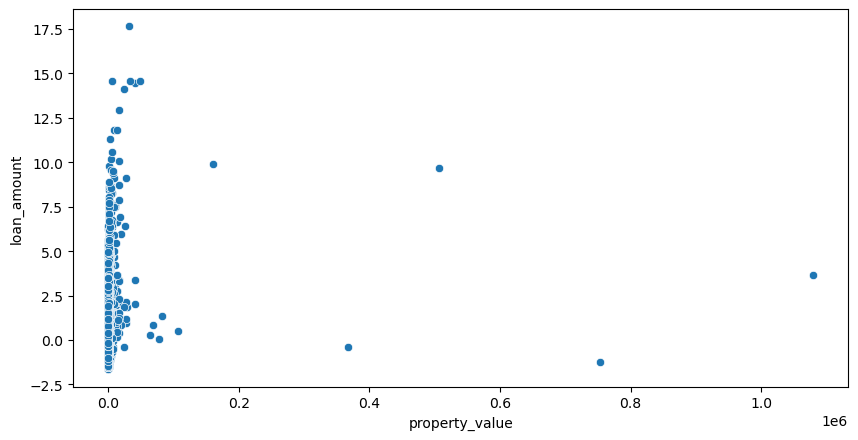

In [184]:
import seaborn as sns
%matplotlib inline

plt.figure(figsize=(10,5), dpi=100)
# sns.scatterplot(X_train.to_numpy(), y_train.to_numpy())
sns.scatterplot(X_train.to_numpy() + X_train.to_numpy()**2 + X_train.to_numpy()**3 + X_train.to_numpy()**4, \
                y_train.to_numpy())
plt.xlabel("property_value")
plt.ylabel("loan_amount")

In [ ]:
# Before removing the features or rows lets check the relationship of all the columns with our dependent variable

# plt.figure(figsize=(30, 20), dpi=100) 

# sns.heatmap(dataset.replace(np.nan,'').to_pandas().corr(), annot=True, annot_kws={"fontsize":12}, linecolor='white', \
#             linewidth=1, fmt='.3f')

In [ ]:
# from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

params = {
    'alpha': [0.001, 0.003, 0.01, 0.03, 0.1, 0.3, 1.0, 3.0],
    'solver': ['auto', 'svd', 'sag', 'saga', 'lbfgs'],
    'max_iter': [x for x in np.arange(1000, 20000, step=1000)],
    'tol': [1e-3, 1e-4, 1e-5, 1e-6, 1e-7],
}

ridge = Ridge()
clf = GridSearchCV(ridge, params, n_jobs=-1)
clf.fit(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1))

print ('best solver:', clf.best_estimator_)
print ('best params:', clf.best_params_)
print ('best score:', clf.best_score_)
print ('scoring: ', clf.scoring)
print ('estimator:', clf.estimator)
print ('score:', clf.score(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1)))

# reg = ridge.fit(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1))

# reg.score(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1))

In [ ]:
y_pred = clf.predict(X_test.get().reshape(-1,1)) #  y_test.get().reshape(-1,1)
# y_pred

clf.score(X_test.get().reshape(-1,1), y_test.get().reshape(-1,1))

In [ ]:
# Saving sklearn model

import pickle
import os

filename = './finalized_model.sav'
if os.path.exists(filename):
    os.remove(filename)
pickle.dump(clf, open(filename, 'wb'))

In [ ]:
from sklearn.linear_model import Perceptron
from sklearn.model_selection import GridSearchCV
import warnings

warnings.filterwarnings("ignore")

params = {
    'penalty': ['l1', 'l2',],
    'alpha': [0.001, 0.003, 0.01, 0.03, 0.1, 0.3, 1.0, 3.0],
    'max_iter': [x for x in np.arange(50, 2001, 50)],
    'tol': [1e-3, 1e-4, 1e-5, 1e-6, 1e-7],
    'n_jobs': [-1,],
    'random_state': [99,],
    'early_stopping': [True, ],
}

p = Perceptron()
clf2 = GridSearchCV(p, params)

X_train_temp = X_train.get().astype(float).reshape(-1, 1)
y_train_temp = y_train.get().astype(float).reshape(-1, 1)
X_test_temp = X_test.get().astype(float).reshape(-1, 1)
y_test_temp = y_test.get().astype(float).reshape(-1, 1)

clf2.fit(X_train_temp, y_train_temp)

print ('best solver:', clf.best_estimator_)
print ('best params:', clf.best_params_)
print ('best score:', clf.best_score_)
print ('scoring: ', clf.scoring)
print ('estimator:', clf.estimator)
print ('train score:', clf.score(X_train_temp, y_train_temp))
print ('test score:', clf.score(X_test_temp, y_test_temp))

y_pred = clf.predict(X_test_temp)

In [ ]:
X_train_temp.dtype

In [ ]:
from sklearn.neural_network import MLPRegressor

params = {
    'hidden_layer_sizes': [(10,), (15,), (20,), (25,), (30,)],
    'activation': ['relu', 'logistic', ],
    'solver': ['lbfgs', 'sgd', 'adam'],
    'alpha': [0.001, 0.003, 0.01, 0.03, 0.1, 0.3, 1.0, 3.0],
    'learning_rate': ['constant', 'adaptive'],
    'max_iter': [x for x in np.arange(50, 1001, 50)],
    'random_state': [99,],
    'tol': [1e-3, 1e-4, 1e-5, 1e-6, 1e-7],
    'verbose': [True, ],
    'early_stopping': [True, ],
    'validation_fraction': [0.1, 0.2],
    'n_iter_no_change': [10, 20],
}

mlp = MLPRegressor()
clf2 = GridSearchCV(mlp, params, n_jobs=-1)
clf2.fit(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1))

print ('best solver:', clf.best_estimator_)
print ('best params:', clf.best_params_)
print ('best score:', clf.best_score_)
print ('scoring: ', clf.scoring)
print ('estimator:', clf.estimator)
print ('train score:', clf.score(X_train.get().reshape(-1,1), y_train.get().reshape(-1,1)))
print ('test score:', clf.score(X_test.get().reshape(-1,1), y_test.get().reshape(-1,1)))

y_pred = clf.predict(X_test.get().reshape(-1, 1))

In [ ]:
# [x for x in np.arange(1.0, 0.7, step=-0.003)]

In [ ]:
# Before removing the features or rows lets check the relationship of all the columns with our dependent variable

# plt.figure(figsize=(30, 20), dpi=100) 

# sns.heatmap(dataset.replace(np.nan,'').to_pandas().corr(), annot=True, annot_kws={"fontsize":12}, linecolor='white', \
#             linewidth=1, fmt='.3f')

In [ ]:
# Now, we will perform LabelEncoding to categorize this variable to int value instead of object
# Status column we don't need to categorize, it already has 0 and 1

# But before we do that we need to remove all na values from dataset we don't those to be caterized as anything.\
    # That would be very misleading
    
# d2 = dataset.dropna(axis='rows', inplace=False) #.isna().sum()
# d2

for column in dataset.columns:
    dataset = dataset[dataset[column].notna()]

dataset
# from cuml import LabelEncoder

In [ ]:
# after dropping all rows containing na values we have following number of data 

new_n_rows, new_n_features = dataset.shape
print (f"features: {new_n_features}")
print (f"rows: {new_n_rows}")

# We also need to make sure that we have enough data to test all the categories
# Status is our dependent feature
dataset.groupby(by="Status").size()

In [ ]:
# We know from earlier that column Gender has [['Female', 'Joint', 'Male', 'Sex Not Available']] these \
    # four different categories, where 'Sex Not Available' is kind of nan. 
# We need to treat this problem as well, let's see how many data points have 'Sex Not Available'.
filter = dataset['Gender'] != 'Sex Not Available'
# dataset.loc[:, 'Gender'].where(filter, inplace=False)
dataset = dataset[filter]

In [ ]:
new_n_rows, new_n_features = dataset.shape
print (f"features: {new_n_features}")
print (f"rows: {new_n_rows}")

# We also need to make sure that we have enough data to test all the categories
# Status is our dependent feature
dataset.groupby(by="Status").size()

In [ ]:
dataset

In [ ]:
# Label Encoder

In [ ]:
new_n_rows, new_n_features = dataset.shape
print (f"features: {new_n_features}")
print (f"rows: {new_n_rows}")

In [ ]:
# Standard scalling was here column identifier

In [ ]:
dataset[scale_columns]

In [ ]:
# standard scalling was here

In [ ]:
dataset[scale_columns].mean() #.values.reshape(-1,1)

In [ ]:
dataset[scale_columns].std()

In [ ]:
dataset.std()

In [ ]:
dataset

In [ ]:
import seaborn as sns

In [ ]:
import pip

In [ ]:
dir(pip)

In [ ]:
dataset["Status"].unique()

In [ ]:
pip.List()